# **Coursework 1: Decision tree from scratch**


---


In this project, we implement a decision tree algorithm and use it to determine one of the indoor locations based on WIFI signal strengths collected from a mobile phone. We have included two different pruning methods. To evaluate the performance of our model, we use nested cross-validation with 10 outer and 10 inner folds.


## **Setup**

In [1]:
import numpy as np
import copy
import matplotlib.pyplot as plt 
import math as m

import warnings
warnings.filterwarnings("ignore")

In [2]:
np.random.seed(24)

## **Download clean and noisy datasets**

---
Input you directory path for the Project folder to the `path` variable 


In [3]:
# input your path directory to the project folder
path = '/Users/anastasia/Desktop/intro2ML'

In [4]:
# load clean data
path_to_clean = path + '/wifi_db/clean_dataset.txt'
data_clean = np.loadtxt(path_to_clean)
print(data_clean)


[[-64. -56. -61. ... -82. -81.   1.]
 [-68. -57. -61. ... -85. -85.   1.]
 [-63. -60. -60. ... -85. -84.   1.]
 ...
 [-62. -59. -46. ... -87. -88.   4.]
 [-62. -58. -52. ... -90. -85.   4.]
 [-59. -50. -45. ... -88. -87.   4.]]


In [5]:
# load noisy data
path_to_noisy = path + '/wifi_db/noisy_dataset.txt'
data_noisy = np.loadtxt(path_to_noisy)
print(data_noisy)

[[-59. -53. -51. ... -79. -87.   4.]
 [-66. -53. -59. ... -81. -79.   1.]
 [-41. -57. -63. ... -66. -65.   2.]
 ...
 [-57. -54. -56. ... -79. -82.   1.]
 [-56. -52. -50. ... -85. -88.   3.]
 [-46. -54. -47. ... -80. -73.   3.]]


In [6]:
# define the classes
classes = ['Room 1','Room 2', 'Room 3', 'Room 4']

## **Implementing the functions to calculate entropy and information gain**


---



In [7]:
def H(dataset):
    """ Calculates the entropy based on a dataset
    
    Args:
        dataset (np.ndarray): Dataset to use
        
    Returns:
        entropy_sum(np.float64)
        
    """ 
  
    y = dataset[:, -1]
    n = len(y)
    labels = np.unique(y) 
    entropy_sum = 0
    for label in labels:  # for each label calculate pk*log2(k) and add it to our entropy sum
        p = len(y[y==label])
        pk = p/n
        entropy_sum-=pk*np.log2(pk)
    return entropy_sum

In [8]:
def remainder(left_dataset,right_dataset):
    """ Calculates the entropy remainder 
    
    Args:
        left_dataset (np.ndarray): subset of the dataset left to the decision boundary
        right_dataset (np.ndarray): subset of the dataset right to the decision boundary
        
    Returns:
        remainder(float): calculated entropy remainder
        
    """ 
    
    length_left_dataset = len(left_dataset[:,0])
    length_right_dataset = len(right_dataset[:,0])

    return length_left_dataset/(length_left_dataset+length_right_dataset)*H(left_dataset) + length_right_dataset/(length_left_dataset+length_right_dataset)*H(right_dataset)

In [9]:
def gain(dataset,left_dataset,right_dataset):
    """ 
    Calculate the information gain based on dataset split
    """ 
    return H(dataset) - remainder(left_dataset,right_dataset)

In [10]:
def IG(data,value):
    """ Calculate the information gain for a given dataset based on the splitting value
    
    Args:
        dataset (np.ndarray): Dataset to use
        
    Returns:
        information(float): calculated information gain
    
    """
    dataset = data
    left_dataset = data[data[:,0]<=value]
    right_dataset = data[data[:,0]>value]

    return gain(dataset,left_dataset,right_dataset)

## **Choosing the best feature and generating the decision tree**

In [11]:
def find_best_feature_value(dataset,previous_index):
    
    """ Find the best split based on feature and a value. 
    
    This function takes a dataset as an input and an index, and finds the best
    split based on feature and a value. 
    
    Args: 
        dataset (np.ndarray): dataset to use
        previous_index (int): the index of our previous best feature, 
                            so we can avoid selecting the same feature 
                            twice in a row.
    Returns:
        best_feature (int): the index of our new best feature
        best_value (float): the calculated best value for the split 
                            using the new best feature
        best_ig (float): the information gain using the new best feature and 
                         the best value for the split

    """
    
    n,m = dataset.shape
    best_feature_index=0
    best_value=-10000 # default very low value
    best_ig = 0
    
    # loop through all the features
    for j in range(m-1): 
        # check whether our current feature is equal to the previous one
        if previous_index!='False' and j == previous_index:
            continue
        dataset = np.array(sorted(dataset,key = lambda x:x[j]))
        
        feature = dataset[:,j]
        label = dataset[:,-1]
    
        data_feature_label=np.vstack((feature,label)).T
        # for each feature we take the value which is the average of the current value and the next value
        for i in range(n-1):

            value = (data_feature_label[i,0]+data_feature_label[i+1,0])/2
            ig = IG(data_feature_label,value)

            # After calculating the information gain, we check whether the current information gain
            # is larger than the previous one, if yes, this will be our new best feature and value.
            if ig > best_ig:
                
                best_ig = ig
                best_value=value
                best_feature_index=j
    
    if best_value == -10000:
        raise Exception('Error! Incorrect Dataset. Equal samples have different labels')

    return best_feature_index, best_value, best_ig         

In [12]:
def split_feature_value(data,feature_index,value):
    """ Find the best split based on feature and a value. 

    This function splits a dataset to left and right dataset
    based on data - our data, feature_index - the index of the feature
    that we want to split based on, and the value that we want to split
    based on. 
    
    Args: 
        data (np.ndarray): dataset to use
        feature_index (int): the index of the feature to use
        value (float): the value for the split 

    Returns:
        left_dataset(np.ndarray): the subset of the data left to the split
        right_dataset(np.ndarray): the subset of the data right to the split

    """


    left_dataset = data[data[:,feature_index]<=value]
    right_dataset = data[data[:,feature_index]>value]

    return left_dataset,right_dataset

In [13]:
def node_to_leaf_label(dataset):

    """ Calculate the label that we could potentially assign to a node 

    This function calculates the label that we could potentially assign to a node.
     
    
    Args: 
        dataset (np.ndarray): dataset to use

    Returns:
        label (np.float64): labels to assign to the node

    """
    
    y = dataset[:,-1]

    y_unique, count = np.unique(y, return_counts=True)

    label = y_unique[np.argsort(-count)][0]
    
    return label

In [14]:
def decision_tree_learning(dataset,depth,previous_index='False'):
    """ Recursively build the decision tree 

    inputs: dataset, depth, and previous index
    outputs: decision tree 
    
    Args: 
        dataset (np.ndarray): dataset to use
        depth (int): depth value assigned to the node
        previous_index (str): the best feature index from the previous split or 
                              'False' string (at the initialisation of the tree) 
    Returns:
        node (dict): dictionary containing the description of the node 
                    or leaf node               

    """
  
    # check for leaf
    if len(set(dataset[:,-1]))==1:
        #leaf_node = {'leaf_node':True,'depth':depth,'label':dataset[0,-1]}
        leaf_node = {'leaf_node':True,'depth':depth,'label':dataset[0,-1],'left_child':None,'right_child':None}
        return leaf_node, depth
    
    else:   
            ## find optimal value and optimal feature

            best_feature_index,best_value,best_ig = find_best_feature_value(dataset,previous_index)          
     
            ## find the left and right dataset
            left_dataset,right_dataset = split_feature_value(dataset,best_feature_index,best_value)
    
            ## create the current node
            node = {'leaf_node':False,'feature':0,'value':0,'left_child':{},'right_child':{}}
            node['feature']=best_feature_index
            node['value'] = best_value
            node['label'] = node_to_leaf_label(dataset)
            node['prune_checked'] = False
            node['depth'] = depth
            
            ## shift to the left and right children
            left_child,left_child_depth = decision_tree_learning(left_dataset,depth+1,previous_index=best_feature_index)
            right_child,right_child_depth = decision_tree_learning(right_dataset,depth+1,previous_index=best_feature_index)

            node['left_child'] = left_child
            node['right_child'] = right_child
          
           
            return node, max(left_child_depth, right_child_depth)
        


    

In [15]:
def predict_sample(tree,features):
    """ Predict a sample based on our decision tree
    
    Args:
        tree (dict): nested dictionary represented the decision tree structure.
                    generated by decision_tree_learning()
        features (np.ndarray): dataset containing the samples
    Returns:
        label (np.float64): predicted label for the given sample
    """
    
    while True:

        if tree['leaf_node']==False:

            value = tree['value']

            index = tree['feature']

            test_value = features[index]

            if test_value<=value:
                tree = tree['left_child']
            else:
                tree=tree['right_child']

        else:

          
            return tree['label']

        

In [16]:
# Here we create a class Decision tree in which we put the upper functions
class Tree:

    def __init__(self,tree_model):

        self.tree_model = tree_model

    def predict_sample(self,features):
        tree = self.tree
        while tree['leaf_node']==False:

                value = tree['value']

                index = tree['feature']

                test_value = features[index]

                if test_value<=value:
                    tree = tree['left_child']
                else:
                    tree=tree['right_child']

        return tree['label']
    
    def predict(self,X):
        tree = self.tree_model
        y=[]
        for sample in X:

            y.append(predict_sample(tree,sample))
        
        return np.array(y)
    

In [17]:
def predict(tree,X):
    """ Append a predicted sample to the labels array
    
    """
    y=[]
    for sample in X:

        y.append(predict_sample(tree,sample))
    
    return np.array(y)

# First Prune

In [18]:
def prune_1(tree, mark=False):
    """ Prune/mark the next node of a decision tree.
    
    Args:
        tree (dict): decision tree to prune.
        mark (bool): if True then we don't prune only mark the node as checked.
        
    Returns:
        tree (dict): pruned/marked decision tree.
        
    """
    # Global pruned value ensures we only prune one node at a time.
    global pruned

    # Checks if we pruned any nodes.
    # If at a node.
    if(tree['leaf_node']==False):
        # Check that two child nodes are leaves, haven't pruned a node yet and haven't checked this node.
        if(tree['left_child']['leaf_node'] == True and tree['right_child']['leaf_node'] == True and pruned == 0
        and tree['prune_checked'] == False):
            tree['prune_checked'] = True
            #print(tree['prune_checked'])
            #print(mark)
            if(mark):
                tree['prune_checked'] = True
                #print("mark")
                pruned = 1
            else:
                # Prune the node
                tree['left_child'] = None
                tree['right_child'] = None
                tree['leaf_node'] = True
                tree['prune_checked'] = True
                tree.pop('value')
                tree.pop('feature')
                pruned = 1
                
    # Do for rest of tree.
    if(tree['left_child'] is not None):
        tree['left_child'] = prune_1(tree['left_child'], mark)
    if(tree['right_child'] is not None):
        tree['right_child'] = prune_1(tree['right_child'], mark)
    return tree

In [19]:
def keep_pruned(tree_before, tree_after, validation_data):
    """ Check if a prune is beneficial.
    
    Args:
        tree_before (dict): decision tree before pruning.
        tree_after (dict): decision tree after pruning.
        validation_data: data to check if prune should be kept.
        
    Returns:
        tree (dict): pruned/marked decision tree.
    
    """
    # If validation accuracy has stayed the same or improved keep the prune.
    X_validation = validation_data[:,:-1]
    y_validation = test = validation_data[:,-1]
    y_preds = predict(tree_before, X_validation)
    pruned_y_preds = predict(tree_after, X_validation)
    acc = accuracy(y_validation, y_preds)
    pruned_accuracy = accuracy(y_validation, pruned_y_preds)
    if(acc > pruned_accuracy):
        # No improvement means we mark this node as checked.
        marked_tree = prune_1(tree_before, mark=True)
        return marked_tree
    else:
        return tree_after

In [20]:
def complete_prune(tree, validation_data):
    """ Prune the whole tree
    
    Args:
        tree (dict): decision tree before pruning.
        validation_data: data to check if prune should be kept.
    Returns:
        tree (dict): pruned decision tree.
        
    """
    global pruned
    did_prune = True
    pruned_tree = copy.deepcopy(tree)
    pruned = 0
    # While the tree is still getting pruned.
    while(pruned == 0):
        #Find the next prune
        tree_before_pruning = copy.deepcopy(pruned_tree)
        tree_after_pruning = prune_1(pruned_tree, False)
        
        if(pruned == 0):
            break
        # If found a prune keep if an improvement.
        if(pruned == 1):
            pruned = 0
            pruned_tree = keep_pruned(tree_before_pruning, tree_after_pruning, validation_data)
            pruned = 0
    return pruned_tree

# Second Prune

In [21]:
def prune(tree):
    """ Prune one node
    
    Args: 
        tree(dict): nested dictionary representing an original decision tree
    
    Returns: 
        tree(dict): nested dictionary representing a new decision tree structure with 1 pruned node
    
    """
    
    global pruned
    
    # if we are not in a leaf node.
    if tree['leaf_node'] == False:
    
            left_child = prune(tree['left_child'])
            right_child = prune(tree['right_child'])

            # if the left child and the right child is None, prune the node.
            if left_child==None and right_child==None and pruned == 0 and tree['prune_checked']==False:
                

                tree['left_child']=None
                tree['right_child']=None
                tree['leaf_node']=True
                tree['prune_checked']=True
                pruned = 1
    
            return tree

            
    else:
    
        return None

In [22]:
def prune_mark(tree):
    """ Mark the nodes that we will potentially prune
   
    Args: 
        tree(dict): nested dictionary representing the structure of the tree
    
    Returns:    
        tree(dict): nested dictionary representing the decision tree with 1 marked node
    
    """
    global pruned
    
    if tree['leaf_node'] == False:
 
            left_child = prune_mark(tree['left_child'])
            right_child = prune_mark(tree['right_child'])
            
            # just mark the tree, dont prune it
            if left_child==None and right_child==None and pruned == 0 and tree['prune_checked']==False:
                
                tree['prune_checked']=True
                pruned=1
    
            return tree

            
    else:
    
        return None

In [23]:
def tree_prune2(tree,data,steps=1000,verbose=False):
    """ Prune the decision tree
  
    Uses the previous two functions - prune_mark, and prune.
    It tries to prune the tree for number of steps. In each step the idea is: try to prune, but only if you can,
    if you can't prune the node with 2 leaves, then continue to the next step (next node with 2 leaves).
    
    Args: 
        tree (dict): nested dictionary representing the structure of the tree
        data (np.array): dataset we built the tree with 
        steps (int) - maximum number of prunning steps we are going to take
        verbose (bool) - whether we print out the pruned results
    
    Returns:
        tree(dict): nested dictionary representing the structure of the pruned tree
        
    """
    
    global pruned
    
    for step in range(steps):

        if verbose == True:
            print(f'original tree')
            print(' ')
        X_test = data[:,:-1]
        y_test = data[:,-1]
        tree_original = copy.deepcopy(tree)
        pruned = 0
        # mark the tree
        tree_before_prunning = prune_mark(tree_original)
        not_pruned = Tree(tree_model=tree_before_prunning)
        y_not_pruned_predict= not_pruned.predict(X_test)
        original_acc = accuracy(y_test,y_not_pruned_predict)
        # check the accuracy of the marked tree = the accuracy of a non pruned tree

        if verbose == True:
            print(original_acc)
            print(f'pruned tree')
            print(' ')
        tree_original = copy.deepcopy(tree)
        pruned = 0

        # prune the tree
        tree_after_prunning = prune(tree_original)
     
        pruned = Tree(tree_model=tree_after_prunning)
        y_pruned_predict= pruned.predict(X_test)
        # check the accuracy of the pruned tree
        pruned_acc = accuracy(y_test,y_pruned_predict)
        if verbose == True:
             print(pruned_acc)
       
       # tree = max(non-pruned tree, pruned tree) by accuracy.
        if original_acc <= pruned_acc:

            tree = tree_after_prunning
        else:

            tree = tree_before_prunning
    
    return tree   

# Evaluation Metrics 

In [24]:
def confusion_matrix(y_gold, y_prediction, class_labels=None):
    """ Compute the confusion matrix.
        
    Args:
        y_gold (np.ndarray): the correct ground truth/gold standard labels
        y_prediction (np.ndarray): the predicted labels
        class_labels (np.ndarray): a list of unique class labels. 
                               Defaults to the union of y_gold and y_prediction.

    Returns:
        np.array : shape (C, C), where C is the number of classes. 
                   Rows are ground truth per class, columns are predictions
    """

    # if no class_labels are given, we obtain the set of unique class labels from
    # the union of the ground truth annotation and the prediction
    if not class_labels:
        class_labels = np.unique(np.concatenate((y_gold, y_prediction)))

    confusion = np.zeros((len(class_labels), len(class_labels)), dtype=np.int)

    # for each correct class (row), 
    # compute how many instances are predicted for each class (columns)
    for (i, label) in enumerate(class_labels):
        # get predictions where the ground truth is the current class label
        indices = (y_gold == label)
        gold = y_gold[indices]
        predictions = y_prediction[indices]

        # quick way to get the counts per label
        (unique_labels, counts) = np.unique(predictions, return_counts=True)

        # convert the counts to a dictionary
        frequency_dict = dict(zip(unique_labels, counts))

        # fill up the confusion matrix for the current row
        for (j, class_label) in enumerate(class_labels):
            confusion[i, j] = frequency_dict.get(class_label, 0)

    return confusion

In [25]:
def plot_cm(cm, classes, ifrecall = False):
    """ Plot the confusion matrix with either instances or recall as the output 
    
    Args:
        cm (np.nparray): confusion matrix calculated by confusion_matrix() of
                         shape (C, C), where C is the number of classes. Rows 
                         are ground truth per class, columns are predictions
                         
        classes (list of str): list of our classes names 
        
        ifrecall(boolean): boolean to indicate whether the output of the confusion
                           matrix would be instance count (ifrecall = False), 
                           or recall for each of the inputed class (ifrecall = True)                        
  
    """ 
    
    #set the font
    plt.rcParams.update({'font.size': 18})
    
    #cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    fig, ax = plt.subplots(figsize=(10, 10))
    im = ax.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
    ax.figure.colorbar(im, ax=ax)


    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes,
           title= 'Confusion Matrix',
           ylabel= 'True label',
           xlabel= 'Predicted label')

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = '.2f'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
             ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    

In [26]:
def accuracy(y,y_pred):
    """ Compute the precision score per class given the ground truth and predictions

    """

    n = len(y)
    accurate =0
    for true,prediction in zip(y,y_pred):

        if true==prediction:
            accurate+=1
    
    return accurate/n

In [27]:
def find_precision(y_gold, y_prediction):
    """ Compute the precision score per class given the ground truth and predictions
        
    Also return the macro-averaged precision across classes.
        
    Args:
        y_gold (np.ndarray): the correct ground truth/gold standard labels
        y_prediction (np.ndarray): the predicted labels

    Returns:
        tuple: returns a tuple (precisions, macro_precision) where
            - precisions is a np.ndarray of shape (C,), where each element is the 
              precision for class c
            - macro-precision is macro-averaged precision (a float) 
    """

    confusion = confusion_matrix(y_gold, y_prediction)
    p = np.zeros((len(confusion), ))
    for c in range(confusion.shape[0]):
        if np.sum(confusion[:, c]) > 0:
            p[c] = confusion[c, c] / np.sum(confusion[:, c])
  

    # Compute the macro-averaged precision
    macro_p = 0.
    if len(p) > 0:
        macro_p = np.mean(p)
    
    return (p, macro_p)

In [28]:
def find_recall(y_gold, y_prediction):
    """ Compute the recall score per class given the ground truth and predictions
        
    Also return the macro-averaged recall across classes.
        
    Args:
        y_gold (np.ndarray): the correct ground truth/gold standard labels
        y_prediction (np.ndarray): the predicted labels

    Returns:
        tuple: returns a tuple (recalls, macro_recall) where
            - recalls is a np.ndarray of shape (C,), where each element is the 
                recall for class c
            - macro-recall is macro-averaged recall (a float) 
    """

    confusion = confusion_matrix(y_gold, y_prediction)
    r = np.zeros((len(confusion), ))
    for c in range(confusion.shape[0]):
        if np.sum(confusion[c, :]) > 0:
            r[c] = confusion[c, c] / np.sum(confusion[c, :])     

    # Compute the macro-averaged recall
    macro_r = 0.
    if len(r) > 0:
        macro_r = np.mean(r)
    
    return (r, macro_r)

# Cross-Validation

In [29]:
def k_fold_split(n_splits, n_instances):
    """ Split n_instances into n mutually exclusive splits at random.
    
    Args:
        n_splits (int): Number of splits
        n_instances (int): Number of instances to split
        random_generator (np.random.Generator): A random generator

    Returns:
        list: a list (length n_splits). Each element in the list should contain a 
            numpy array giving the indices of the instances in that split.
    """

    # generate a random permutation of indices from 0 to n_instances
    shuffled_indices = np.random.permutation(n_instances)

    # split shuffled indices into almost equal sized splits
    split_indices = np.array_split(shuffled_indices, n_splits)

    return split_indices

In [30]:
def train_test_k_fold(n_folds, n_instances):
    """ Generate train and test indices at each fold.
    
    Args:
        n_folds (int): Number of folds
        n_instances (int): Total number of instances
        random_generator (np.random.Generator): A random generator

    Returns:
        list: a list of length n_folds. Each element in the list is a list (or tuple) 
            with two elements: a numpy array containing the train indices, and another 
            numpy array containing the test indices.
    """

    # split the dataset into k splits
    split_indices = k_fold_split(n_folds, n_instances)

    folds = []
    for k in range(n_folds):
        # TODO: Complete this
        # take the splits from split_indices and keep the k-th split as testing
        # and concatenate the remaining splits for training

        test_indices = split_indices[k]
        train_indices = []
        
        for lst in split_indices:
          for item in lst:
            if item not in test_indices:
              train_indices.append(item)

        folds.append([train_indices, test_indices])

    return folds

In [31]:
def calculate_depth(tree):
    """ Calculate the depth of the tree (need to be adjusted by +1)

    Args:
        tree (class Tree): decision tree

    Returns:
        depth (int): depth of a given tree (need to be adjusted by +1)
  
    """
    depth1 = tree['depth']
    depth2 = tree['depth']
    

    if not tree['leaf_node']:
        
        if not tree['left_child']['leaf_node']: 
            
            depth1 = calculate_depth(tree['left_child'])
            
        if not tree['right_child']['leaf_node']:
            
            depth2 = calculate_depth(tree['right_child'])
        
       
    return max(depth1, depth2) 

In [32]:
def F1_score (recall, precision):
    """ Calculate F1_score given recall and precision
      
    """      
    return (2*recall*precision)/(recall+precision)


In [33]:
def cross_validate(data,n_folds,k_subfolds, ifnotshort = True):
    """ Perform a nested cross-validation
    This function performs a nested cross-validation. It outputs
     - confusion matrix 
     - precisoin
     - recall
     - accuracy
    for each fold. In addition, it prints the average results for the latter
    and also the average tree depths. The cross-validation is done before tree 
    prunning and after tree prunning, using both prunnings.

    Args:
        data(np.ndarray): Dataset to use
        n_folds (int): Number of folds for testing
        k_subfolds (int): Number of subfolds for validation
        ifnotshort (boolean): boolean to indicate whether function would print 
                             out a short report (ifnotshort = False), or a long 
                             repor with confusion matrices and metrics outputed 
                             for each crossvalidation subfold (ifnotshort = 
                             True)                        

    """
    
    # initialize/create the arrays for the statistics
    mean_cm_original = []
    mean_cm_prune1 = []
    mean_cm_prune2 = []
    mean_recall_original = np.zeros(len(classes))
    mean_recall_prune1 = np.zeros(len(classes))
    mean_recall_prune2 = np.zeros(len(classes))
    mean_precision_original = np.zeros(len(classes))
    mean_precision_prune1 = np.zeros(len(classes))
    mean_precision_prune2 = np.zeros(len(classes))
    depth_original=0
    depth_prune1=0
    depth_prune2=0
    
    # creating the outer folds
    total_folds = n_folds*k_subfolds
    X = data[:,:-1]
    y = data[:,-1]
    n_outer_instances = len(y)
    outer_folds = train_test_k_fold(n_folds, n_outer_instances)

    # The sums for the inner folds' accuracy
    sum_accuracy_pruned_1 = 0
    sum_accuracy_pruned_2 = 0
    sum_accuracy_original = 0 
    for i,(train_val_index, test_index) in enumerate(outer_folds): # looping through the outer folds
     
        X_train_val, X_test = X[train_val_index], X[test_index]
        y_train_val, y_test = y[train_val_index], y[test_index]
     
        y_test = y_test.reshape(-1,1)
     
        test_data = np.concatenate((X_test,y_test),axis=1)
        y_test = y_test.reshape(-1)
        n_inner_instances = len(y_train_val)
        inner_folds = train_test_k_fold(k_subfolds,n_inner_instances)

        # looping through the inner folds
        for j,(train_index,val_index) in enumerate(inner_folds):
            X_train,X_val = X_train_val[train_index],X_train_val[val_index]
            y_train,y_val = y_train_val[train_index],y_train_val[val_index]
         
            y_val = y_val.reshape(-1,1)
            y_train = y_train.reshape(-1,1)

            train_data=np.concatenate((X_train,y_train),axis=1)
            val_data = np.concatenate((X_val,y_val),axis=1)
         
            if ifnotshort: 
                print(f'Outer Fold:{i+1}, Inner fold:{j+1}')
        
            ### ORIGINAL
            tree, depth = decision_tree_learning(train_data, depth=0)
            model = Tree(tree)
            
            # Predict test data labels.
            y_pred = model.predict(X_test)

            cm = confusion_matrix(y_test,y_pred)
            mean_cm_original.append(cm)
         
            # Calculate accuracy.
            pred_accuracy = accuracy(y_test, y_pred)
            recall,macro_recall = find_recall(y_test,y_pred)
            precision,macro_precision = find_precision(y_test,y_pred)
         
            if ifnotshort:
                print(f'Accuracy original: {pred_accuracy}')
                print(f'Macro recall original: {macro_recall}')
                print(f'Macro precision original: {macro_precision}')
                print(' ')
         
                plot_cm(cm,classes)
                plt.show()

            sum_accuracy_original+=pred_accuracy
            mean_recall_original+=recall
            mean_precision_original+=precision
            # increase by 1 as funciton doesn't count the last leaf nodes
            depth_original+=calculate_depth(tree) + 1 


            # getting the results for Pruning Method 1
            tree_copy1 = copy.deepcopy(tree)
            pruned_tree = tree_prune2(tree_copy1, val_data)
            pruned_model = Tree(pruned_tree)
            y_pred_pruned = predict(pruned_tree, X_test)

            pruned_pred_accuracy = accuracy(y_test, y_pred_pruned)
            recall,macro_recall = find_recall(y_test,y_pred_pruned)
            precision,macro_precision = find_precision(y_test,y_pred_pruned)
            cm = confusion_matrix(y_test,y_pred_pruned)
            mean_cm_prune1.append(cm)
            
            if ifnotshort:   
                print(f'Accuracy pruned 1: {pruned_pred_accuracy}')
                print(f'Macro recall pruned 1: {macro_recall}')
                print(f'Macro precision pruned 1: {macro_precision}')

         
                plot_cm(cm,classes)
                plt.show()
                print(' ')

            sum_accuracy_pruned_1+=pruned_pred_accuracy
            mean_recall_prune1+=recall
            mean_precision_prune1+=precision
            # increase by 1 as funciton doesn't count the last leaf nodes
            depth_prune1+=calculate_depth(pruned_tree) + 1
        
            # getting the results for Pruning Method 2
         
            pruned_tree = complete_prune(tree, val_data)
            pruned_model = Tree(pruned_tree)
            y_pred_pruned = predict(pruned_tree, X_test)
         
            pruned_pred_accuracy = accuracy(y_test, y_pred_pruned)
            recall,macro_recall = find_recall(y_test,y_pred_pruned)
            precision,macro_precision = find_precision(y_test,y_pred_pruned)
            cm = confusion_matrix(y_test,y_pred_pruned)
            mean_cm_prune2.append(cm)
        
            # print out the long report if specificed in the input
            if ifnotshort:
                print(f'Accuracy pruned 2: {pruned_pred_accuracy}')
                print(f'Macro recall pruned 2: {macro_recall}')
                print(f'Macro precision pruned 2: {macro_precision}')
         
                plot_cm(cm,classes)
                plt.show()
                print(' ')

            sum_accuracy_pruned_2+=pruned_pred_accuracy
            mean_recall_prune2+=recall
            mean_precision_prune2+=precision
            depth_prune2+=calculate_depth(pruned_tree) + 1
   
    
    mean_precision_original = mean_precision_original/total_folds
    mean_precision_prune1 = mean_precision_prune1/total_folds
    mean_precision_prune2 = mean_precision_prune2/total_folds
    mean_recall_original = mean_recall_original/total_folds
    mean_recall_prune1 = mean_recall_prune1/total_folds
    mean_recall_prune2 = mean_recall_prune2/total_folds

    
    print('------------------------------------------------')
    print(f'Average accuracy for original tree:{sum_accuracy_original/total_folds}')
    print(f'Average accuracy for pruned1 tree:{sum_accuracy_pruned_1/total_folds}')
    print(f'Average accuracy for pruned2 tree:{sum_accuracy_pruned_2/total_folds}')

    print(f'Average recall for original tree:{mean_recall_original}')
    print(f'Average recall for pruned1 tree:{mean_recall_prune1}')
    print(f'Average recall for pruned2 tree:{mean_recall_prune2}')

    print(f'Average precision for original tree:{mean_precision_original}')
    print(f'Average precision for pruned1 tree:{mean_precision_prune1}')
    print(f'Average precision for pruned2 tree:{mean_precision_prune2}')
    print(' ')
    print(f'Average F1 score for original tree:{F1_score(mean_recall_original,mean_precision_original)}')
    print(f'Average F1 score for pruned1 tree:{F1_score(mean_recall_prune1,mean_precision_prune1)} ')
    print(f'Average F1 score for pruned2 tree:{F1_score(mean_recall_prune2,mean_precision_prune2)} ')
    print(' ')
    print(f'Average depth original tree:{depth_original/total_folds}')
    print(f'Average depth pruned1 tree:{depth_prune1/total_folds} ')
    print(f'Average depth pruned2 tree:{depth_prune2/total_folds} ')

    print(' ')
    print('Confusion matrix for the original tree')

    # the final confusion matrix for the original tree
    final_sum_cm = np.zeros(mean_cm_original[0].shape)
    for matrix in mean_cm_original:
        final_sum_cm +=matrix
    final_mean_cm = final_sum_cm/(total_folds)
    plot_cm(final_mean_cm,classes)
    plt.show()
    
    print('Confusion matrix for pruned1 tree')
    # the final confusion matrix for the pruned1
    final_sum_cm = np.zeros(mean_cm_prune1[0].shape)
    for matrix in mean_cm_prune1:
        final_sum_cm +=matrix
    final_mean_cm = final_sum_cm/(total_folds)
    plot_cm(final_mean_cm,classes)
    plt.show()

    print('Confusion matrix for pruned2 tree')
    # the final confusion matrix for the pruned2
    final_sum_cm = np.zeros(mean_cm_prune2[0].shape)
    for matrix in mean_cm_prune2:
        final_sum_cm +=matrix
    final_mean_cm = final_sum_cm/(total_folds)
    plot_cm(final_mean_cm,classes)
    plt.show()

# Results Clean Dataset

Outer Fold:1, Inner fold:1
Accuracy original: 0.975
Macro recall original: 0.9747009387201285
Macro precision original: 0.9747009387201285
 


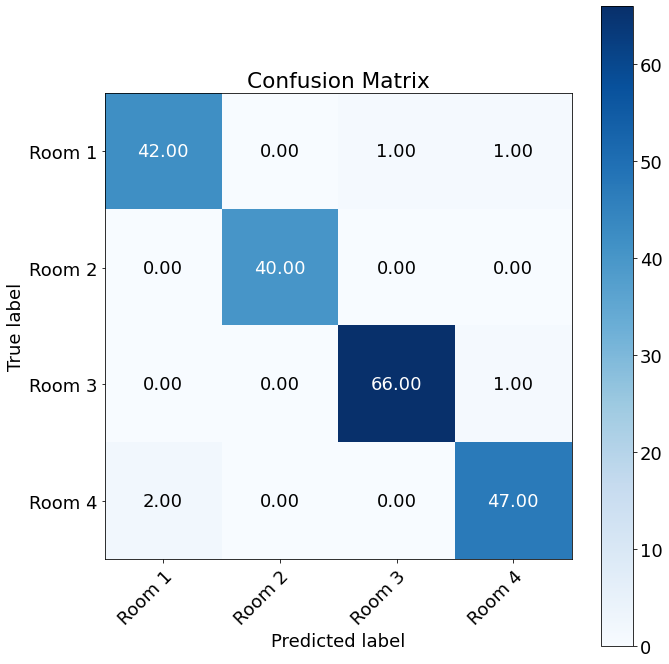

Accuracy pruned 1: 0.98
Macro recall pruned 1: 0.9803827569019467
Macro precision pruned 1: 0.9799492122719734


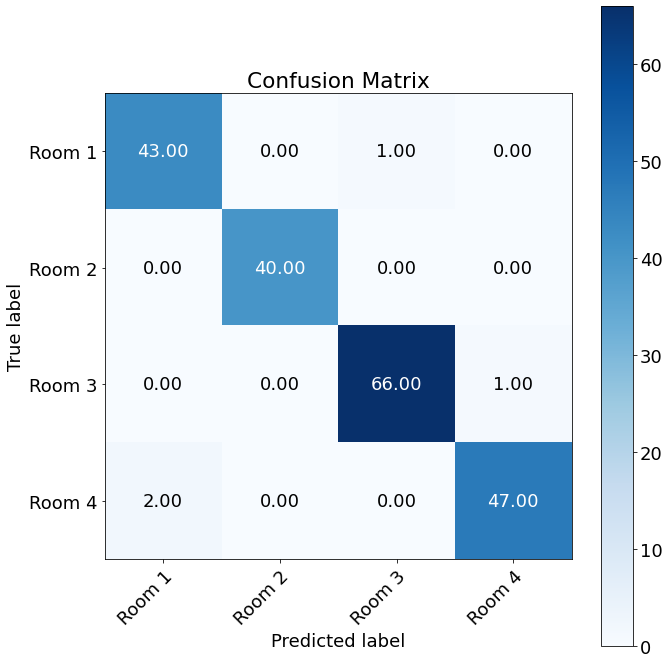

 
Accuracy pruned 2: 0.98
Macro recall pruned 2: 0.9803827569019467
Macro precision pruned 2: 0.9799492122719734


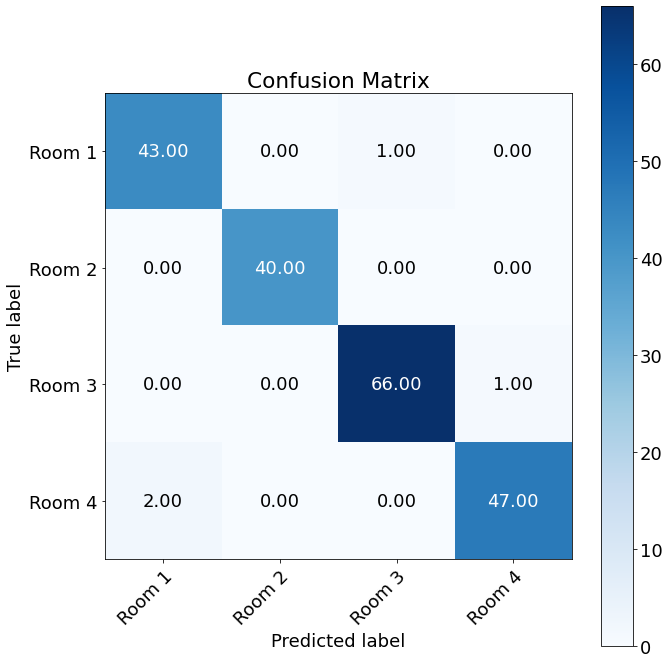

 
Outer Fold:1, Inner fold:2
Accuracy original: 0.965
Macro recall original: 0.9672382521529643
Macro precision original: 0.9626813662527948
 


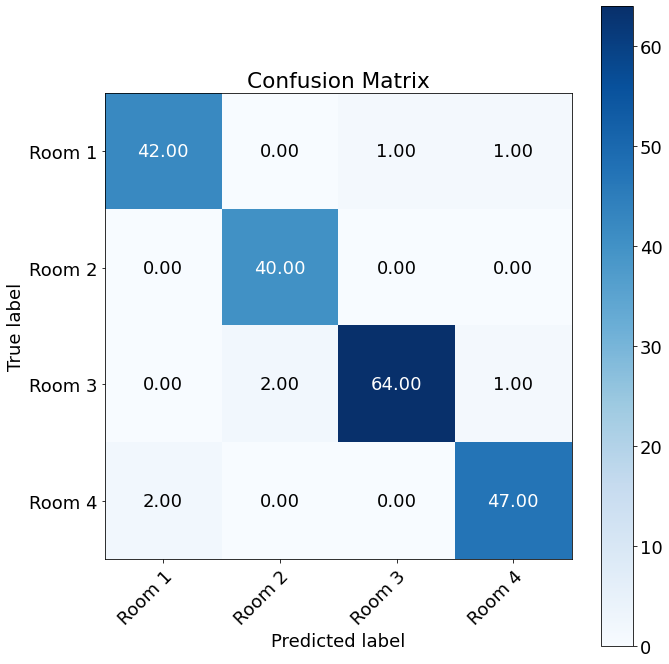

Accuracy pruned 1: 0.955
Macro recall pruned 1: 0.9566887270512004
Macro precision pruned 1: 0.9548211708925994


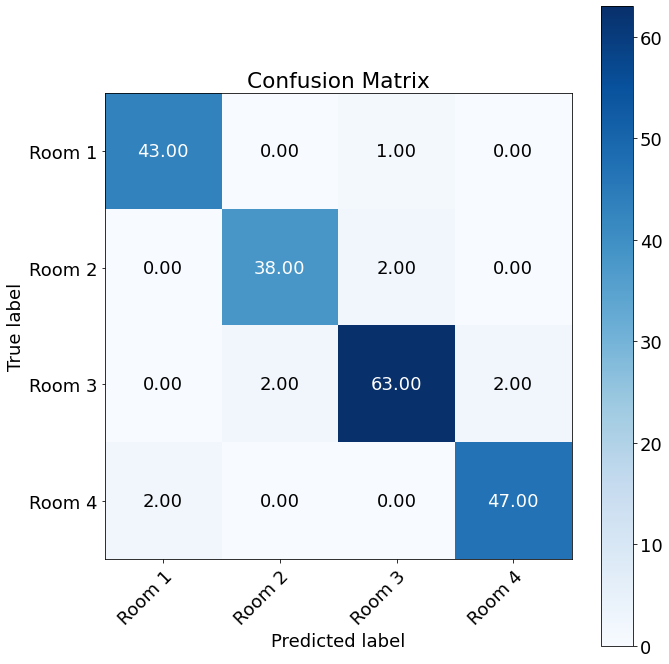

 
Accuracy pruned 2: 0.955
Macro recall pruned 2: 0.9566887270512004
Macro precision pruned 2: 0.9548211708925994


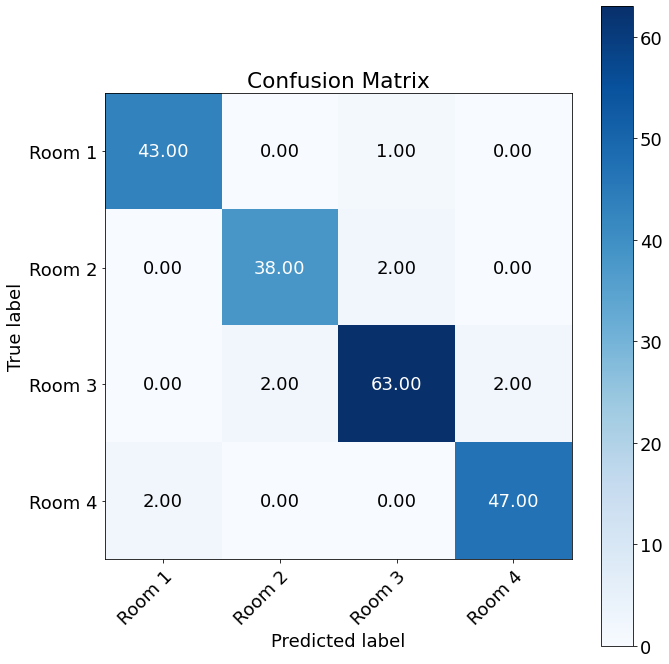

 
Outer Fold:1, Inner fold:3
Accuracy original: 0.97
Macro recall original: 0.9729200703347824
Macro precision original: 0.9687410924344723
 


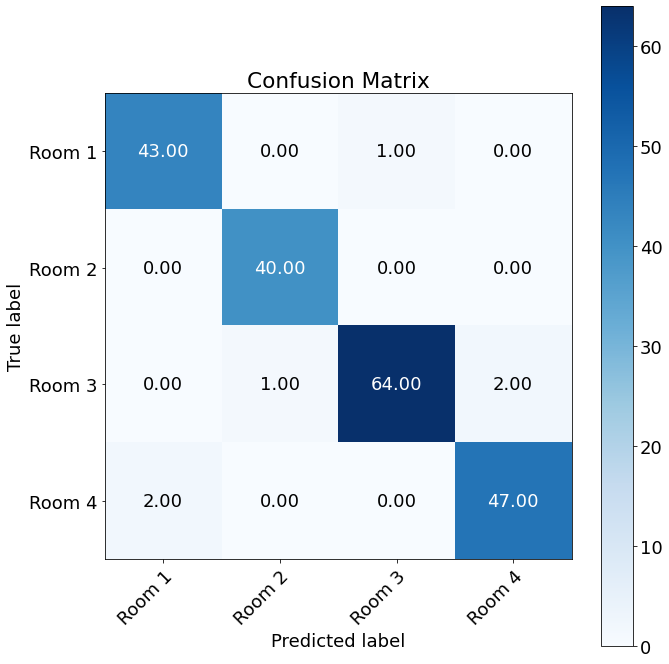

Accuracy pruned 1: 0.965
Macro recall pruned 1: 0.9661018885166006
Macro precision pruned 1: 0.9662627139830787


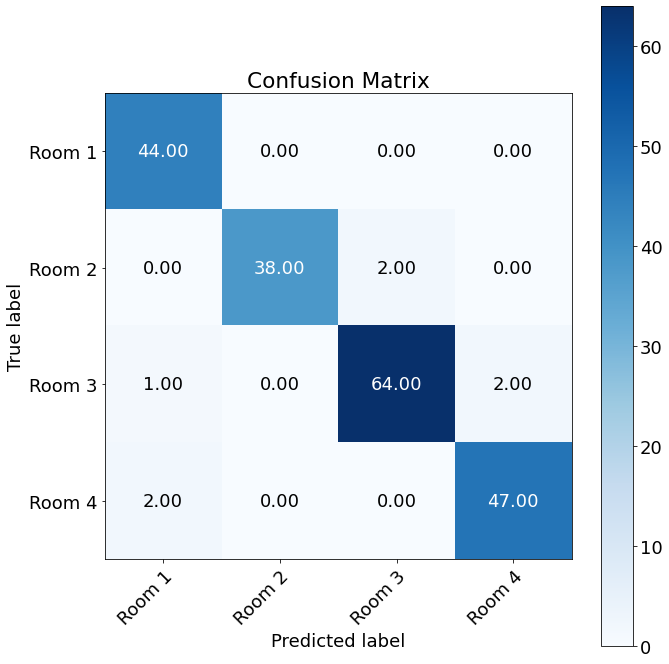

 
Accuracy pruned 2: 0.965
Macro recall pruned 2: 0.9661018885166006
Macro precision pruned 2: 0.9662627139830787


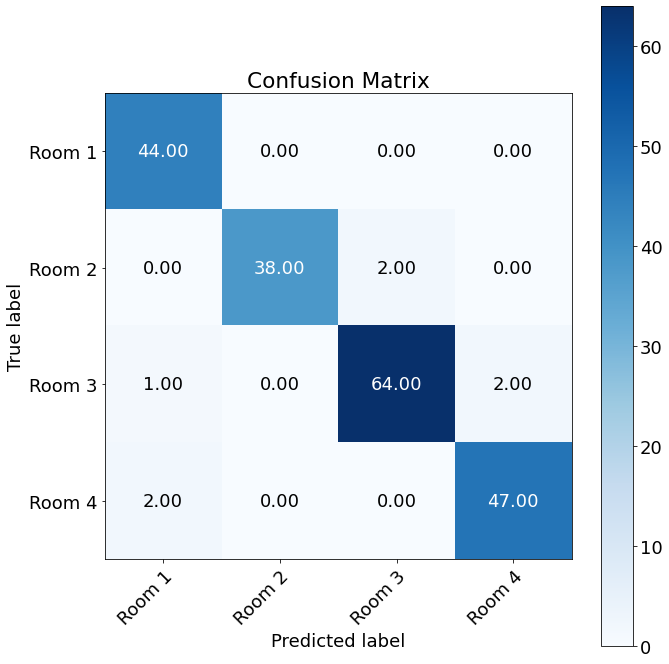

 
Outer Fold:1, Inner fold:4
Accuracy original: 0.975
Macro recall original: 0.9766514136183646
Macro precision original: 0.973795115792067
 


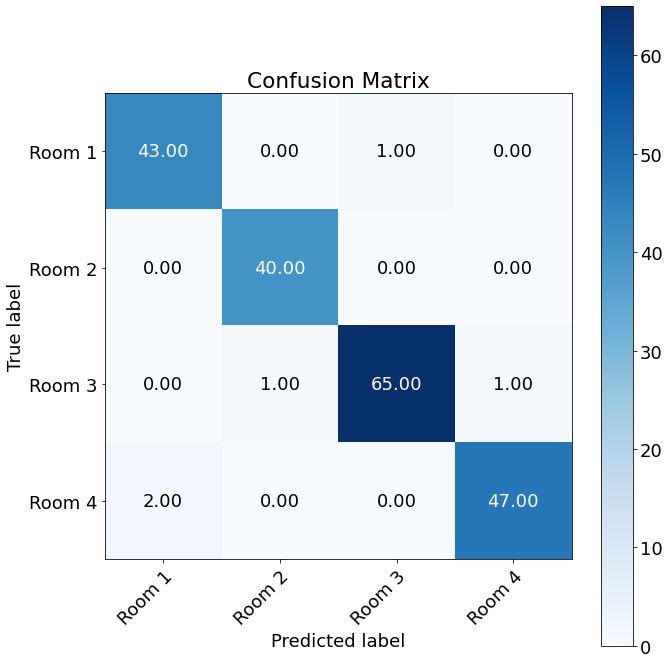

Accuracy pruned 1: 0.97
Macro recall pruned 1: 0.9748705452330185
Macro precision pruned 1: 0.9677409105832265


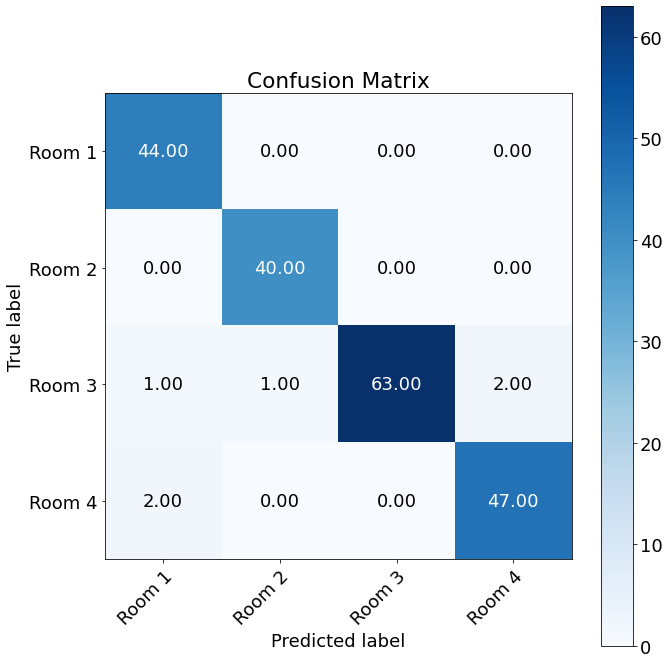

 
Accuracy pruned 2: 0.97
Macro recall pruned 2: 0.9748705452330185
Macro precision pruned 2: 0.9677409105832265


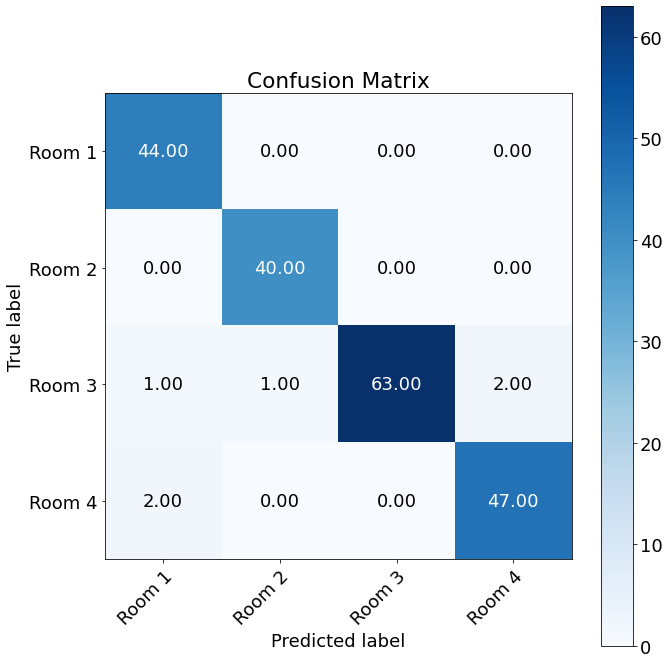

 
Outer Fold:1, Inner fold:5
Accuracy original: 0.965
Macro recall original: 0.9691887270512004
Macro precision original: 0.9623324450904392
 


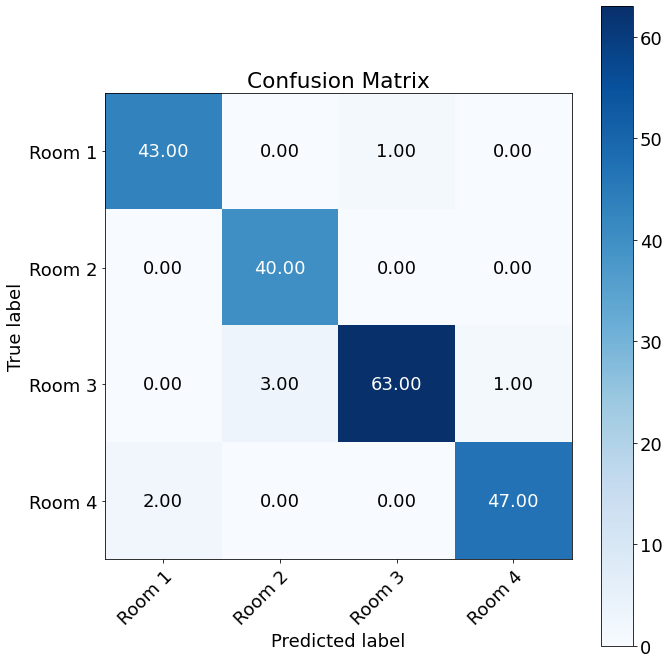

Accuracy pruned 1: 0.96
Macro recall pruned 1: 0.9654573837676182
Macro precision pruned 1: 0.9572746928228656


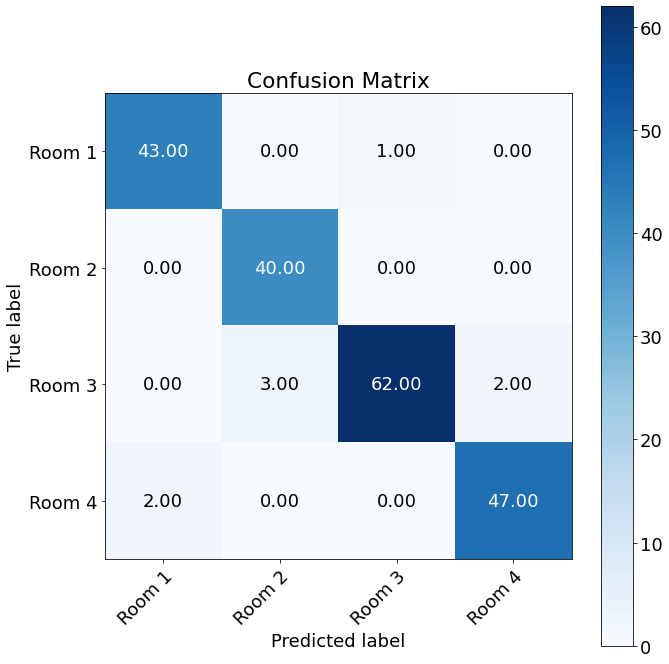

 
Accuracy pruned 2: 0.96
Macro recall pruned 2: 0.9654573837676182
Macro precision pruned 2: 0.9572746928228656


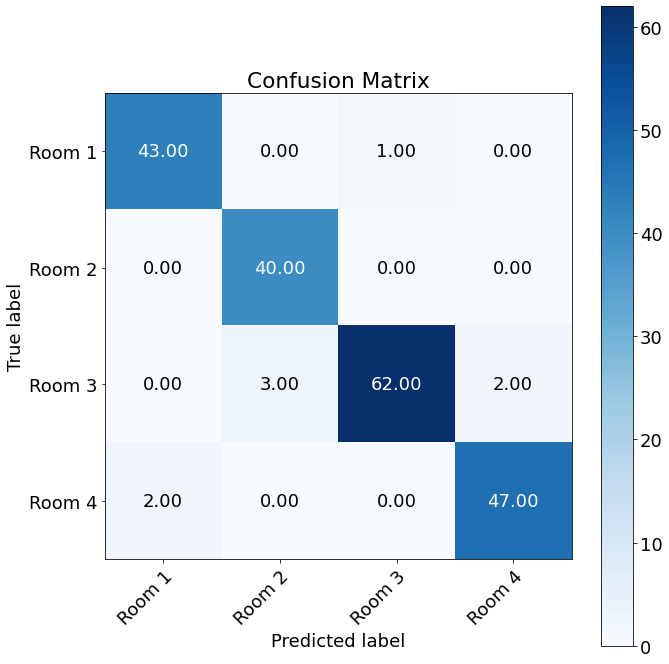

 
Outer Fold:1, Inner fold:6
Accuracy original: 0.975
Macro recall original: 0.9766514136183646
Macro precision original: 0.9755496009420745
 


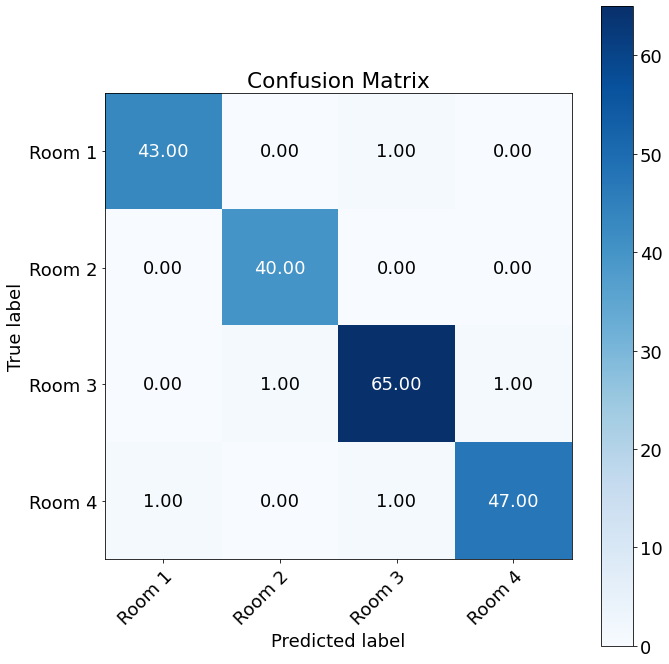

Accuracy pruned 1: 0.97
Macro recall pruned 1: 0.9729200703347824
Macro precision pruned 1: 0.9687410924344723


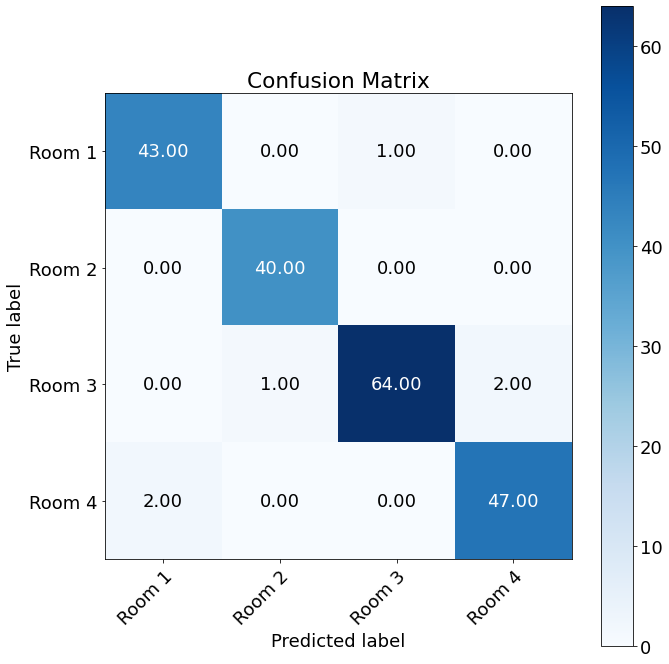

 
Accuracy pruned 2: 0.97
Macro recall pruned 2: 0.9729200703347824
Macro precision pruned 2: 0.9687410924344723


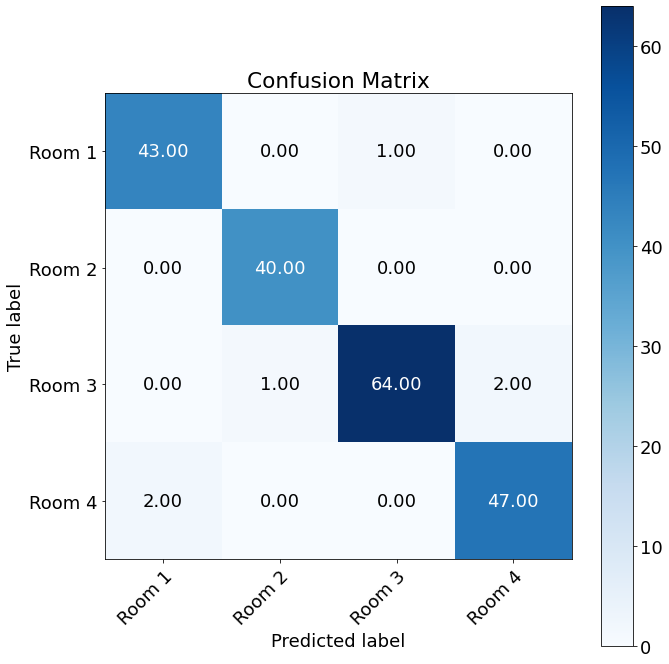

 
Outer Fold:1, Inner fold:7
Accuracy original: 0.975
Macro recall original: 0.9747009387201285
Macro precision original: 0.9747009387201285
 


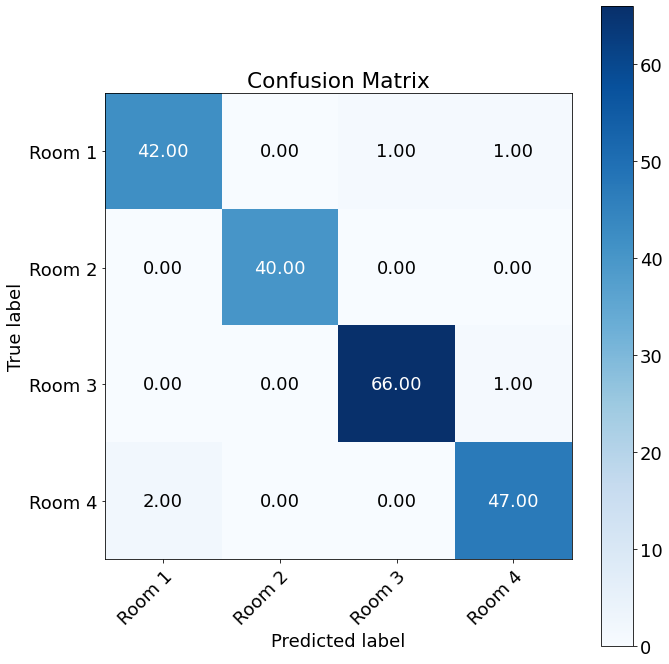

Accuracy pruned 1: 0.96
Macro recall pruned 1: 0.9604200703347825
Macro precision pruned 1: 0.9610805209952331


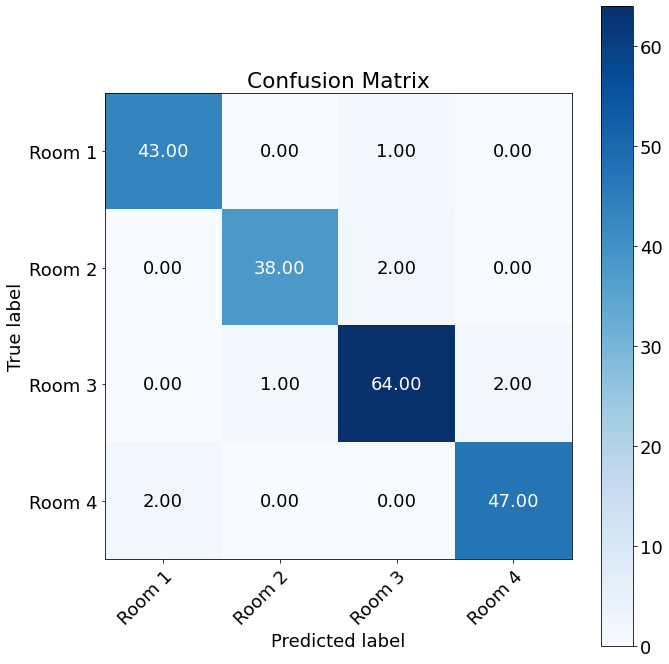

 
Accuracy pruned 2: 0.96
Macro recall pruned 2: 0.9604200703347825
Macro precision pruned 2: 0.9610805209952331


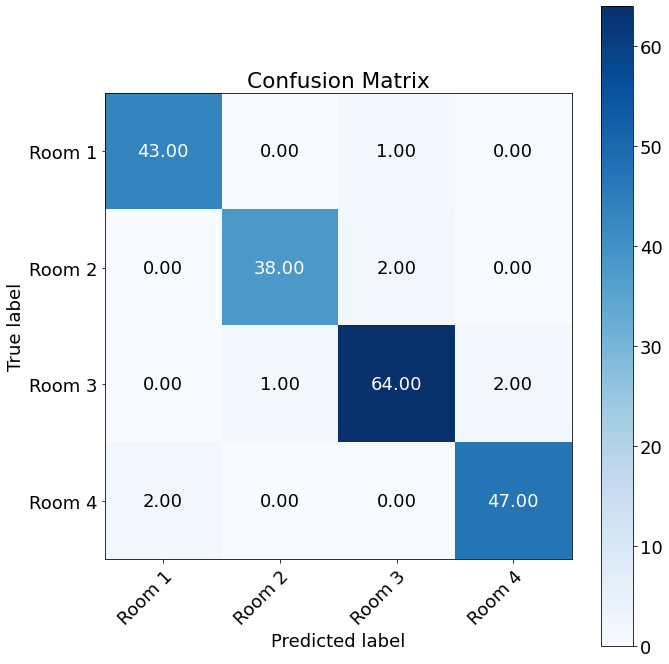

 
Outer Fold:1, Inner fold:8
Accuracy original: 0.965
Macro recall original: 0.9691887270512004
Macro precision original: 0.9623324450904392
 


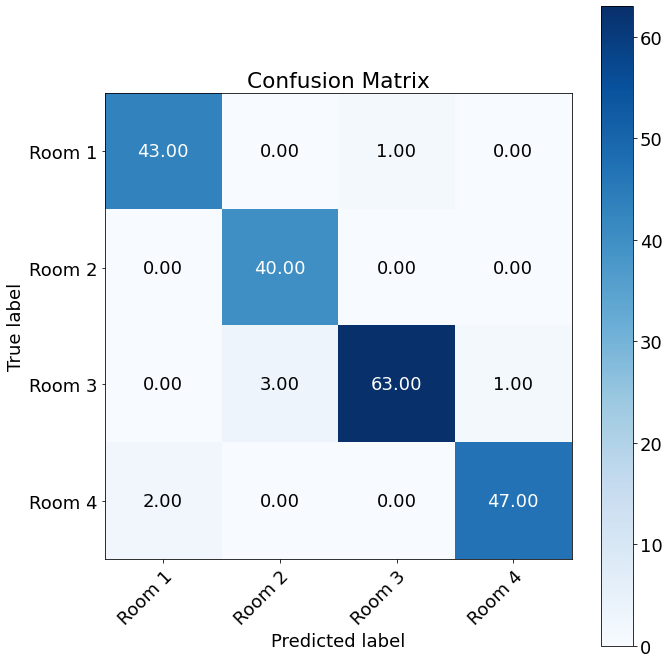

Accuracy pruned 1: 0.955
Macro recall pruned 1: 0.9586392019494364
Macro precision pruned 1: 0.9535259715588363


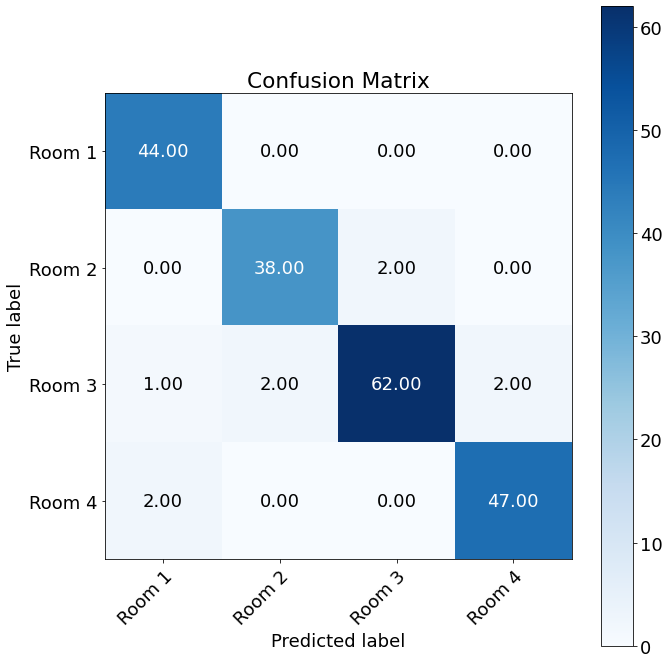

 
Accuracy pruned 2: 0.955
Macro recall pruned 2: 0.9586392019494364
Macro precision pruned 2: 0.9535259715588363


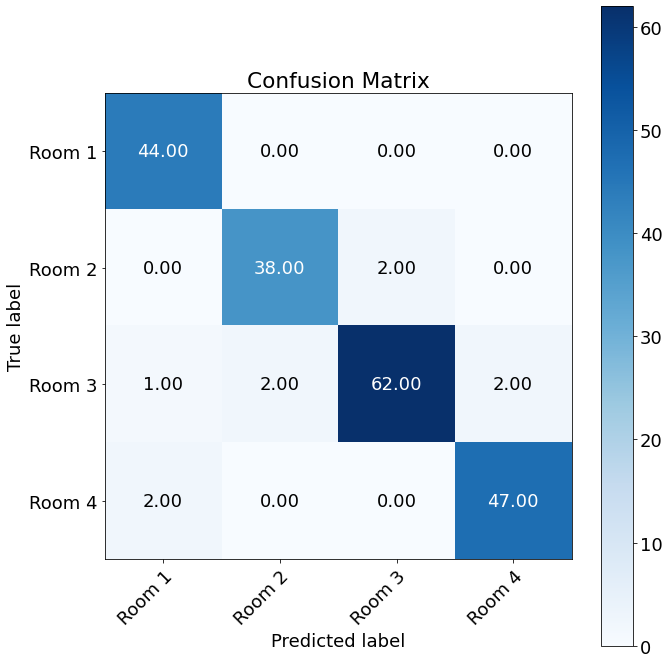

 
Outer Fold:1, Inner fold:9
Accuracy original: 0.98
Macro recall original: 0.9803827569019467
Macro precision original: 0.9799492122719734
 


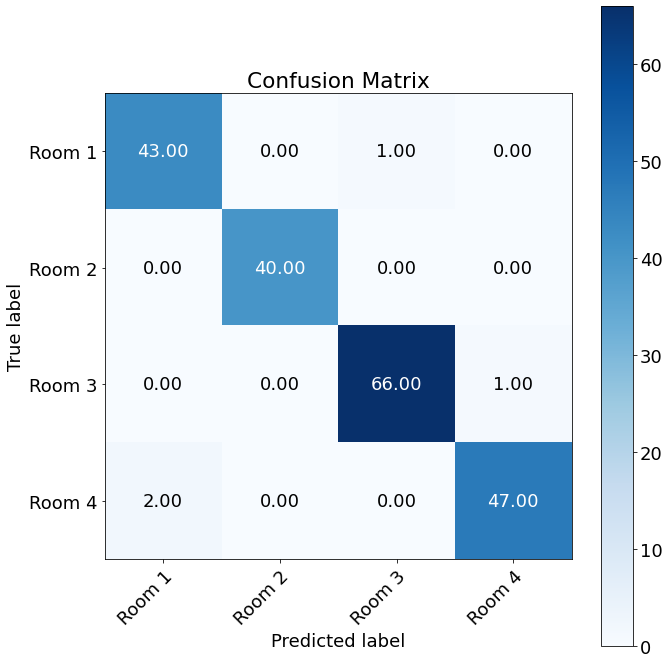

Accuracy pruned 1: 0.95
Macro recall pruned 1: 0.9504387270512004
Macro precision pruned 1: 0.9509389213013947


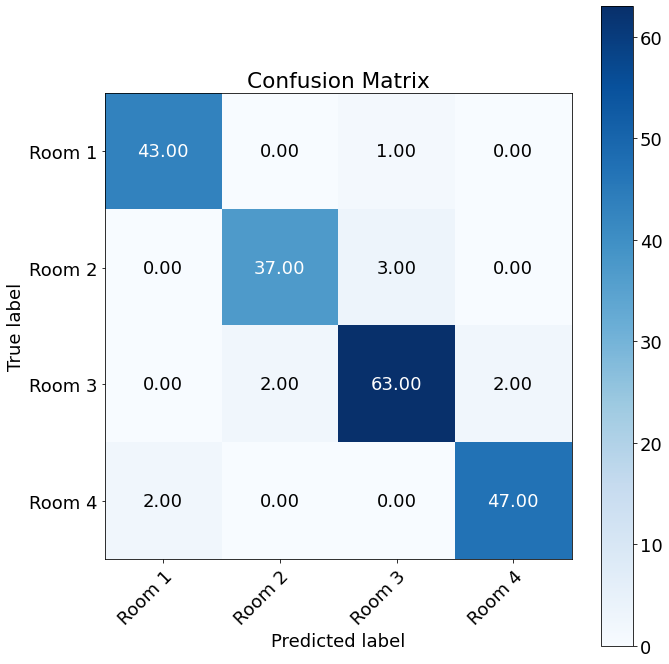

 
Accuracy pruned 2: 0.95
Macro recall pruned 2: 0.9504387270512004
Macro precision pruned 2: 0.9509389213013947


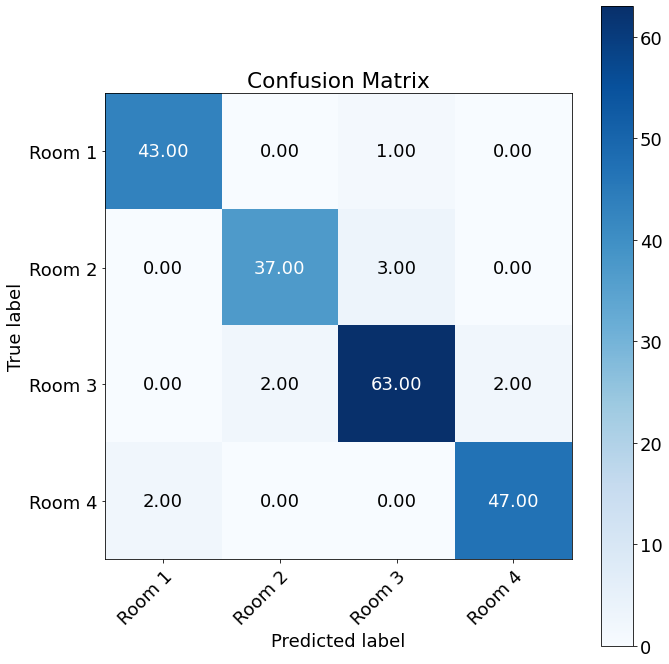

 
Outer Fold:1, Inner fold:10
Accuracy original: 0.97
Macro recall original: 0.9748705452330185
Macro precision original: 0.9664802409841591
 


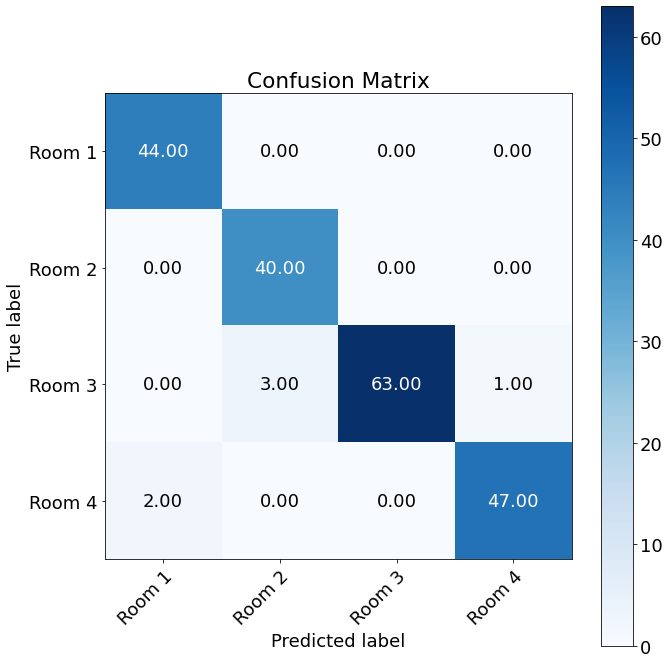

Accuracy pruned 1: 0.965
Macro recall pruned 1: 0.9661018885166006
Macro precision pruned 1: 0.9649403391639416


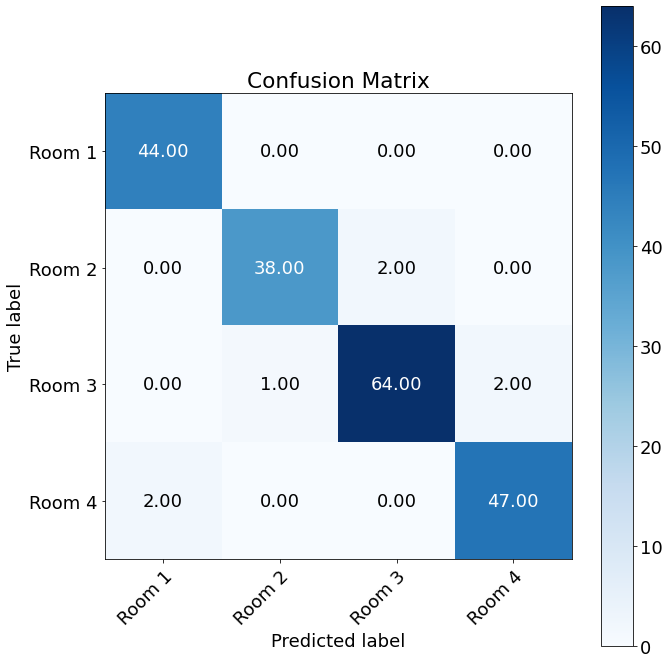

 
Accuracy pruned 2: 0.965
Macro recall pruned 2: 0.9661018885166006
Macro precision pruned 2: 0.9649403391639416


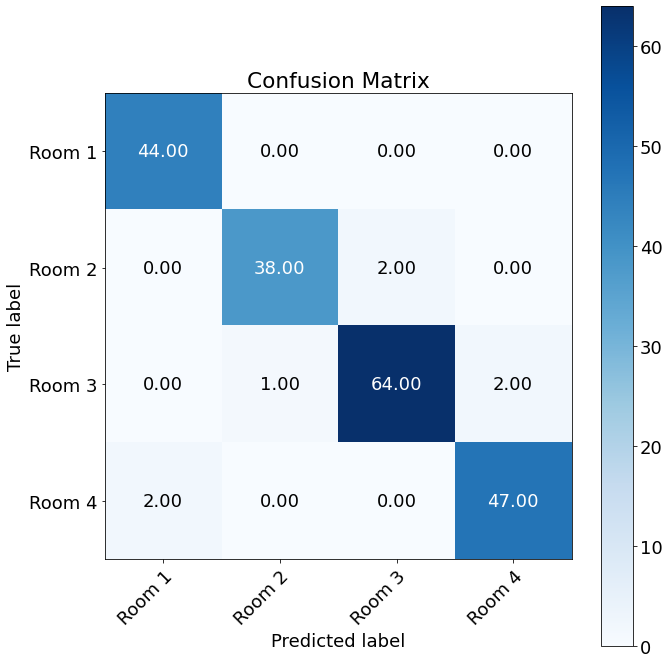

 
Outer Fold:2, Inner fold:1
Accuracy original: 0.965
Macro recall original: 0.961352657004831
Macro precision original: 0.9628785320274682
 


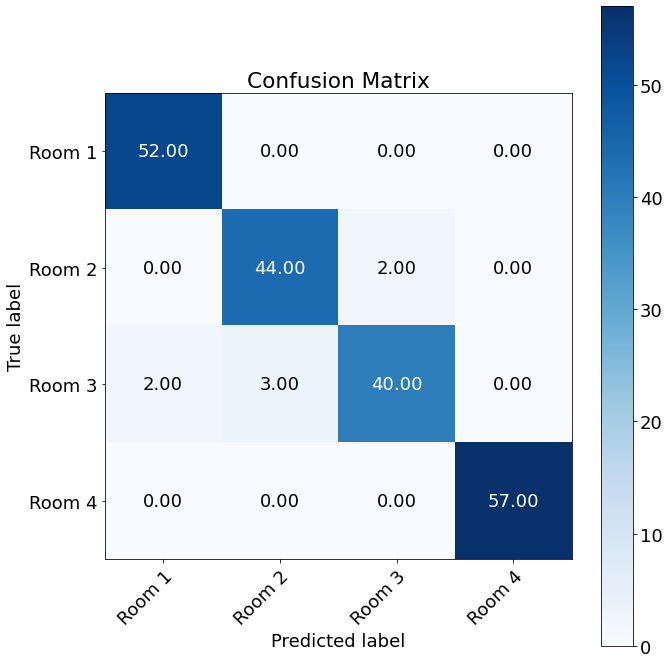

Accuracy pruned 1: 0.96
Macro recall pruned 1: 0.9570874650394101
Macro precision pruned 1: 0.9574074074074074


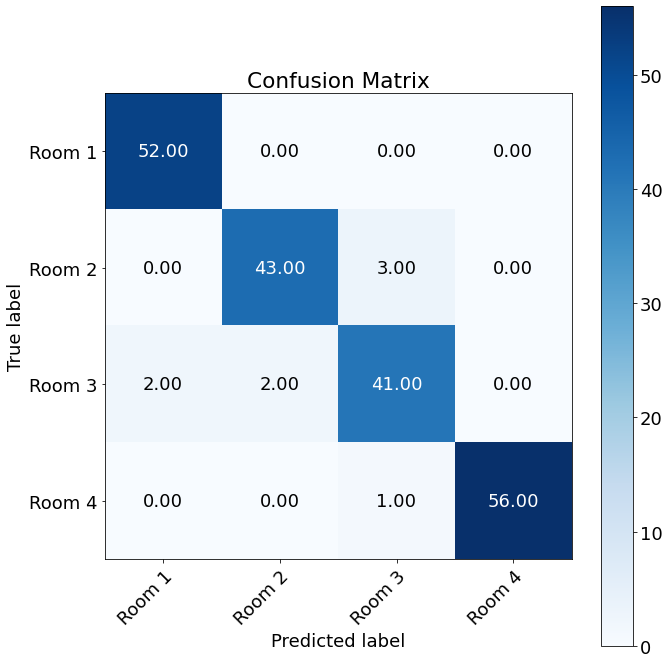

 
Accuracy pruned 2: 0.96
Macro recall pruned 2: 0.9570874650394101
Macro precision pruned 2: 0.9574074074074074


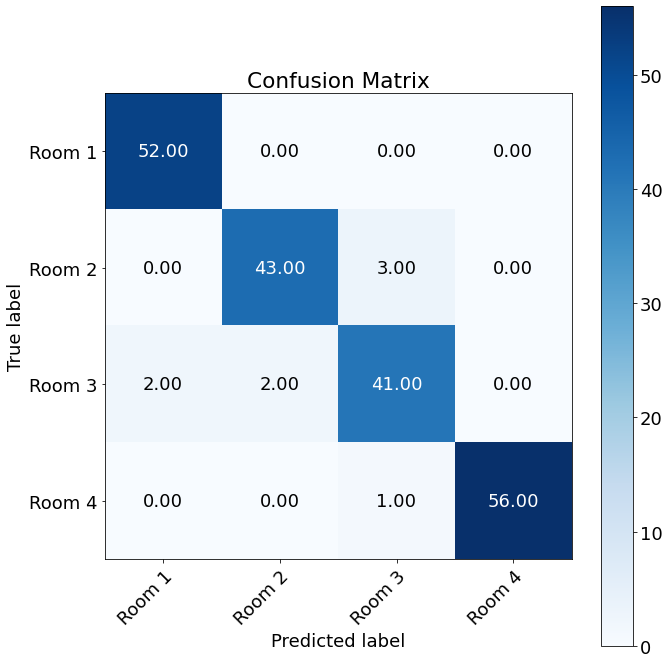

 
Outer Fold:2, Inner fold:2
Accuracy original: 0.955
Macro recall original: 0.9506038647342995
Macro precision original: 0.9519389207205182
 


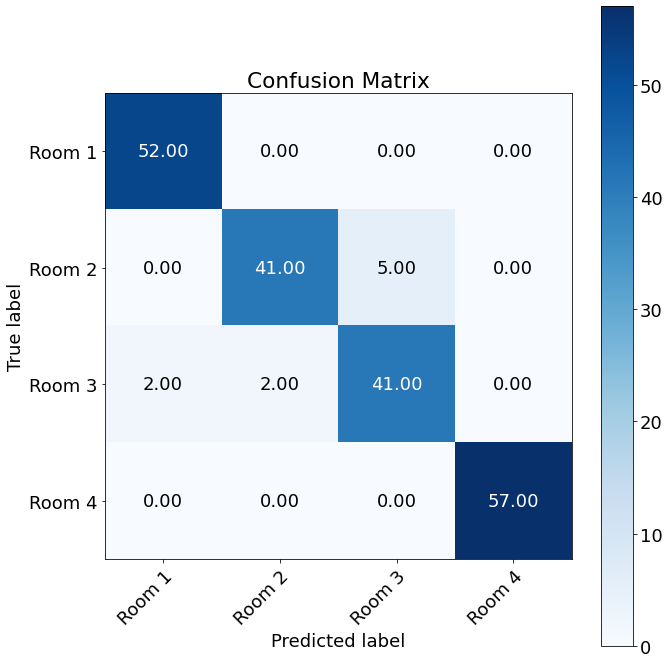

Accuracy pruned 1: 0.965
Macro recall pruned 1: 0.9615942028985507
Macro precision pruned 1: 0.9621802520695055


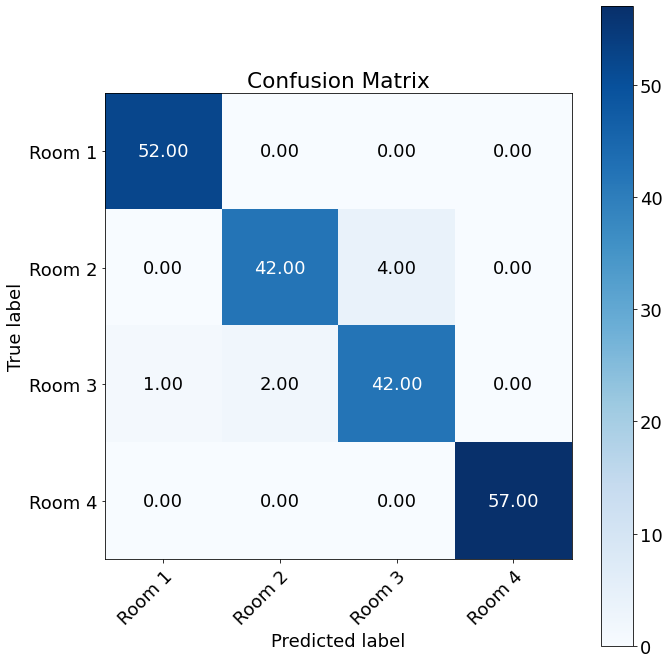

 
Accuracy pruned 2: 0.965
Macro recall pruned 2: 0.9615942028985507
Macro precision pruned 2: 0.9621802520695055


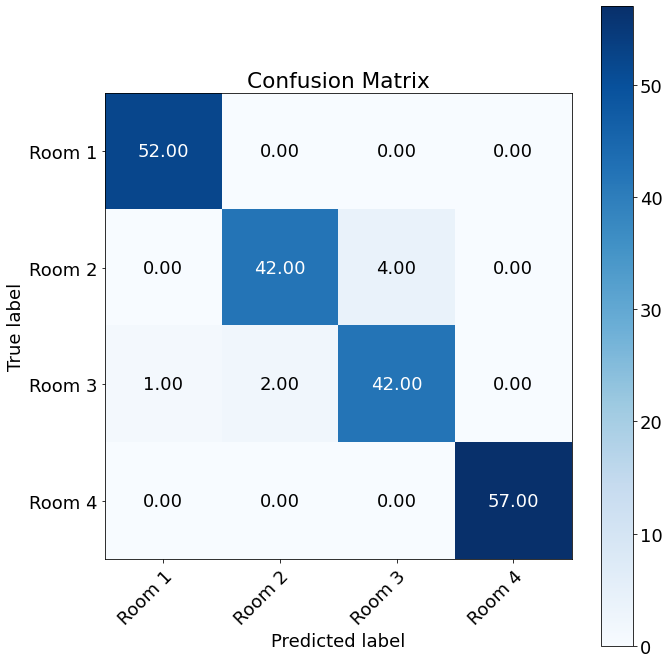

 
Outer Fold:2, Inner fold:3
Accuracy original: 0.955
Macro recall original: 0.9504830917874396
Macro precision original: 0.9513468013468014
 


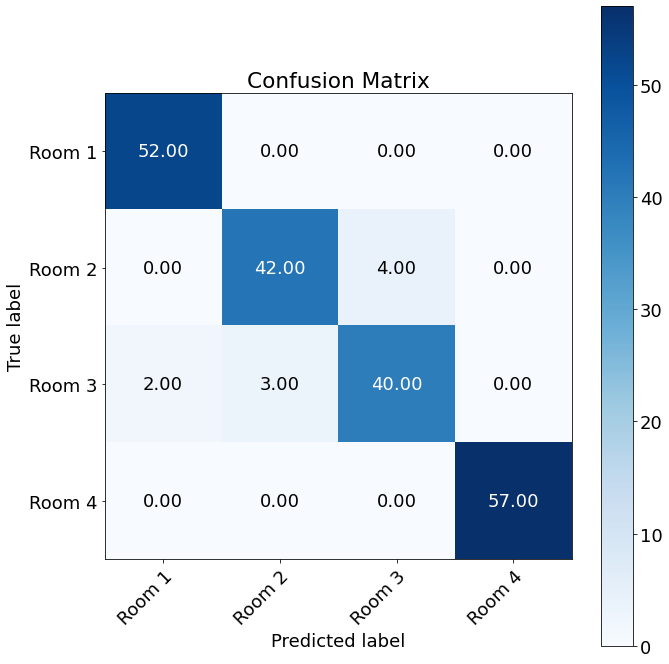

Accuracy pruned 1: 0.955
Macro recall pruned 1: 0.9516526824307144
Macro precision pruned 1: 0.9522031913336261


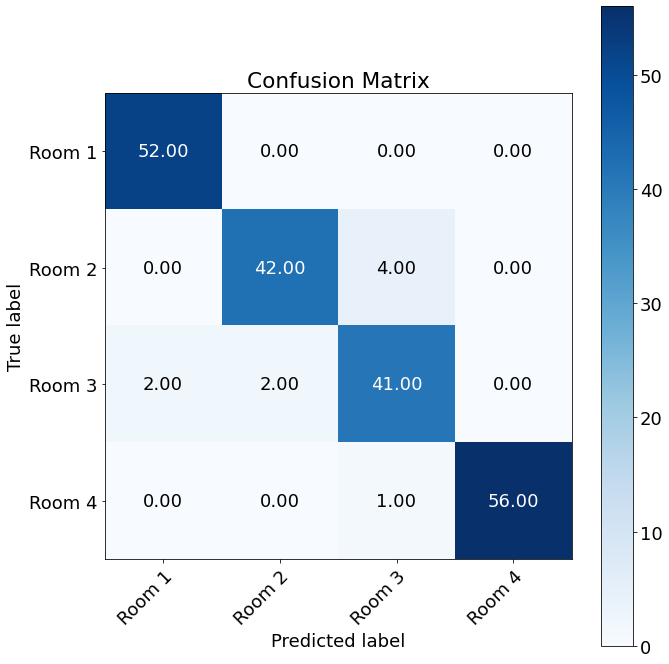

 
Accuracy pruned 2: 0.955
Macro recall pruned 2: 0.9516526824307144
Macro precision pruned 2: 0.9522031913336261


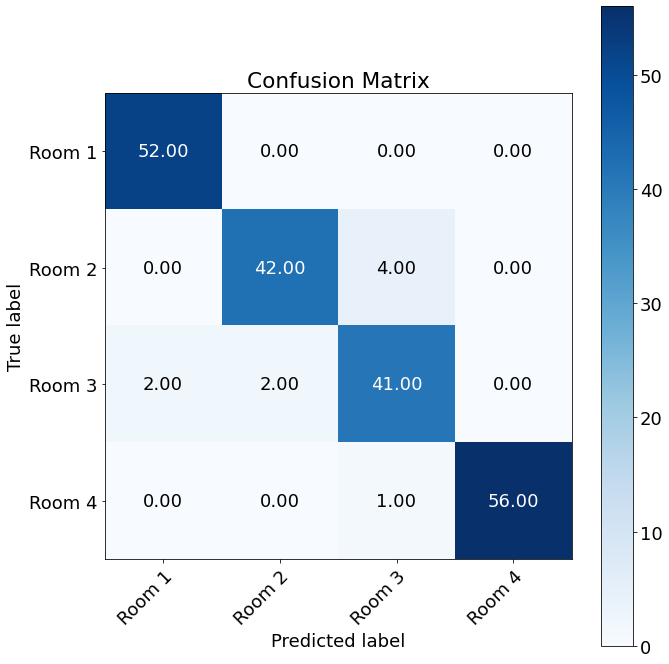

 
Outer Fold:2, Inner fold:4
Accuracy original: 0.955
Macro recall original: 0.9524005456785777
Macro precision original: 0.9534199293003403
 


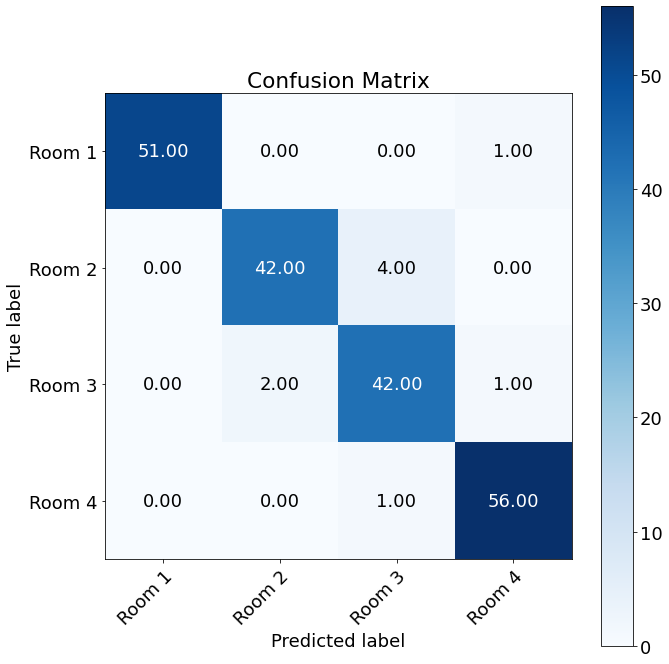

Accuracy pruned 1: 0.965
Macro recall pruned 1: 0.9622212931995541
Macro precision pruned 1: 0.9637476459510359


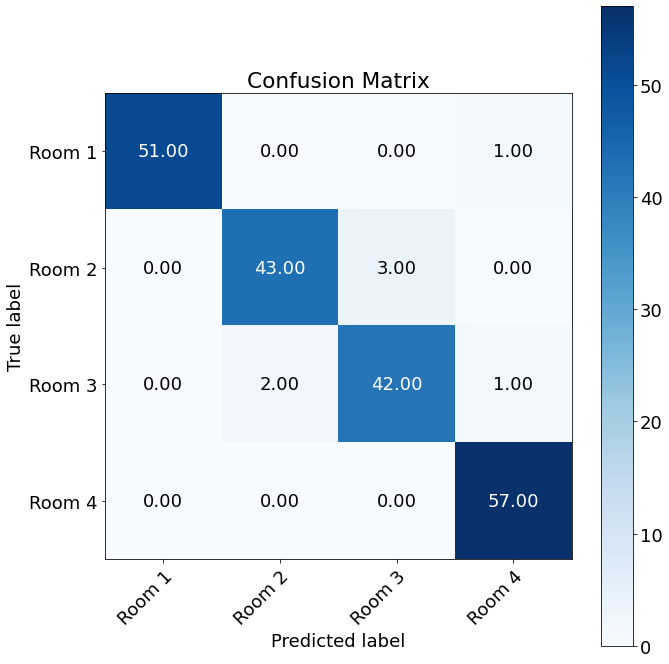

 
Accuracy pruned 2: 0.965
Macro recall pruned 2: 0.9622212931995541
Macro precision pruned 2: 0.9637476459510359


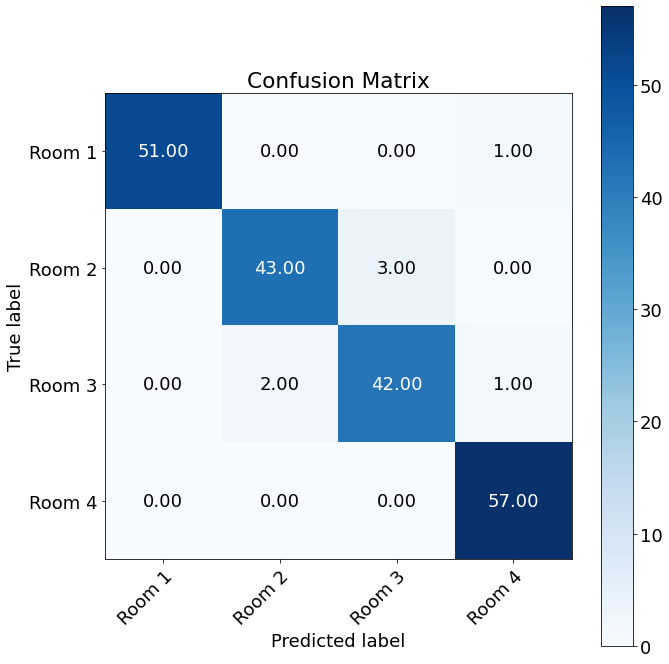

 
Outer Fold:2, Inner fold:5
Accuracy original: 0.95
Macro recall original: 0.9450483091787439
Macro precision original: 0.9452830188679245
 


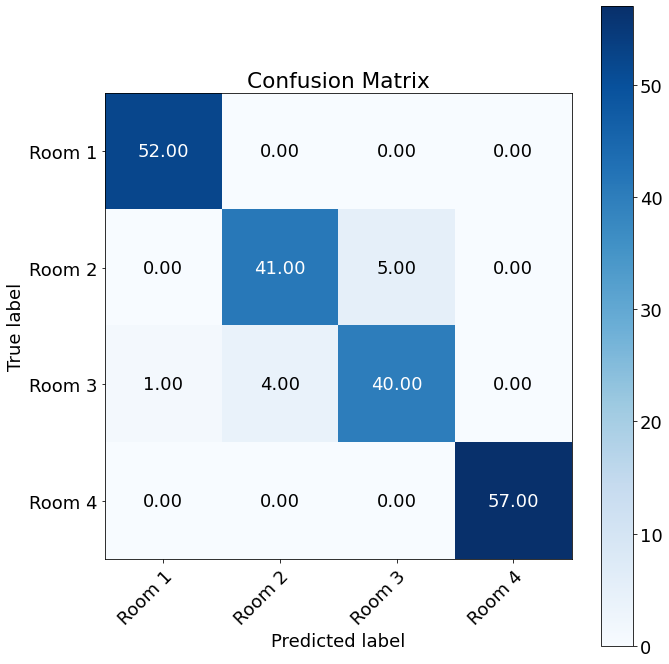

Accuracy pruned 1: 0.96
Macro recall pruned 1: 0.9560386473429952
Macro precision pruned 1: 0.9563941299790356


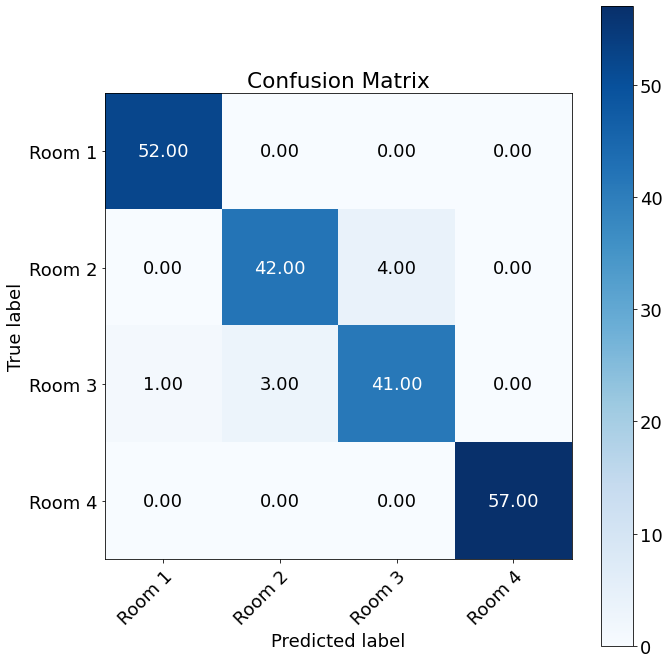

 
Accuracy pruned 2: 0.96
Macro recall pruned 2: 0.9560386473429952
Macro precision pruned 2: 0.9563941299790356


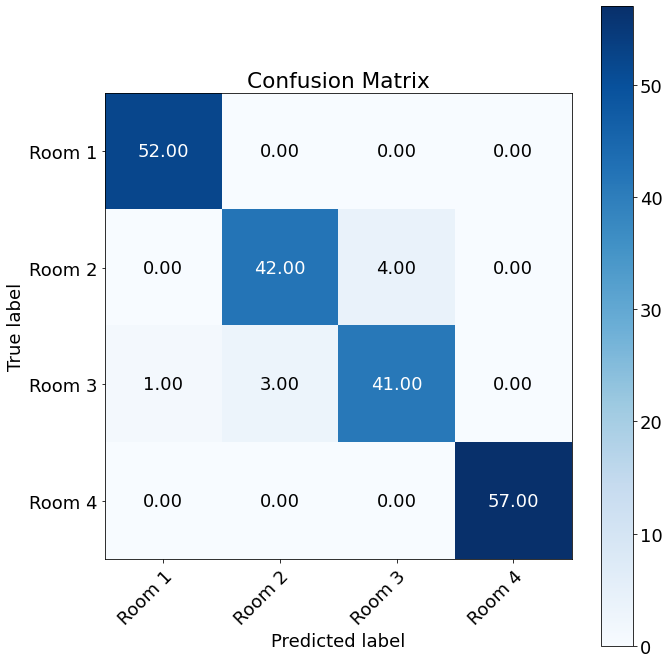

 
Outer Fold:2, Inner fold:6
Accuracy original: 0.945
Macro recall original: 0.9394927536231884
Macro precision original: 0.9401094276094276
 


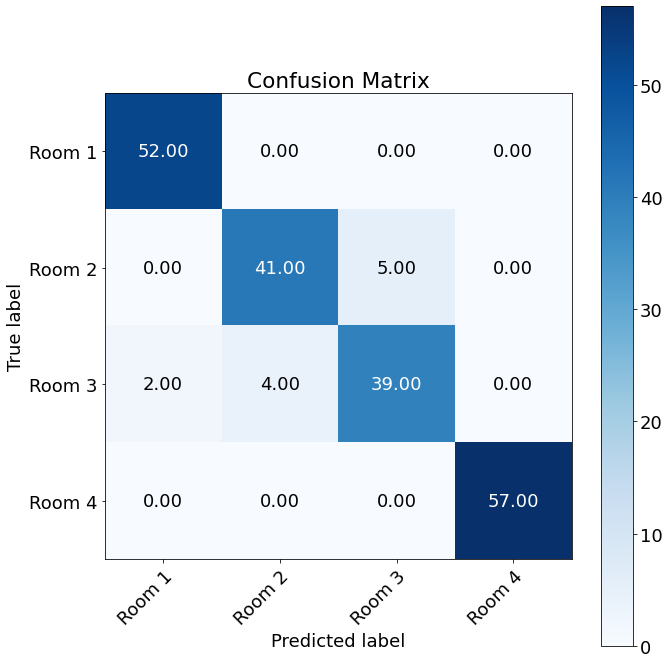

Accuracy pruned 1: 0.96
Macro recall pruned 1: 0.95720823798627
Macro precision pruned 1: 0.9573236378234371


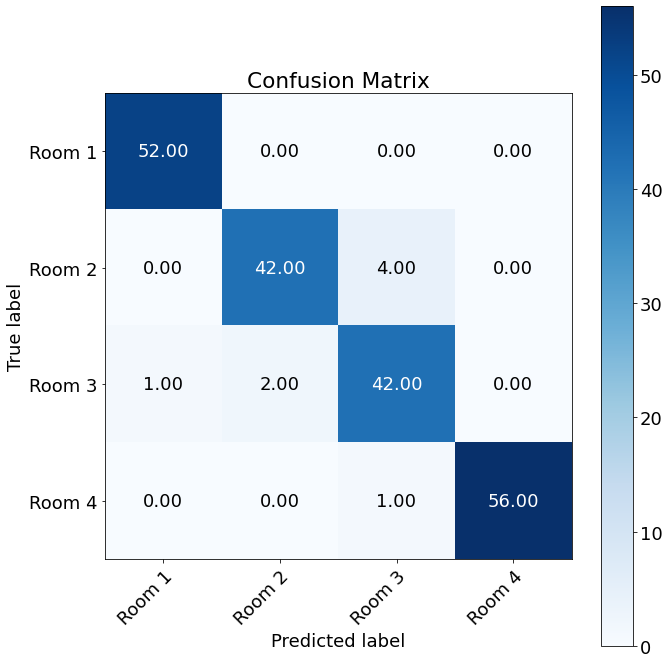

 
Accuracy pruned 2: 0.96
Macro recall pruned 2: 0.95720823798627
Macro precision pruned 2: 0.9573236378234371


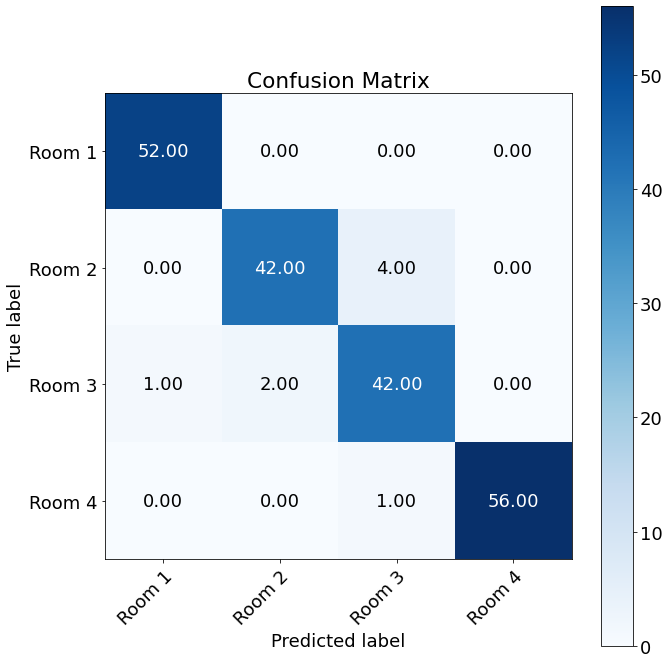

 
Outer Fold:2, Inner fold:7
Accuracy original: 0.945
Macro recall original: 0.9420372978153299
Macro precision original: 0.943848625401792
 


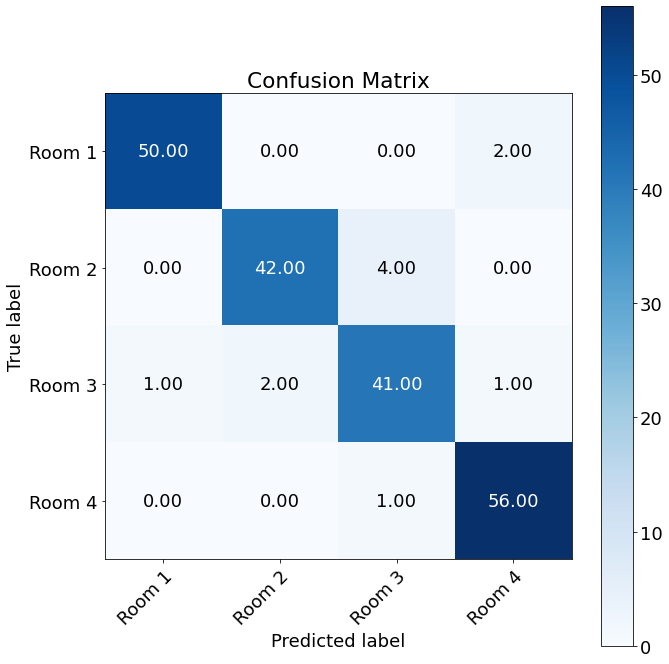

Accuracy pruned 1: 0.955
Macro recall pruned 1: 0.9515319094838546
Macro precision pruned 1: 0.9517091201873811


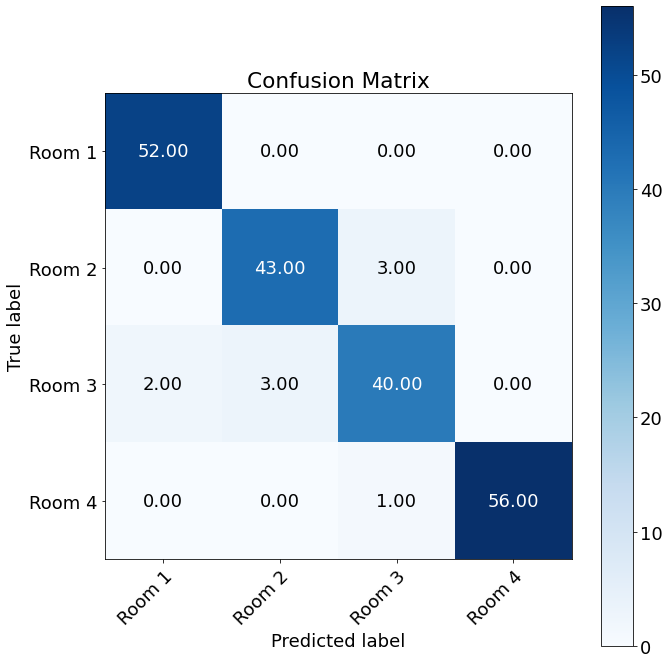

 
Accuracy pruned 2: 0.955
Macro recall pruned 2: 0.9515319094838546
Macro precision pruned 2: 0.9517091201873811


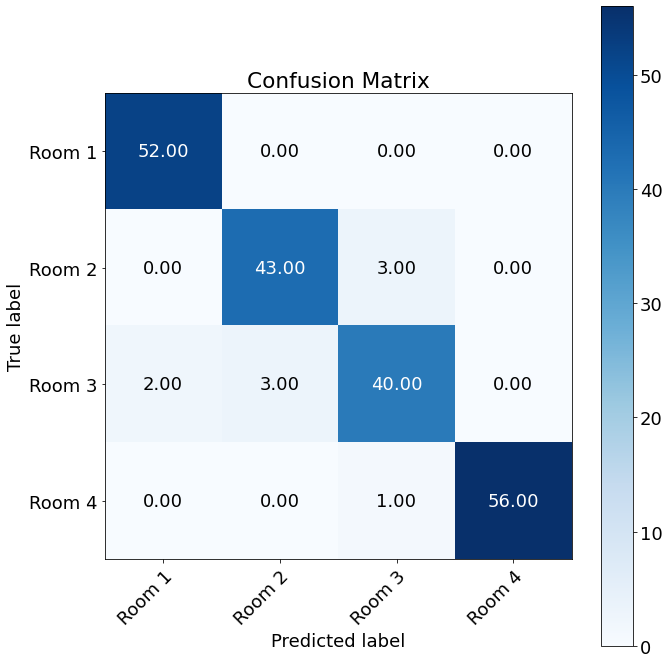

 
Outer Fold:2, Inner fold:8
Accuracy original: 0.955
Macro recall original: 0.9506038647342995
Macro precision original: 0.951470287583481
 


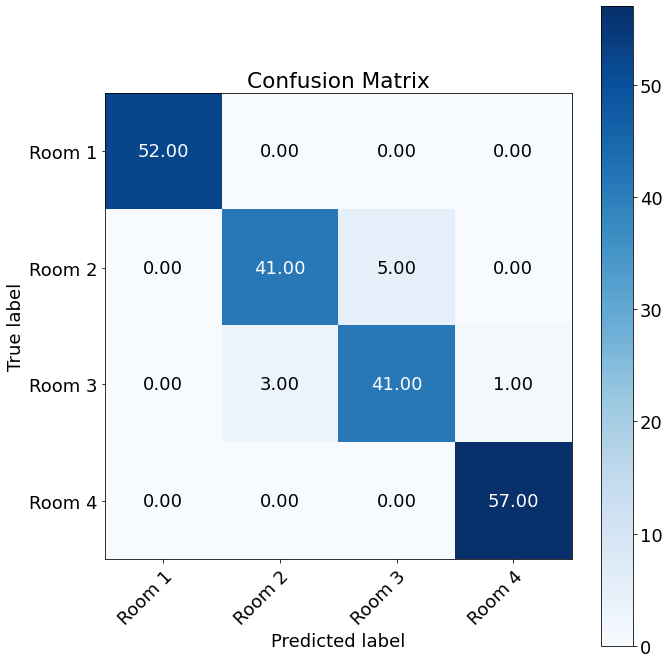

Accuracy pruned 1: 0.96
Macro recall pruned 1: 0.9560386473429952
Macro precision pruned 1: 0.9563941299790356


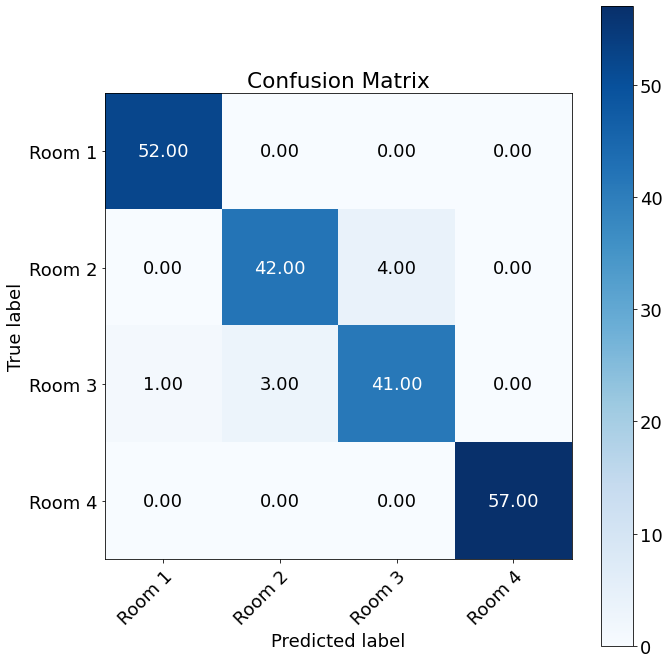

 
Accuracy pruned 2: 0.96
Macro recall pruned 2: 0.9560386473429952
Macro precision pruned 2: 0.9563941299790356


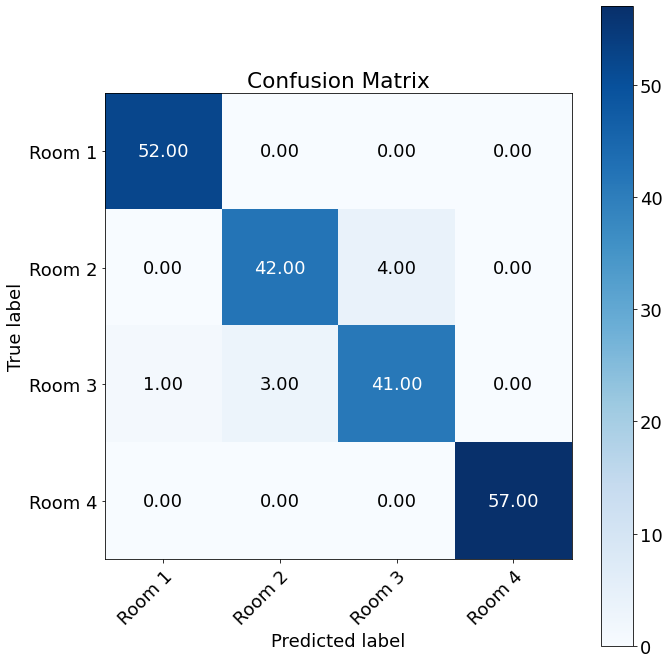

 
Outer Fold:2, Inner fold:9
Accuracy original: 0.955
Macro recall original: 0.9506038647342995
Macro precision original: 0.9519389207205182
 


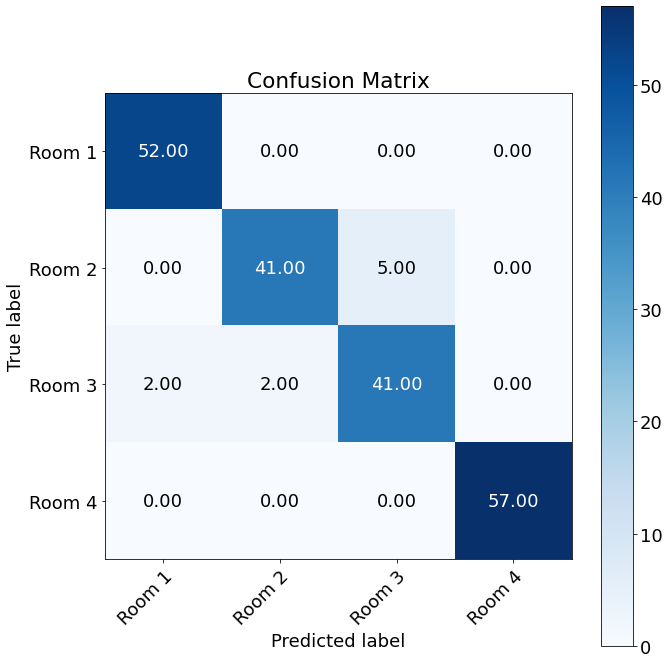

Accuracy pruned 1: 0.955
Macro recall pruned 1: 0.9516526824307144
Macro precision pruned 1: 0.9514424391577796


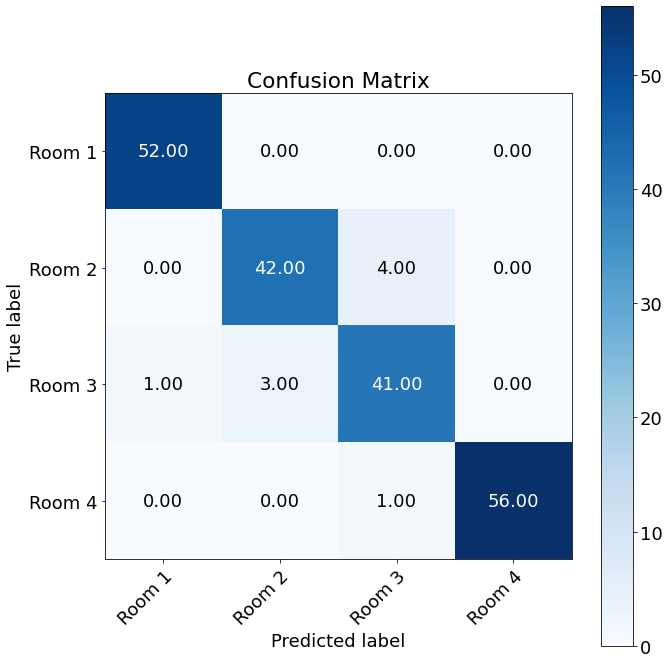

 
Accuracy pruned 2: 0.955
Macro recall pruned 2: 0.9516526824307144
Macro precision pruned 2: 0.9514424391577796


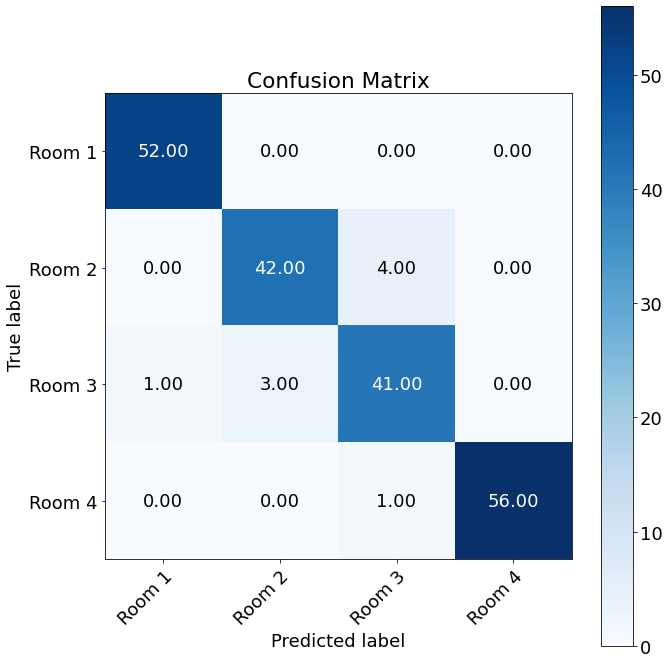

 
Outer Fold:2, Inner fold:10
Accuracy original: 0.95
Macro recall original: 0.9450483091787439
Macro precision original: 0.946149441717106
 


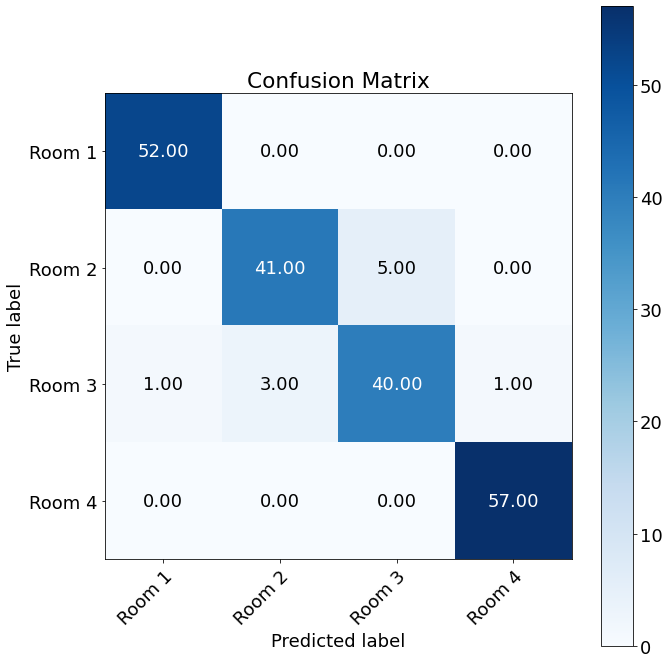

Accuracy pruned 1: 0.965
Macro recall pruned 1: 0.9615942028985507
Macro precision pruned 1: 0.9621802520695055


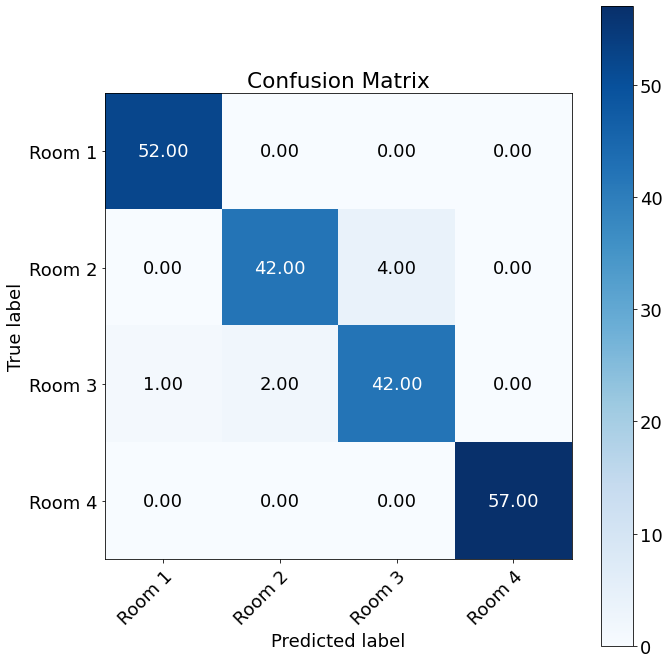

 
Accuracy pruned 2: 0.965
Macro recall pruned 2: 0.9615942028985507
Macro precision pruned 2: 0.9621802520695055


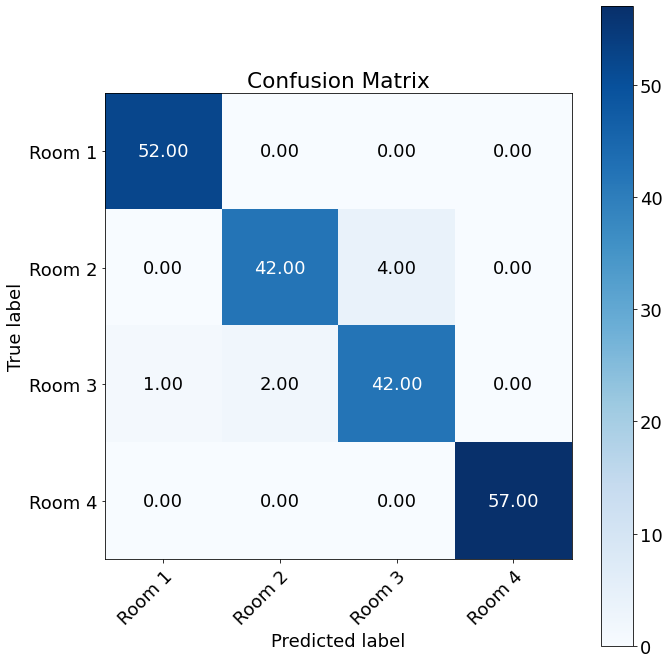

 
Outer Fold:3, Inner fold:1
Accuracy original: 0.99
Macro recall original: 0.9888755980861245
Macro precision original: 0.9908187331536388
 


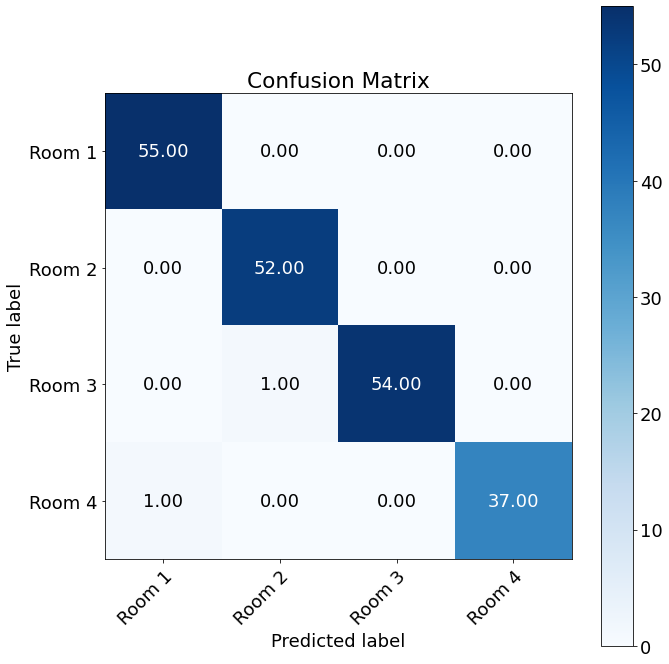

Accuracy pruned 1: 0.995
Macro recall pruned 1: 0.993421052631579
Macro precision pruned 1: 0.9955357142857143


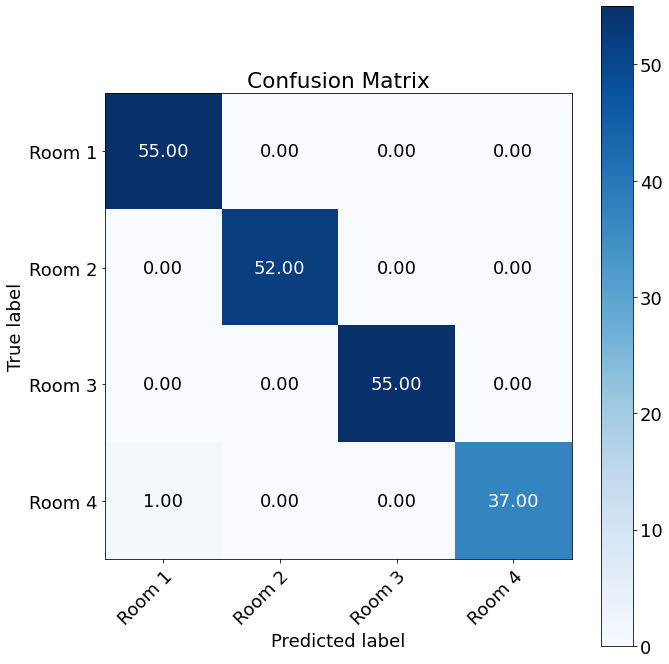

 
Accuracy pruned 2: 0.995
Macro recall pruned 2: 0.993421052631579
Macro precision pruned 2: 0.9955357142857143


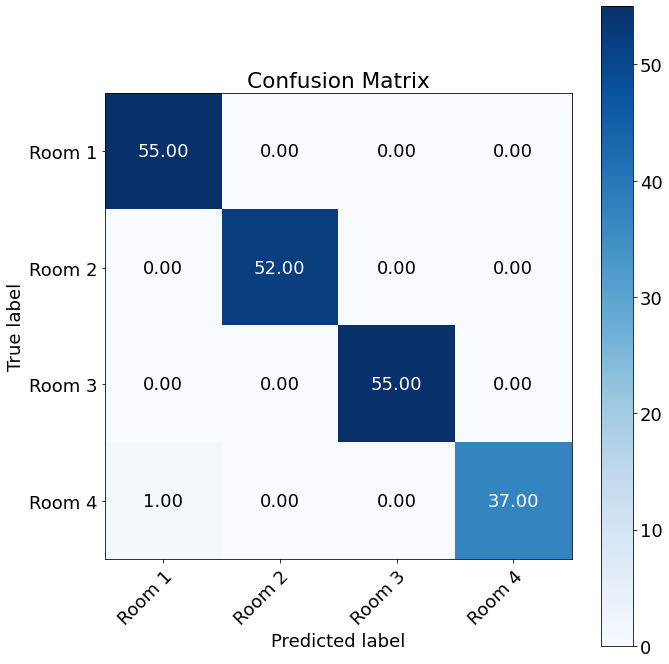

 
Outer Fold:3, Inner fold:2
Accuracy original: 0.985
Macro recall original: 0.9843301435406699
Macro precision original: 0.986276455026455
 


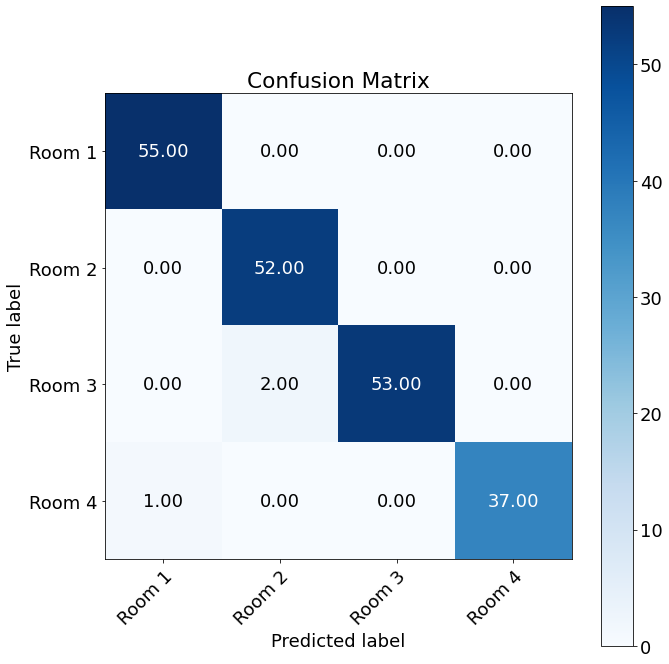

Accuracy pruned 1: 0.98
Macro recall pruned 1: 0.977488958410011
Macro precision pruned 1: 0.9817994505494505


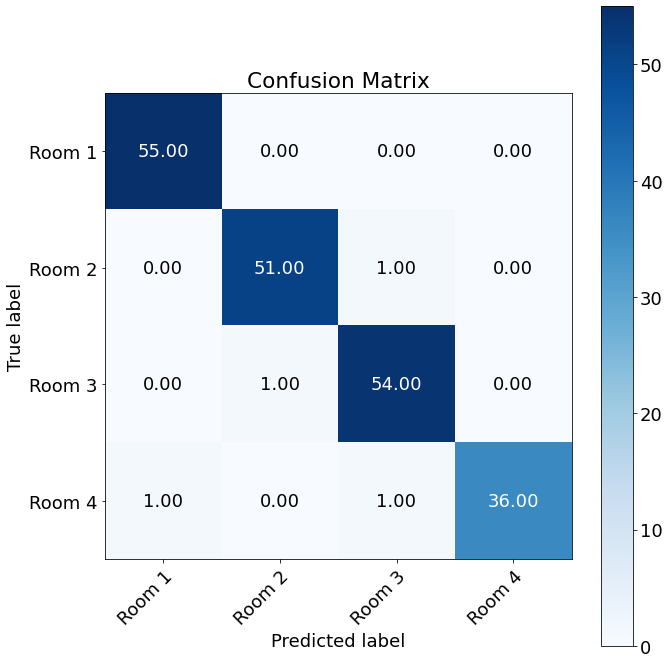

 
Accuracy pruned 2: 0.98
Macro recall pruned 2: 0.977488958410011
Macro precision pruned 2: 0.9817994505494505


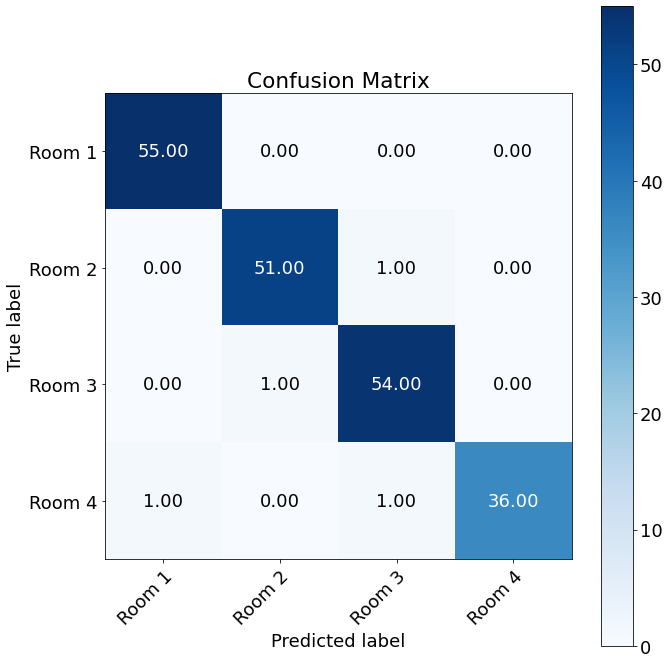

 
Outer Fold:3, Inner fold:3
Accuracy original: 0.99
Macro recall original: 0.9888755980861245
Macro precision original: 0.9908187331536388
 


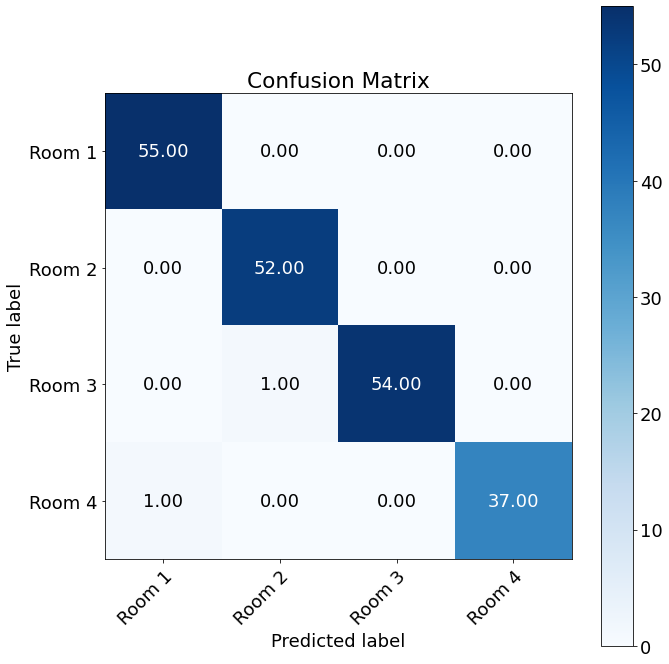

Accuracy pruned 1: 0.98
Macro recall pruned 1: 0.9797846889952153
Macro precision pruned 1: 0.9818993506493506


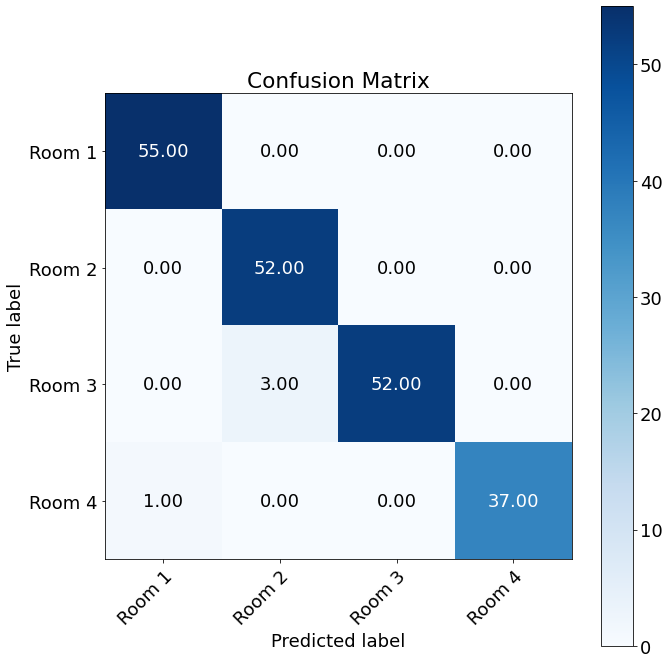

 
Accuracy pruned 2: 0.98
Macro recall pruned 2: 0.9797846889952153
Macro precision pruned 2: 0.9818993506493506


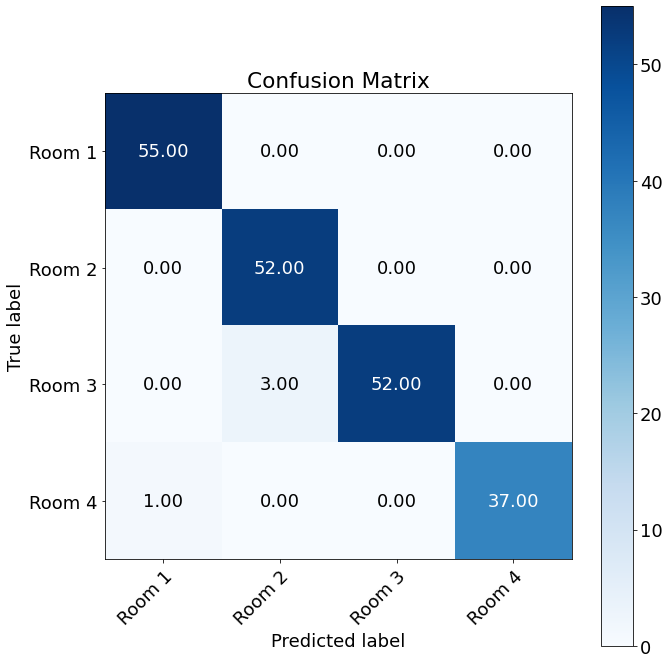

 
Outer Fold:3, Inner fold:4
Accuracy original: 0.96
Macro recall original: 0.9610783952889217
Macro precision original: 0.9600202429149798
 


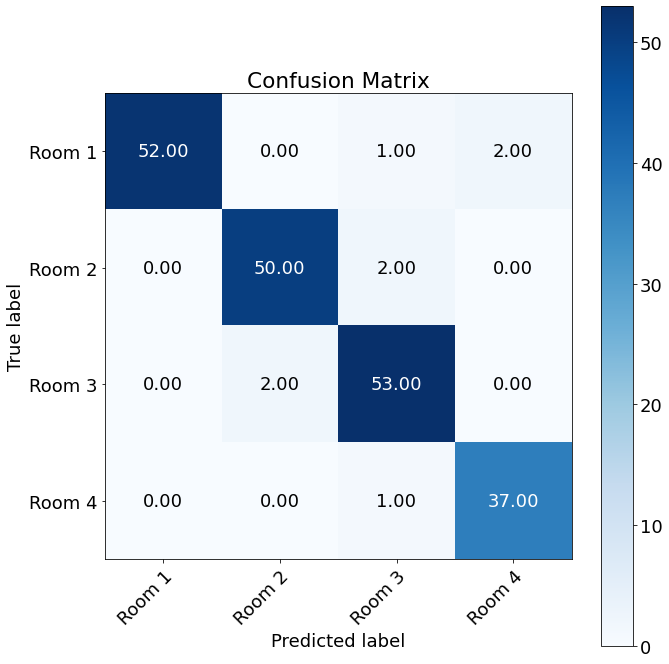

Accuracy pruned 1: 0.975
Macro recall pruned 1: 0.9729435038645565
Macro precision pruned 1: 0.9770108429306543


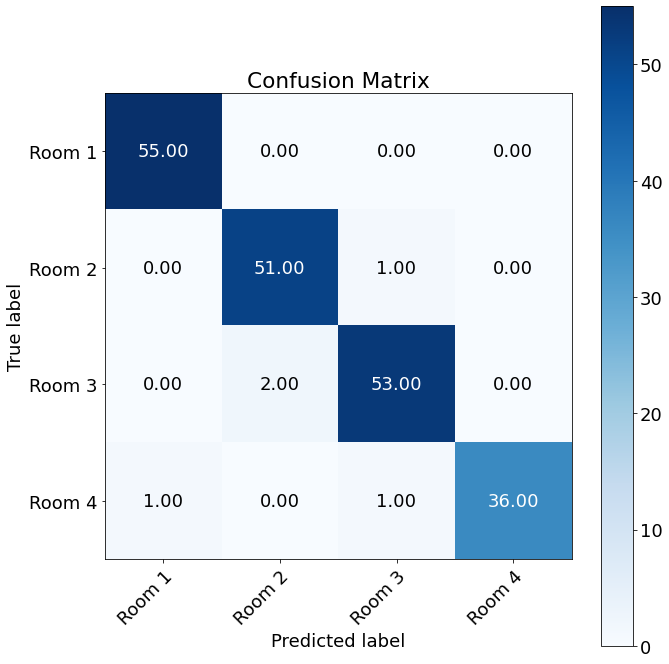

 
Accuracy pruned 2: 0.975
Macro recall pruned 2: 0.9729435038645565
Macro precision pruned 2: 0.9770108429306543


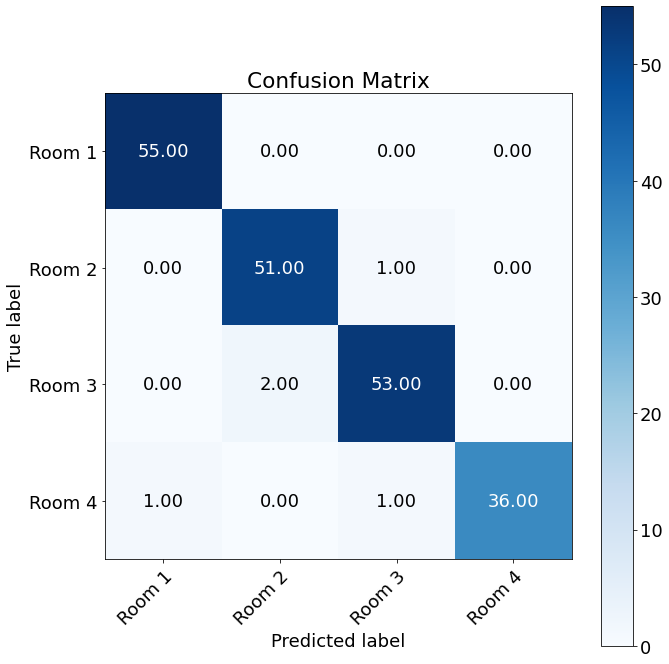

 
Outer Fold:3, Inner fold:5
Accuracy original: 0.98
Macro recall original: 0.9797846889952153
Macro precision original: 0.9816498316498317
 


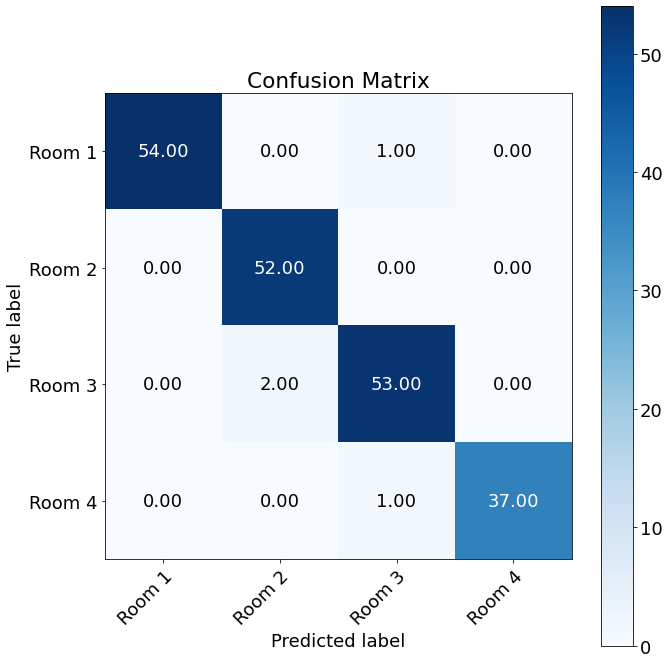

Accuracy pruned 1: 0.985
Macro recall pruned 1: 0.9843301435406699
Macro precision pruned 1: 0.986276455026455


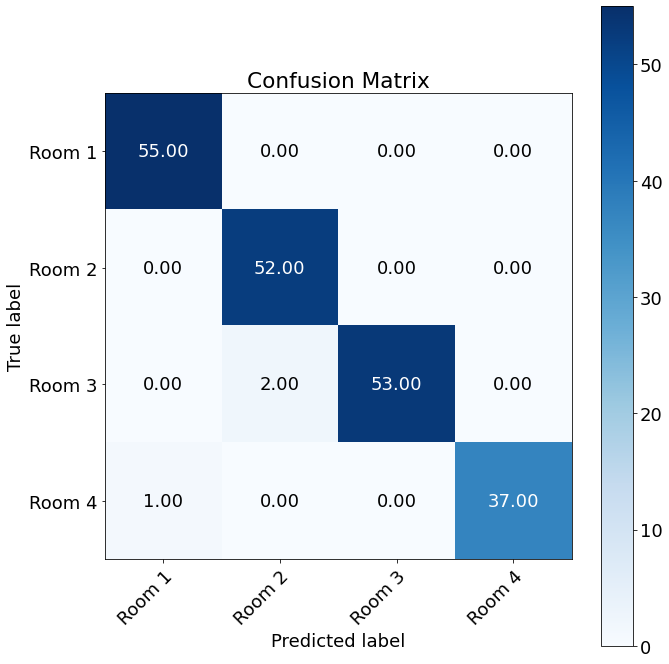

 
Accuracy pruned 2: 0.985
Macro recall pruned 2: 0.9843301435406699
Macro precision pruned 2: 0.986276455026455


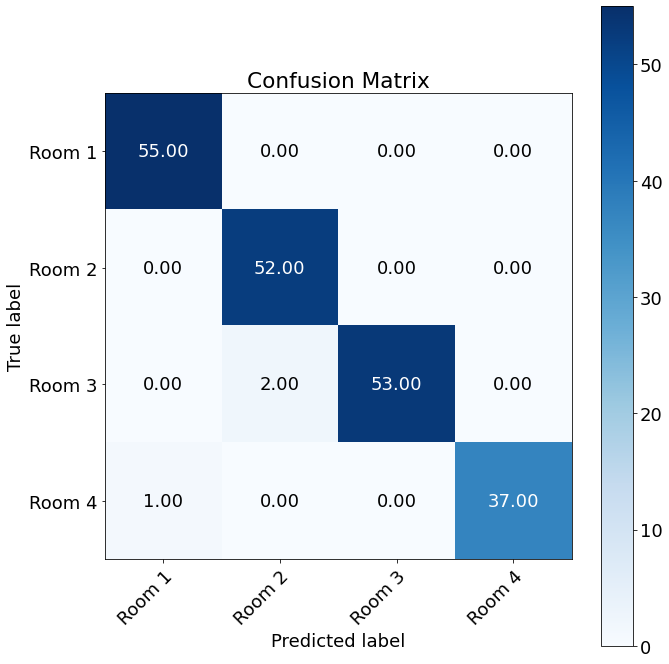

 
Outer Fold:3, Inner fold:6
Accuracy original: 0.985
Macro recall original: 0.9843301435406699
Macro precision original: 0.986276455026455
 


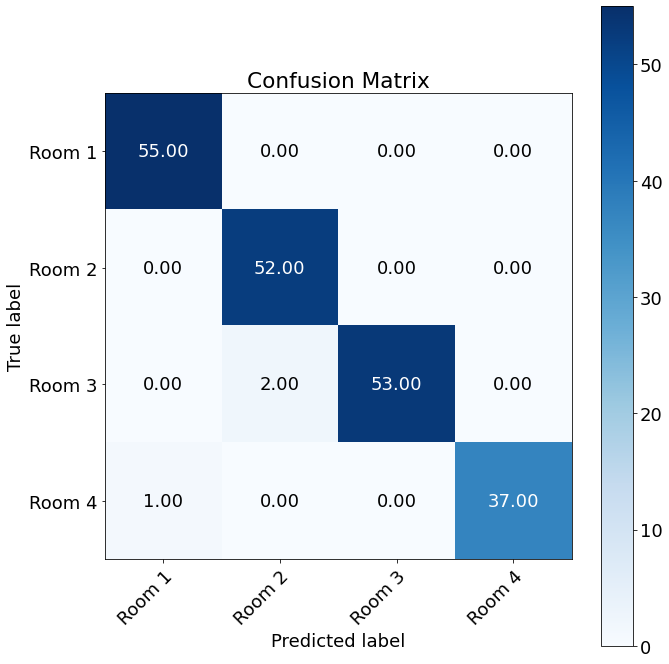

Accuracy pruned 1: 0.98
Macro recall pruned 1: 0.9772267206477733
Macro precision pruned 1: 0.9826046798029557


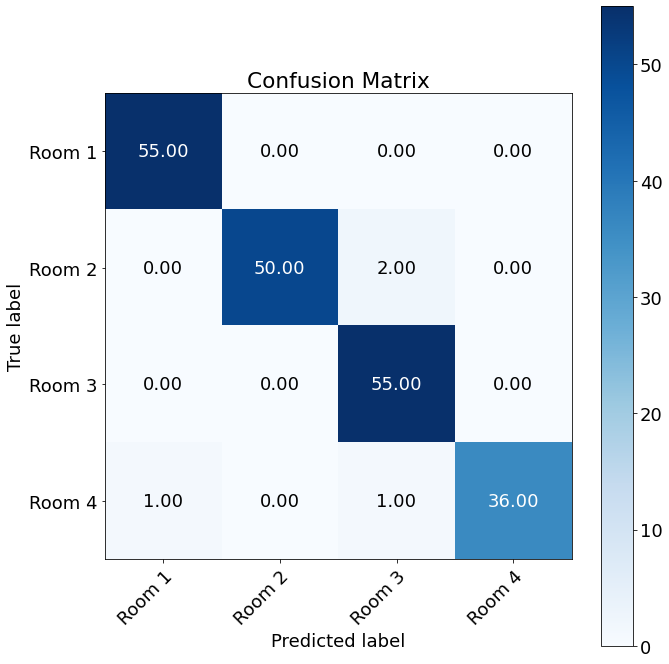

 
Accuracy pruned 2: 0.98
Macro recall pruned 2: 0.9772267206477733
Macro precision pruned 2: 0.9826046798029557


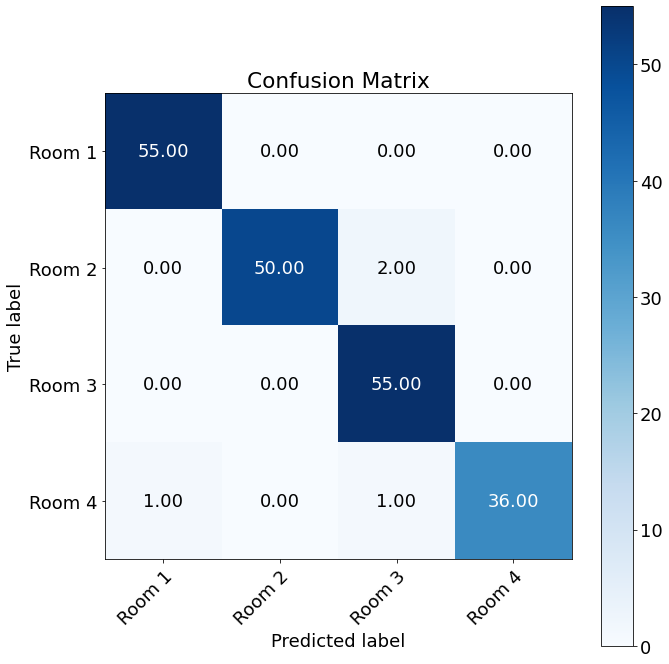

 
Outer Fold:3, Inner fold:7
Accuracy original: 0.985
Macro recall original: 0.9843301435406699
Macro precision original: 0.986276455026455
 


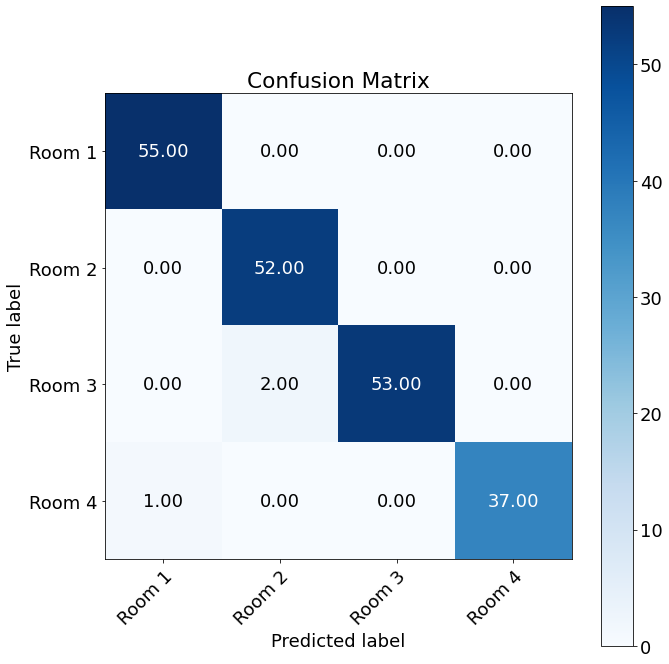

Accuracy pruned 1: 0.98
Macro recall pruned 1: 0.9792602134707399
Macro precision pruned 1: 0.9817051820728291


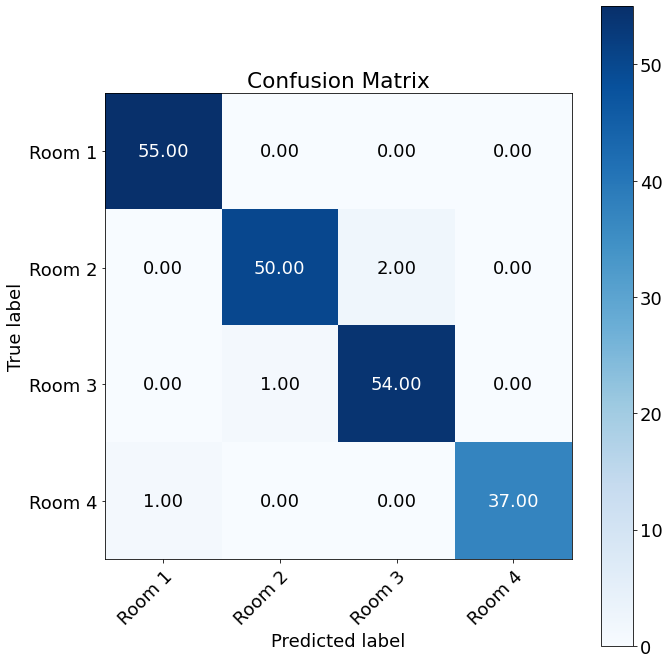

 
Accuracy pruned 2: 0.98
Macro recall pruned 2: 0.9792602134707399
Macro precision pruned 2: 0.9817051820728291


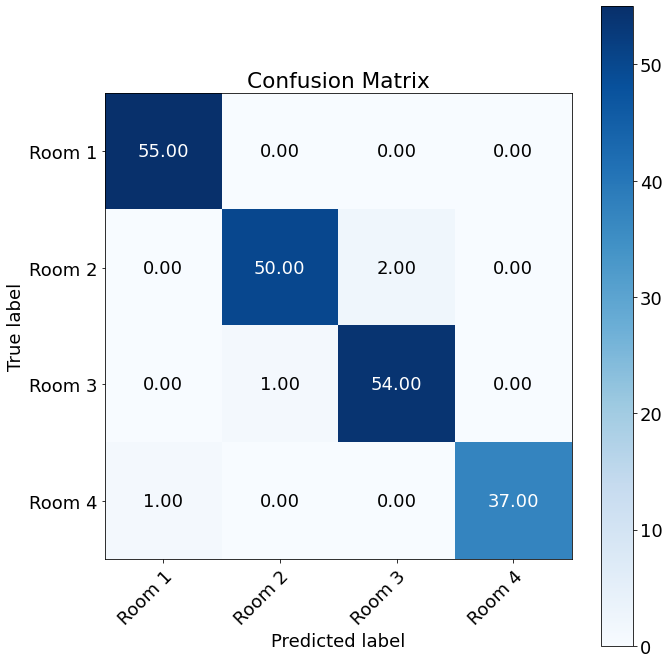

 
Outer Fold:3, Inner fold:8
Accuracy original: 0.985
Macro recall original: 0.9840679057784322
Macro precision original: 0.9861825674325674
 


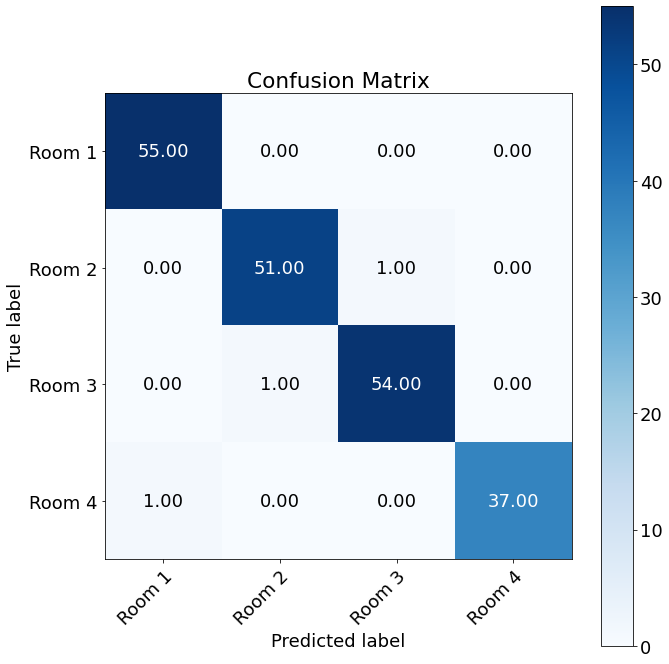

Accuracy pruned 1: 0.985
Macro recall pruned 1: 0.9820344129554656
Macro precision pruned 1: 0.9867637844611529


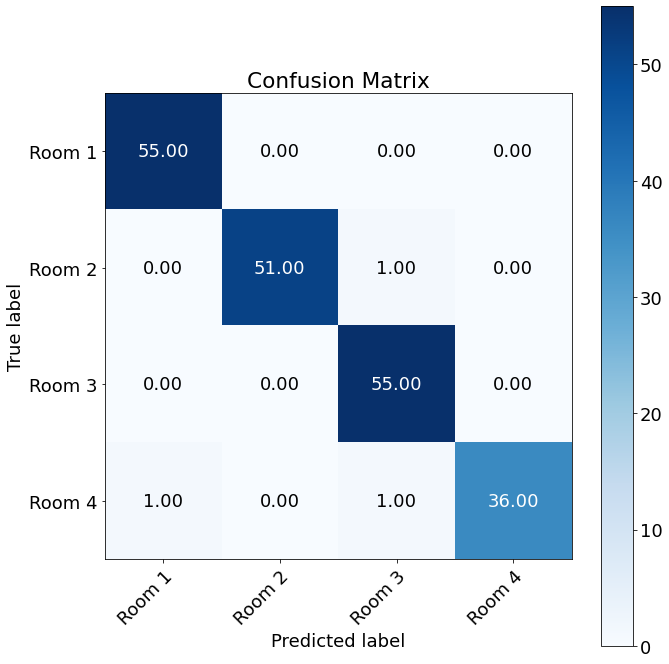

 
Accuracy pruned 2: 0.985
Macro recall pruned 2: 0.9820344129554656
Macro precision pruned 2: 0.9867637844611529


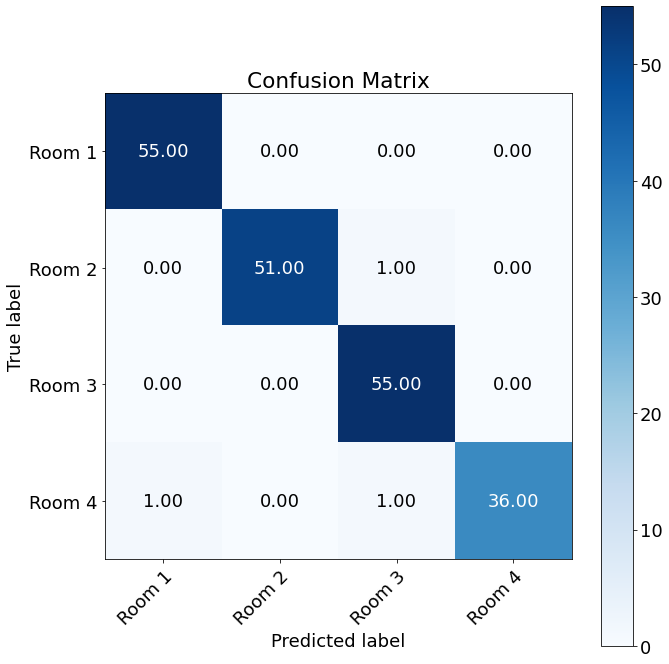

 
Outer Fold:3, Inner fold:9
Accuracy original: 0.96
Macro recall original: 0.9590449024659551
Macro precision original: 0.9609104816651985
 


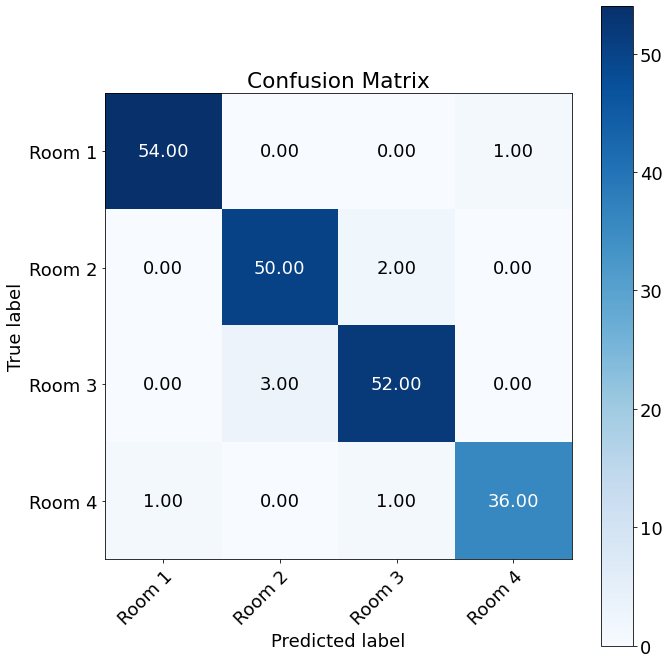

Accuracy pruned 1: 0.965
Macro recall pruned 1: 0.9641148325358851
Macro precision pruned 1: 0.968703928939997


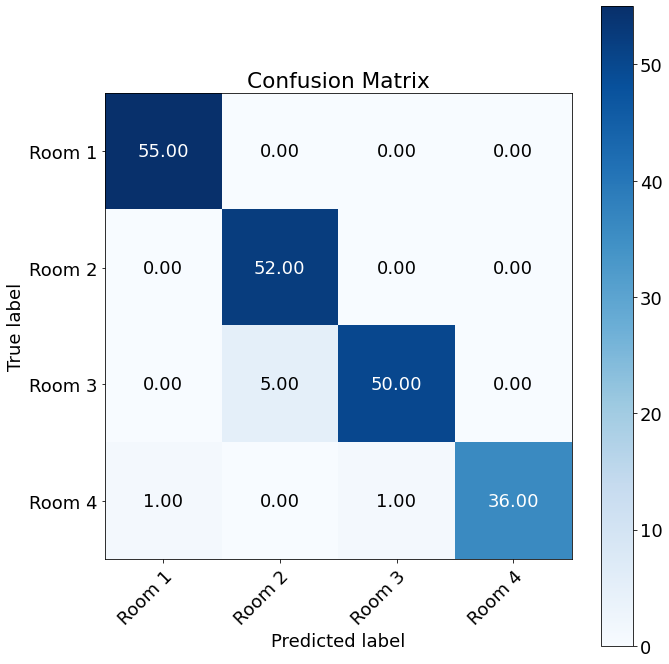

 
Accuracy pruned 2: 0.965
Macro recall pruned 2: 0.9641148325358851
Macro precision pruned 2: 0.968703928939997


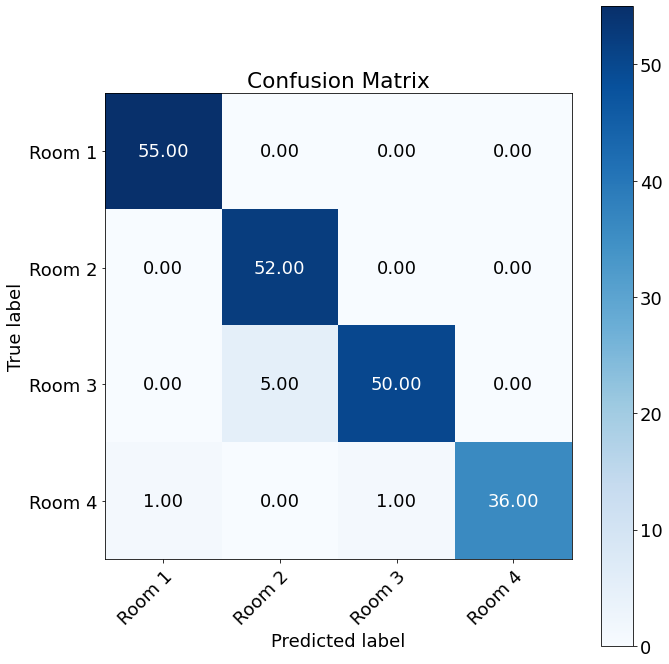

 
Outer Fold:3, Inner fold:10
Accuracy original: 0.965
Macro recall original: 0.9635903570114096
Macro precision original: 0.965689546939547
 


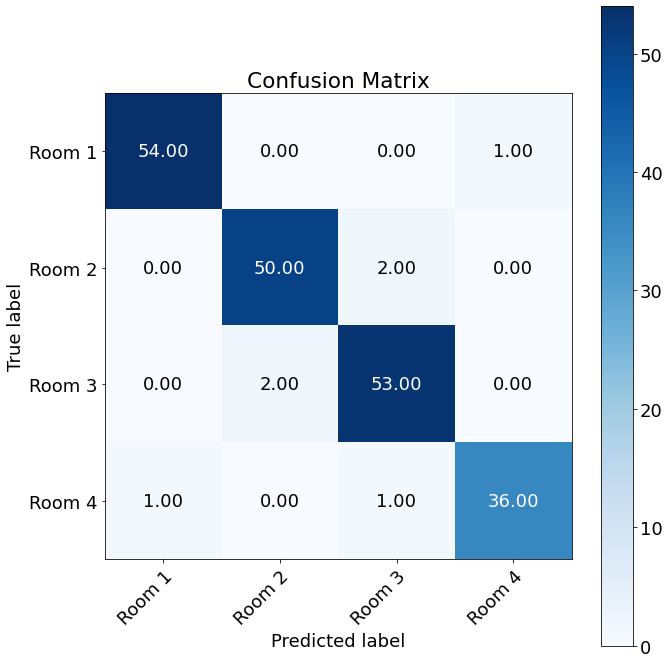

Accuracy pruned 1: 0.985
Macro recall pruned 1: 0.9820344129554656
Macro precision pruned 1: 0.9867637844611529


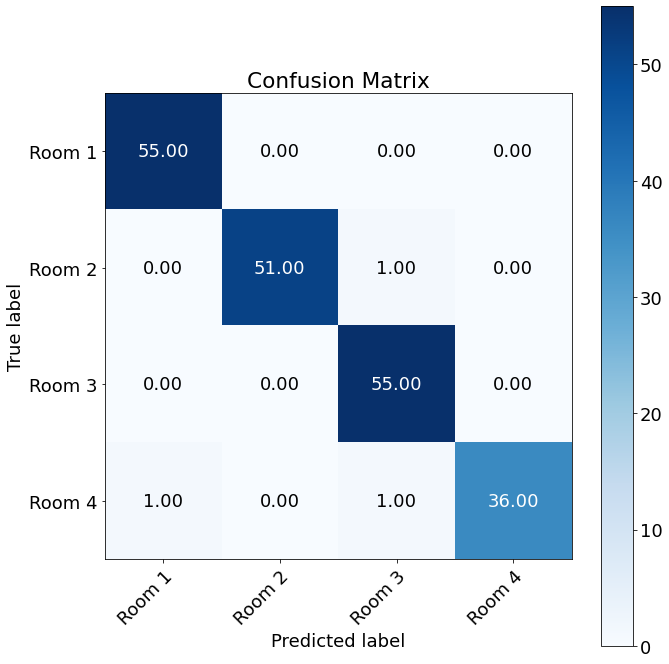

 
Accuracy pruned 2: 0.985
Macro recall pruned 2: 0.9820344129554656
Macro precision pruned 2: 0.9867637844611529


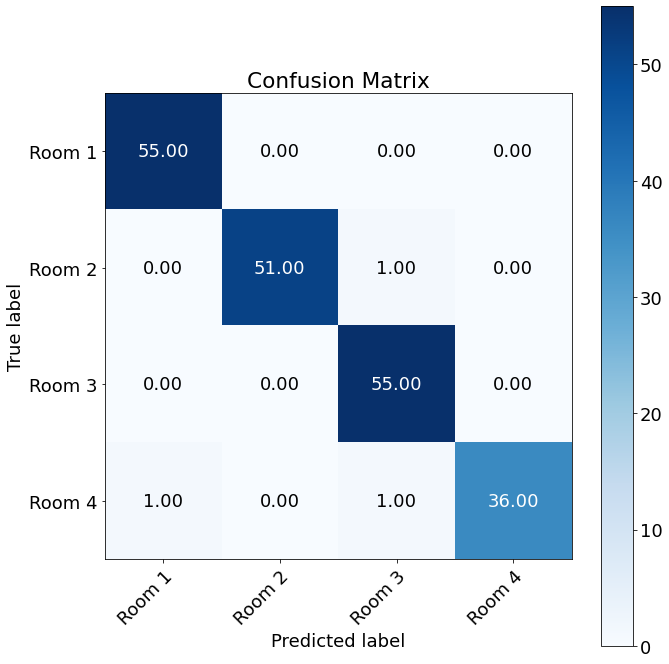

 
Outer Fold:4, Inner fold:1
Accuracy original: 0.975
Macro recall original: 0.9748910557880657
Macro precision original: 0.9760753796468082
 


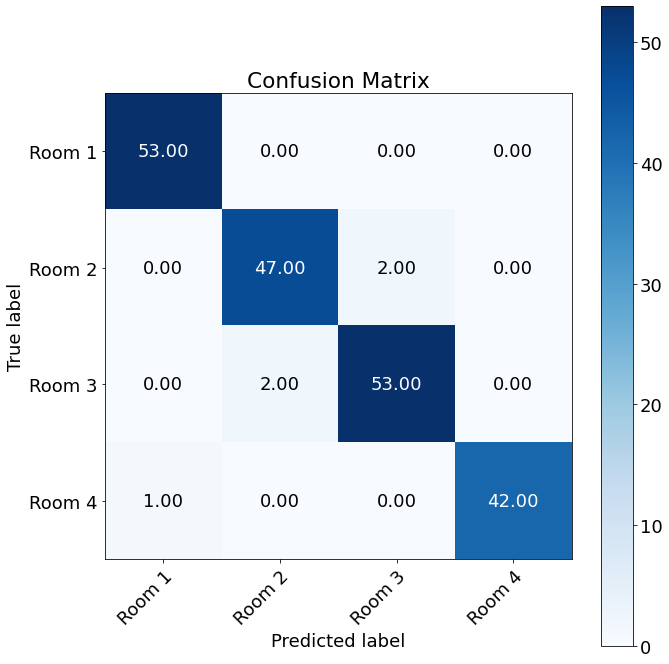

Accuracy pruned 1: 0.975
Macro recall pruned 1: 0.9748910557880657
Macro precision pruned 1: 0.9760753796468082


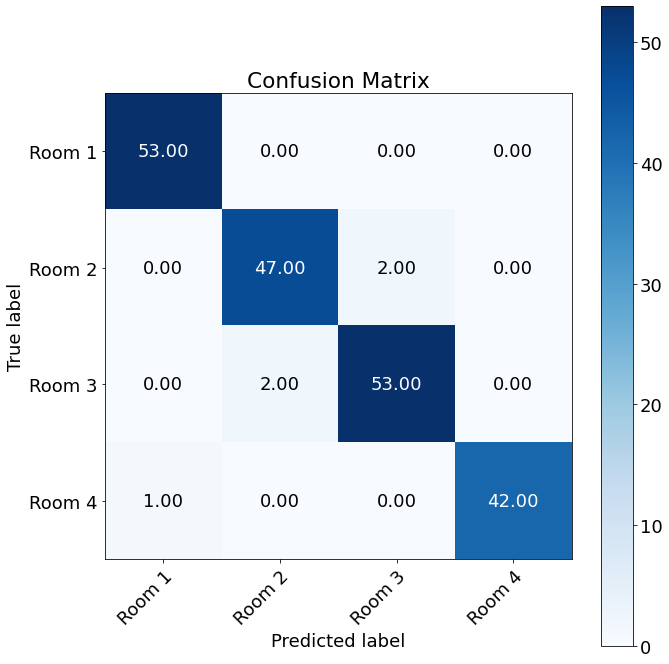

 
Accuracy pruned 2: 0.975
Macro recall pruned 2: 0.9748910557880657
Macro precision pruned 2: 0.9760753796468082


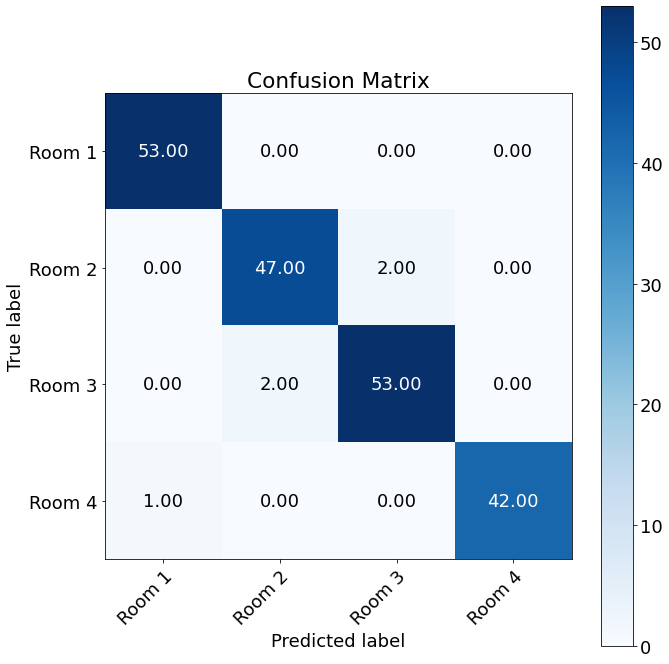

 
Outer Fold:4, Inner fold:2
Accuracy original: 0.98
Macro recall original: 0.9794365103335203
Macro precision original: 0.9812334656084656
 


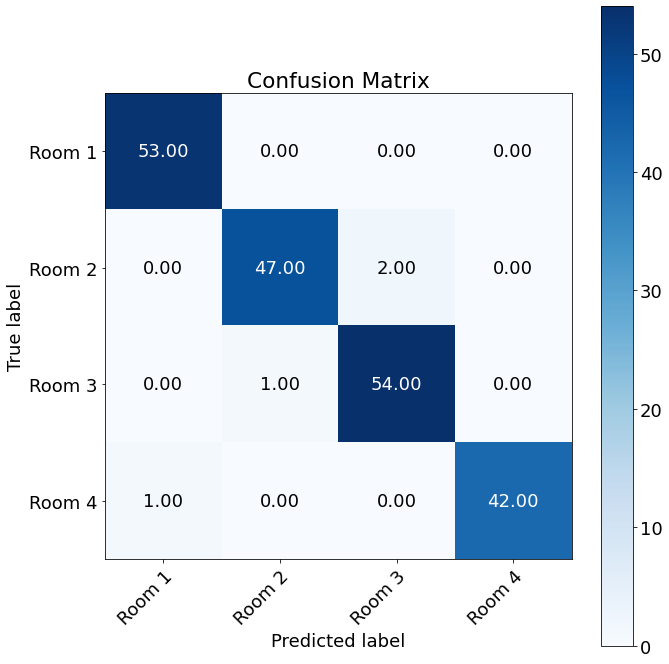

Accuracy pruned 1: 0.98
Macro recall pruned 1: 0.9788799240626483
Macro precision pruned 1: 0.9824393358876118


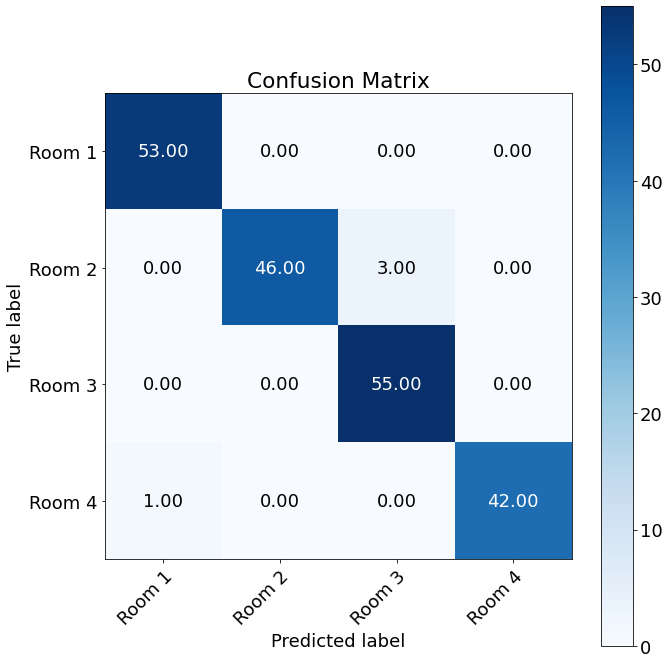

 
Accuracy pruned 2: 0.98
Macro recall pruned 2: 0.9788799240626483
Macro precision pruned 2: 0.9824393358876118


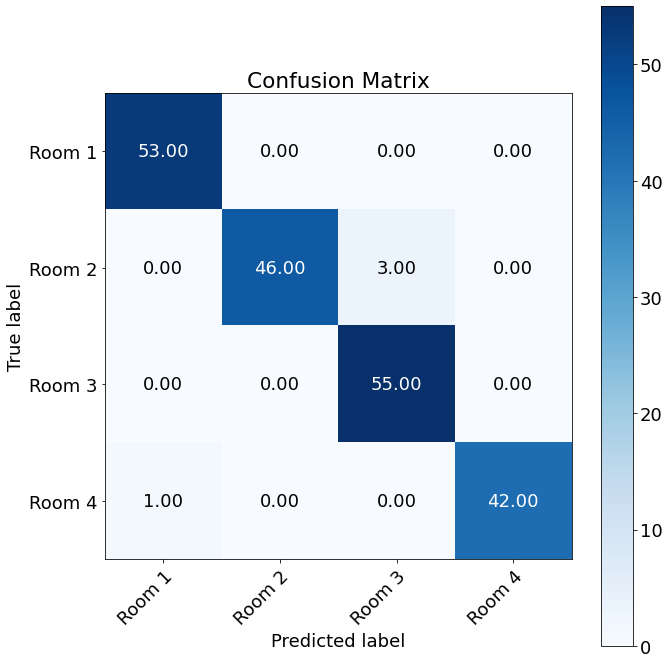

 
Outer Fold:4, Inner fold:3
Accuracy original: 0.985
Macro recall original: 0.9839819648789748
Macro precision original: 0.9865984405458089
 


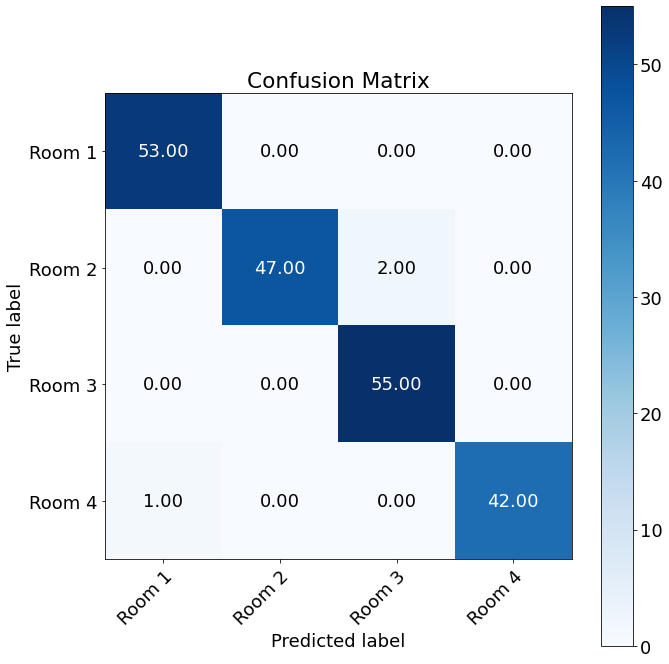

Accuracy pruned 1: 0.985
Macro recall pruned 1: 0.9839819648789748
Macro precision pruned 1: 0.9865984405458089


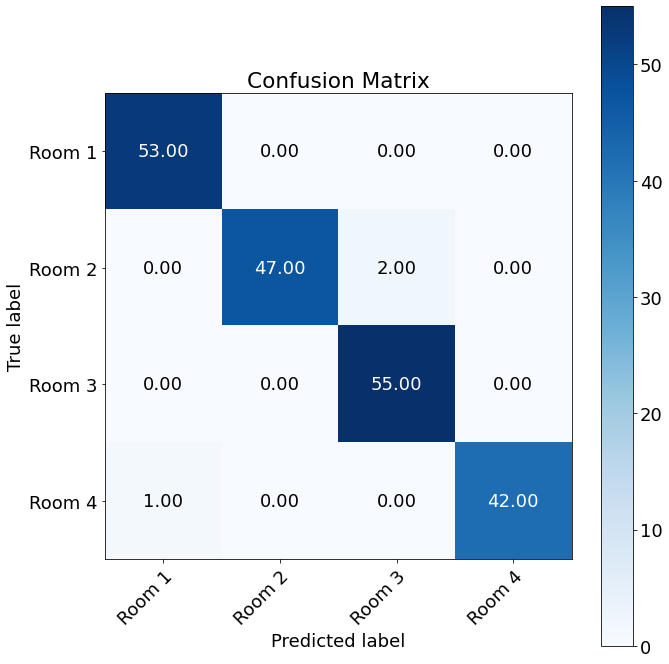

 
Accuracy pruned 2: 0.985
Macro recall pruned 2: 0.9839819648789748
Macro precision pruned 2: 0.9865984405458089


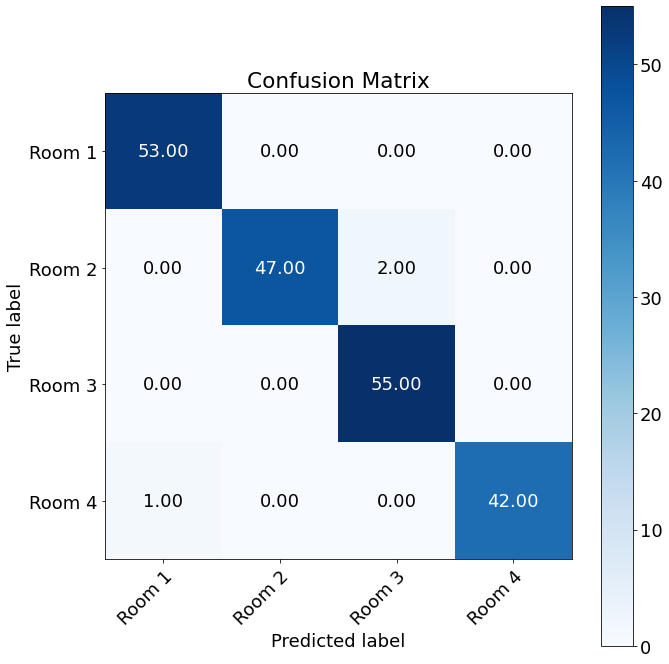

 
Outer Fold:4, Inner fold:4
Accuracy original: 0.98
Macro recall original: 0.9794365103335203
Macro precision original: 0.9812334656084656
 


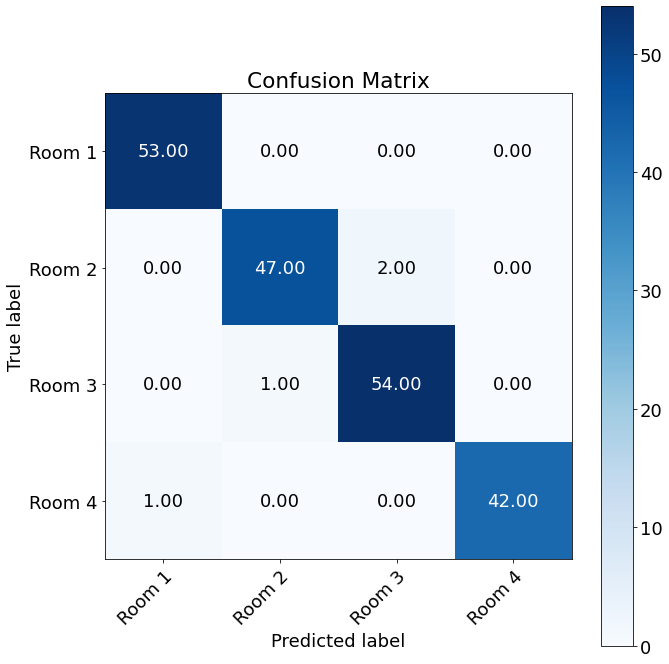

Accuracy pruned 1: 0.975
Macro recall pruned 1: 0.9743344695171938
Macro precision pruned 1: 0.9768933266973581


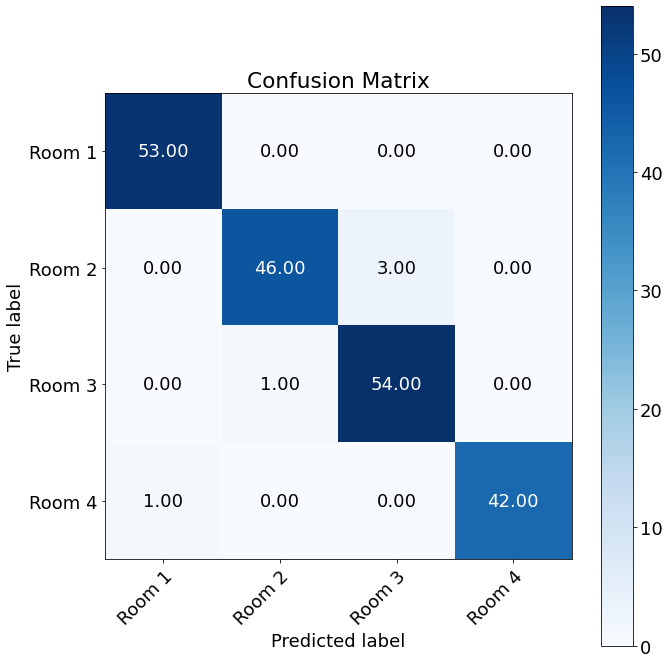

 
Accuracy pruned 2: 0.975
Macro recall pruned 2: 0.9743344695171938
Macro precision pruned 2: 0.9768933266973581


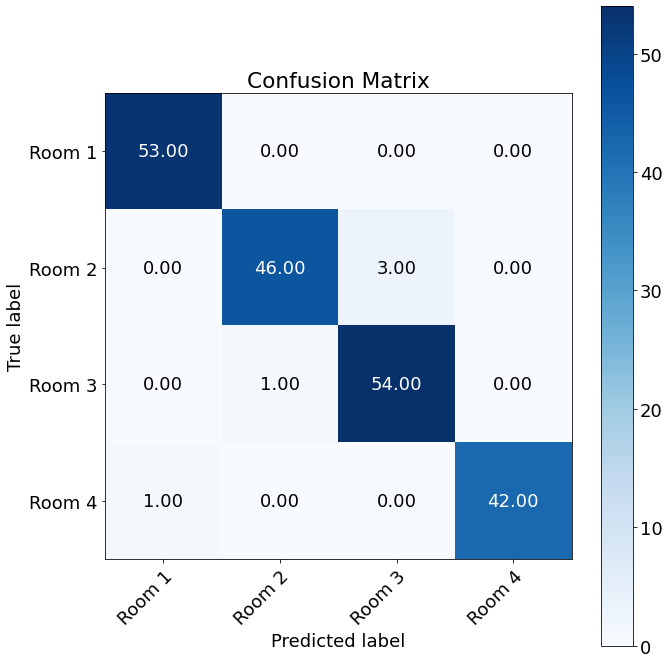

 
Outer Fold:4, Inner fold:5
Accuracy original: 0.97
Macro recall original: 0.9709021875134831
Macro precision original: 0.9700428422213648
 


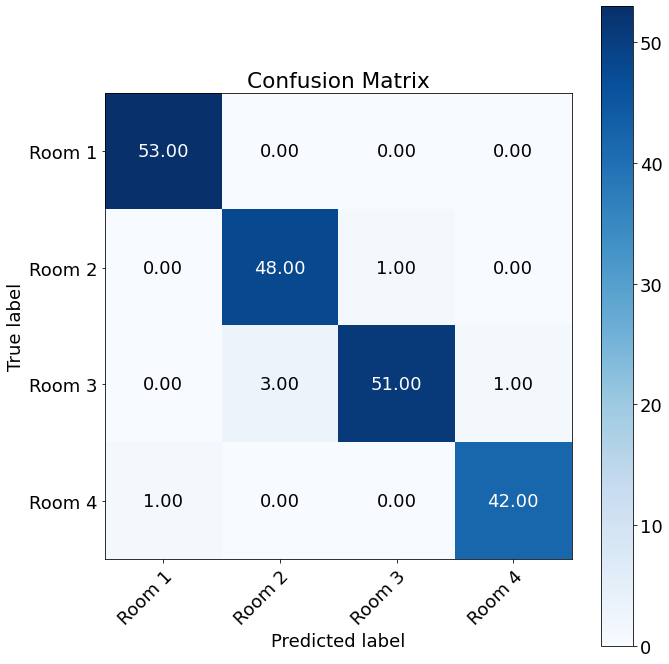

Accuracy pruned 1: 0.985
Macro recall pruned 1: 0.9839819648789748
Macro precision pruned 1: 0.9865984405458089


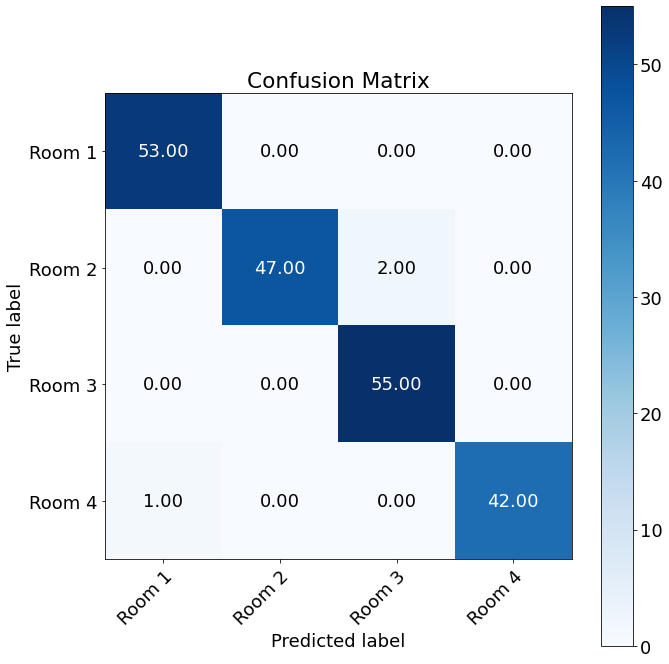

 
Accuracy pruned 2: 0.985
Macro recall pruned 2: 0.9839819648789748
Macro precision pruned 2: 0.9865984405458089


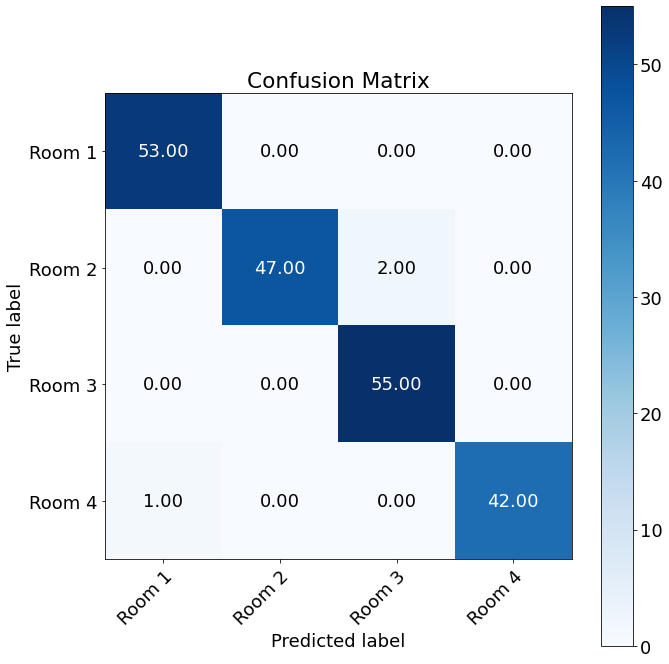

 
Outer Fold:4, Inner fold:6
Accuracy original: 0.97
Macro recall original: 0.9697890149717392
Macro precision original: 0.9715608465608465
 


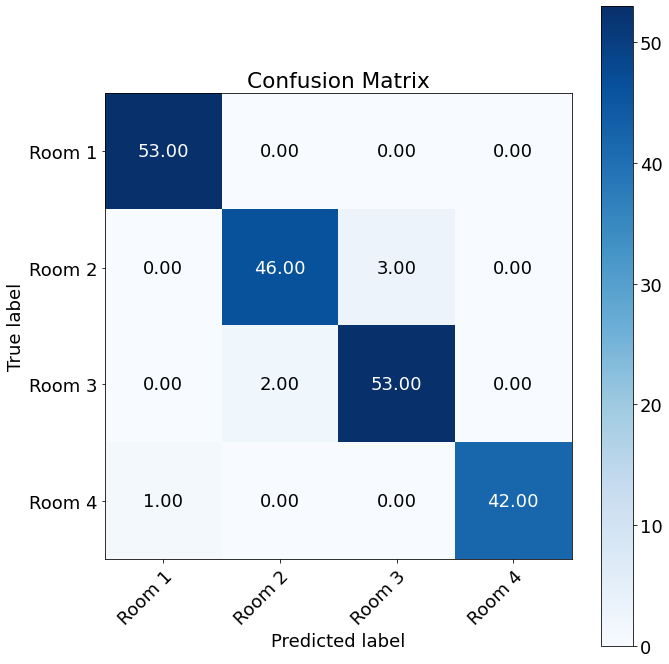

Accuracy pruned 1: 0.975
Macro recall pruned 1: 0.9743344695171938
Macro precision pruned 1: 0.9768933266973581


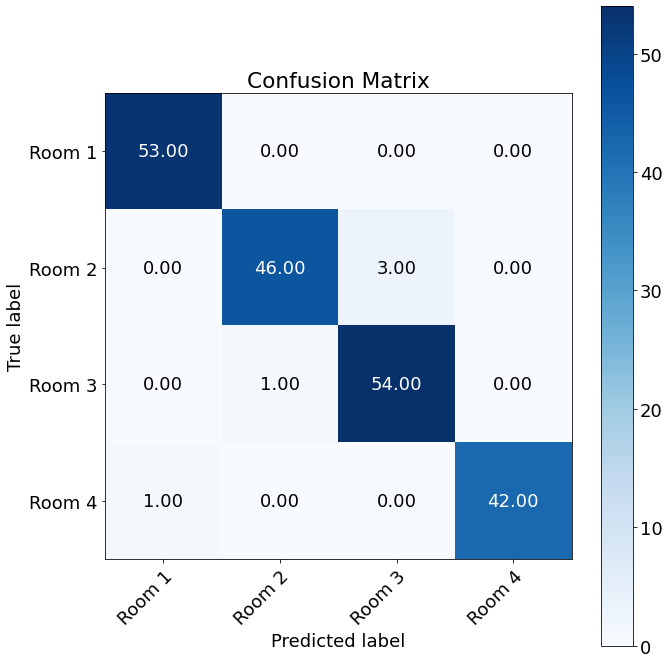

 
Accuracy pruned 2: 0.975
Macro recall pruned 2: 0.9743344695171938
Macro precision pruned 2: 0.9768933266973581


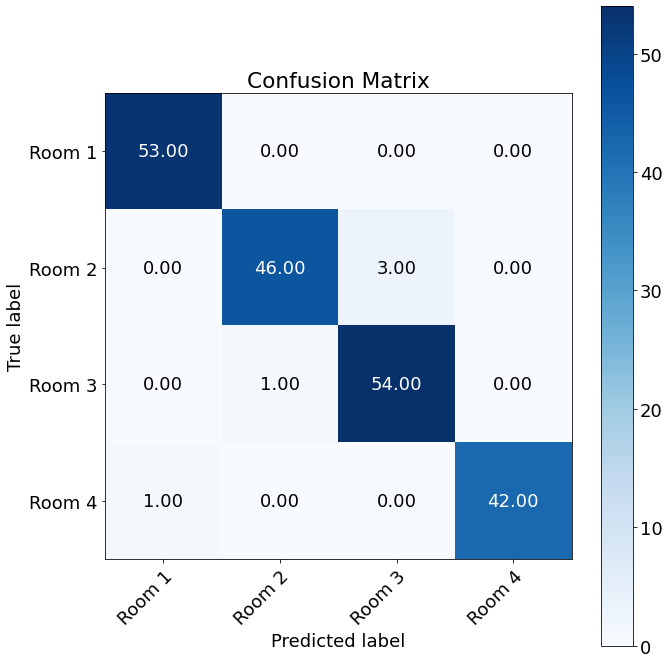

 
Outer Fold:4, Inner fold:7
Accuracy original: 0.985
Macro recall original: 0.9845385511498468
Macro precision original: 0.9857228750085893
 


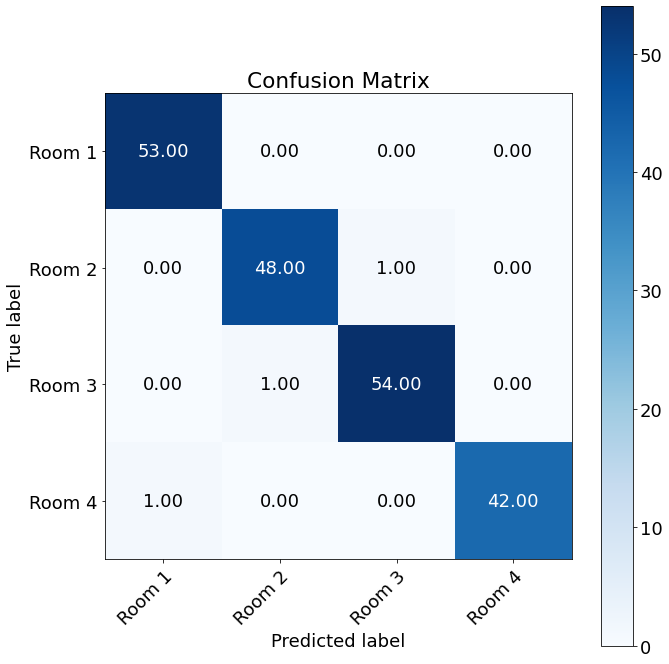

Accuracy pruned 1: 0.985
Macro recall pruned 1: 0.9845385511498468
Macro precision pruned 1: 0.9857228750085893


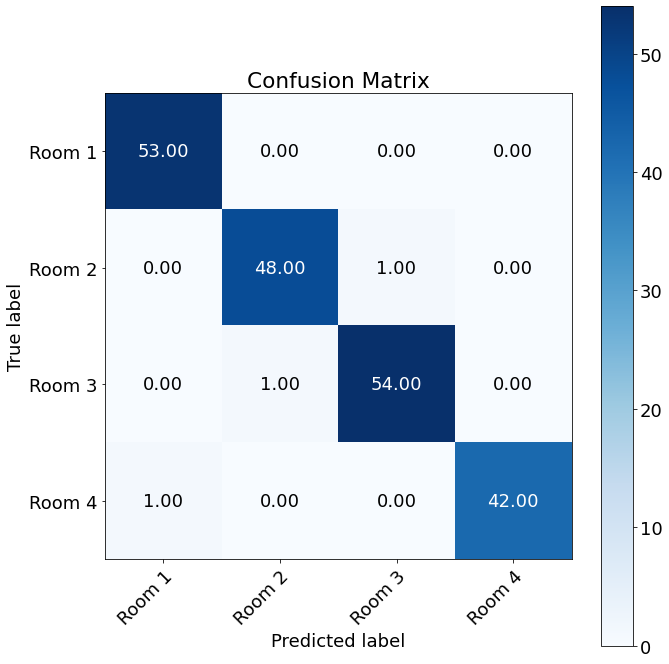

 
Accuracy pruned 2: 0.985
Macro recall pruned 2: 0.9845385511498468
Macro precision pruned 2: 0.9857228750085893


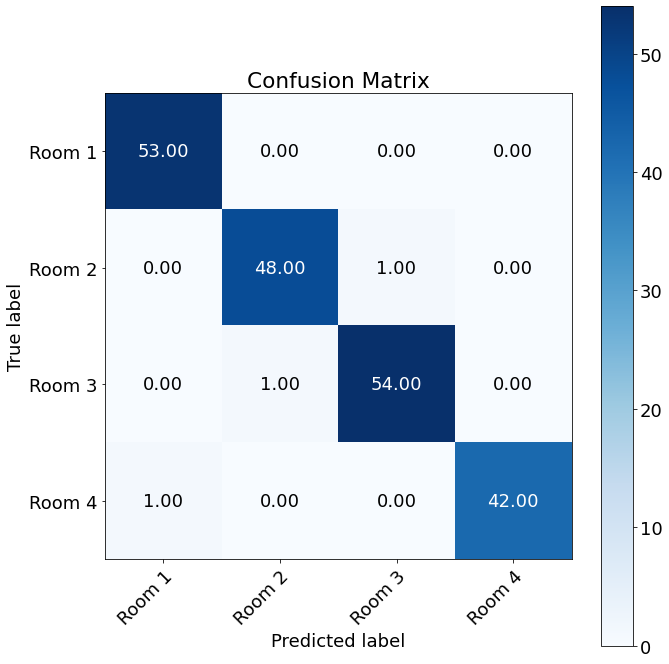

 
Outer Fold:4, Inner fold:8
Accuracy original: 0.975
Macro recall original: 0.9743344695171938
Macro precision original: 0.9768933266973581
 


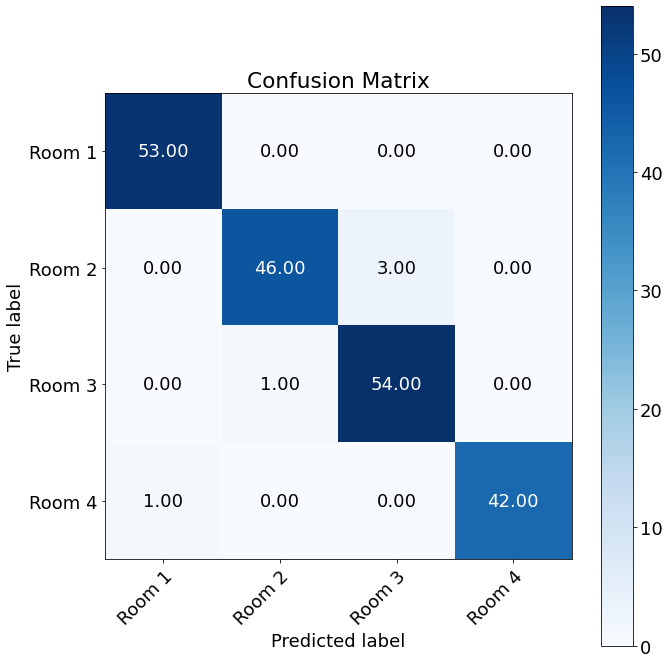

Accuracy pruned 1: 0.98
Macro recall pruned 1: 0.9794365103335203
Macro precision pruned 1: 0.9812334656084656


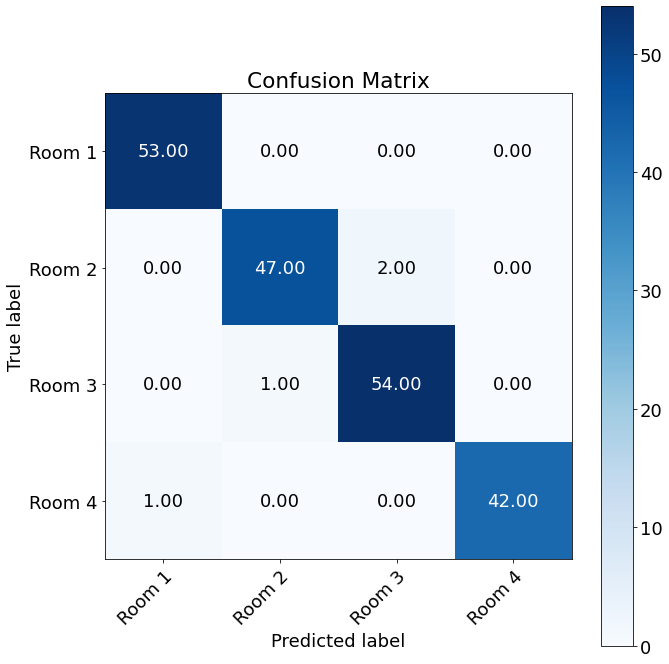

 
Accuracy pruned 2: 0.98
Macro recall pruned 2: 0.9794365103335203
Macro precision pruned 2: 0.9812334656084656


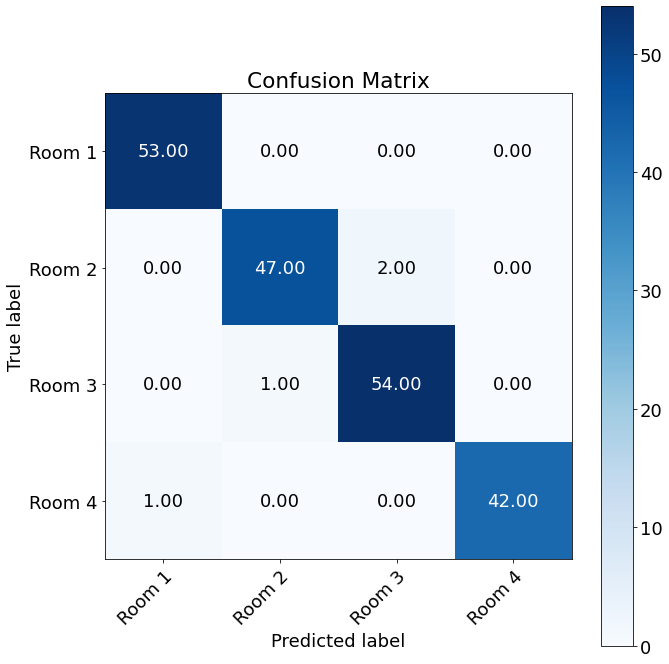

 
Outer Fold:4, Inner fold:9
Accuracy original: 0.975
Macro recall original: 0.9748910557880657
Macro precision original: 0.9760753796468082
 


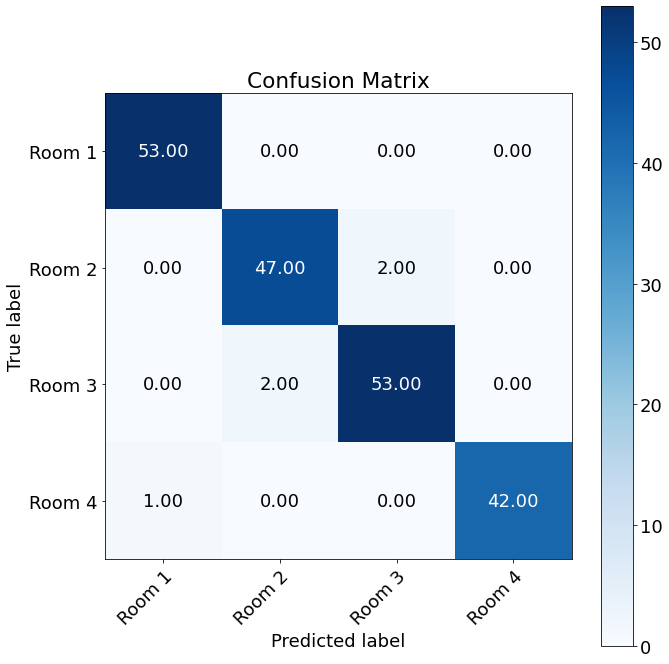

Accuracy pruned 1: 0.965
Macro recall pruned 1: 0.9654570935239148
Macro precision pruned 1: 0.9674443664105319


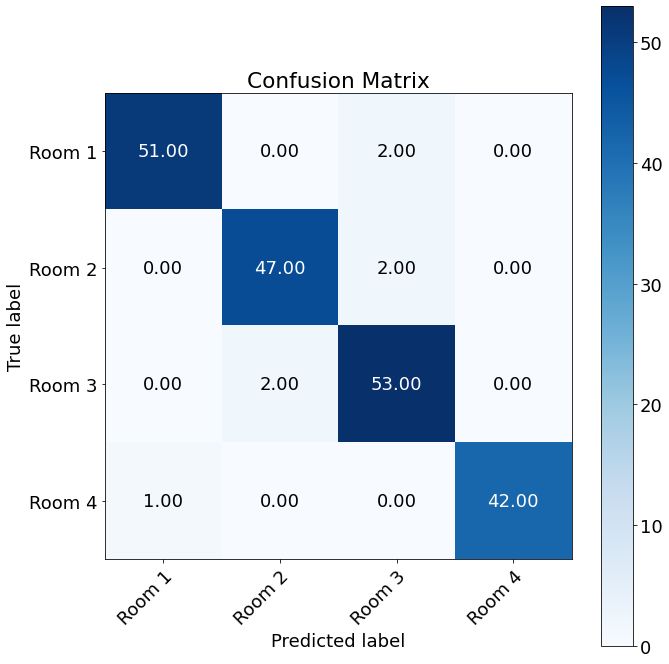

 
Accuracy pruned 2: 0.965
Macro recall pruned 2: 0.9654570935239148
Macro precision pruned 2: 0.9674443664105319


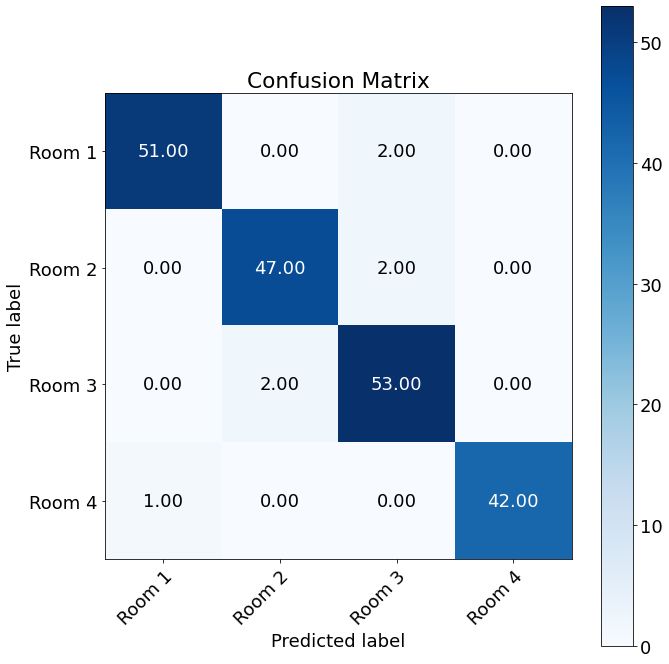

 
Outer Fold:4, Inner fold:10
Accuracy original: 0.965
Macro recall original: 0.9639750614833671
Macro precision original: 0.9674098440545809
 


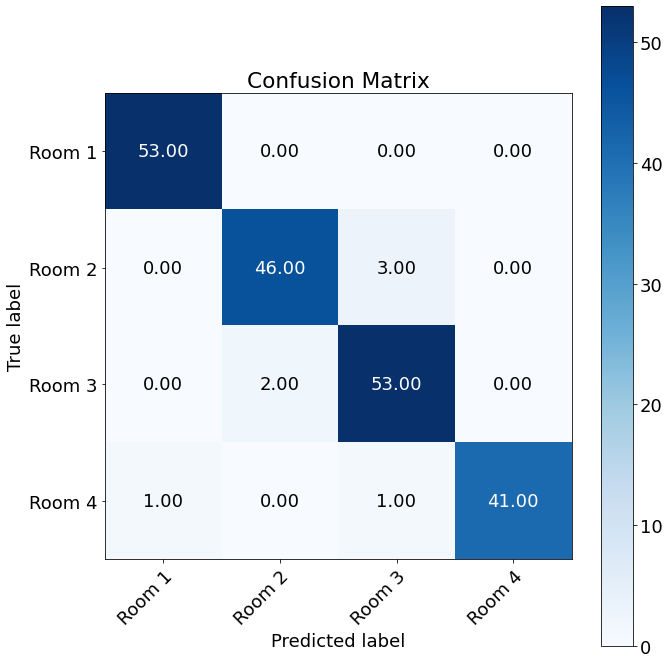

Accuracy pruned 1: 0.975
Macro recall pruned 1: 0.9736225568451482
Macro precision pruned 1: 0.9770041423001949


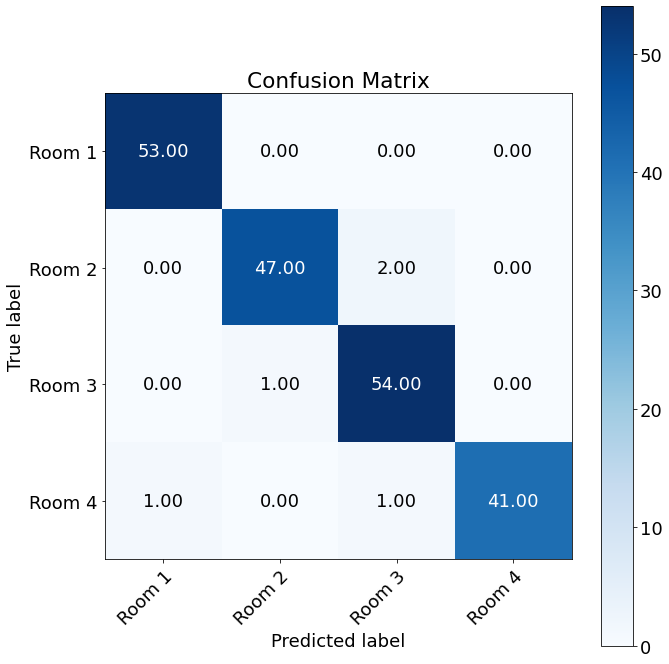

 
Accuracy pruned 2: 0.975
Macro recall pruned 2: 0.9736225568451482
Macro precision pruned 2: 0.9770041423001949


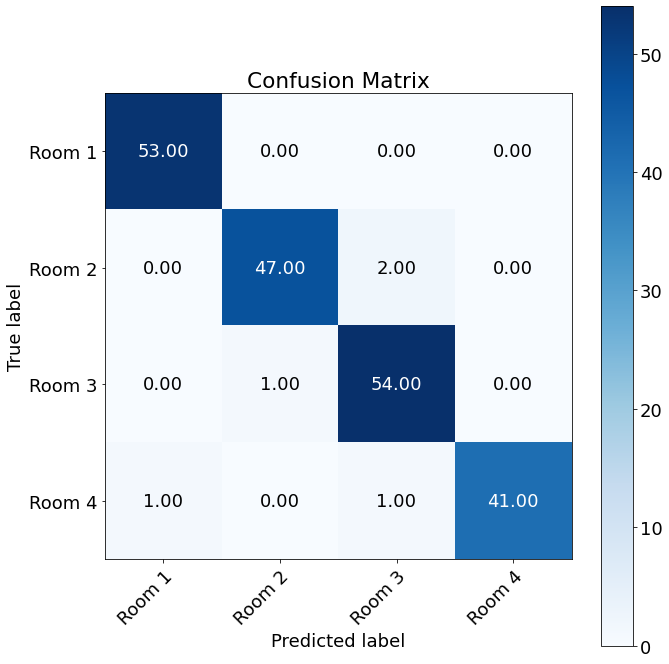

 
Outer Fold:5, Inner fold:1
Accuracy original: 0.975
Macro recall original: 0.9748840867693327
Macro precision original: 0.9751366120218579
 


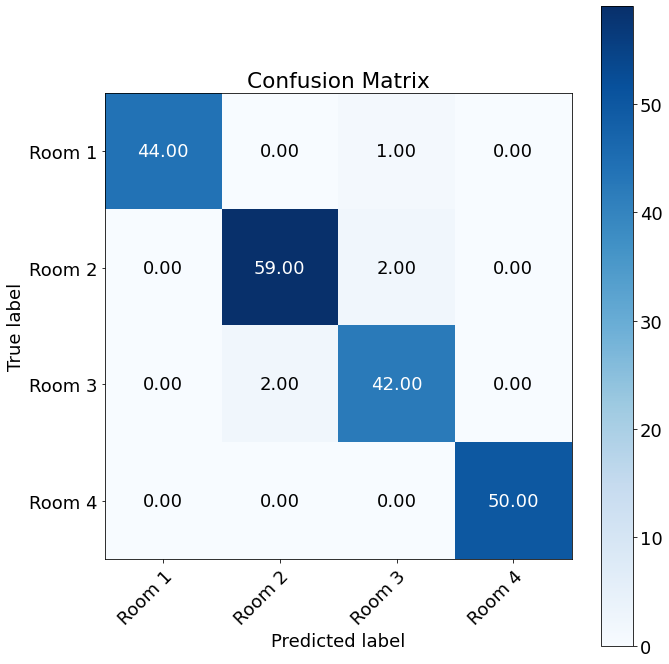

Accuracy pruned 1: 0.98
Macro recall pruned 1: 0.9789824474250703
Macro precision pruned 1: 0.9805718475073314


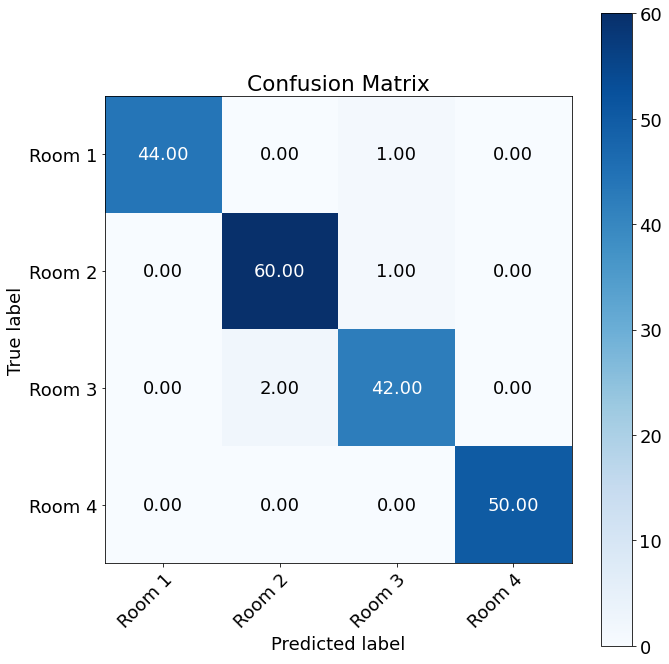

 
Accuracy pruned 2: 0.98
Macro recall pruned 2: 0.9789824474250703
Macro precision pruned 2: 0.9805718475073314


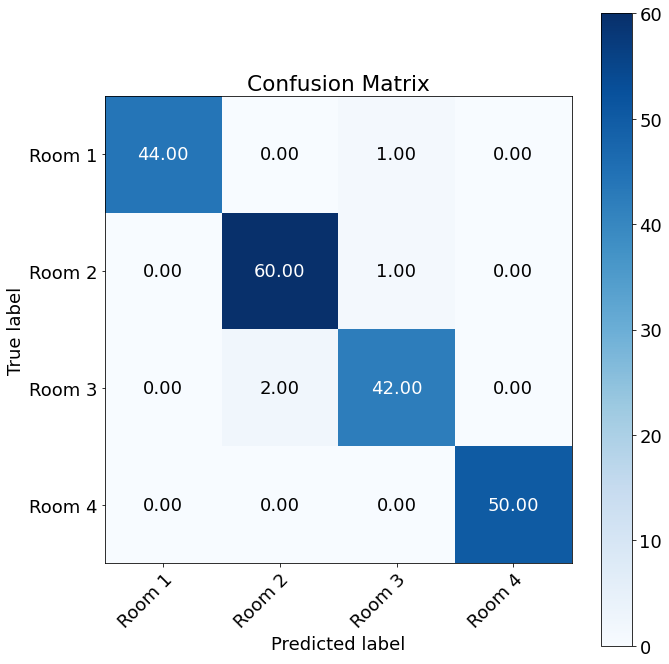

 
Outer Fold:5, Inner fold:2
Accuracy original: 0.98
Macro recall original: 0.9789824474250703
Macro precision original: 0.9805718475073314
 


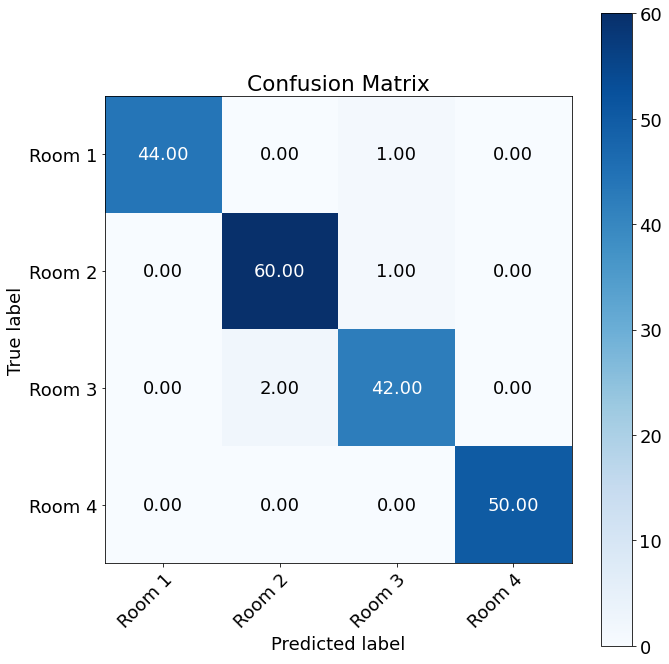

Accuracy pruned 1: 0.98
Macro recall pruned 1: 0.9789824474250703
Macro precision pruned 1: 0.9805718475073314


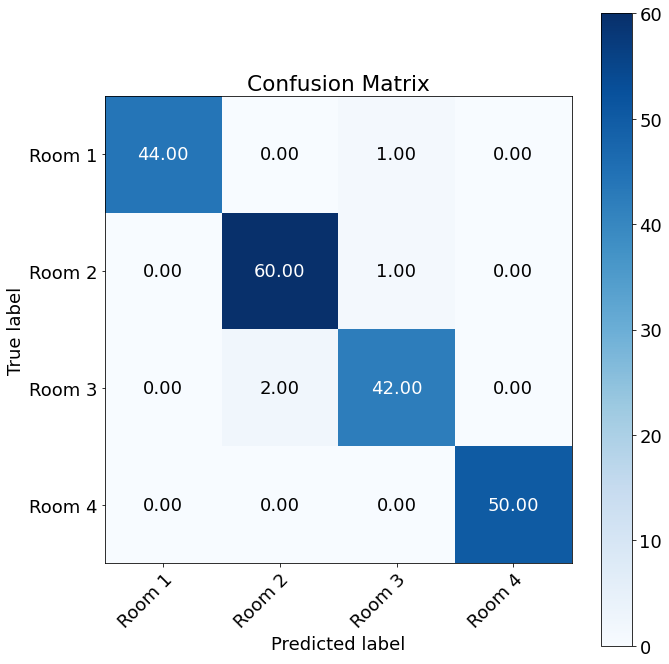

 
Accuracy pruned 2: 0.98
Macro recall pruned 2: 0.9789824474250703
Macro precision pruned 2: 0.9805718475073314


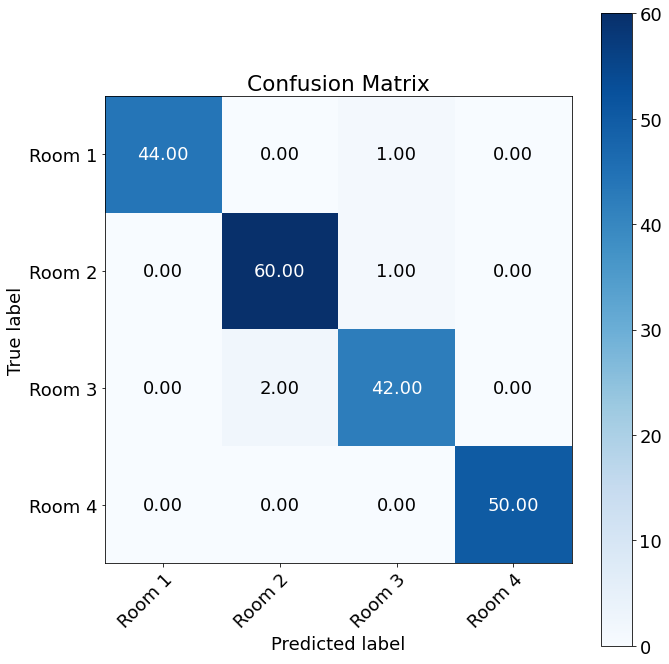

 
Outer Fold:5, Inner fold:3
Accuracy original: 0.98
Macro recall original: 0.9805659049511508
Macro precision original: 0.9795289855072464
 


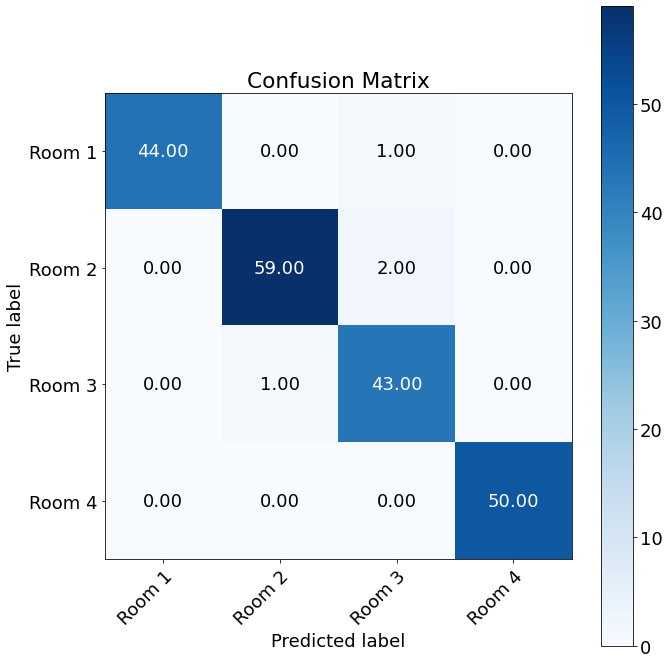

Accuracy pruned 1: 0.975
Macro recall pruned 1: 0.9780510018214936
Macro precision pruned 1: 0.9744897959183674


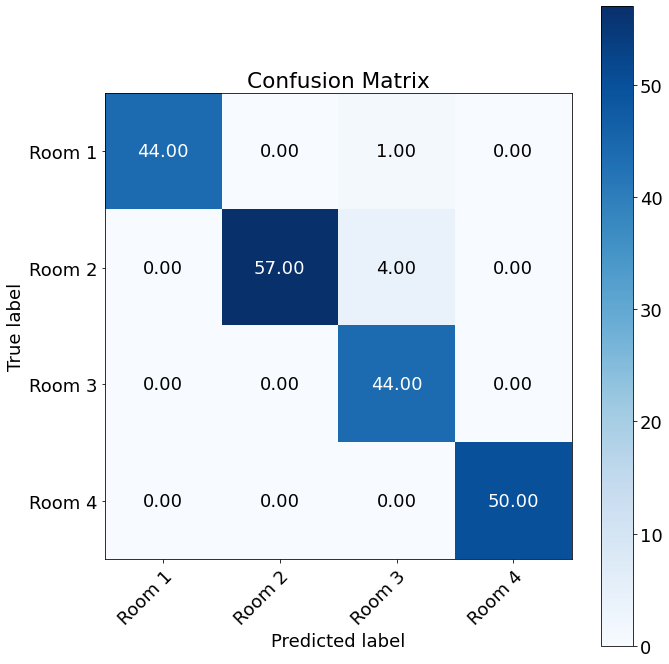

 
Accuracy pruned 2: 0.975
Macro recall pruned 2: 0.9780510018214936
Macro precision pruned 2: 0.9744897959183674


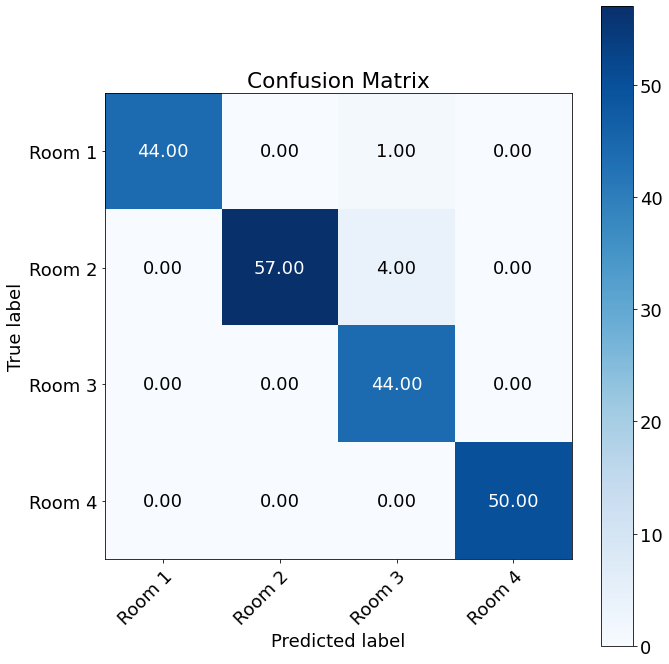

 
Outer Fold:5, Inner fold:4
Accuracy original: 0.98
Macro recall original: 0.9805659049511508
Macro precision original: 0.9795289855072464
 


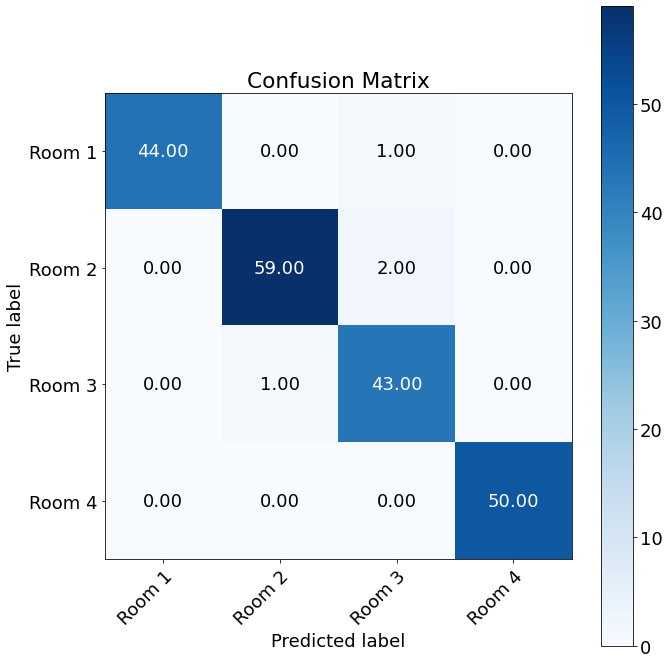

Accuracy pruned 1: 0.96
Macro recall pruned 1: 0.9624627421758569
Macro precision pruned 1: 0.9578018241719006


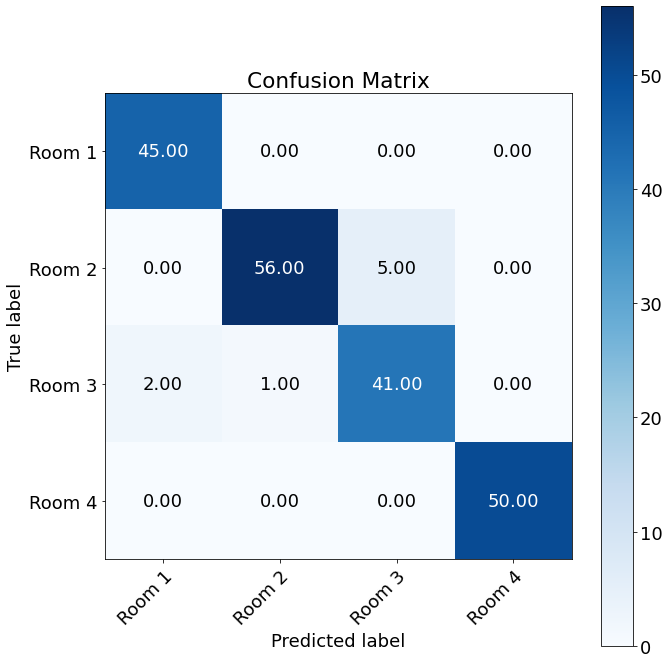

 
Accuracy pruned 2: 0.96
Macro recall pruned 2: 0.9624627421758569
Macro precision pruned 2: 0.9578018241719006


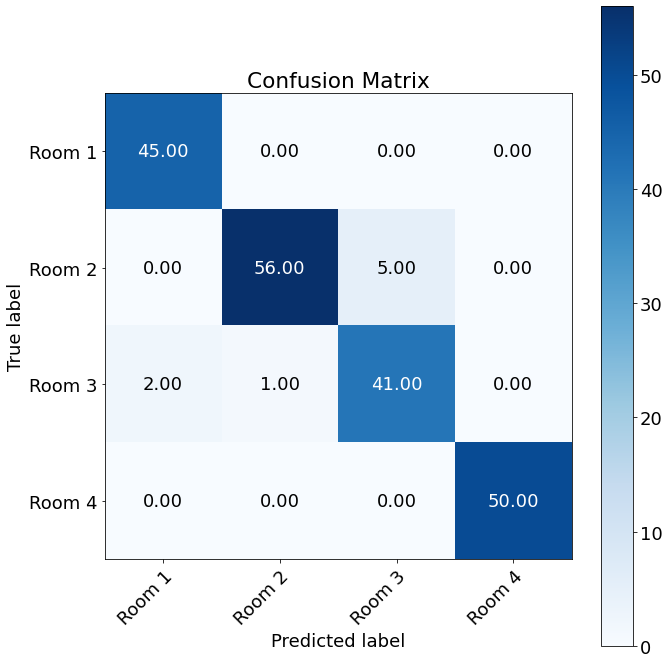

 
Outer Fold:5, Inner fold:5
Accuracy original: 0.975
Macro recall original: 0.9780510018214936
Macro precision original: 0.9744897959183674
 


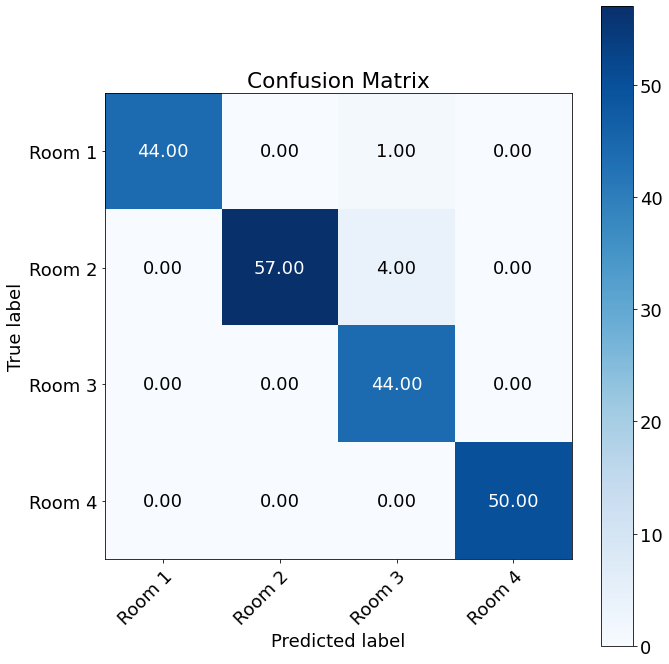

Accuracy pruned 1: 0.955
Macro recall pruned 1: 0.9551974664679582
Macro precision pruned 1: 0.9536058881741711


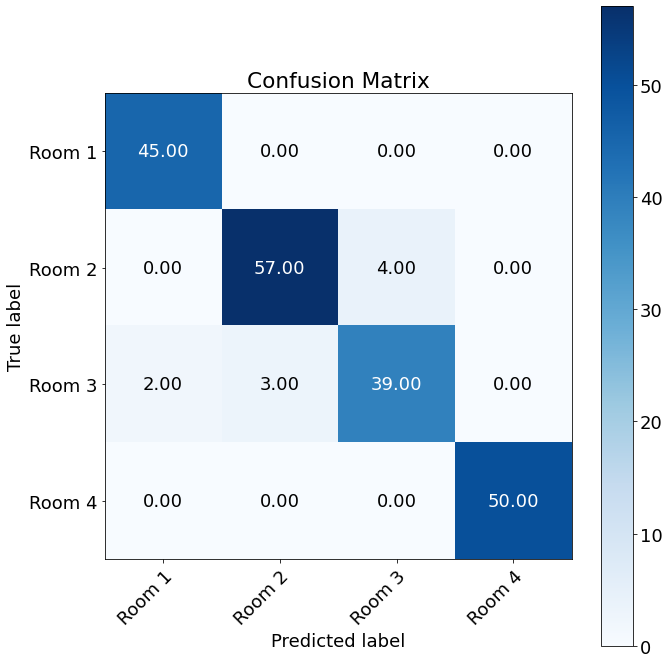

 
Accuracy pruned 2: 0.955
Macro recall pruned 2: 0.9551974664679582
Macro precision pruned 2: 0.9536058881741711


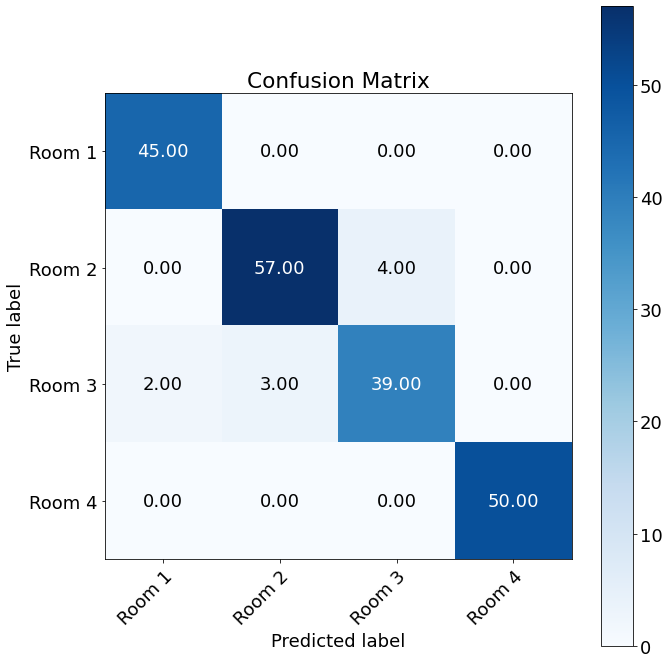

 
Outer Fold:5, Inner fold:6
Accuracy original: 0.97
Macro recall original: 0.9707857261135949
Macro precision original: 0.9699275362318841
 


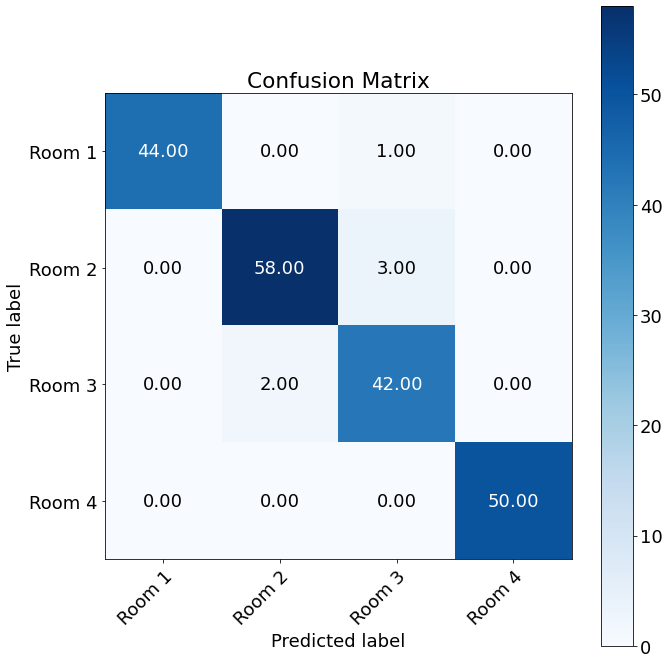

Accuracy pruned 1: 0.965
Macro recall pruned 1: 0.9665611028315946
Macro precision pruned 1: 0.9628291350778512


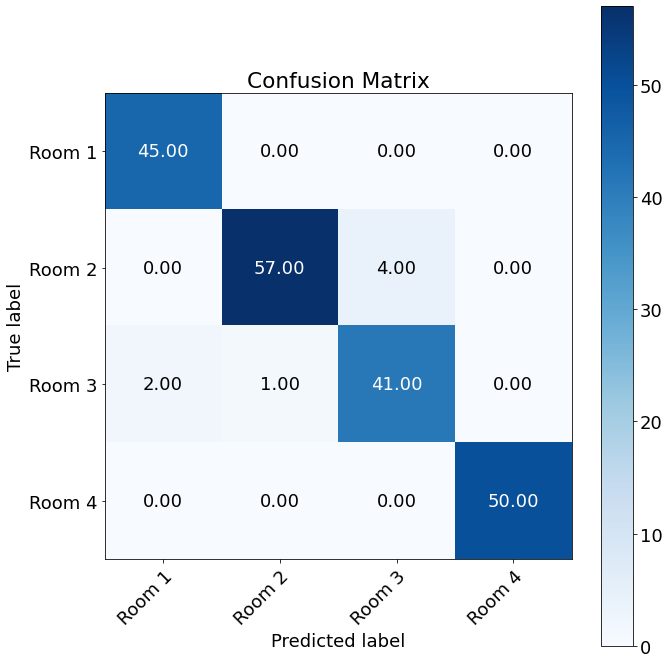

 
Accuracy pruned 2: 0.965
Macro recall pruned 2: 0.9665611028315946
Macro precision pruned 2: 0.9628291350778512


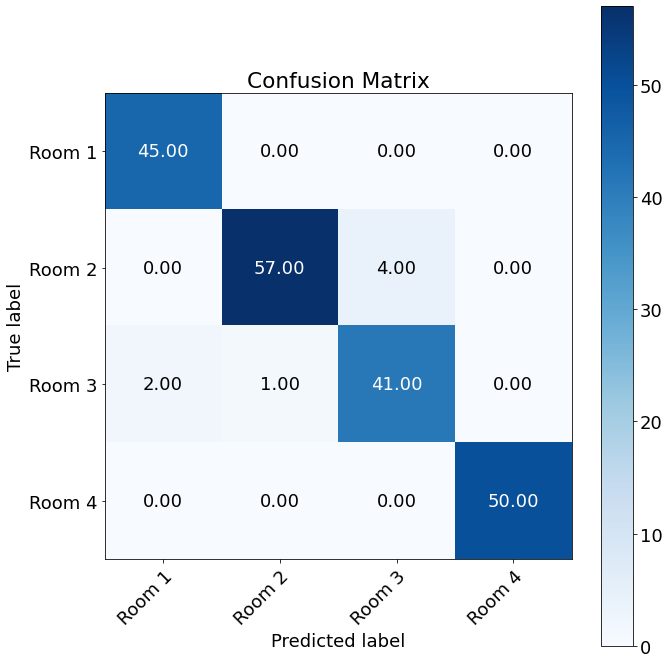

 
Outer Fold:5, Inner fold:7
Accuracy original: 0.975
Macro recall original: 0.9780510018214936
Macro precision original: 0.9744897959183674
 


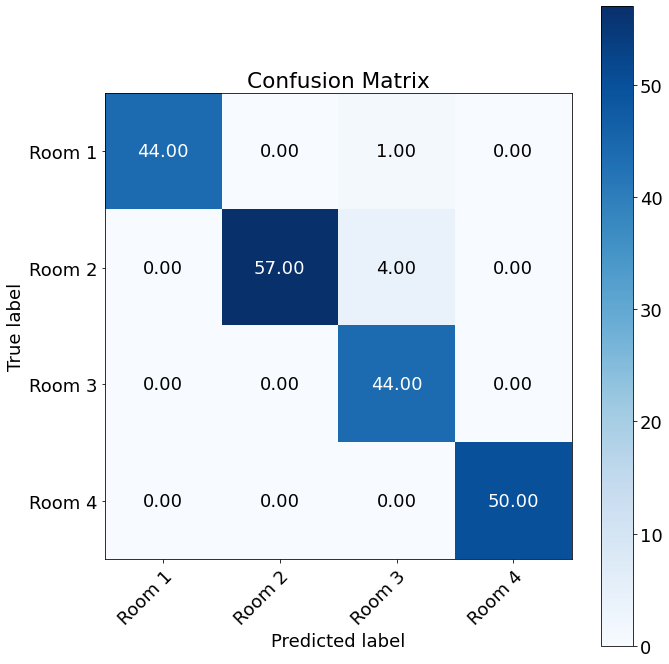

Accuracy pruned 1: 0.955
Macro recall pruned 1: 0.9599478390461997
Macro precision pruned 1: 0.9536474164133739


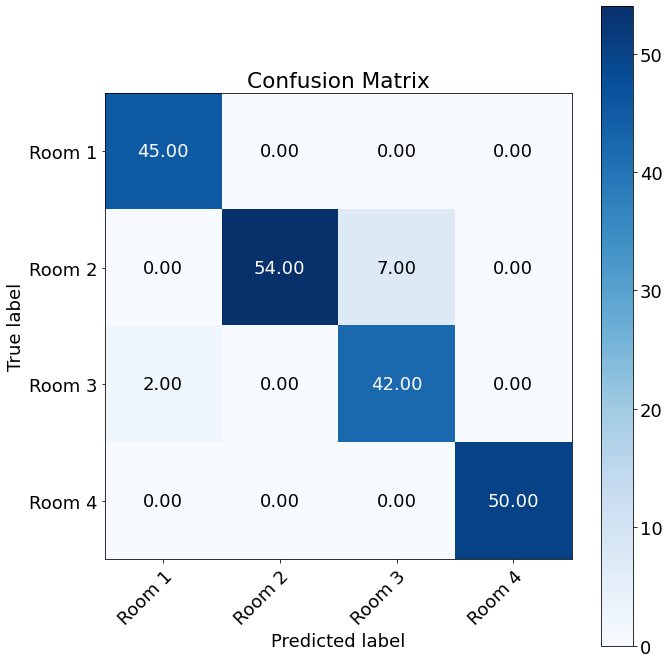

 
Accuracy pruned 2: 0.955
Macro recall pruned 2: 0.9599478390461997
Macro precision pruned 2: 0.9536474164133739


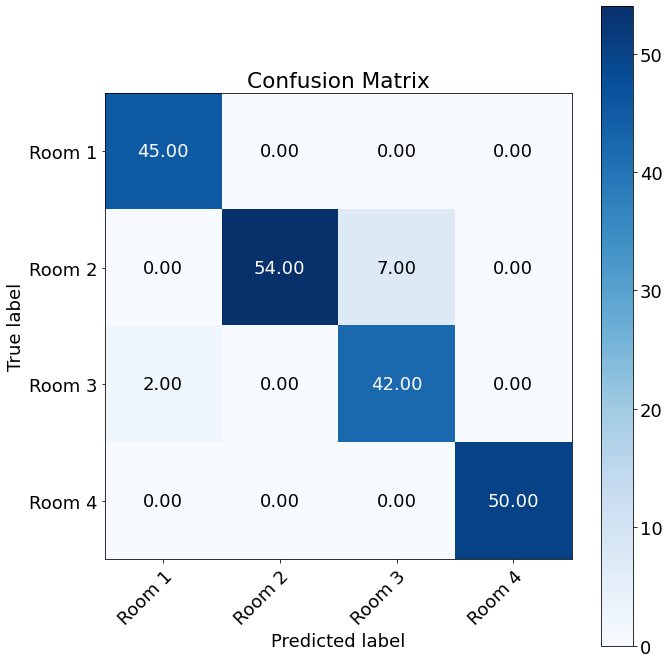

 
Outer Fold:5, Inner fold:8
Accuracy original: 0.995
Macro recall original: 0.9944444444444445
Macro precision original: 0.9944444444444445
 


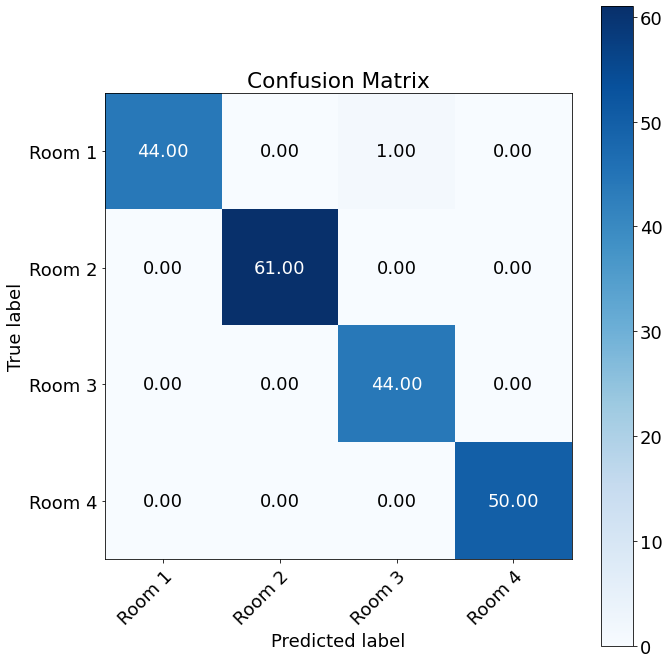

Accuracy pruned 1: 0.99
Macro recall pruned 1: 0.9887626262626263
Macro precision pruned 1: 0.9902859237536656


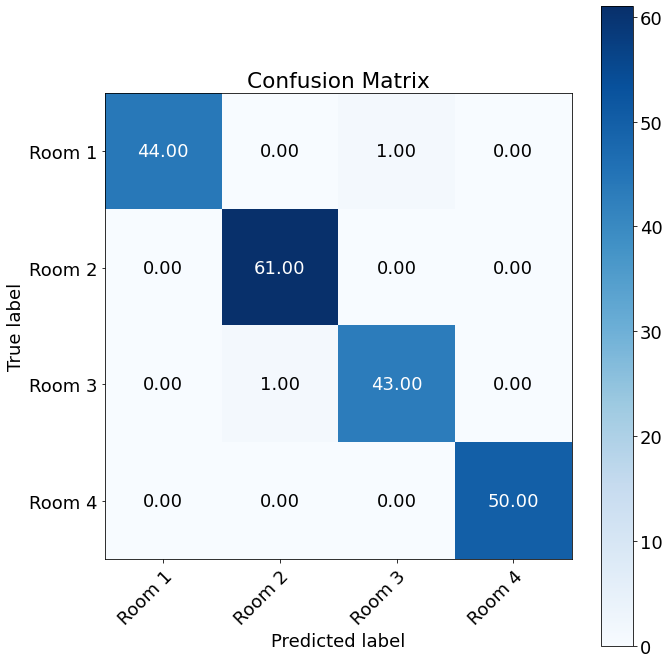

 
Accuracy pruned 2: 0.99
Macro recall pruned 2: 0.9887626262626263
Macro precision pruned 2: 0.9902859237536656


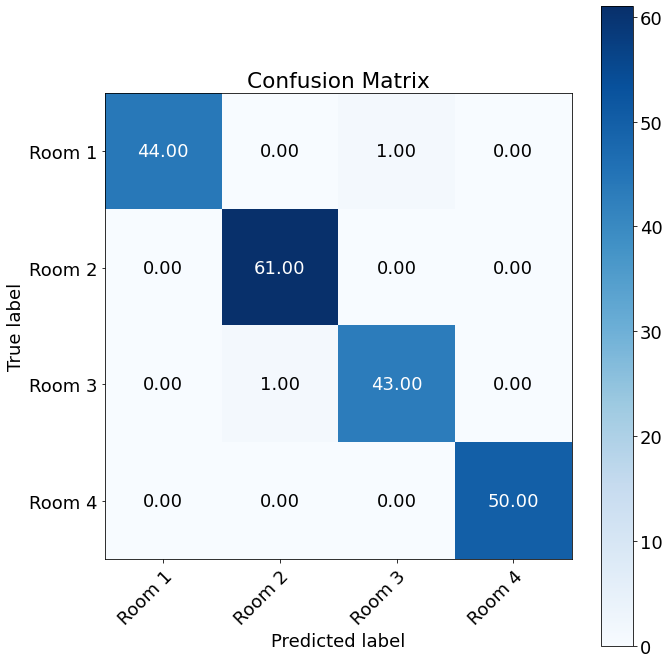

 
Outer Fold:5, Inner fold:9
Accuracy original: 0.985
Macro recall original: 0.986247723132969
Macro precision original: 0.9840425531914894
 


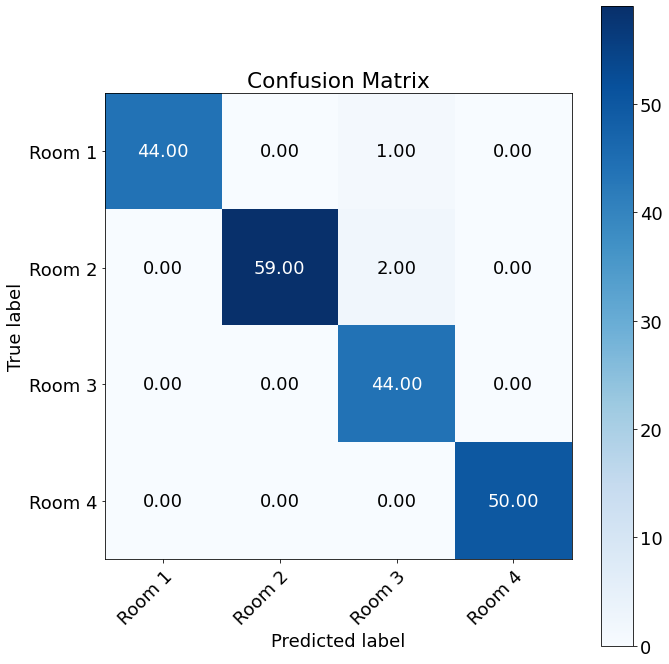

Accuracy pruned 1: 0.975
Macro recall pruned 1: 0.9764675442954132
Macro precision pruned 1: 0.9744861161197259


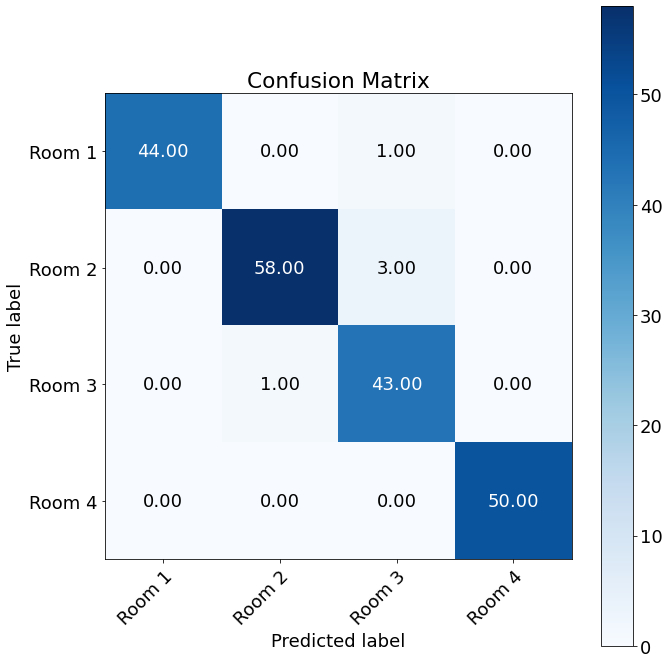

 
Accuracy pruned 2: 0.975
Macro recall pruned 2: 0.9764675442954132
Macro precision pruned 2: 0.9744861161197259


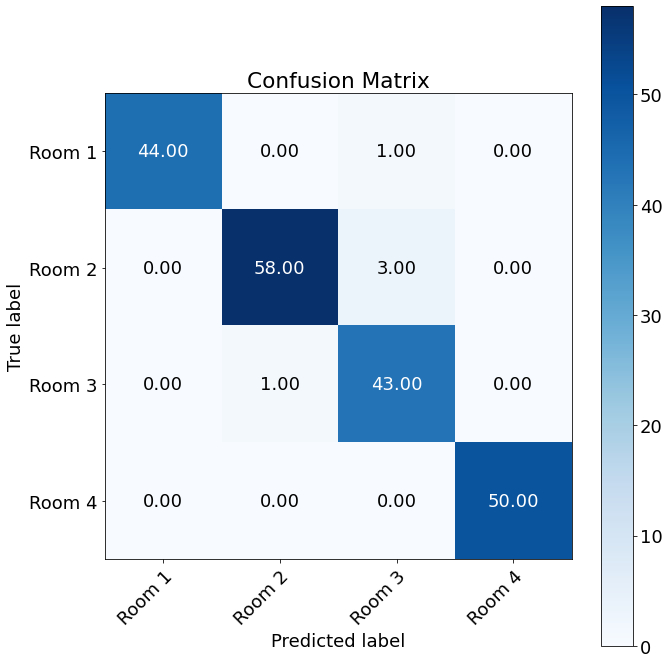

 
Outer Fold:5, Inner fold:10
Accuracy original: 0.985
Macro recall original: 0.9846642656068885
Macro precision original: 0.9847905282331512
 


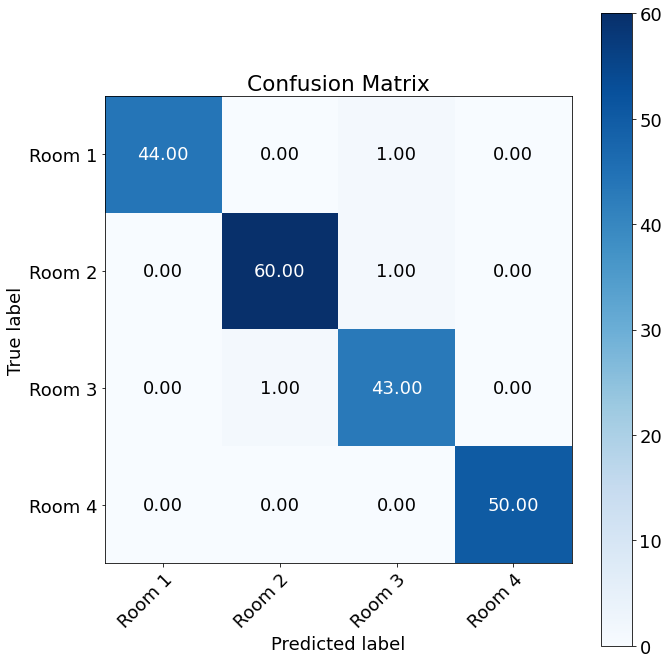

Accuracy pruned 1: 0.98
Macro recall pruned 1: 0.9821493624772313
Macro precision pruned 1: 0.9791666666666666


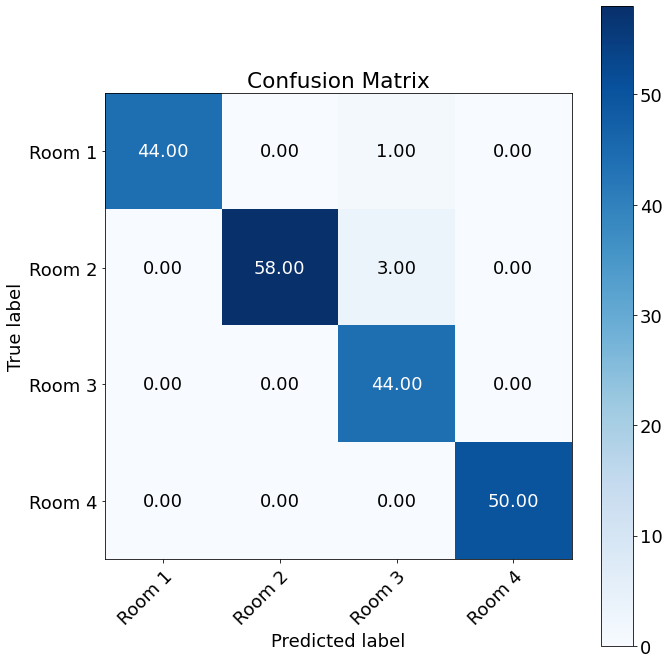

 
Accuracy pruned 2: 0.98
Macro recall pruned 2: 0.9821493624772313
Macro precision pruned 2: 0.9791666666666666


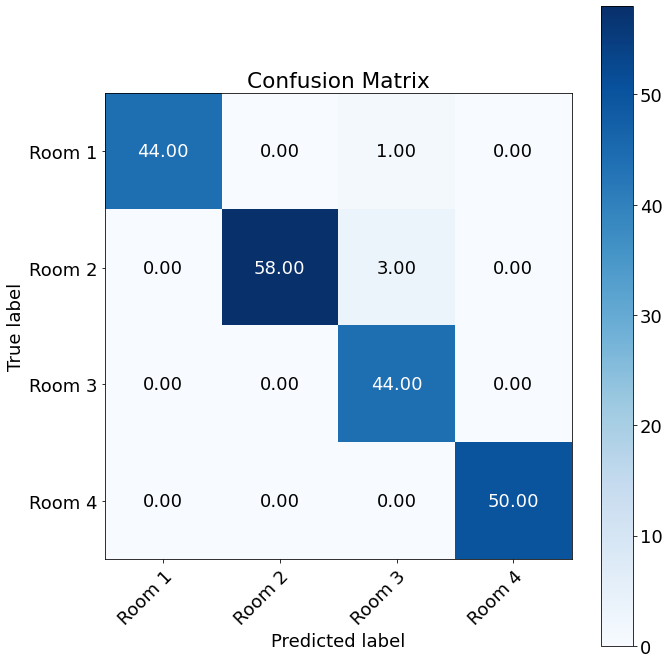

 
Outer Fold:6, Inner fold:1
Accuracy original: 0.95
Macro recall original: 0.9513636363636363
Macro precision original: 0.9534139184513643
 


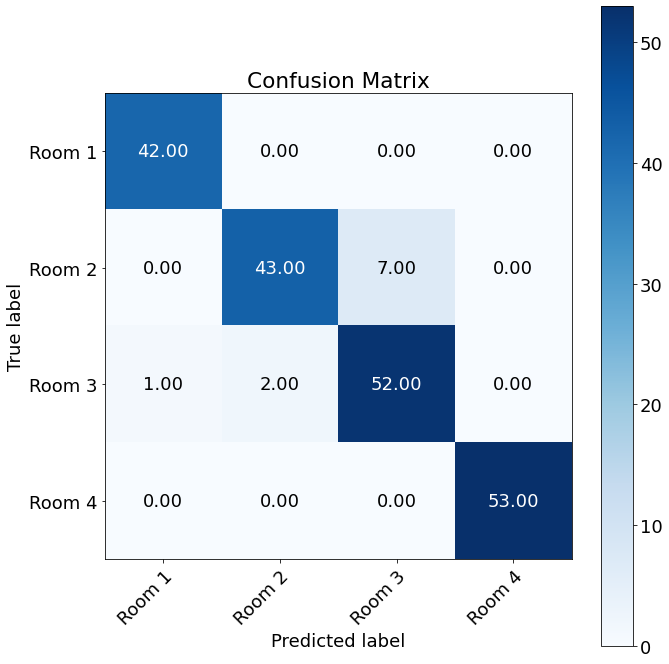

Accuracy pruned 1: 0.96
Macro recall pruned 1: 0.9618181818181818
Macro precision pruned 1: 0.9606981058808302


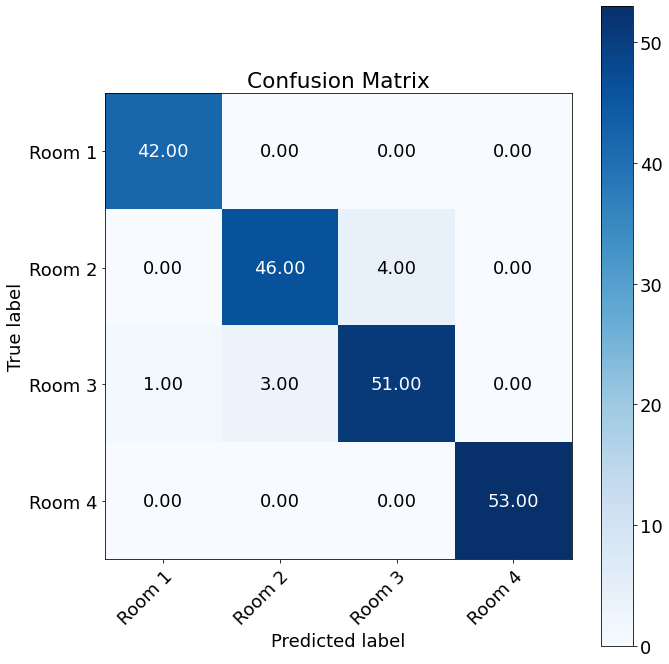

 
Accuracy pruned 2: 0.96
Macro recall pruned 2: 0.9618181818181818
Macro precision pruned 2: 0.9606981058808302


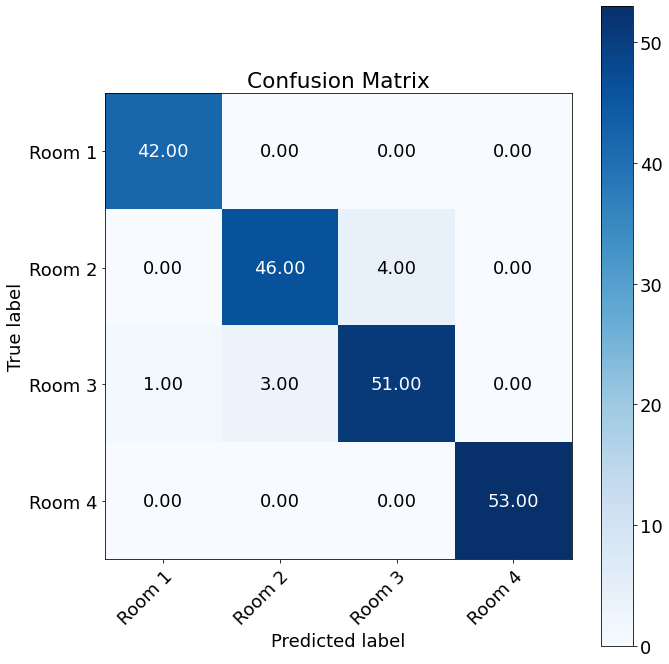

 
Outer Fold:6, Inner fold:2
Accuracy original: 0.96
Macro recall original: 0.9625557461406518
Macro precision original: 0.9597902097902098
 


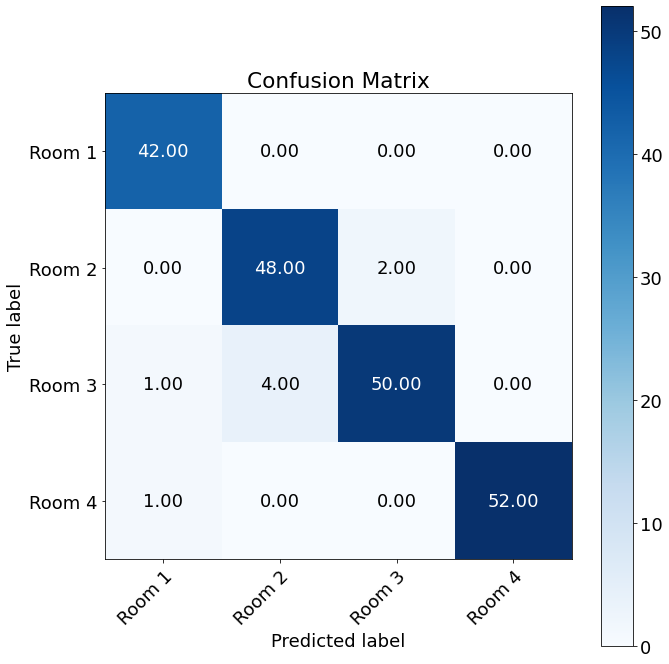

Accuracy pruned 1: 0.94
Macro recall pruned 1: 0.9428387650085763
Macro precision pruned 1: 0.9399085968379447


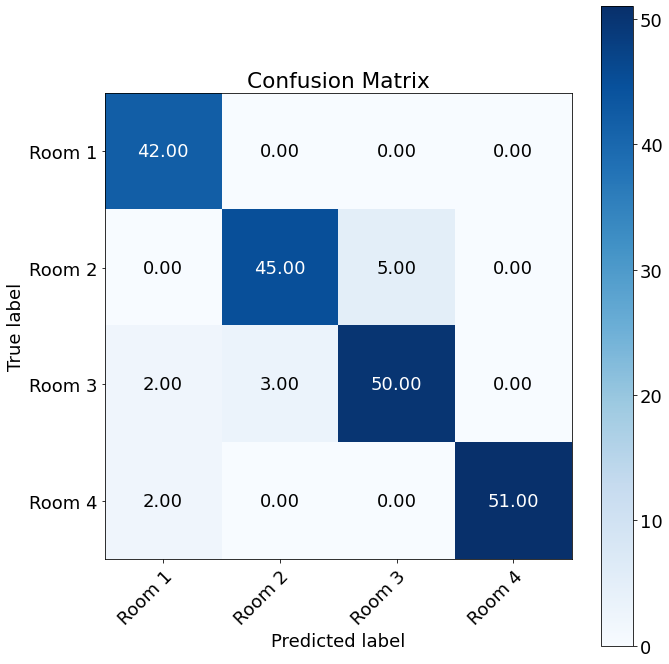

 
Accuracy pruned 2: 0.94
Macro recall pruned 2: 0.9428387650085763
Macro precision pruned 2: 0.9399085968379447


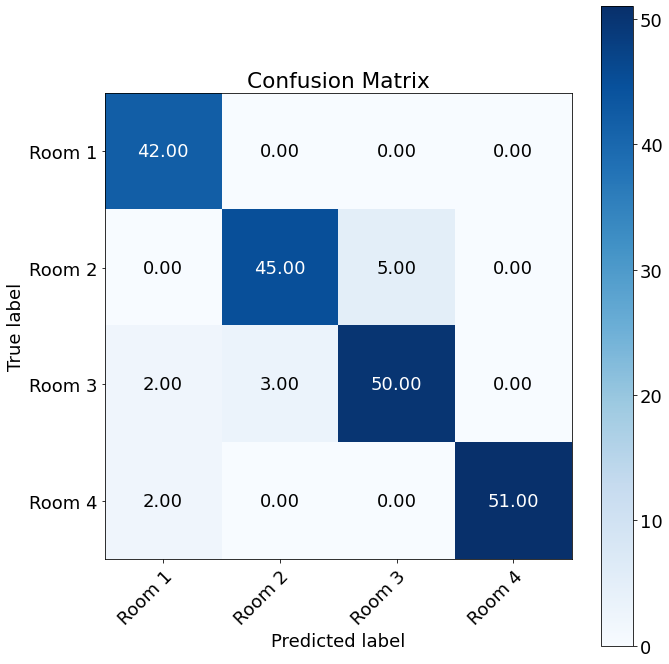

 
Outer Fold:6, Inner fold:3
Accuracy original: 0.955
Macro recall original: 0.9578387650085763
Macro precision original: 0.9561539533324759
 


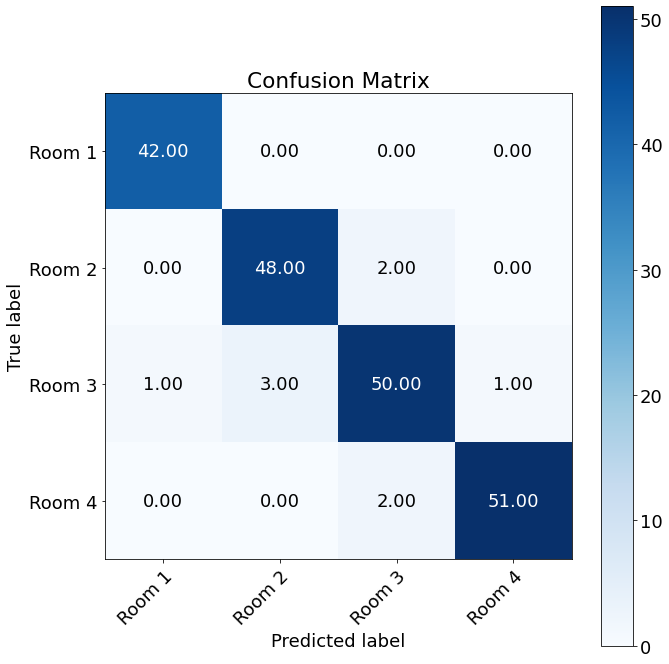

Accuracy pruned 1: 0.945
Macro recall pruned 1: 0.9482933104631218
Macro precision pruned 1: 0.9458803723509606


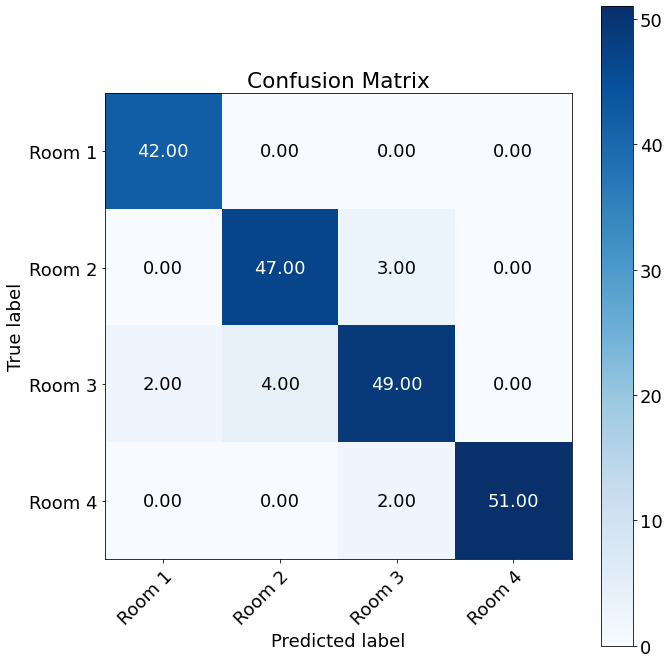

 
Accuracy pruned 2: 0.945
Macro recall pruned 2: 0.9482933104631218
Macro precision pruned 2: 0.9458803723509606


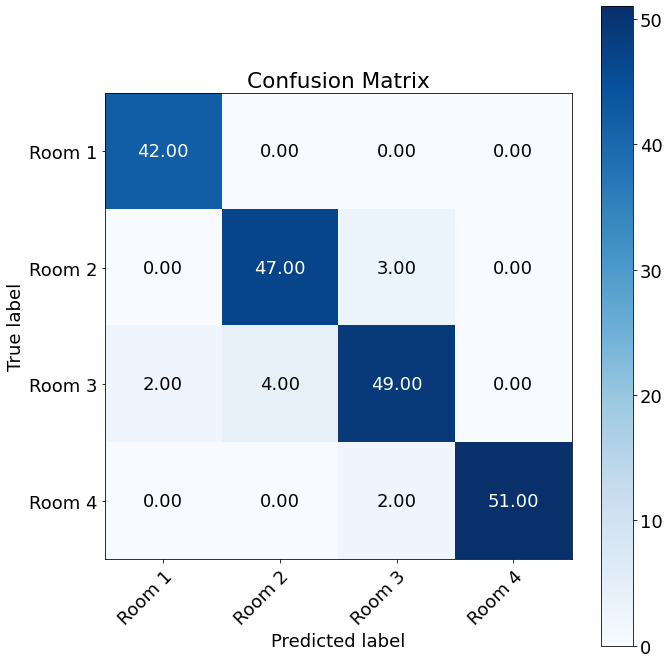

 
Outer Fold:6, Inner fold:4
Accuracy original: 0.96
Macro recall original: 0.9622727272727273
Macro precision original: 0.9604272599781465
 


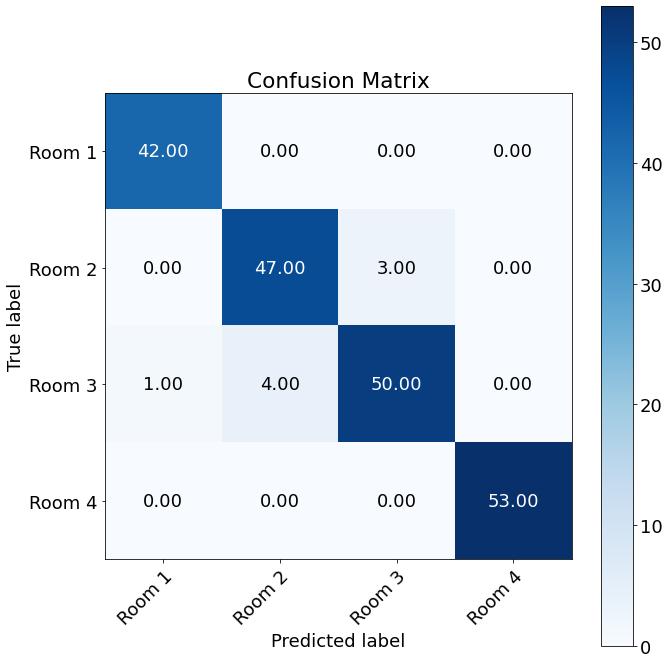

Accuracy pruned 1: 0.935
Macro recall pruned 1: 0.9381818181818181
Macro precision pruned 1: 0.9347222222222222


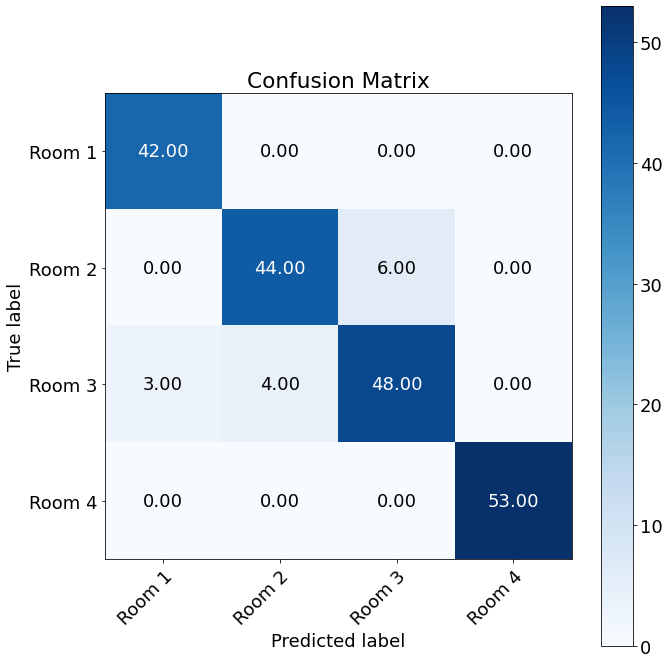

 
Accuracy pruned 2: 0.935
Macro recall pruned 2: 0.9381818181818181
Macro precision pruned 2: 0.9347222222222222


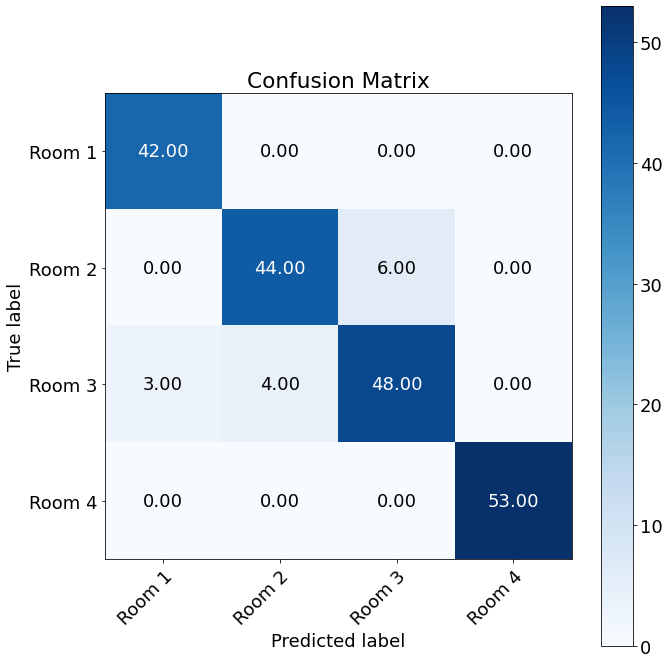

 
Outer Fold:6, Inner fold:5
Accuracy original: 0.955
Macro recall original: 0.9572727272727273
Macro precision original: 0.9557317759145002
 


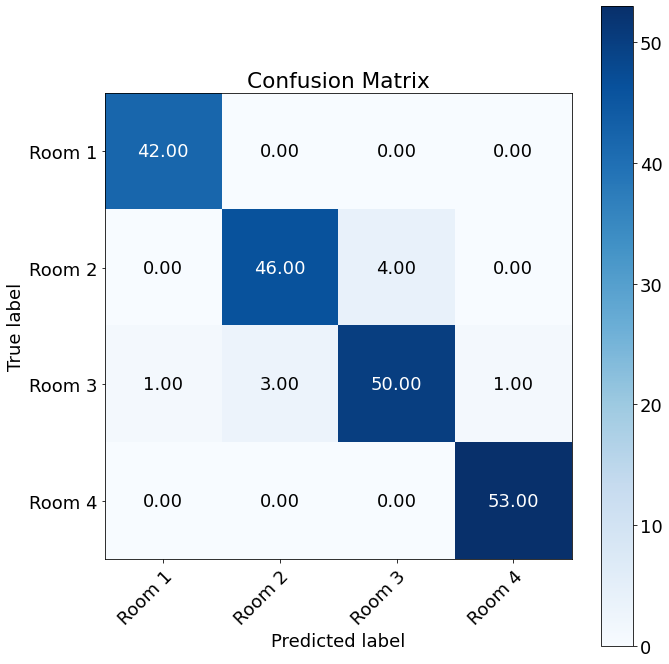

Accuracy pruned 1: 0.925
Macro recall pruned 1: 0.9277272727272727
Macro precision pruned 1: 0.927494775339603


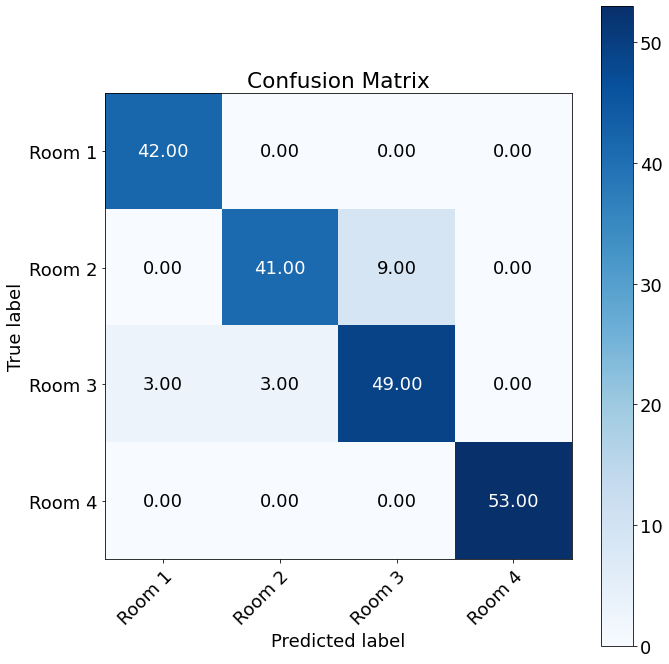

 
Accuracy pruned 2: 0.925
Macro recall pruned 2: 0.9277272727272727
Macro precision pruned 2: 0.927494775339603


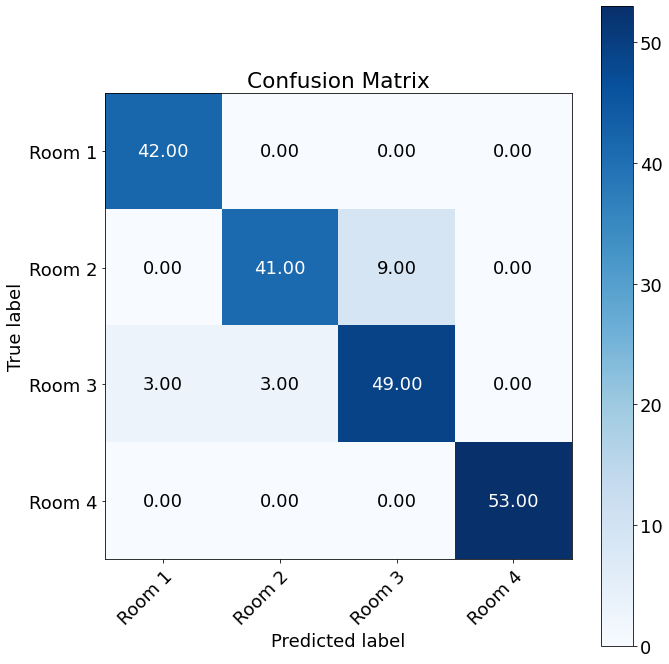

 
Outer Fold:6, Inner fold:6
Accuracy original: 0.985
Macro recall original: 0.9854545454545455
Macro precision original: 0.985969387755102
 


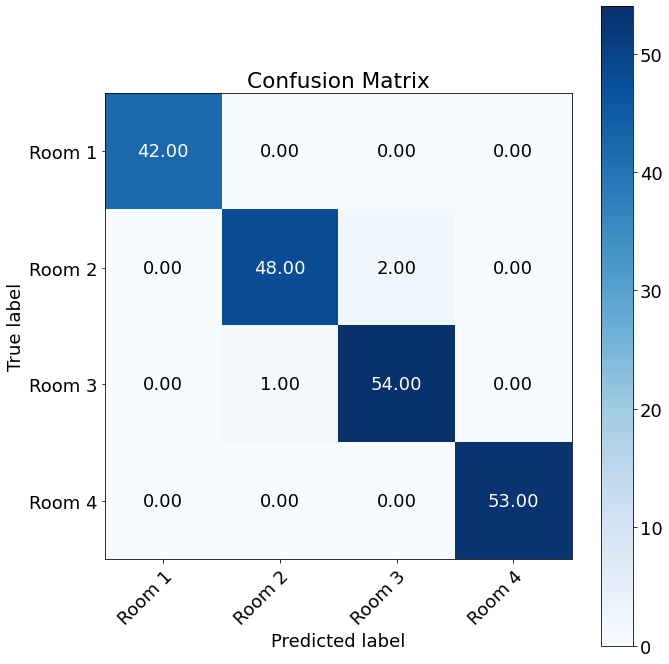

Accuracy pruned 1: 0.975
Macro recall pruned 1: 0.9754545454545455
Macro precision pruned 1: 0.9774394717534849


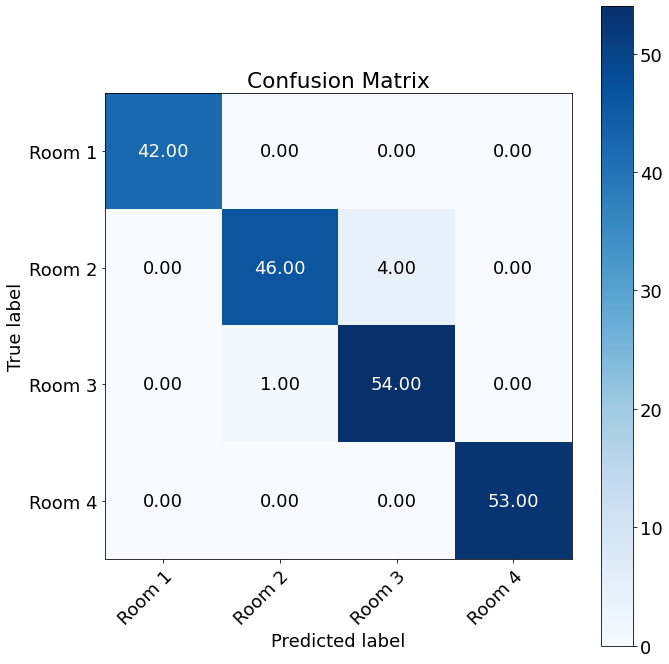

 
Accuracy pruned 2: 0.975
Macro recall pruned 2: 0.9754545454545455
Macro precision pruned 2: 0.9774394717534849


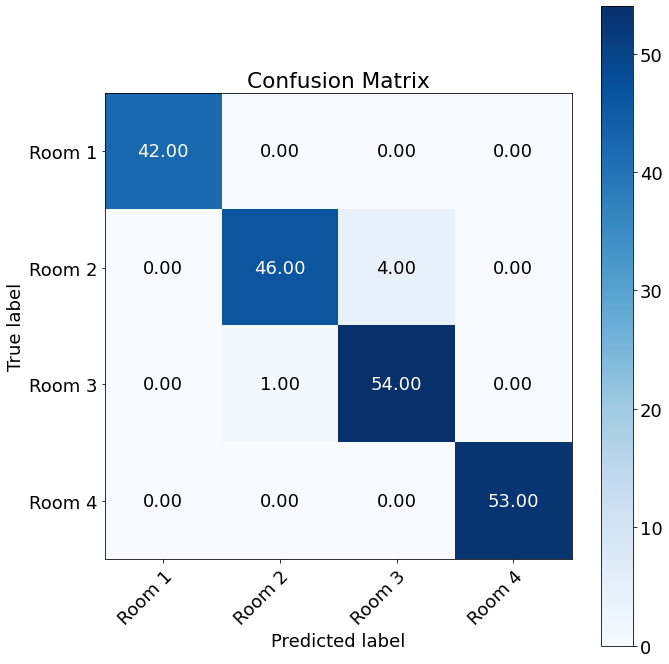

 
Outer Fold:6, Inner fold:7
Accuracy original: 0.965
Macro recall original: 0.9663636363636363
Macro precision original: 0.9670965608465608
 


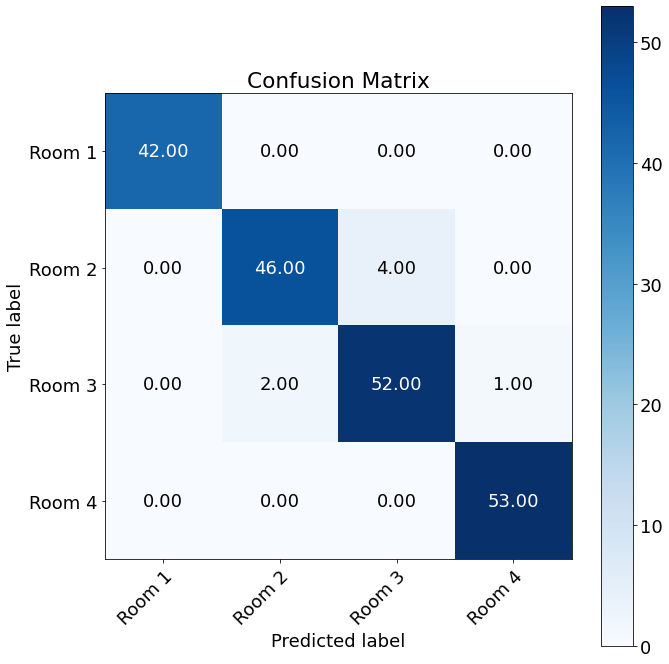

Accuracy pruned 1: 0.93
Macro recall pruned 1: 0.9327272727272726
Macro precision pruned 1: 0.9315789473684211


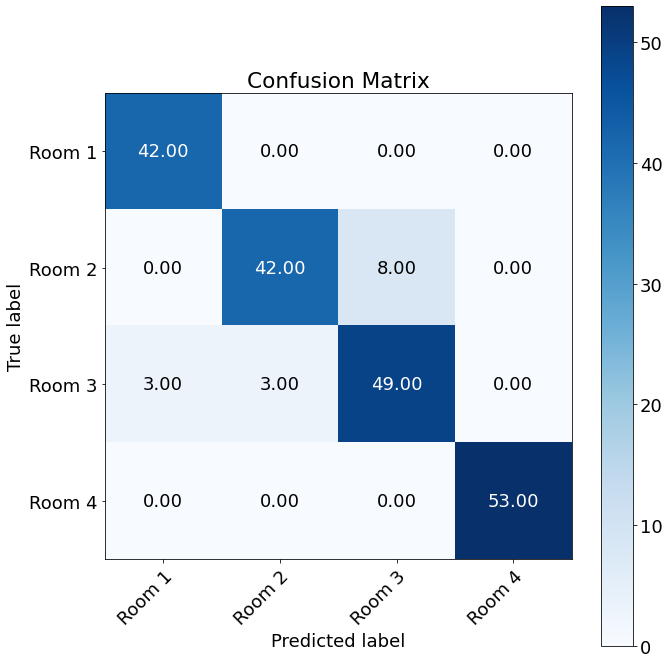

 
Accuracy pruned 2: 0.93
Macro recall pruned 2: 0.9327272727272726
Macro precision pruned 2: 0.9315789473684211


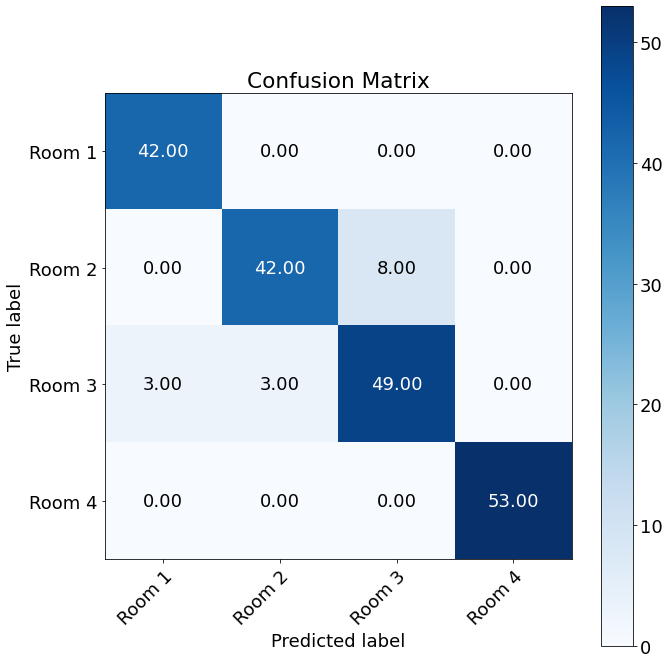

 
Outer Fold:6, Inner fold:8
Accuracy original: 0.955
Macro recall original: 0.9572727272727273
Macro precision original: 0.9556675279931094
 


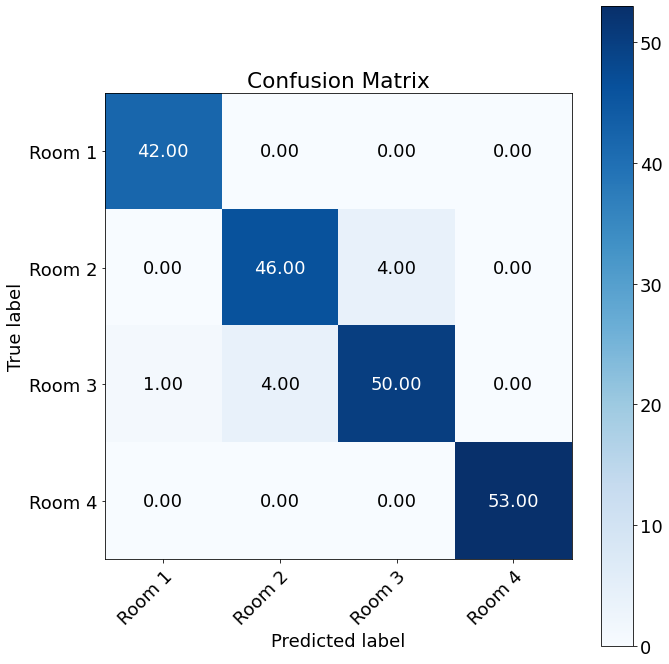

Accuracy pruned 1: 0.945
Macro recall pruned 1: 0.9472727272727273
Macro precision pruned 1: 0.9465669988925802


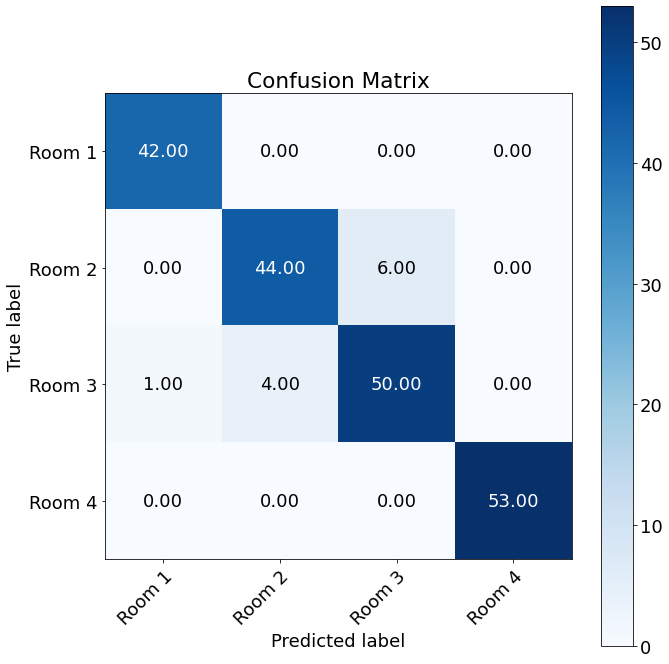

 
Accuracy pruned 2: 0.945
Macro recall pruned 2: 0.9472727272727273
Macro precision pruned 2: 0.9465669988925802


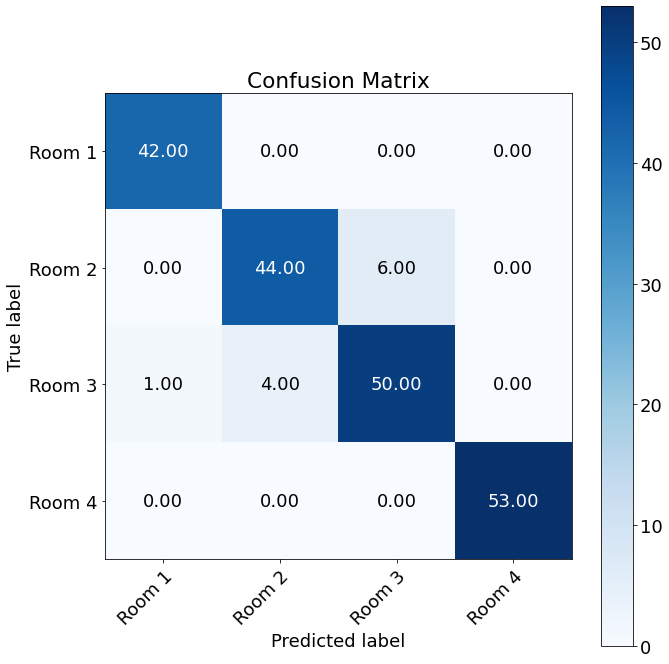

 
Outer Fold:6, Inner fold:9
Accuracy original: 0.97
Macro recall original: 0.9713636363636363
Macro precision original: 0.9713636363636363
 


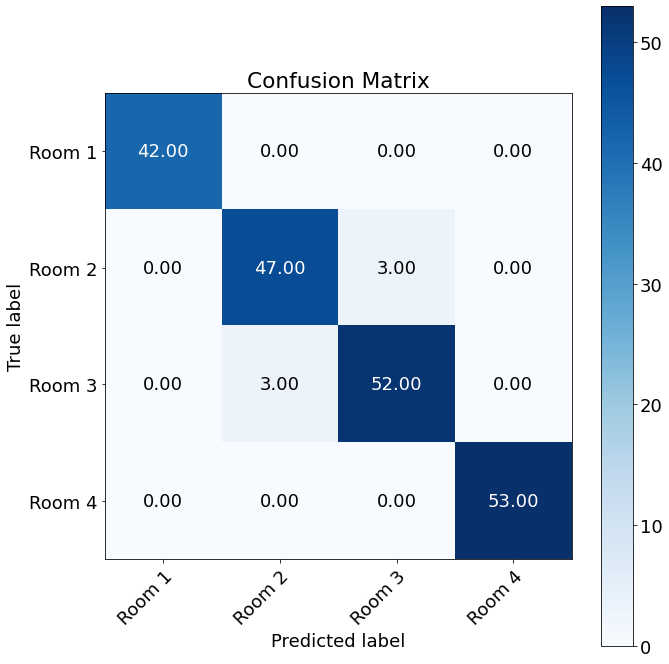

Accuracy pruned 1: 0.95
Macro recall pruned 1: 0.9518181818181818
Macro precision pruned 1: 0.9528508771929824


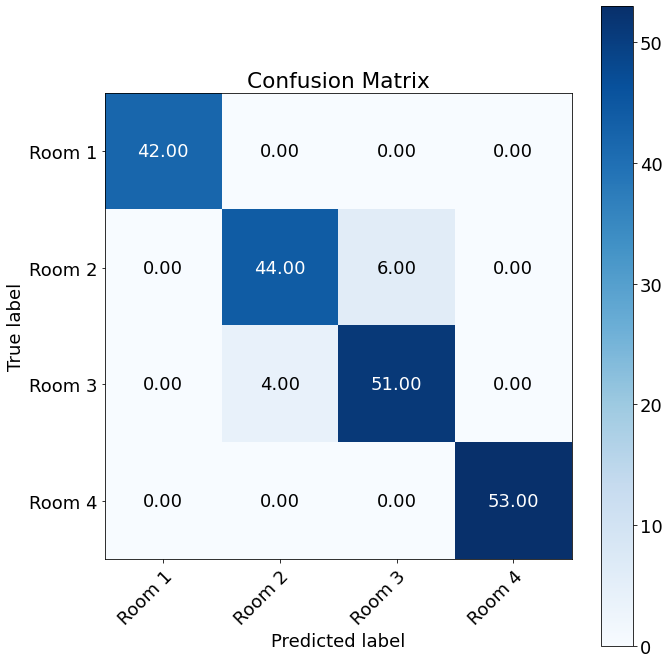

 
Accuracy pruned 2: 0.95
Macro recall pruned 2: 0.9518181818181818
Macro precision pruned 2: 0.9528508771929824


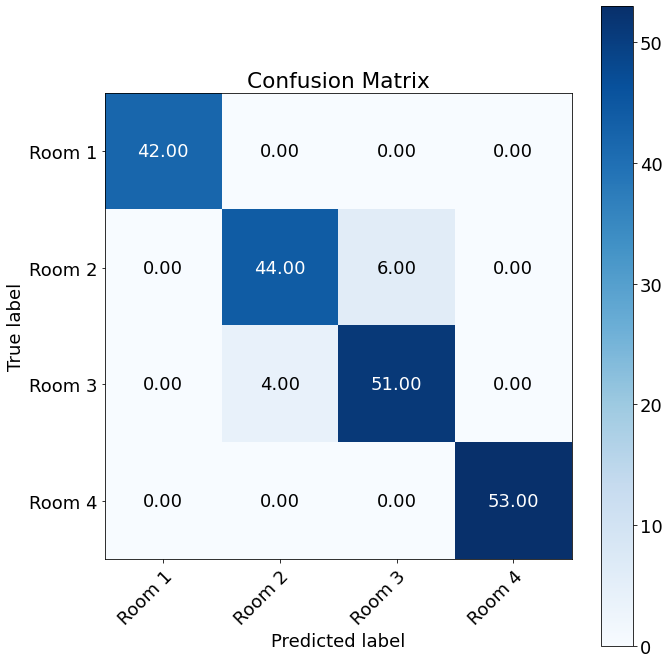

 
Outer Fold:6, Inner fold:10
Accuracy original: 0.965
Macro recall original: 0.9672727272727273
Macro precision original: 0.9652351499136724
 


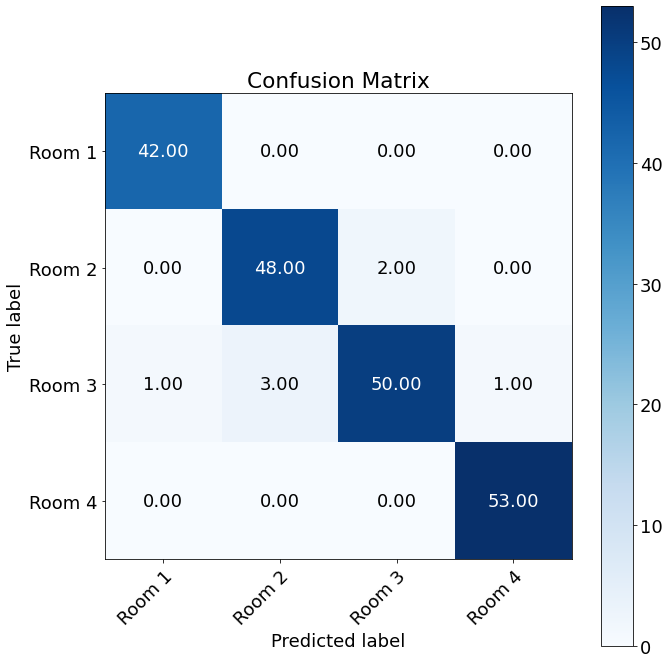

Accuracy pruned 1: 0.95
Macro recall pruned 1: 0.9522727272727273
Macro precision pruned 1: 0.951050610519049


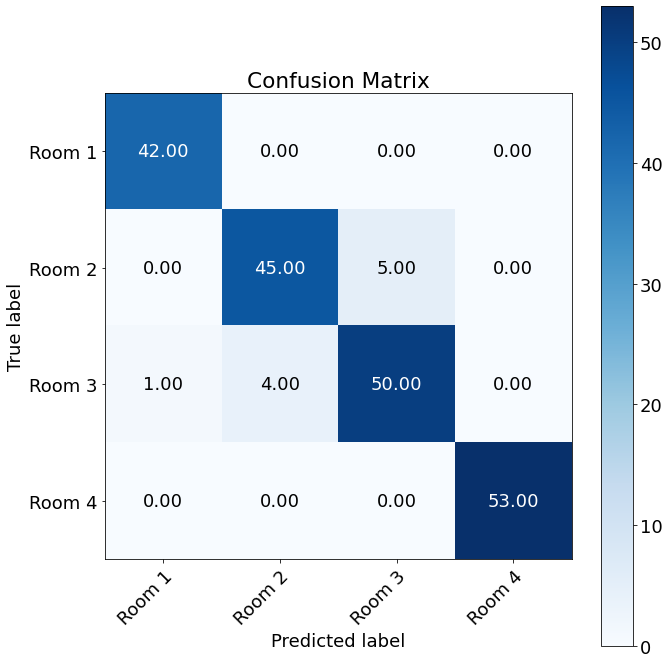

 
Accuracy pruned 2: 0.95
Macro recall pruned 2: 0.9522727272727273
Macro precision pruned 2: 0.951050610519049


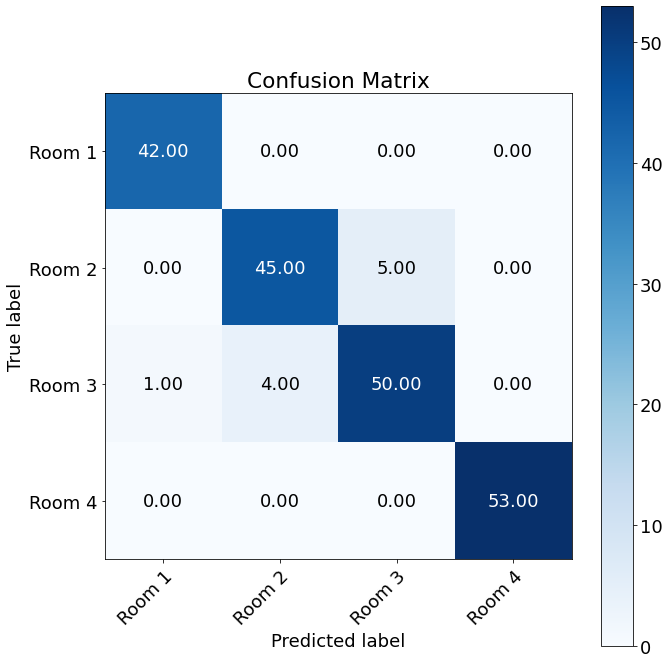

 
Outer Fold:7, Inner fold:1
Accuracy original: 0.955
Macro recall original: 0.9536474164133739
Macro precision original: 0.9549825174825175
 


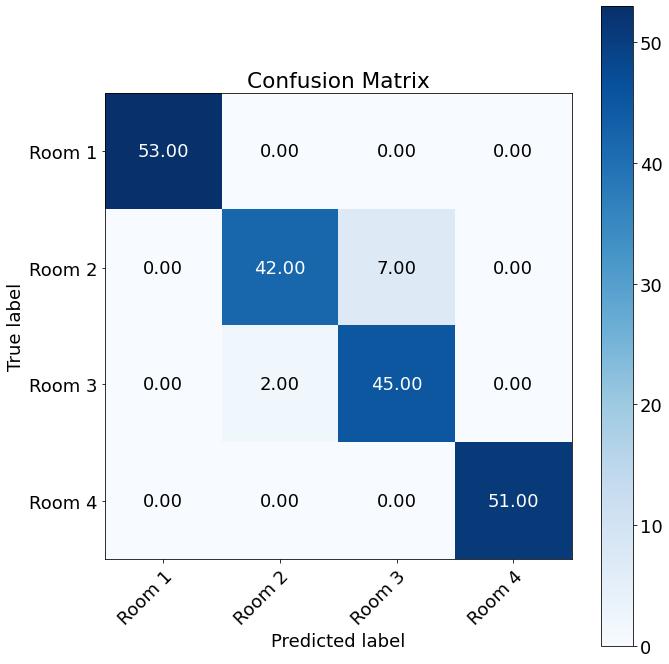

Accuracy pruned 1: 0.96
Macro recall pruned 1: 0.958966565349544
Macro precision pruned 1: 0.9611671785870997


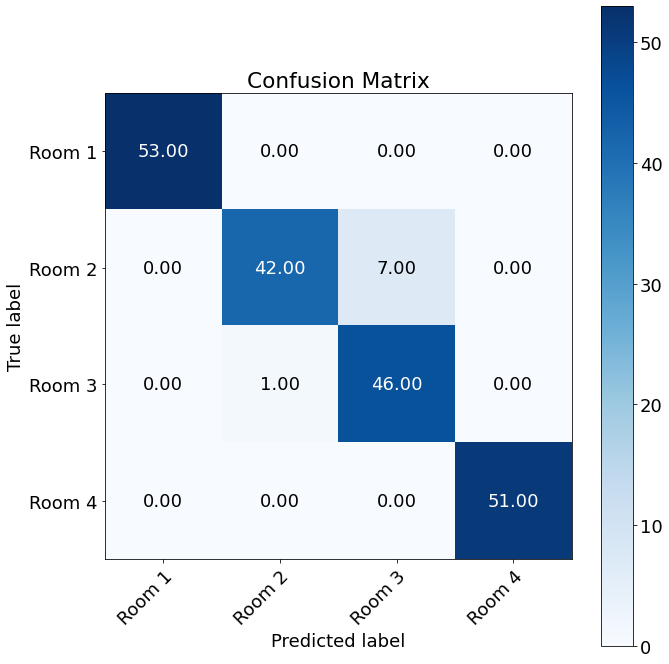

 
Accuracy pruned 2: 0.96
Macro recall pruned 2: 0.958966565349544
Macro precision pruned 2: 0.9611671785870997


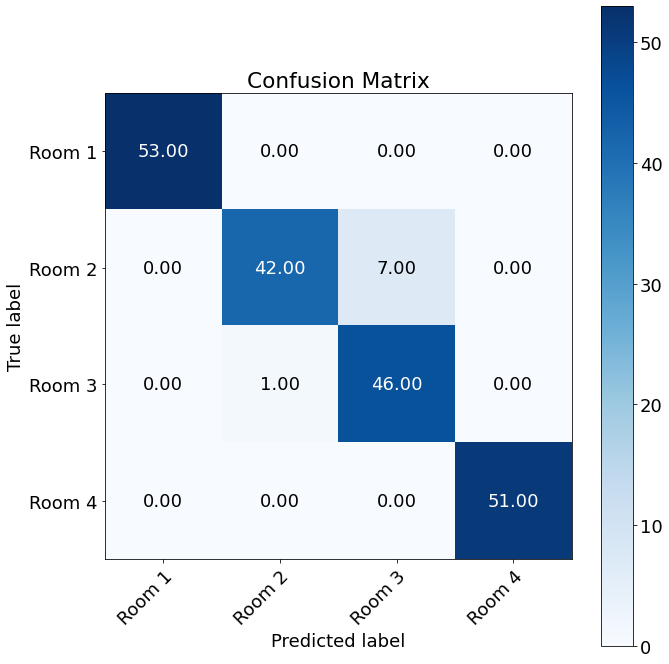

 
Outer Fold:7, Inner fold:2
Accuracy original: 0.96
Macro recall original: 0.9585323491098567
Macro precision original: 0.9585323491098567
 


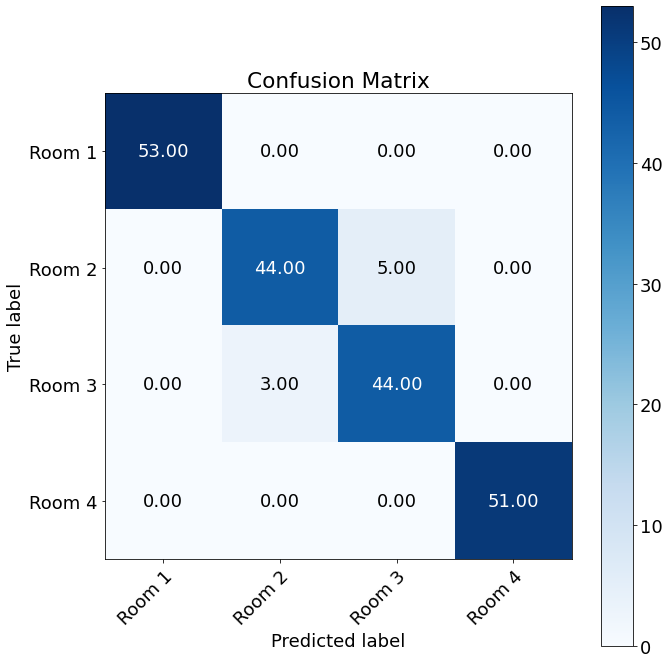

Accuracy pruned 1: 0.96
Macro recall pruned 1: 0.9591836734693877
Macro precision pruned 1: 0.9636363636363636


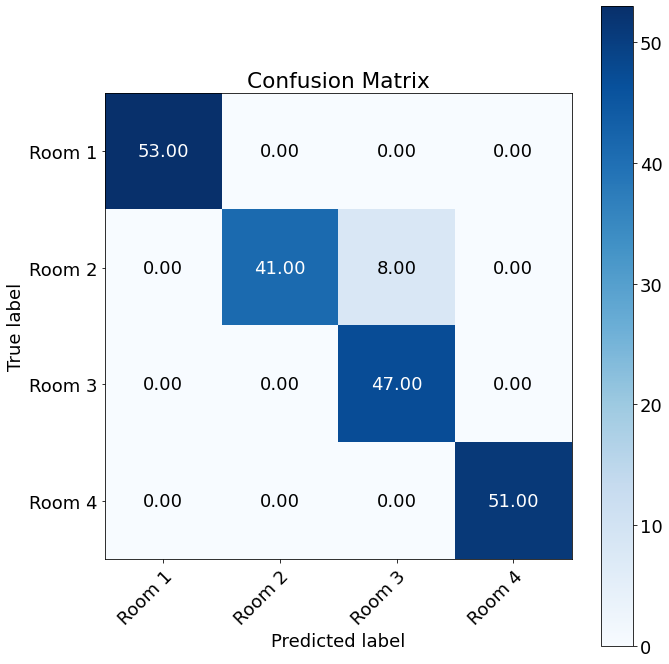

 
Accuracy pruned 2: 0.96
Macro recall pruned 2: 0.9591836734693877
Macro precision pruned 2: 0.9636363636363636


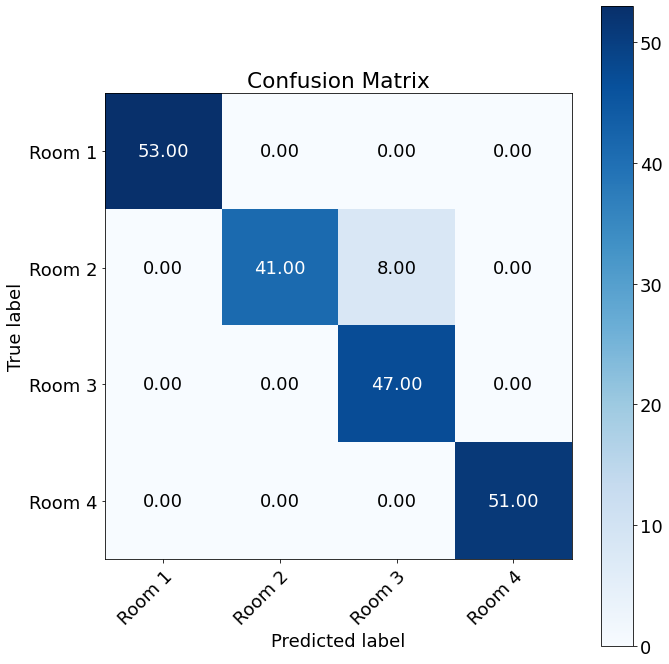

 
Outer Fold:7, Inner fold:3
Accuracy original: 0.965
Macro recall original: 0.9636343899261832
Macro precision original: 0.9635416666666666
 


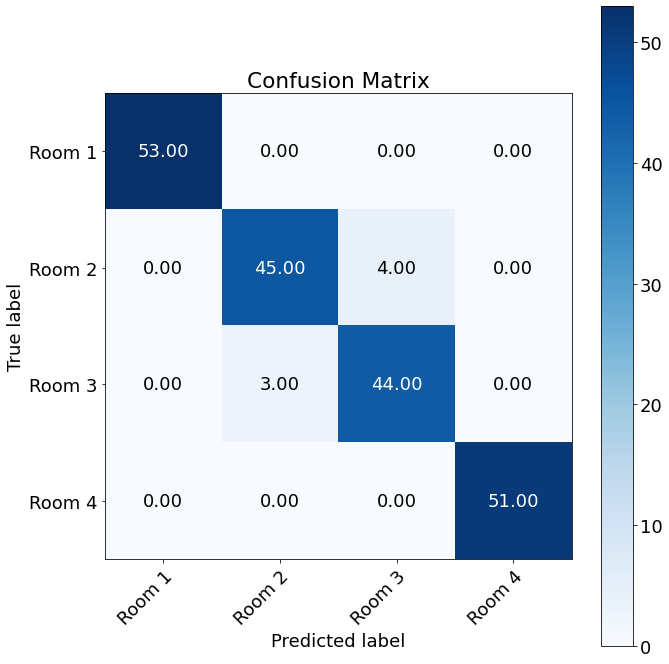

Accuracy pruned 1: 0.965
Macro recall pruned 1: 0.9642857142857143
Macro precision pruned 1: 0.9675925925925926


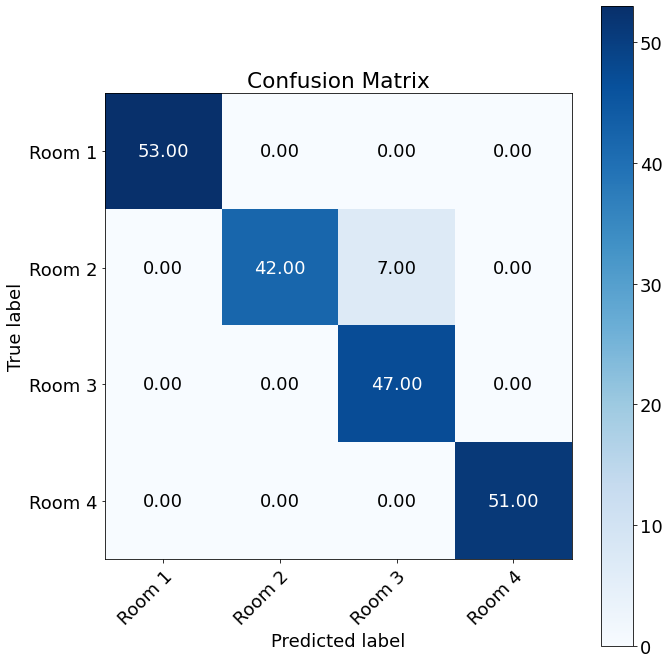

 
Accuracy pruned 2: 0.965
Macro recall pruned 2: 0.9642857142857143
Macro precision pruned 2: 0.9675925925925926


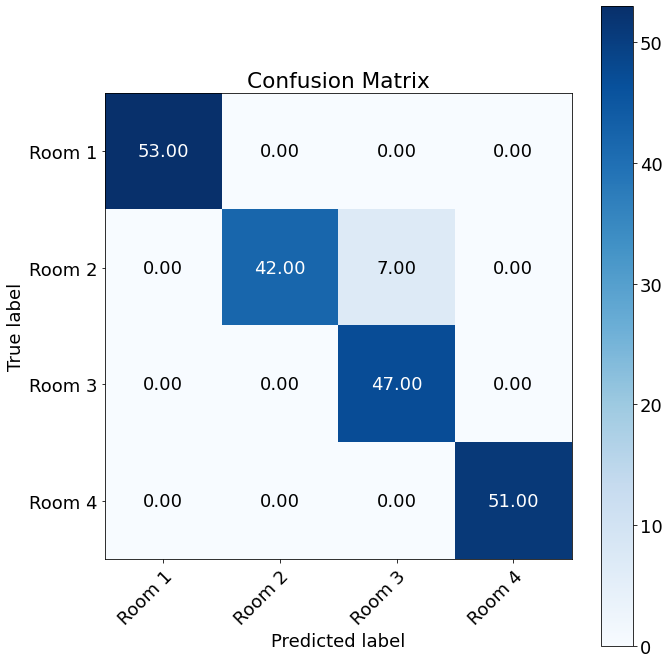

 
Outer Fold:7, Inner fold:4
Accuracy original: 0.965
Macro recall original: 0.9640686061658705
Macro precision original: 0.9654720279720279
 


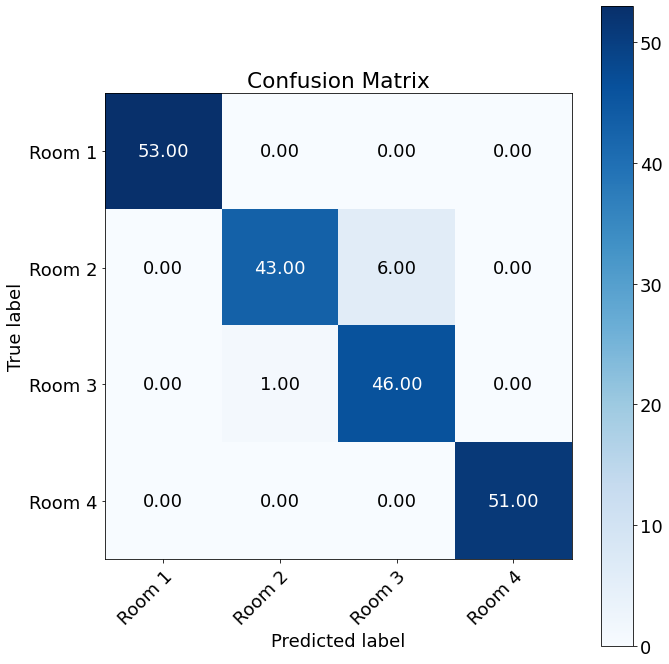

Accuracy pruned 1: 0.965
Macro recall pruned 1: 0.9642857142857143
Macro precision pruned 1: 0.9675925925925926


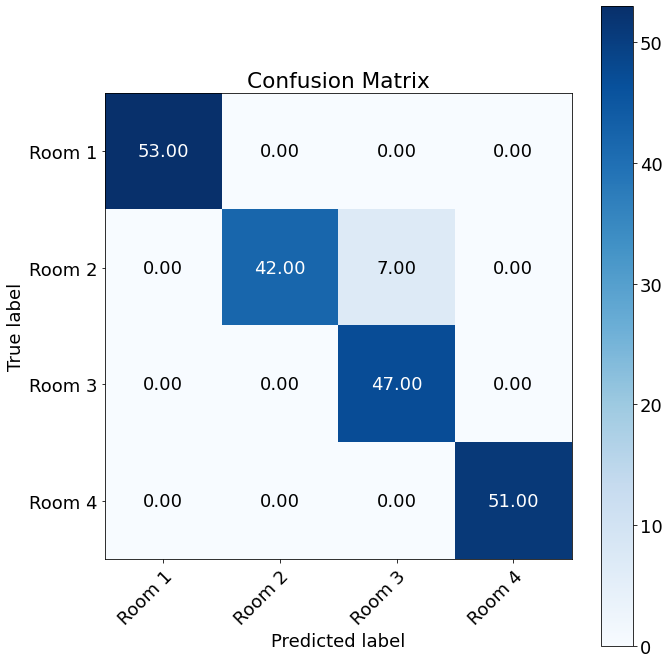

 
Accuracy pruned 2: 0.965
Macro recall pruned 2: 0.9642857142857143
Macro precision pruned 2: 0.9675925925925926


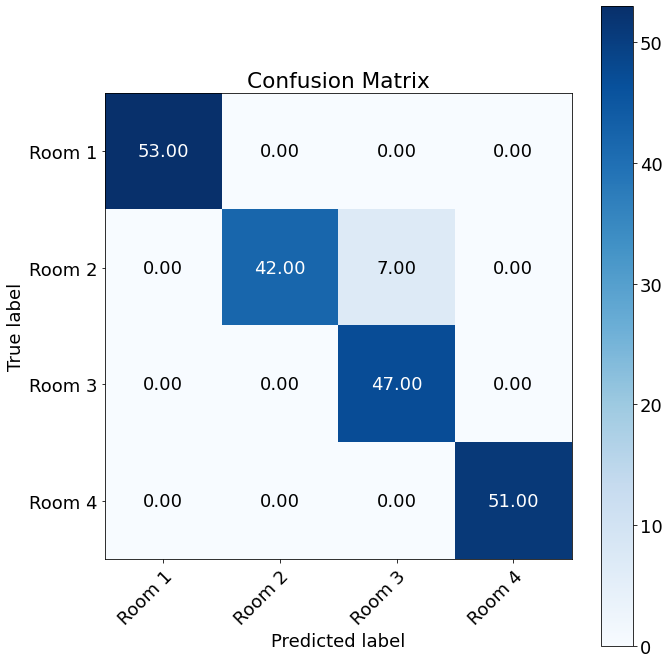

 
Outer Fold:7, Inner fold:5
Accuracy original: 0.965
Macro recall original: 0.9646707739699654
Macro precision original: 0.9675925925925926
 


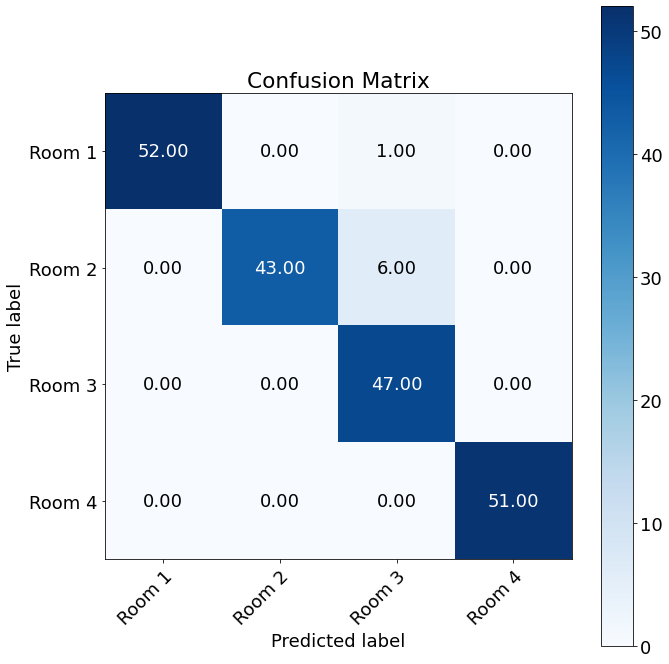

Accuracy pruned 1: 0.96
Macro recall pruned 1: 0.9593516250337951
Macro precision pruned 1: 0.9612993138936535


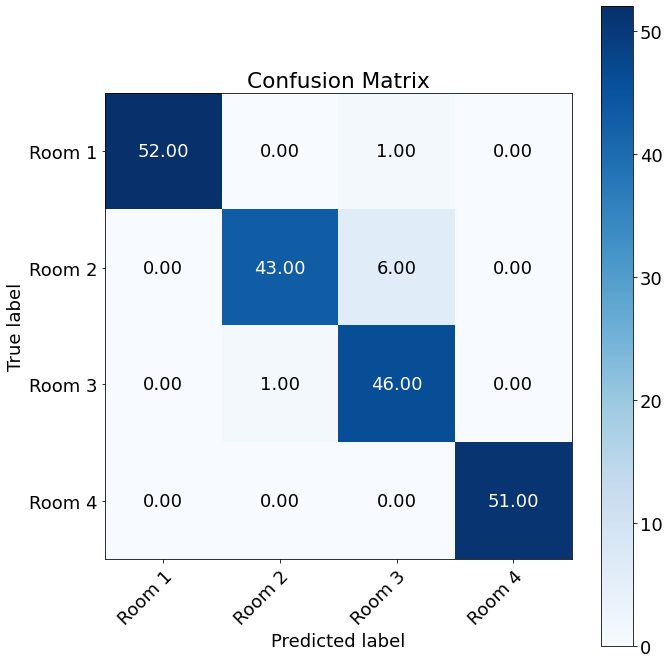

 
Accuracy pruned 2: 0.96
Macro recall pruned 2: 0.9593516250337951
Macro precision pruned 2: 0.9612993138936535


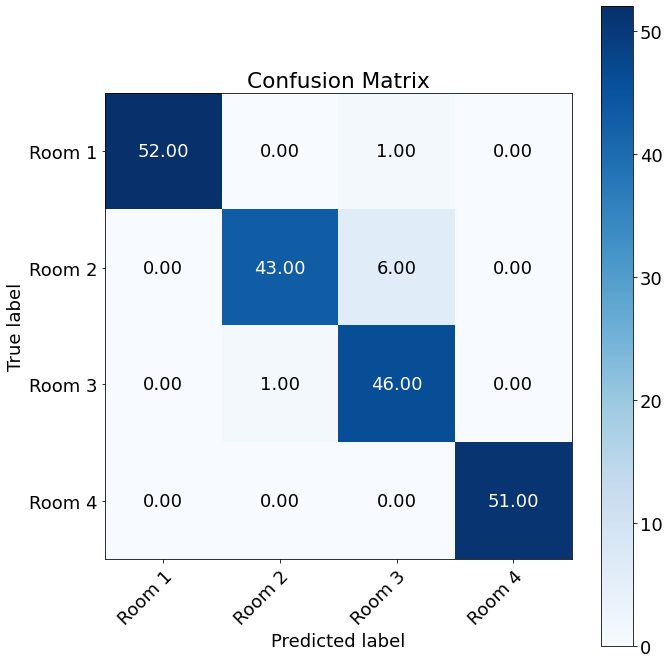

 
Outer Fold:7, Inner fold:6
Accuracy original: 0.965
Macro recall original: 0.9640686061658705
Macro precision original: 0.9654720279720279
 


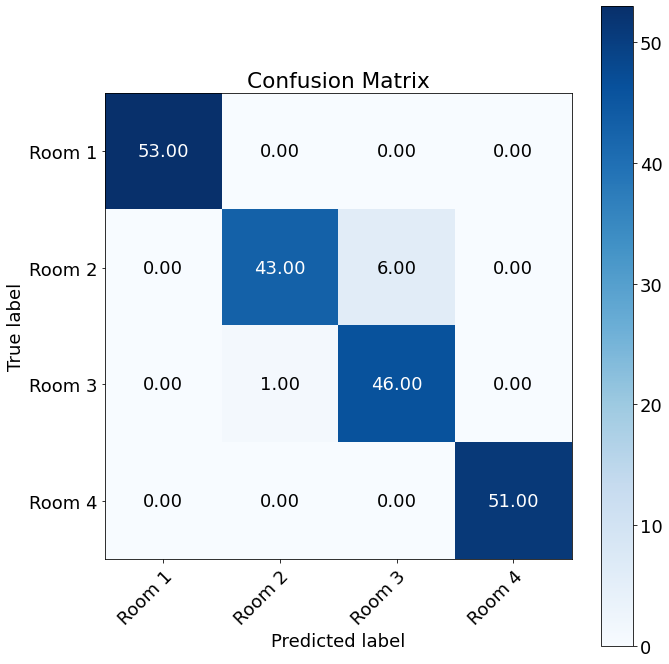

Accuracy pruned 1: 0.965
Macro recall pruned 1: 0.9642857142857143
Macro precision pruned 1: 0.9675925925925926


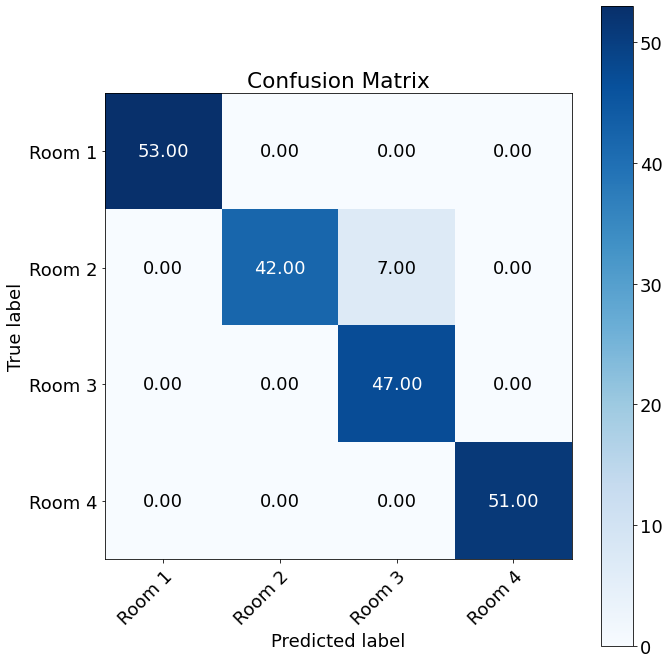

 
Accuracy pruned 2: 0.965
Macro recall pruned 2: 0.9642857142857143
Macro precision pruned 2: 0.9675925925925926


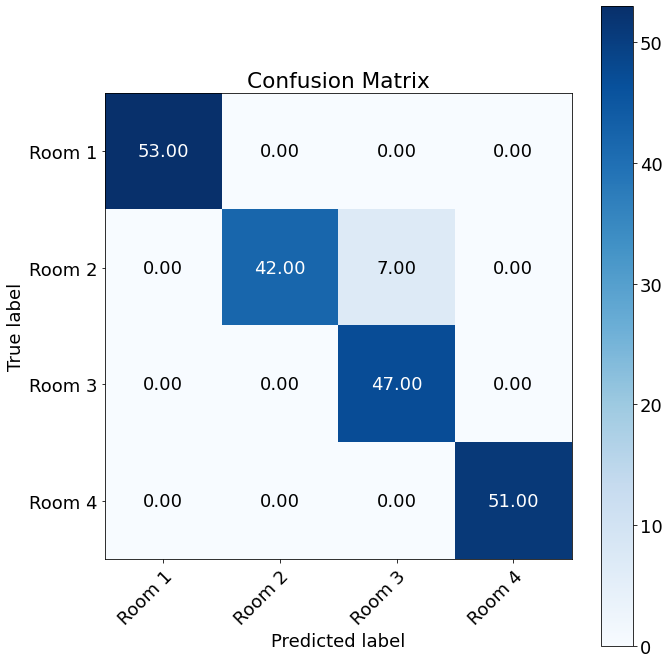

 
Outer Fold:7, Inner fold:7
Accuracy original: 0.95
Macro recall original: 0.9487133271614547
Macro precision original: 0.949381926683717
 


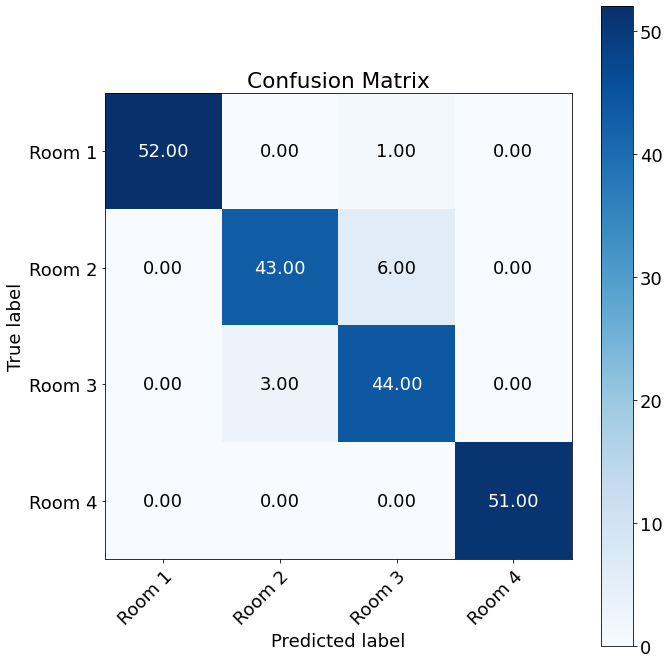

Accuracy pruned 1: 0.96
Macro recall pruned 1: 0.9591836734693877
Macro precision pruned 1: 0.9636363636363636


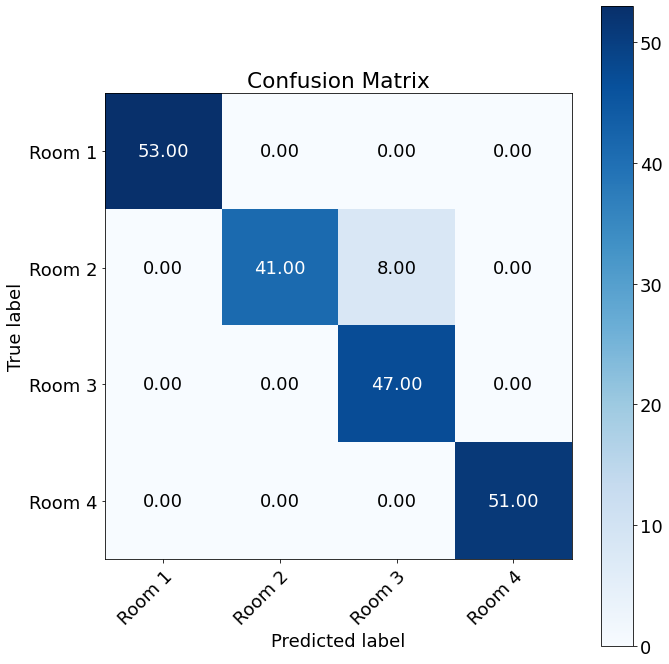

 
Accuracy pruned 2: 0.96
Macro recall pruned 2: 0.9591836734693877
Macro precision pruned 2: 0.9636363636363636


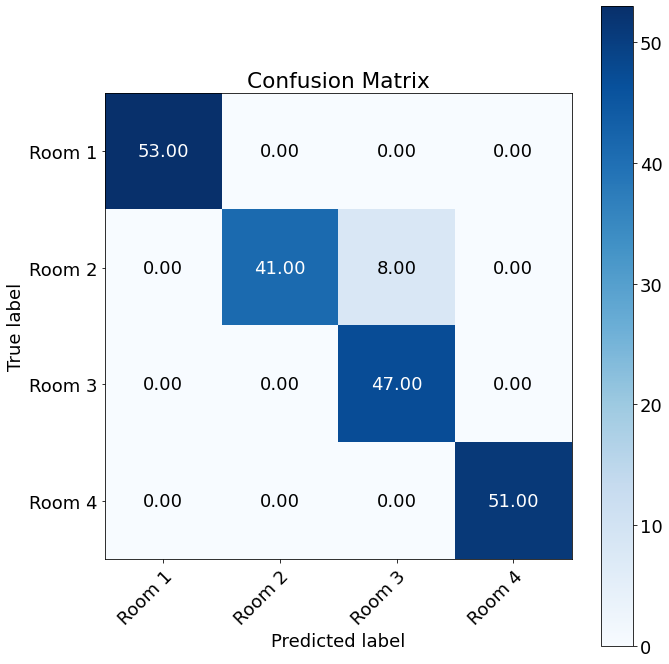

 
Outer Fold:7, Inner fold:8
Accuracy original: 0.975
Macro recall original: 0.9742726877985236
Macro precision original: 0.9745652173913043
 


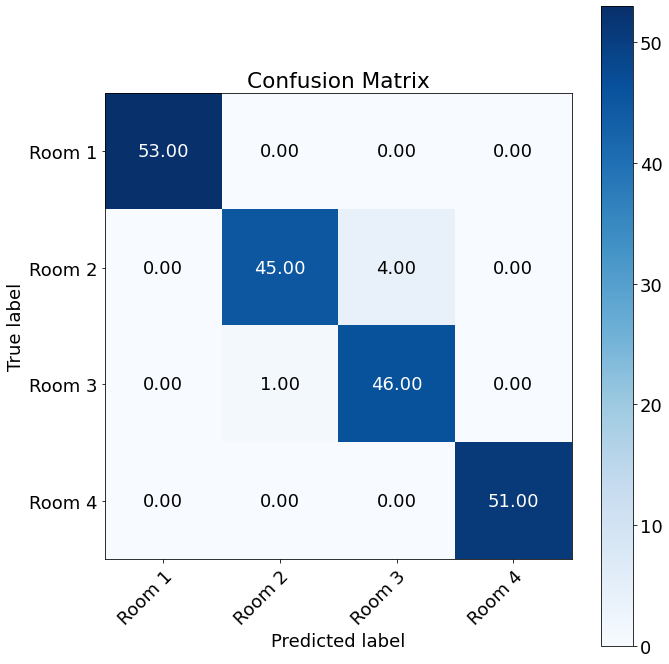

Accuracy pruned 1: 0.96
Macro recall pruned 1: 0.9599537928378898
Macro precision pruned 1: 0.9636363636363636


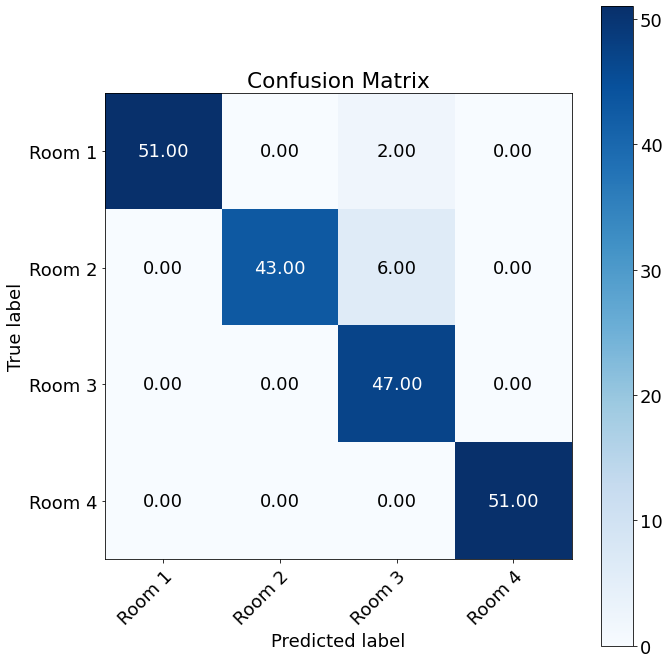

 
Accuracy pruned 2: 0.96
Macro recall pruned 2: 0.9599537928378898
Macro precision pruned 2: 0.9636363636363636


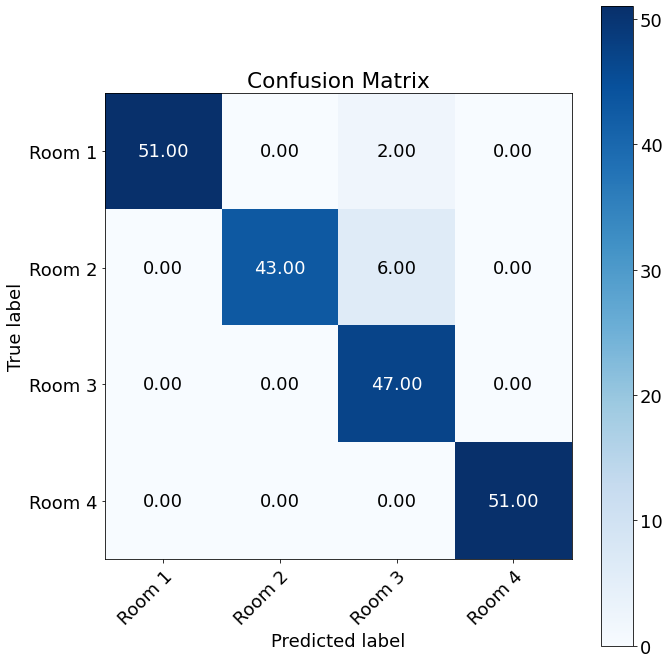

 
Outer Fold:7, Inner fold:9
Accuracy original: 0.97
Macro recall original: 0.9691706469821971
Macro precision original: 0.9699346405228758
 


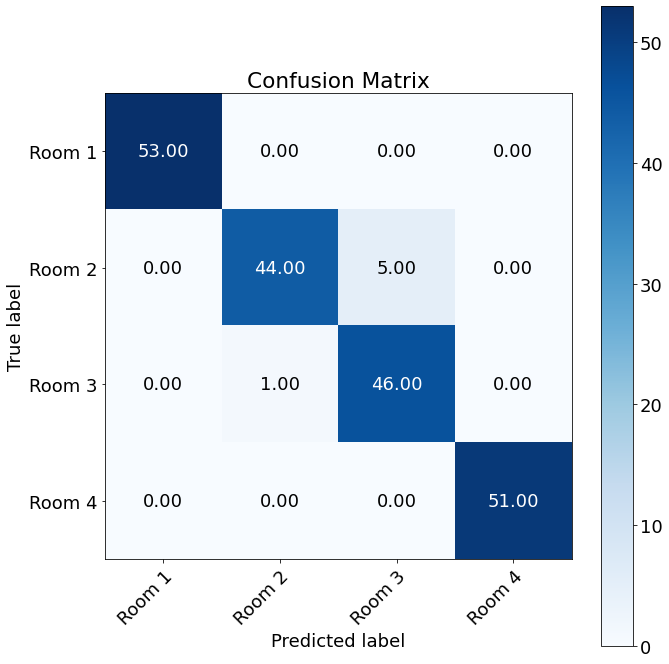

Accuracy pruned 1: 0.97
Macro recall pruned 1: 0.9693877551020408
Macro precision pruned 1: 0.9716981132075472


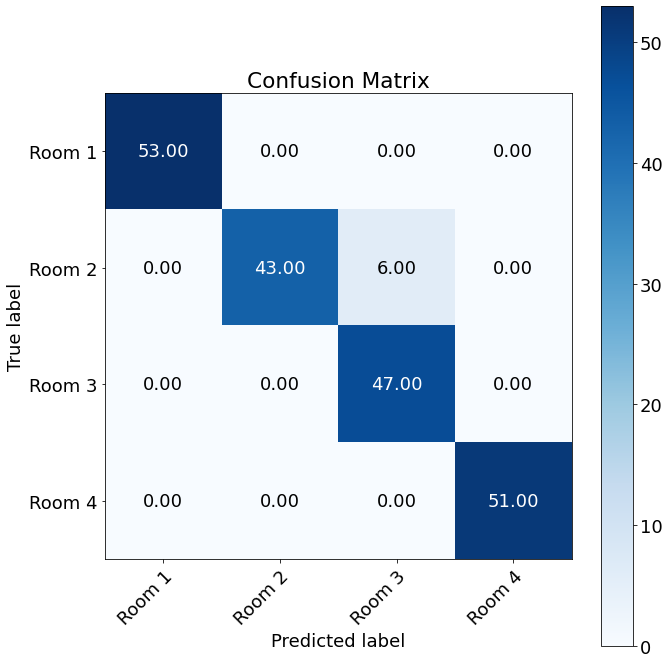

 
Accuracy pruned 2: 0.97
Macro recall pruned 2: 0.9693877551020408
Macro precision pruned 2: 0.9716981132075472


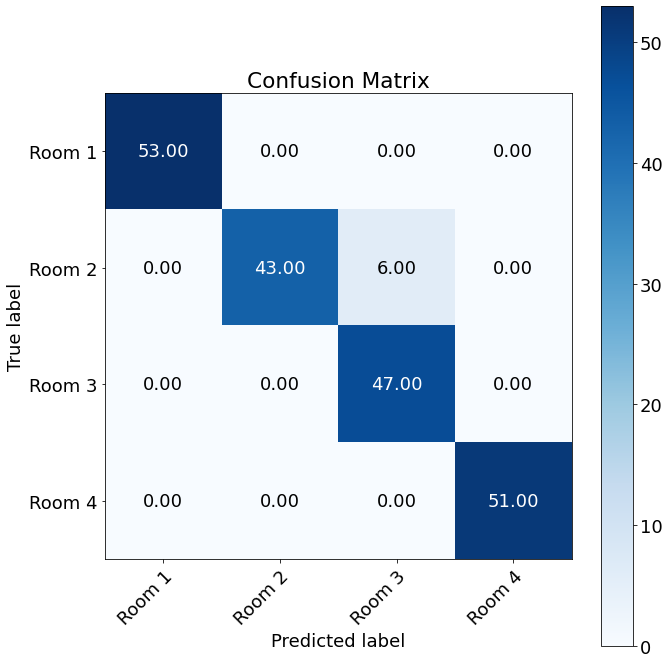

 
Outer Fold:7, Inner fold:10
Accuracy original: 0.96
Macro recall original: 0.9589174087941078
Macro precision original: 0.9588647959183674
 


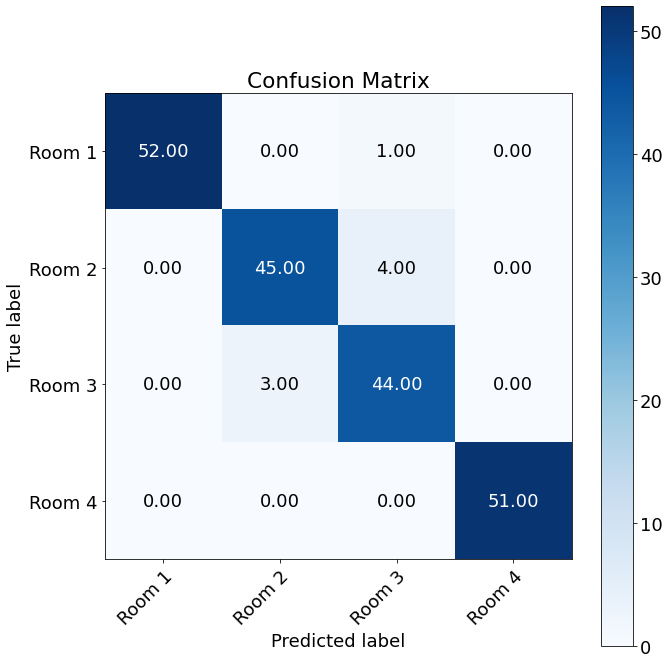

Accuracy pruned 1: 0.955
Macro recall pruned 1: 0.9544666923373123
Macro precision pruned 1: 0.9598214285714286


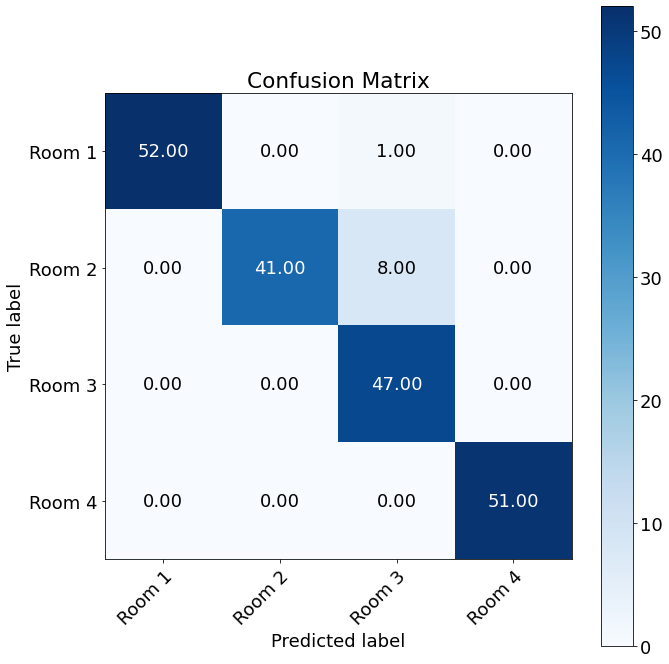

 
Accuracy pruned 2: 0.955
Macro recall pruned 2: 0.9544666923373123
Macro precision pruned 2: 0.9598214285714286


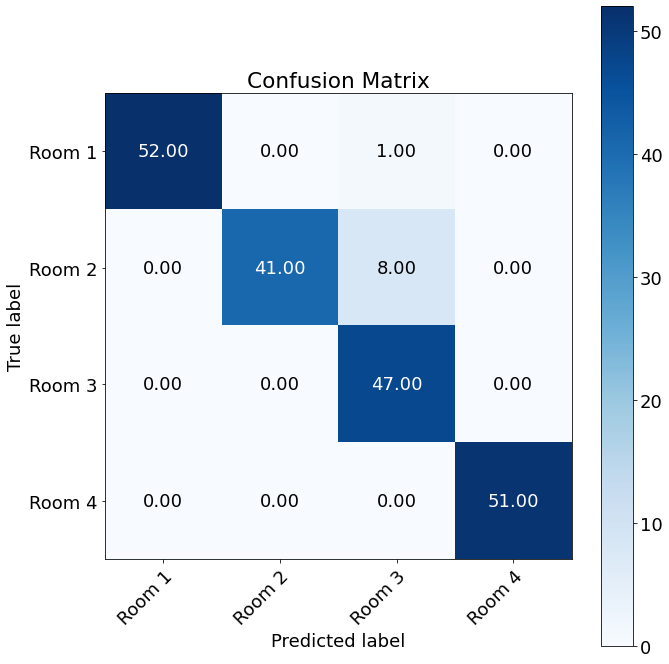

 
Outer Fold:8, Inner fold:1
Accuracy original: 0.975
Macro recall original: 0.9676767676767677
Macro precision original: 0.9751623376623377
 


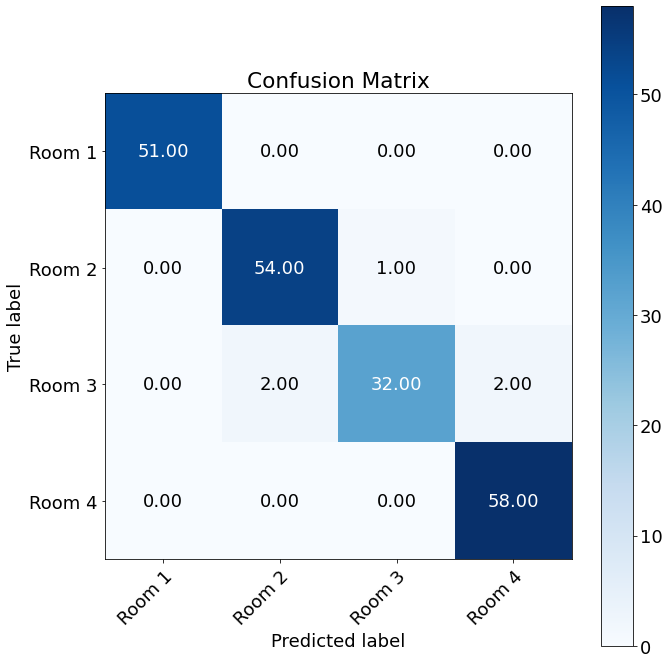

Accuracy pruned 1: 0.97
Macro recall pruned 1: 0.965530303030303
Macro precision pruned 1: 0.9661163522012579


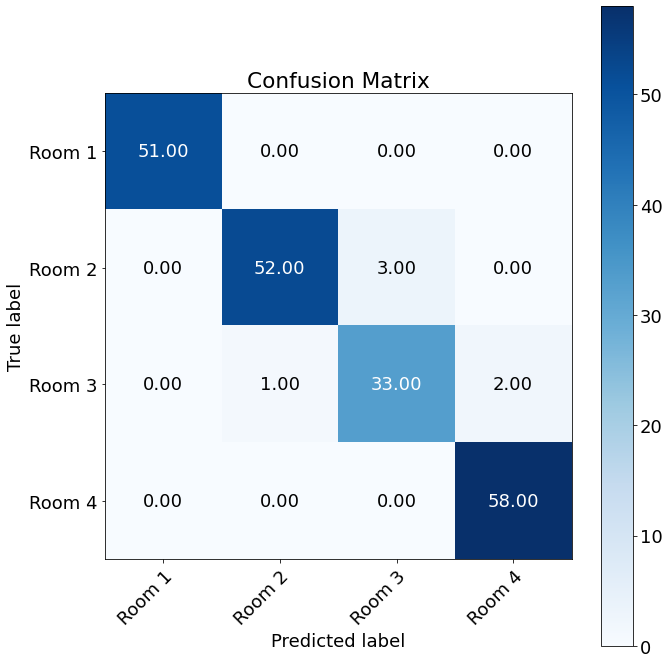

 
Accuracy pruned 2: 0.97
Macro recall pruned 2: 0.965530303030303
Macro precision pruned 2: 0.9661163522012579


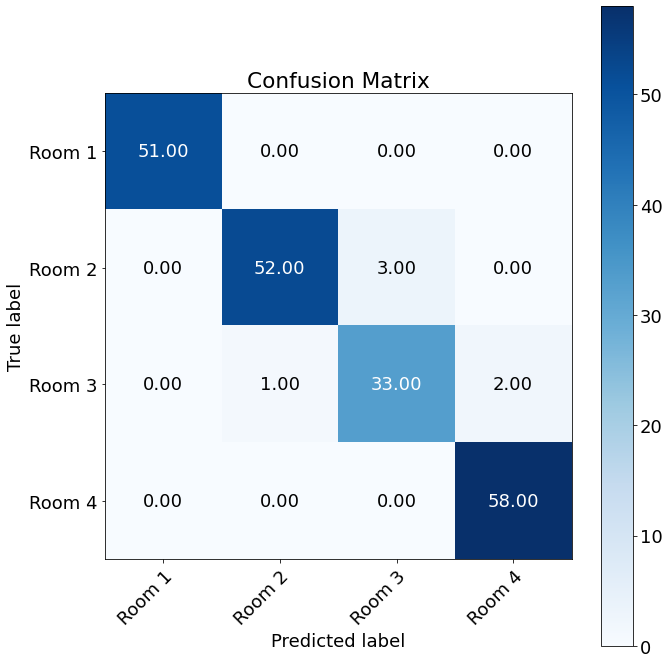

 
Outer Fold:8, Inner fold:2
Accuracy original: 0.975
Macro recall original: 0.9676767676767677
Macro precision original: 0.9751623376623377
 


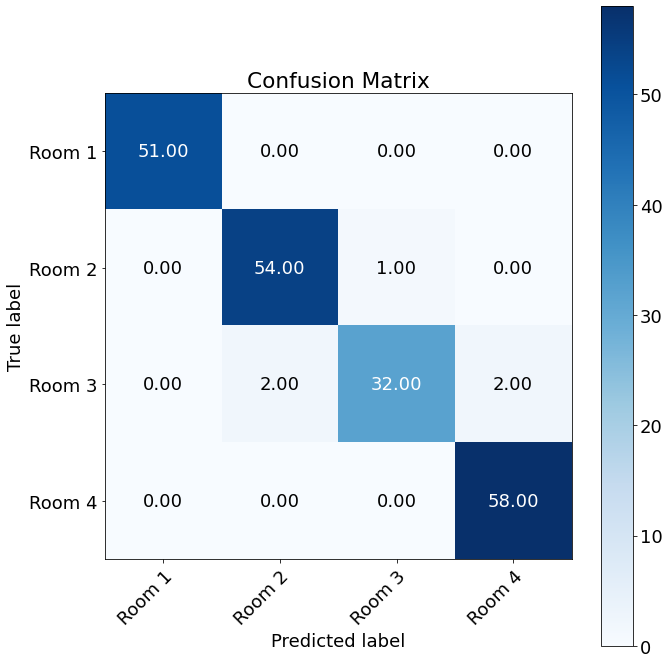

Accuracy pruned 1: 0.965
Macro recall pruned 1: 0.9585858585858585
Macro precision pruned 1: 0.9609788359788359


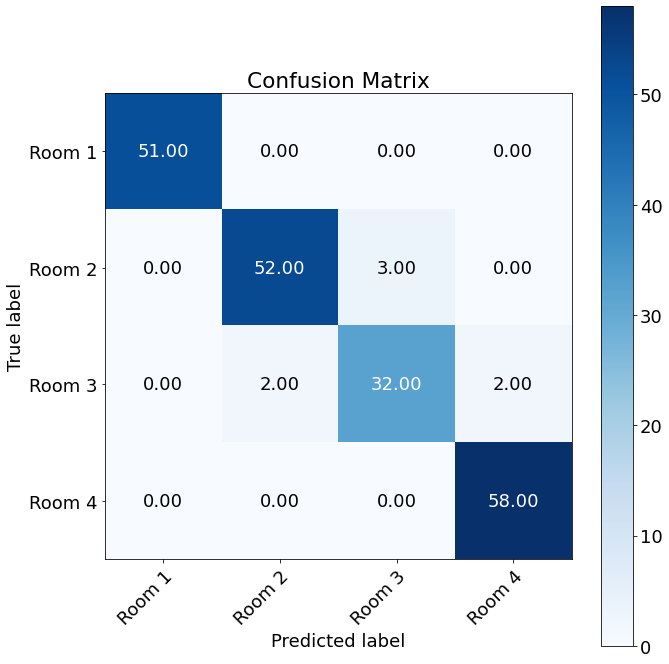

 
Accuracy pruned 2: 0.965
Macro recall pruned 2: 0.9585858585858585
Macro precision pruned 2: 0.9609788359788359


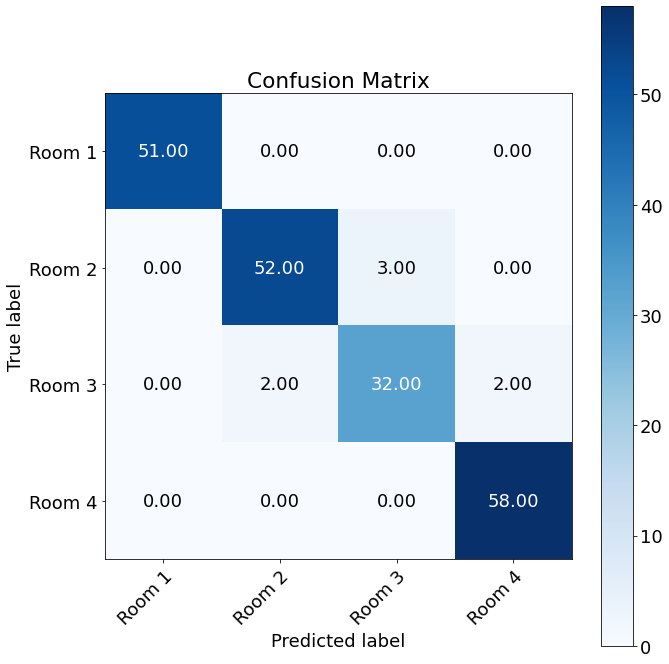

 
Outer Fold:8, Inner fold:3
Accuracy original: 0.975
Macro recall original: 0.9676767676767677
Macro precision original: 0.9751623376623377
 


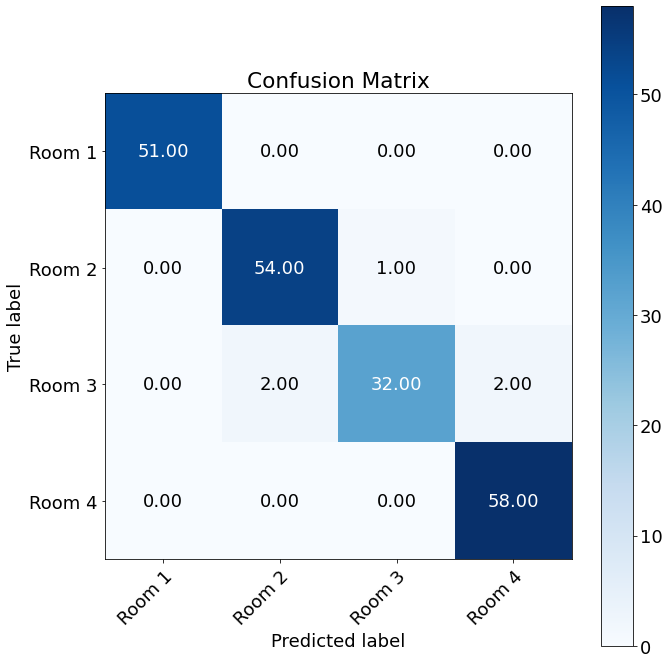

Accuracy pruned 1: 0.97
Macro recall pruned 1: 0.9607323232323233
Macro precision pruned 1: 0.9706962719298246


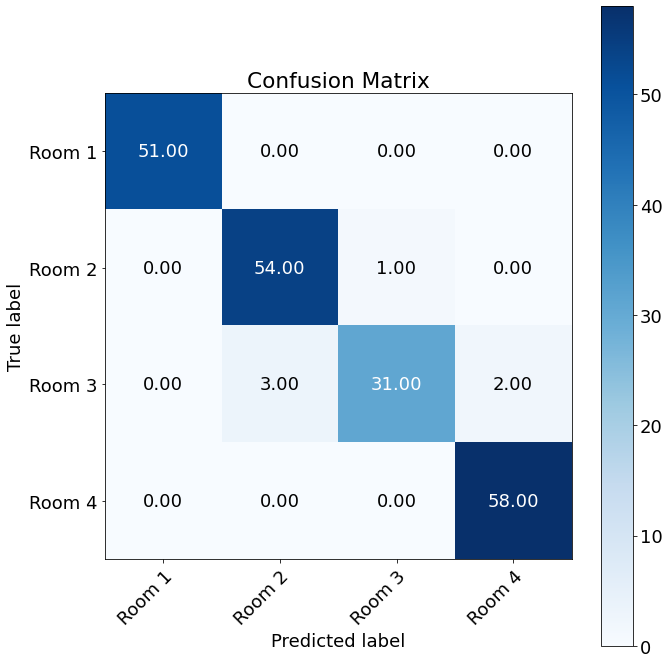

 
Accuracy pruned 2: 0.97
Macro recall pruned 2: 0.9607323232323233
Macro precision pruned 2: 0.9706962719298246


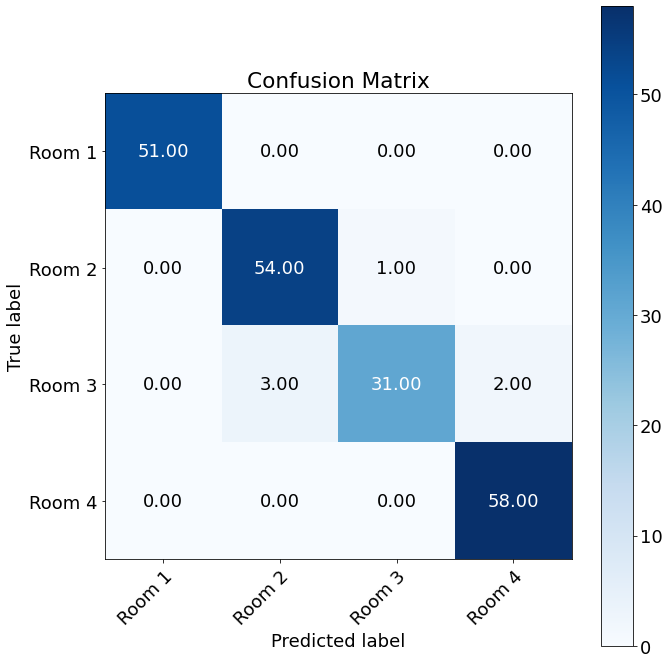

 
Outer Fold:8, Inner fold:4
Accuracy original: 0.97
Macro recall original: 0.9631313131313131
Macro precision original: 0.9678698752228164
 


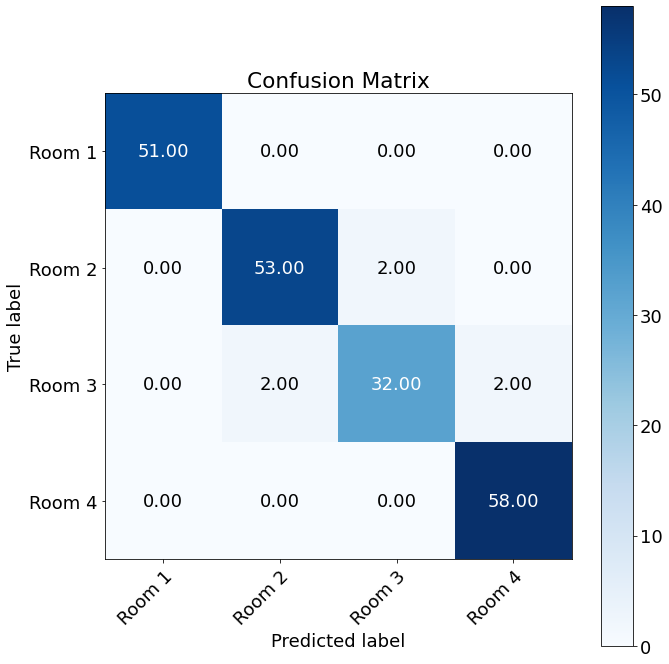

Accuracy pruned 1: 0.965
Macro recall pruned 1: 0.9585858585858585
Macro precision pruned 1: 0.9609788359788359


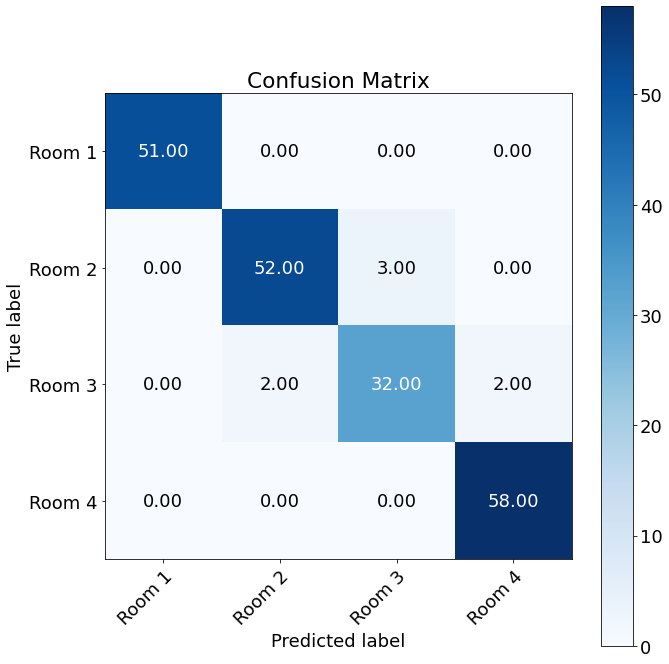

 
Accuracy pruned 2: 0.965
Macro recall pruned 2: 0.9585858585858585
Macro precision pruned 2: 0.9609788359788359


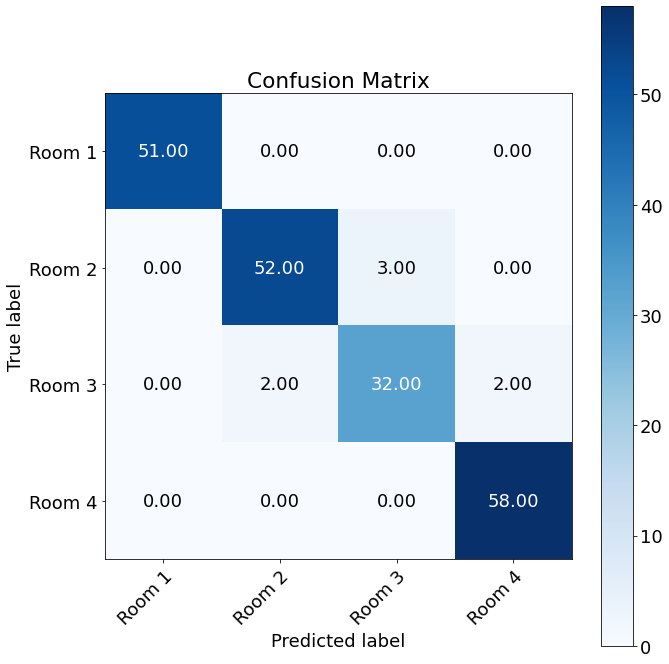

 
Outer Fold:8, Inner fold:5
Accuracy original: 0.965
Macro recall original: 0.9537878787878789
Macro precision original: 0.9663607712272896
 


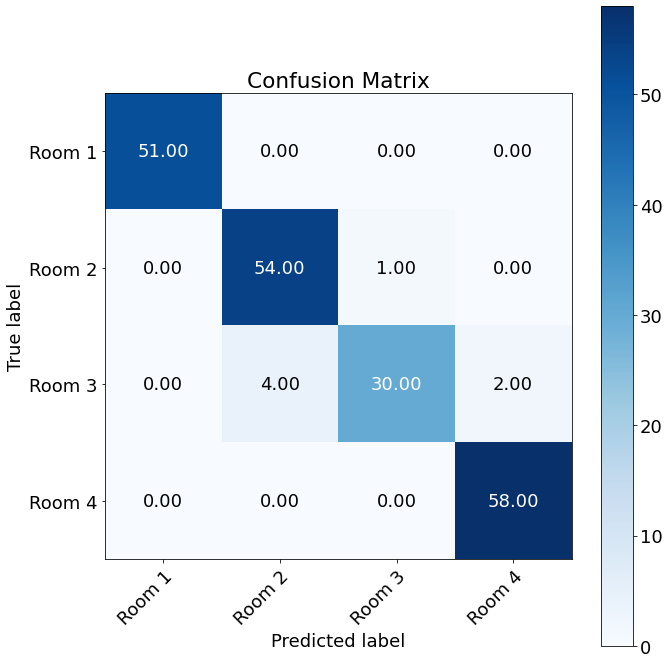

Accuracy pruned 1: 0.975
Macro recall pruned 1: 0.9724747474747475
Macro precision pruned 1: 0.9713963963963964


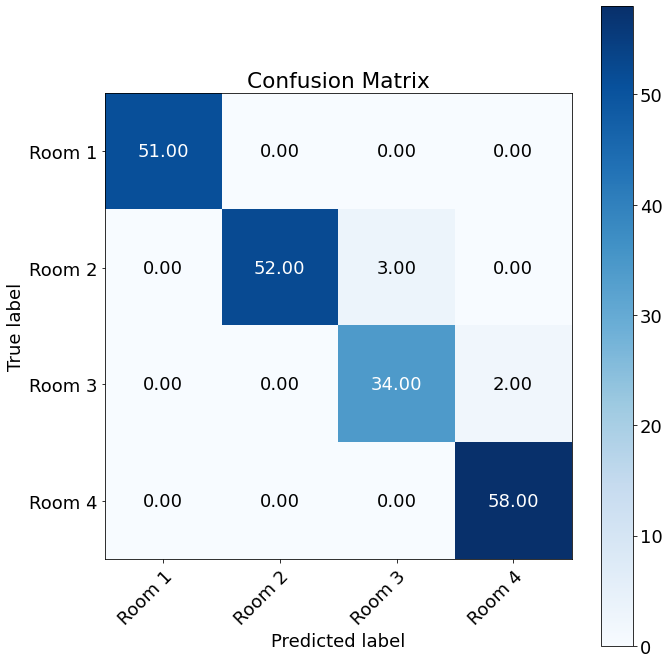

 
Accuracy pruned 2: 0.975
Macro recall pruned 2: 0.9724747474747475
Macro precision pruned 2: 0.9713963963963964


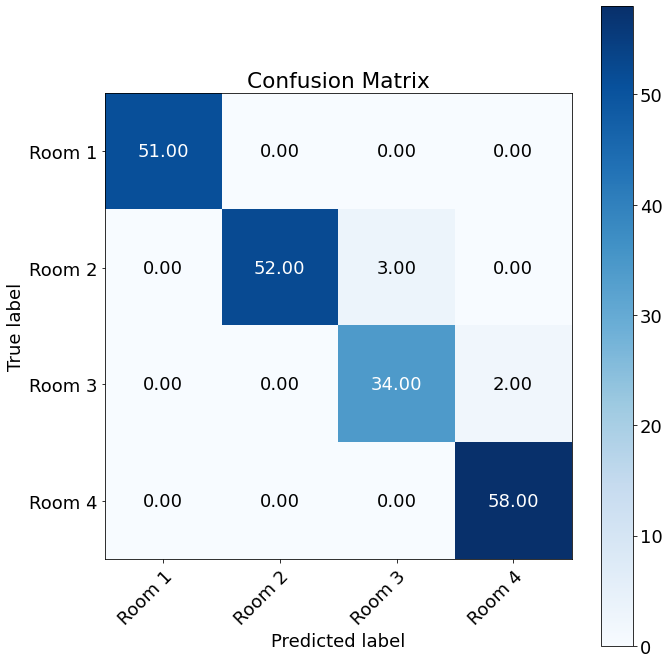

 
Outer Fold:8, Inner fold:6
Accuracy original: 0.97
Macro recall original: 0.9583333333333334
Macro precision original: 0.9747175141242939
 


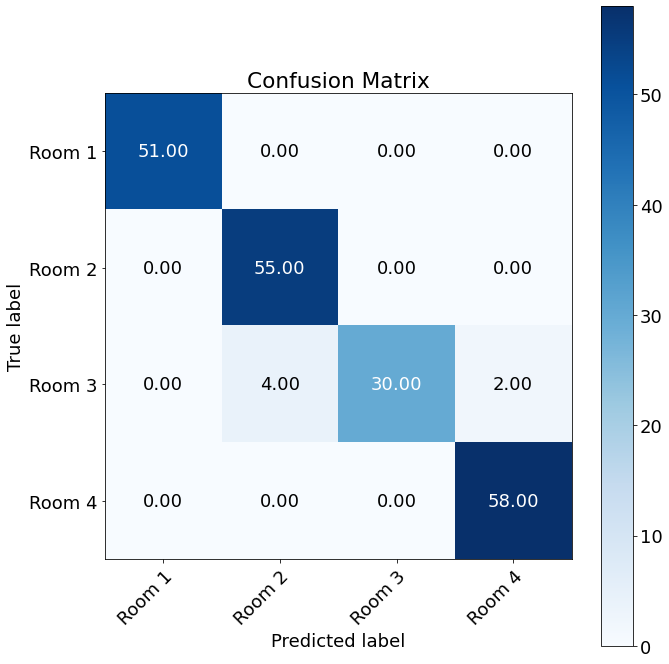

Accuracy pruned 1: 0.98
Macro recall pruned 1: 0.9746212121212121
Macro precision pruned 1: 0.9797682709447416


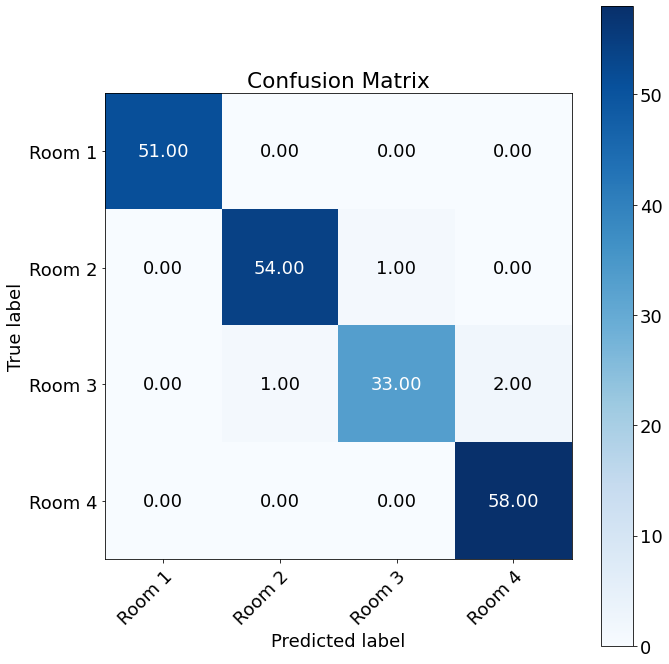

 
Accuracy pruned 2: 0.98
Macro recall pruned 2: 0.9746212121212121
Macro precision pruned 2: 0.9797682709447416


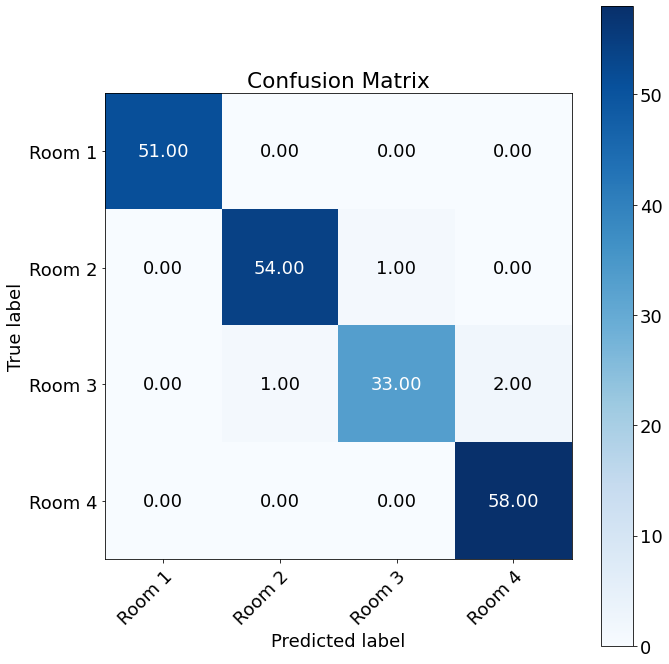

 
Outer Fold:8, Inner fold:7
Accuracy original: 0.975
Macro recall original: 0.9676767676767677
Macro precision original: 0.9755837059115748
 


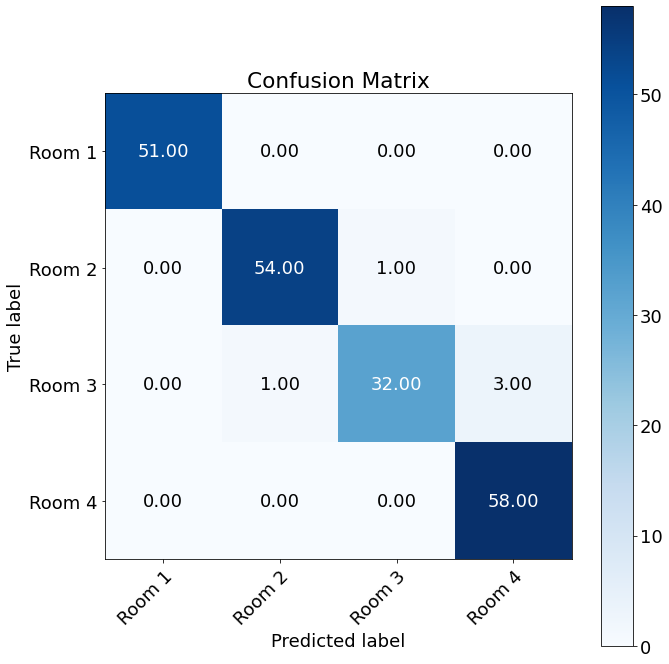

Accuracy pruned 1: 0.97
Macro recall pruned 1: 0.9631313131313131
Macro precision pruned 1: 0.9683694060502159


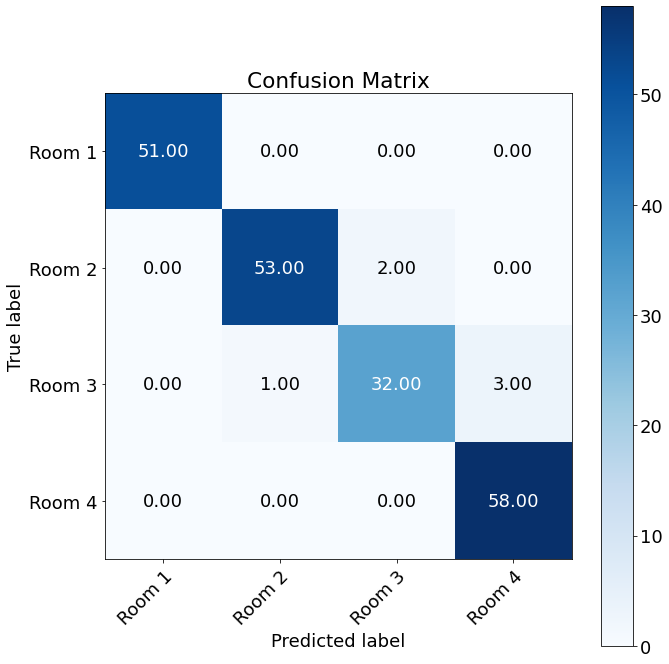

 
Accuracy pruned 2: 0.97
Macro recall pruned 2: 0.9631313131313131
Macro precision pruned 2: 0.9683694060502159


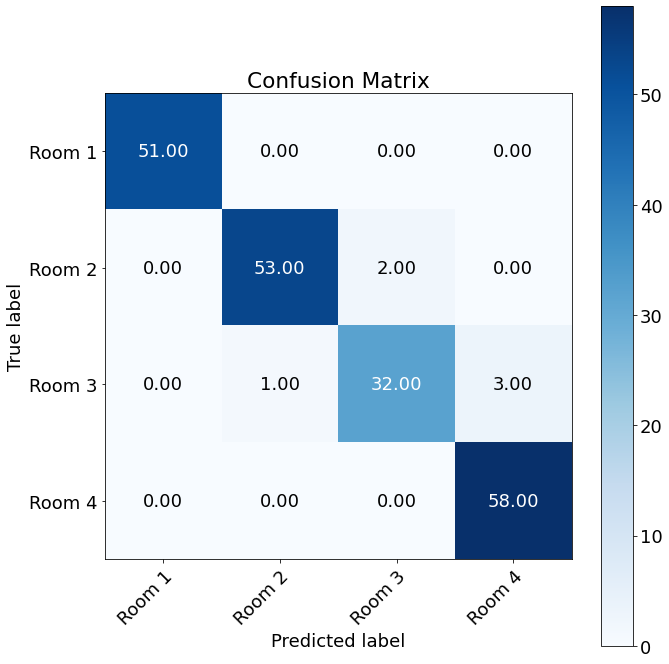

 
Outer Fold:8, Inner fold:8
Accuracy original: 0.965
Macro recall original: 0.9537878787878789
Macro precision original: 0.9663607712272896
 


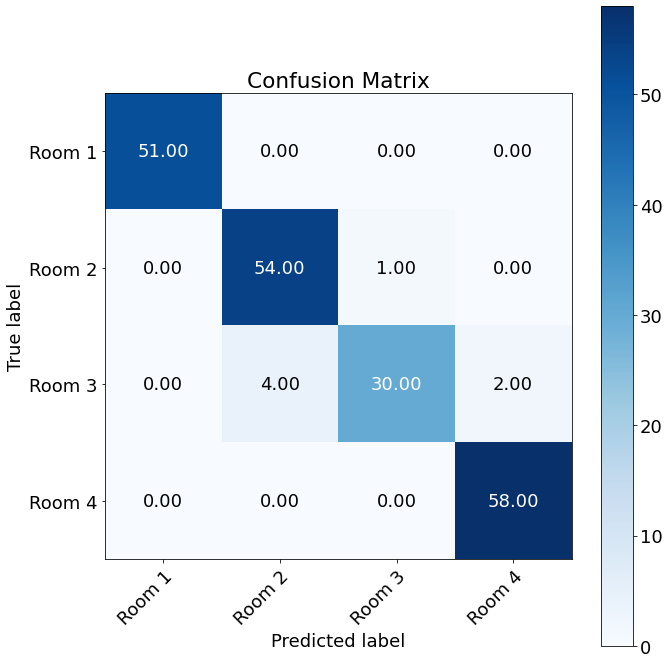

Accuracy pruned 1: 0.96
Macro recall pruned 1: 0.9492424242424242
Macro precision pruned 1: 0.9584978070175438


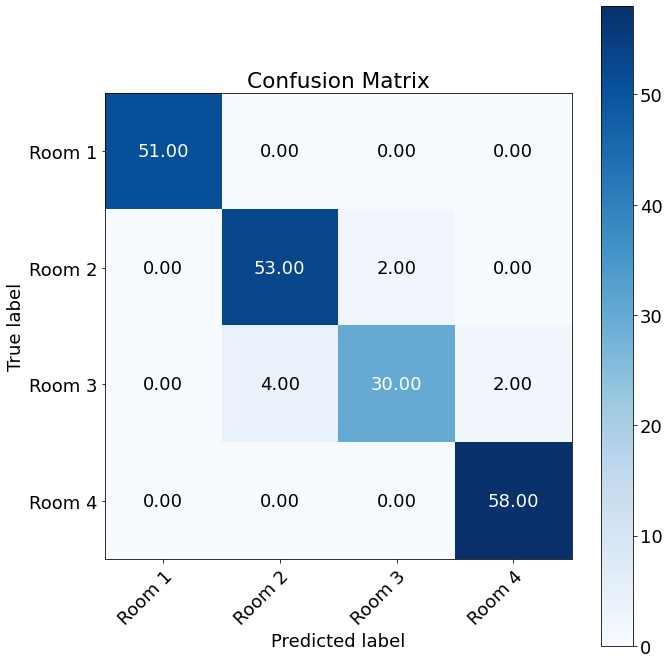

 
Accuracy pruned 2: 0.96
Macro recall pruned 2: 0.9492424242424242
Macro precision pruned 2: 0.9584978070175438


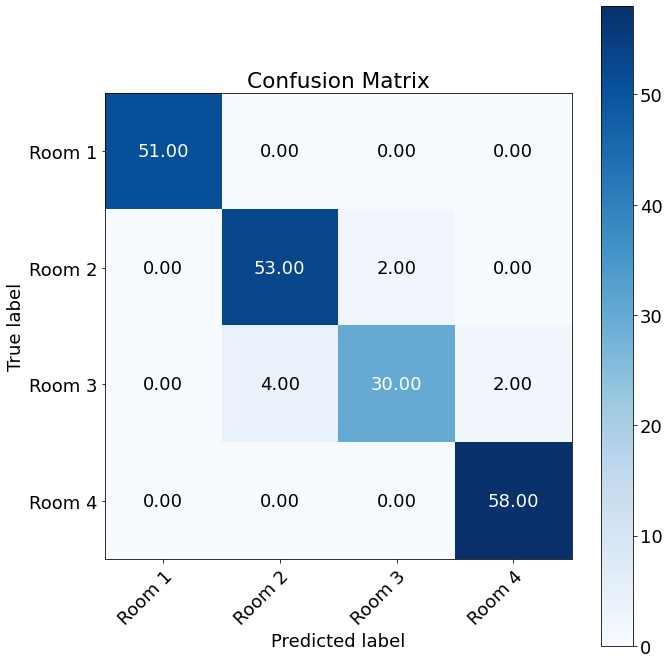

 
Outer Fold:8, Inner fold:9
Accuracy original: 0.965
Macro recall original: 0.9561868686868686
Macro precision original: 0.9631222943722944
 


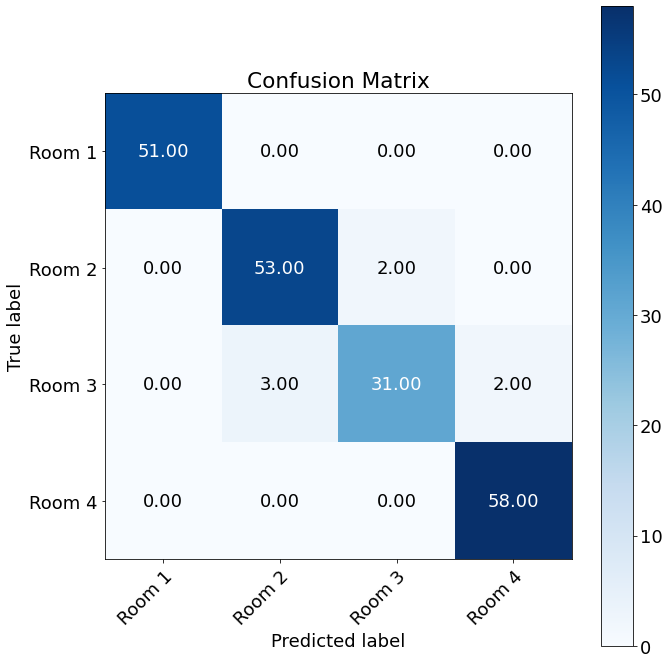

Accuracy pruned 1: 0.98
Macro recall pruned 1: 0.9746212121212121
Macro precision pruned 1: 0.9797682709447416


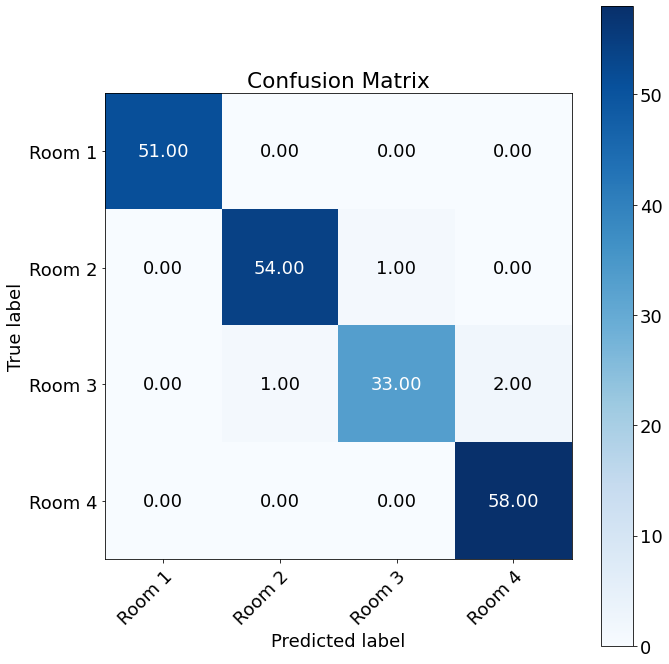

 
Accuracy pruned 2: 0.98
Macro recall pruned 2: 0.9746212121212121
Macro precision pruned 2: 0.9797682709447416


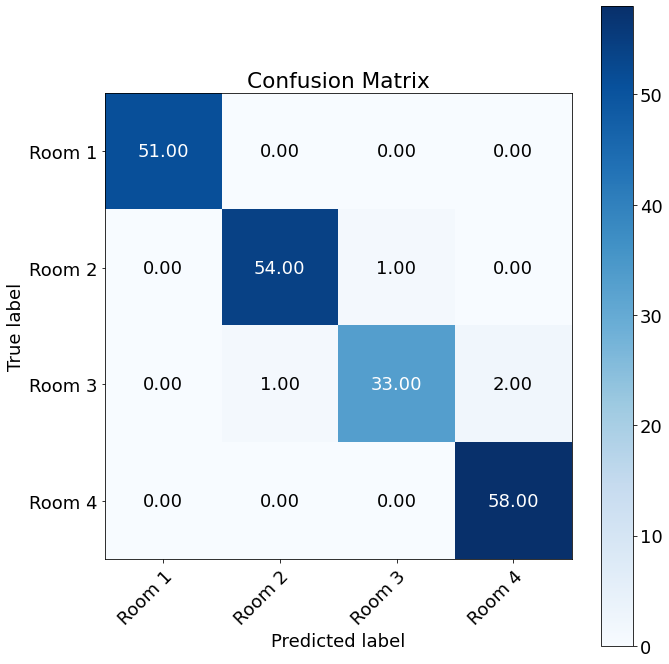

 
Outer Fold:8, Inner fold:10
Accuracy original: 0.98
Macro recall original: 0.9746212121212121
Macro precision original: 0.9797682709447416
 


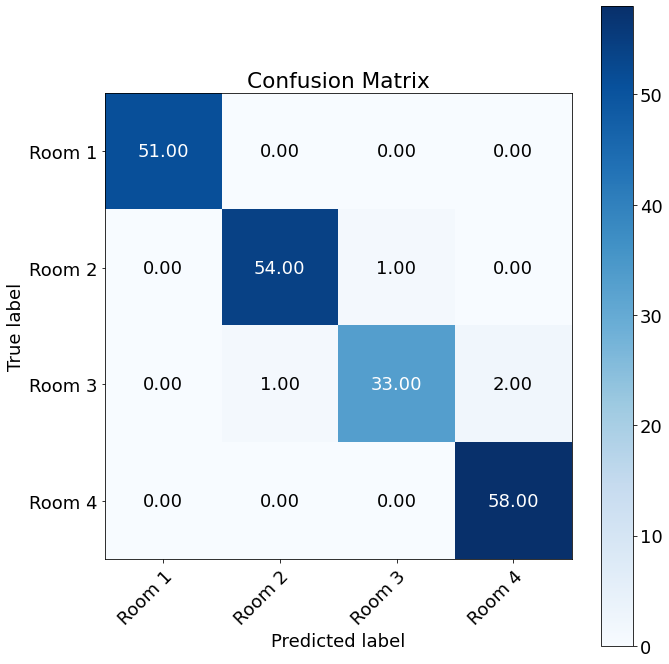

Accuracy pruned 1: 0.98
Macro recall pruned 1: 0.9722222222222222
Macro precision pruned 1: 0.9828947368421053


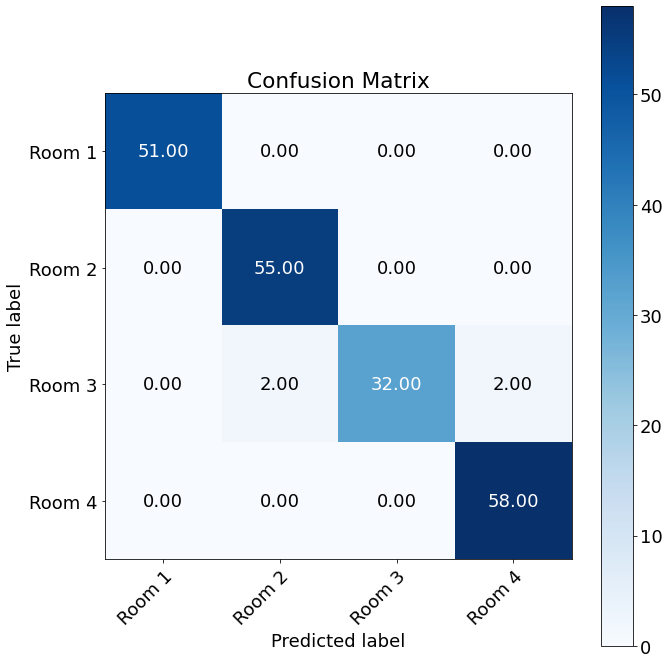

 
Accuracy pruned 2: 0.98
Macro recall pruned 2: 0.9722222222222222
Macro precision pruned 2: 0.9828947368421053


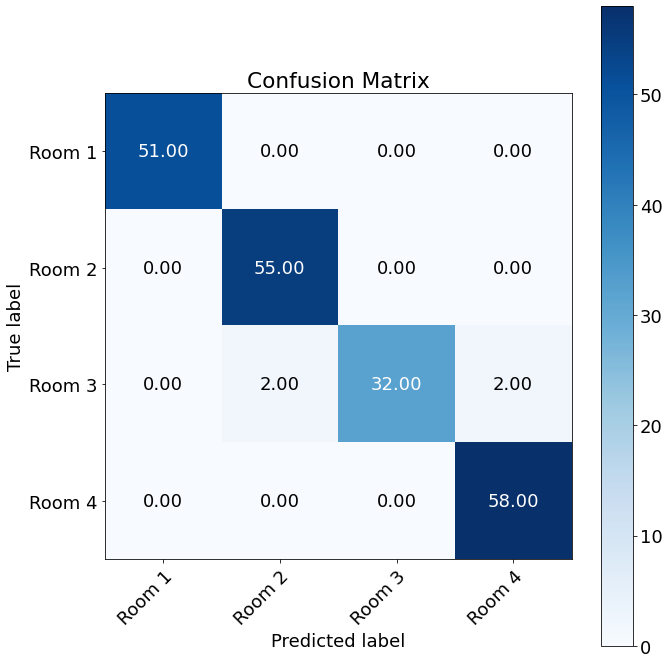

 
Outer Fold:9, Inner fold:1
Accuracy original: 0.96
Macro recall original: 0.9579599281573095
Macro precision original: 0.9610626692148432
 


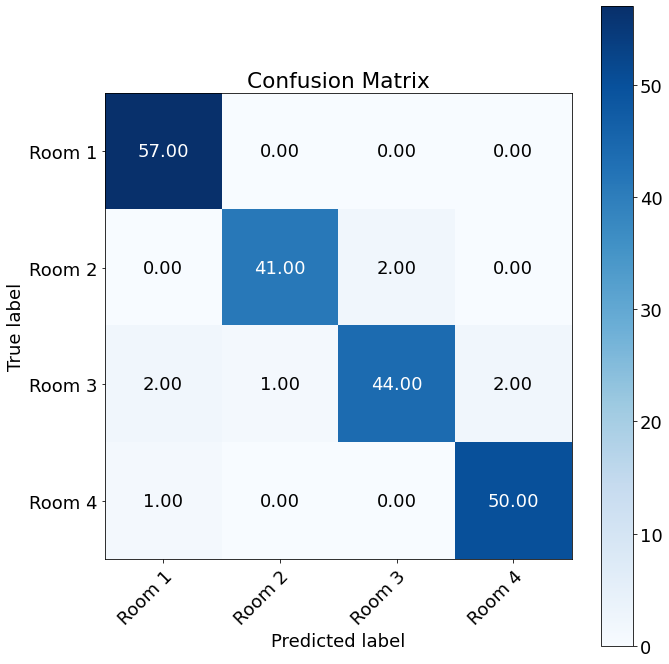

Accuracy pruned 1: 0.98
Macro recall pruned 1: 0.9783680914226156
Macro precision pruned 1: 0.9797372742200328


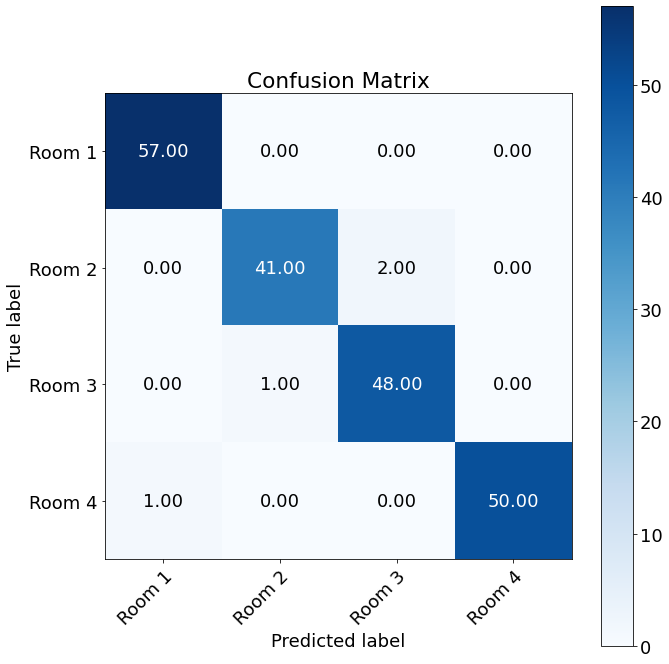

 
Accuracy pruned 2: 0.98
Macro recall pruned 2: 0.9783680914226156
Macro precision pruned 2: 0.9797372742200328


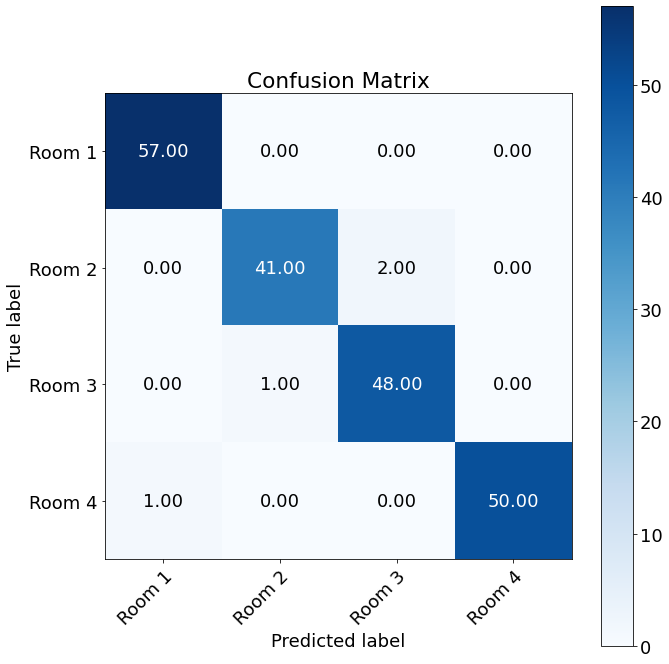

 
Outer Fold:9, Inner fold:2
Accuracy original: 0.99
Macro recall original: 0.9892840857273142
Macro precision original: 0.9906896551724138
 


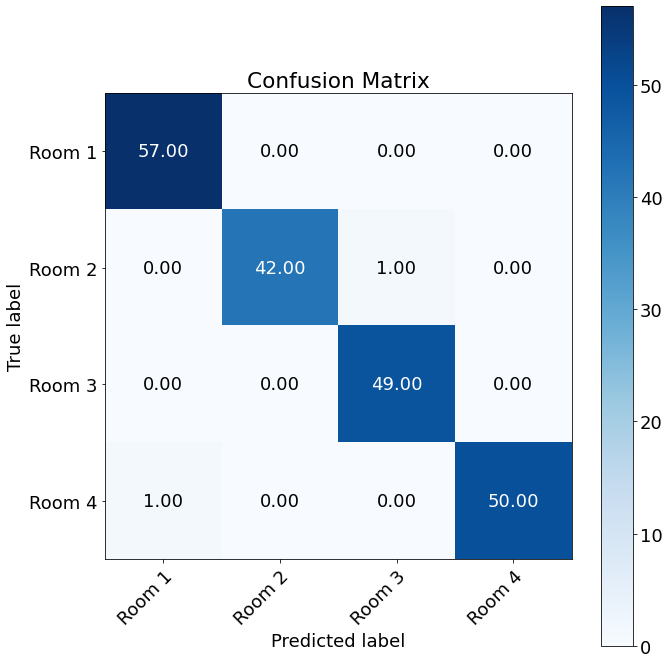

Accuracy pruned 1: 0.98
Macro recall pruned 1: 0.9790800040946611
Macro precision pruned 1: 0.9805031369071081


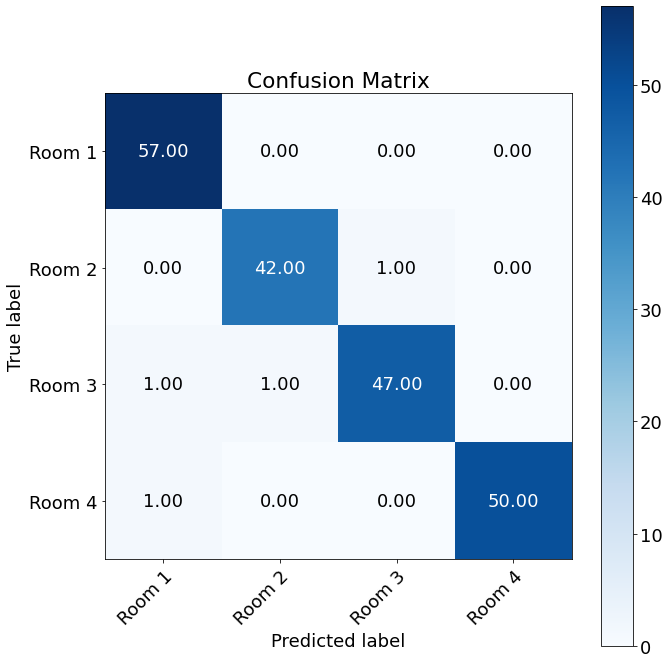

 
Accuracy pruned 2: 0.98
Macro recall pruned 2: 0.9790800040946611
Macro precision pruned 2: 0.9805031369071081


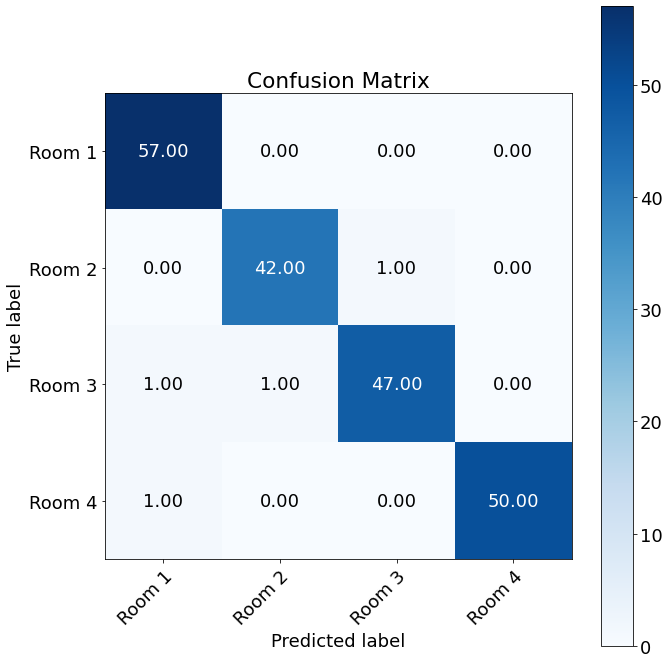

 
Outer Fold:9, Inner fold:3
Accuracy original: 0.975
Macro recall original: 0.9739779632783346
Macro precision original: 0.9754903605199575
 


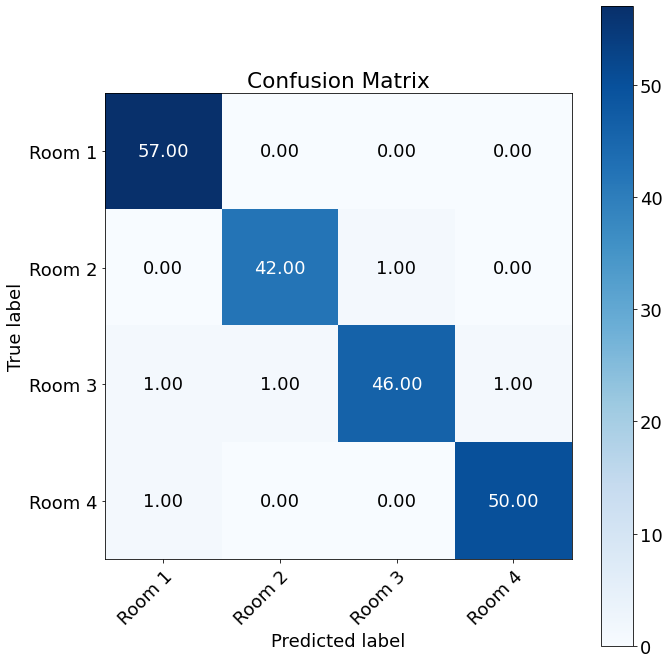

Accuracy pruned 1: 0.955
Macro recall pruned 1: 0.9507221493248462
Macro precision pruned 1: 0.9557034026126748


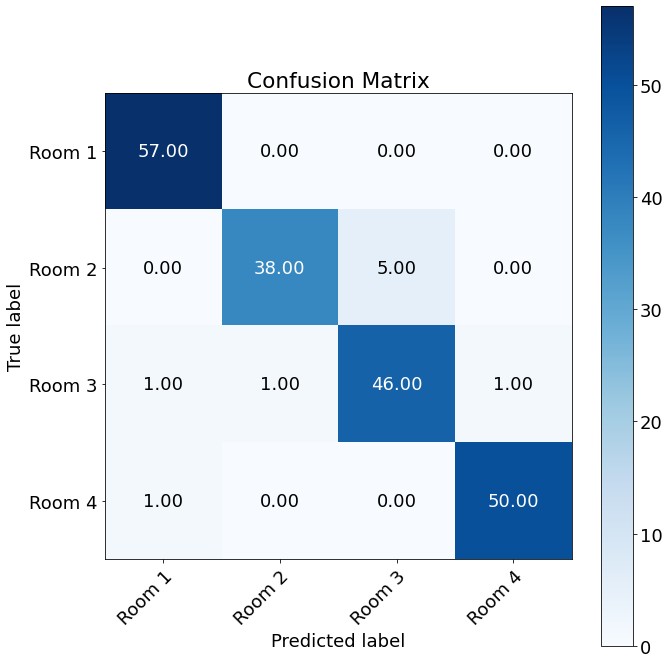

 
Accuracy pruned 2: 0.955
Macro recall pruned 2: 0.9507221493248462
Macro precision pruned 2: 0.9557034026126748


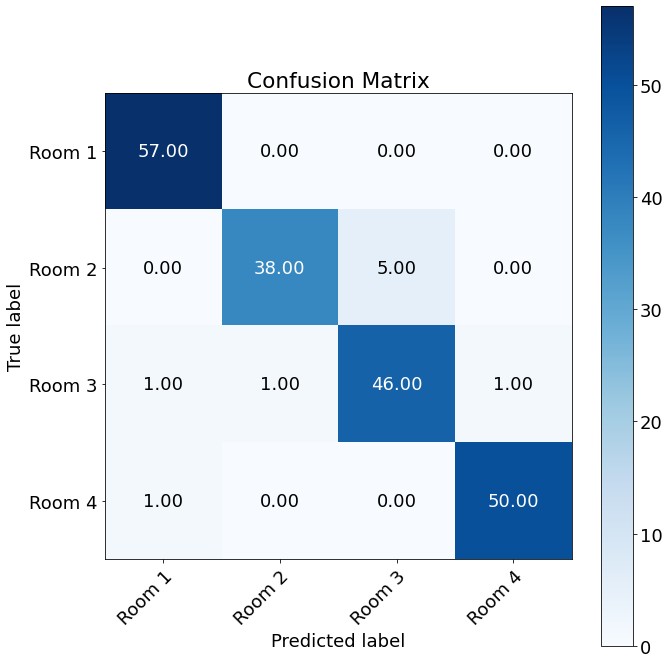

 
Outer Fold:9, Inner fold:4
Accuracy original: 0.975
Macro recall original: 0.9737778832463218
Macro precision original: 0.9754689953240535
 


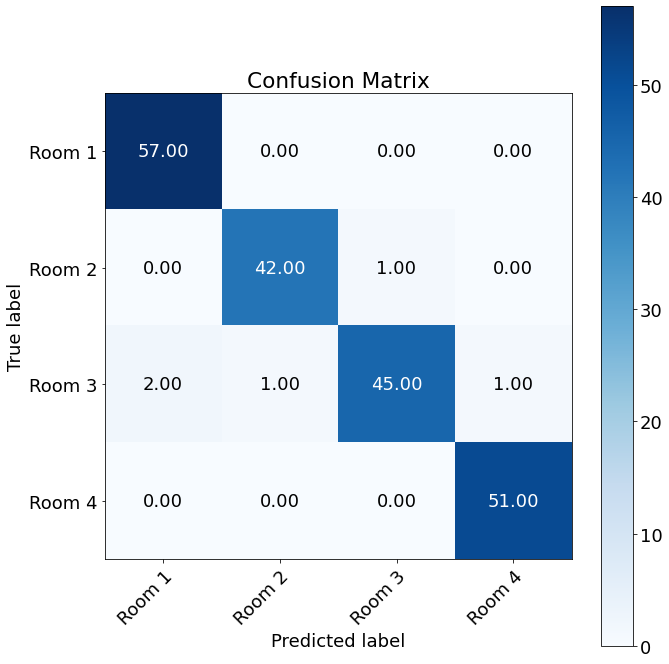

Accuracy pruned 1: 0.975
Macro recall pruned 1: 0.9739779632783346
Macro precision pruned 1: 0.9782874084408789


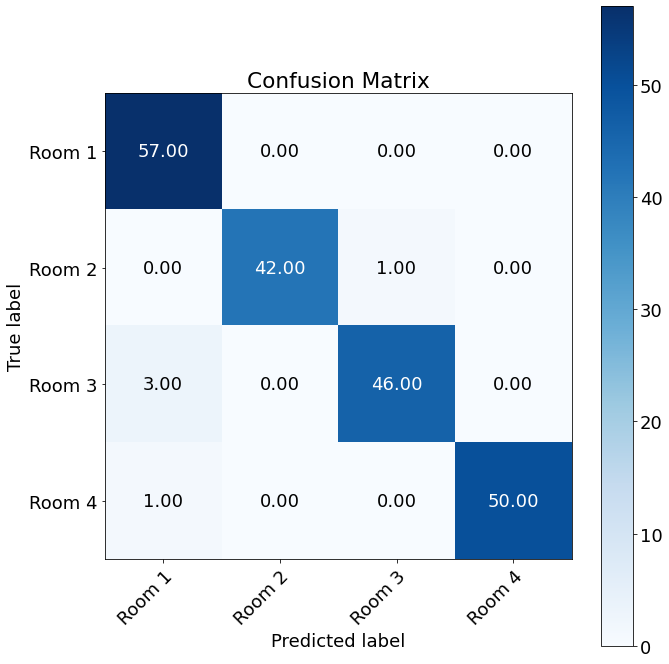

 
Accuracy pruned 2: 0.975
Macro recall pruned 2: 0.9739779632783346
Macro precision pruned 2: 0.9782874084408789


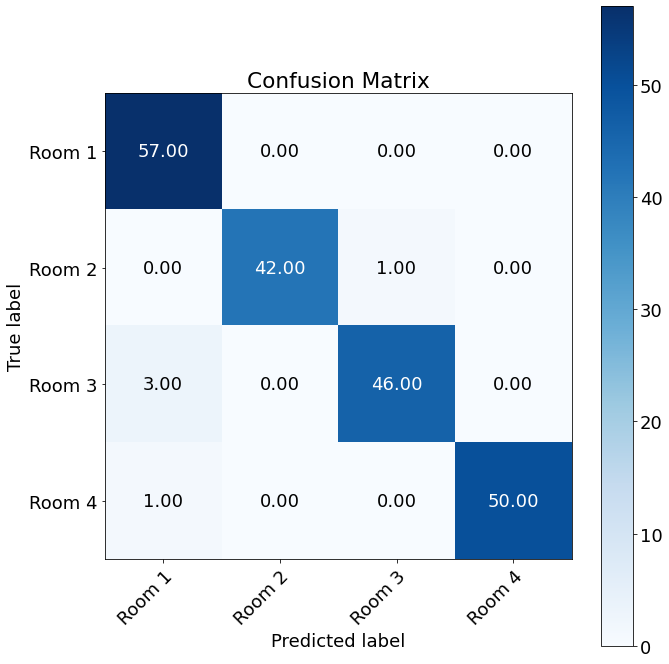

 
Outer Fold:9, Inner fold:5
Accuracy original: 0.975
Macro recall original: 0.975405951854426
Macro precision original: 0.9767043566270884
 


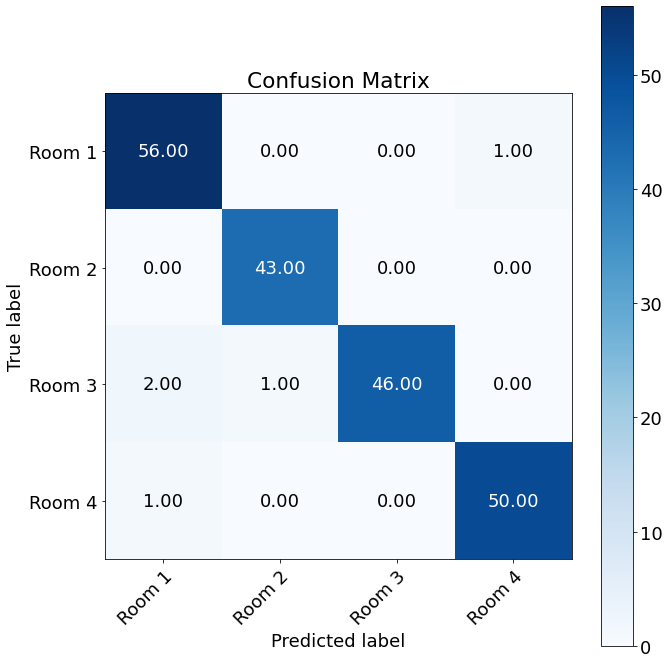

Accuracy pruned 1: 0.975
Macro recall pruned 1: 0.9739779632783346
Macro precision pruned 1: 0.9782874084408789


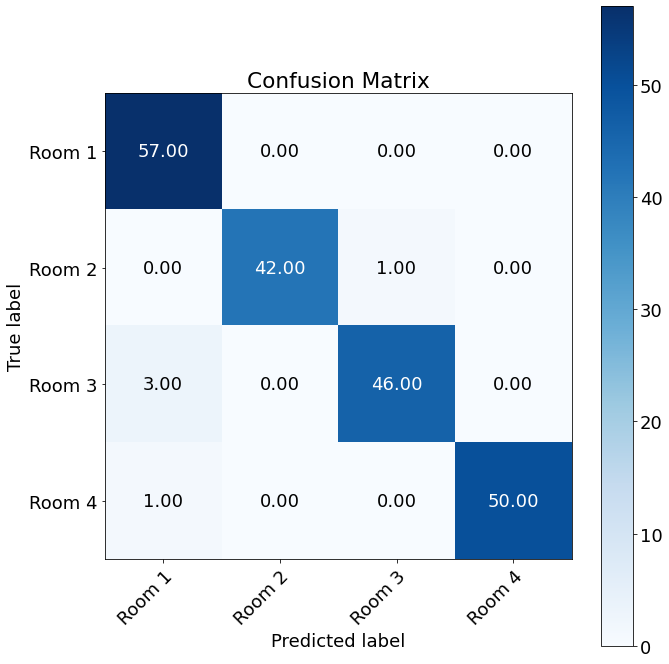

 
Accuracy pruned 2: 0.975
Macro recall pruned 2: 0.9739779632783346
Macro precision pruned 2: 0.9782874084408789


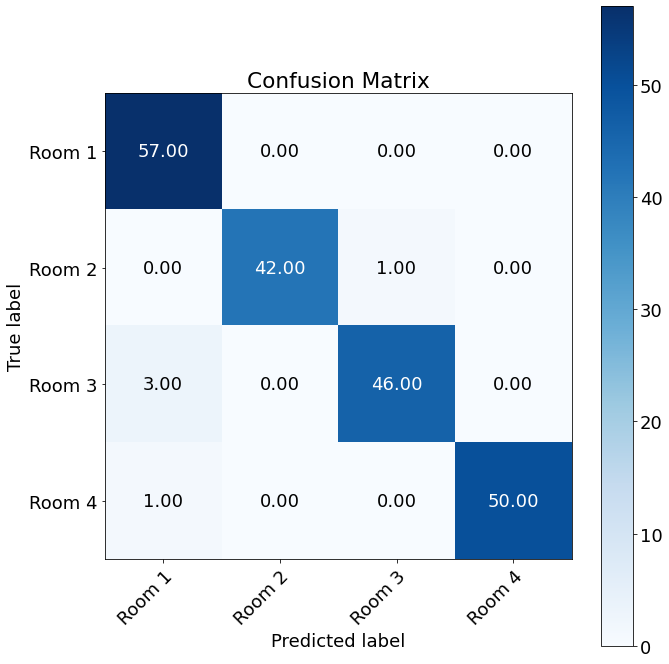

 
Outer Fold:9, Inner fold:6
Accuracy original: 0.985
Macro recall original: 0.9848939575830332
Macro precision original: 0.9851058762062819
 


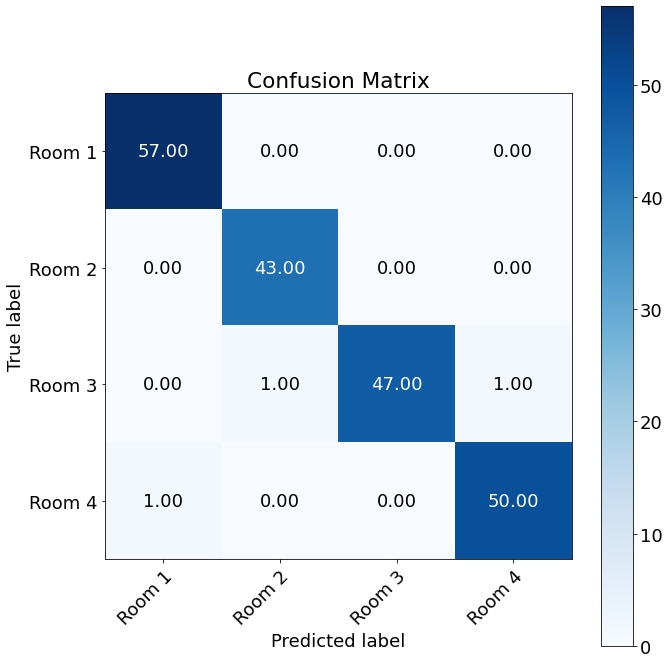

Accuracy pruned 1: 0.99
Macro recall pruned 1: 0.9899959983993598
Macro precision pruned 1: 0.9915254237288136


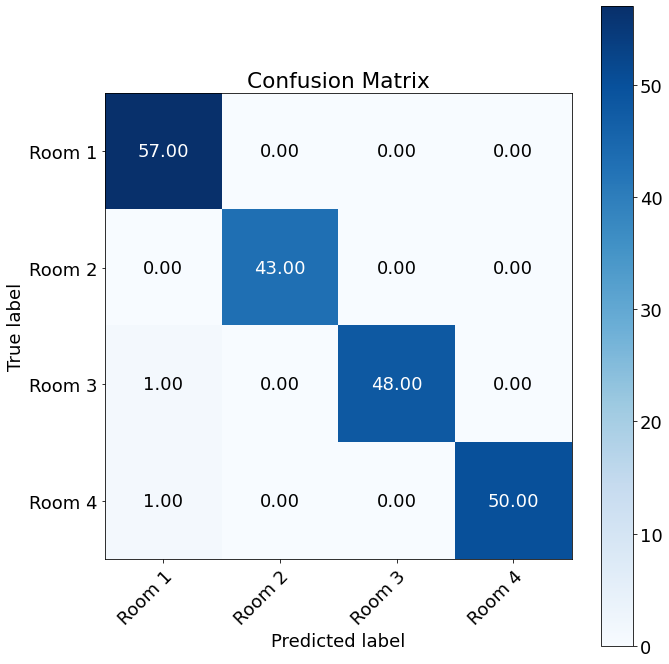

 
Accuracy pruned 2: 0.99
Macro recall pruned 2: 0.9899959983993598
Macro precision pruned 2: 0.9915254237288136


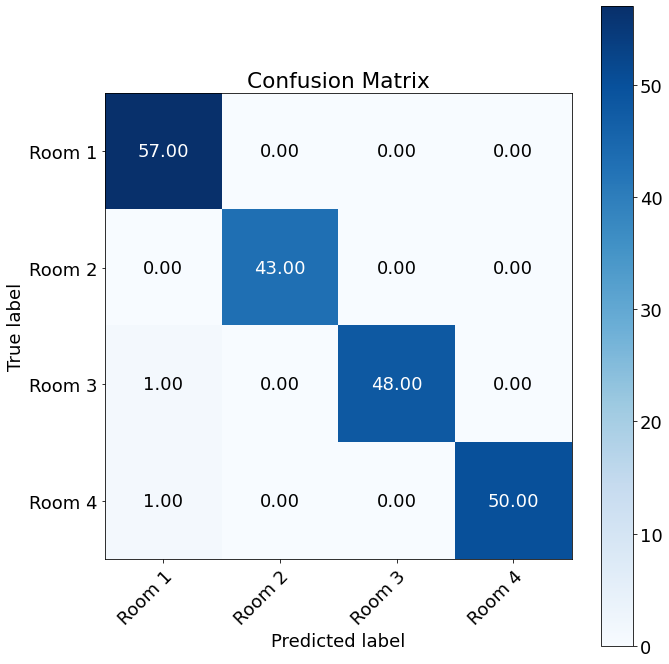

 
Outer Fold:9, Inner fold:7
Accuracy original: 0.98
Macro recall original: 0.9788799240626483
Macro precision original: 0.9780141843971631
 


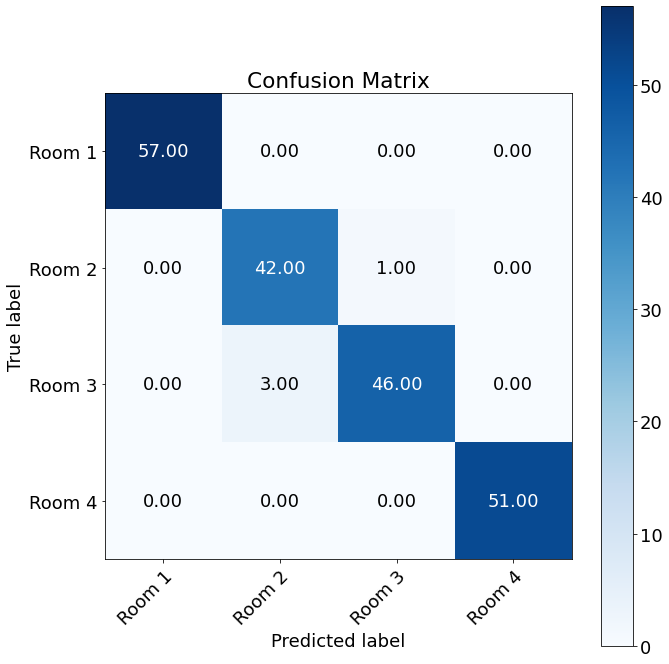

Accuracy pruned 1: 0.96
Macro recall pruned 1: 0.9579599281573095
Macro precision pruned 1: 0.9611090851829137


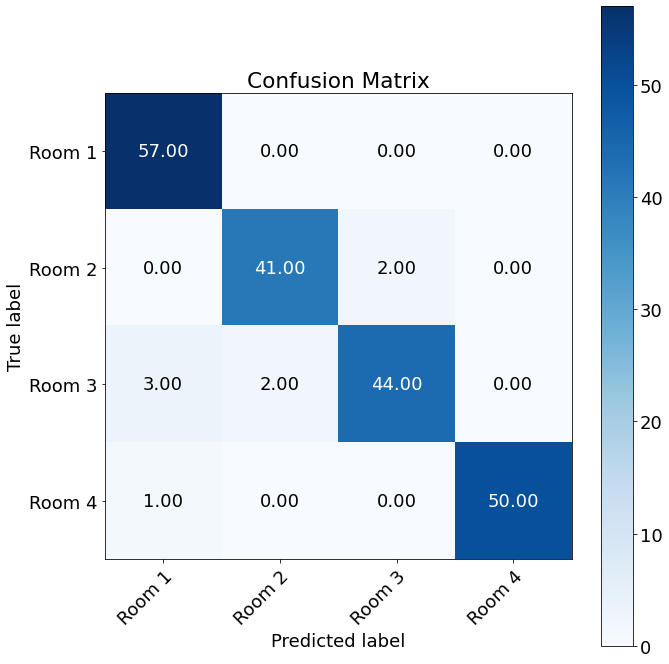

 
Accuracy pruned 2: 0.96
Macro recall pruned 2: 0.9579599281573095
Macro precision pruned 2: 0.9611090851829137


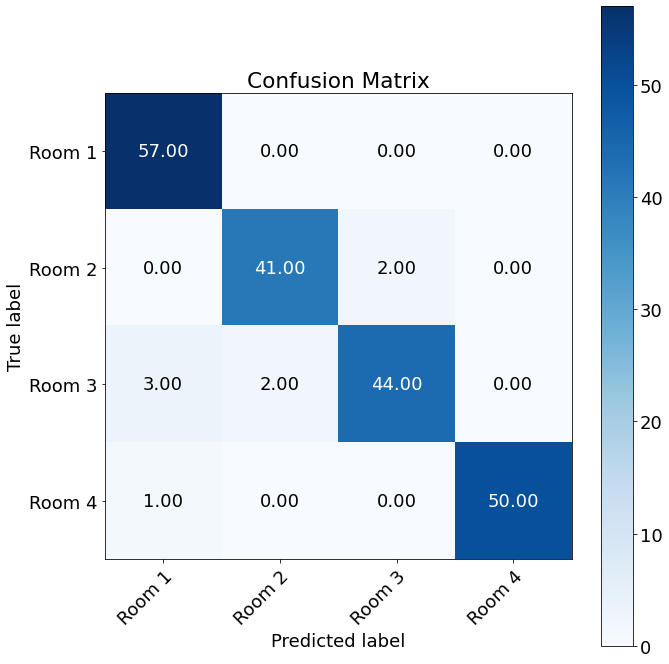

 
Outer Fold:9, Inner fold:8
Accuracy original: 0.99
Macro recall original: 0.9899959983993598
Macro precision original: 0.9900078369905956
 


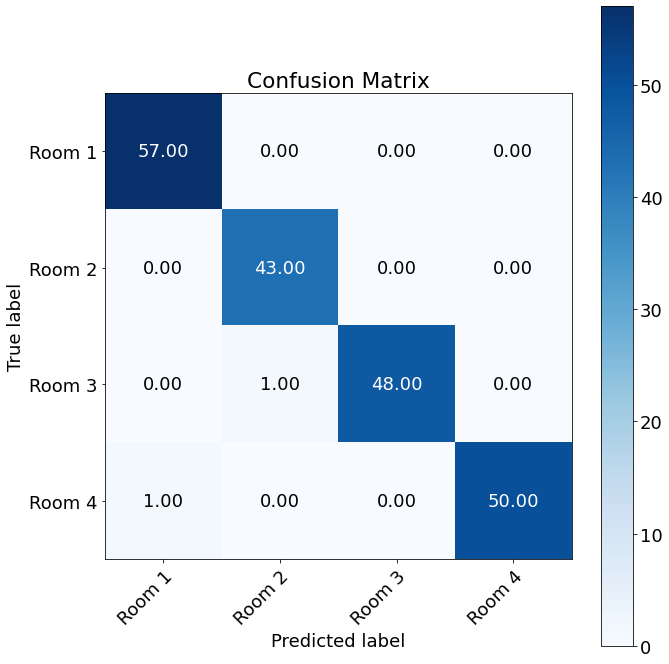

Accuracy pruned 1: 0.98
Macro recall pruned 1: 0.9790800040946611
Macro precision pruned 1: 0.9805031369071081


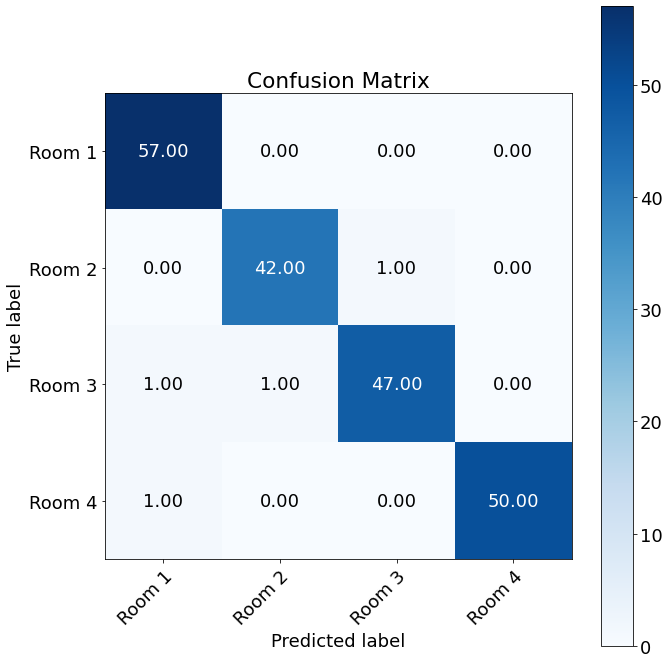

 
Accuracy pruned 2: 0.98
Macro recall pruned 2: 0.9790800040946611
Macro precision pruned 2: 0.9805031369071081


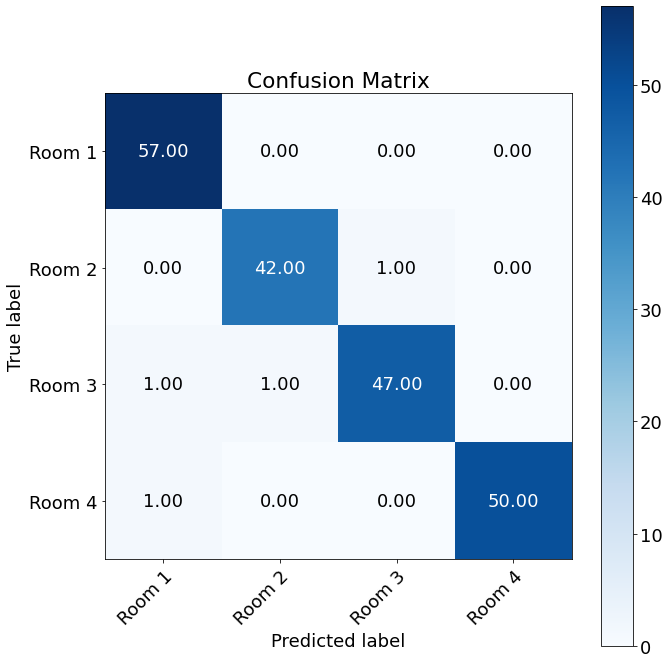

 
Outer Fold:9, Inner fold:9
Accuracy original: 0.975
Macro recall original: 0.9739779632783346
Macro precision original: 0.9737038395695768
 


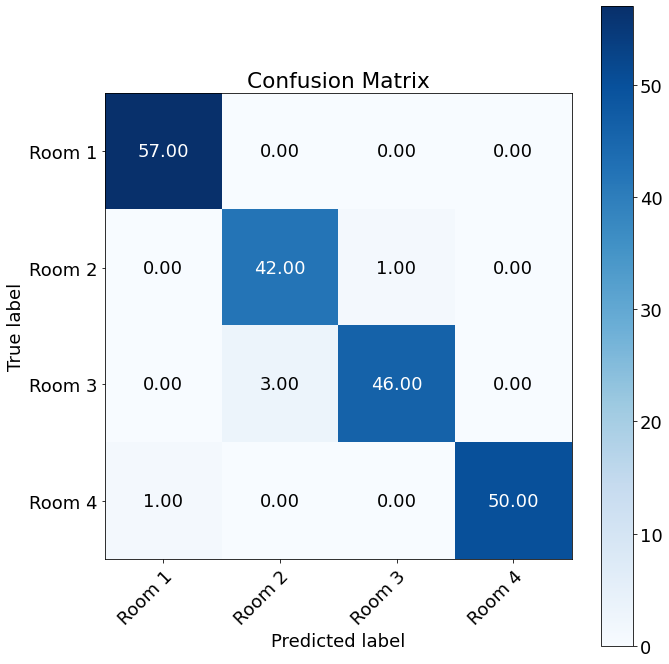

Accuracy pruned 1: 0.97
Macro recall pruned 1: 0.968875922462008
Macro precision pruned 1: 0.9694239744534512


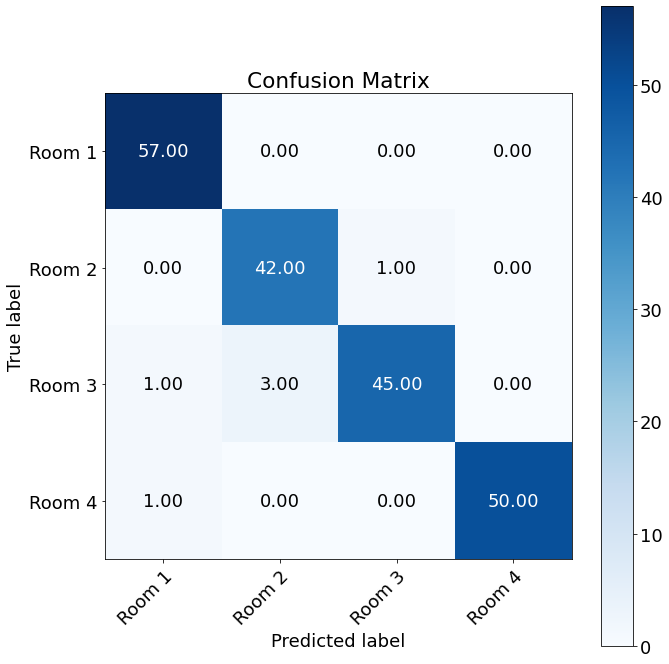

 
Accuracy pruned 2: 0.97
Macro recall pruned 2: 0.968875922462008
Macro precision pruned 2: 0.9694239744534512


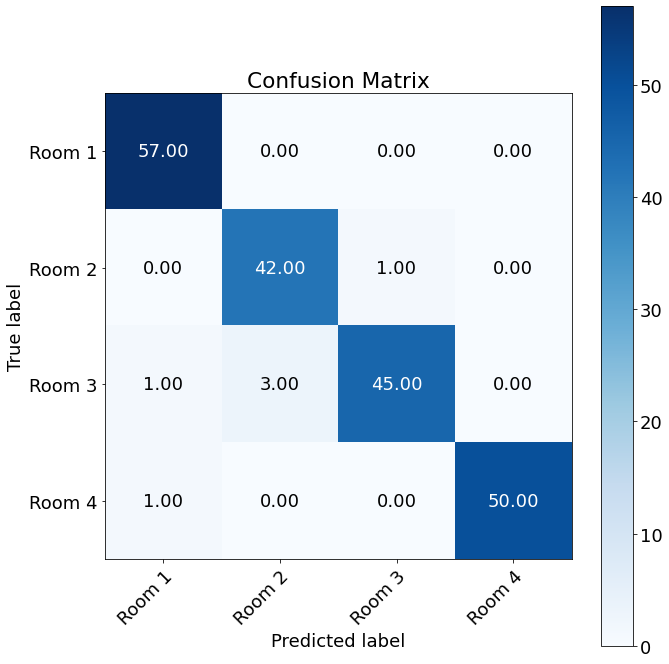

 
Outer Fold:9, Inner fold:10
Accuracy original: 0.985
Macro recall original: 0.9841820449109877
Macro precision original: 0.9847736608677151
 


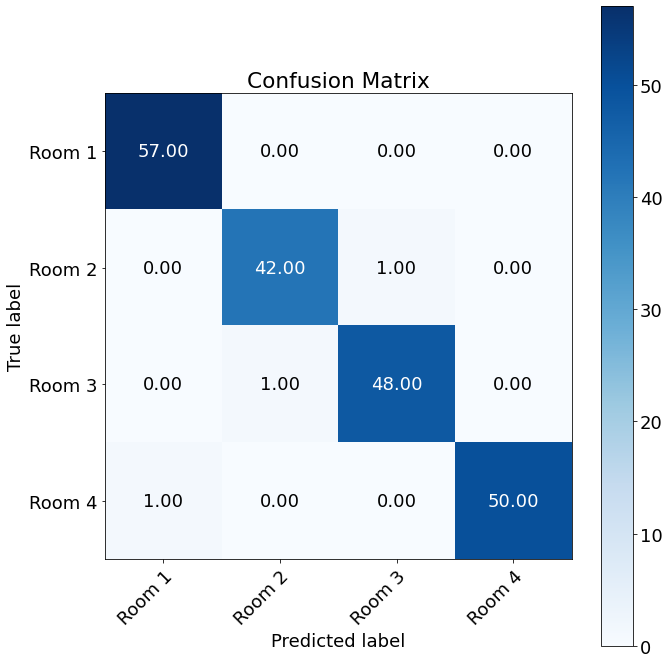

Accuracy pruned 1: 0.97
Macro recall pruned 1: 0.968875922462008
Macro precision pruned 1: 0.9723578212799814


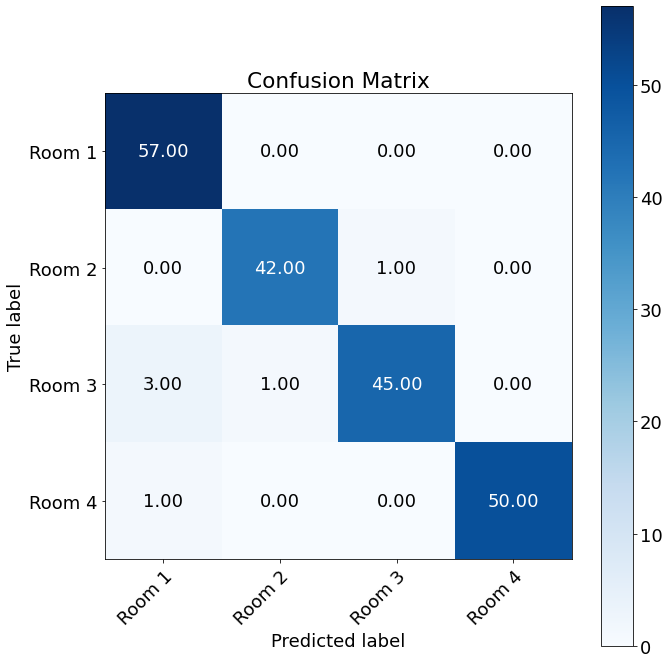

 
Accuracy pruned 2: 0.97
Macro recall pruned 2: 0.968875922462008
Macro precision pruned 2: 0.9723578212799814


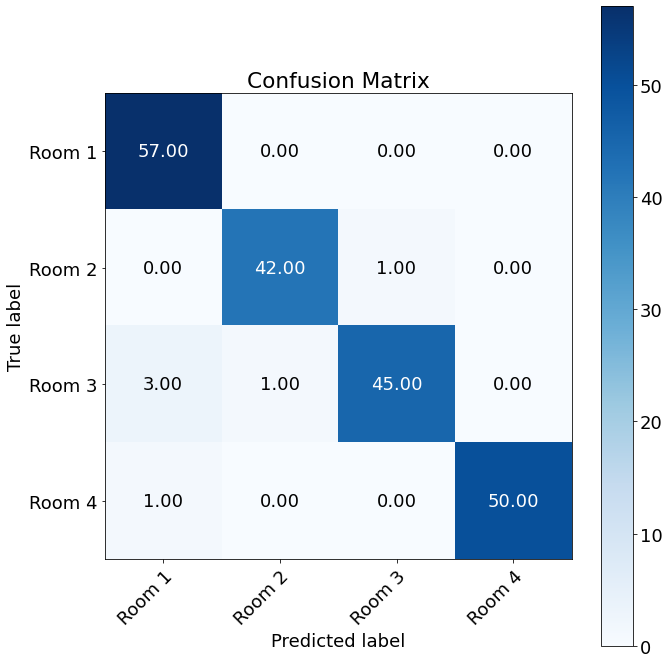

 
Outer Fold:10, Inner fold:1
Accuracy original: 0.985
Macro recall original: 0.9843617021276596
Macro precision original: 0.9857932875667429
 


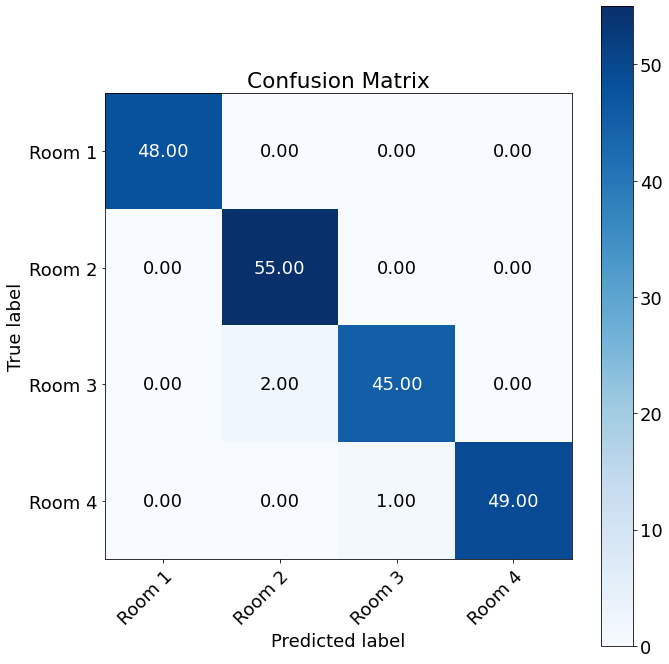

Accuracy pruned 1: 0.99
Macro recall pruned 1: 0.9896808510638297
Macro precision pruned 1: 0.990216565349544


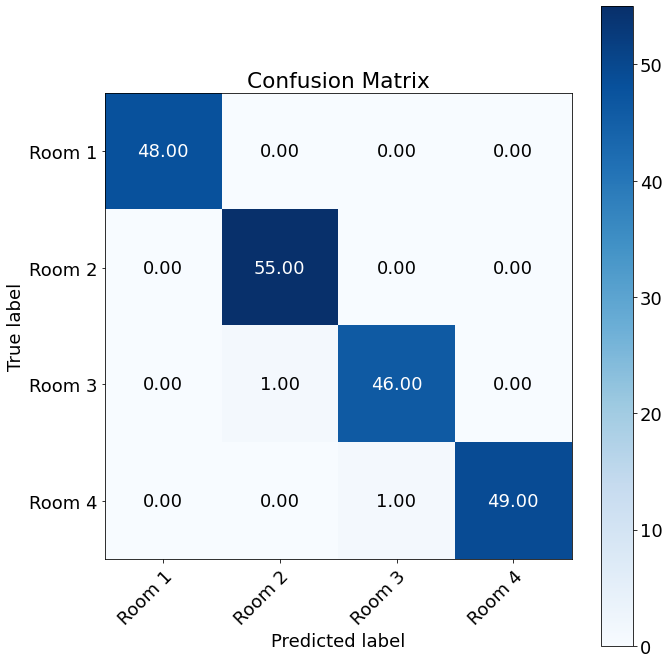

 
Accuracy pruned 2: 0.99
Macro recall pruned 2: 0.9896808510638297
Macro precision pruned 2: 0.990216565349544


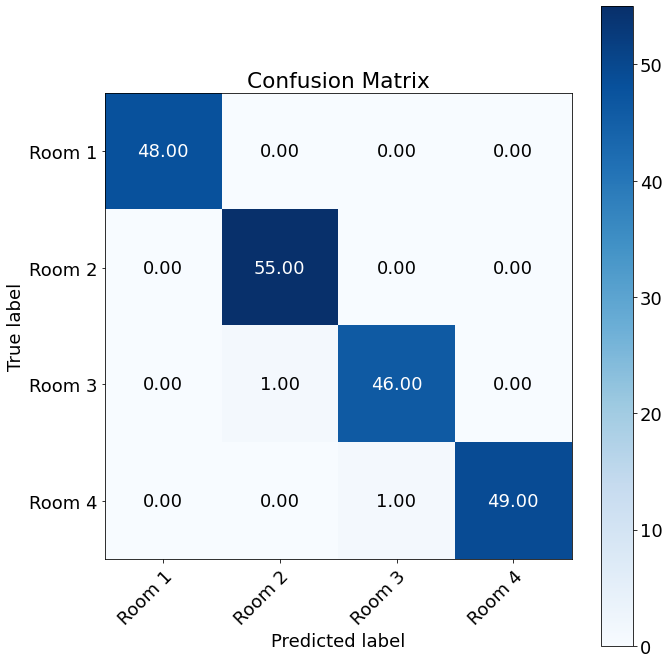

 
Outer Fold:10, Inner fold:2
Accuracy original: 0.985
Macro recall original: 0.9849270631850419
Macro precision original: 0.9852334357340615
 


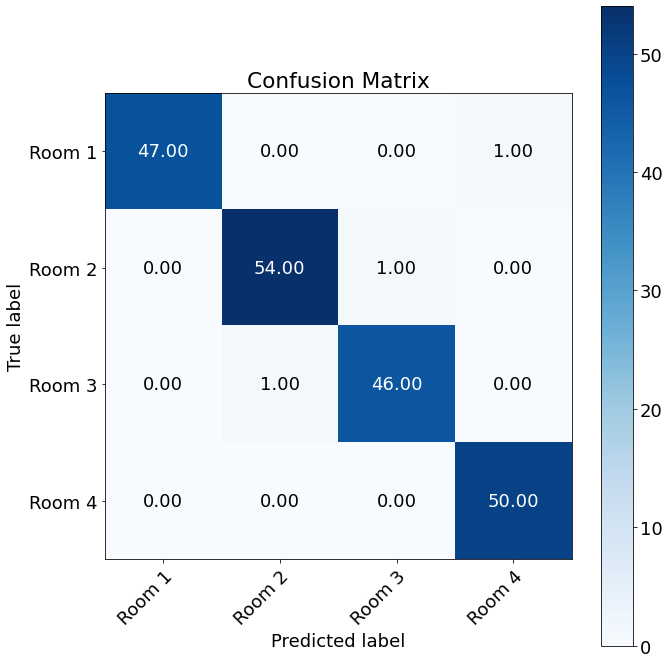

Accuracy pruned 1: 0.985
Macro recall pruned 1: 0.9855899419729207
Macro precision pruned 1: 0.9849537037037037


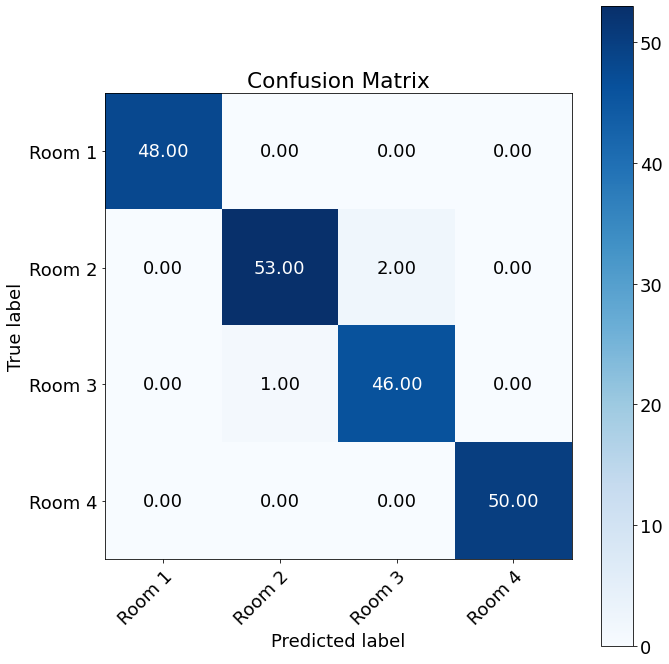

 
Accuracy pruned 2: 0.985
Macro recall pruned 2: 0.9855899419729207
Macro precision pruned 2: 0.9849537037037037


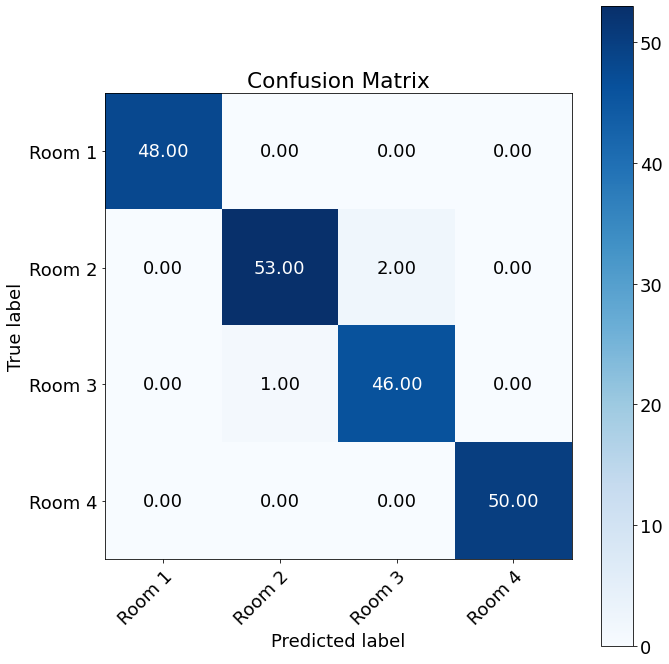

 
Outer Fold:10, Inner fold:3
Accuracy original: 1.0
Macro recall original: 1.0
Macro precision original: 1.0
 


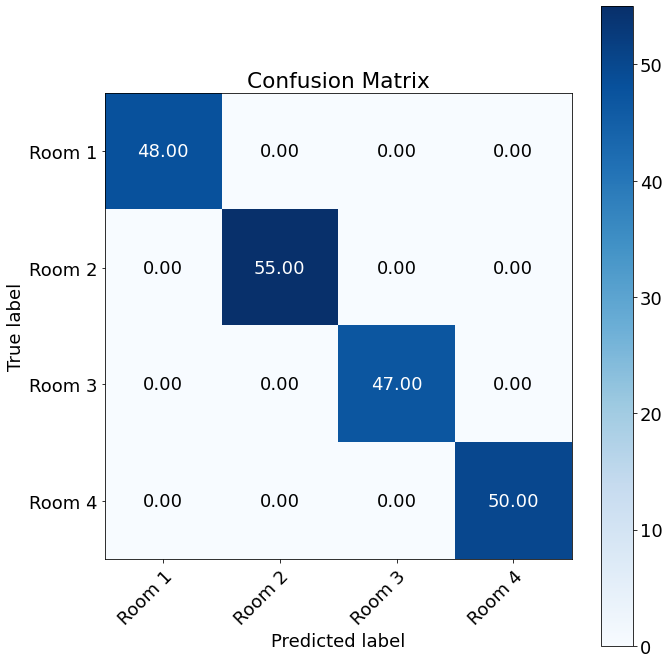

Accuracy pruned 1: 0.995
Macro recall pruned 1: 0.9954545454545455
Macro precision pruned 1: 0.9947916666666666


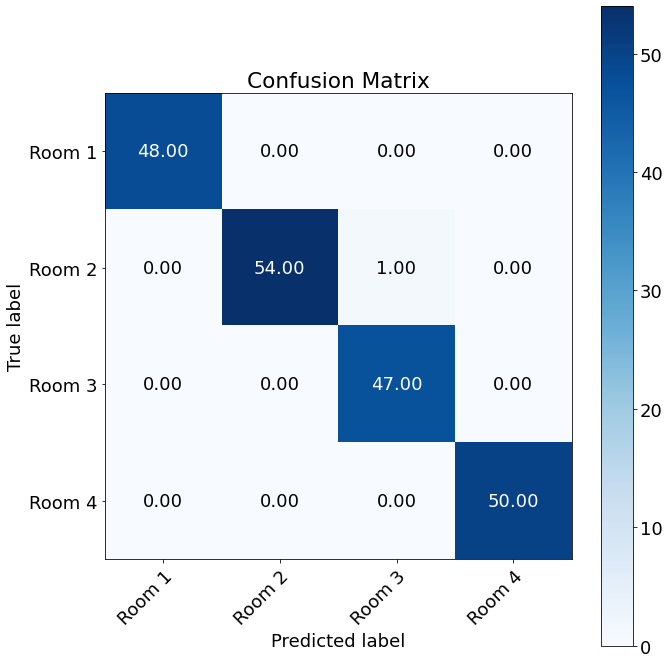

 
Accuracy pruned 2: 0.995
Macro recall pruned 2: 0.9954545454545455
Macro precision pruned 2: 0.9947916666666666


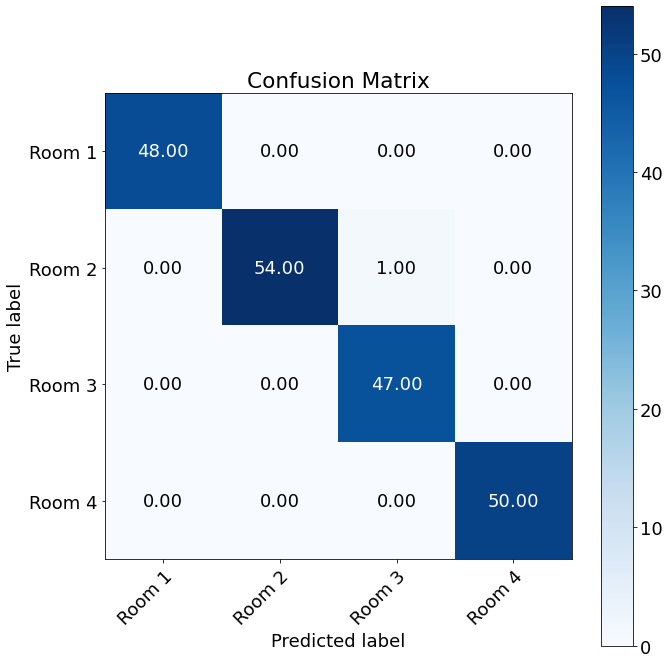

 
Outer Fold:10, Inner fold:4
Accuracy original: 1.0
Macro recall original: 1.0
Macro precision original: 1.0
 


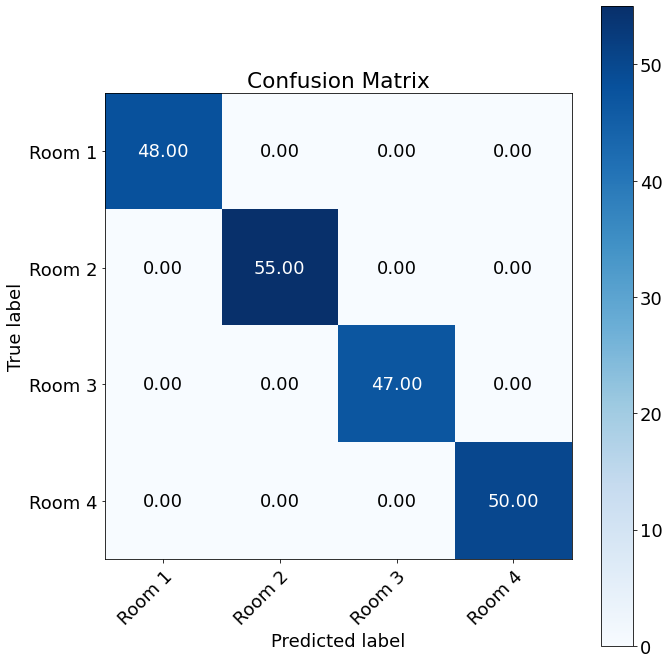

Accuracy pruned 1: 0.985
Macro recall pruned 1: 0.9852462121212121
Macro precision pruned 1: 0.9847959183673469


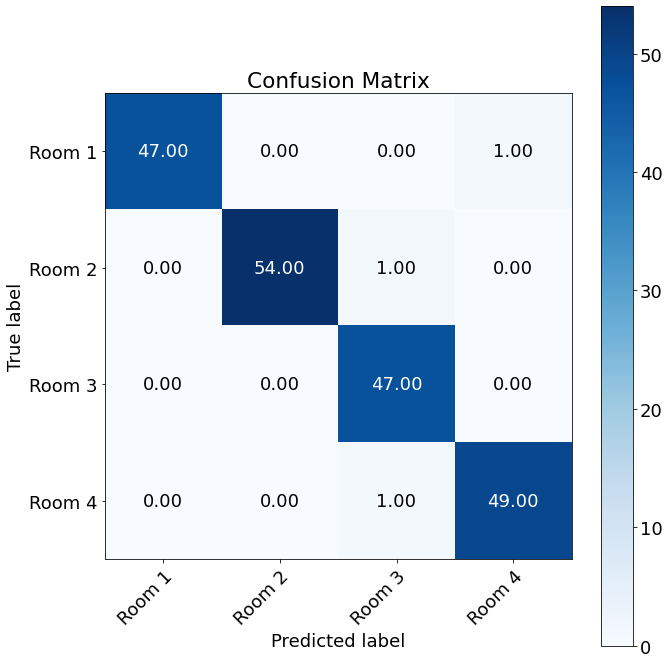

 
Accuracy pruned 2: 0.985
Macro recall pruned 2: 0.9852462121212121
Macro precision pruned 2: 0.9847959183673469


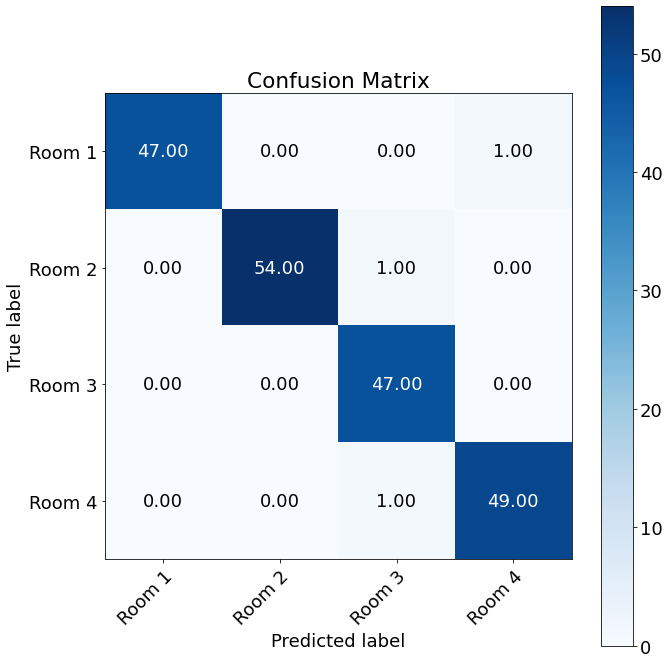

 
Outer Fold:10, Inner fold:5
Accuracy original: 0.985
Macro recall original: 0.985909090909091
Macro precision original: 0.985
 


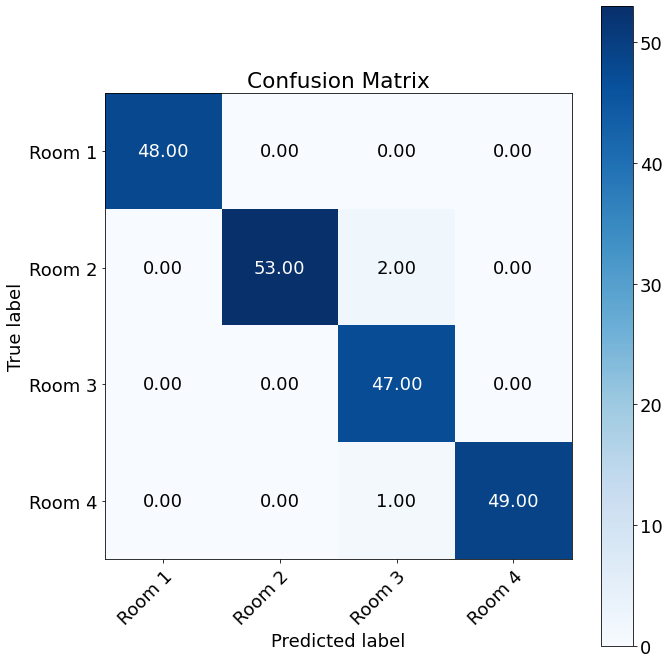

Accuracy pruned 1: 0.99
Macro recall pruned 1: 0.9904545454545455
Macro precision pruned 1: 0.9897959183673469


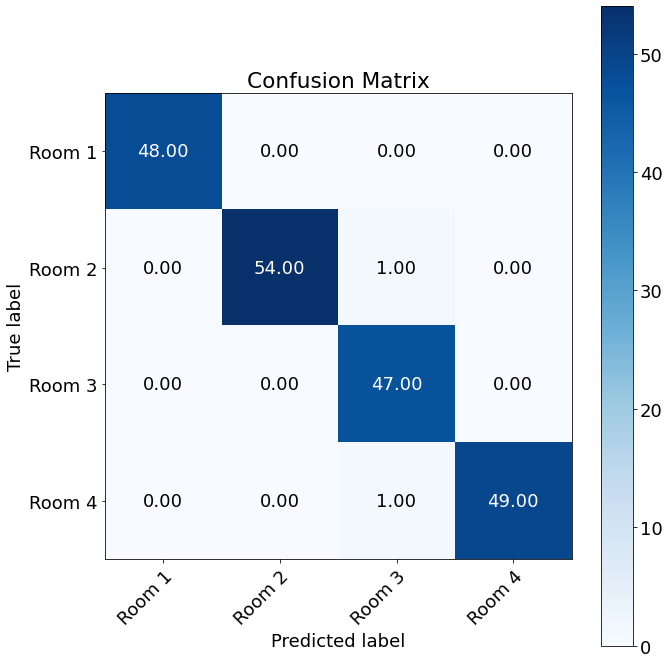

 
Accuracy pruned 2: 0.99
Macro recall pruned 2: 0.9904545454545455
Macro precision pruned 2: 0.9897959183673469


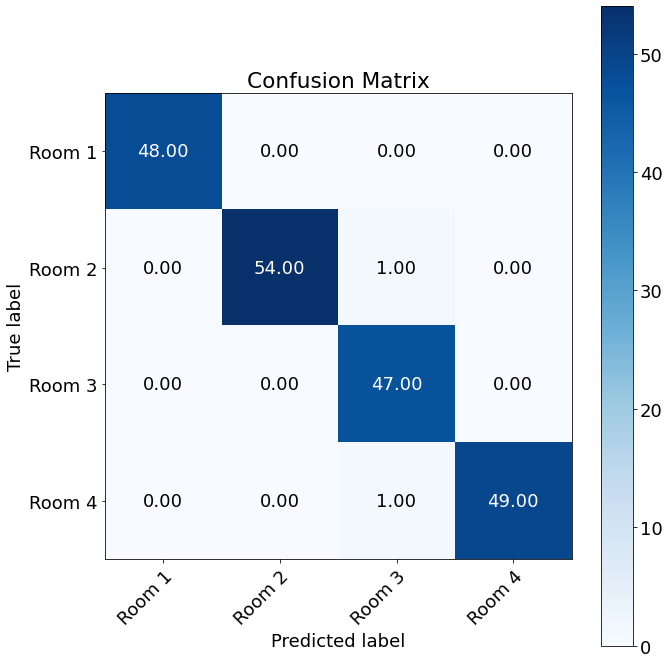

 
Outer Fold:10, Inner fold:6
Accuracy original: 0.99
Macro recall original: 0.9896808510638297
Macro precision original: 0.990216565349544
 


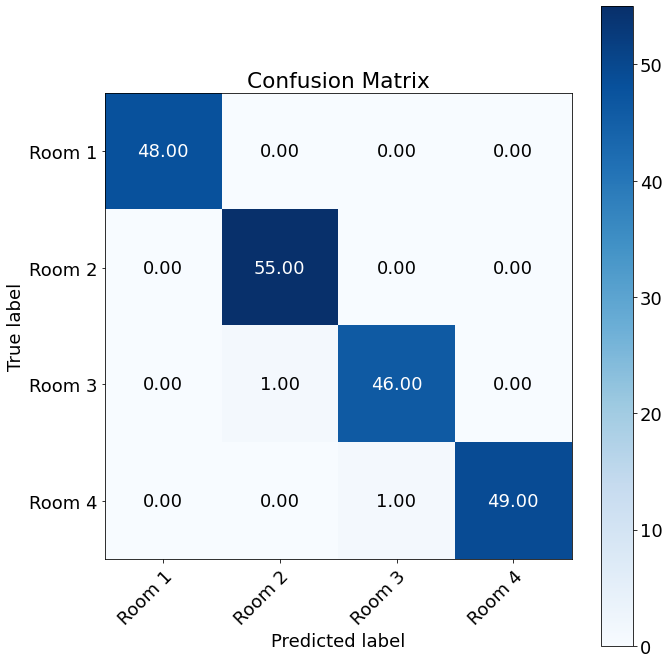

Accuracy pruned 1: 0.995
Macro recall pruned 1: 0.995
Macro precision pruned 1: 0.9947916666666666


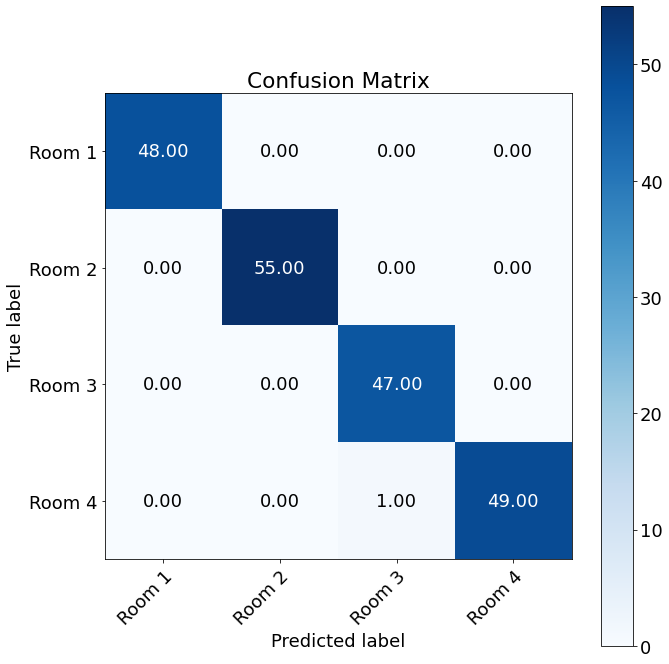

 
Accuracy pruned 2: 0.995
Macro recall pruned 2: 0.995
Macro precision pruned 2: 0.9947916666666666


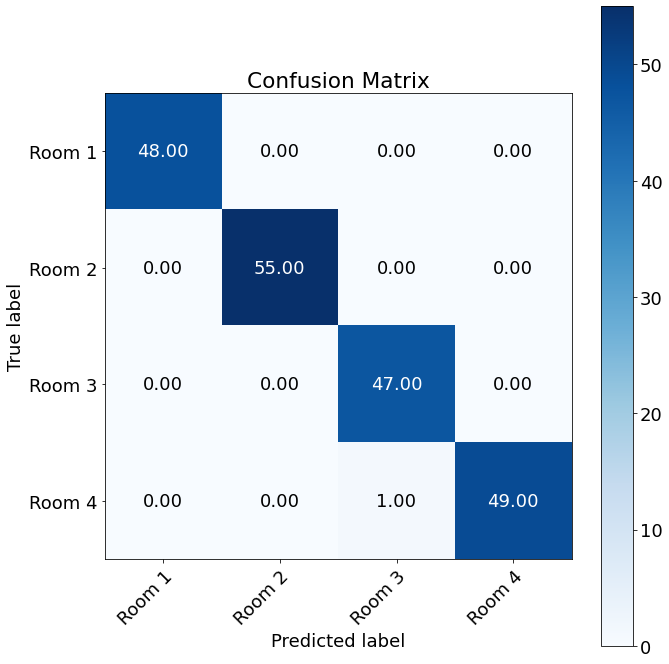

 
Outer Fold:10, Inner fold:7
Accuracy original: 0.98
Macro recall original: 0.9791533687943262
Macro precision original: 0.9807932875667429
 


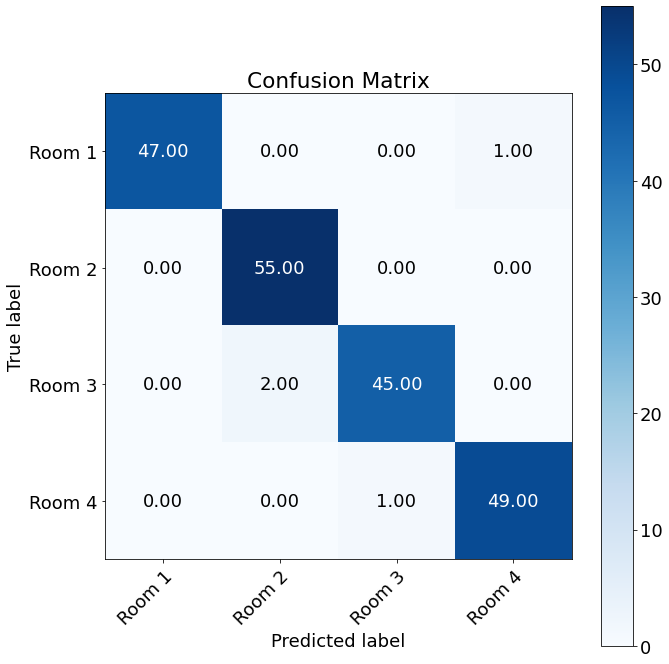

Accuracy pruned 1: 0.985
Macro recall pruned 1: 0.9844725177304964
Macro precision pruned 1: 0.985216565349544


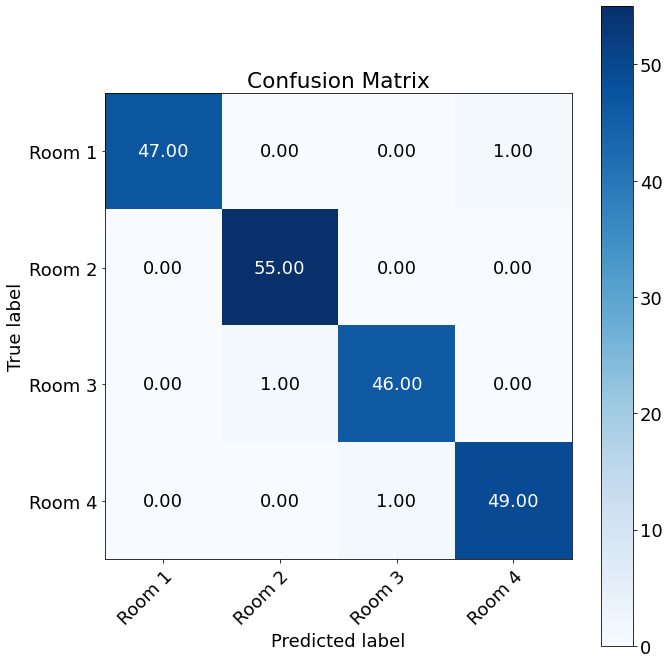

 
Accuracy pruned 2: 0.985
Macro recall pruned 2: 0.9844725177304964
Macro precision pruned 2: 0.985216565349544


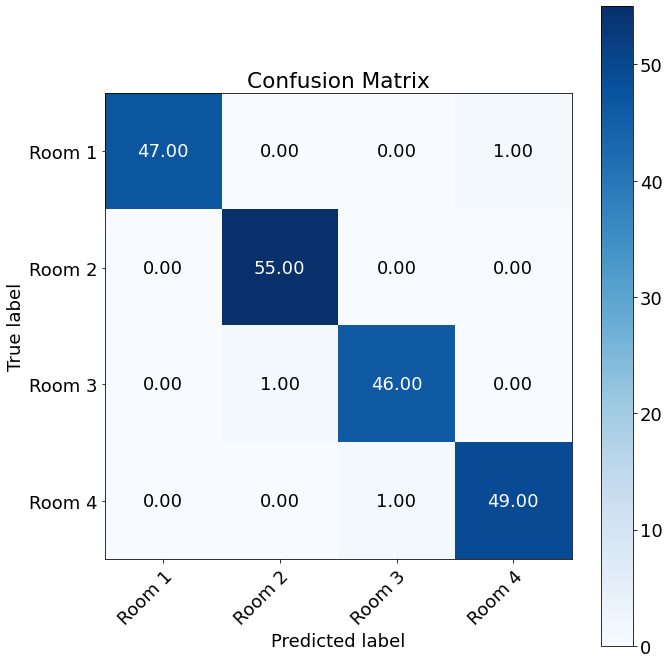

 
Outer Fold:10, Inner fold:8
Accuracy original: 0.975
Macro recall original: 0.9737234042553191
Macro precision original: 0.9773690292758089
 


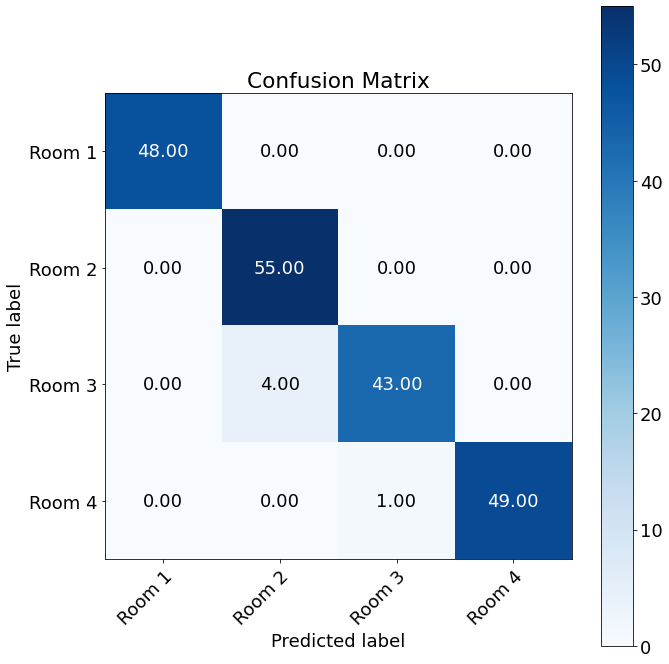

Accuracy pruned 1: 0.985
Macro recall pruned 1: 0.985909090909091
Macro precision pruned 1: 0.985


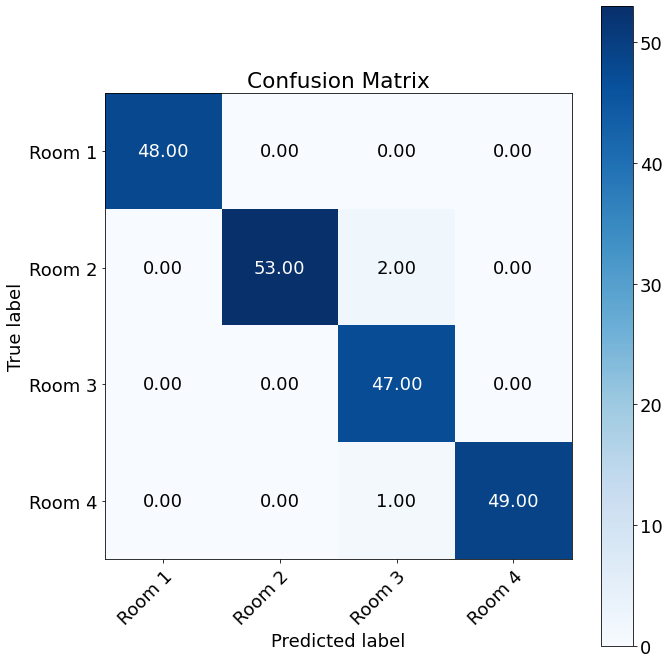

 
Accuracy pruned 2: 0.985
Macro recall pruned 2: 0.985909090909091
Macro precision pruned 2: 0.985


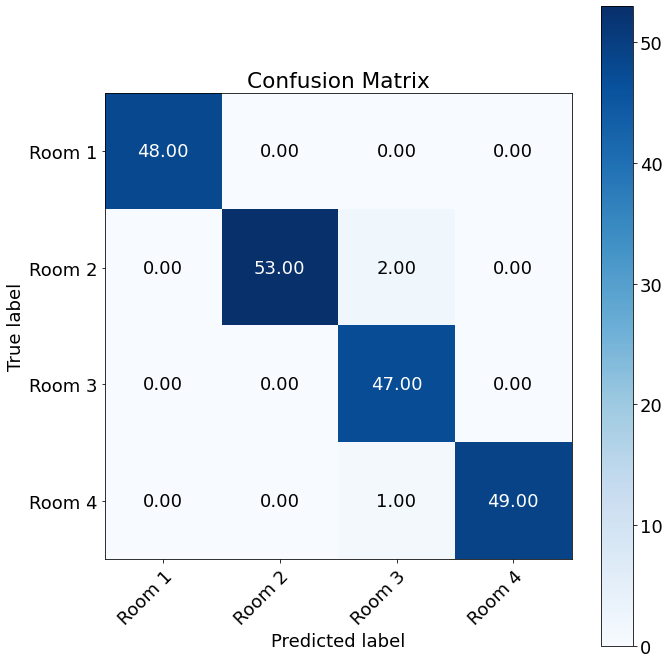

 
Outer Fold:10, Inner fold:9
Accuracy original: 0.98
Macro recall original: 0.9791533687943262
Macro precision original: 0.9807932875667429
 


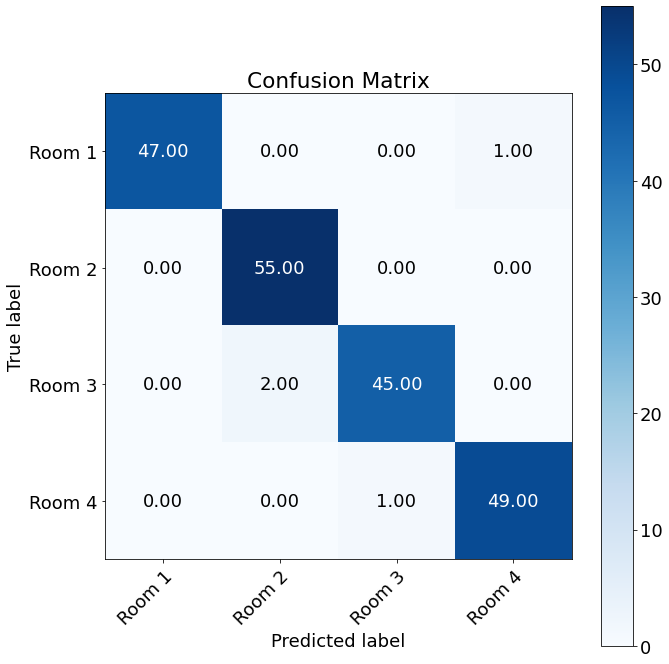

Accuracy pruned 1: 0.99
Macro recall pruned 1: 0.9896808510638297
Macro precision pruned 1: 0.990216565349544


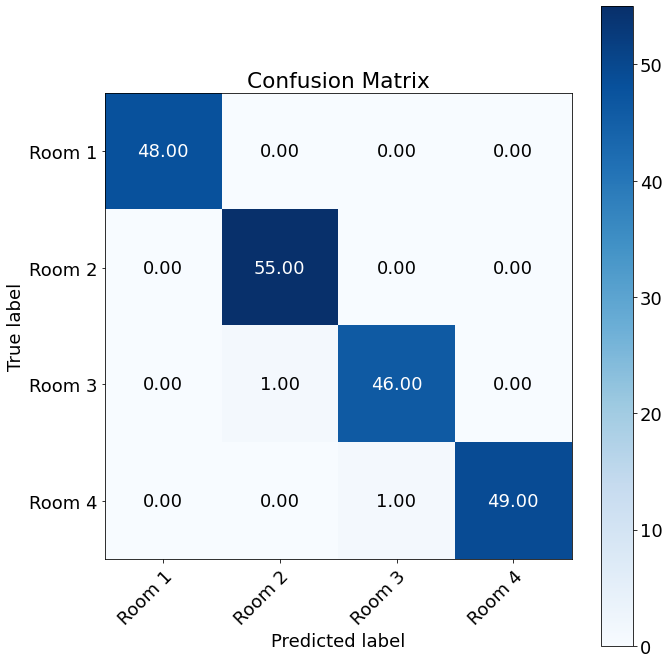

 
Accuracy pruned 2: 0.99
Macro recall pruned 2: 0.9896808510638297
Macro precision pruned 2: 0.990216565349544


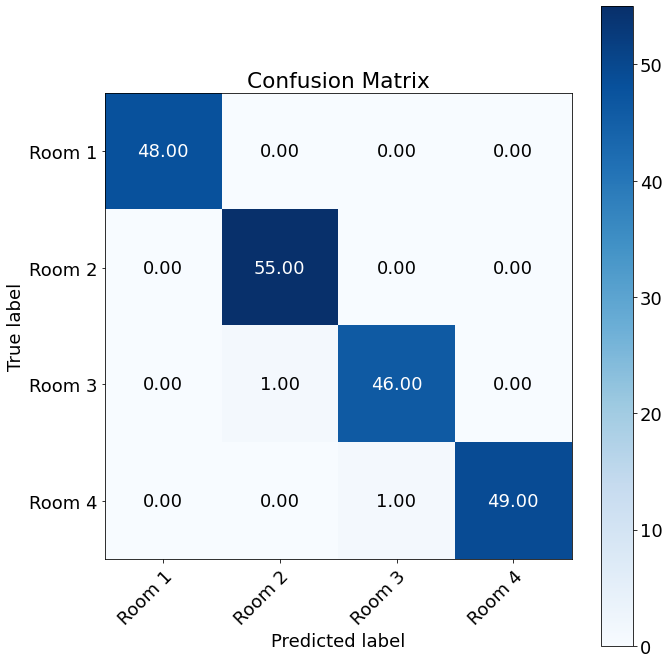

 
Outer Fold:10, Inner fold:10
Accuracy original: 0.975
Macro recall original: 0.9744970986460348
Macro precision original: 0.9759725400457666
 


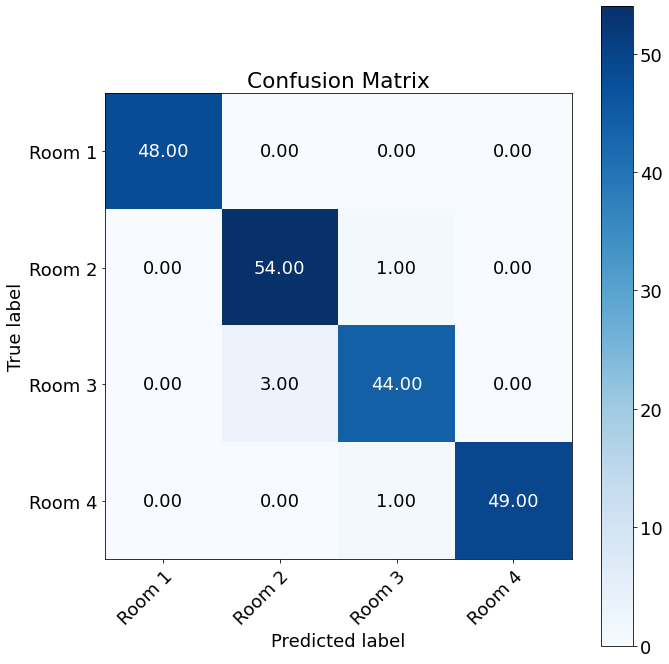

Accuracy pruned 1: 0.99
Macro recall pruned 1: 0.9896808510638297
Macro precision pruned 1: 0.990216565349544


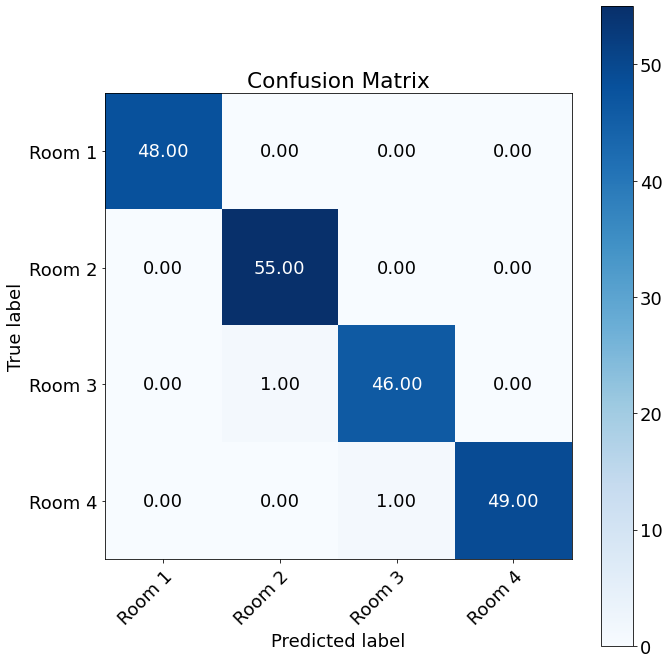

 
Accuracy pruned 2: 0.99
Macro recall pruned 2: 0.9896808510638297
Macro precision pruned 2: 0.990216565349544


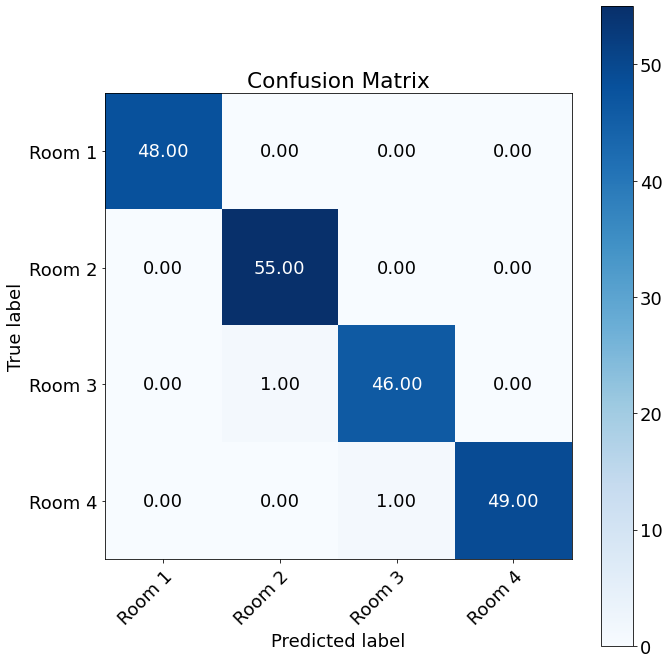

 
------------------------------------------------
Average accuracy for original tree:0.9719999999999993
Average accuracy for pruned1 tree:0.9694999999999997
Average accuracy for pruned2 tree:0.9694999999999997
Average recall for original tree:[0.9920162  0.95935623 0.94586756 0.98631679]
Average recall for pruned1 tree:[0.99556198 0.943731   0.9513856  0.98395701]
Average recall for pruned2 tree:[0.99556198 0.943731   0.9513856  0.98395701]
Average precision for original tree:[0.98564148 0.96281796 0.95070881 0.98863239]
Average precision for pruned1 tree:[0.97888159 0.97154488 0.93717991 0.99169133]
Average precision for pruned2 tree:[0.97888159 0.97154488 0.93717991 0.99169133]
 
Average F1 score for original tree:[0.98881856 0.96108397 0.94828201 0.98747324]
Average F1 score for pruned1 tree:[0.98715133 0.95743598 0.94422933 0.98780903] 
Average F1 score for pruned2 tree:[0.98715133 0.95743598 0.94422933 0.98780903] 
 
Average depth original tree:11.7
Average depth pruned1 tree:8.1

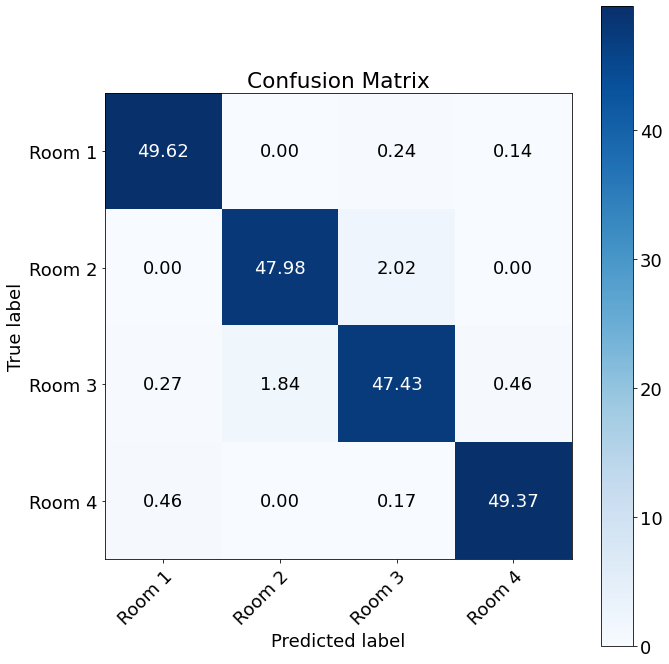

Confusion matrix for pruned1 tree


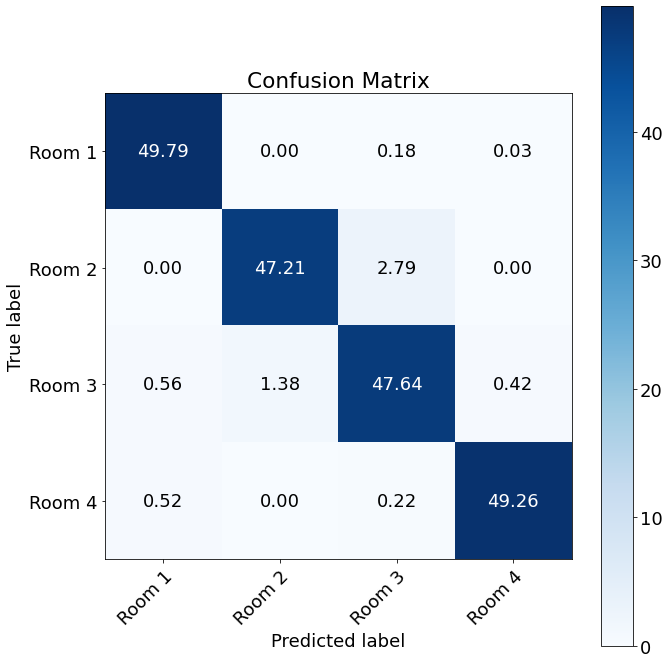

Confusion matrix for pruned2 tree


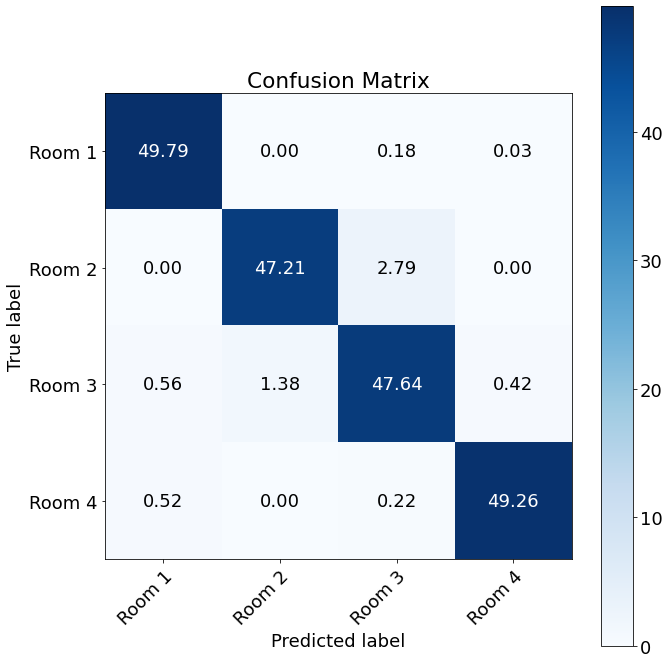

In [34]:
# Full results report with cross-validation metrics for each fold

np.random.seed(101)
cross_validate(data_clean, 10,10)

------------------------------------------------
Average accuracy for original tree:0.9719999999999993
Average accuracy for pruned1 tree:0.9694999999999997
Average accuracy for pruned2 tree:0.9694999999999997
Average recall for original tree:[0.9920162  0.95935623 0.94586756 0.98631679]
Average recall for pruned1 tree:[0.99556198 0.943731   0.9513856  0.98395701]
Average recall for pruned2 tree:[0.99556198 0.943731   0.9513856  0.98395701]
Average precision for original tree:[0.98564148 0.96281796 0.95070881 0.98863239]
Average precision for pruned1 tree:[0.97888159 0.97154488 0.93717991 0.99169133]
Average precision for pruned2 tree:[0.97888159 0.97154488 0.93717991 0.99169133]
 
Average F1 score for original tree:[0.98881856 0.96108397 0.94828201 0.98747324]
Average F1 score for pruned1 tree:[0.98715133 0.95743598 0.94422933 0.98780903] 
Average F1 score for pruned2 tree:[0.98715133 0.95743598 0.94422933 0.98780903] 
 
Average depth original tree:11.7
Average depth pruned1 tree:8.12 

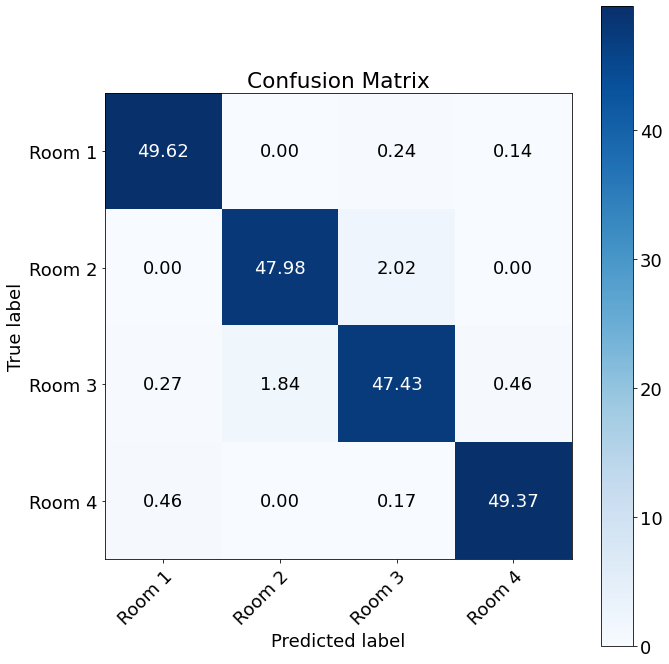

Confusion matrix for pruned1 tree


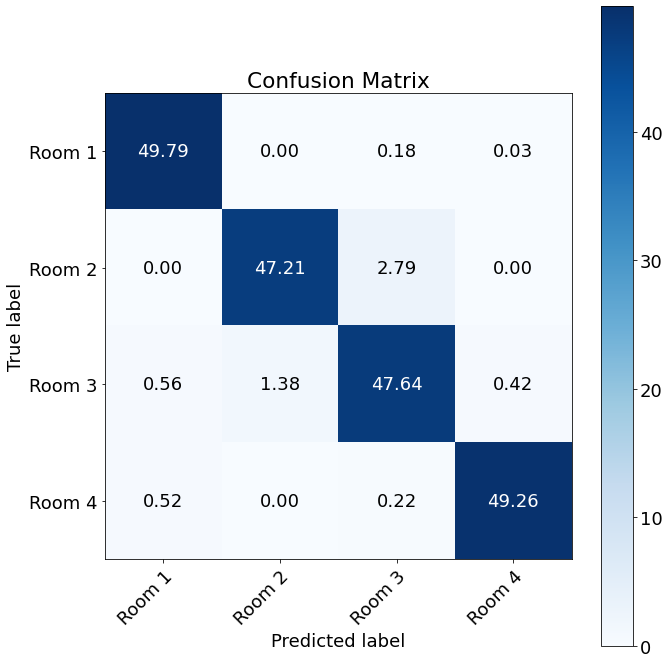

Confusion matrix for pruned2 tree


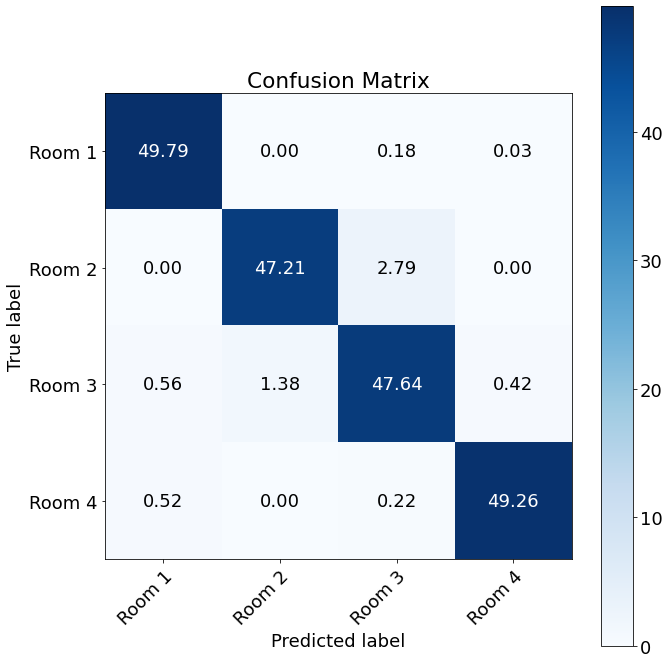

In [35]:
# Shortened results report with only averaged cross-validation metrics across all folds
np.random.seed(101)
cross_validate(data_clean, 10,10, ifnotshort = False)

# Results from the noisy dataset

Outer Fold:1, Inner fold:1
Accuracy original: 0.805
Macro recall original: 0.8050815850815851
Macro precision original: 0.808955528355773
 


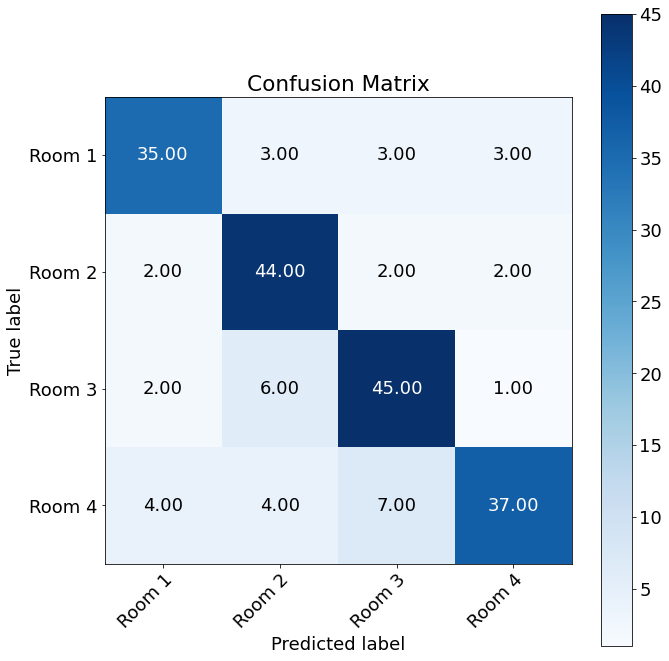

Accuracy pruned 1: 0.885
Macro recall pruned 1: 0.8881520331520332
Macro precision pruned 1: 0.8890340226999891


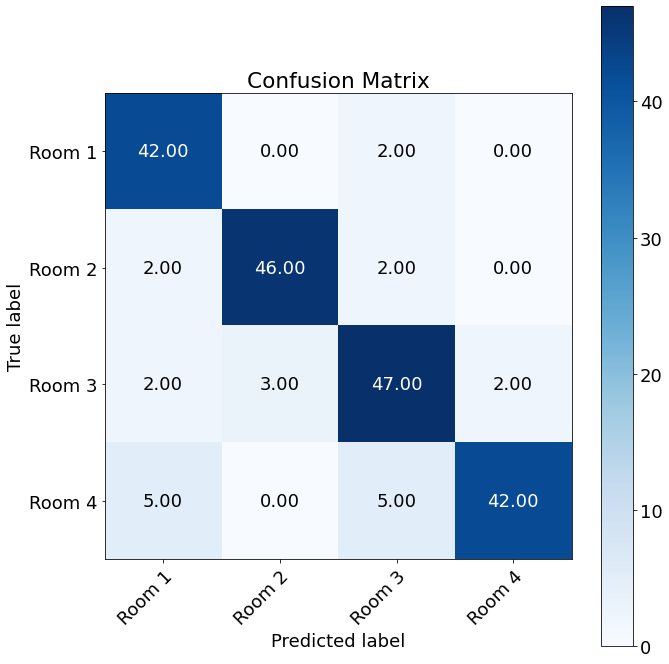

 
Accuracy pruned 2: 0.885
Macro recall pruned 2: 0.8881520331520332
Macro precision pruned 2: 0.8890340226999891


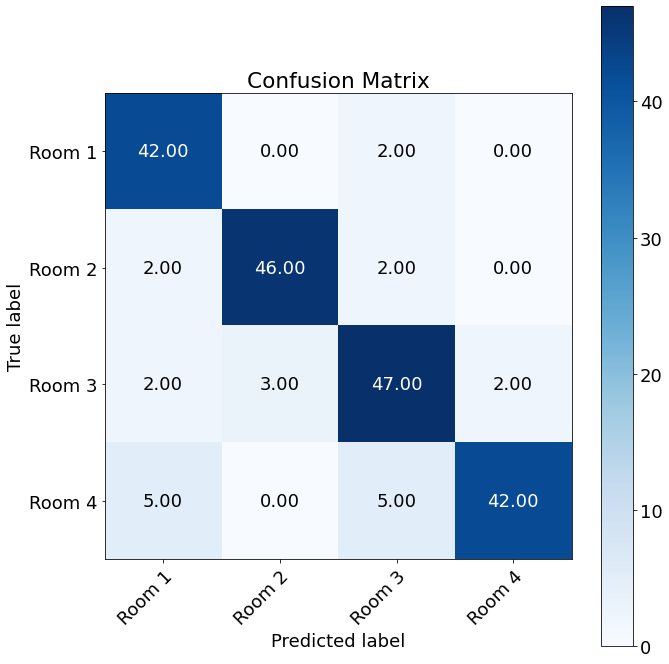

 
Outer Fold:1, Inner fold:2
Accuracy original: 0.835
Macro recall original: 0.8334382284382285
Macro precision original: 0.8399473055193395
 


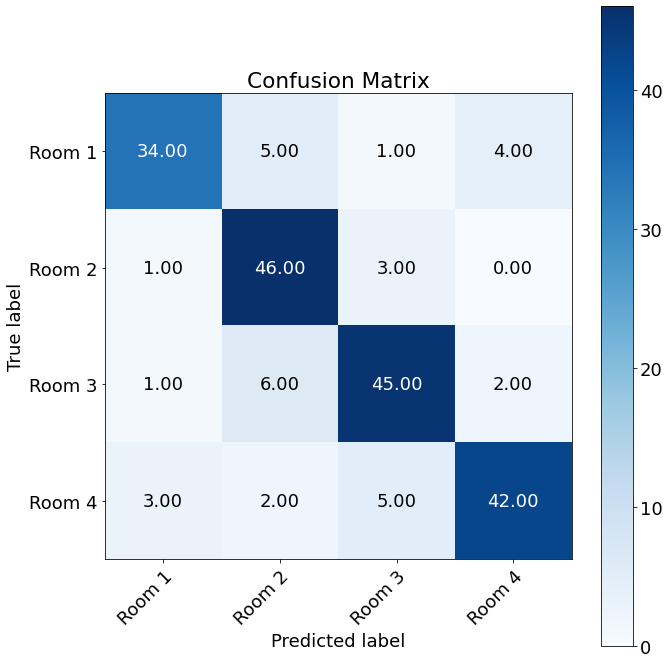

Accuracy pruned 1: 0.9
Macro recall pruned 1: 0.903449235949236
Macro precision pruned 1: 0.9021545535210131


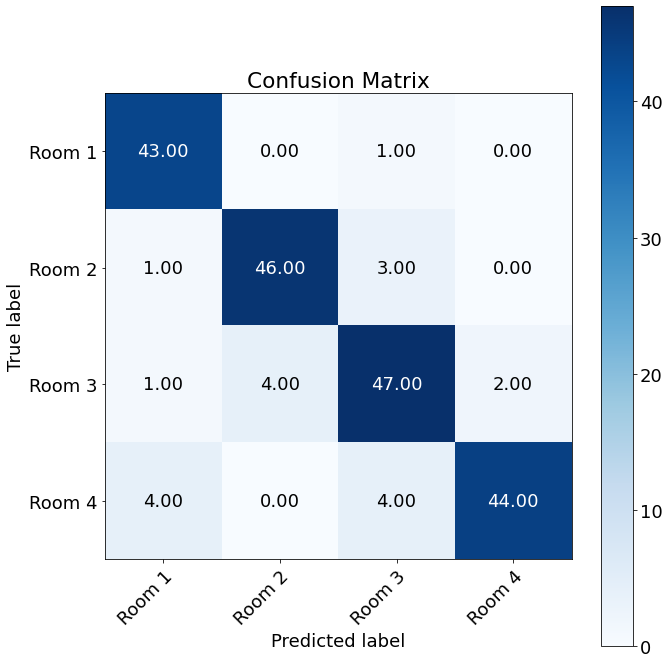

 
Accuracy pruned 2: 0.9
Macro recall pruned 2: 0.903449235949236
Macro precision pruned 2: 0.9021545535210131


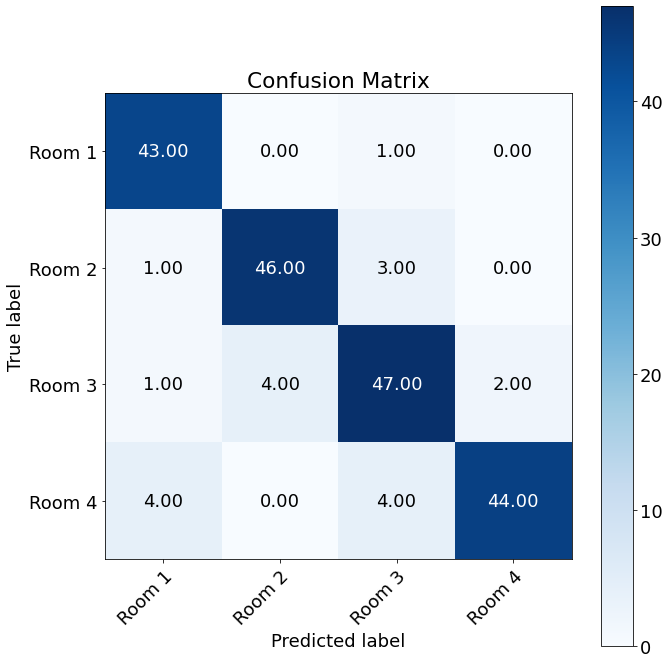

 
Outer Fold:1, Inner fold:3
Accuracy original: 0.815
Macro recall original: 0.8167728567728567
Macro precision original: 0.8205220767552304
 


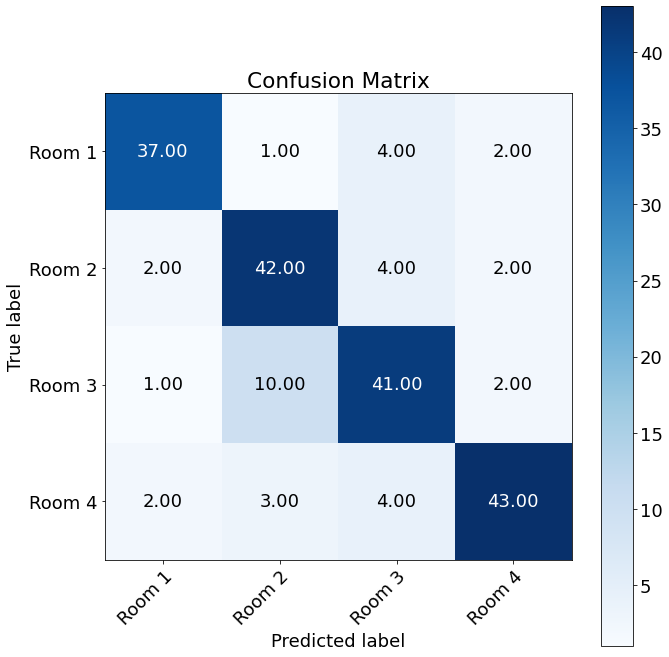

Accuracy pruned 1: 0.885
Macro recall pruned 1: 0.8895603470603471
Macro precision pruned 1: 0.8860977148788058


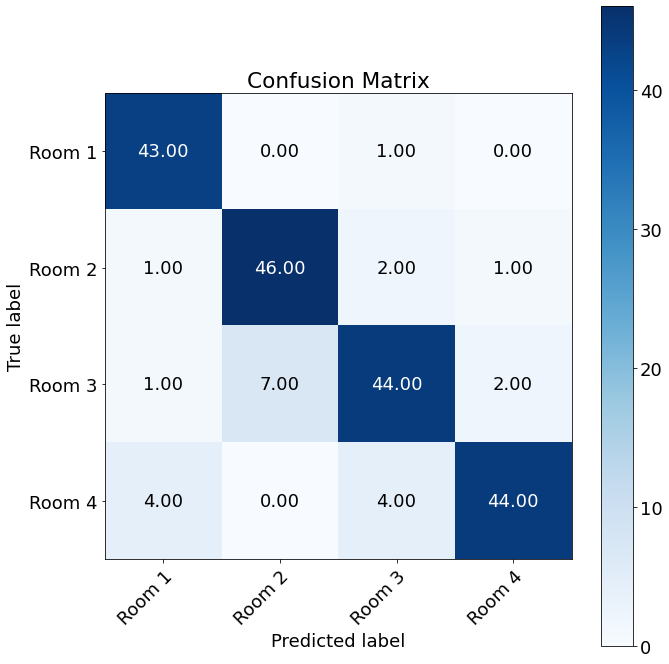

 
Accuracy pruned 2: 0.885
Macro recall pruned 2: 0.8895603470603471
Macro precision pruned 2: 0.8860977148788058


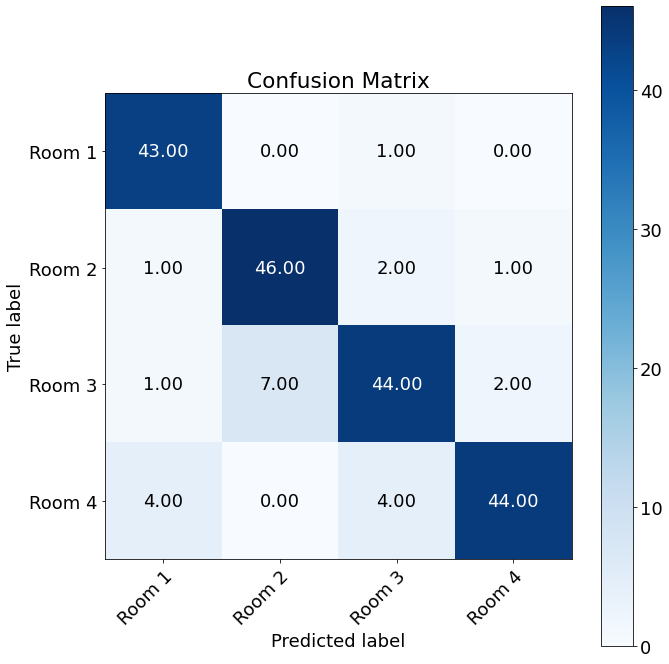

 
Outer Fold:1, Inner fold:4
Accuracy original: 0.81
Macro recall original: 0.8111195286195286
Macro precision original: 0.8131764069264069
 


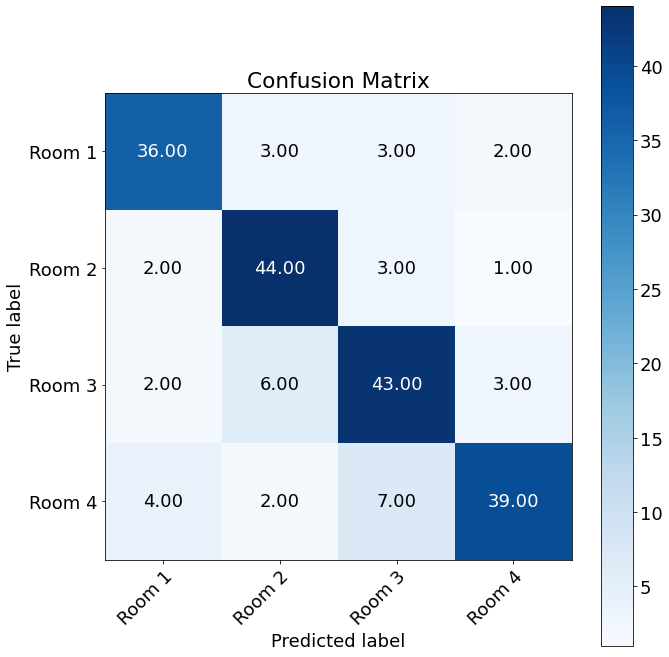

Accuracy pruned 1: 0.905
Macro recall pruned 1: 0.908449235949236
Macro precision pruned 1: 0.9071172886150507


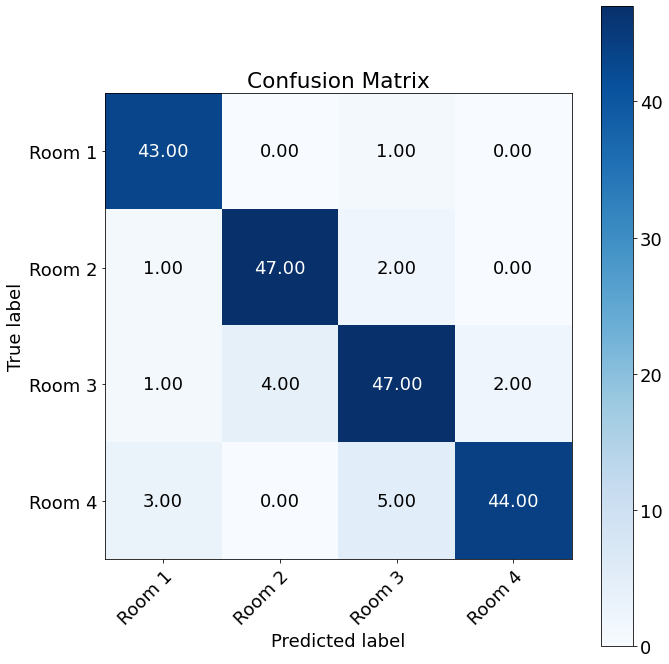

 
Accuracy pruned 2: 0.905
Macro recall pruned 2: 0.908449235949236
Macro precision pruned 2: 0.9071172886150507


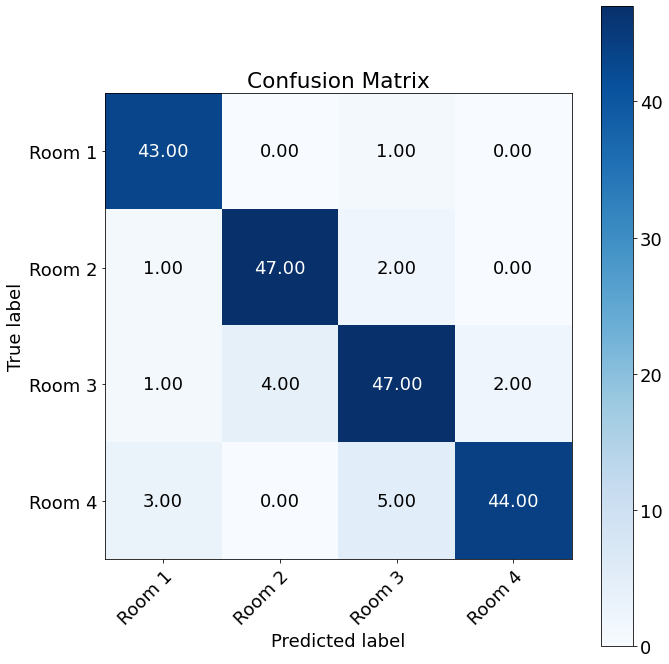

 
Outer Fold:1, Inner fold:5
Accuracy original: 0.805
Macro recall original: 0.801392773892774
Macro precision original: 0.8049655388471179
 


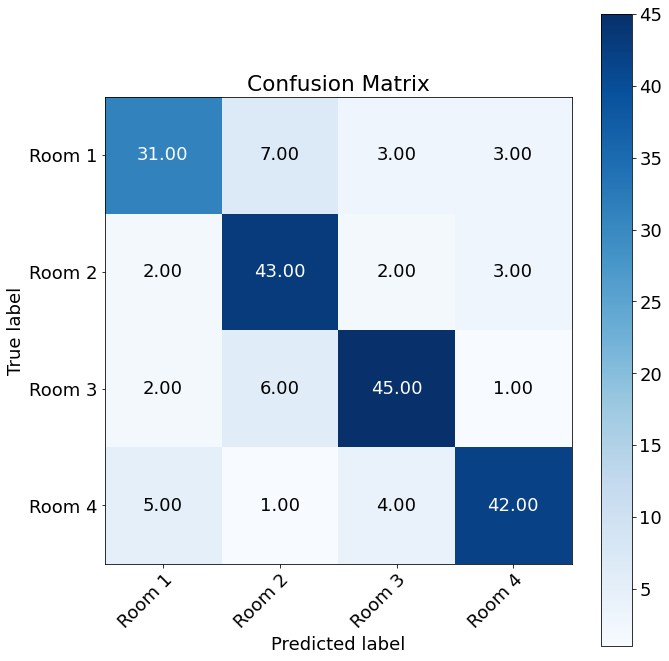

Accuracy pruned 1: 0.88
Macro recall pruned 1: 0.8841899766899768
Macro precision pruned 1: 0.8813067041348857


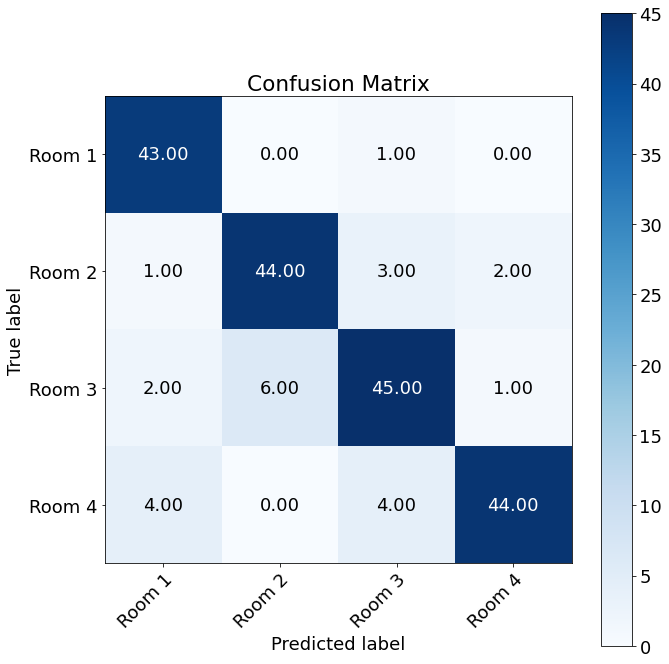

 
Accuracy pruned 2: 0.88
Macro recall pruned 2: 0.8841899766899768
Macro precision pruned 2: 0.8813067041348857


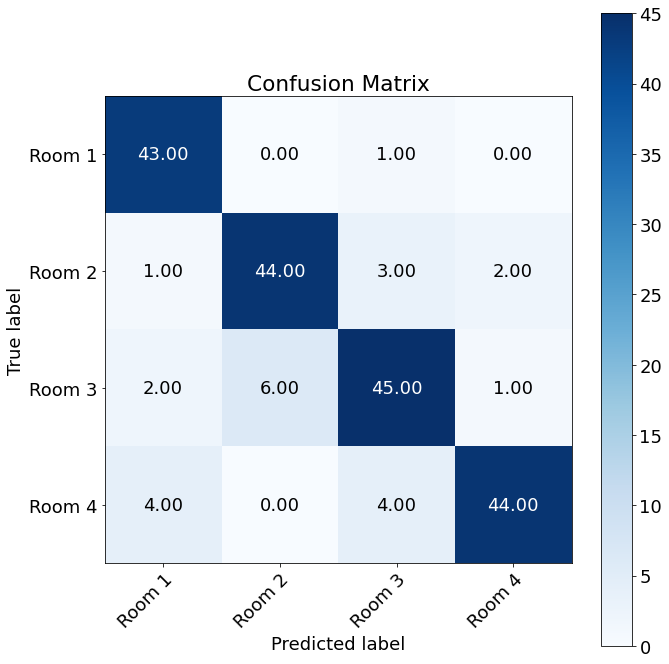

 
Outer Fold:1, Inner fold:6
Accuracy original: 0.845
Macro recall original: 0.8470253820253819
Macro precision original: 0.8494363929146538
 


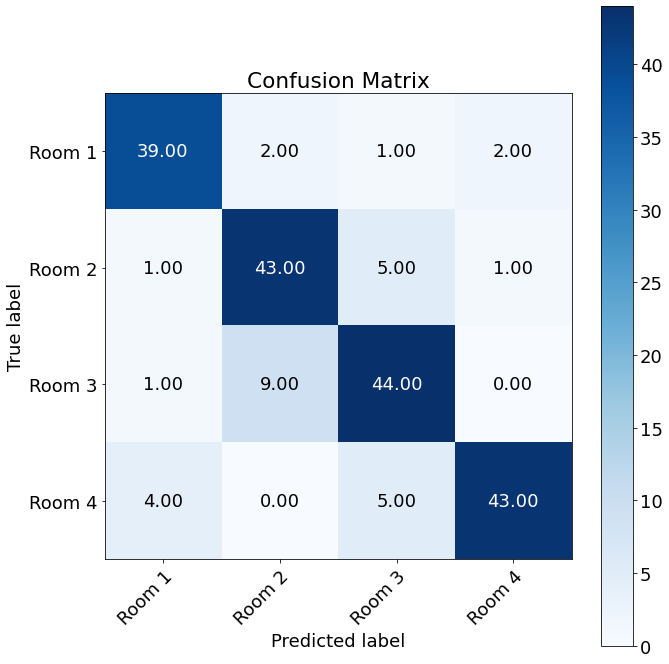

Accuracy pruned 1: 0.91
Macro recall pruned 1: 0.9130788655788656
Macro precision pruned 1: 0.9124061745910486


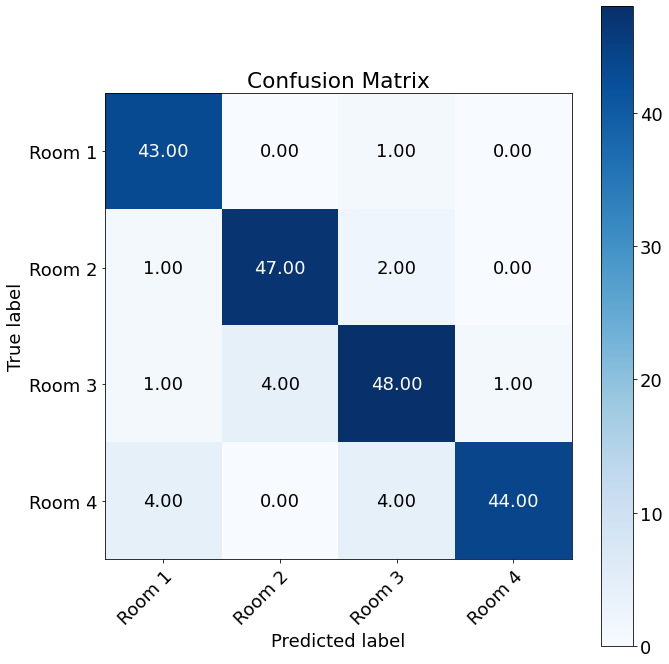

 
Accuracy pruned 2: 0.91
Macro recall pruned 2: 0.9130788655788656
Macro precision pruned 2: 0.9124061745910486


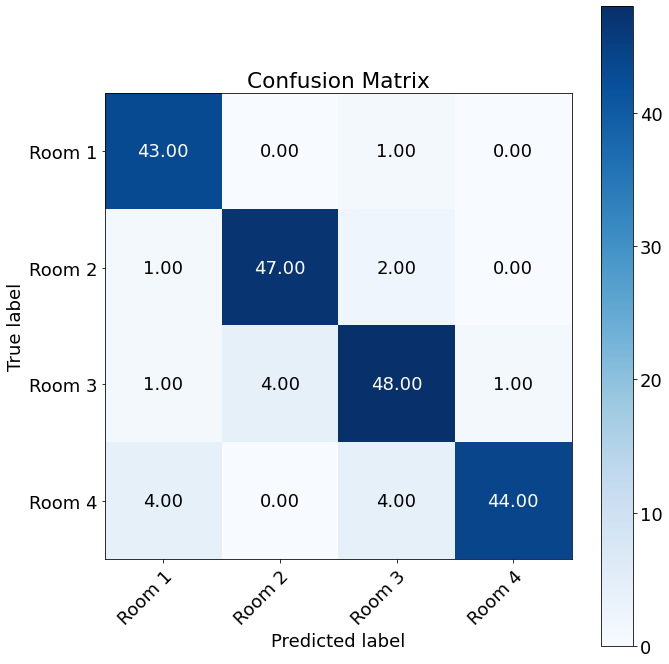

 
Outer Fold:1, Inner fold:7
Accuracy original: 0.815
Macro recall original: 0.8148892773892774
Macro precision original: 0.816585935550799
 


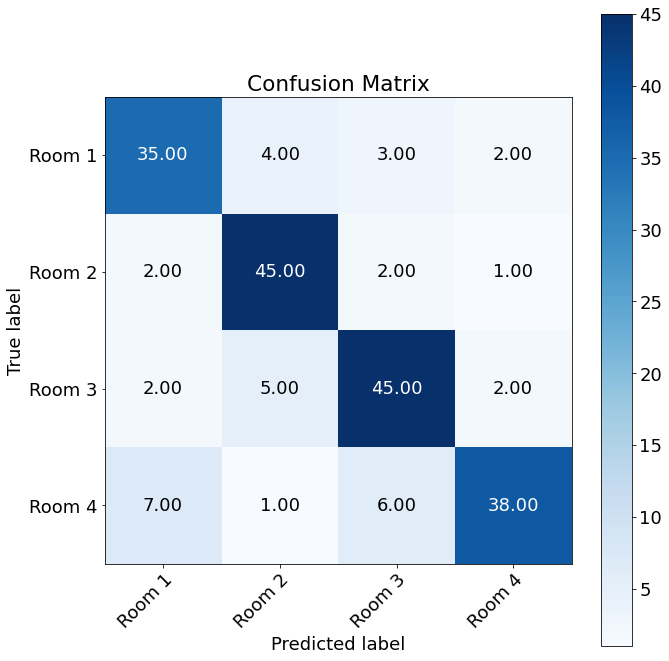

Accuracy pruned 1: 0.905
Macro recall pruned 1: 0.9080788655788656
Macro precision pruned 1: 0.9074977817213843


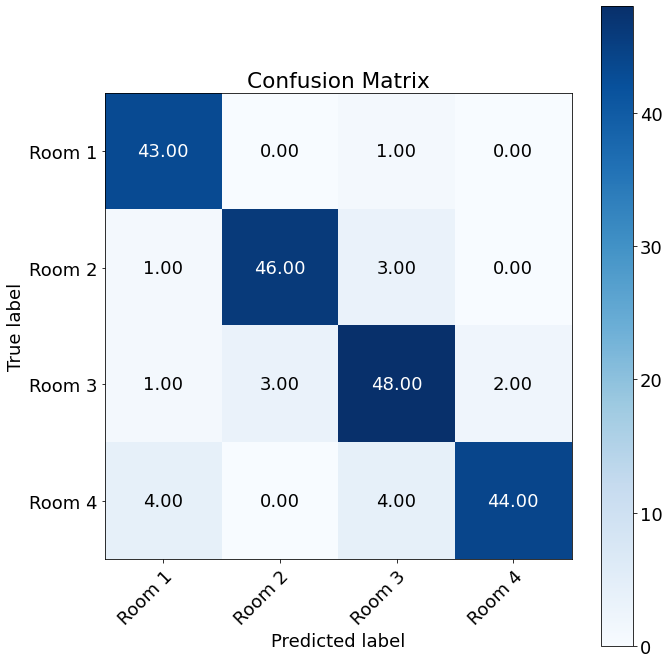

 
Accuracy pruned 2: 0.905
Macro recall pruned 2: 0.9080788655788656
Macro precision pruned 2: 0.9074977817213843


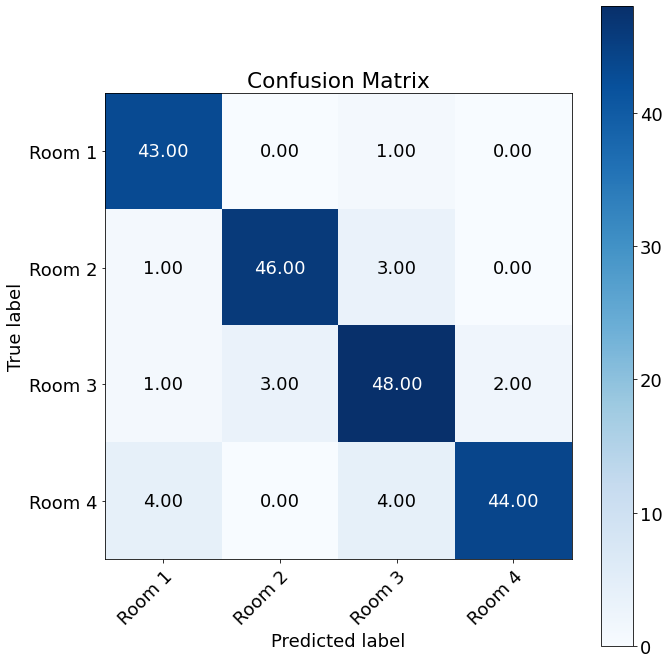

 
Outer Fold:1, Inner fold:8
Accuracy original: 0.83
Macro recall original: 0.831046361046361
Macro precision original: 0.8331856348160696
 


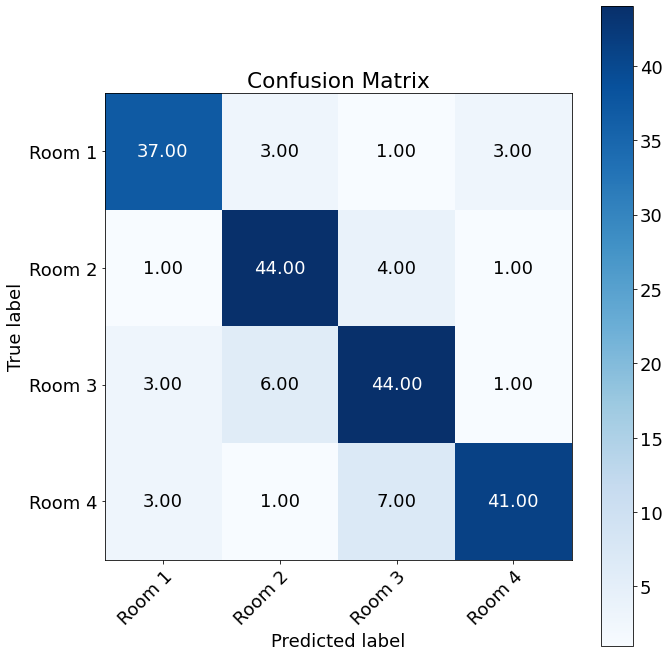

Accuracy pruned 1: 0.9
Macro recall pruned 1: 0.9027674177674178
Macro precision pruned 1: 0.9014345658367398


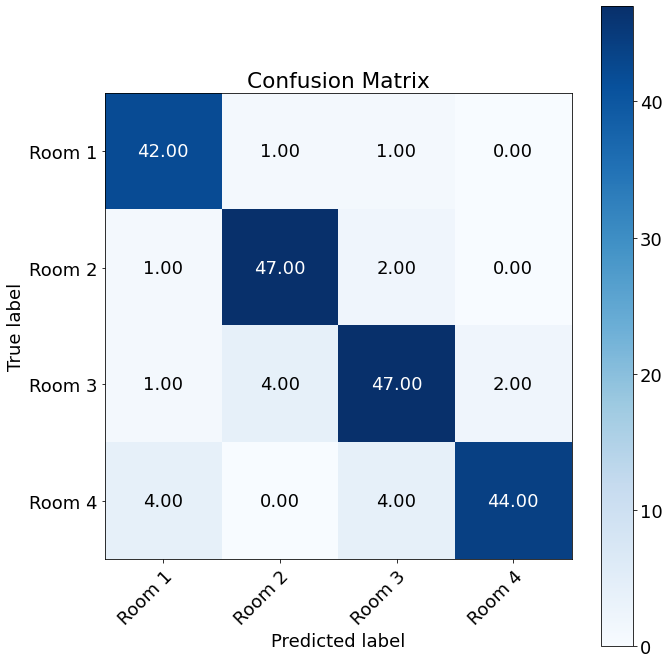

 
Accuracy pruned 2: 0.9
Macro recall pruned 2: 0.9027674177674178
Macro precision pruned 2: 0.9014345658367398


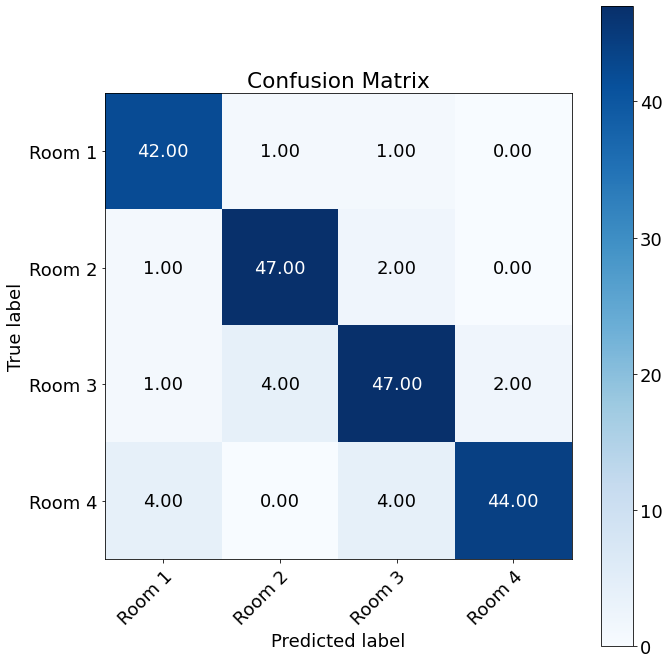

 
Outer Fold:1, Inner fold:9
Accuracy original: 0.8
Macro recall original: 0.7990883190883191
Macro precision original: 0.80166815942678
 


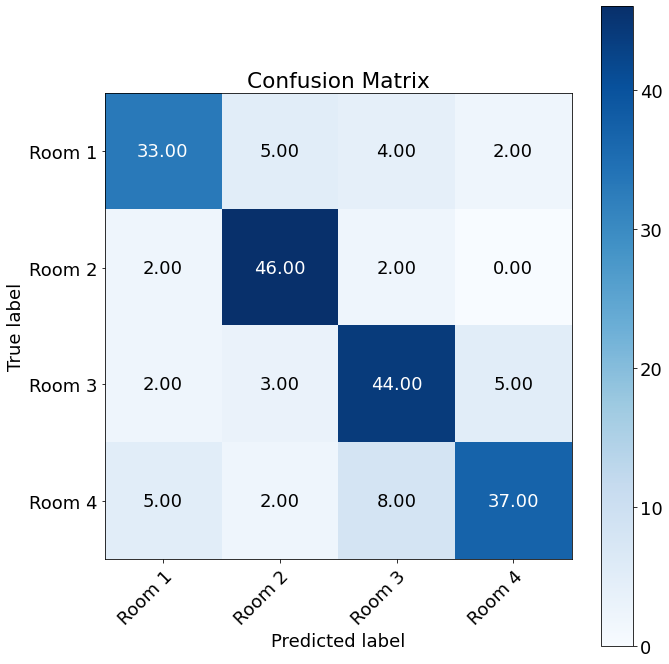

Accuracy pruned 1: 0.895
Macro recall pruned 1: 0.8988196063196064
Macro precision pruned 1: 0.896438127090301


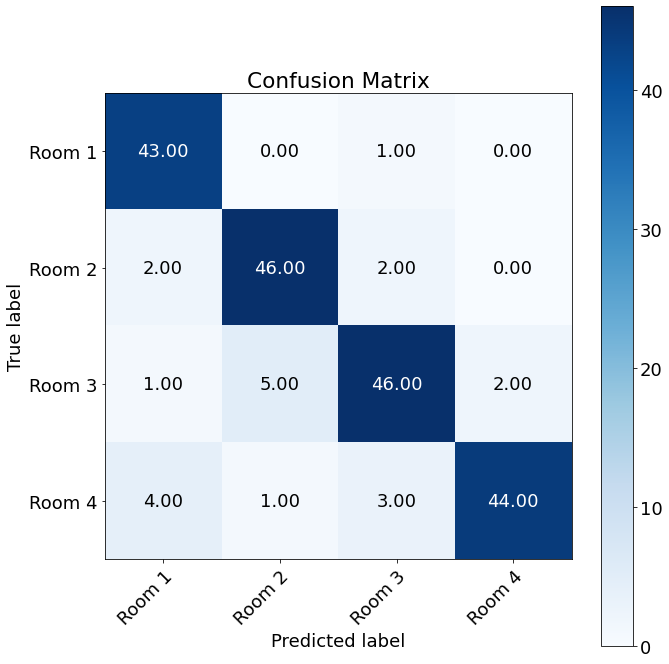

 
Accuracy pruned 2: 0.895
Macro recall pruned 2: 0.8988196063196064
Macro precision pruned 2: 0.896438127090301


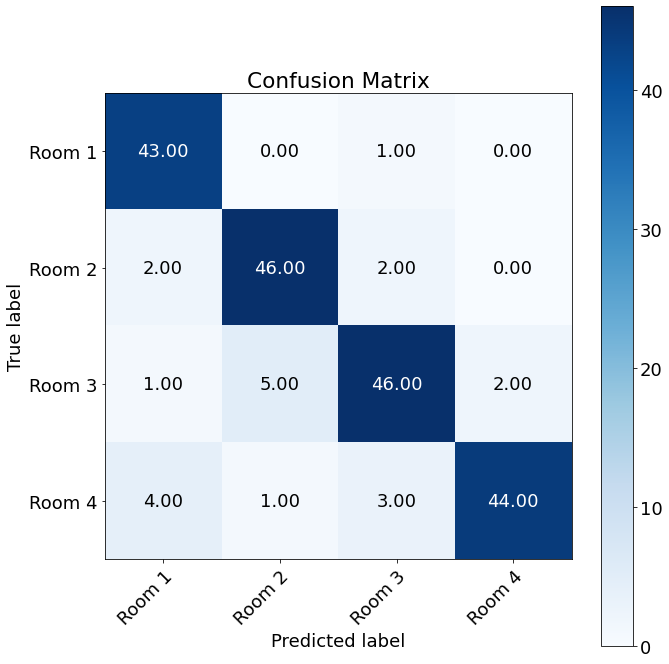

 
Outer Fold:1, Inner fold:10
Accuracy original: 0.825
Macro recall original: 0.8287276612276613
Macro precision original: 0.8323675935120822
 


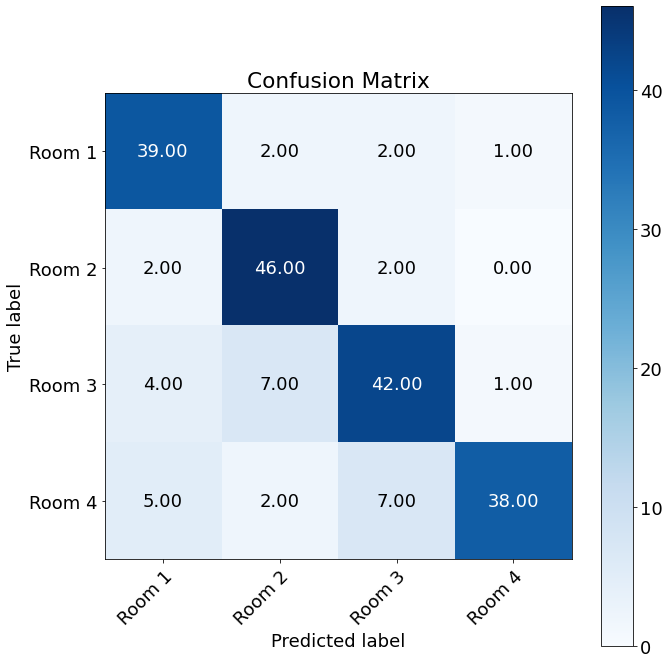

Accuracy pruned 1: 0.89
Macro recall pruned 1: 0.894560347060347
Macro precision pruned 1: 0.8915625614794414


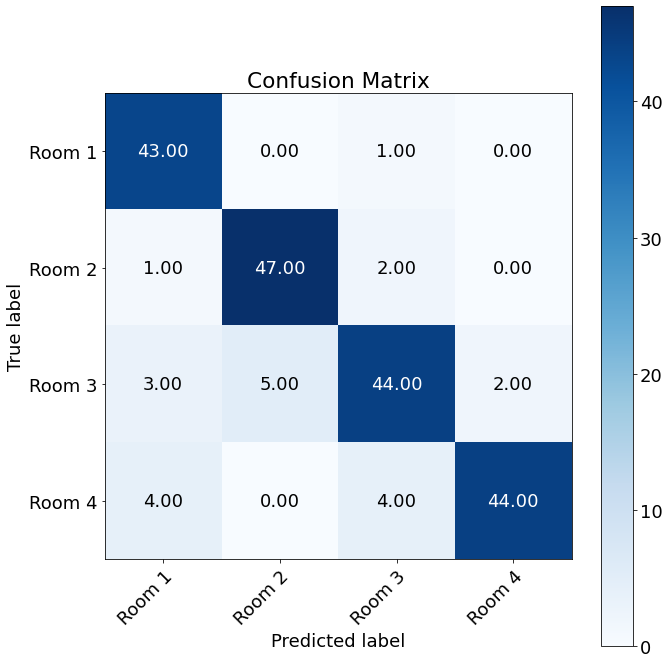

 
Accuracy pruned 2: 0.89
Macro recall pruned 2: 0.894560347060347
Macro precision pruned 2: 0.8915625614794414


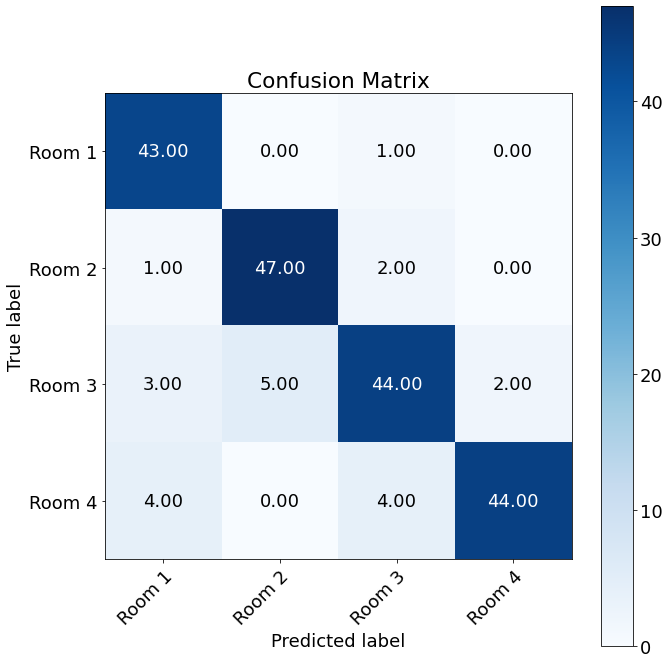

 
Outer Fold:2, Inner fold:1
Accuracy original: 0.75
Macro recall original: 0.7480688170979073
Macro precision original: 0.7481150793650795
 


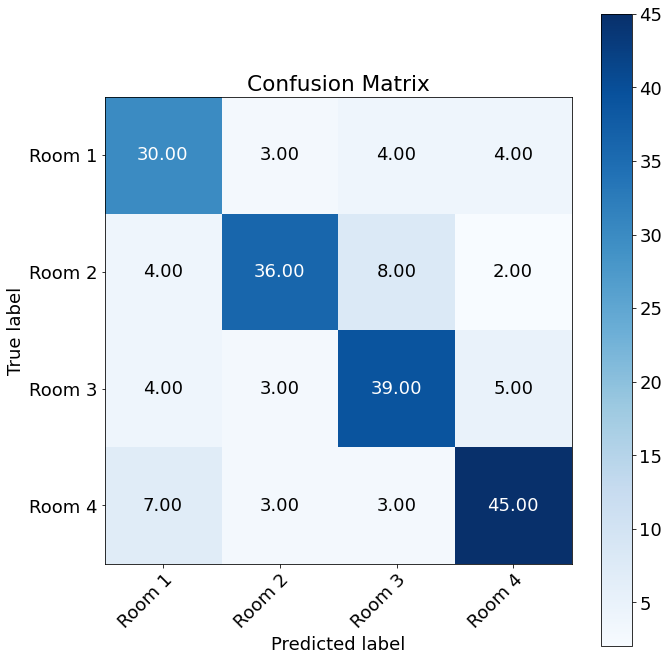

Accuracy pruned 1: 0.845
Macro recall pruned 1: 0.8434349181220008
Macro precision pruned 1: 0.8453880136700842


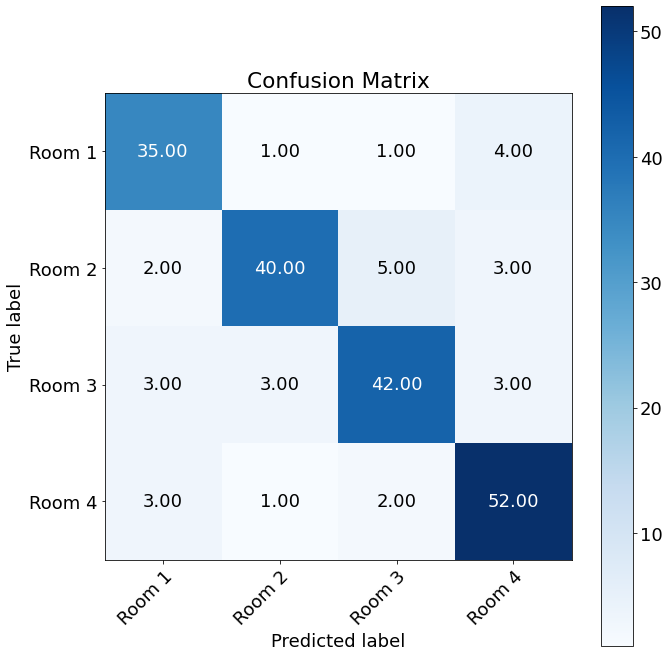

 
Accuracy pruned 2: 0.845
Macro recall pruned 2: 0.8434349181220008
Macro precision pruned 2: 0.8453880136700842


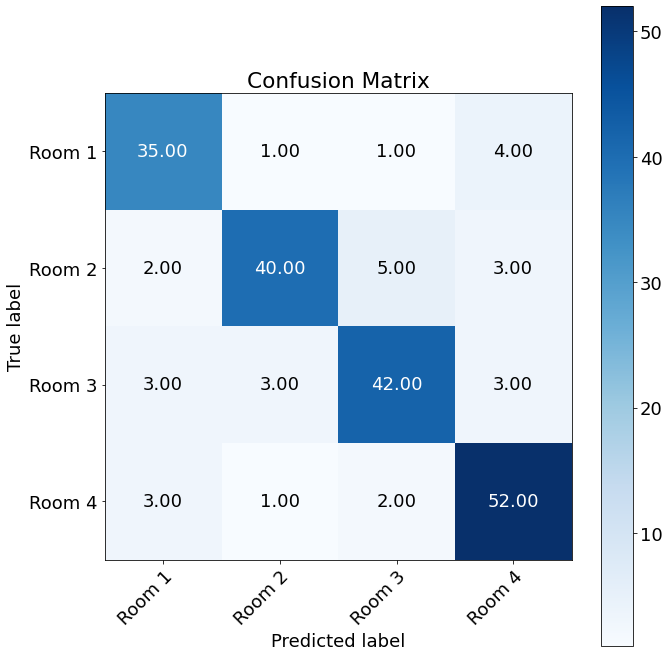

 
Outer Fold:2, Inner fold:2
Accuracy original: 0.76
Macro recall original: 0.756367271887729
Macro precision original: 0.7578402605263985
 


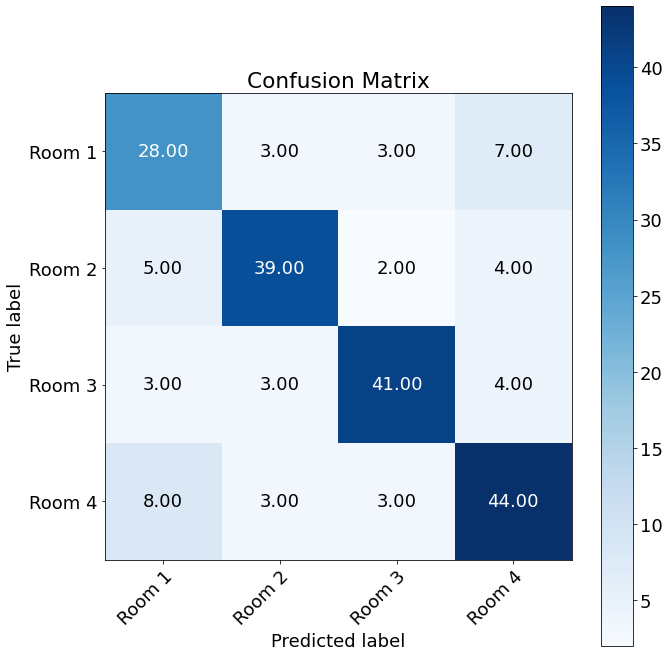

Accuracy pruned 1: 0.85
Macro recall pruned 1: 0.8471412787150184
Macro precision pruned 1: 0.8518143896096184


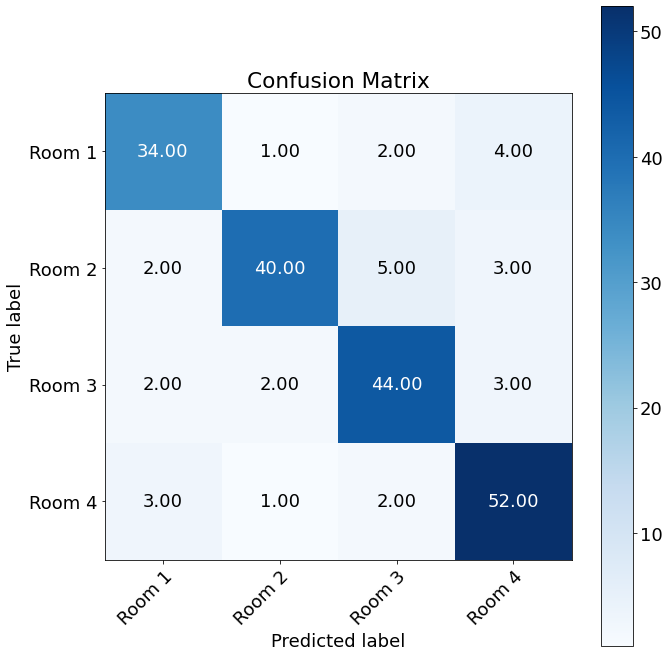

 
Accuracy pruned 2: 0.85
Macro recall pruned 2: 0.8471412787150184
Macro precision pruned 2: 0.8518143896096184


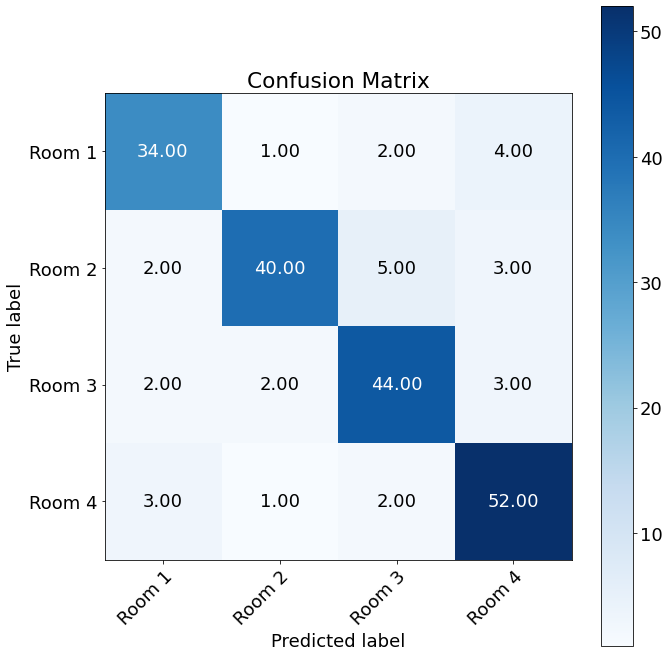

 
Outer Fold:2, Inner fold:3
Accuracy original: 0.795
Macro recall original: 0.7913097181681756
Macro precision original: 0.7979013480392156
 


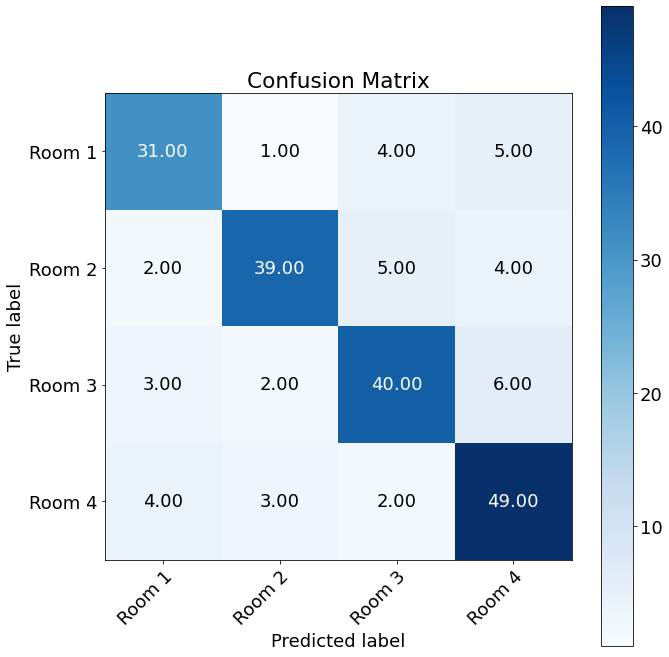

Accuracy pruned 1: 0.835
Macro recall pruned 1: 0.8327328946717459
Macro precision pruned 1: 0.8415489838547341


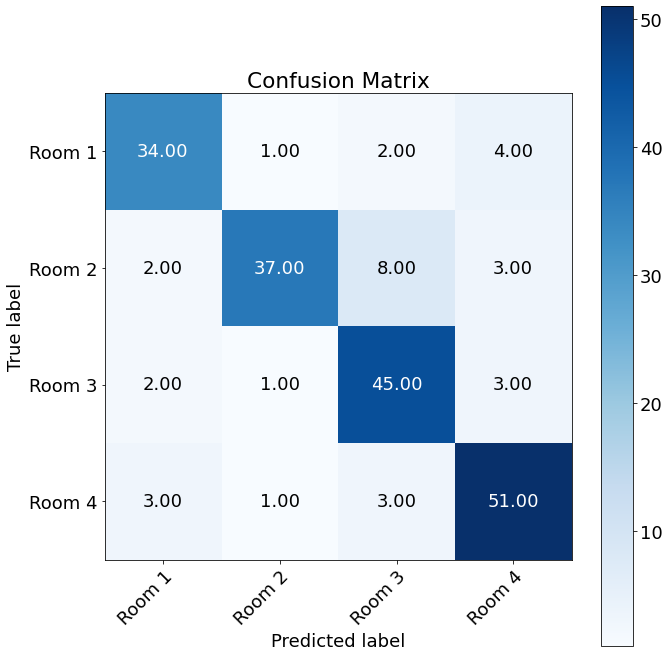

 
Accuracy pruned 2: 0.835
Macro recall pruned 2: 0.8327328946717459
Macro precision pruned 2: 0.8415489838547341


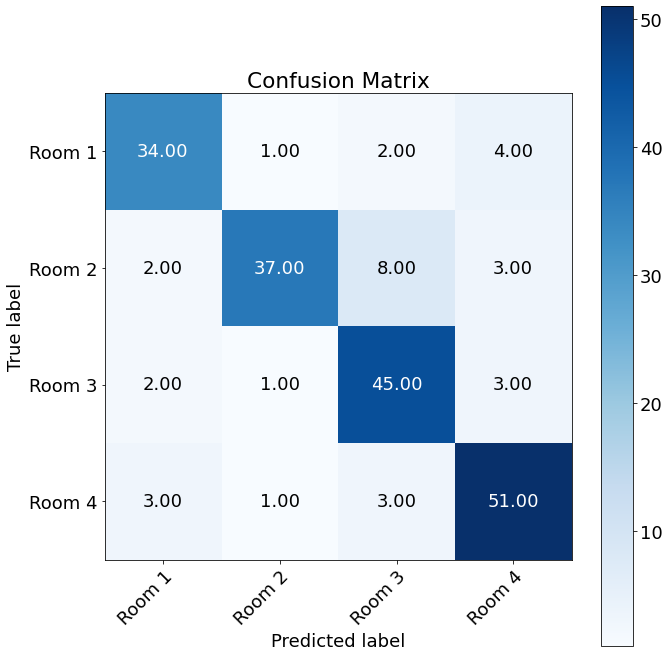

 
Outer Fold:2, Inner fold:4
Accuracy original: 0.775
Macro recall original: 0.7754881346987912
Macro precision original: 0.7785997732426304
 


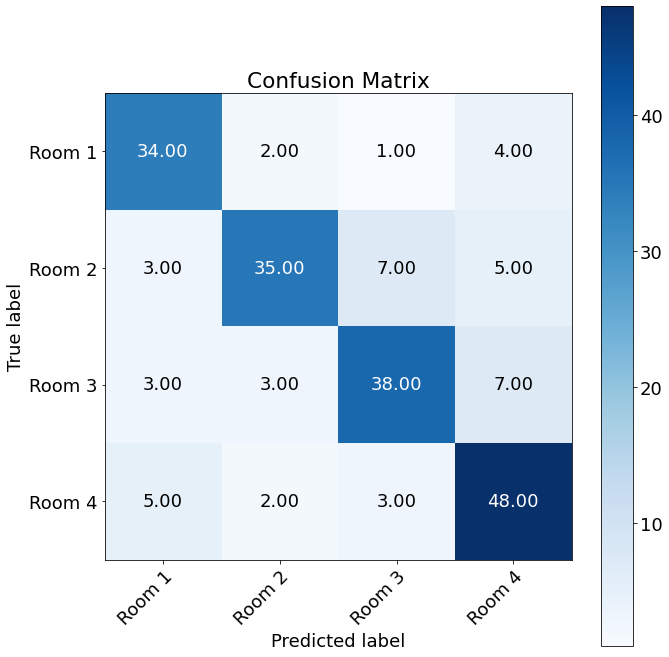

Accuracy pruned 1: 0.84
Macro recall pruned 1: 0.8392226125101008
Macro precision pruned 1: 0.8445135345804988


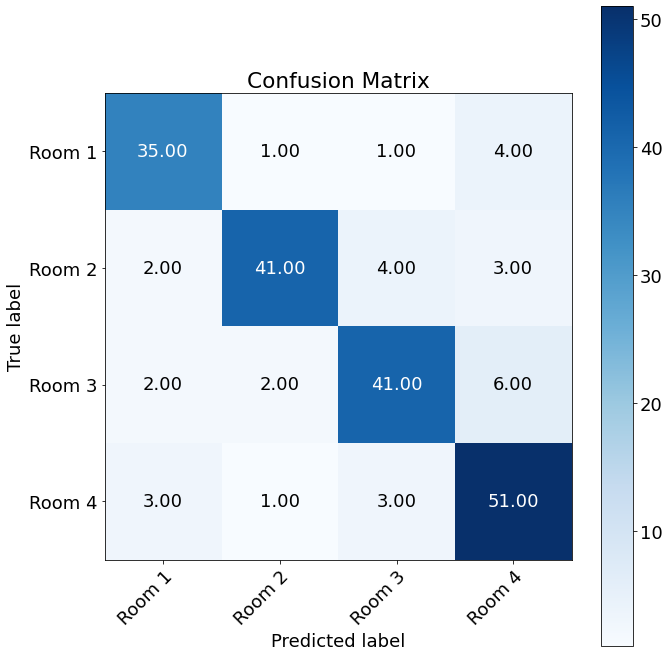

 
Accuracy pruned 2: 0.84
Macro recall pruned 2: 0.8392226125101008
Macro precision pruned 2: 0.8445135345804988


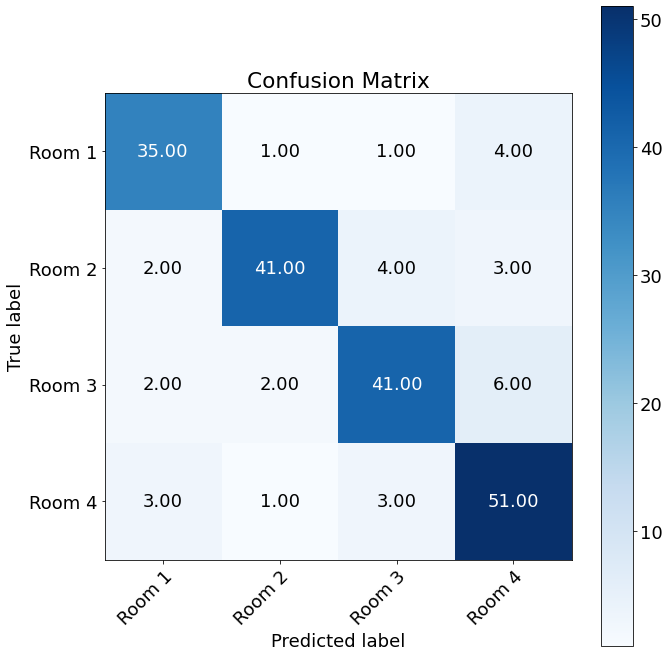

 
Outer Fold:2, Inner fold:5
Accuracy original: 0.76
Macro recall original: 0.7611496726529132
Macro precision original: 0.7589047644959926
 


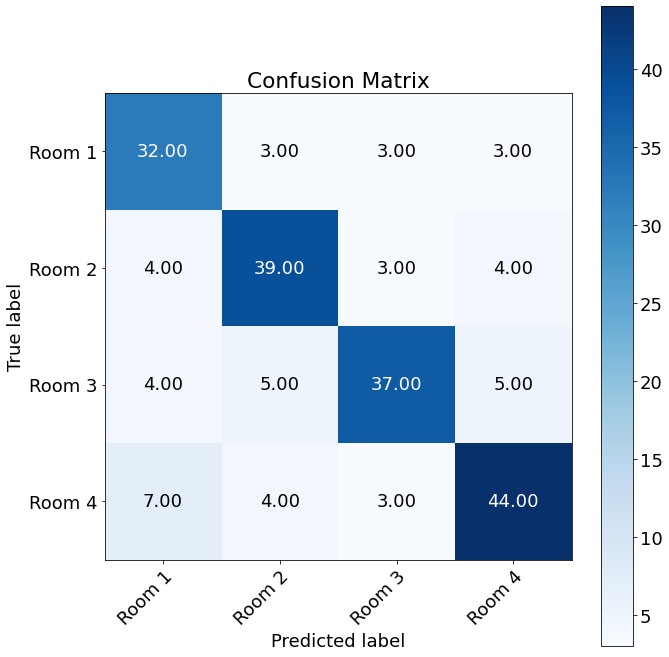

Accuracy pruned 1: 0.87
Macro recall pruned 1: 0.8683368789063144
Macro precision pruned 1: 0.8714033745590548


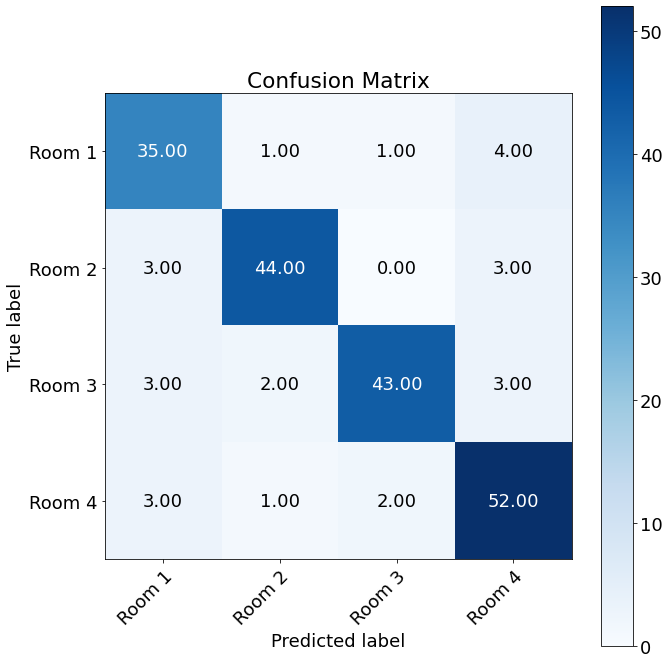

 
Accuracy pruned 2: 0.87
Macro recall pruned 2: 0.8683368789063144
Macro precision pruned 2: 0.8714033745590548


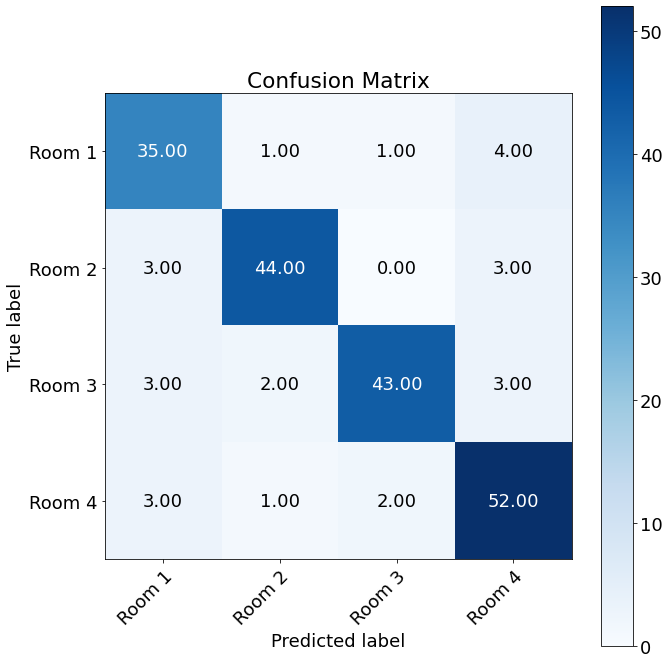

 
Outer Fold:2, Inner fold:6
Accuracy original: 0.785
Macro recall original: 0.779510133742311
Macro precision original: 0.7834635944638175
 


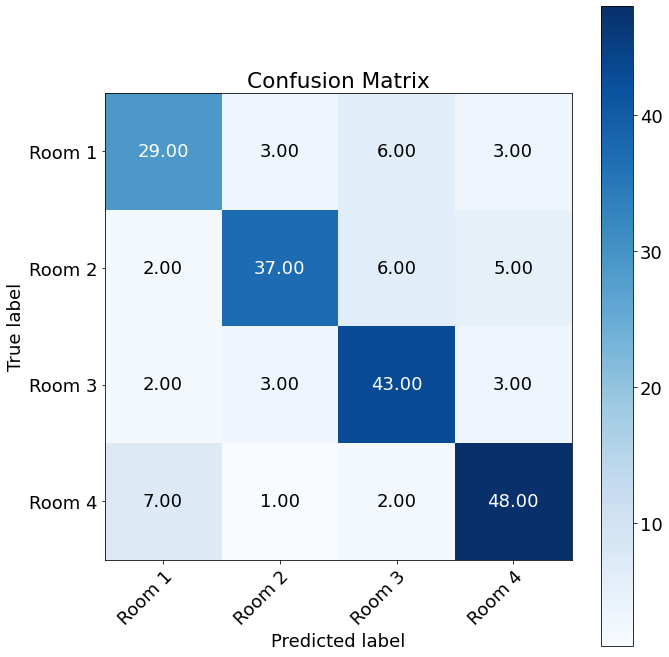

Accuracy pruned 1: 0.87
Macro recall pruned 1: 0.8682388396906281
Macro precision pruned 1: 0.8712239528618586


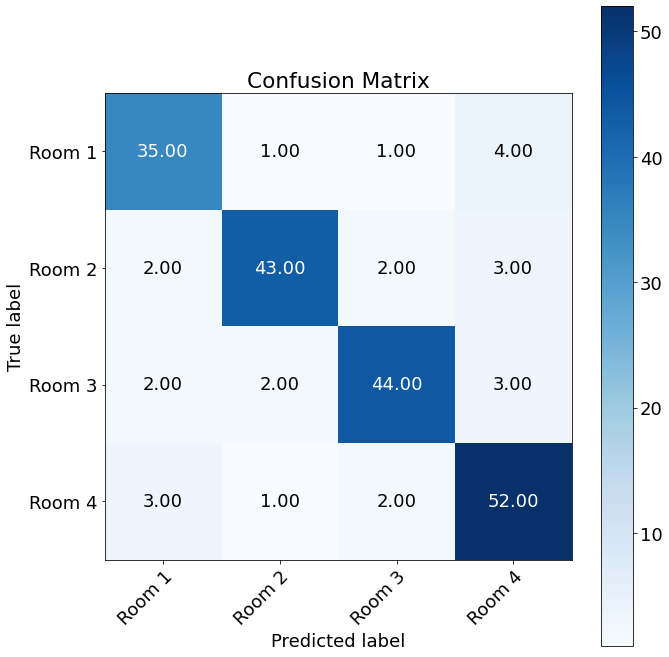

 
Accuracy pruned 2: 0.87
Macro recall pruned 2: 0.8682388396906281
Macro precision pruned 2: 0.8712239528618586


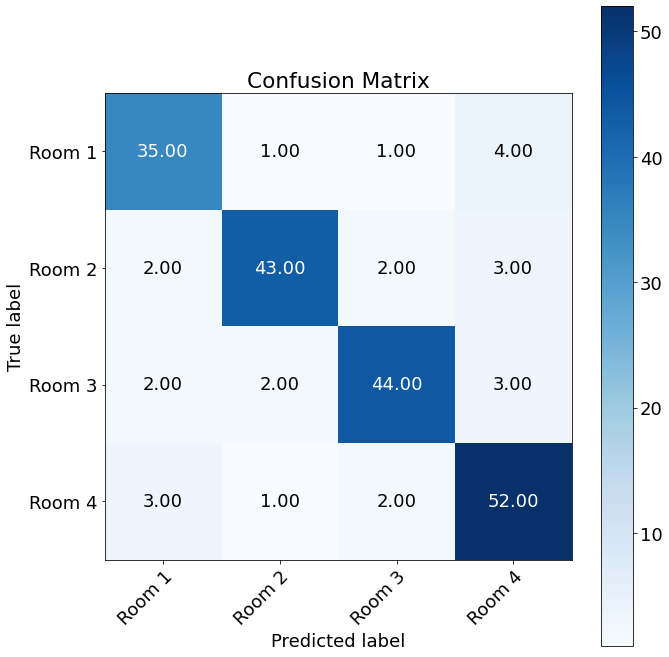

 
Outer Fold:2, Inner fold:7
Accuracy original: 0.78
Macro recall original: 0.781165421593364
Macro precision original: 0.7835513515751128
 


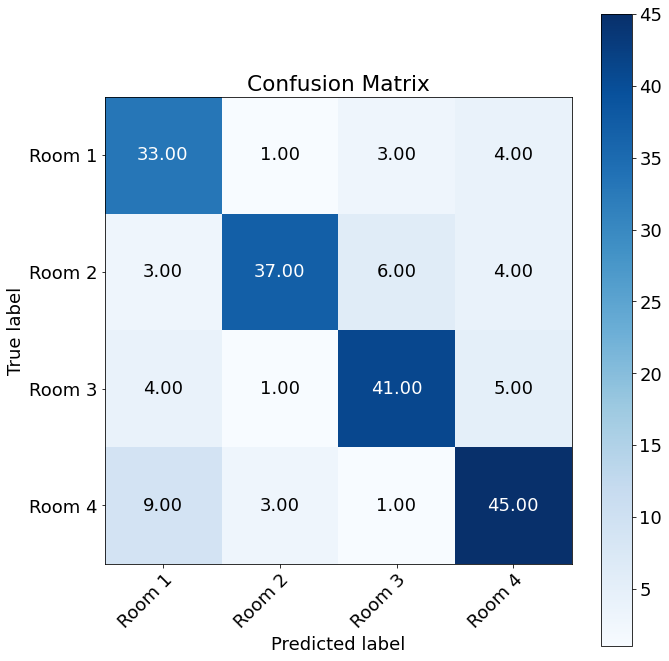

Accuracy pruned 1: 0.855
Macro recall pruned 1: 0.8541122050165735
Macro precision pruned 1: 0.8534278837838263


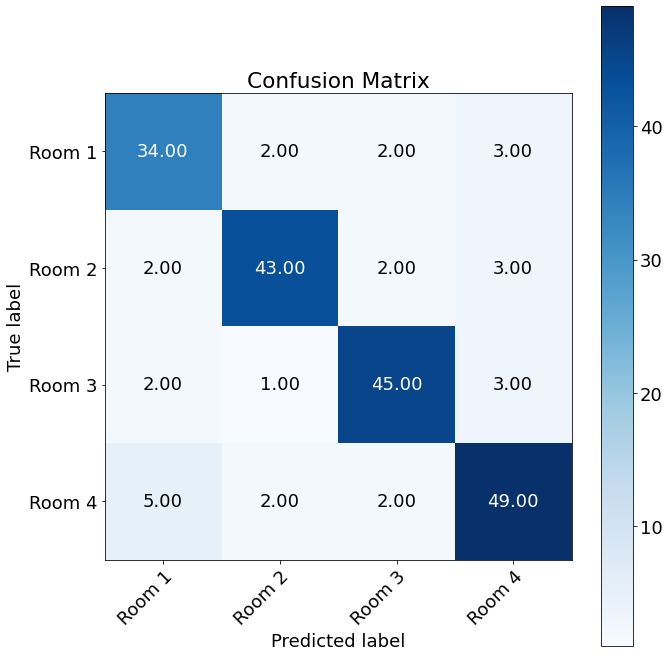

 
Accuracy pruned 2: 0.855
Macro recall pruned 2: 0.8541122050165735
Macro precision pruned 2: 0.8534278837838263


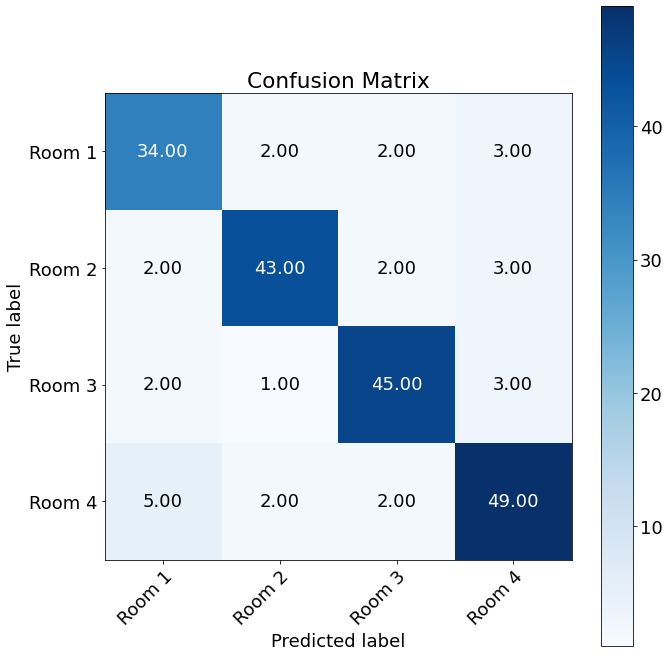

 
Outer Fold:2, Inner fold:8
Accuracy original: 0.78
Macro recall original: 0.7805614373587955
Macro precision original: 0.7779631947341584
 


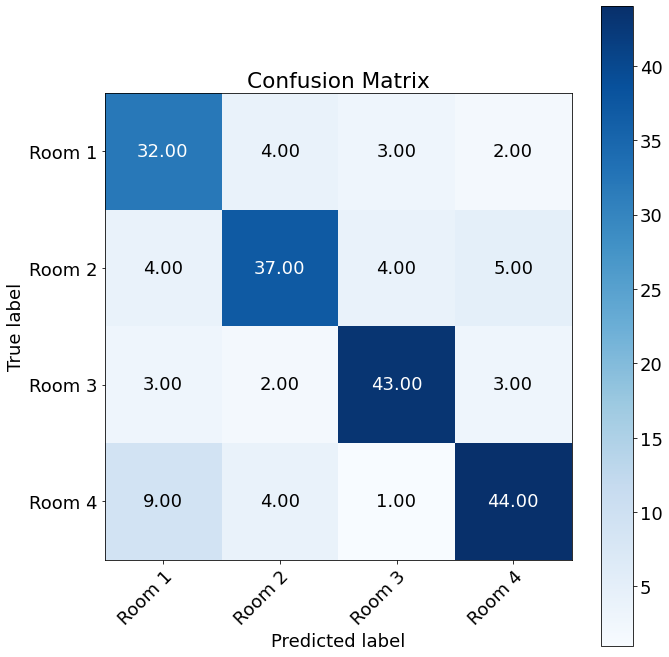

Accuracy pruned 1: 0.84
Macro recall pruned 1: 0.8403078052078696
Macro precision pruned 1: 0.8380803360506608


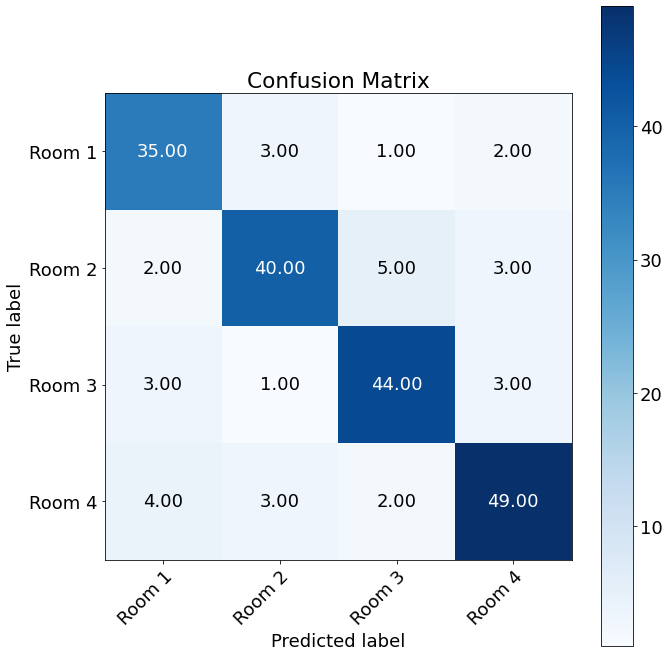

 
Accuracy pruned 2: 0.84
Macro recall pruned 2: 0.8403078052078696
Macro precision pruned 2: 0.8380803360506608


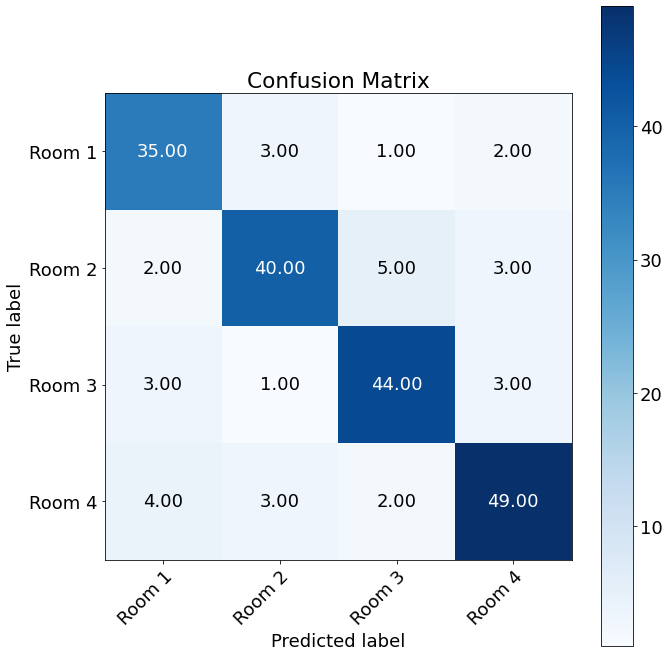

 
Outer Fold:2, Inner fold:9
Accuracy original: 0.78
Macro recall original: 0.7810673823776778
Macro precision original: 0.779957512667337
 


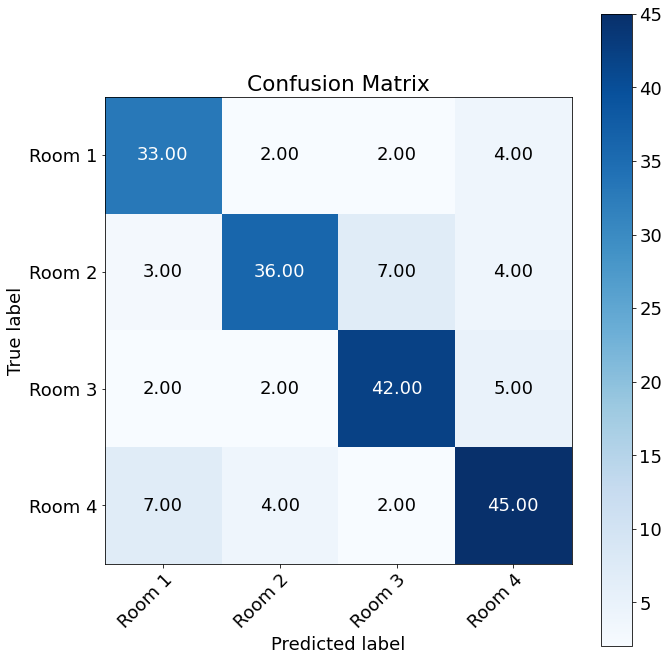

Accuracy pruned 1: 0.845
Macro recall pruned 1: 0.8399461567637989
Macro precision pruned 1: 0.8467655665945308


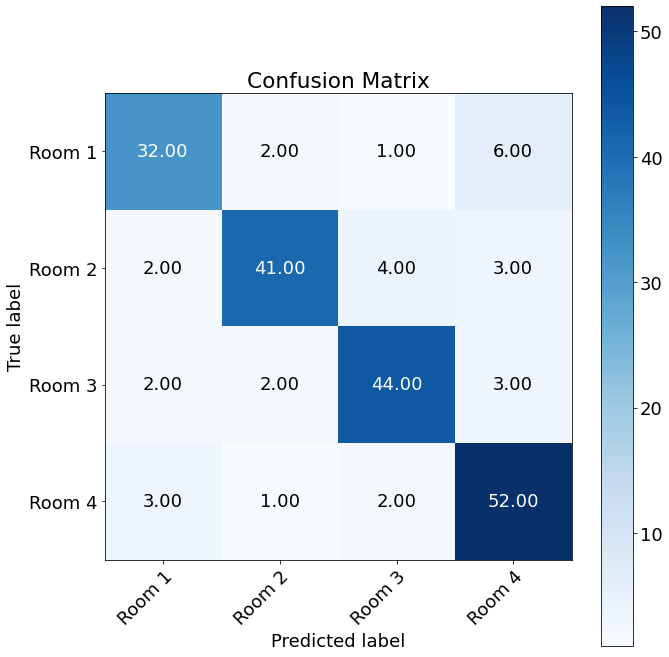

 
Accuracy pruned 2: 0.845
Macro recall pruned 2: 0.8399461567637989
Macro precision pruned 2: 0.8467655665945308


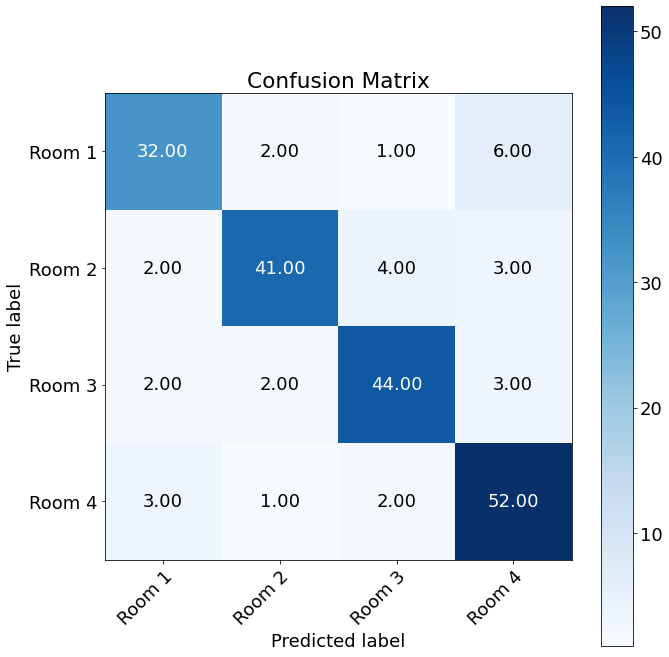

 
Outer Fold:2, Inner fold:10
Accuracy original: 0.765
Macro recall original: 0.762970777882221
Macro precision original: 0.7635851063059959
 


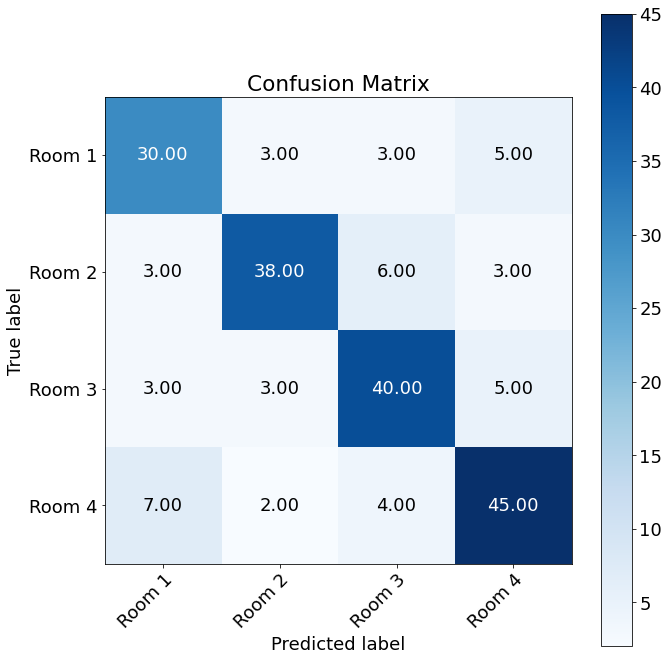

Accuracy pruned 1: 0.845
Macro recall pruned 1: 0.8428309338874322
Macro precision pruned 1: 0.8477821315451023


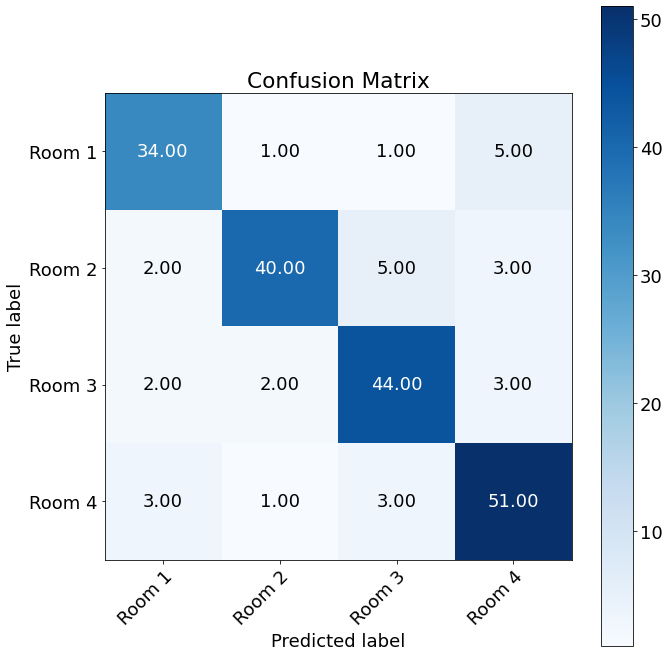

 
Accuracy pruned 2: 0.845
Macro recall pruned 2: 0.8428309338874322
Macro precision pruned 2: 0.8477821315451023


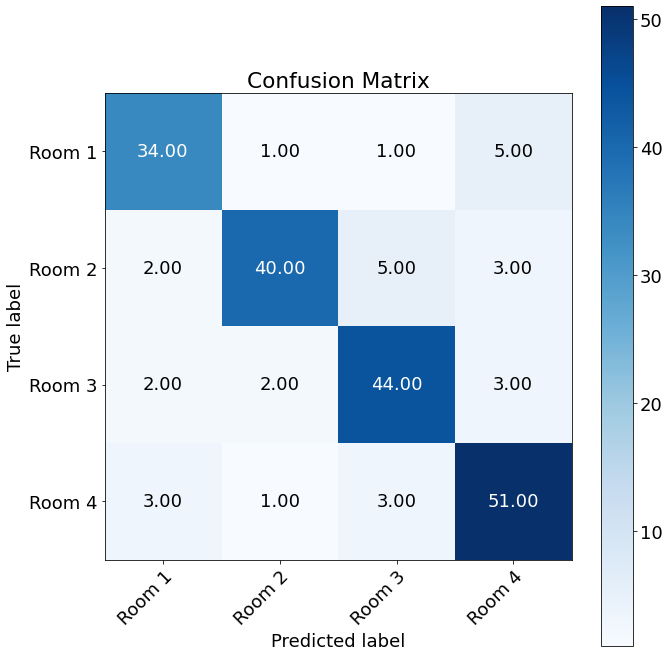

 
Outer Fold:3, Inner fold:1
Accuracy original: 0.785
Macro recall original: 0.7842976284651507
Macro precision original: 0.780819597069597
 


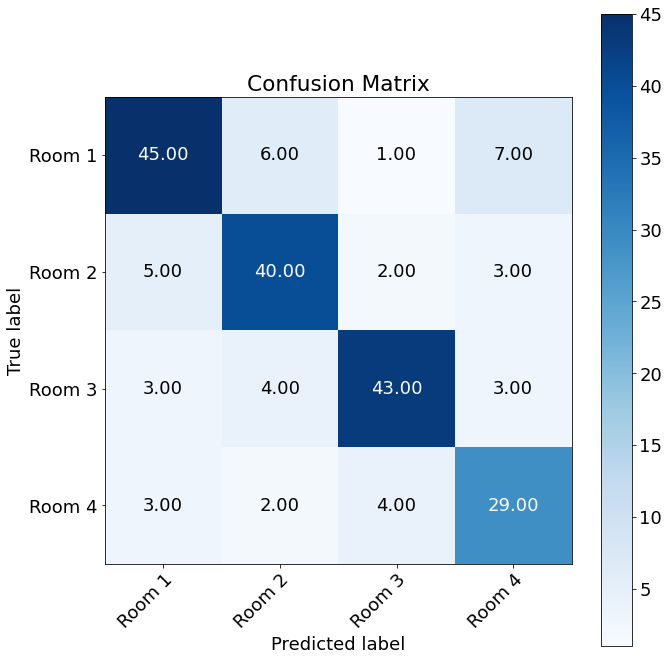

Accuracy pruned 1: 0.865
Macro recall pruned 1: 0.8586428054466195
Macro precision pruned 1: 0.8625267957820651


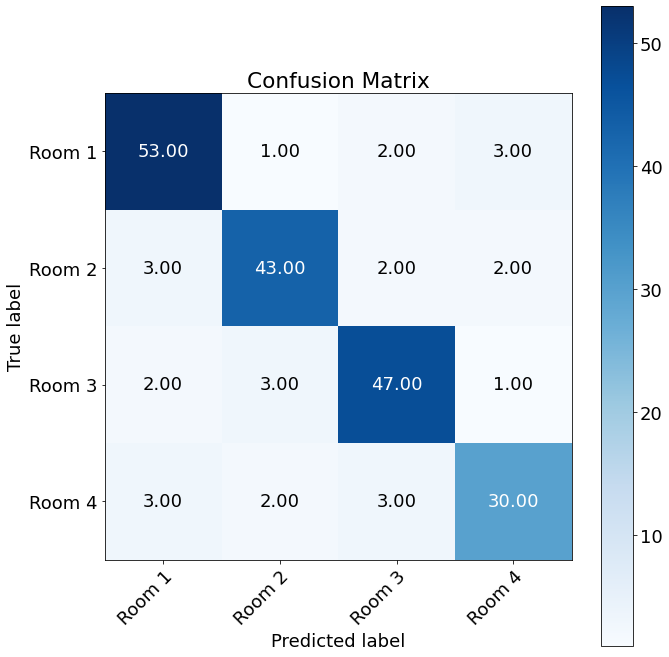

 
Accuracy pruned 2: 0.865
Macro recall pruned 2: 0.8586428054466195
Macro precision pruned 2: 0.8625267957820651


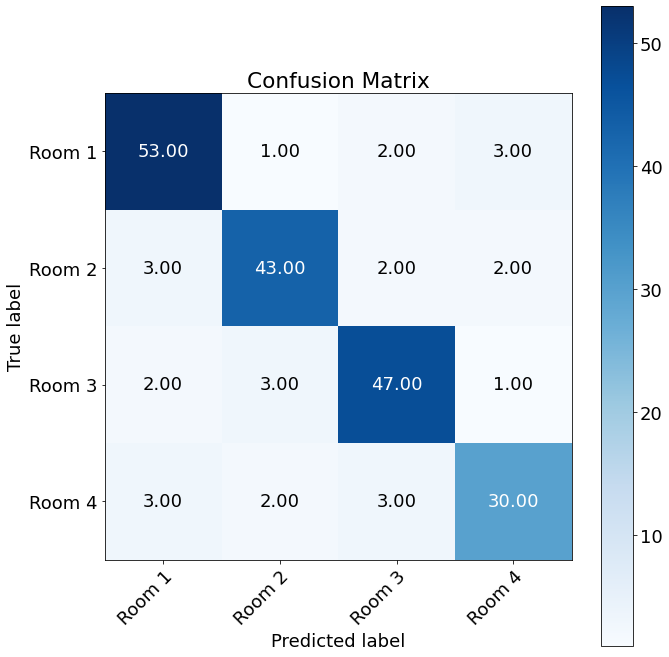

 
Outer Fold:3, Inner fold:2
Accuracy original: 0.795
Macro recall original: 0.795679901705014
Macro precision original: 0.7932806324110672
 


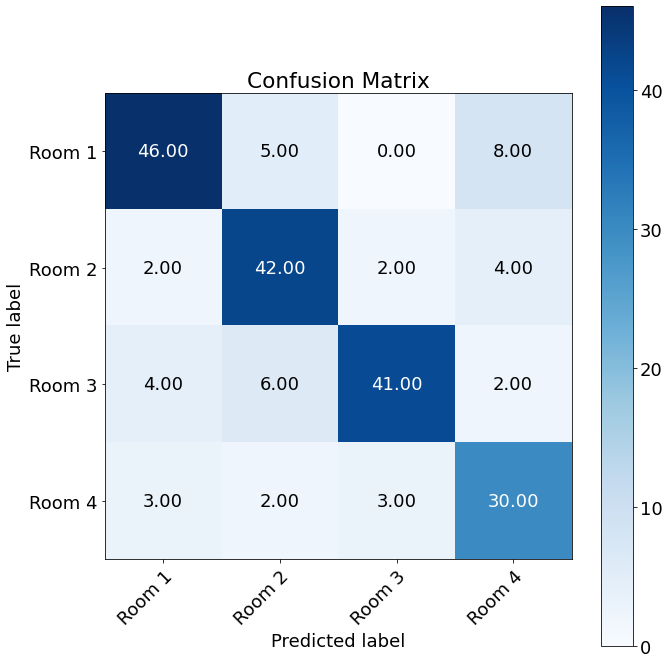

Accuracy pruned 1: 0.86
Macro recall pruned 1: 0.8593718546446063
Macro precision pruned 1: 0.8569179894179895


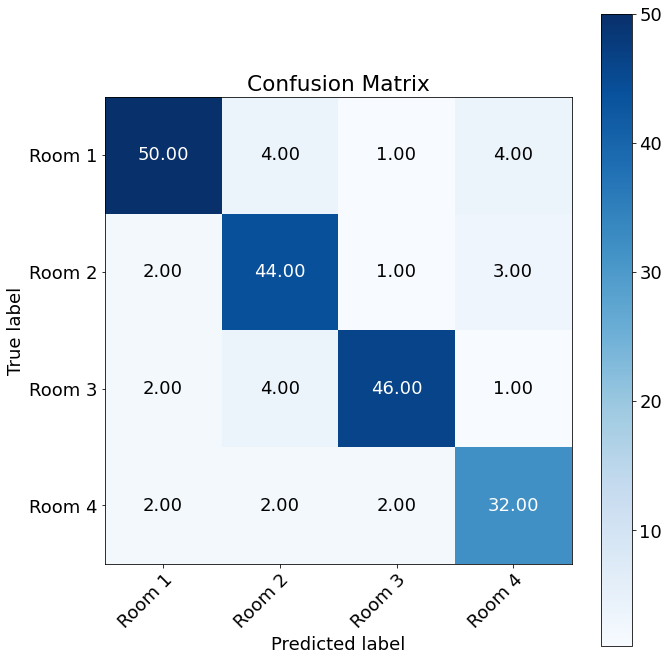

 
Accuracy pruned 2: 0.86
Macro recall pruned 2: 0.8593718546446063
Macro precision pruned 2: 0.8569179894179895


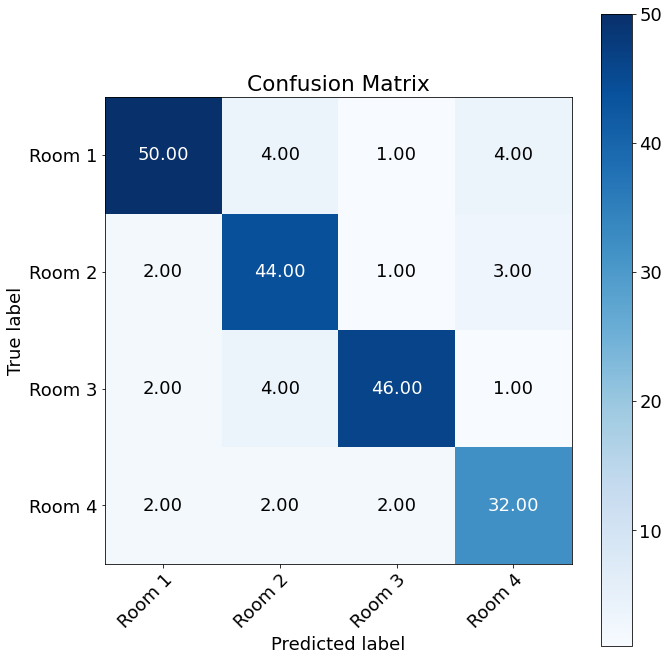

 
Outer Fold:3, Inner fold:3
Accuracy original: 0.745
Macro recall original: 0.7483406830155016
Macro precision original: 0.742820294963445
 


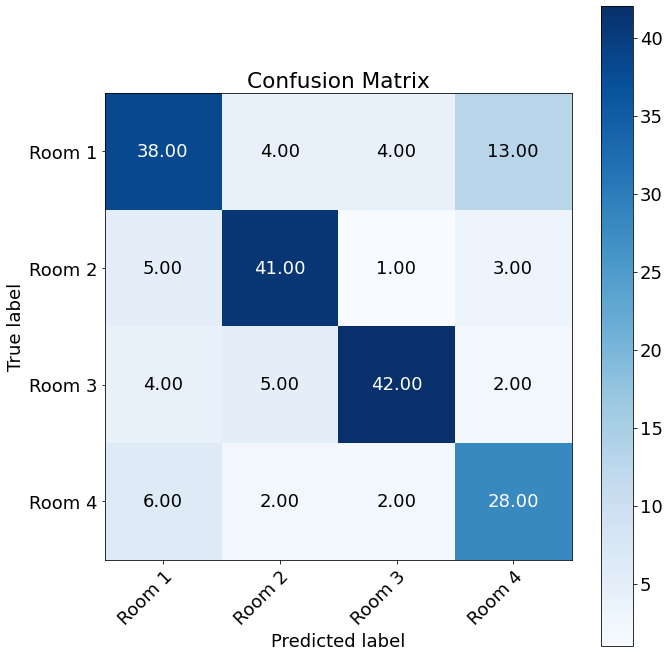

Accuracy pruned 1: 0.87
Macro recall pruned 1: 0.8668007001834616
Macro precision pruned 1: 0.8664096516690856


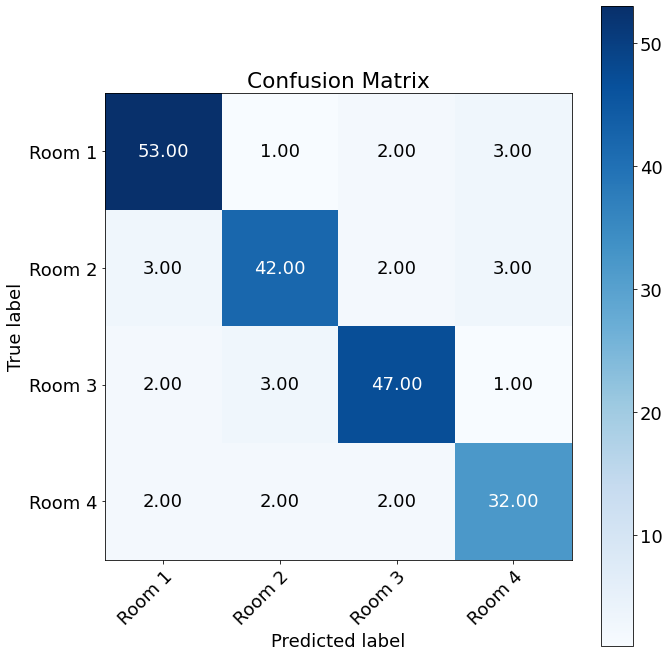

 
Accuracy pruned 2: 0.87
Macro recall pruned 2: 0.8668007001834616
Macro precision pruned 2: 0.8664096516690856


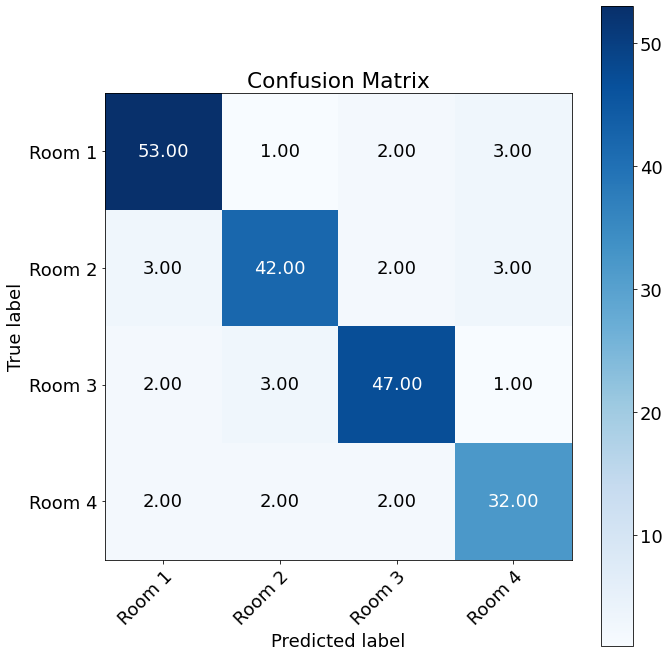

 
Outer Fold:3, Inner fold:4
Accuracy original: 0.82
Macro recall original: 0.8212666419807113
Macro precision original: 0.8178337012771211
 


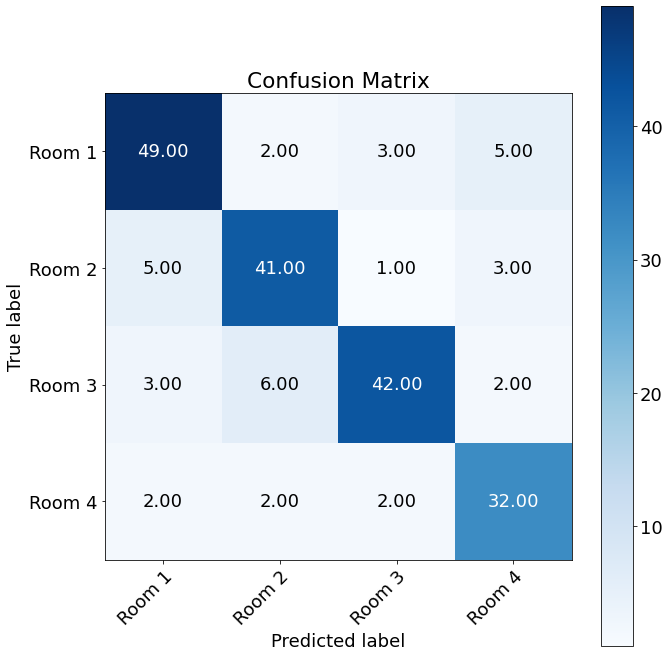

Accuracy pruned 1: 0.87
Macro recall pruned 1: 0.8668007001834616
Macro precision pruned 1: 0.8677022417153996


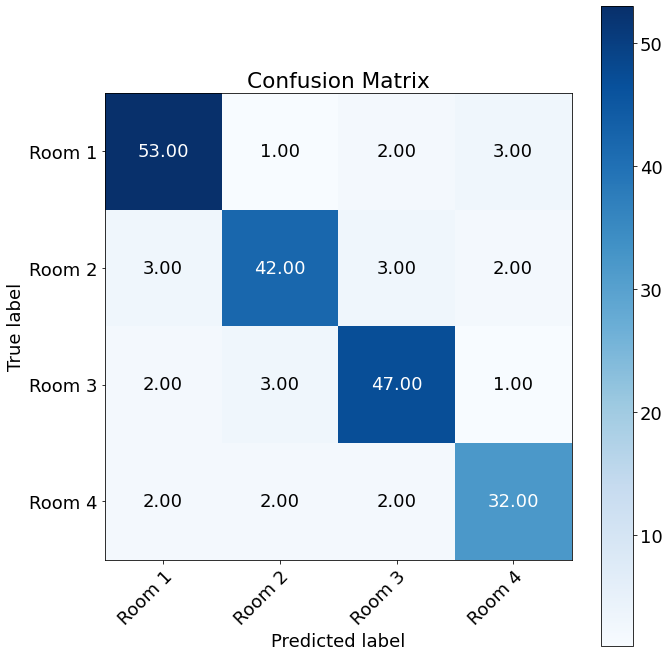

 
Accuracy pruned 2: 0.87
Macro recall pruned 2: 0.8668007001834616
Macro precision pruned 2: 0.8677022417153996


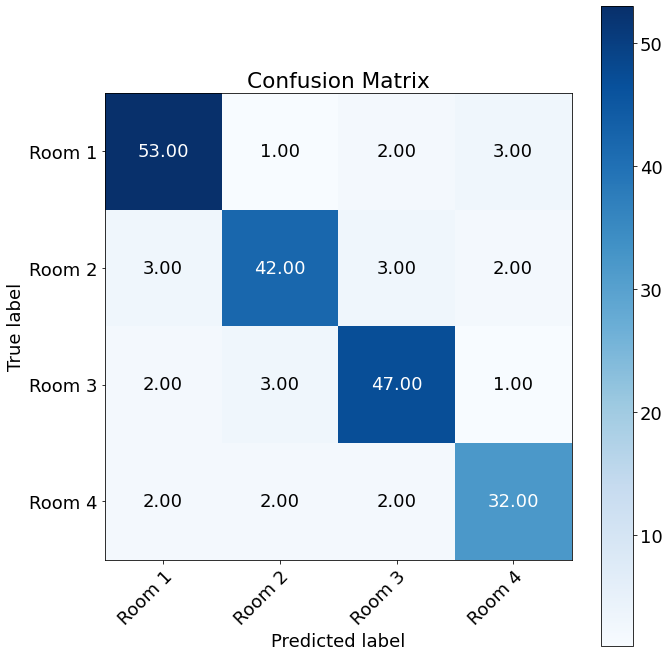

 
Outer Fold:3, Inner fold:5
Accuracy original: 0.76
Macro recall original: 0.7642104421591236
Macro precision original: 0.7569930069930069
 


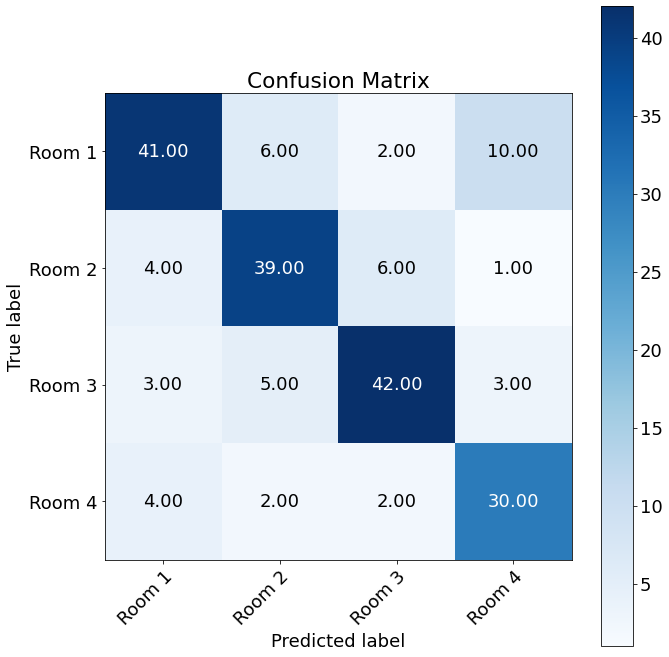

Accuracy pruned 1: 0.85
Macro recall pruned 1: 0.8501345665090132
Macro precision pruned 1: 0.8453800366300366


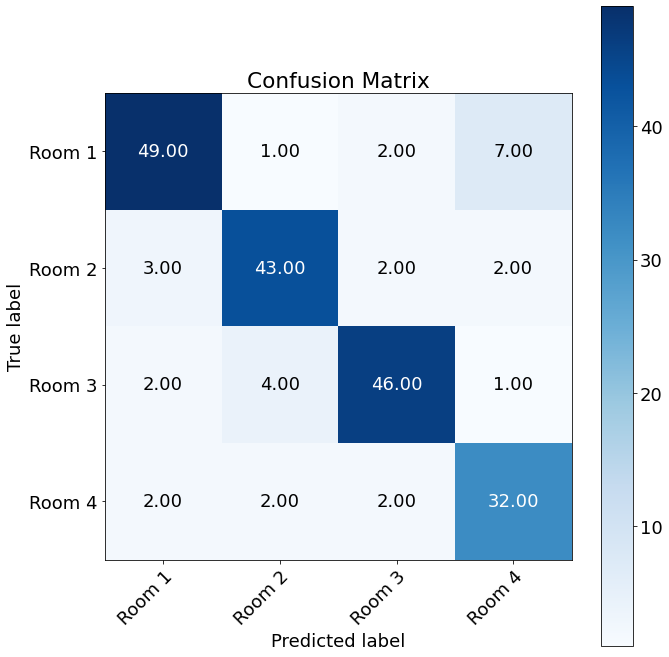

 
Accuracy pruned 2: 0.85
Macro recall pruned 2: 0.8501345665090132
Macro precision pruned 2: 0.8453800366300366


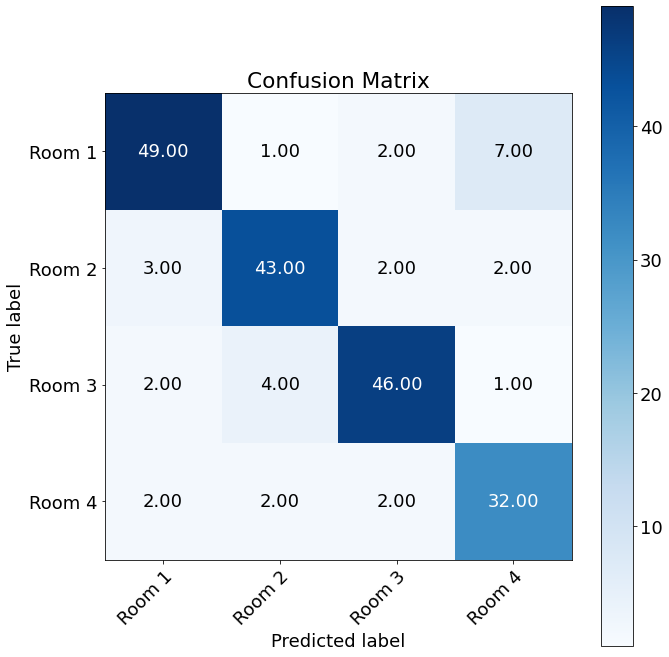

 
Outer Fold:3, Inner fold:6
Accuracy original: 0.76
Macro recall original: 0.762914513658627
Macro precision original: 0.7571167557932263
 


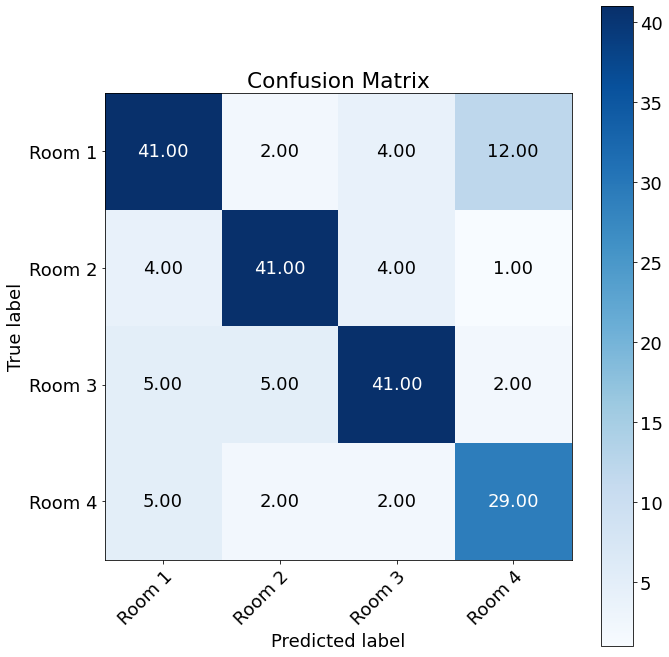

Accuracy pruned 1: 0.86
Macro recall pruned 1: 0.8565505024152964
Macro precision pruned 1: 0.857753041633734


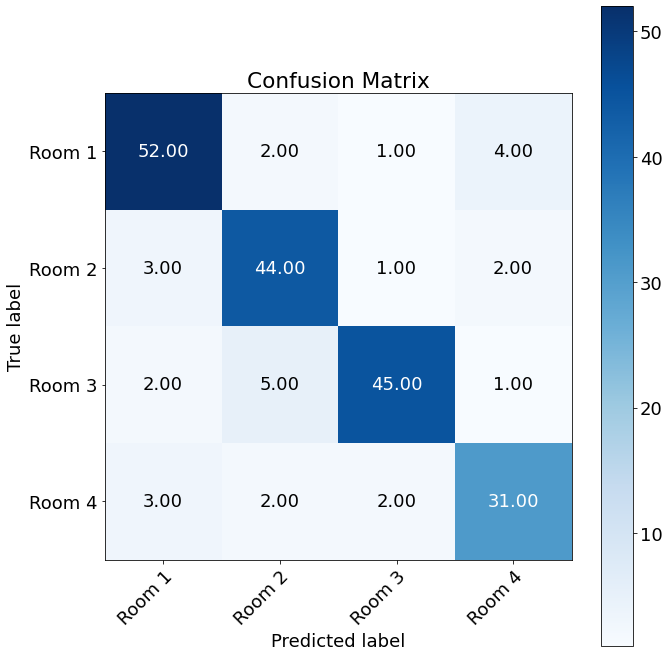

 
Accuracy pruned 2: 0.86
Macro recall pruned 2: 0.8565505024152964
Macro precision pruned 2: 0.857753041633734


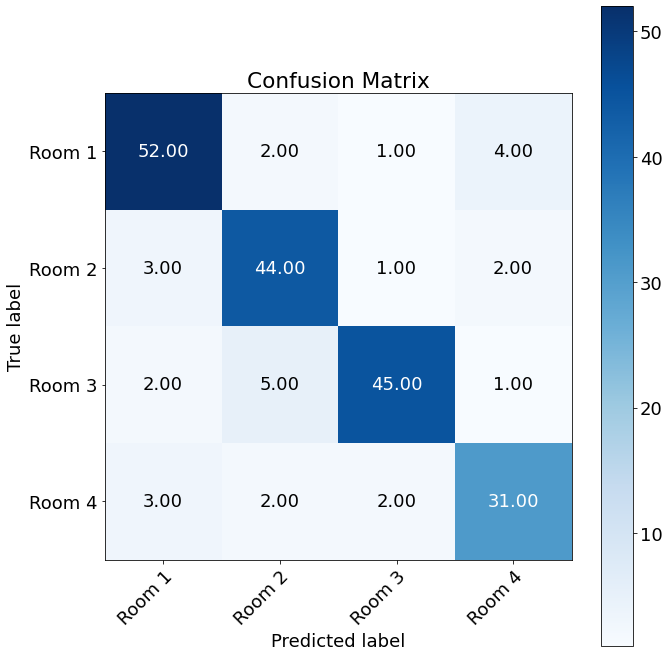

 
Outer Fold:3, Inner fold:7
Accuracy original: 0.78
Macro recall original: 0.7868886438994833
Macro precision original: 0.7808264166910783
 


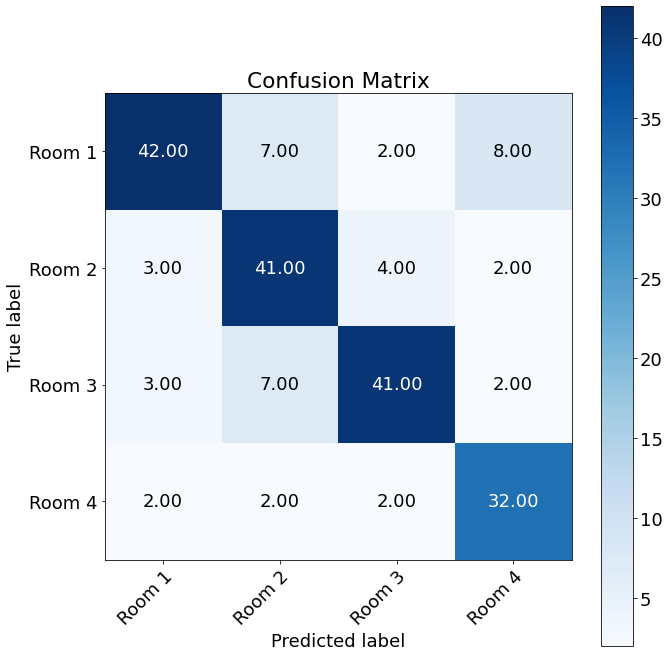

Accuracy pruned 1: 0.875
Macro recall pruned 1: 0.8728464309157928
Macro precision pruned 1: 0.8738925097246749


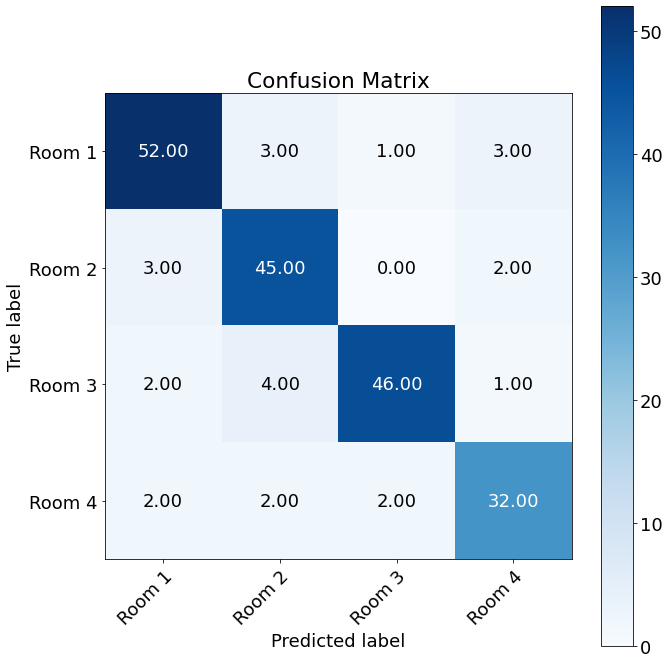

 
Accuracy pruned 2: 0.875
Macro recall pruned 2: 0.8728464309157928
Macro precision pruned 2: 0.8738925097246749


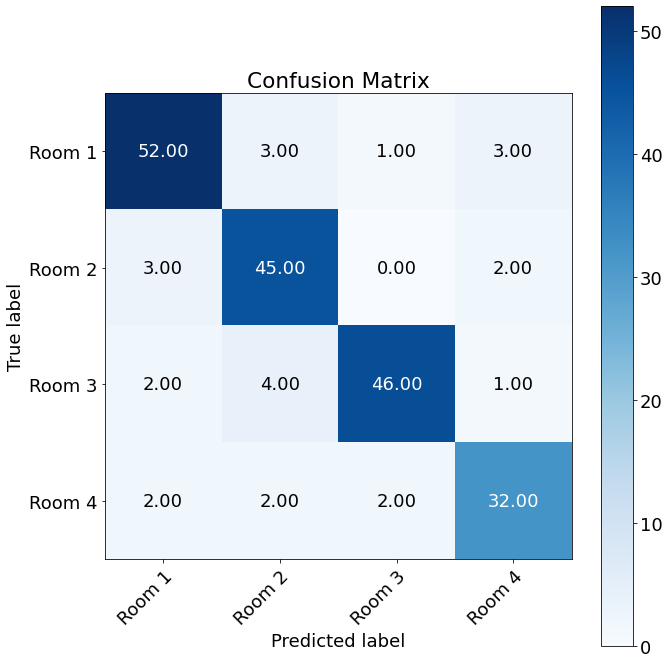

 
Outer Fold:3, Inner fold:8
Accuracy original: 0.775
Macro recall original: 0.7730016999646542
Macro precision original: 0.7697543640097548
 


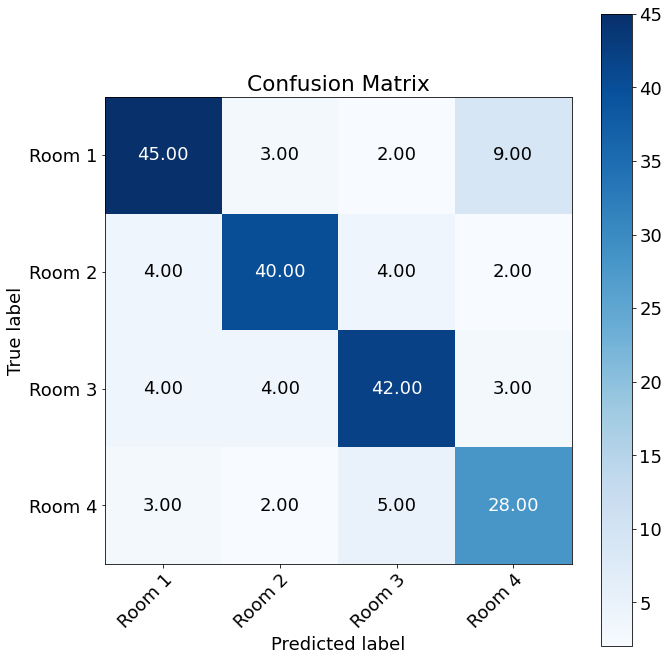

Accuracy pruned 1: 0.87
Macro recall pruned 1: 0.8675634120478684
Macro precision pruned 1: 0.8678456465349546


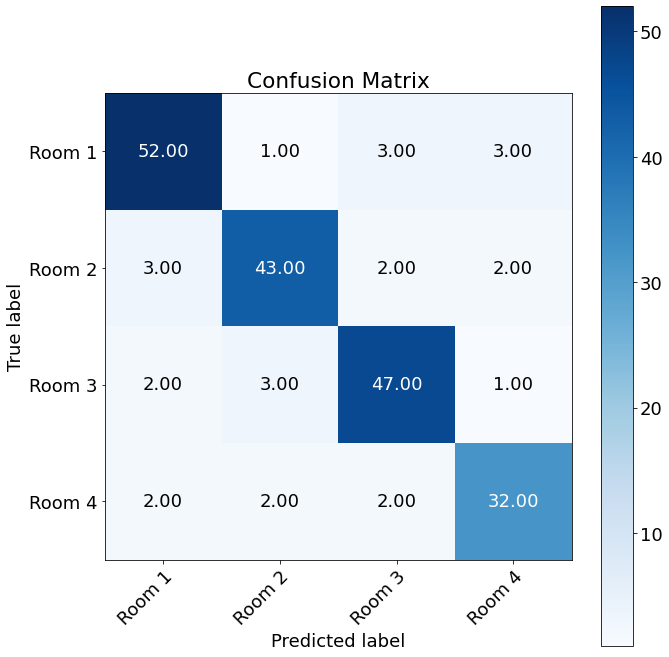

 
Accuracy pruned 2: 0.87
Macro recall pruned 2: 0.8675634120478684
Macro precision pruned 2: 0.8678456465349546


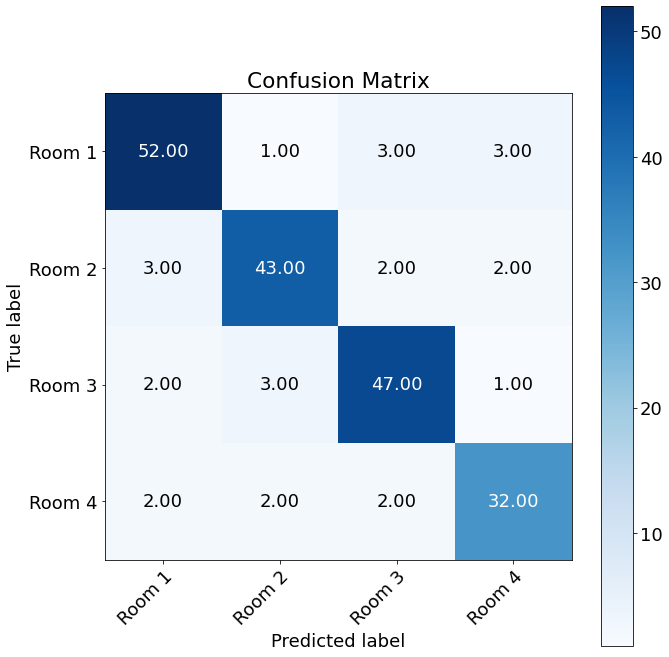

 
Outer Fold:3, Inner fold:9
Accuracy original: 0.775
Macro recall original: 0.7782510561661589
Macro precision original: 0.7734207319291352
 


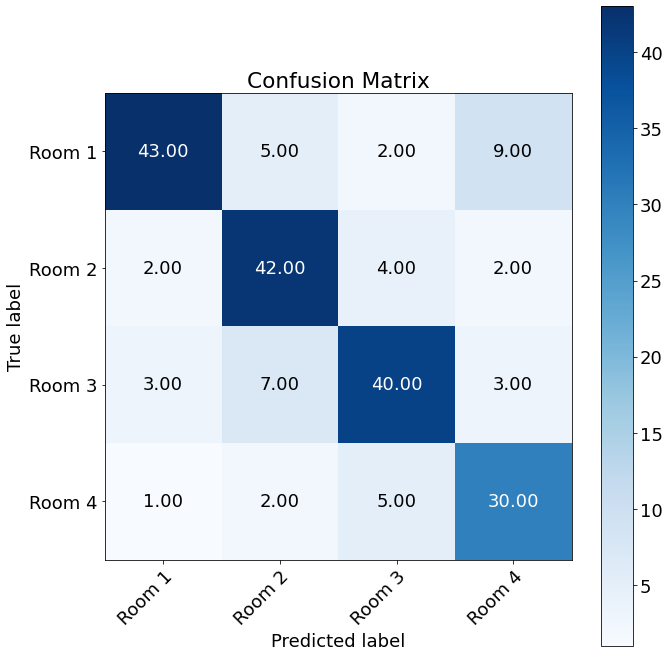

Accuracy pruned 1: 0.86
Macro recall pruned 1: 0.8557877905508896
Macro precision pruned 1: 0.8587573721729319


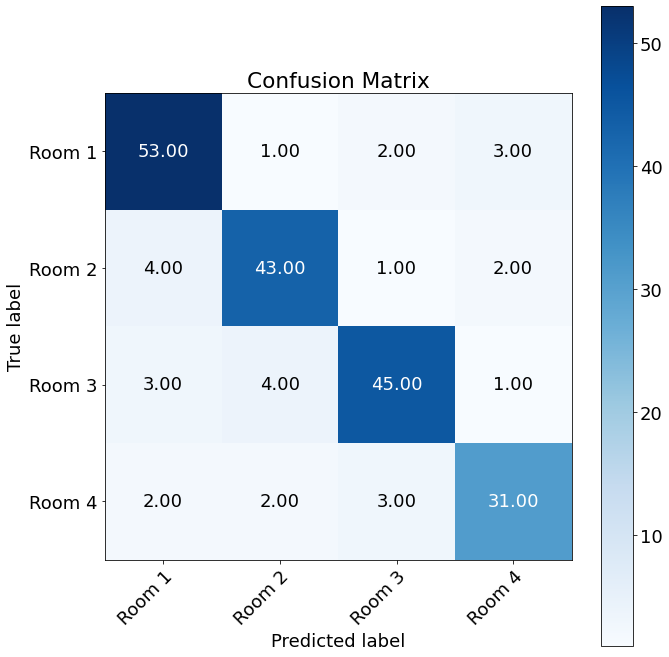

 
Accuracy pruned 2: 0.86
Macro recall pruned 2: 0.8557877905508896
Macro precision pruned 2: 0.8587573721729319


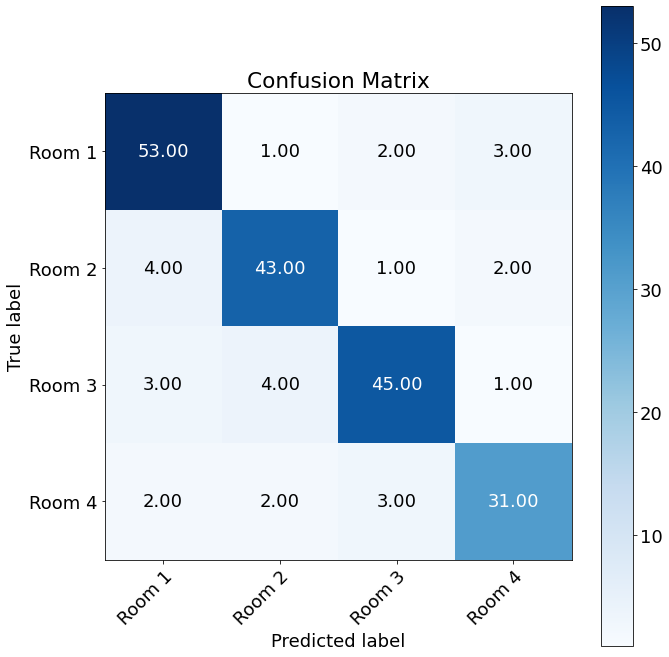

 
Outer Fold:3, Inner fold:10
Accuracy original: 0.825
Macro recall original: 0.828608301213539
Macro precision original: 0.8240843490826429
 


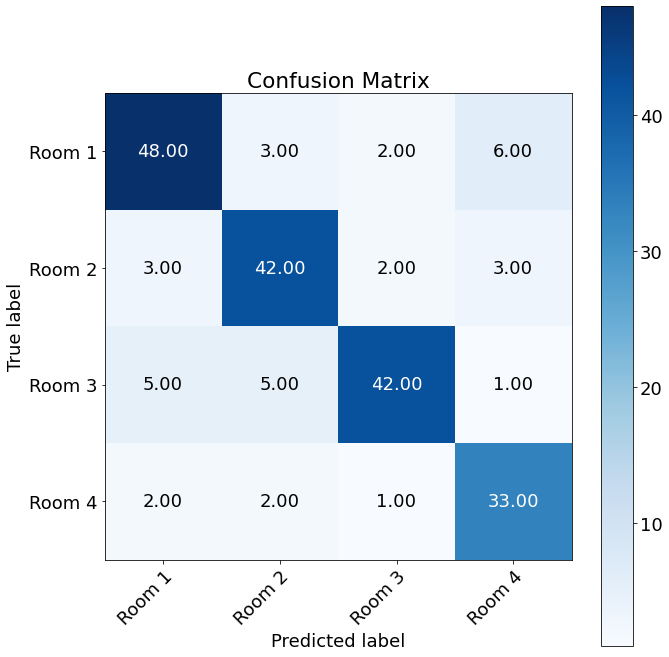

Accuracy pruned 1: 0.865
Macro recall pruned 1: 0.8638921616481241
Macro precision pruned 1: 0.8665284963006638


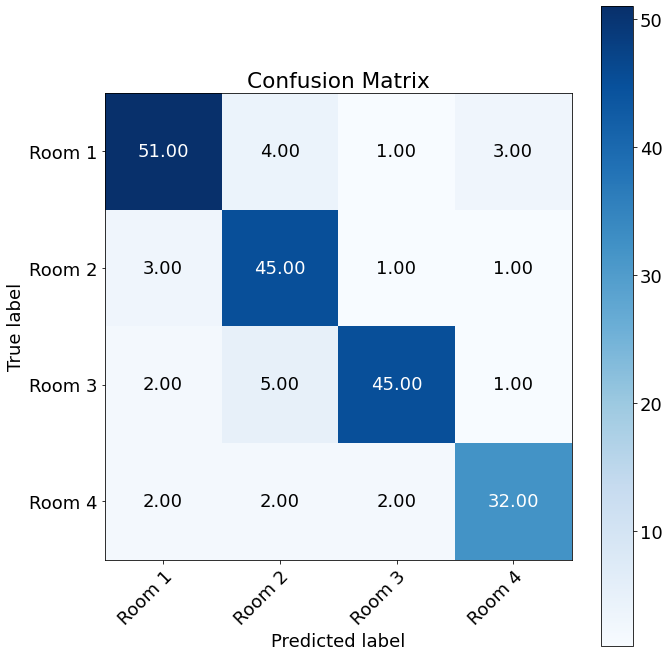

 
Accuracy pruned 2: 0.865
Macro recall pruned 2: 0.8638921616481241
Macro precision pruned 2: 0.8665284963006638


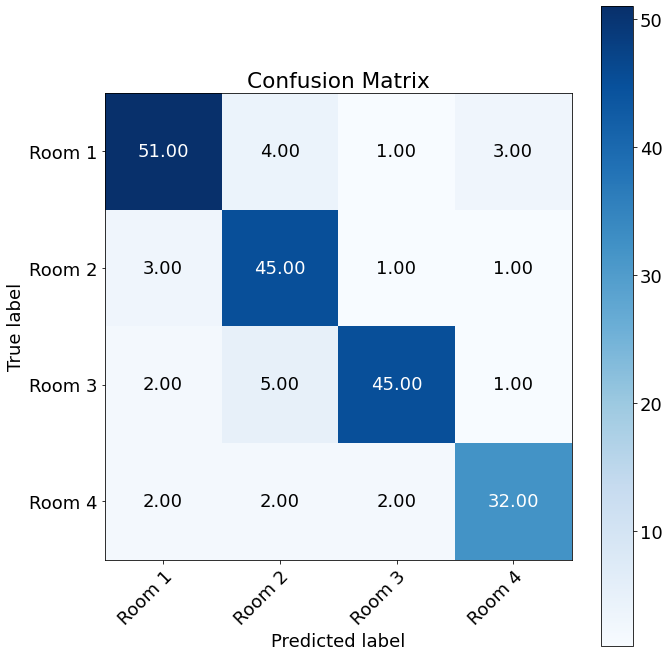

 
Outer Fold:4, Inner fold:1
Accuracy original: 0.8
Macro recall original: 0.7990705128205128
Macro precision original: 0.8034156785243742
 


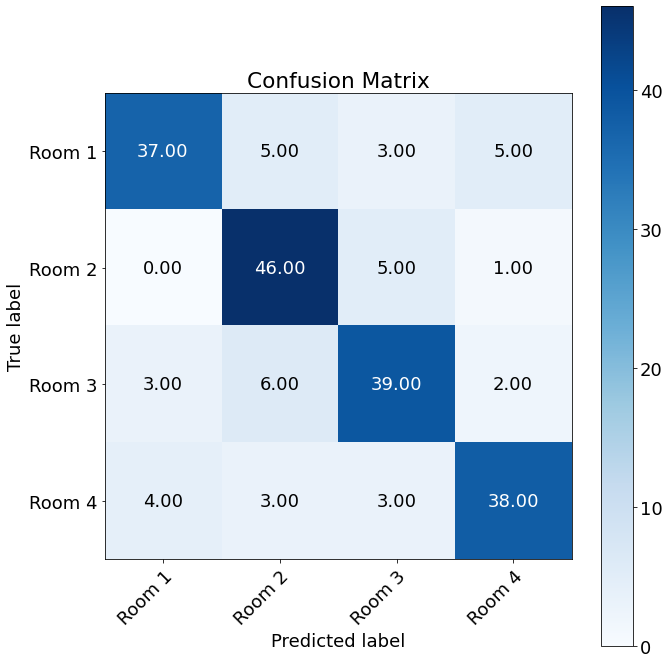

Accuracy pruned 1: 0.88
Macro recall pruned 1: 0.8793108974358974
Macro precision pruned 1: 0.8815532879818594


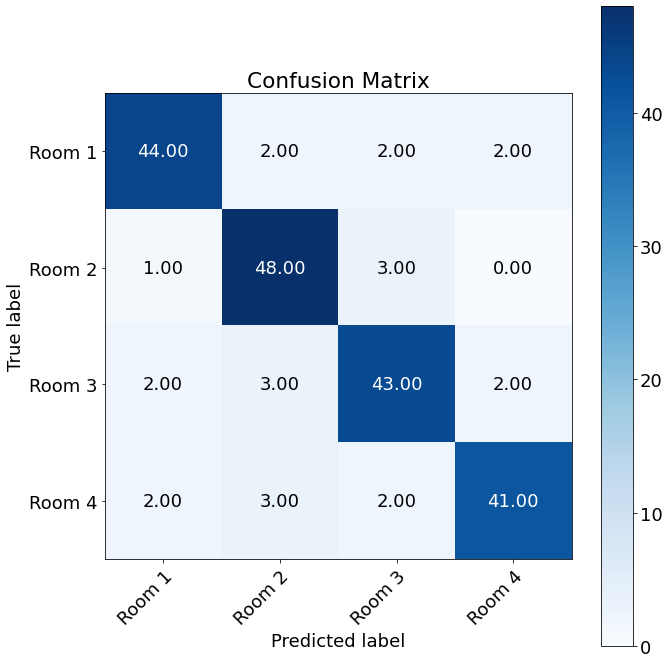

 
Accuracy pruned 2: 0.88
Macro recall pruned 2: 0.8793108974358974
Macro precision pruned 2: 0.8815532879818594


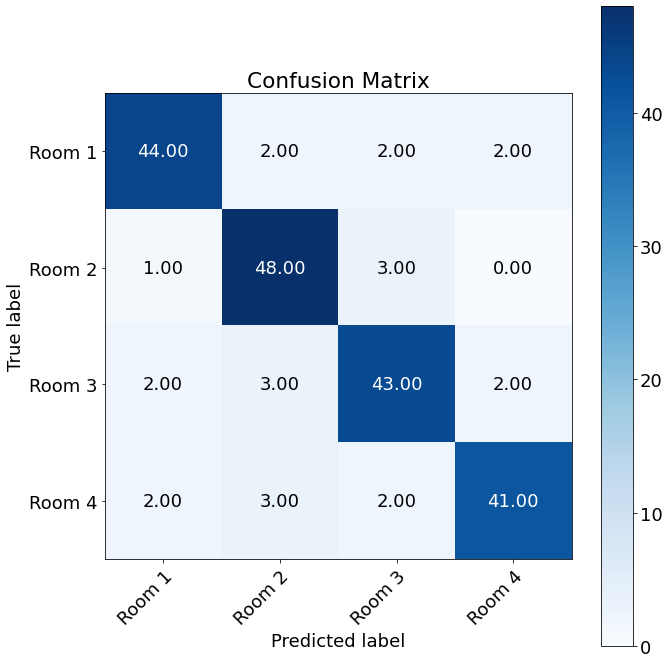

 
Outer Fold:4, Inner fold:2
Accuracy original: 0.805
Macro recall original: 0.8048717948717948
Macro precision original: 0.8047453703703704
 


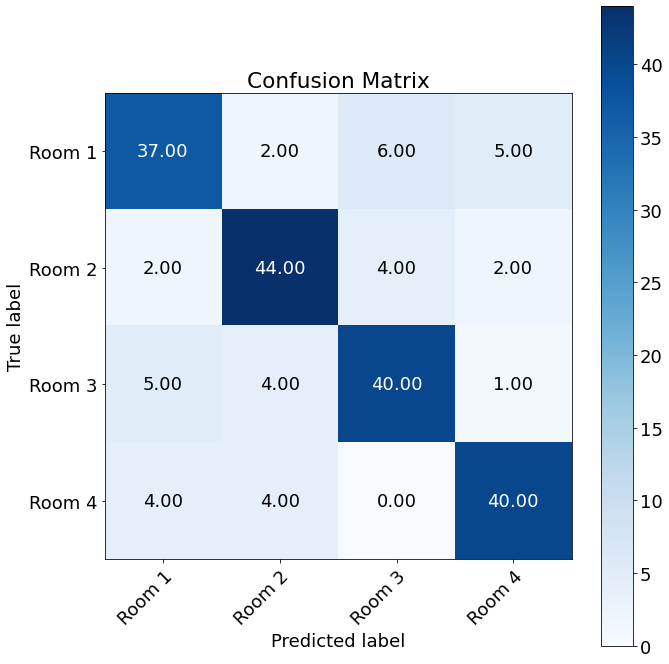

Accuracy pruned 1: 0.88
Macro recall pruned 1: 0.8803044871794872
Macro precision pruned 1: 0.8799519807923168


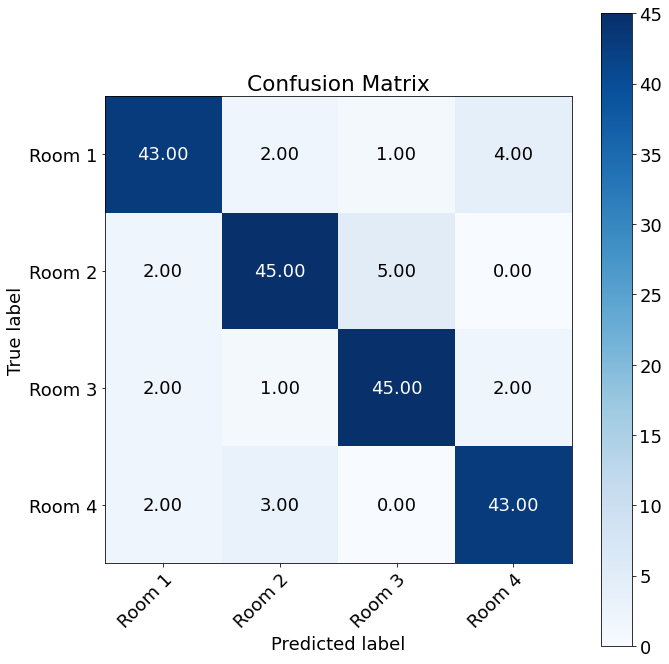

 
Accuracy pruned 2: 0.88
Macro recall pruned 2: 0.8803044871794872
Macro precision pruned 2: 0.8799519807923168


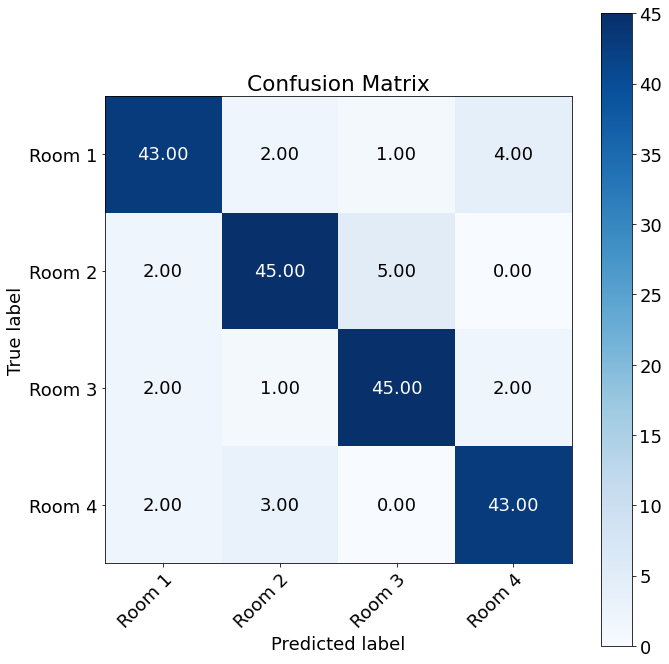

 
Outer Fold:4, Inner fold:3
Accuracy original: 0.79
Macro recall original: 0.7886698717948718
Macro precision original: 0.7946186883486676
 


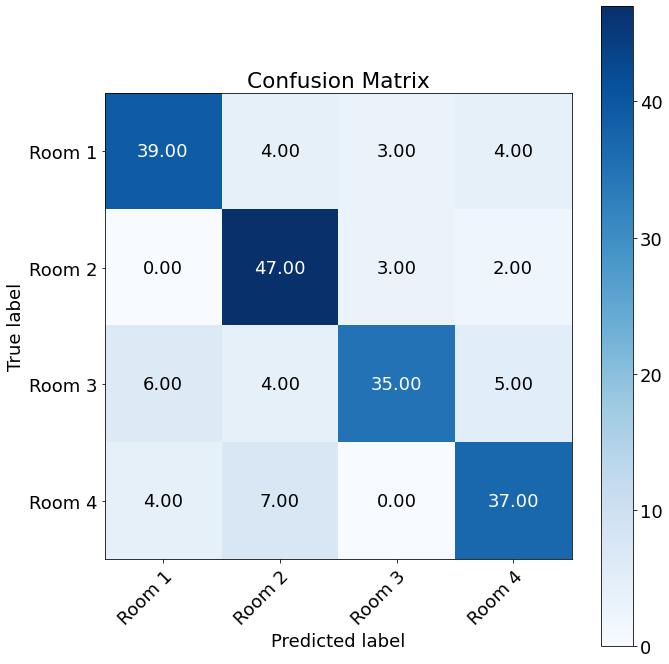

Accuracy pruned 1: 0.89
Macro recall pruned 1: 0.8893269230769231
Macro precision pruned 1: 0.8917468443144334


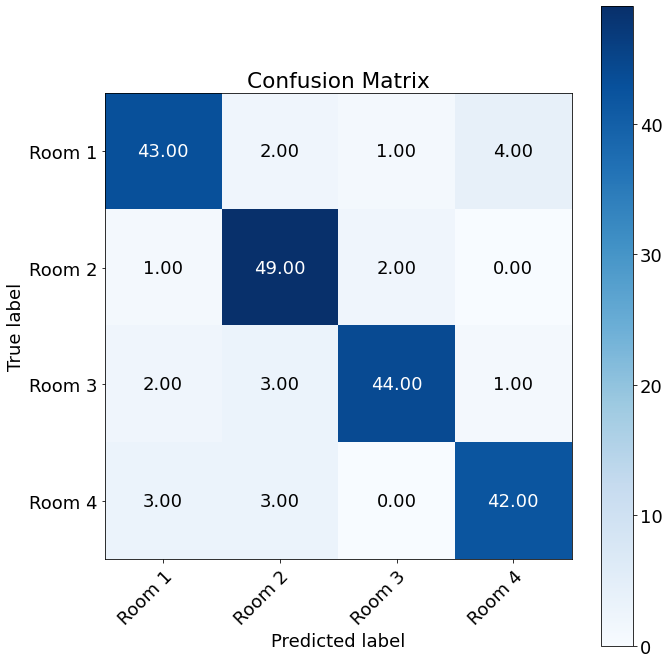

 
Accuracy pruned 2: 0.89
Macro recall pruned 2: 0.8893269230769231
Macro precision pruned 2: 0.8917468443144334


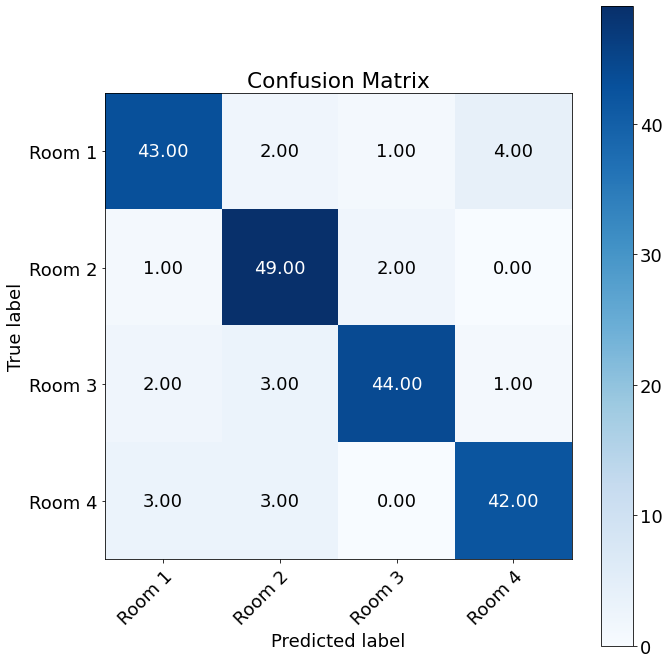

 
Outer Fold:4, Inner fold:4
Accuracy original: 0.835
Macro recall original: 0.8340705128205128
Macro precision original: 0.83465037200651
 


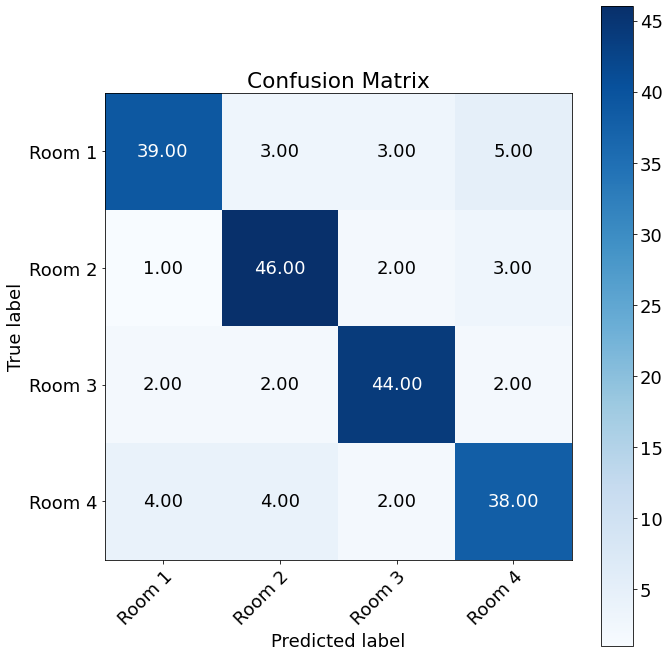

Accuracy pruned 1: 0.9
Macro recall pruned 1: 0.8995032051282051
Macro precision pruned 1: 0.9012237762237761


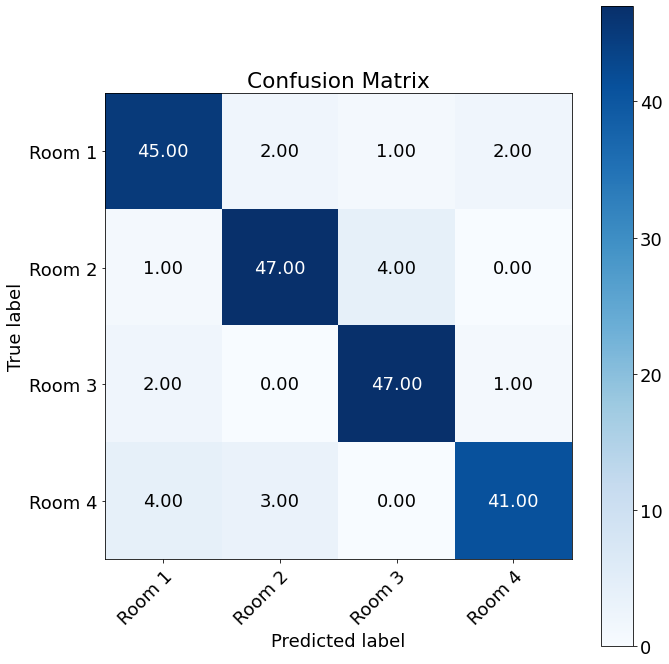

 
Accuracy pruned 2: 0.9
Macro recall pruned 2: 0.8995032051282051
Macro precision pruned 2: 0.9012237762237761


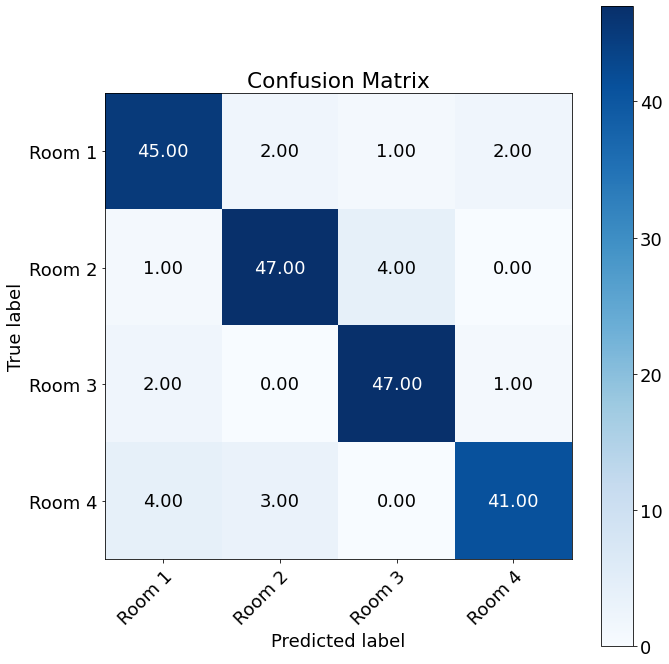

 
Outer Fold:4, Inner fold:5
Accuracy original: 0.79
Macro recall original: 0.7882692307692307
Macro precision original: 0.79095661226753
 


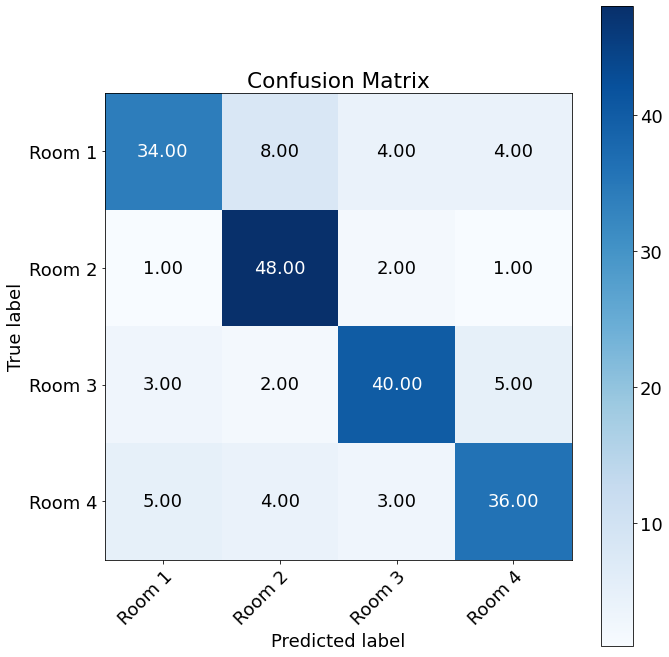

Accuracy pruned 1: 0.9
Macro recall pruned 1: 0.8999198717948719
Macro precision pruned 1: 0.900401509459665


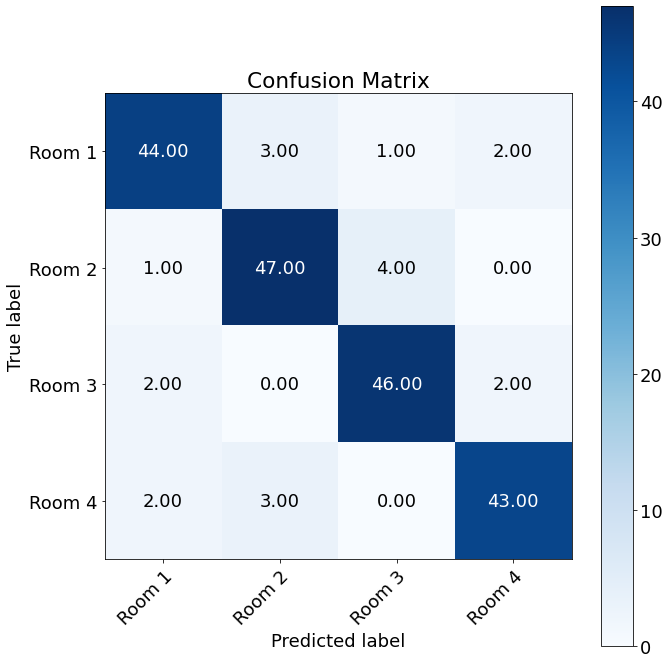

 
Accuracy pruned 2: 0.9
Macro recall pruned 2: 0.8999198717948719
Macro precision pruned 2: 0.900401509459665


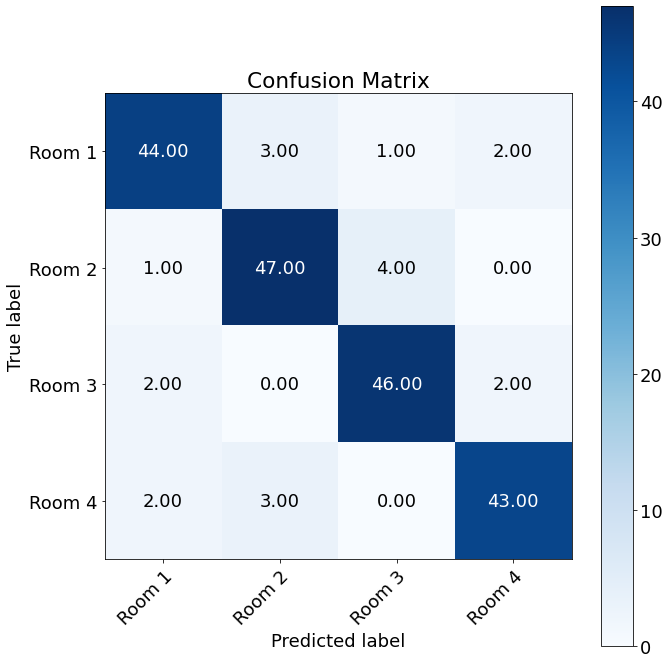

 
Outer Fold:4, Inner fold:6
Accuracy original: 0.81
Macro recall original: 0.8088942307692308
Macro precision original: 0.8215757456828885
 


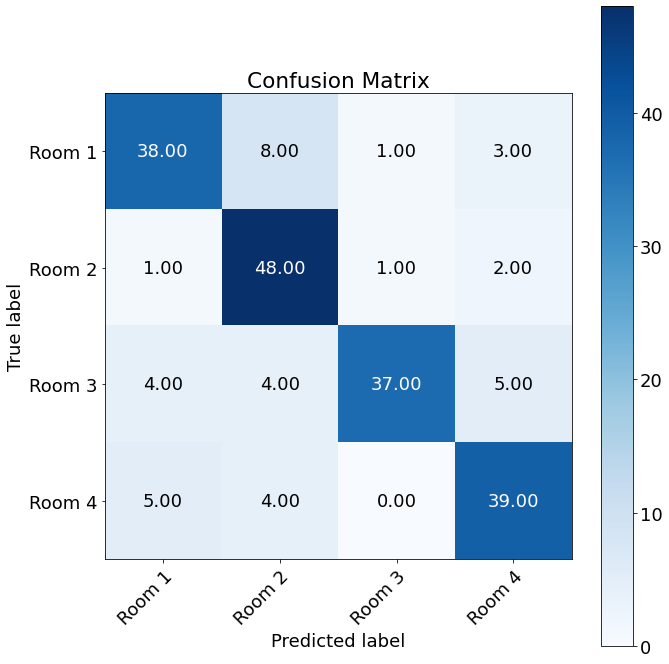

Accuracy pruned 1: 0.905
Macro recall pruned 1: 0.9047275641025642
Macro precision pruned 1: 0.9055374632122352


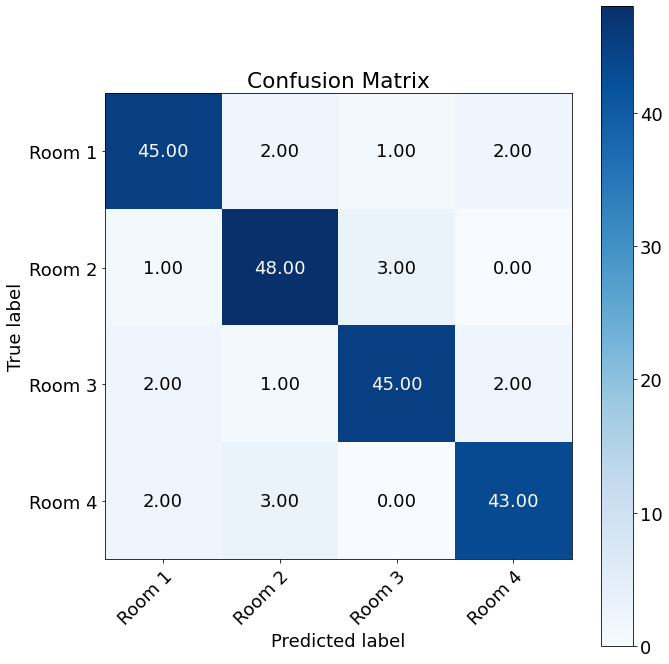

 
Accuracy pruned 2: 0.905
Macro recall pruned 2: 0.9047275641025642
Macro precision pruned 2: 0.9055374632122352


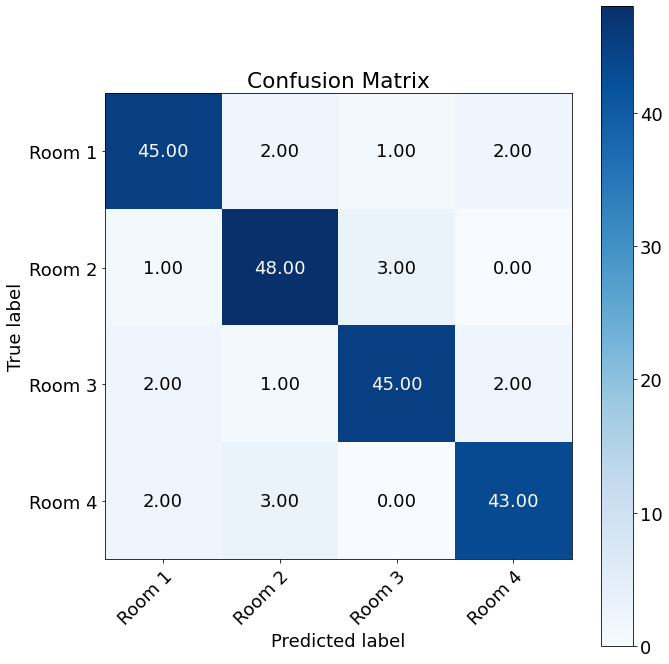

 
Outer Fold:4, Inner fold:7
Accuracy original: 0.83
Macro recall original: 0.8294711538461538
Macro precision original: 0.8325767543859649
 


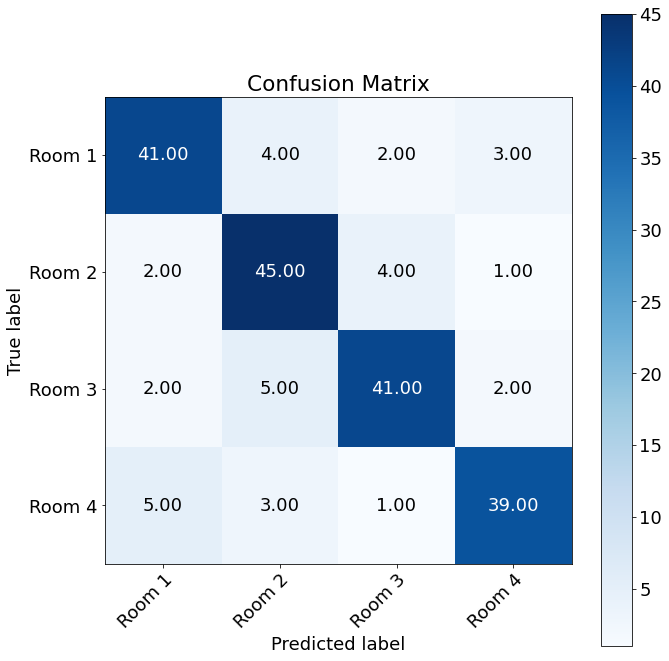

Accuracy pruned 1: 0.895
Macro recall pruned 1: 0.8949198717948719
Macro precision pruned 1: 0.895805792766279


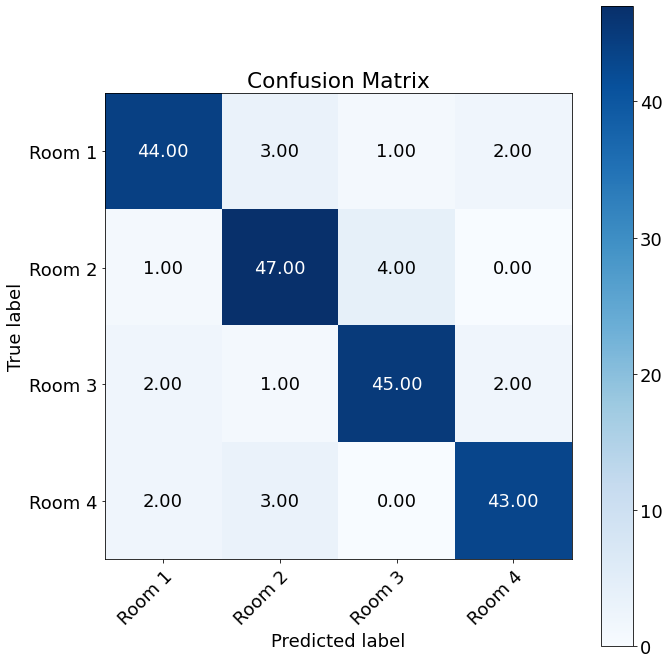

 
Accuracy pruned 2: 0.895
Macro recall pruned 2: 0.8949198717948719
Macro precision pruned 2: 0.895805792766279


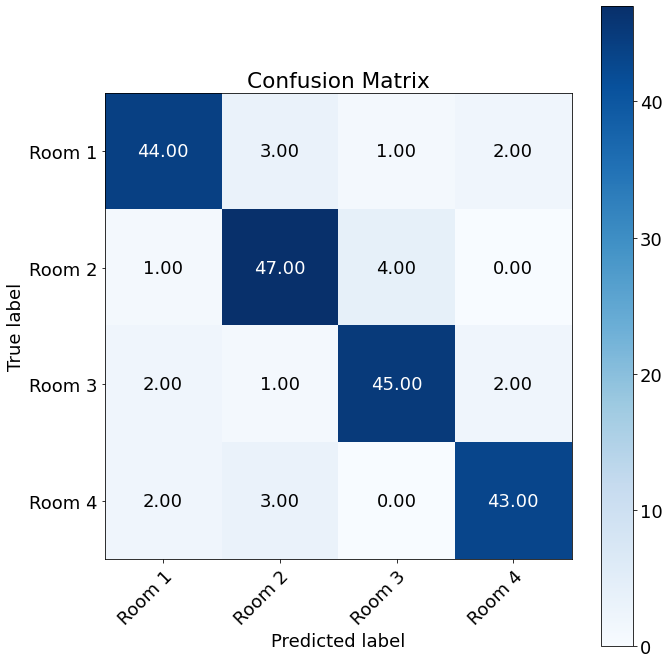

 
Outer Fold:4, Inner fold:8
Accuracy original: 0.8
Macro recall original: 0.7992628205128205
Macro precision original: 0.8027010361992992
 


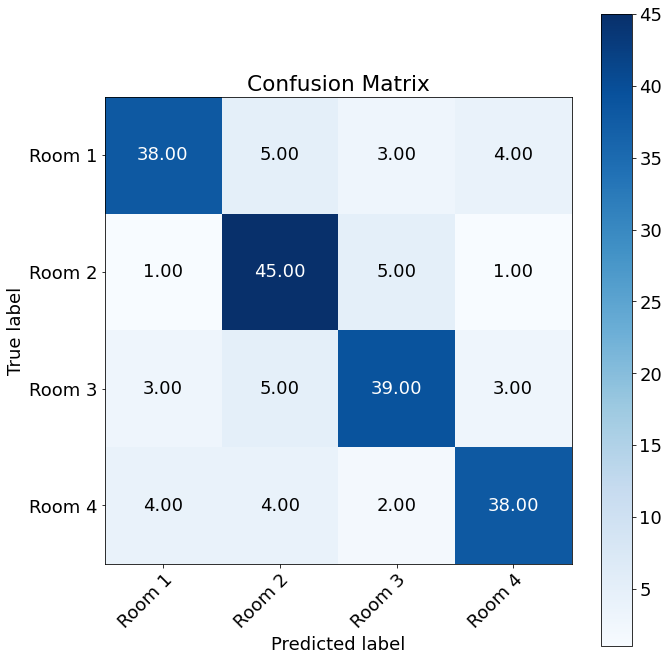

Accuracy pruned 1: 0.905
Macro recall pruned 1: 0.9043269230769231
Macro precision pruned 1: 0.906060606060606


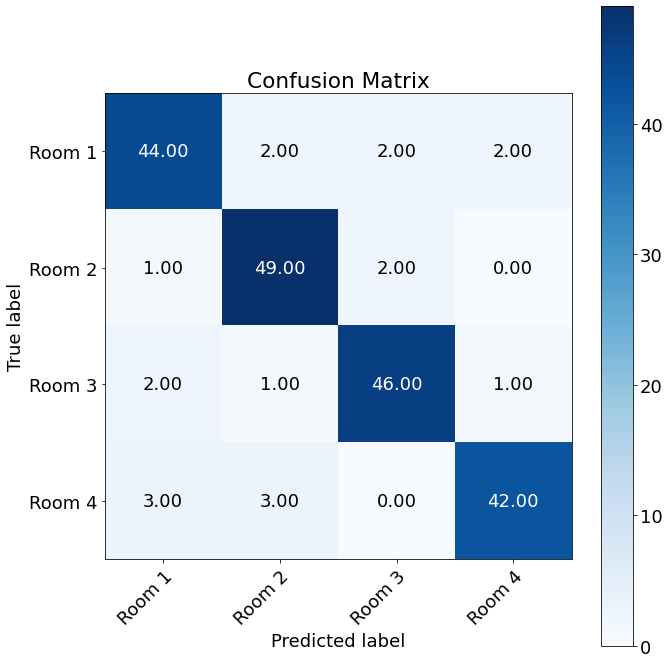

 
Accuracy pruned 2: 0.905
Macro recall pruned 2: 0.9043269230769231
Macro precision pruned 2: 0.906060606060606


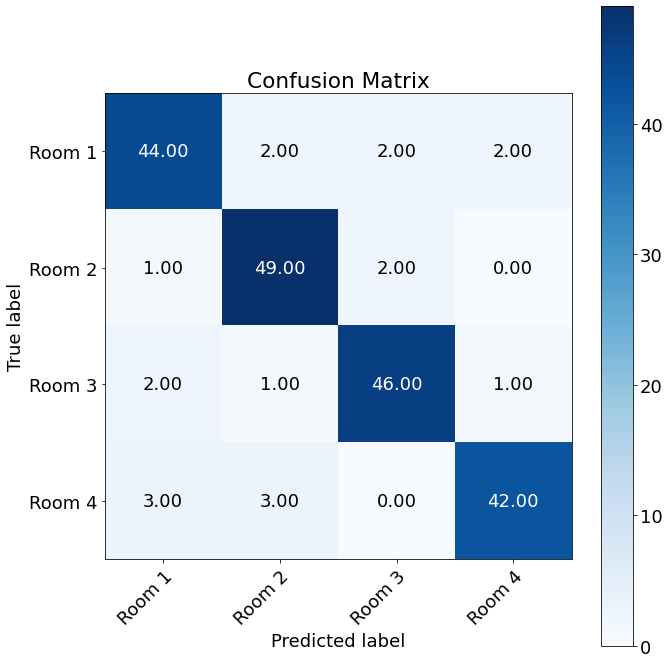

 
Outer Fold:4, Inner fold:9
Accuracy original: 0.805
Macro recall original: 0.8036698717948719
Macro precision original: 0.8107037568762823
 


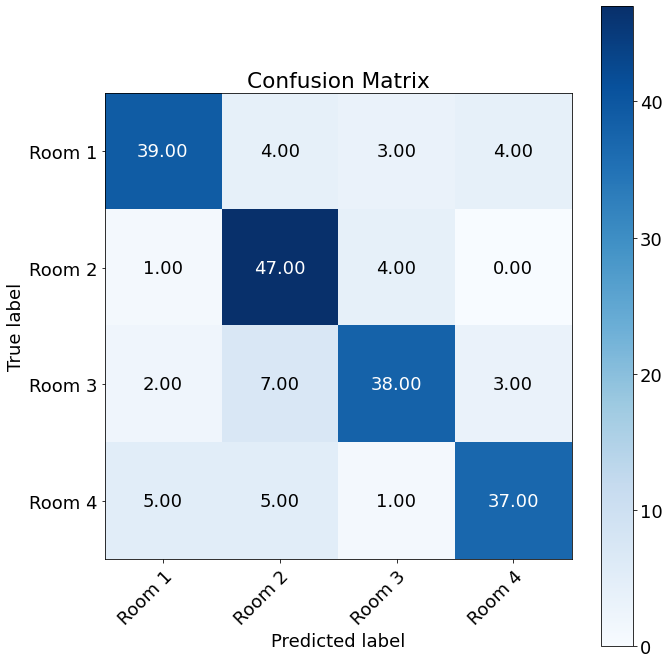

Accuracy pruned 1: 0.895
Macro recall pruned 1: 0.8949038461538461
Macro precision pruned 1: 0.8963235294117646


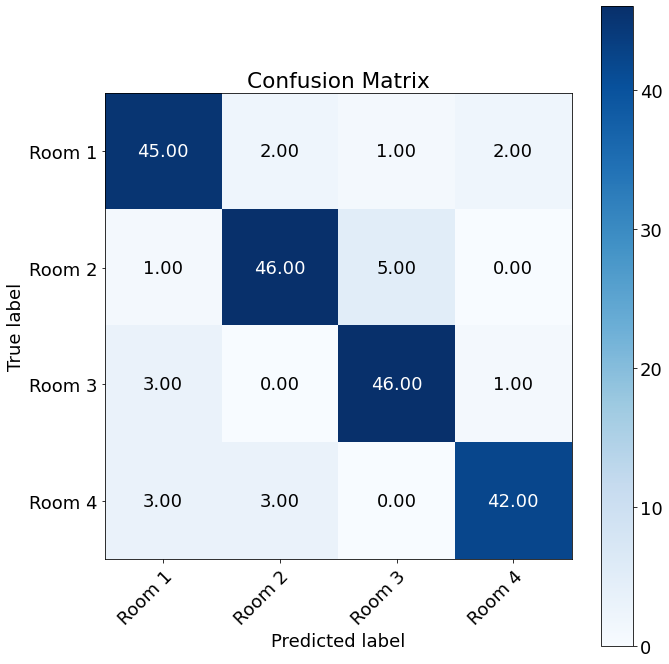

 
Accuracy pruned 2: 0.895
Macro recall pruned 2: 0.8949038461538461
Macro precision pruned 2: 0.8963235294117646


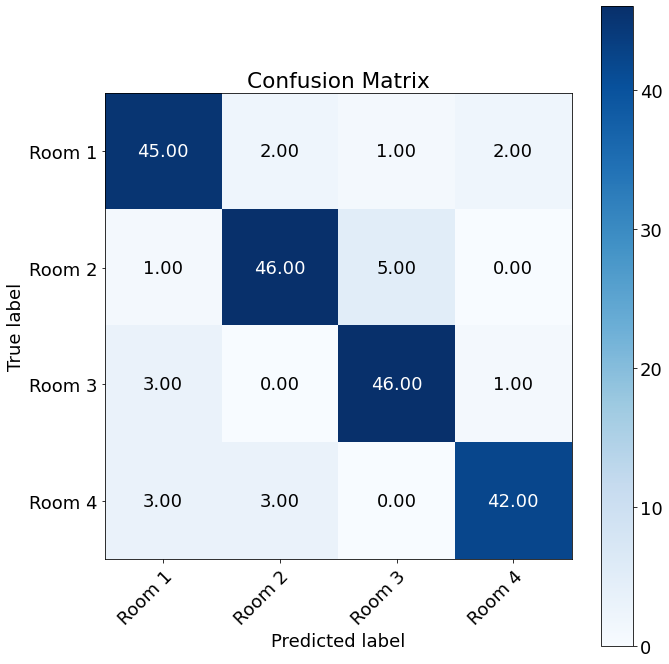

 
Outer Fold:4, Inner fold:10
Accuracy original: 0.82
Macro recall original: 0.8194871794871795
Macro precision original: 0.8214262977918441
 


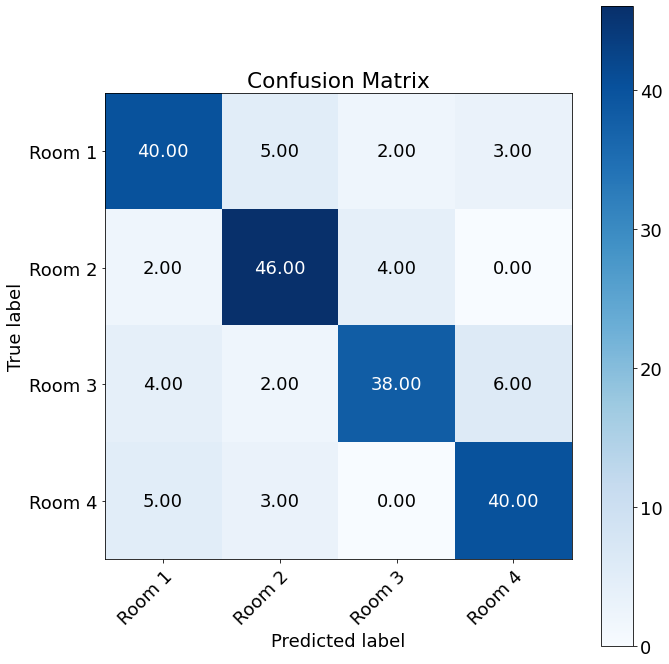

Accuracy pruned 1: 0.89
Macro recall pruned 1: 0.8893108974358974
Macro precision pruned 1: 0.8914308176100628


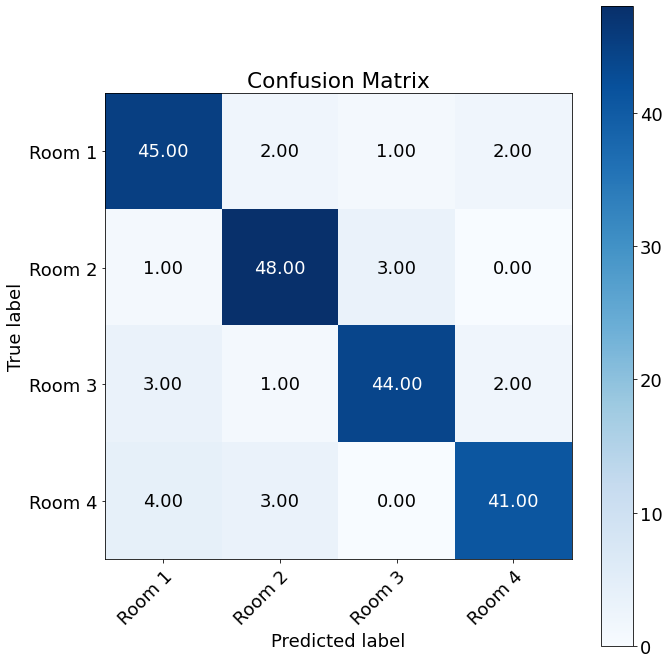

 
Accuracy pruned 2: 0.89
Macro recall pruned 2: 0.8893108974358974
Macro precision pruned 2: 0.8914308176100628


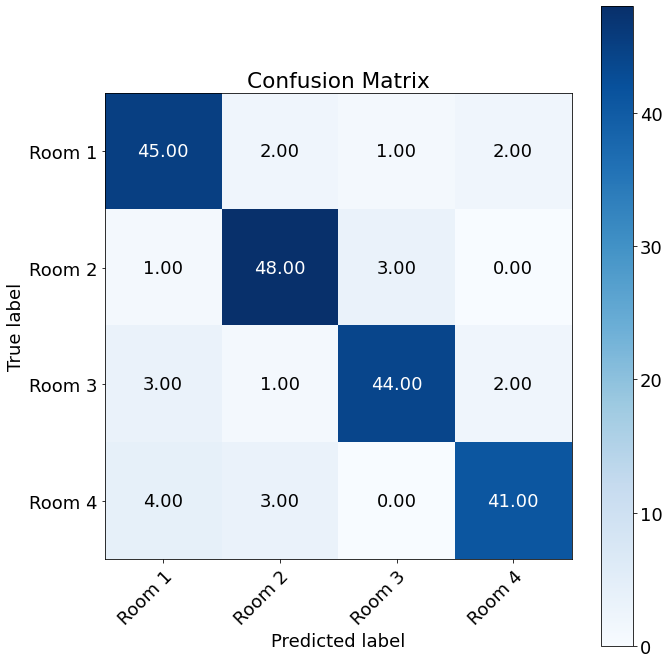

 
Outer Fold:5, Inner fold:1
Accuracy original: 0.77
Macro recall original: 0.7721905606214117
Macro precision original: 0.7699439524237368
 


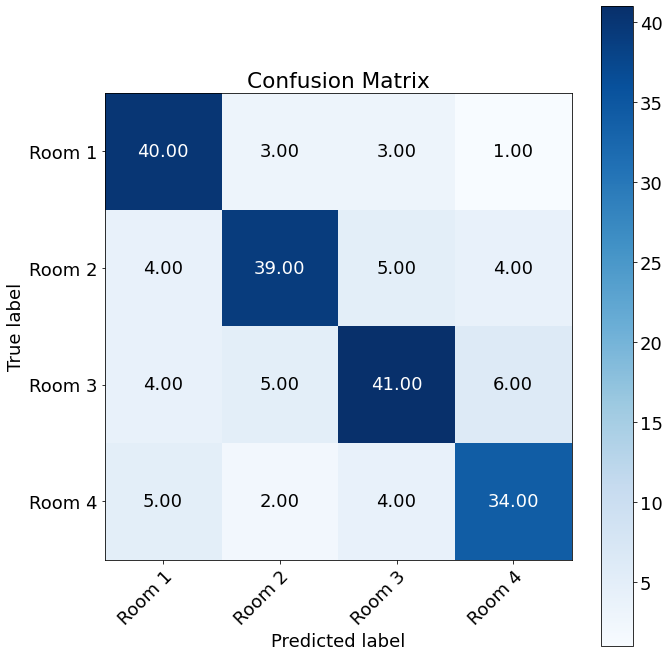

Accuracy pruned 1: 0.87
Macro recall pruned 1: 0.8734354298184085
Macro precision pruned 1: 0.8712846412846412


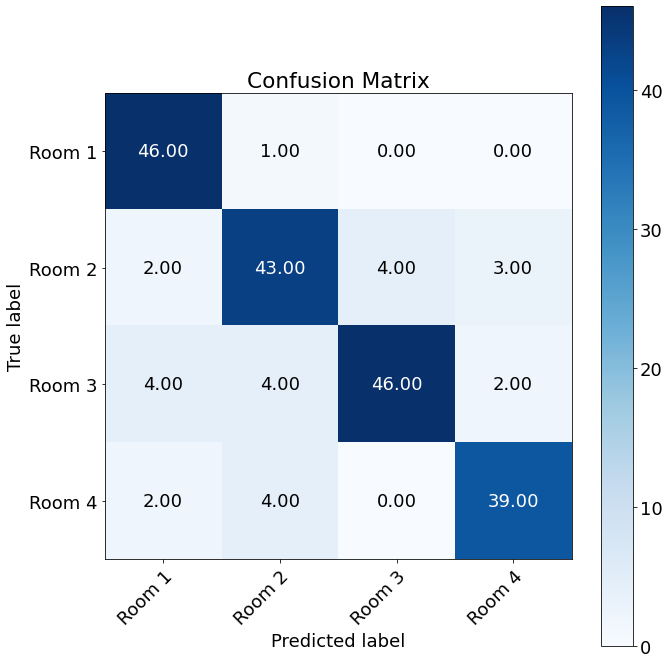

 
Accuracy pruned 2: 0.87
Macro recall pruned 2: 0.8734354298184085
Macro precision pruned 2: 0.8712846412846412


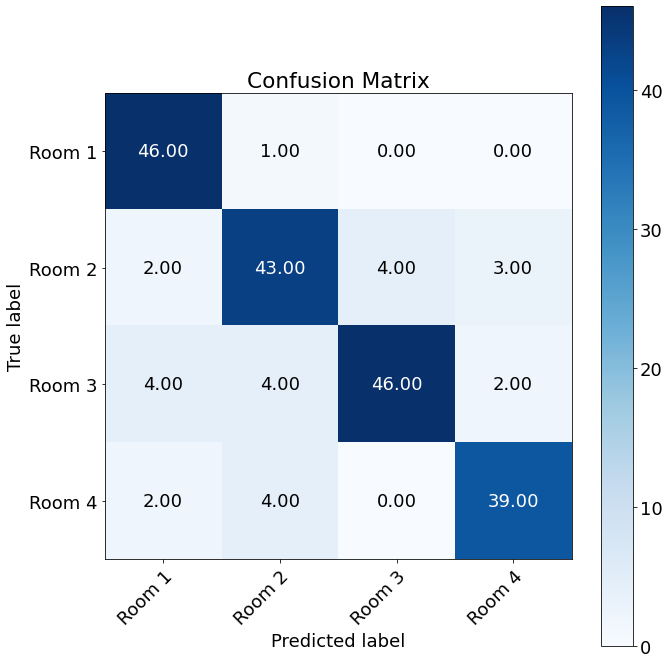

 
Outer Fold:5, Inner fold:2
Accuracy original: 0.795
Macro recall original: 0.7947483958122256
Macro precision original: 0.7941603535353535
 


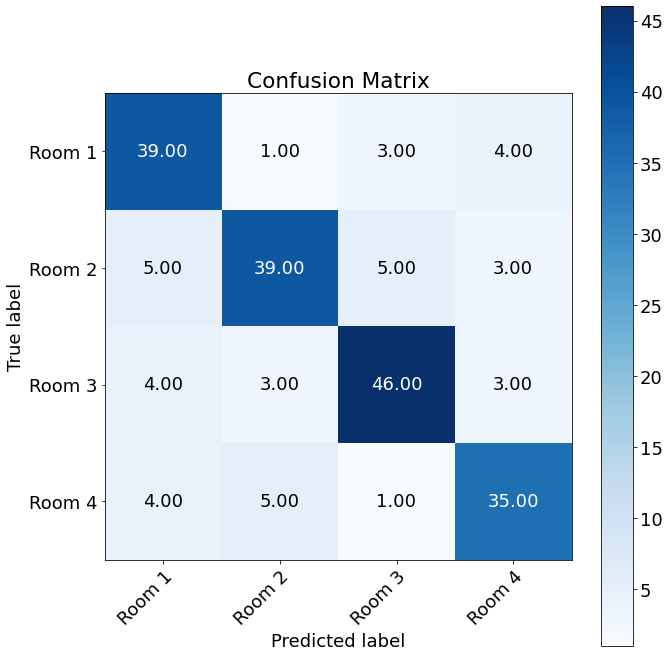

Accuracy pruned 1: 0.875
Macro recall pruned 1: 0.8773882589042163
Macro precision pruned 1: 0.8748411371237459


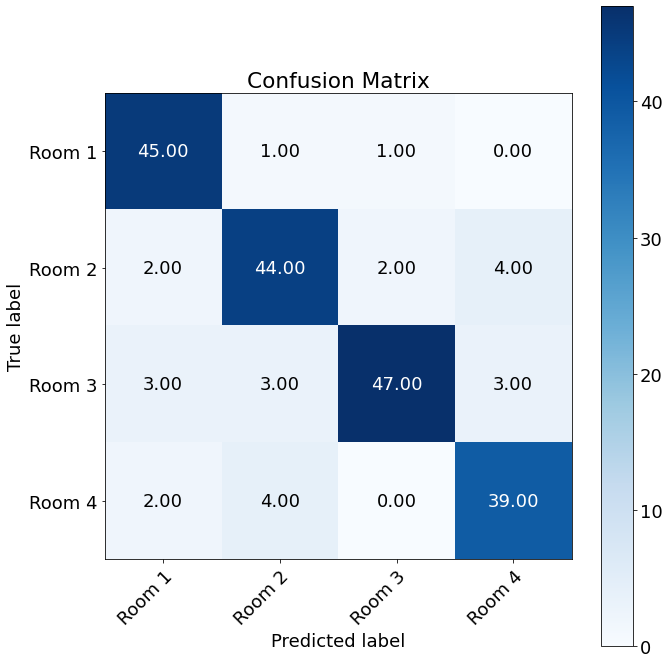

 
Accuracy pruned 2: 0.875
Macro recall pruned 2: 0.8773882589042163
Macro precision pruned 2: 0.8748411371237459


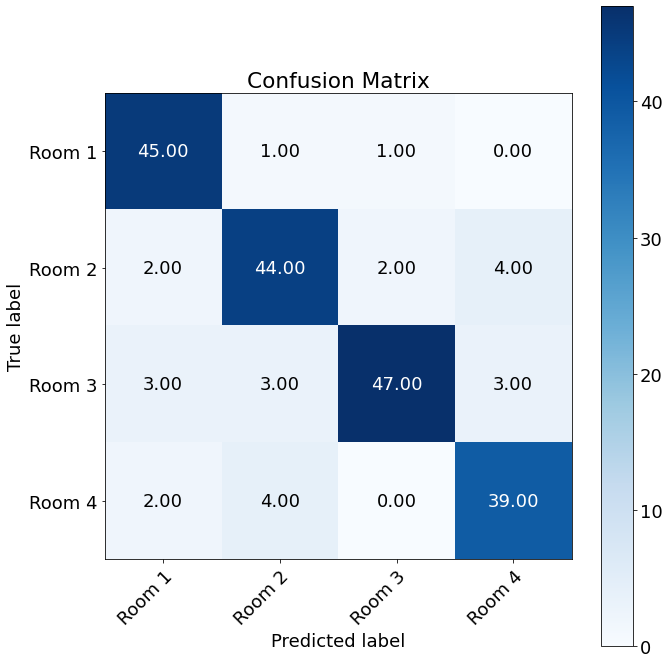

 
Outer Fold:5, Inner fold:3
Accuracy original: 0.78
Macro recall original: 0.7805006754474839
Macro precision original: 0.7827664399092972
 


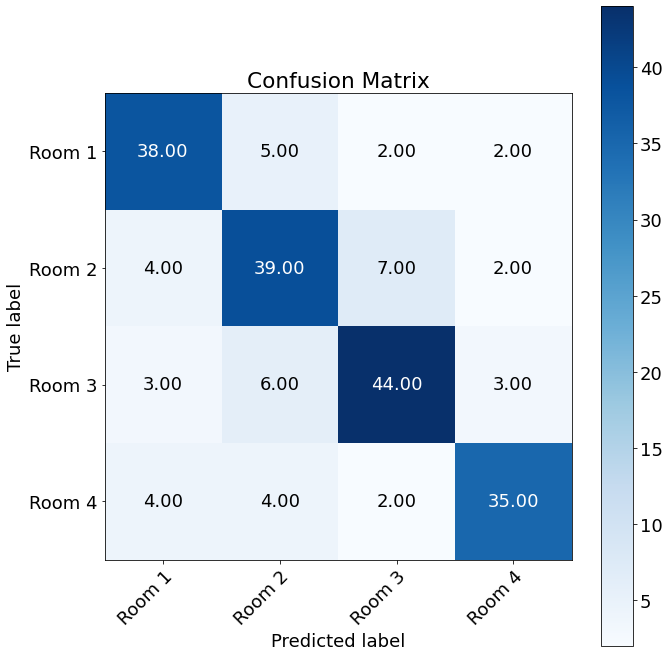

Accuracy pruned 1: 0.87
Macro recall pruned 1: 0.8741222430052217
Macro precision pruned 1: 0.8745771639793379


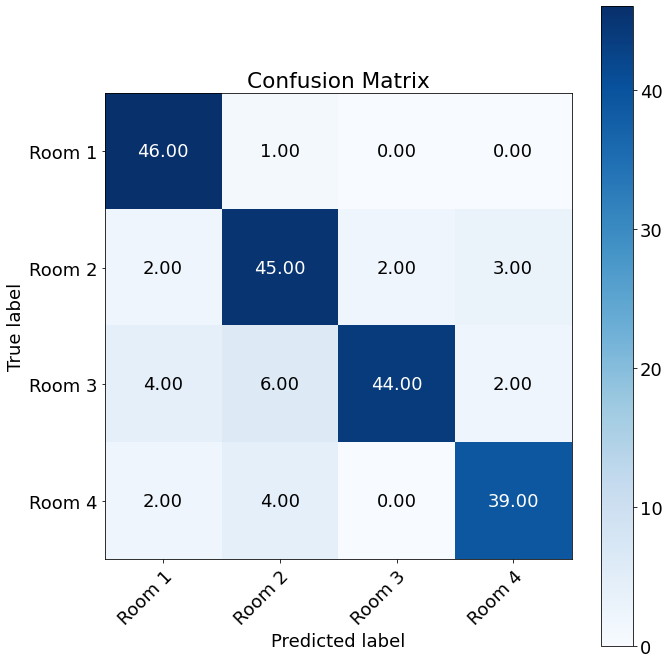

 
Accuracy pruned 2: 0.87
Macro recall pruned 2: 0.8741222430052217
Macro precision pruned 2: 0.8745771639793379


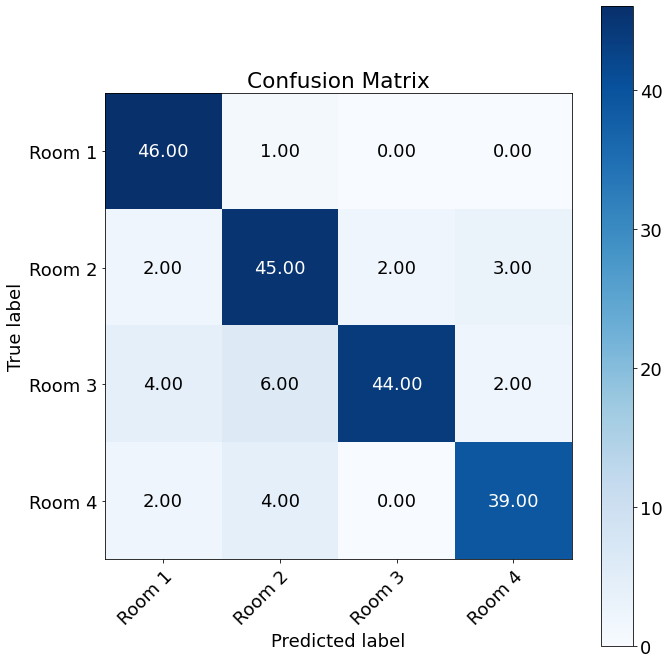

 
Outer Fold:5, Inner fold:4
Accuracy original: 0.785
Macro recall original: 0.7873839074636947
Macro precision original: 0.7881750057783778
 


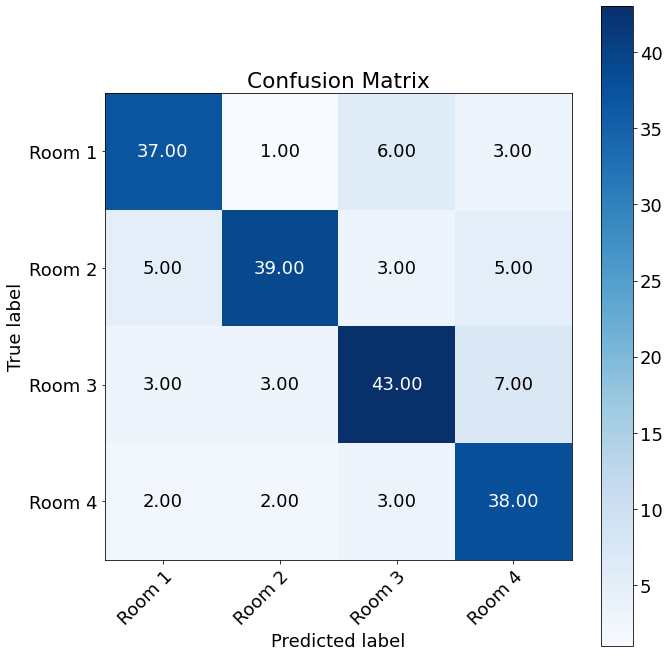

Accuracy pruned 1: 0.88
Macro recall pruned 1: 0.8813410879900242
Macro precision pruned 1: 0.8799112097669256


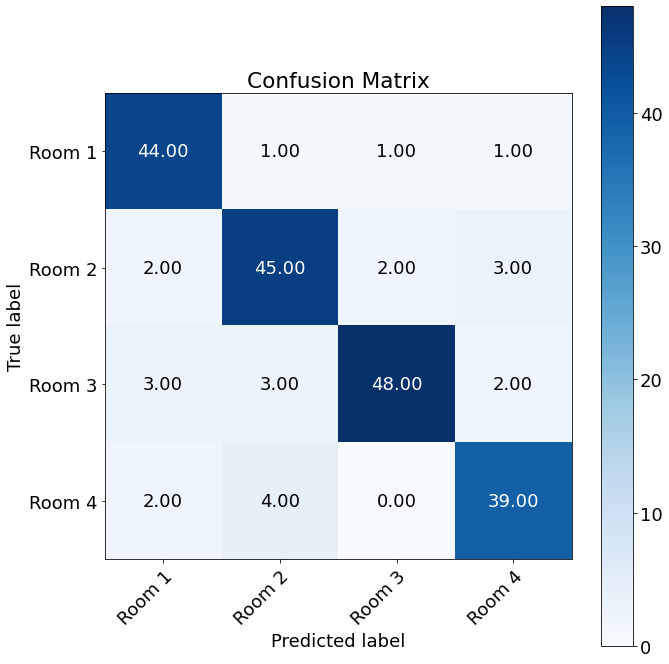

 
Accuracy pruned 2: 0.88
Macro recall pruned 2: 0.8813410879900242
Macro precision pruned 2: 0.8799112097669256


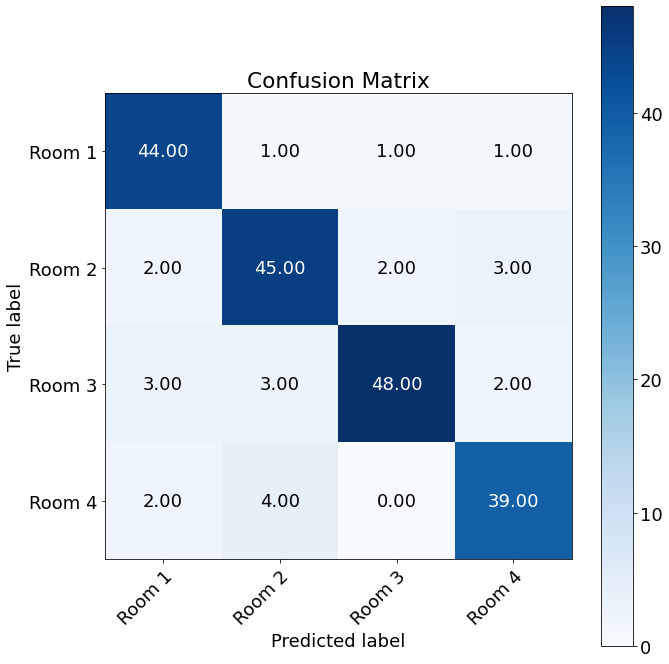

 
Outer Fold:5, Inner fold:5
Accuracy original: 0.815
Macro recall original: 0.8141085716883589
Macro precision original: 0.8161906627239384
 


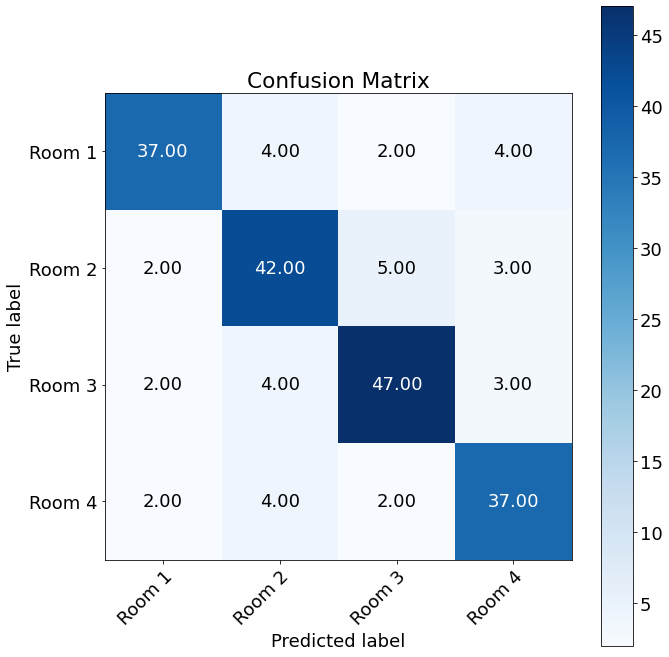

Accuracy pruned 1: 0.87
Macro recall pruned 1: 0.8729239731899306
Macro precision pruned 1: 0.8700414781297134


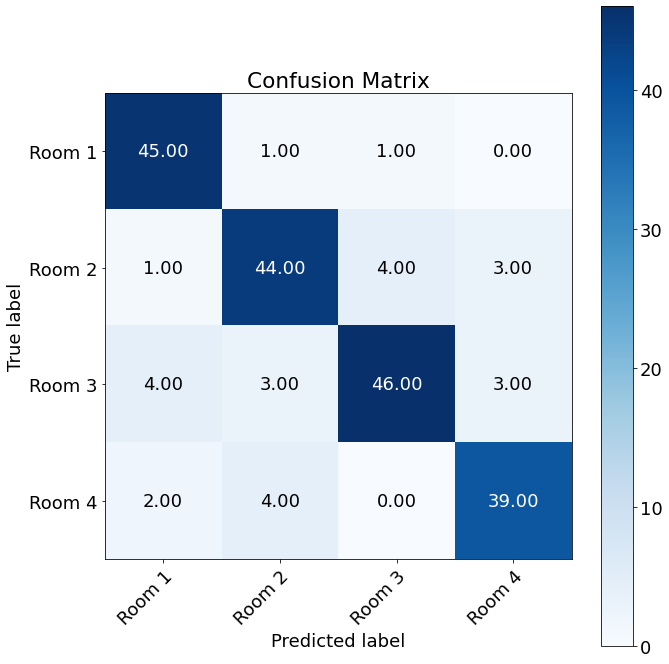

 
Accuracy pruned 2: 0.87
Macro recall pruned 2: 0.8729239731899306
Macro precision pruned 2: 0.8700414781297134


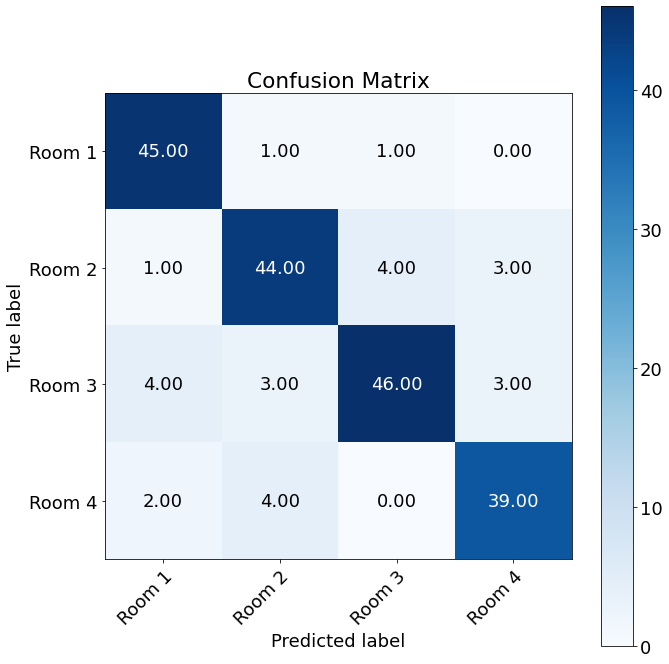

 
Outer Fold:5, Inner fold:6
Accuracy original: 0.75
Macro recall original: 0.748112968591692
Macro precision original: 0.7493986531394167
 


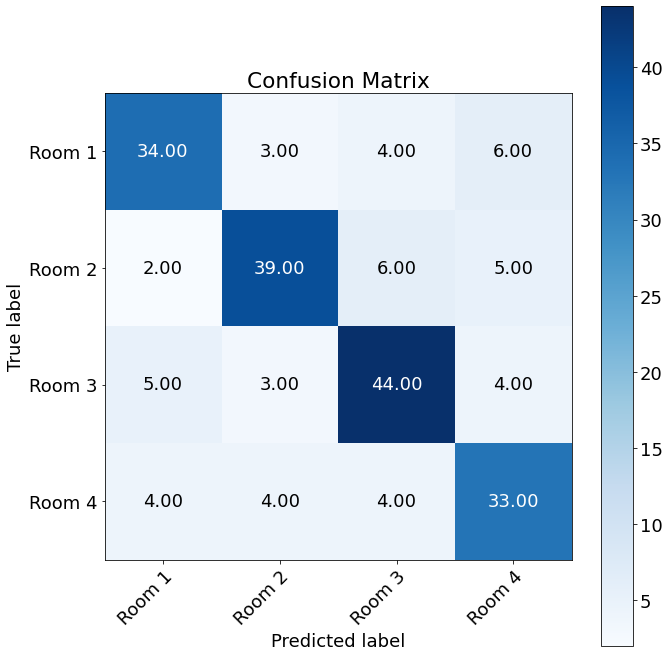

Accuracy pruned 1: 0.85
Macro recall pruned 1: 0.8519000207829994
Macro precision pruned 1: 0.8524404761904761


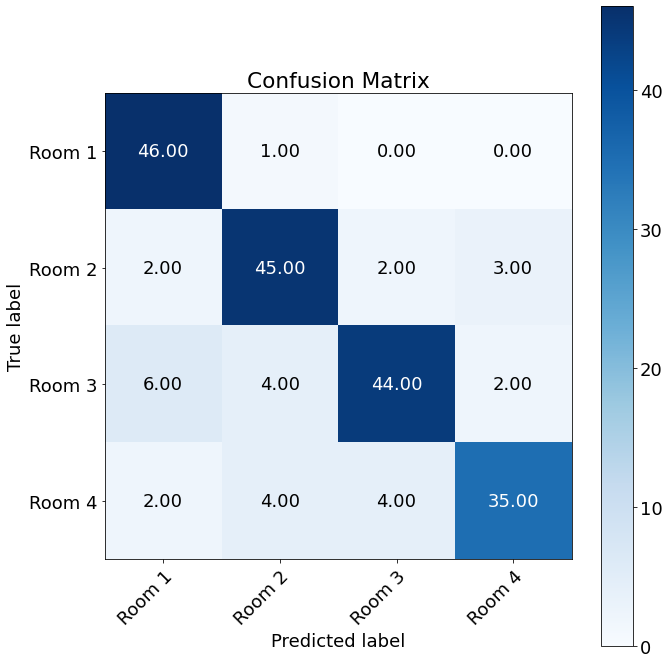

 
Accuracy pruned 2: 0.85
Macro recall pruned 2: 0.8519000207829994
Macro precision pruned 2: 0.8524404761904761


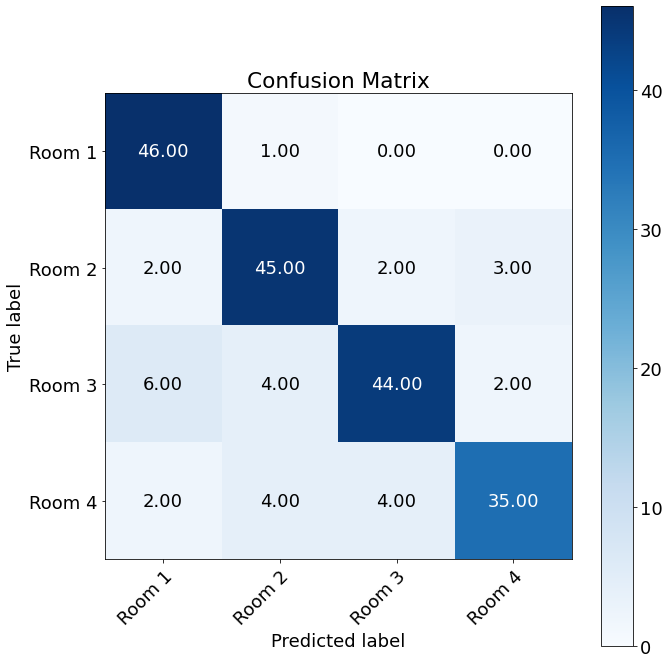

 
Outer Fold:5, Inner fold:7
Accuracy original: 0.79
Macro recall original: 0.7900477034785545
Macro precision original: 0.7885486343366779
 


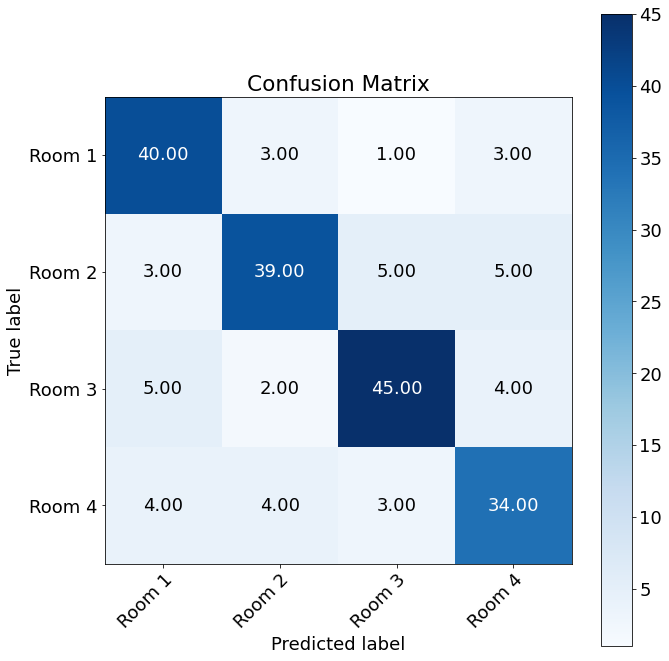

Accuracy pruned 1: 0.855
Macro recall pruned 1: 0.8574096264255839
Macro precision pruned 1: 0.8560398319534532


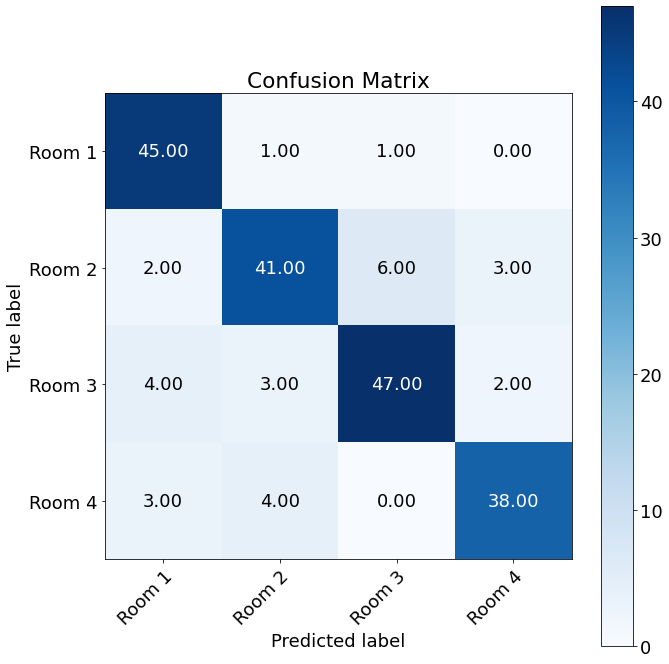

 
Accuracy pruned 2: 0.855
Macro recall pruned 2: 0.8574096264255839
Macro precision pruned 2: 0.8560398319534532


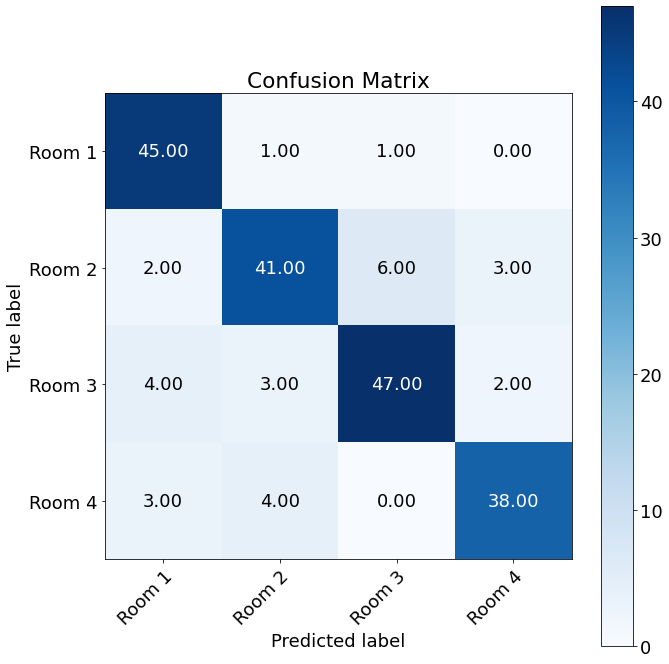

 
Outer Fold:5, Inner fold:8
Accuracy original: 0.815
Macro recall original: 0.8136744018392955
Macro precision original: 0.813675672698229
 


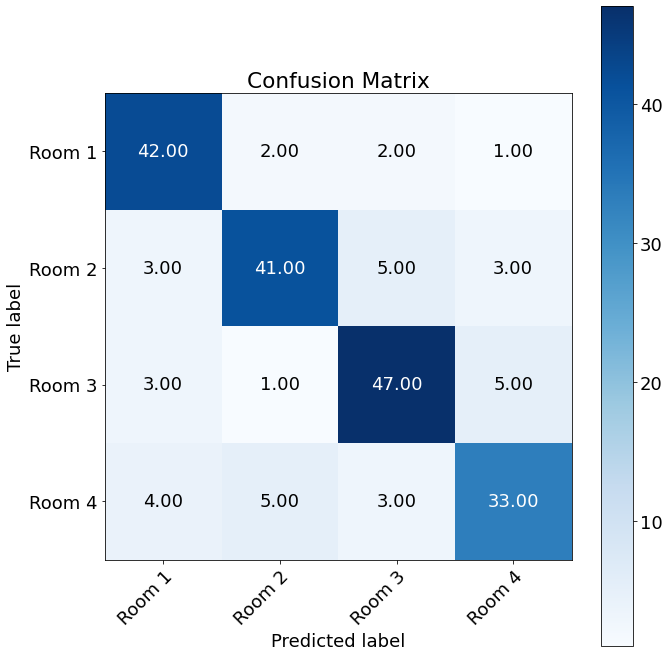

Accuracy pruned 1: 0.88
Macro recall pruned 1: 0.8815091380250955
Macro precision pruned 1: 0.8797889147889147


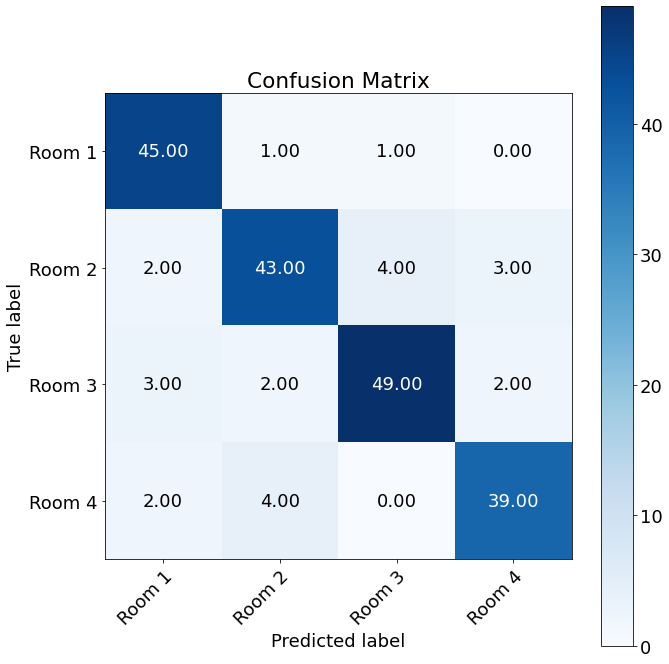

 
Accuracy pruned 2: 0.88
Macro recall pruned 2: 0.8815091380250955
Macro precision pruned 2: 0.8797889147889147


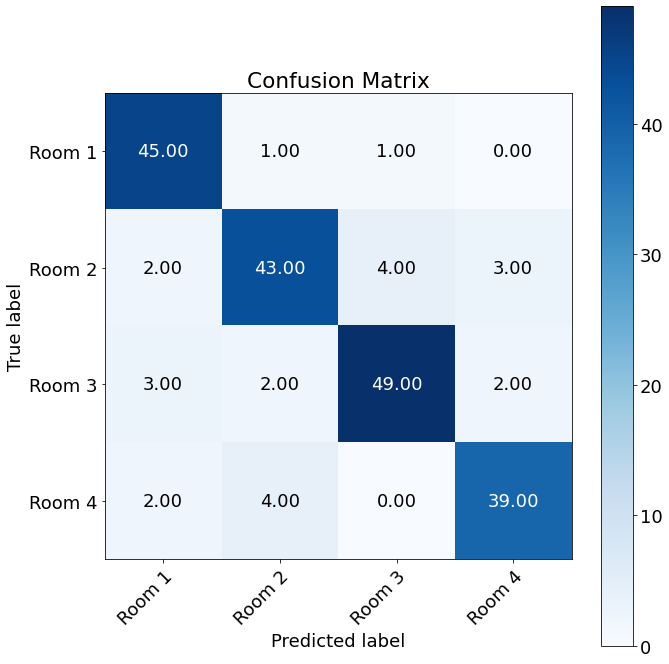

 
Outer Fold:5, Inner fold:9
Accuracy original: 0.79
Macro recall original: 0.7928711064349362
Macro precision original: 0.7901398739164697
 


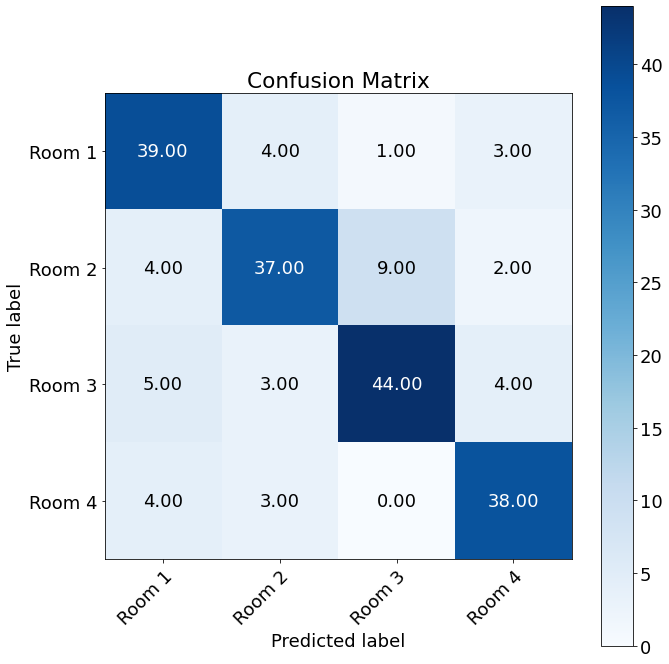

Accuracy pruned 1: 0.88
Macro recall pruned 1: 0.8827074078403866
Macro precision pruned 1: 0.8813680926916221


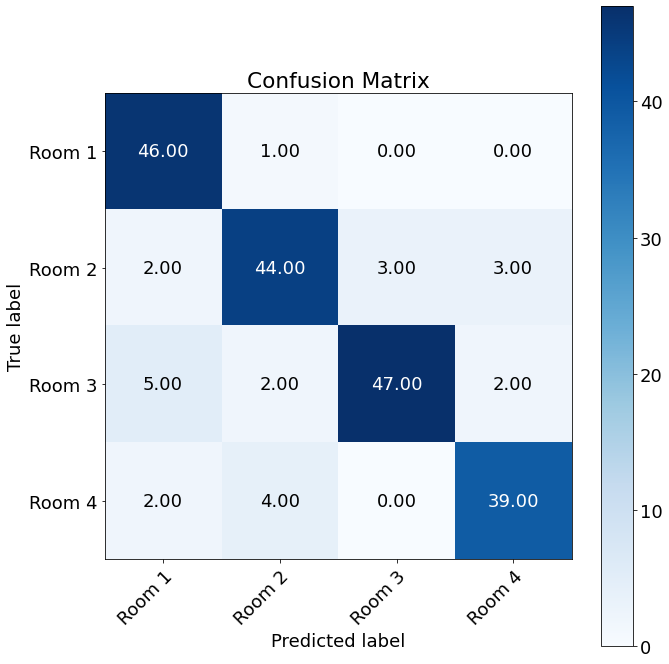

 
Accuracy pruned 2: 0.88
Macro recall pruned 2: 0.8827074078403866
Macro precision pruned 2: 0.8813680926916221


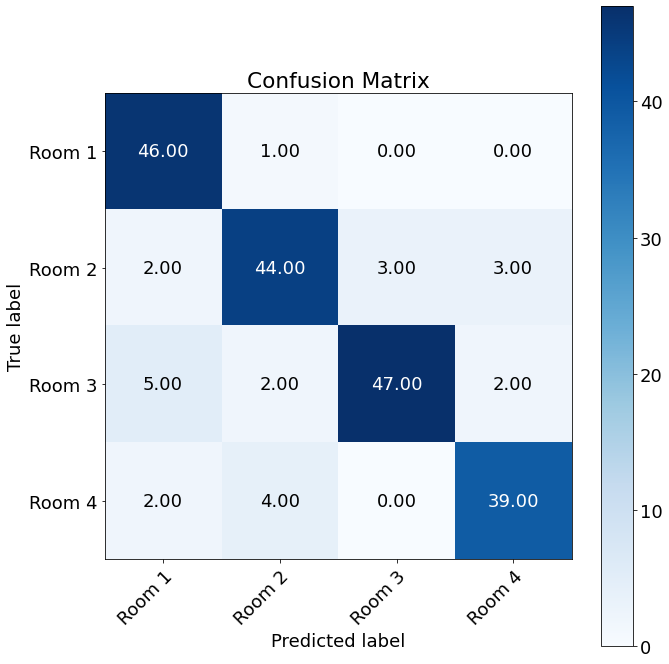

 
Outer Fold:5, Inner fold:10
Accuracy original: 0.79
Macro recall original: 0.7927416997895722
Macro precision original: 0.7904034690799395
 


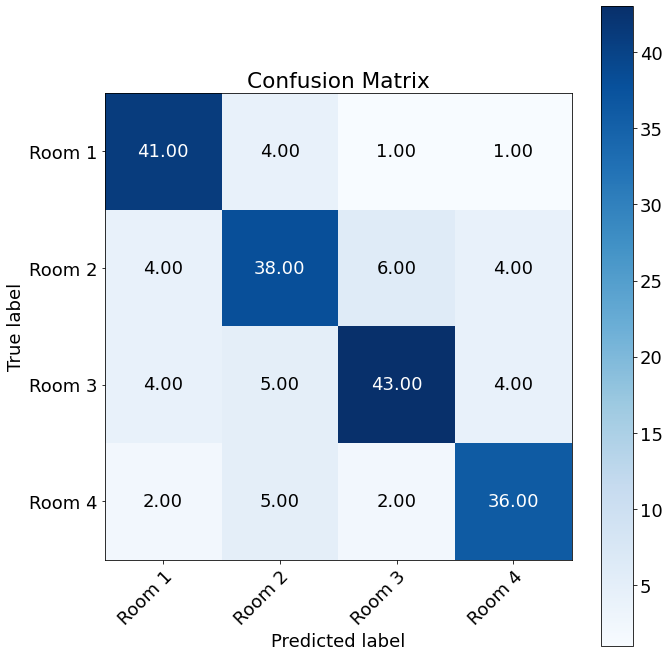

Accuracy pruned 1: 0.855
Macro recall pruned 1: 0.858096439612397
Macro precision pruned 1: 0.8557972874684465


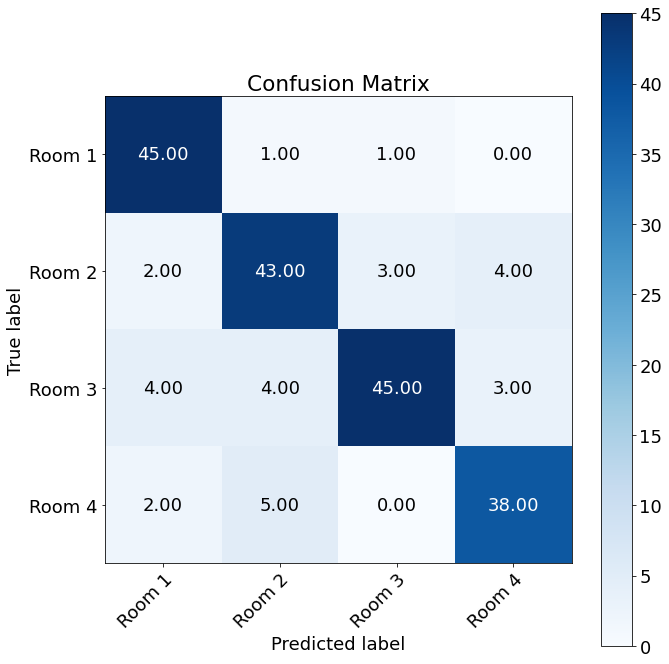

 
Accuracy pruned 2: 0.855
Macro recall pruned 2: 0.858096439612397
Macro precision pruned 2: 0.8557972874684465


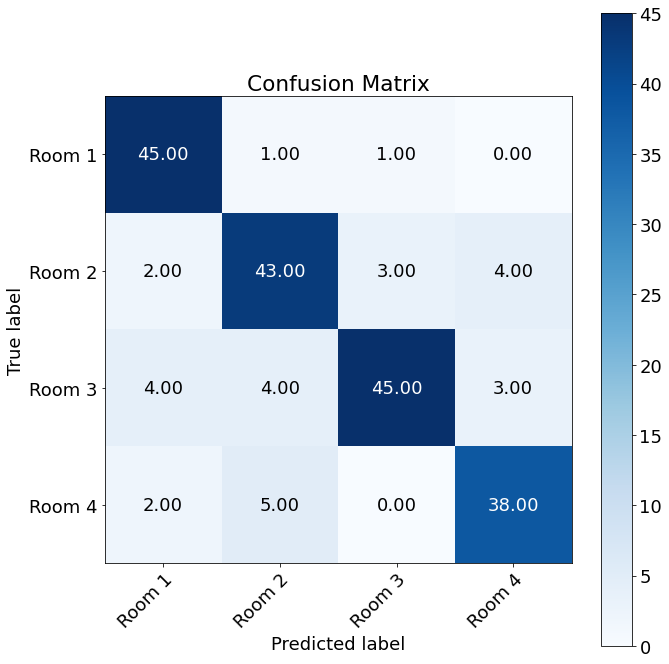

 
Outer Fold:6, Inner fold:1
Accuracy original: 0.835
Macro recall original: 0.8338304661487236
Macro precision original: 0.8383037502227907
 


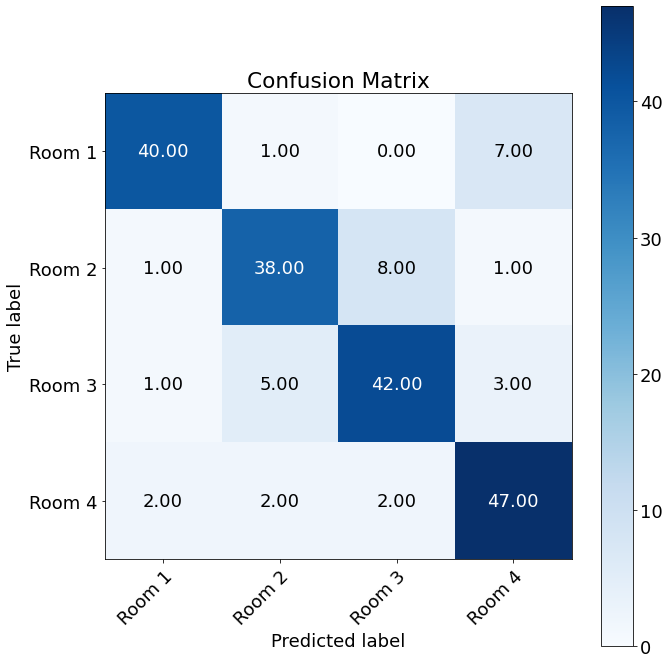

Accuracy pruned 1: 0.915
Macro recall pruned 1: 0.9142792730299667
Macro precision pruned 1: 0.9169124108973733


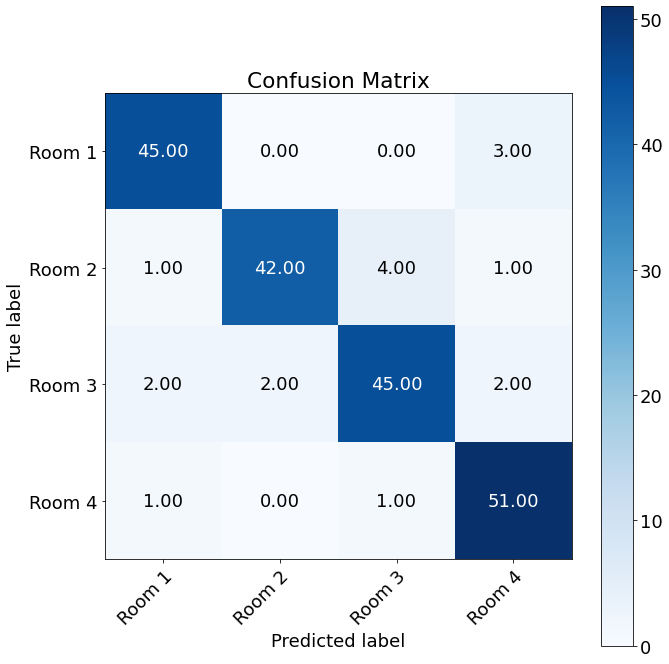

 
Accuracy pruned 2: 0.915
Macro recall pruned 2: 0.9142792730299667
Macro precision pruned 2: 0.9169124108973733


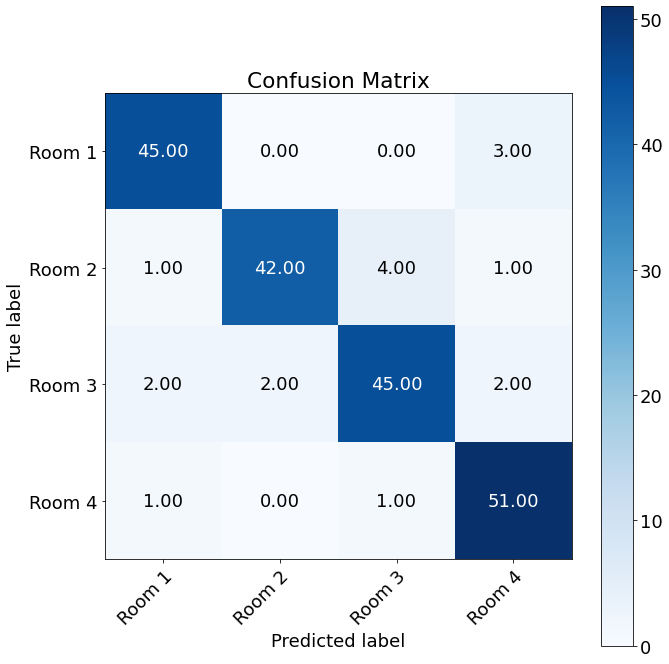

 
Outer Fold:6, Inner fold:2
Accuracy original: 0.805
Macro recall original: 0.8027018590455051
Macro precision original: 0.8054555610724925
 


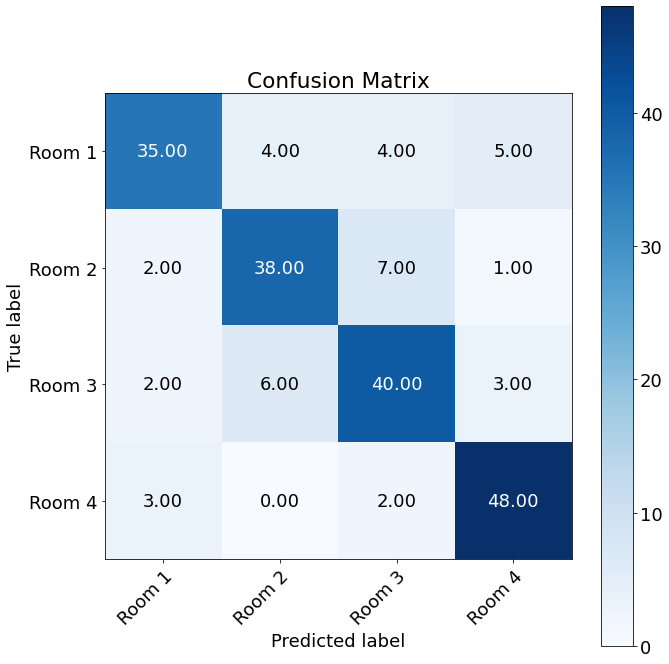

Accuracy pruned 1: 0.915
Macro recall pruned 1: 0.913972900480947
Macro precision pruned 1: 0.9175851497034178


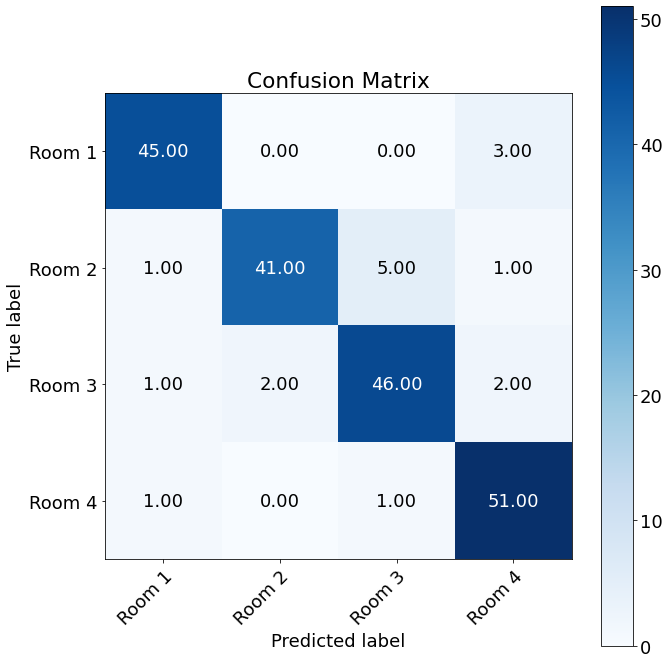

 
Accuracy pruned 2: 0.915
Macro recall pruned 2: 0.913972900480947
Macro precision pruned 2: 0.9175851497034178


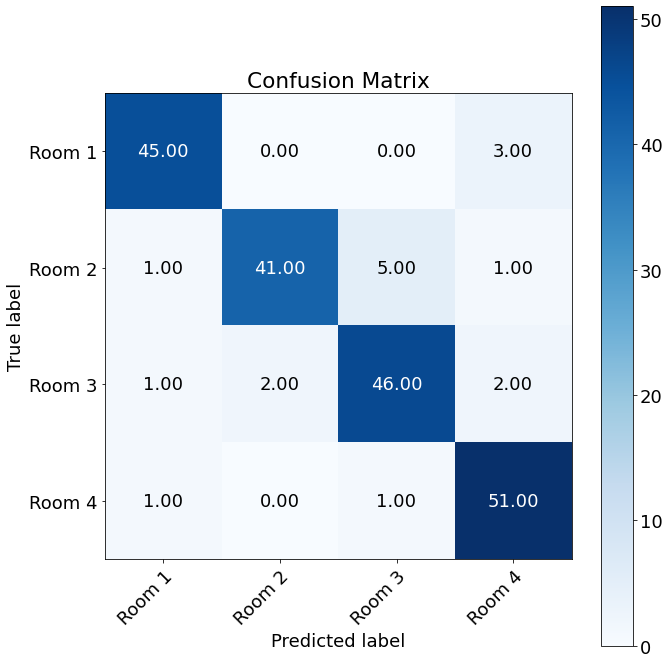

 
Outer Fold:6, Inner fold:3
Accuracy original: 0.825
Macro recall original: 0.8238415649278579
Macro precision original: 0.8262824658234701
 


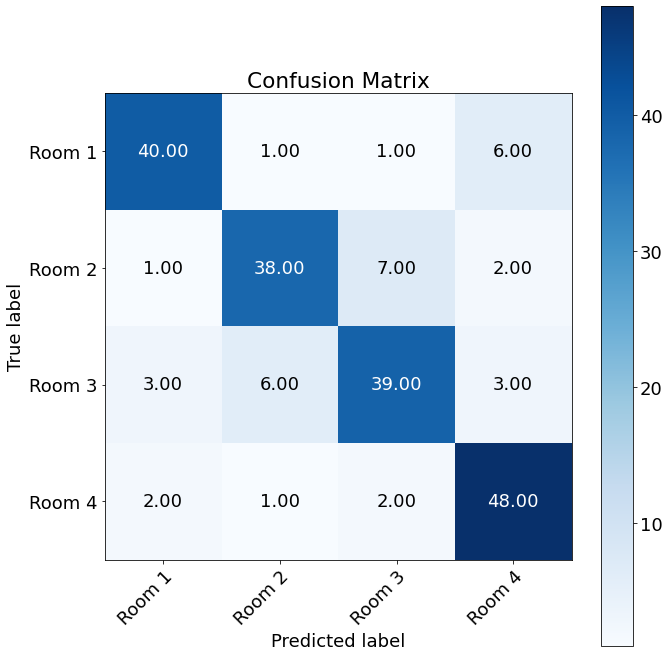

Accuracy pruned 1: 0.9
Macro recall pruned 1: 0.899943349981502
Macro precision pruned 1: 0.9010606060606061


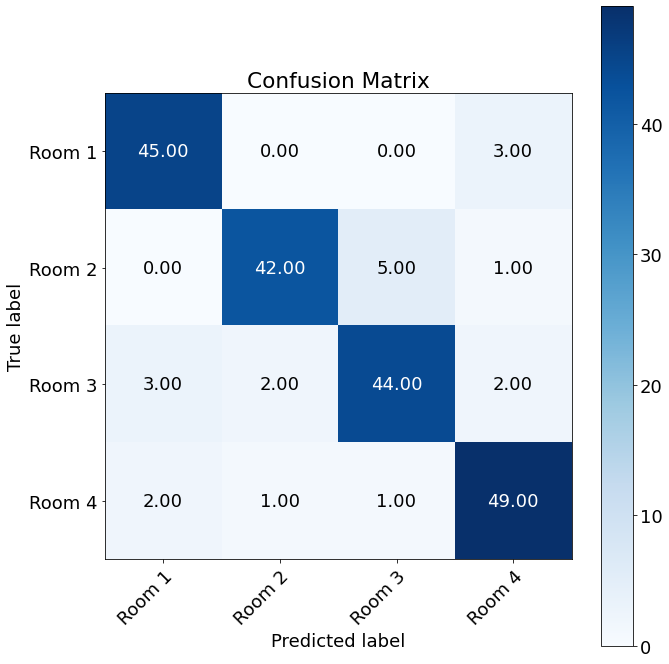

 
Accuracy pruned 2: 0.9
Macro recall pruned 2: 0.899943349981502
Macro precision pruned 2: 0.9010606060606061


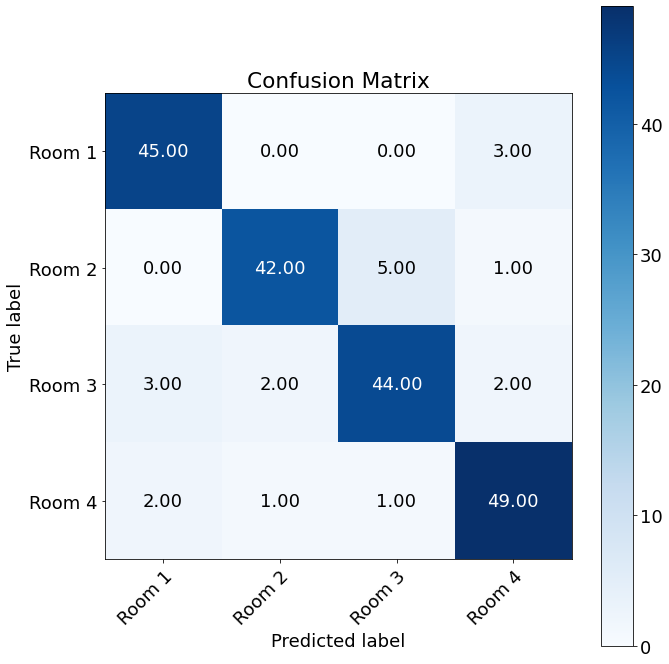

 
Outer Fold:6, Inner fold:4
Accuracy original: 0.815
Macro recall original: 0.8129971328153903
Macro precision original: 0.8163559801002872
 


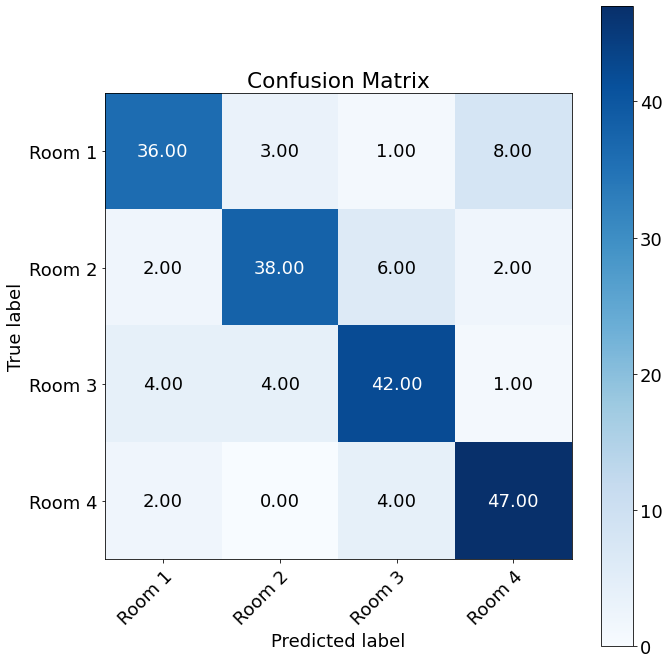

Accuracy pruned 1: 0.895
Macro recall pruned 1: 0.8931395671476138
Macro precision pruned 1: 0.9006072110697065


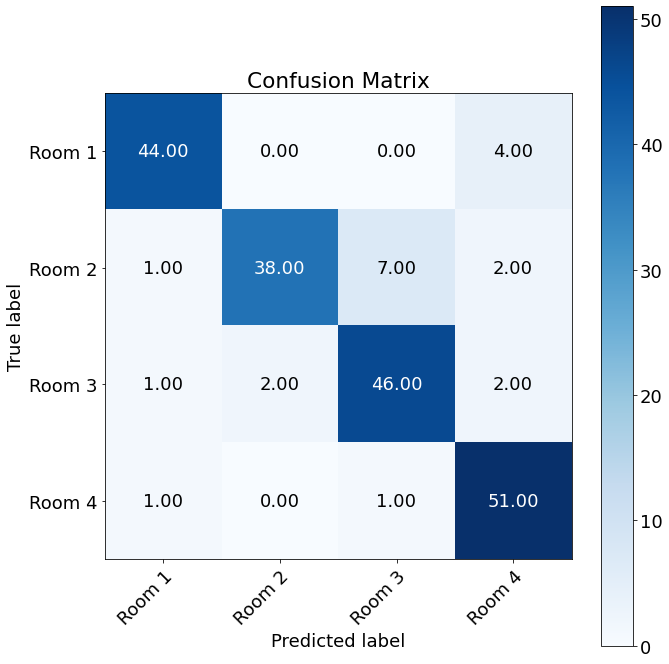

 
Accuracy pruned 2: 0.895
Macro recall pruned 2: 0.8931395671476138
Macro precision pruned 2: 0.9006072110697065


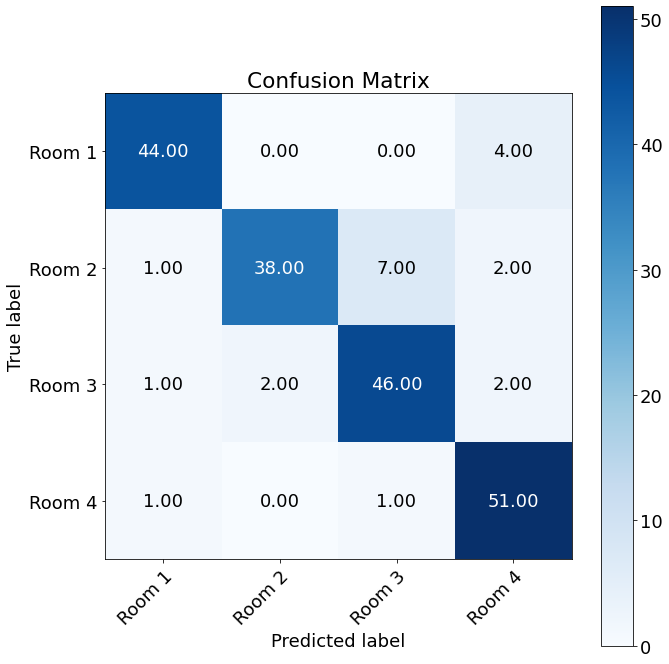

 
Outer Fold:6, Inner fold:5
Accuracy original: 0.81
Macro recall original: 0.8093842489826119
Macro precision original: 0.8149375320727904
 


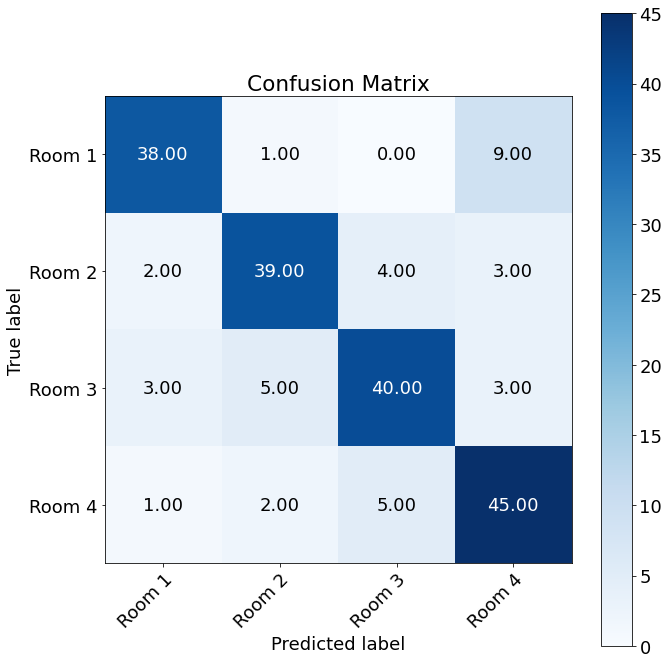

Accuracy pruned 1: 0.915
Macro recall pruned 1: 0.9145856455789864
Macro precision pruned 1: 0.9167397660818714


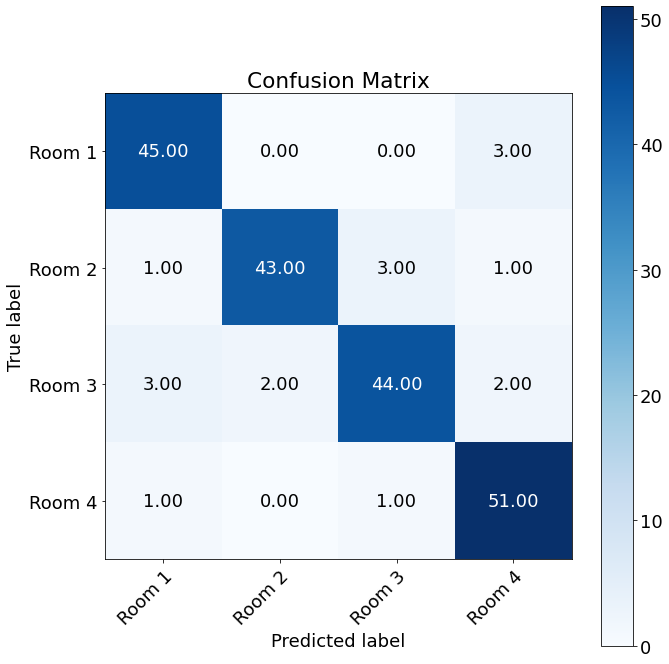

 
Accuracy pruned 2: 0.915
Macro recall pruned 2: 0.9145856455789864
Macro precision pruned 2: 0.9167397660818714


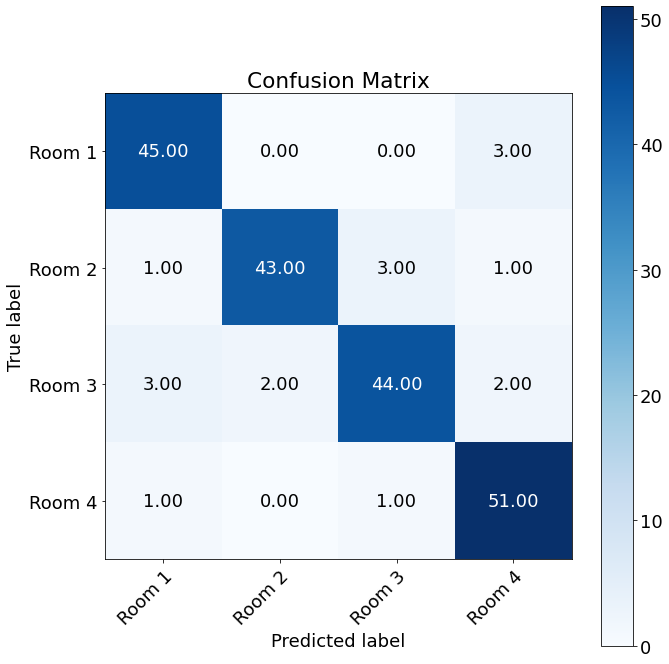

 
Outer Fold:6, Inner fold:6
Accuracy original: 0.82
Macro recall original: 0.8199858953015169
Macro precision original: 0.8224626068376069
 


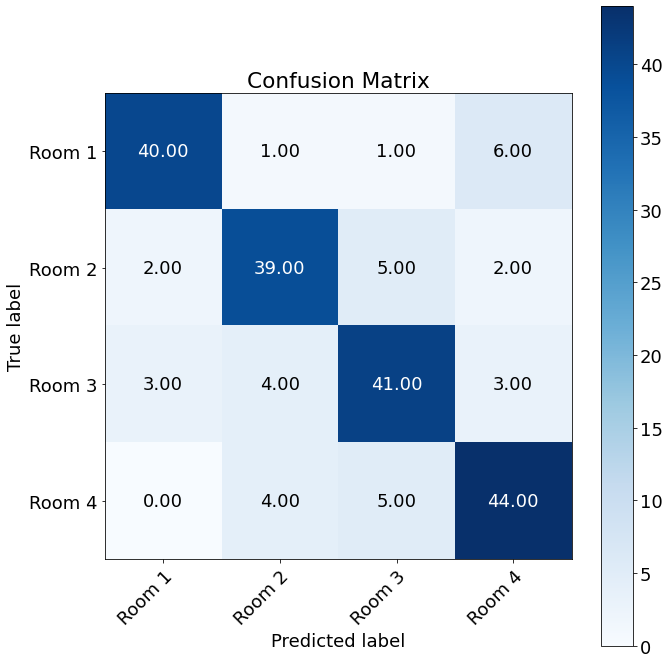

Accuracy pruned 1: 0.91
Macro recall pruned 1: 0.9090709396966333
Macro precision pruned 1: 0.9127915159648463


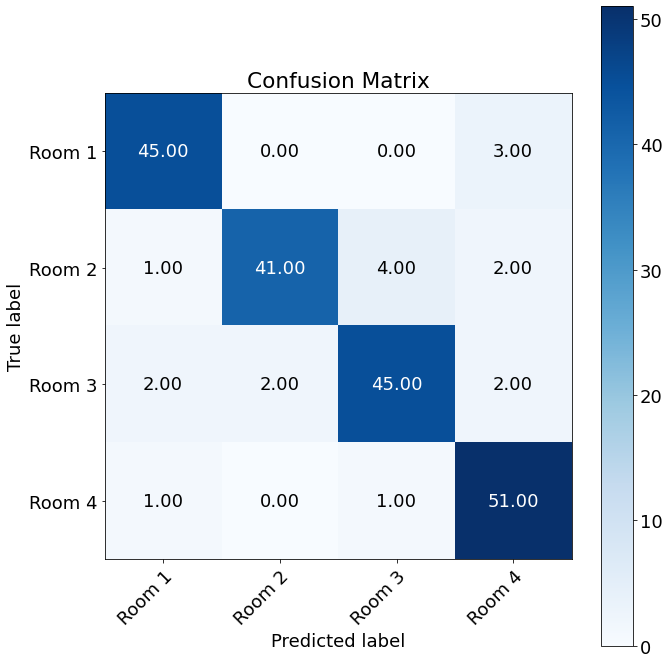

 
Accuracy pruned 2: 0.91
Macro recall pruned 2: 0.9090709396966333
Macro precision pruned 2: 0.9127915159648463


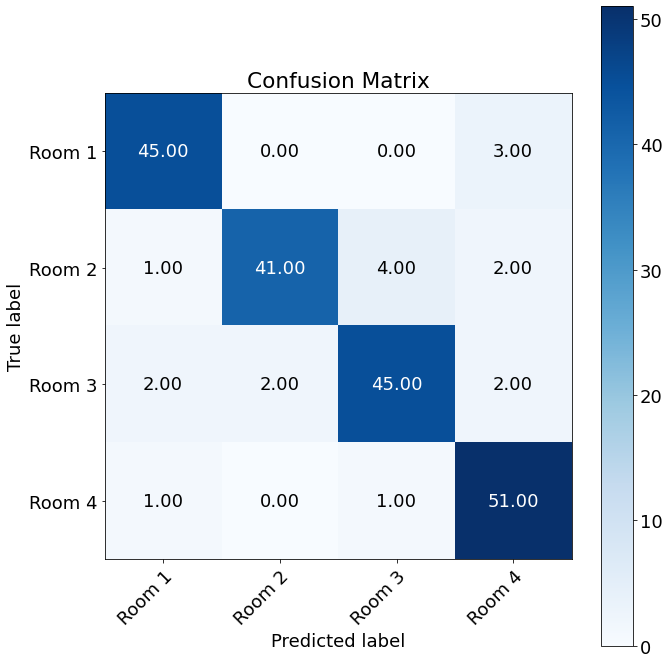

 
Outer Fold:6, Inner fold:7
Accuracy original: 0.835
Macro recall original: 0.8348131705512394
Macro precision original: 0.8377659574468085
 


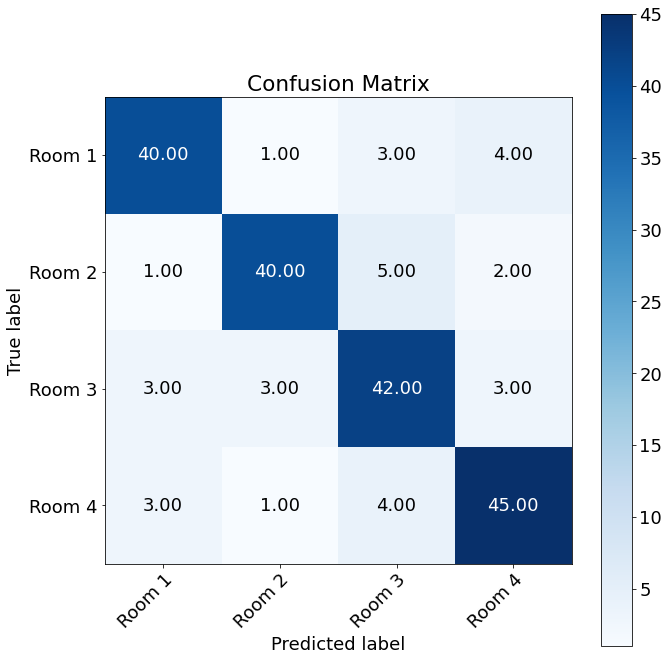

Accuracy pruned 1: 0.89
Macro recall pruned 1: 0.889833055863855
Macro precision pruned 1: 0.8912700534759357


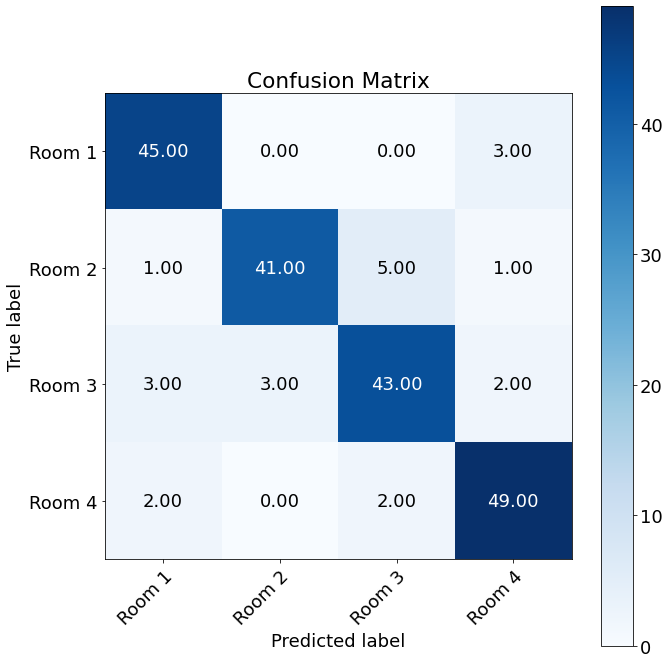

 
Accuracy pruned 2: 0.89
Macro recall pruned 2: 0.889833055863855
Macro precision pruned 2: 0.8912700534759357


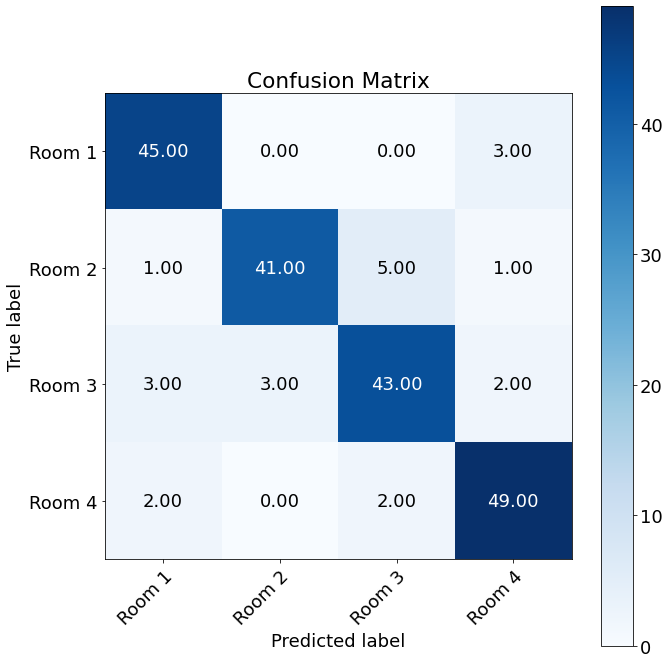

 
Outer Fold:6, Inner fold:8
Accuracy original: 0.81
Macro recall original: 0.8108583055863854
Macro precision original: 0.8120236773954865
 


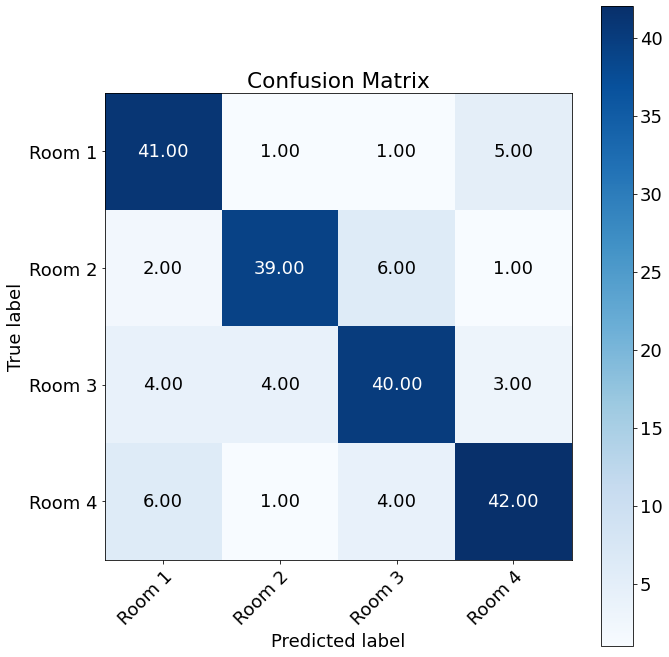

Accuracy pruned 1: 0.9
Macro recall pruned 1: 0.8993306048834628
Macro precision pruned 1: 0.901858381072322


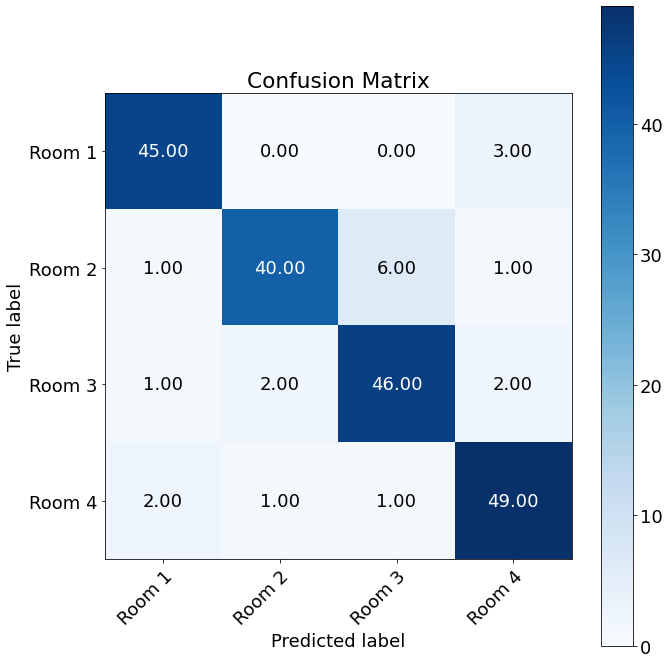

 
Accuracy pruned 2: 0.9
Macro recall pruned 2: 0.8993306048834628
Macro precision pruned 2: 0.901858381072322


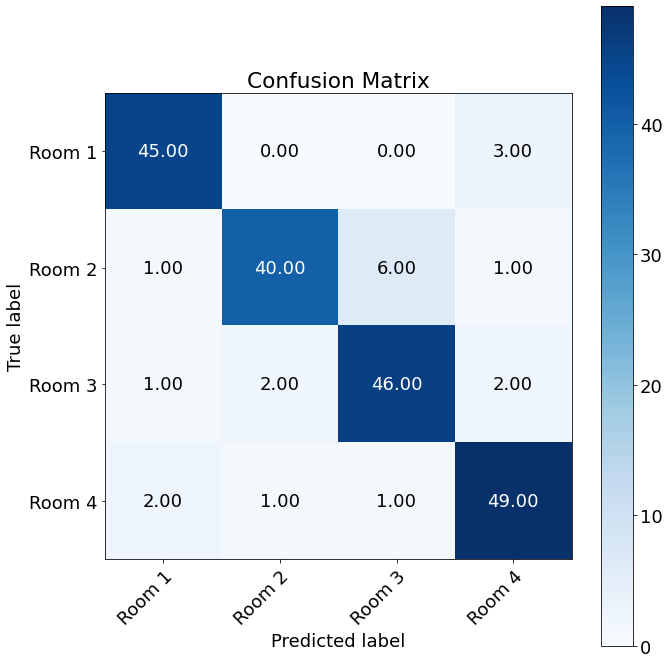

 
Outer Fold:6, Inner fold:9
Accuracy original: 0.82
Macro recall original: 0.8185118386977432
Macro precision original: 0.8237198986768403
 


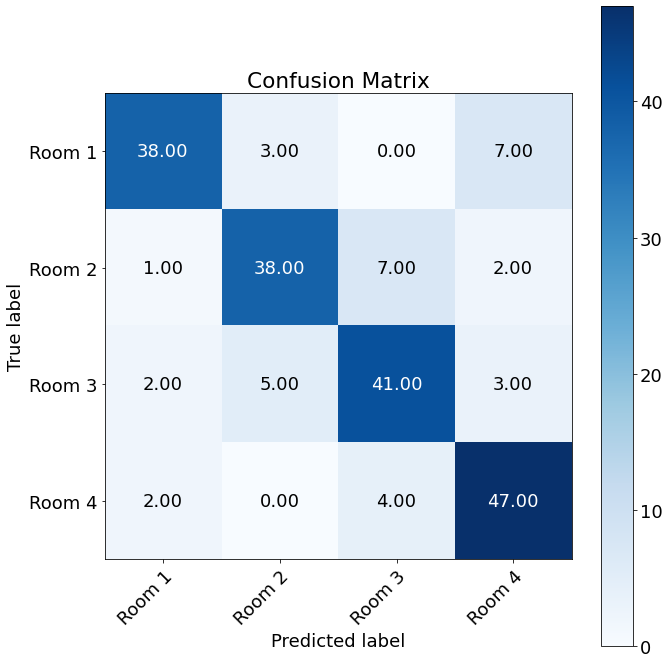

Accuracy pruned 1: 0.91
Macro recall pruned 1: 0.9090709396966333
Macro precision pruned 1: 0.9116019912749789


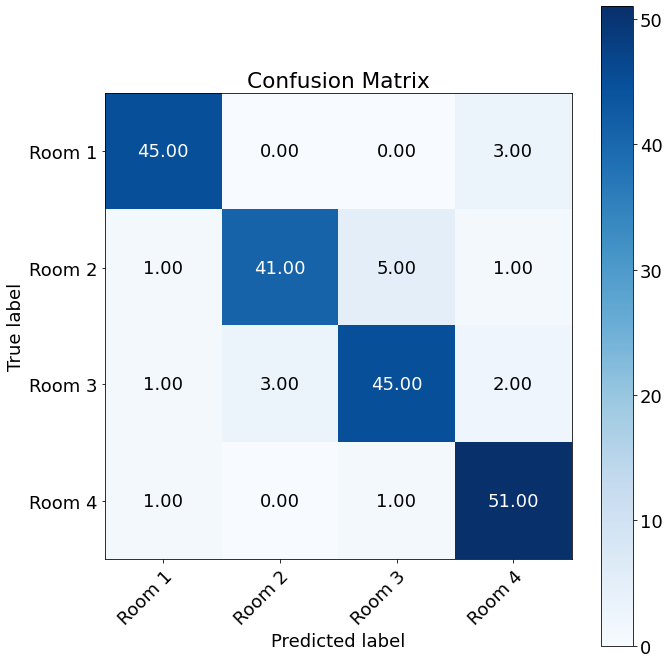

 
Accuracy pruned 2: 0.91
Macro recall pruned 2: 0.9090709396966333
Macro precision pruned 2: 0.9116019912749789


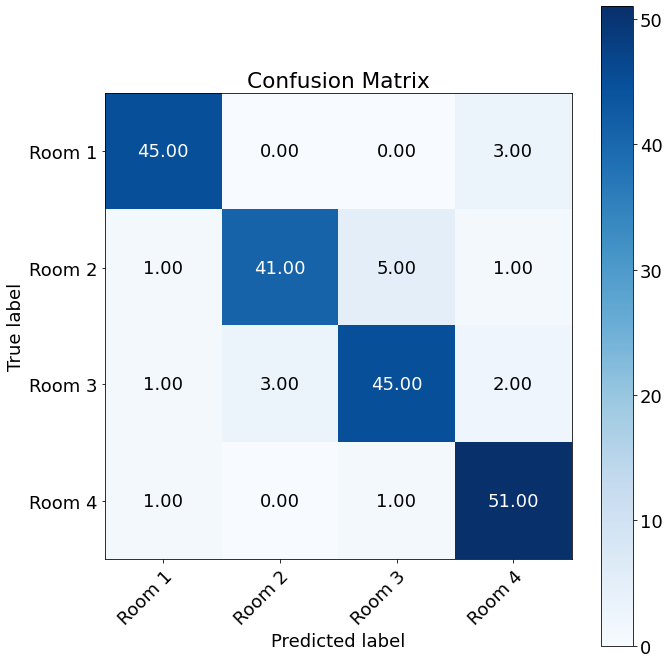

 
Outer Fold:6, Inner fold:10
Accuracy original: 0.82
Macro recall original: 0.8182054661487236
Macro precision original: 0.8235488187523071
 


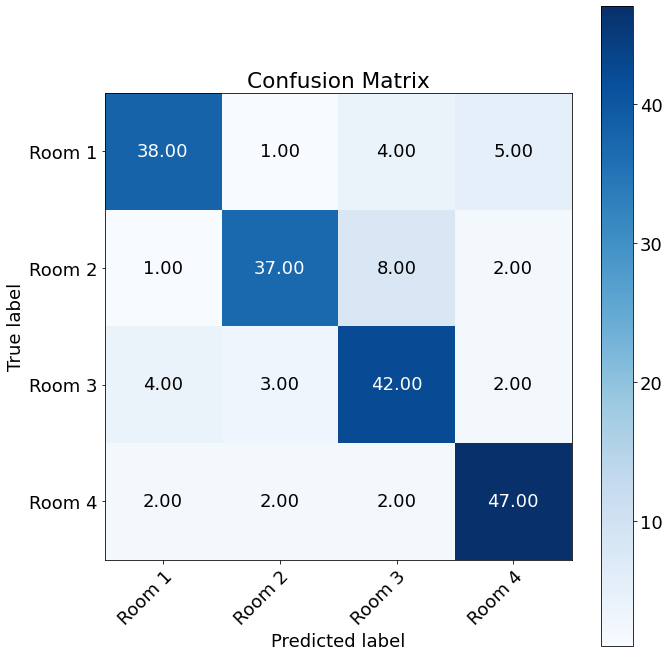

Accuracy pruned 1: 0.91
Macro recall pruned 1: 0.9090709396966333
Macro precision pruned 1: 0.91316291452427


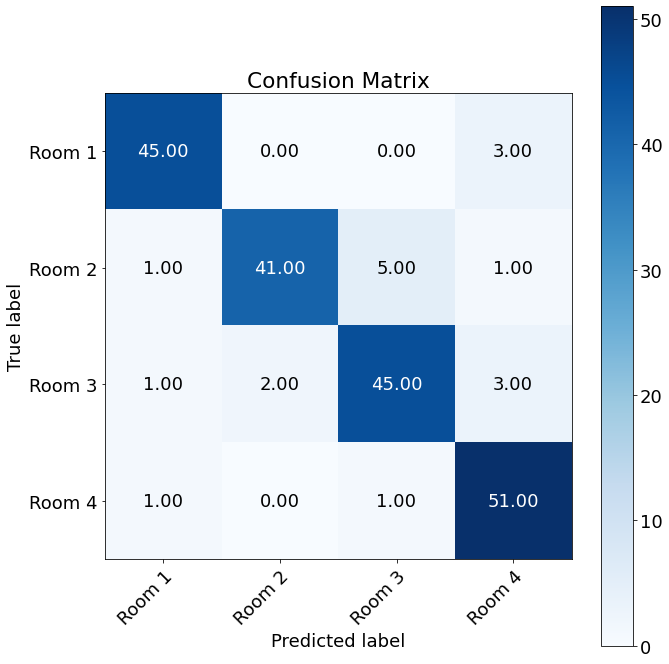

 
Accuracy pruned 2: 0.91
Macro recall pruned 2: 0.9090709396966333
Macro precision pruned 2: 0.91316291452427


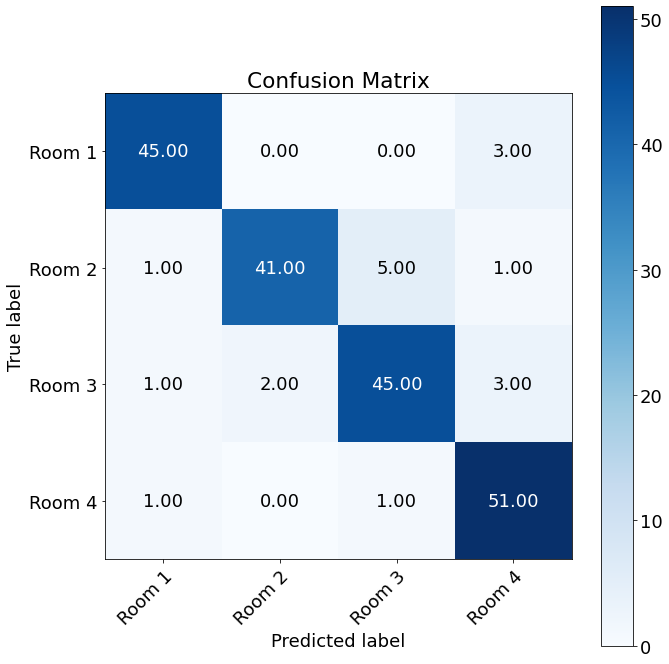

 
Outer Fold:7, Inner fold:1
Accuracy original: 0.83
Macro recall original: 0.8336857323574591
Macro precision original: 0.8300276720857834
 


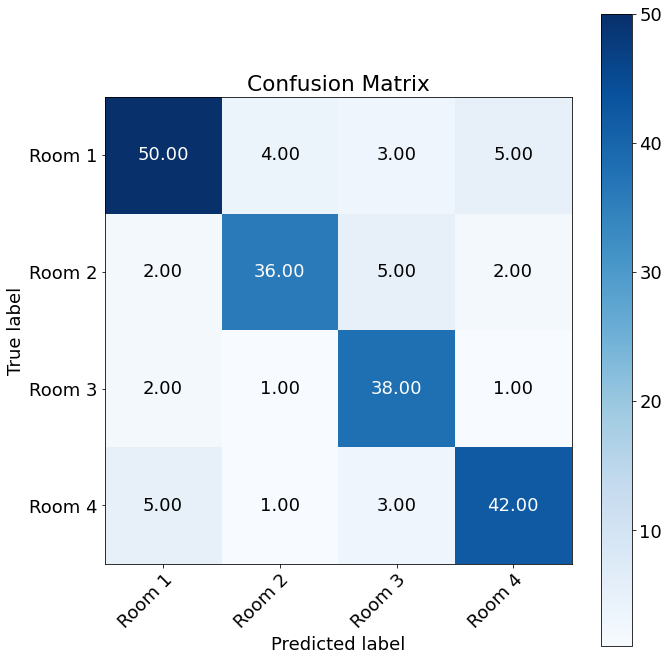

Accuracy pruned 1: 0.915
Macro recall pruned 1: 0.9122789976205535
Macro precision pruned 1: 0.9160654821369106


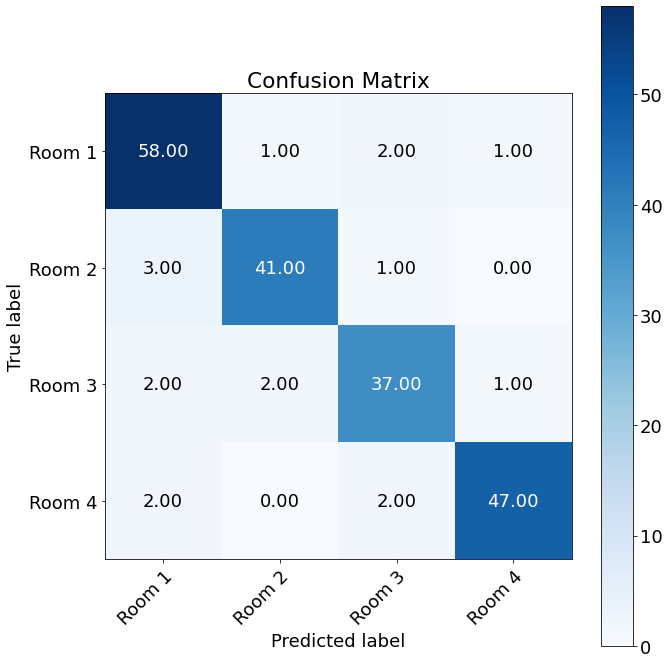

 
Accuracy pruned 2: 0.915
Macro recall pruned 2: 0.9122789976205535
Macro precision pruned 2: 0.9160654821369106


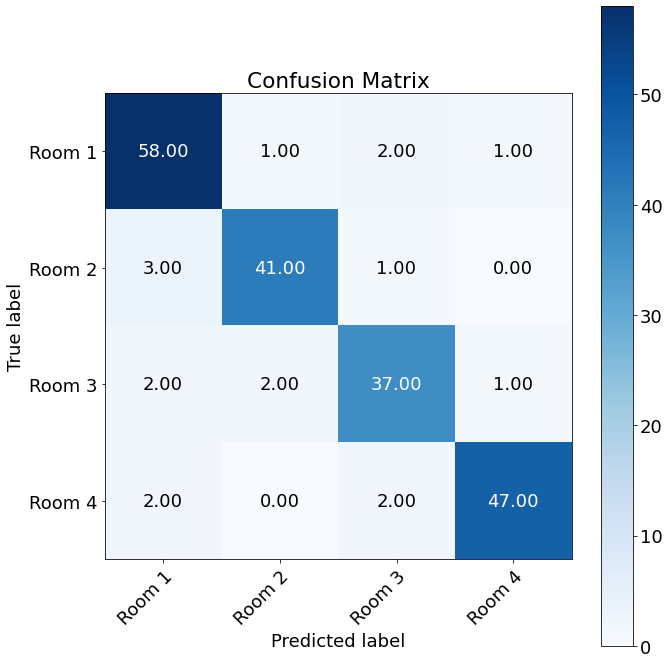

 
Outer Fold:7, Inner fold:2
Accuracy original: 0.8
Macro recall original: 0.8043500195777236
Macro precision original: 0.804780537313273
 


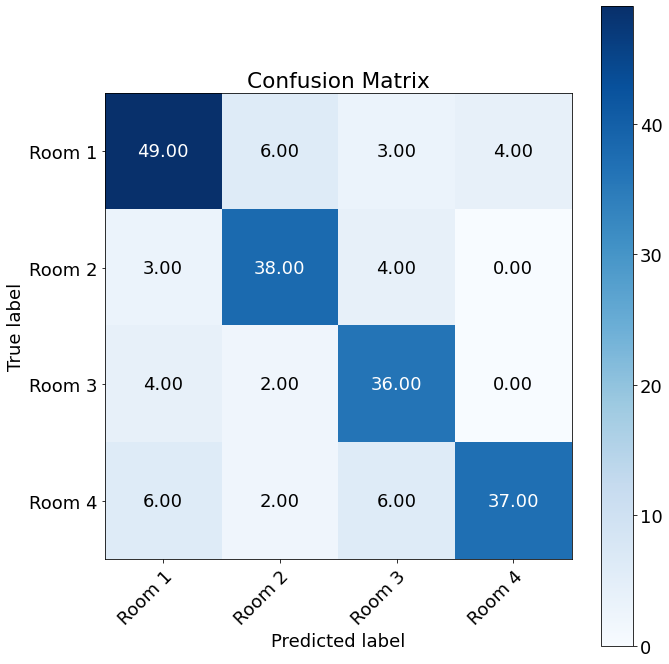

Accuracy pruned 1: 0.905
Macro recall pruned 1: 0.8969308153368875
Macro precision pruned 1: 0.9062905864100026


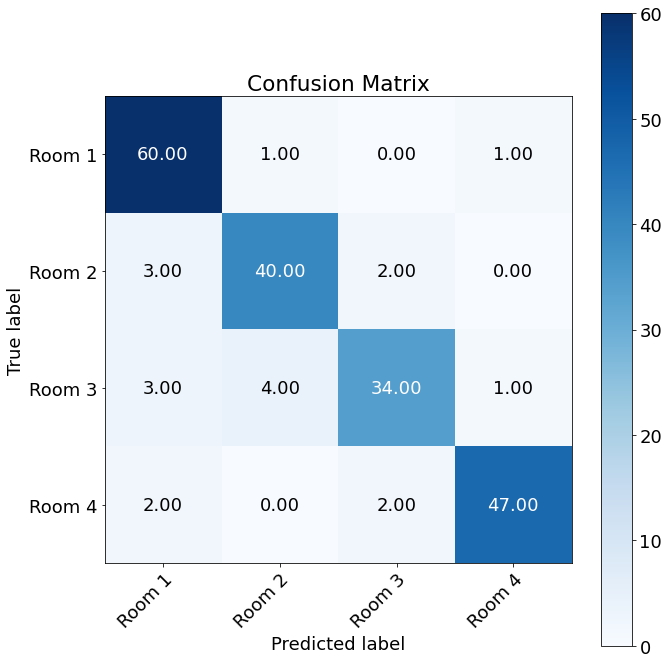

 
Accuracy pruned 2: 0.905
Macro recall pruned 2: 0.8969308153368875
Macro precision pruned 2: 0.9062905864100026


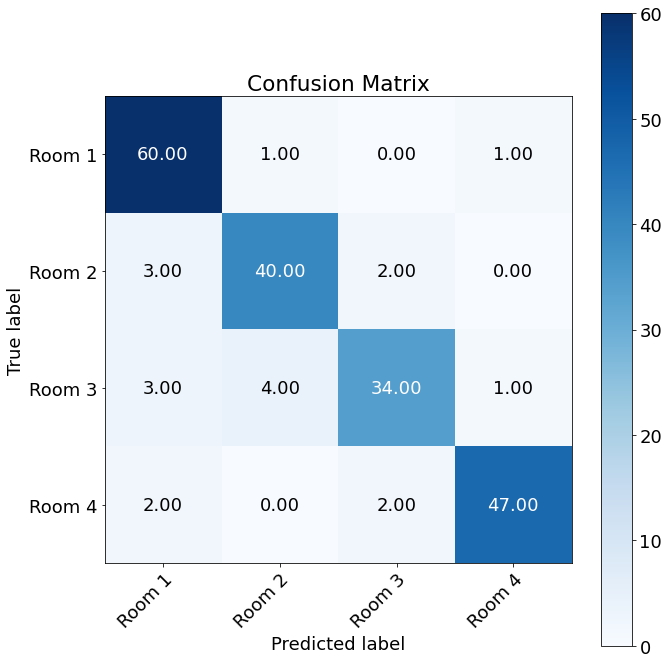

 
Outer Fold:7, Inner fold:3
Accuracy original: 0.865
Macro recall original: 0.8631780669256951
Macro precision original: 0.8668269230769231
 


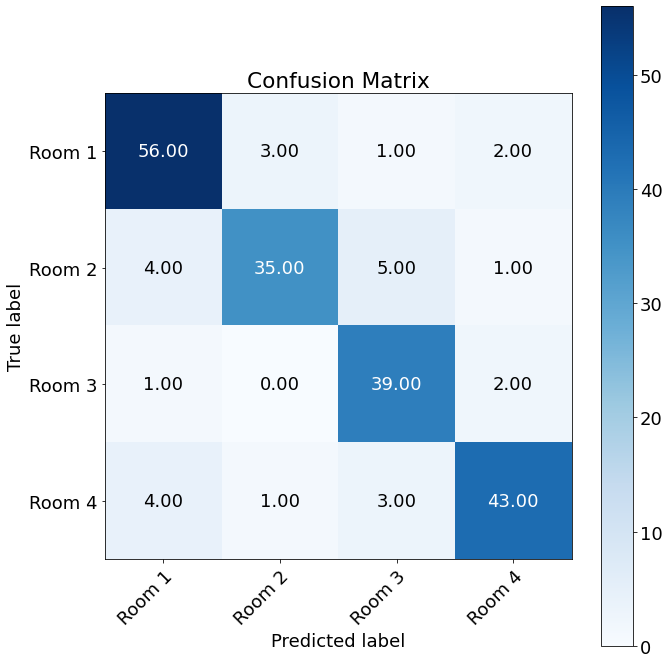

Accuracy pruned 1: 0.925
Macro recall pruned 1: 0.9217907593144784
Macro precision pruned 1: 0.9301085104996971


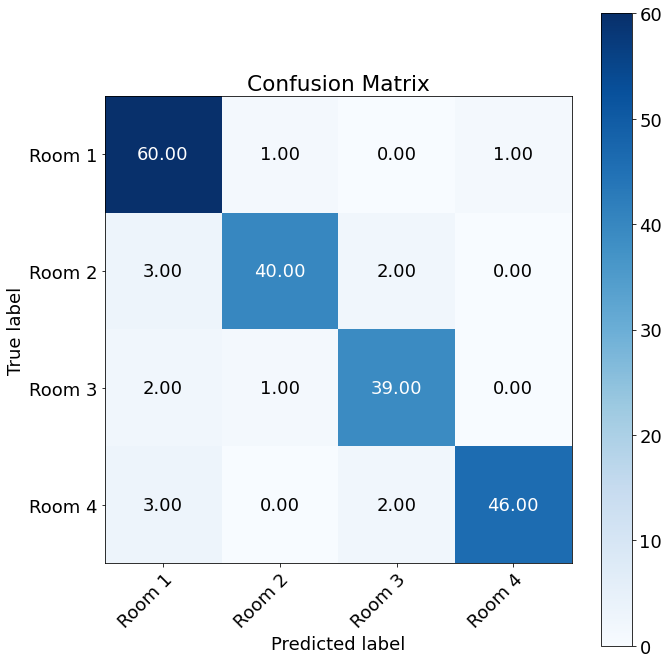

 
Accuracy pruned 2: 0.925
Macro recall pruned 2: 0.9217907593144784
Macro precision pruned 2: 0.9301085104996971


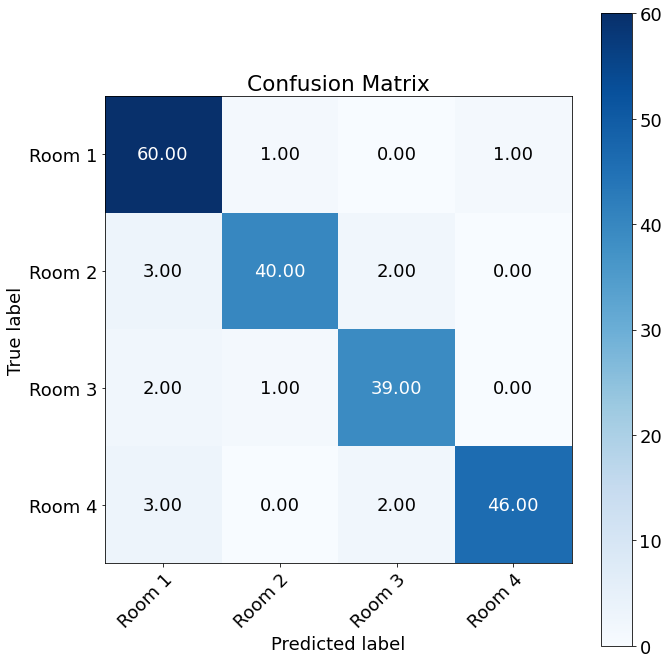

 
Outer Fold:7, Inner fold:4
Accuracy original: 0.825
Macro recall original: 0.8275526339568086
Macro precision original: 0.8228382280852626
 


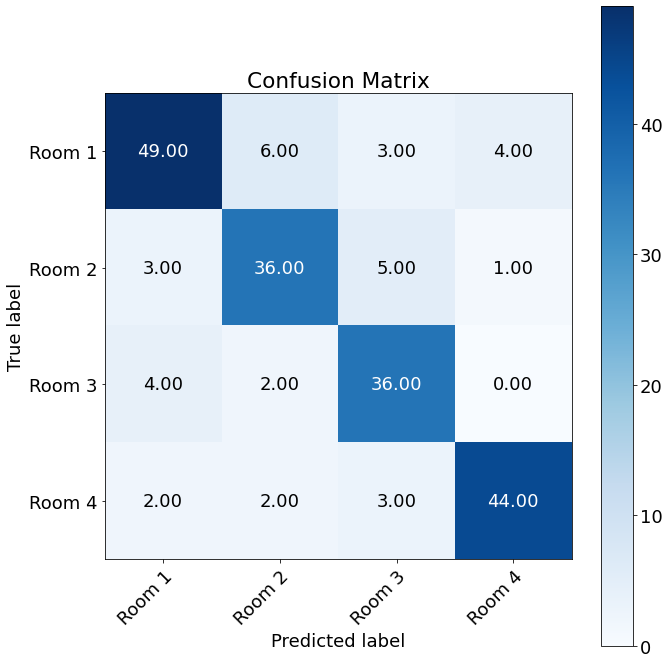

Accuracy pruned 1: 0.91
Macro recall pruned 1: 0.9062505647420258
Macro precision pruned 1: 0.9114196678026465


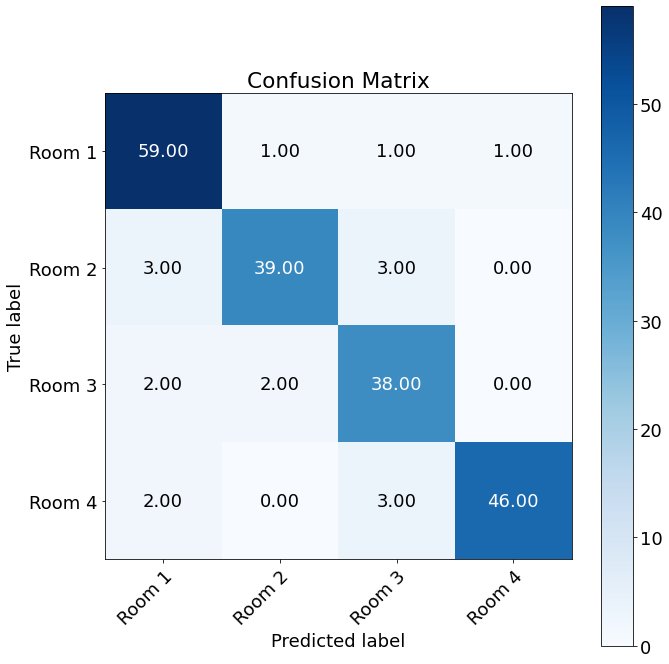

 
Accuracy pruned 2: 0.91
Macro recall pruned 2: 0.9062505647420258
Macro precision pruned 2: 0.9114196678026465


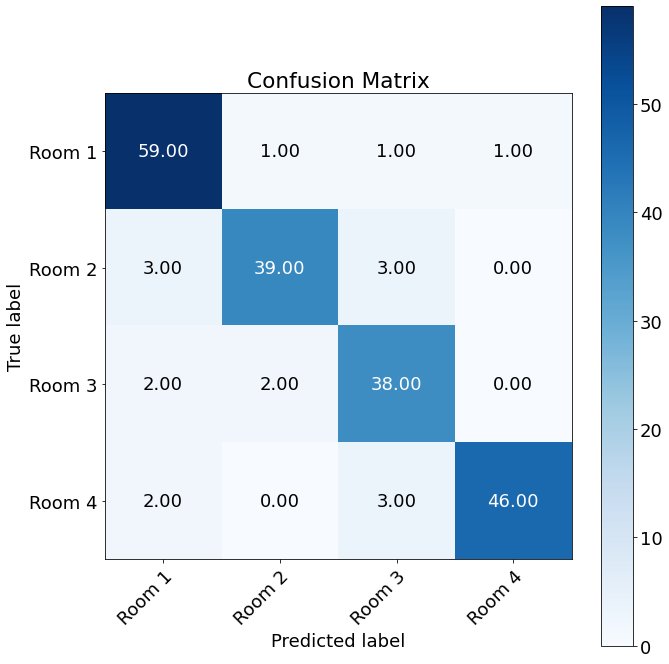

 
Outer Fold:7, Inner fold:5
Accuracy original: 0.835
Macro recall original: 0.8409806933526098
Macro precision original: 0.8348365587900471
 


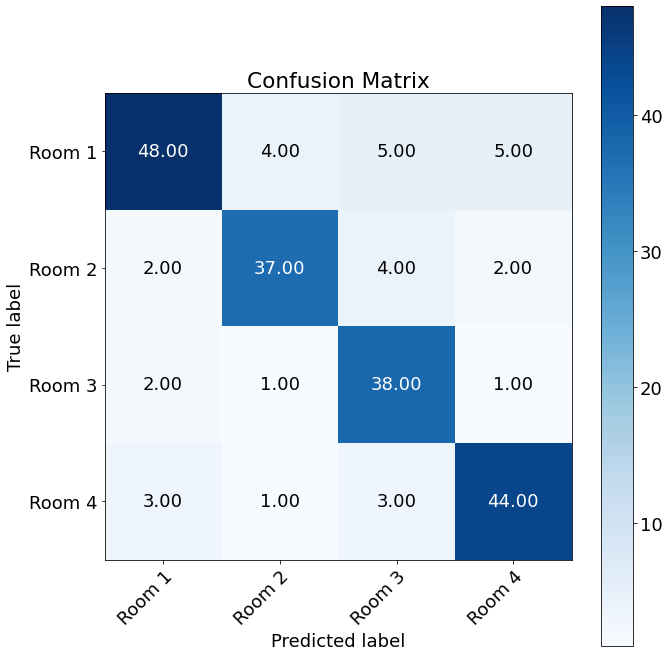

Accuracy pruned 1: 0.92
Macro recall pruned 1: 0.9182313785729345
Macro precision pruned 1: 0.9223579362952186


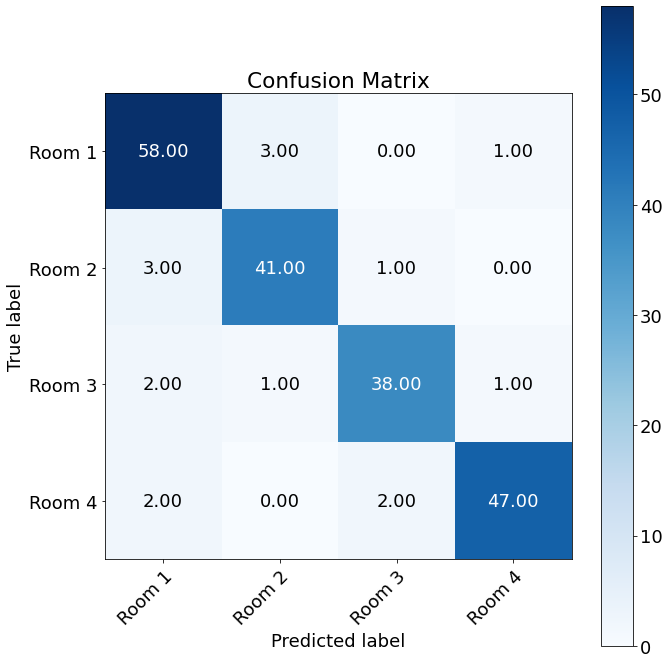

 
Accuracy pruned 2: 0.92
Macro recall pruned 2: 0.9182313785729345
Macro precision pruned 2: 0.9223579362952186


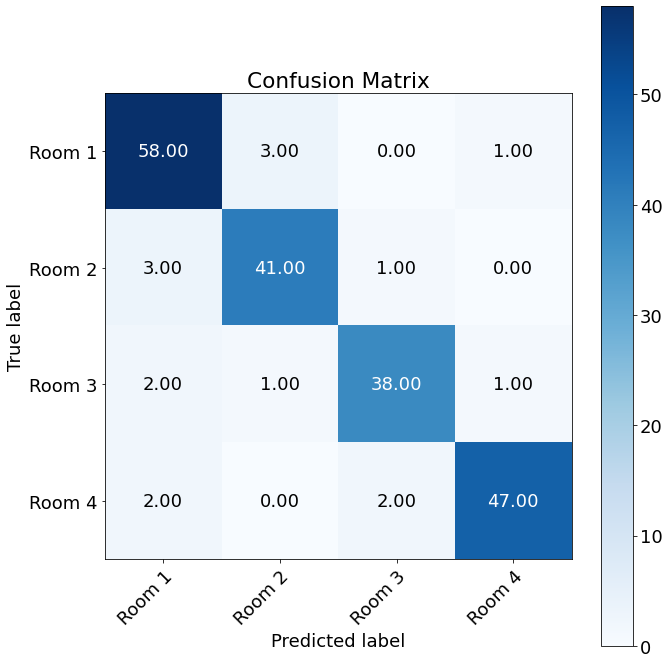

 
Outer Fold:7, Inner fold:6
Accuracy original: 0.85
Macro recall original: 0.8532581849944278
Macro precision original: 0.8530167672891344
 


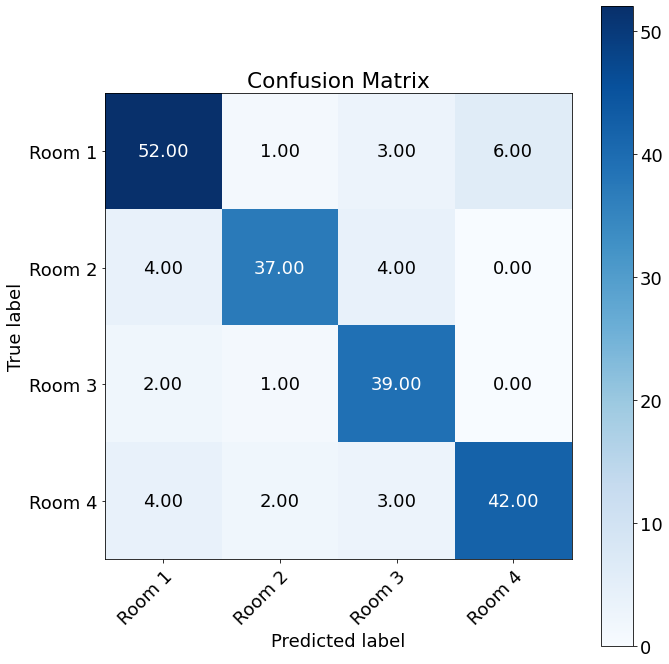

Accuracy pruned 1: 0.92
Macro recall pruned 1: 0.916708081081895
Macro precision pruned 1: 0.922306237505573


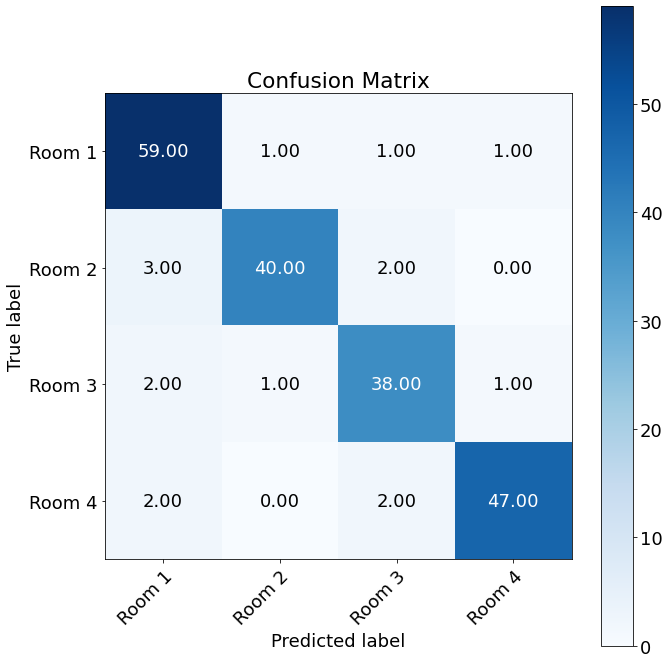

 
Accuracy pruned 2: 0.92
Macro recall pruned 2: 0.916708081081895
Macro precision pruned 2: 0.922306237505573


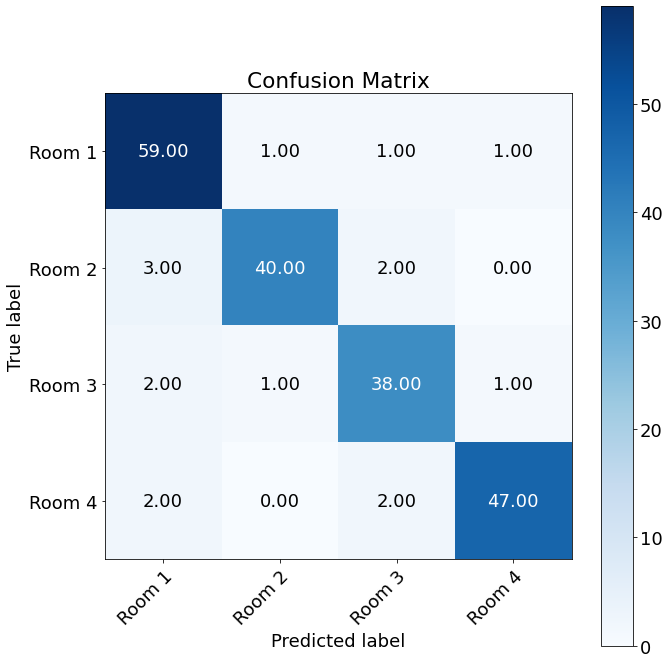

 
Outer Fold:7, Inner fold:7
Accuracy original: 0.81
Macro recall original: 0.8116156139875305
Macro precision original: 0.8073313343328336
 


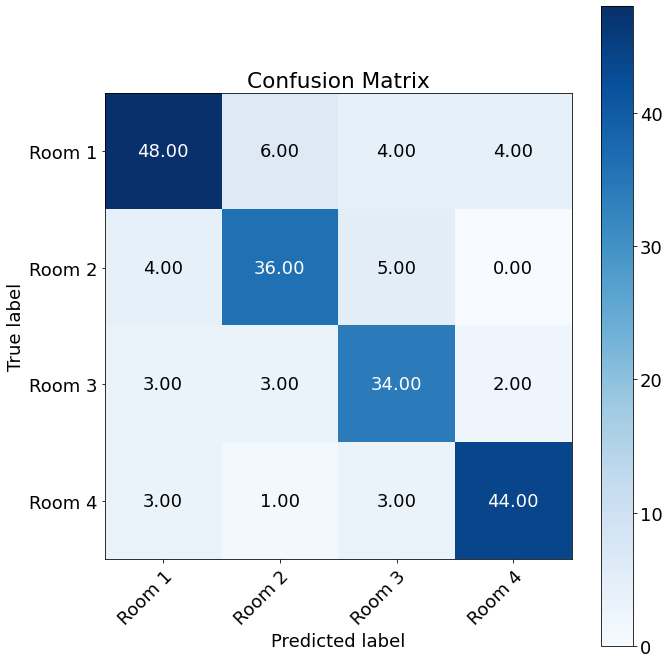

Accuracy pruned 1: 0.92
Macro recall pruned 1: 0.9147879581940302
Macro precision pruned 1: 0.9240891478542637


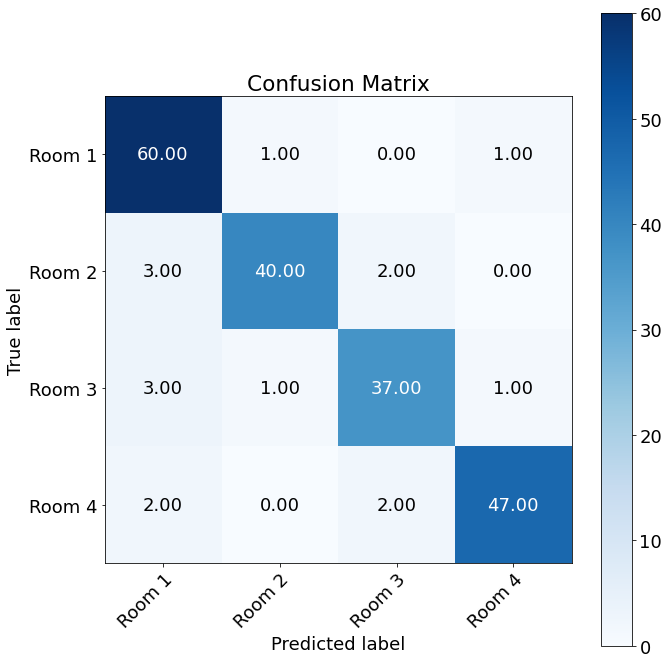

 
Accuracy pruned 2: 0.92
Macro recall pruned 2: 0.9147879581940302
Macro precision pruned 2: 0.9240891478542637


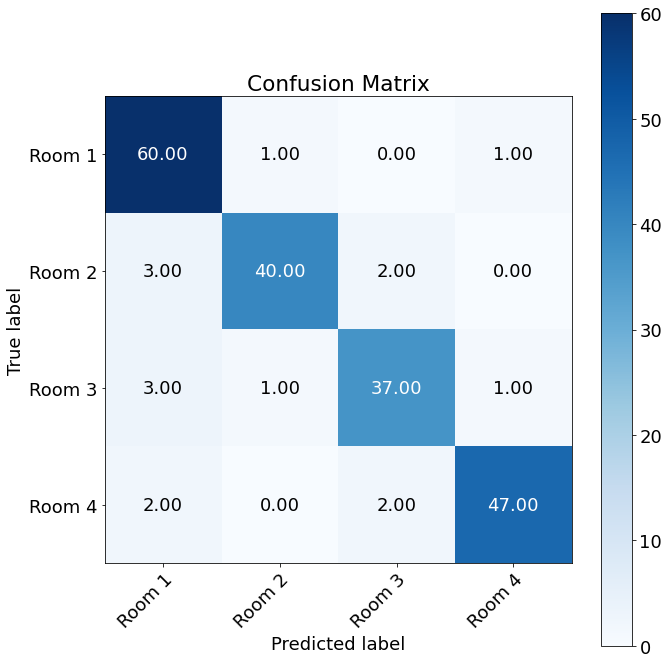

 
Outer Fold:7, Inner fold:8
Accuracy original: 0.82
Macro recall original: 0.8234443239661456
Macro precision original: 0.8165936829277166
 


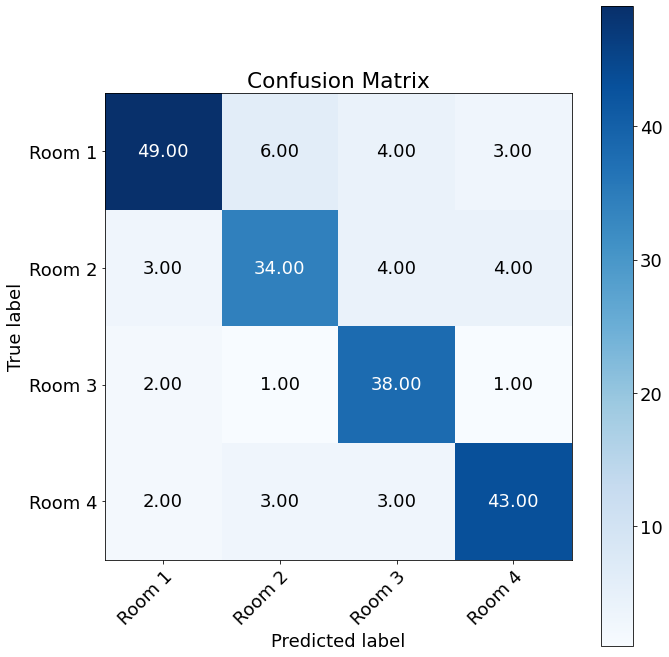

Accuracy pruned 1: 0.93
Macro recall pruned 1: 0.9301361404776963
Macro precision pruned 1: 0.93200323866333


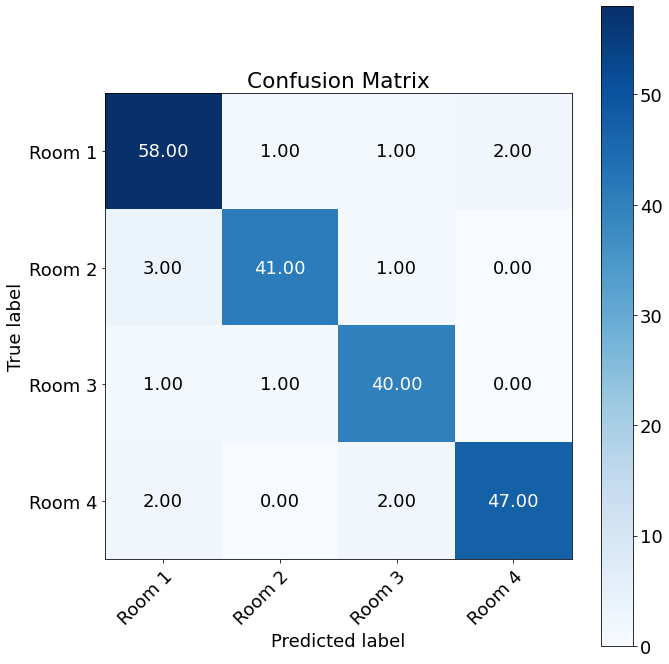

 
Accuracy pruned 2: 0.93
Macro recall pruned 2: 0.9301361404776963
Macro precision pruned 2: 0.93200323866333


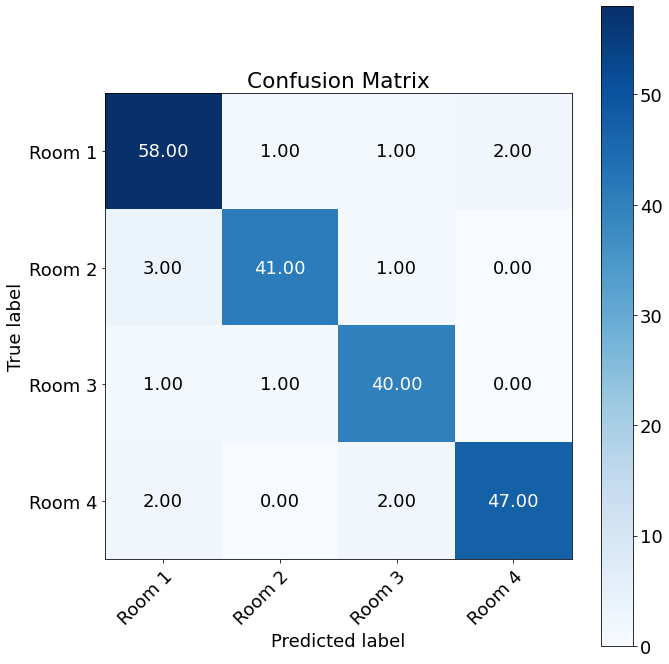

 
Outer Fold:7, Inner fold:9
Accuracy original: 0.83
Macro recall original: 0.839125327550375
Macro precision original: 0.8295219619468341
 


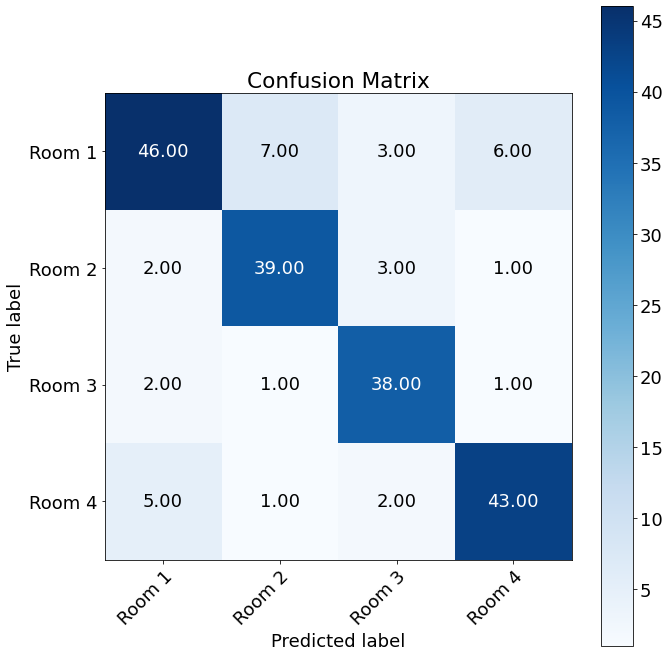

Accuracy pruned 1: 0.93
Macro recall pruned 1: 0.9266927200987921
Macro precision pruned 1: 0.9335116878233417


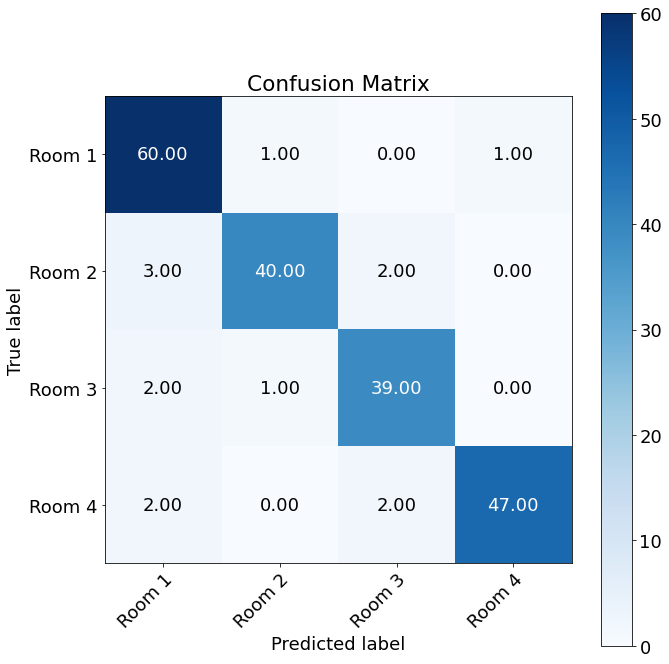

 
Accuracy pruned 2: 0.93
Macro recall pruned 2: 0.9266927200987921
Macro precision pruned 2: 0.9335116878233417


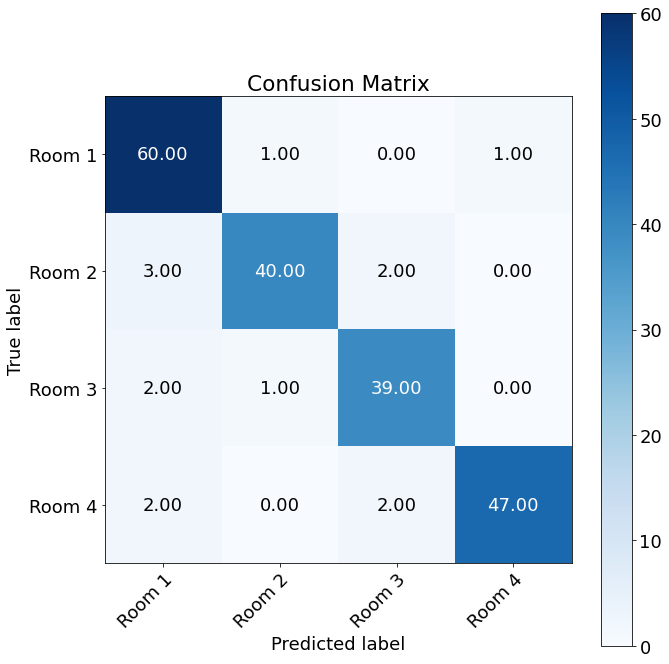

 
Outer Fold:7, Inner fold:10
Accuracy original: 0.82
Macro recall original: 0.8223585132977922
Macro precision original: 0.8187500000000001
 


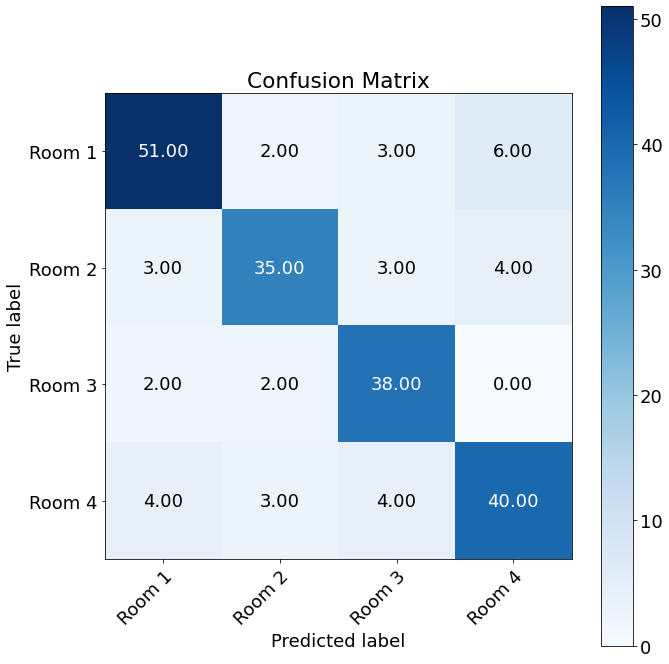

Accuracy pruned 1: 0.92
Macro recall pruned 1: 0.9147879581940302
Macro precision pruned 1: 0.9235477975932289


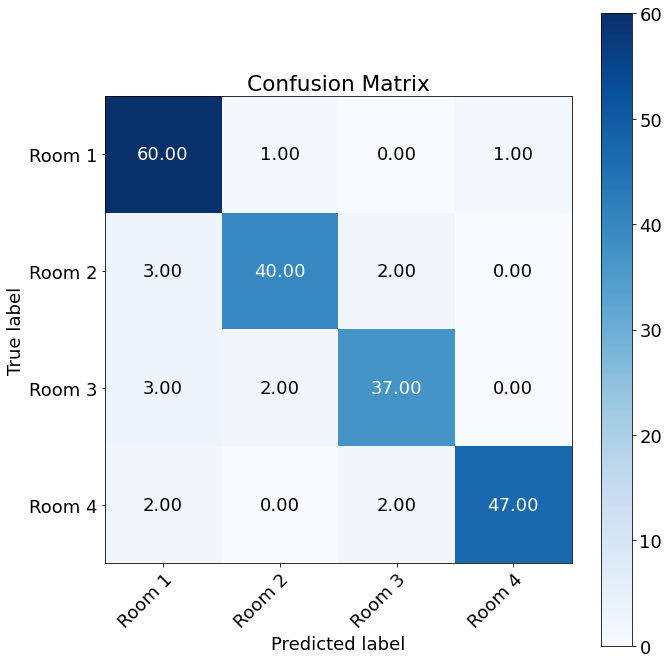

 
Accuracy pruned 2: 0.92
Macro recall pruned 2: 0.9147879581940302
Macro precision pruned 2: 0.9235477975932289


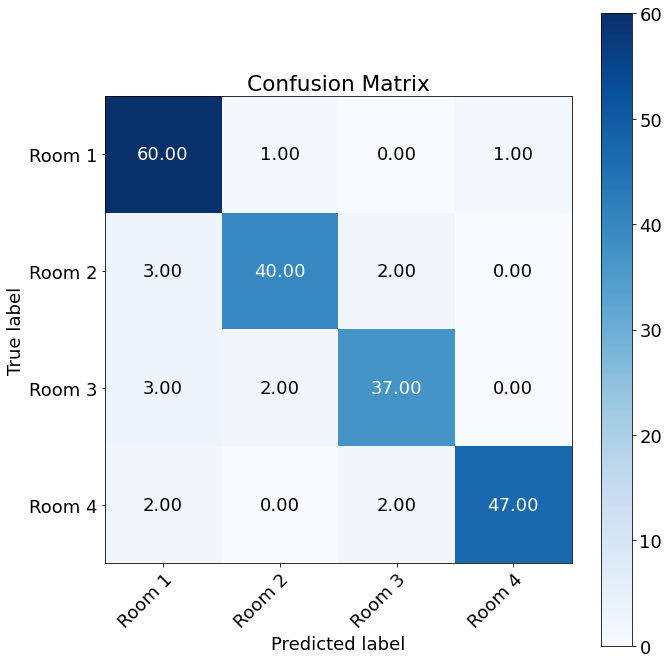

 
Outer Fold:8, Inner fold:1
Accuracy original: 0.73
Macro recall original: 0.7300774397809439
Macro precision original: 0.7392762881044959
 


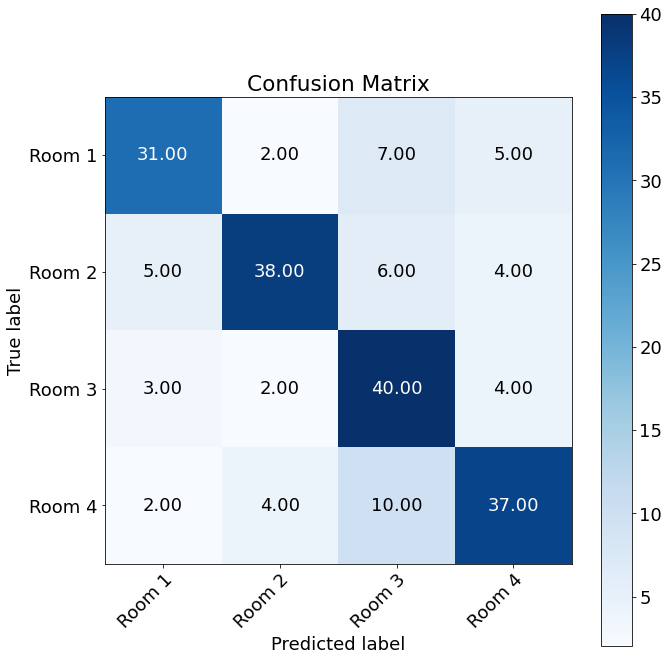

Accuracy pruned 1: 0.865
Macro recall pruned 1: 0.8628524365721131
Macro precision pruned 1: 0.8707840901237127


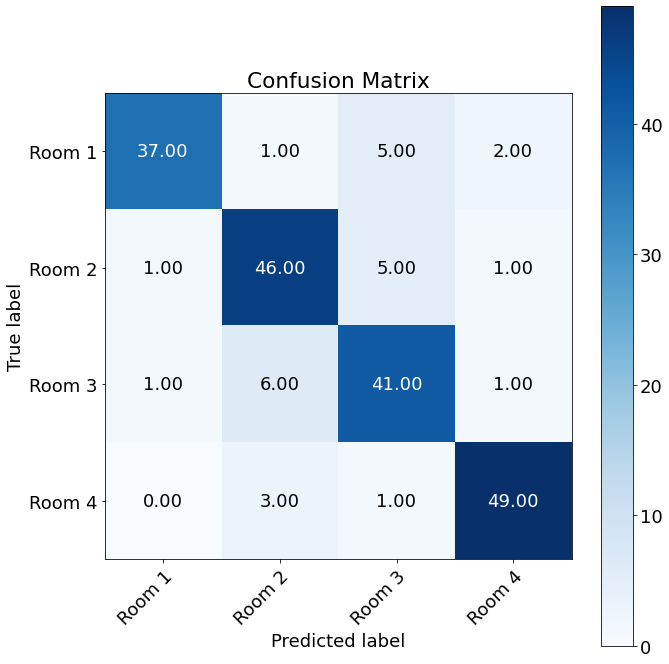

 
Accuracy pruned 2: 0.865
Macro recall pruned 2: 0.8628524365721131
Macro precision pruned 2: 0.8707840901237127


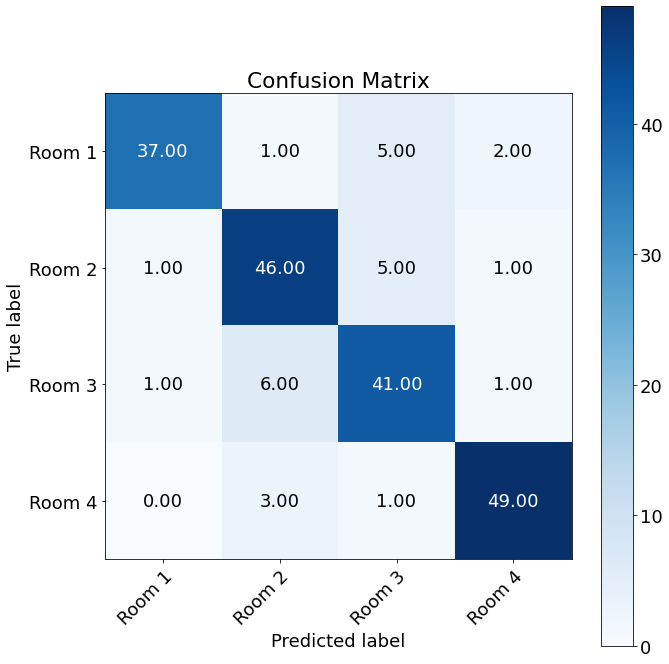

 
Outer Fold:8, Inner fold:2
Accuracy original: 0.81
Macro recall original: 0.8076113464253627
Macro precision original: 0.8198391198584697
 


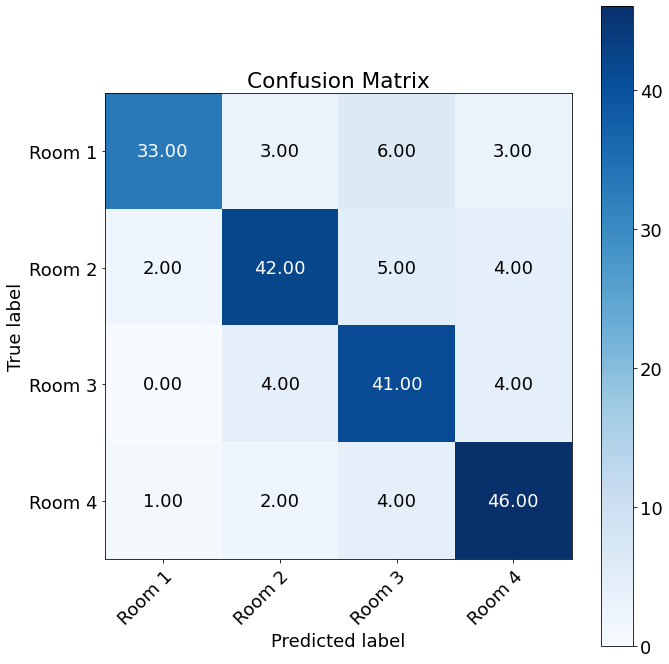

Accuracy pruned 1: 0.875
Macro recall pruned 1: 0.8733731228340393
Macro precision pruned 1: 0.8832090940404158


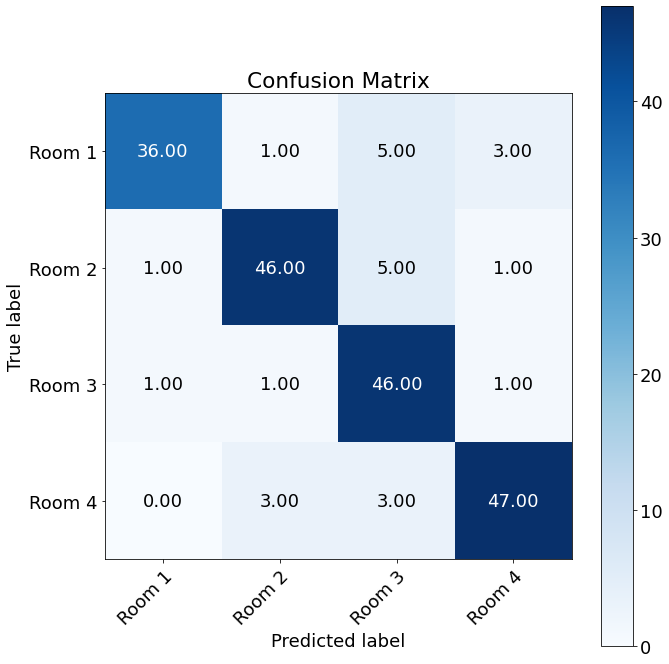

 
Accuracy pruned 2: 0.875
Macro recall pruned 2: 0.8733731228340393
Macro precision pruned 2: 0.8832090940404158


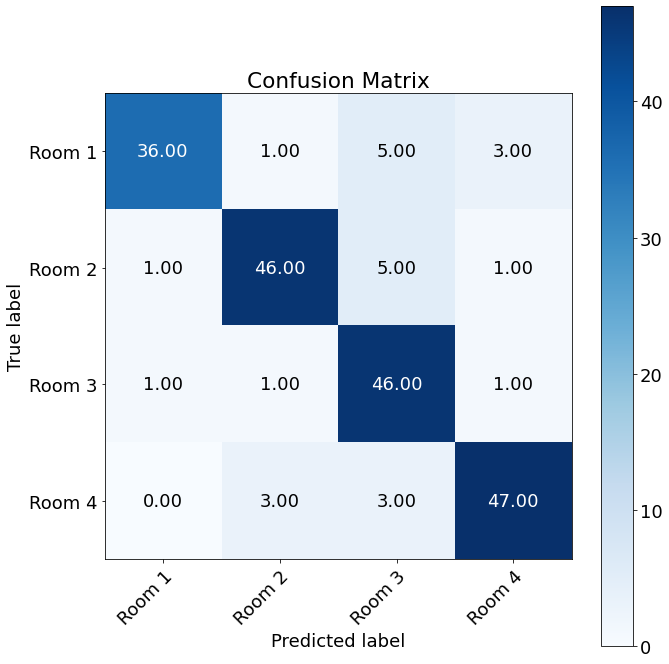

 
Outer Fold:8, Inner fold:3
Accuracy original: 0.78
Macro recall original: 0.7771787960467207
Macro precision original: 0.7854307091595227
 


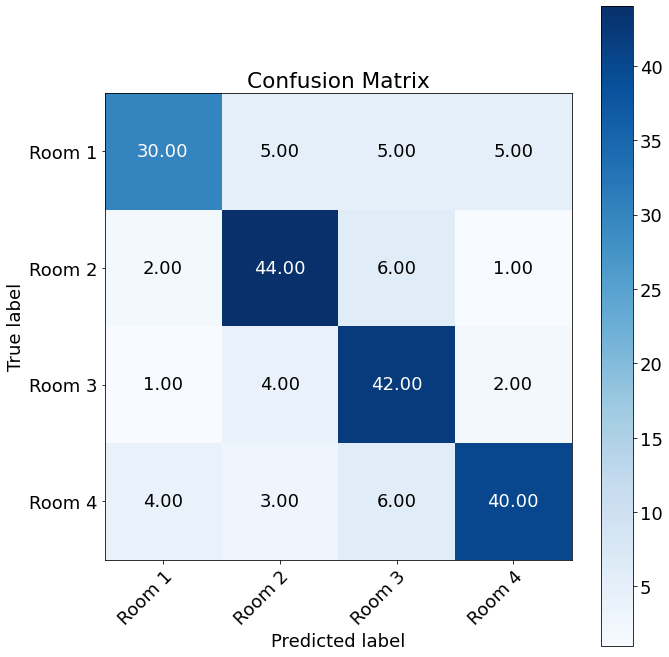

Accuracy pruned 1: 0.85
Macro recall pruned 1: 0.8474094040131777
Macro precision pruned 1: 0.8556586219694462


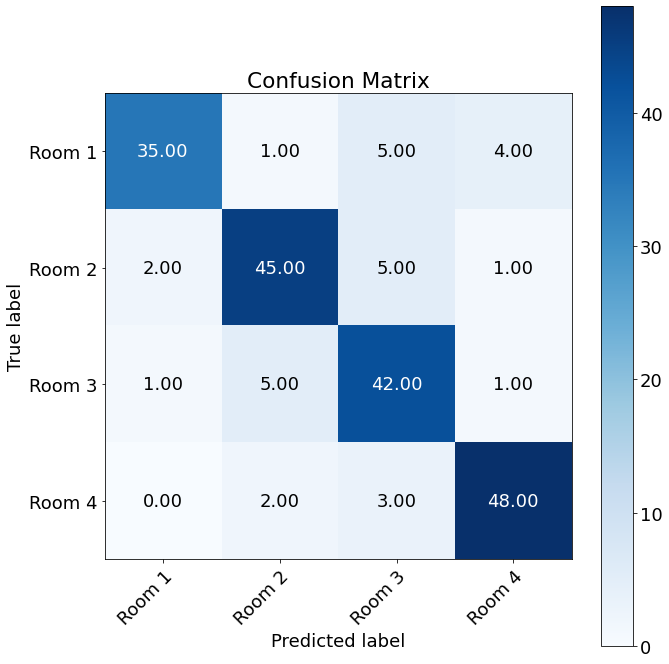

 
Accuracy pruned 2: 0.85
Macro recall pruned 2: 0.8474094040131777
Macro precision pruned 2: 0.8556586219694462


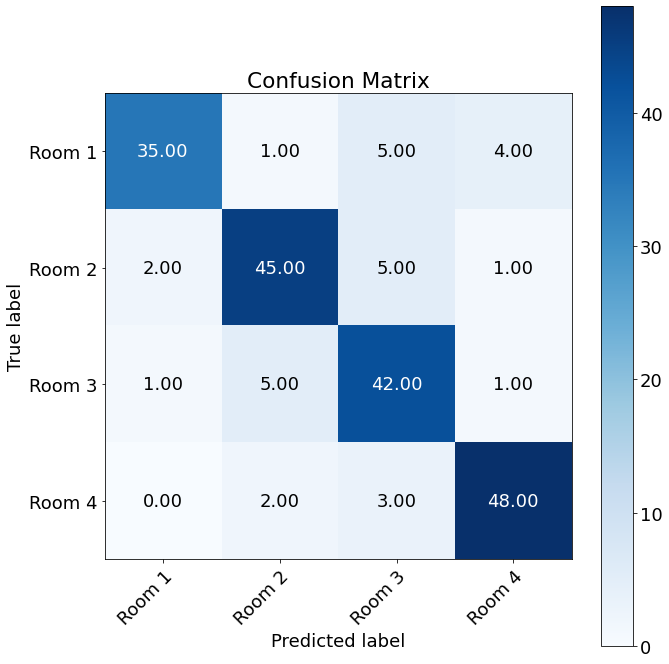

 
Outer Fold:8, Inner fold:4
Accuracy original: 0.795
Macro recall original: 0.7930753433448852
Macro precision original: 0.7970591778486174
 


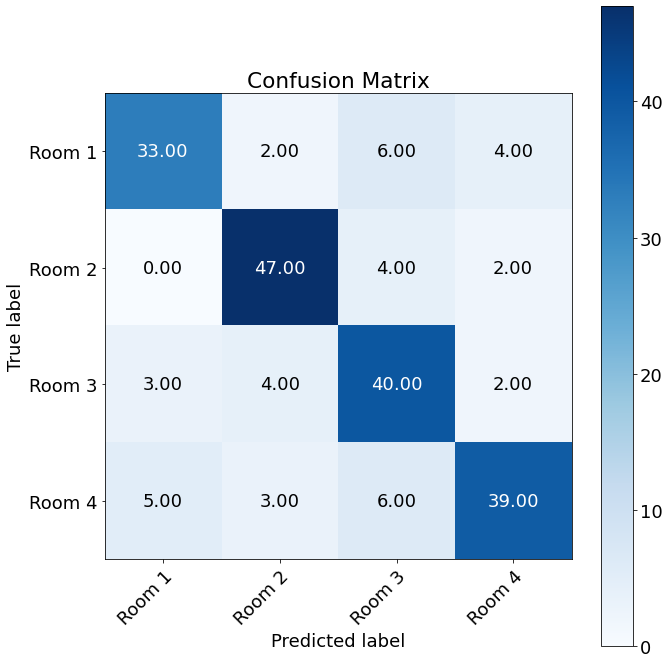

Accuracy pruned 1: 0.86
Macro recall pruned 1: 0.8585205151242887
Macro precision pruned 1: 0.8680346070051952


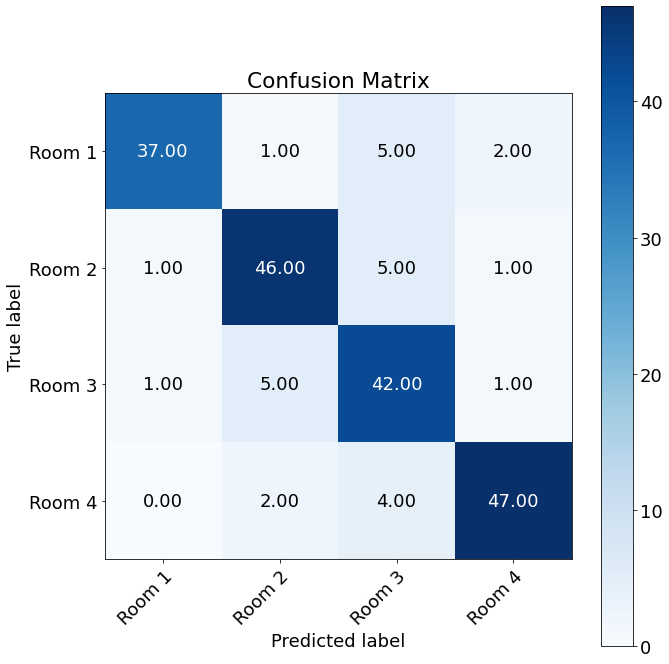

 
Accuracy pruned 2: 0.86
Macro recall pruned 2: 0.8585205151242887
Macro precision pruned 2: 0.8680346070051952


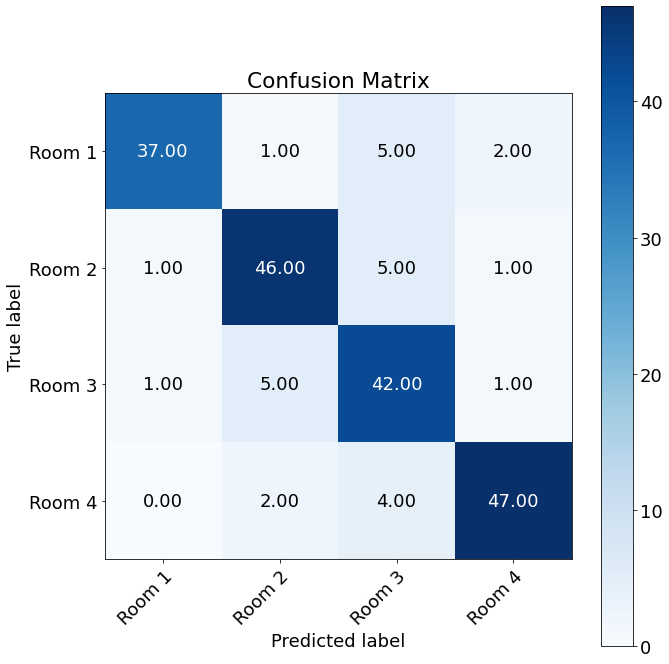

 
Outer Fold:8, Inner fold:5
Accuracy original: 0.76
Macro recall original: 0.7579942668891455
Macro precision original: 0.7679838075901837
 


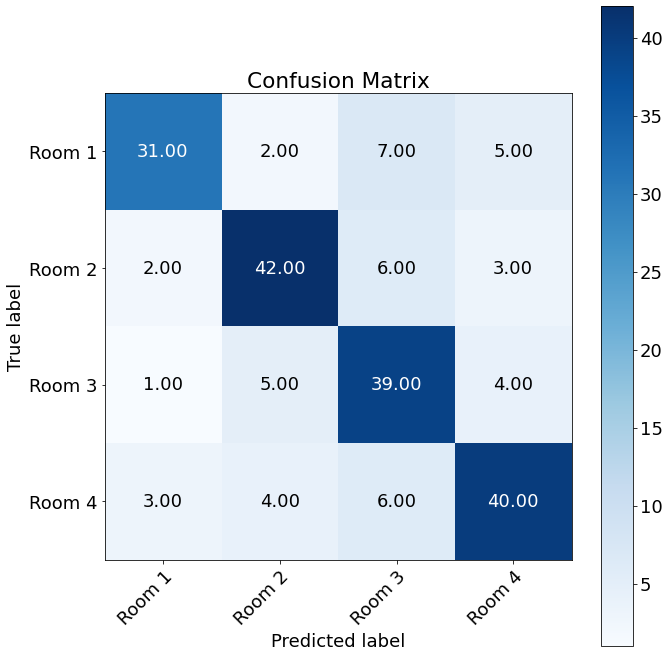

Accuracy pruned 1: 0.84
Macro recall pruned 1: 0.8372053223805245
Macro precision pruned 1: 0.8505944499613814


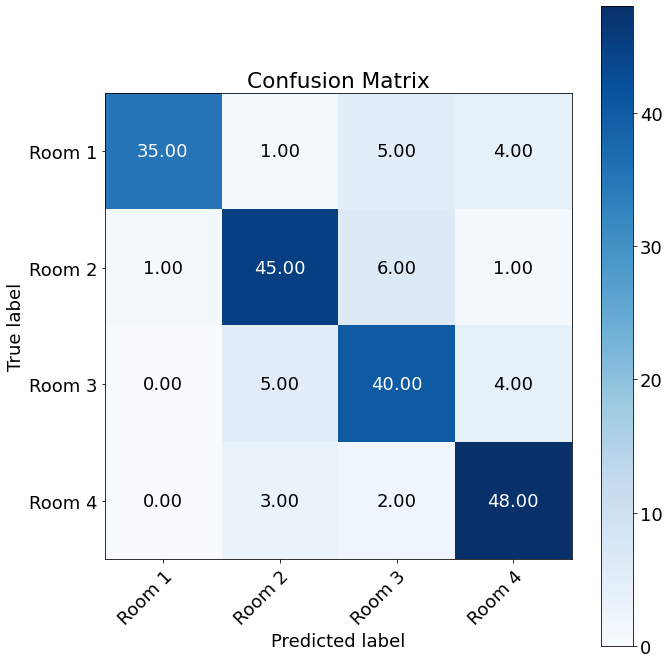

 
Accuracy pruned 2: 0.84
Macro recall pruned 2: 0.8372053223805245
Macro precision pruned 2: 0.8505944499613814


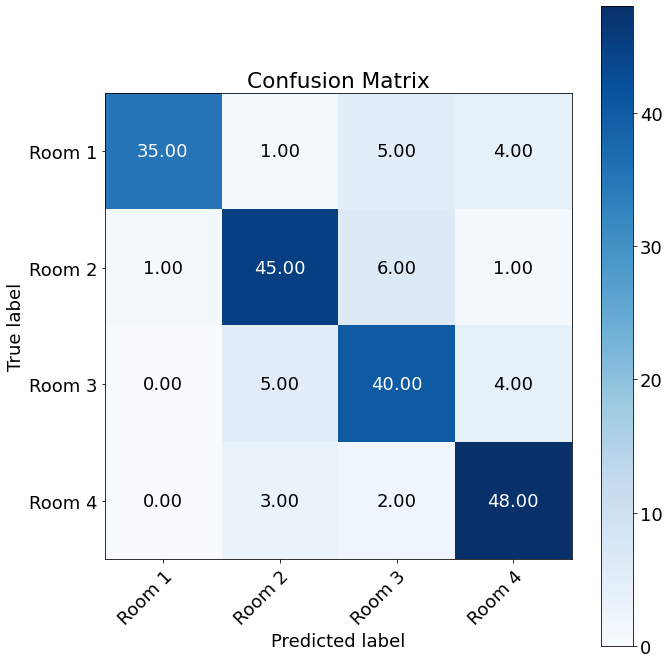

 
Outer Fold:8, Inner fold:6
Accuracy original: 0.785
Macro recall original: 0.782871261712232
Macro precision original: 0.7858045734016877
 


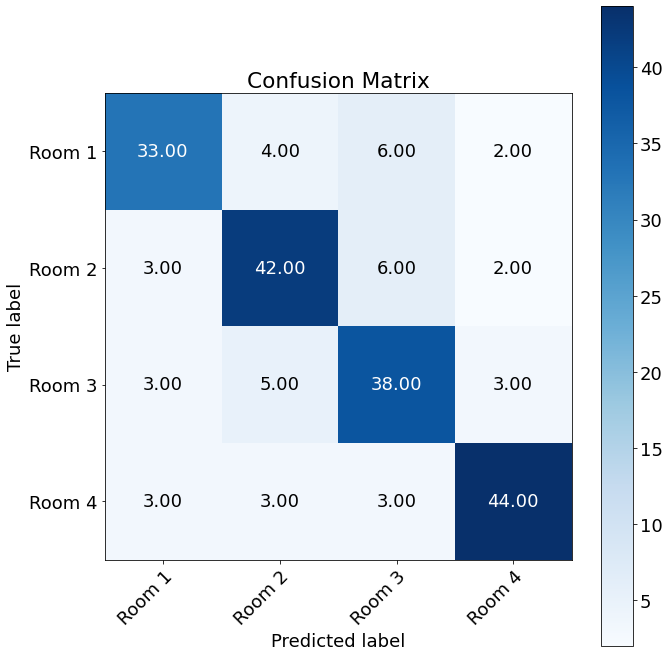

Accuracy pruned 1: 0.855
Macro recall pruned 1: 0.8538035339922132
Macro precision pruned 1: 0.8598214285714286


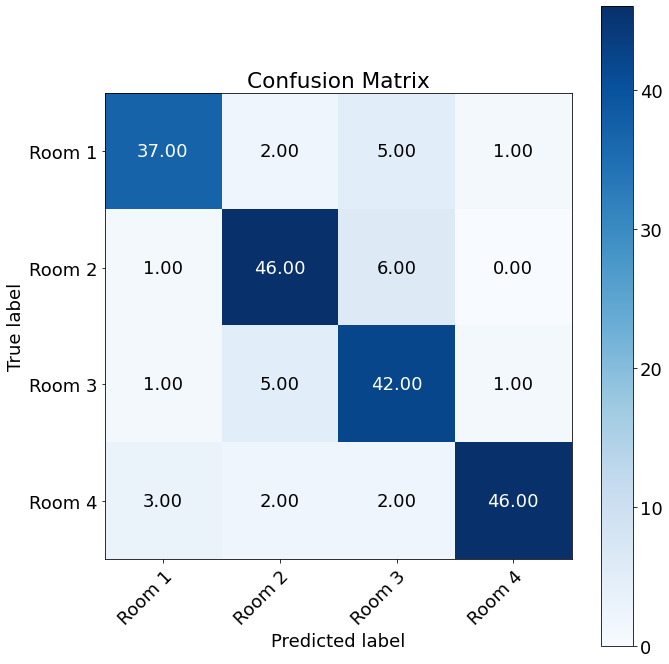

 
Accuracy pruned 2: 0.855
Macro recall pruned 2: 0.8538035339922132
Macro precision pruned 2: 0.8598214285714286


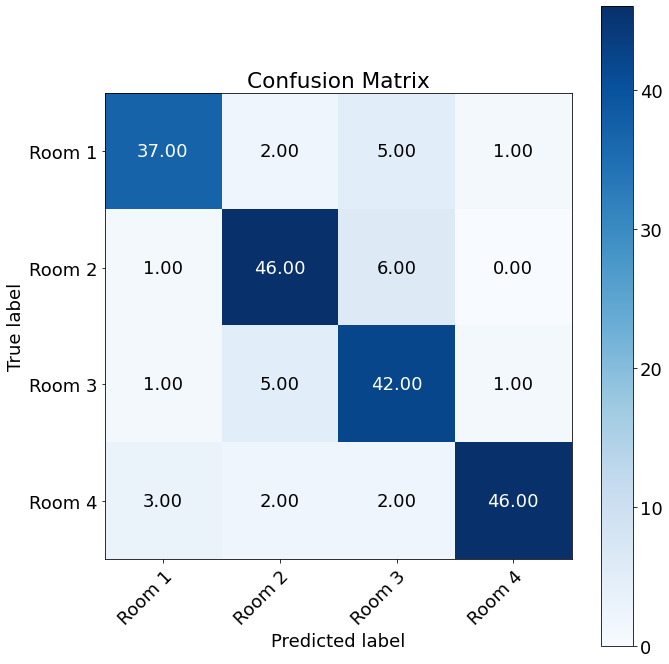

 
Outer Fold:8, Inner fold:7
Accuracy original: 0.81
Macro recall original: 0.8072262867411115
Macro precision original: 0.8198307195948706
 


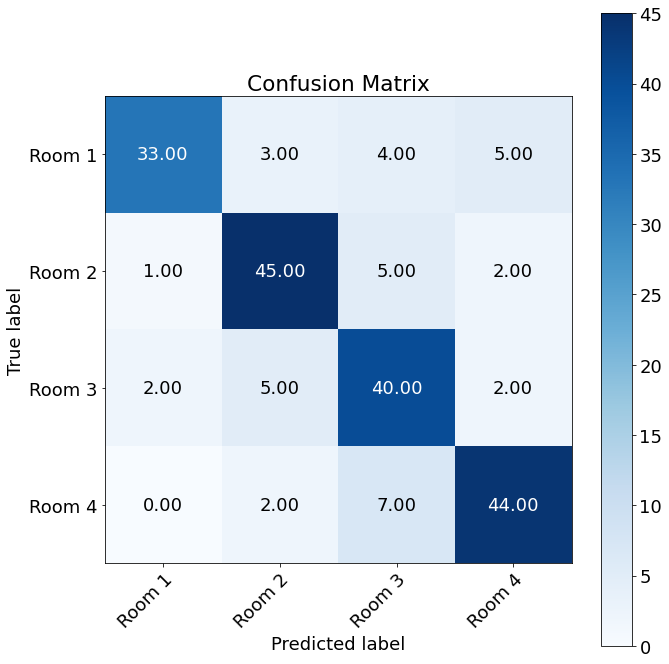

Accuracy pruned 1: 0.88
Macro recall pruned 1: 0.8773199845976126
Macro precision pruned 1: 0.8853920703225568


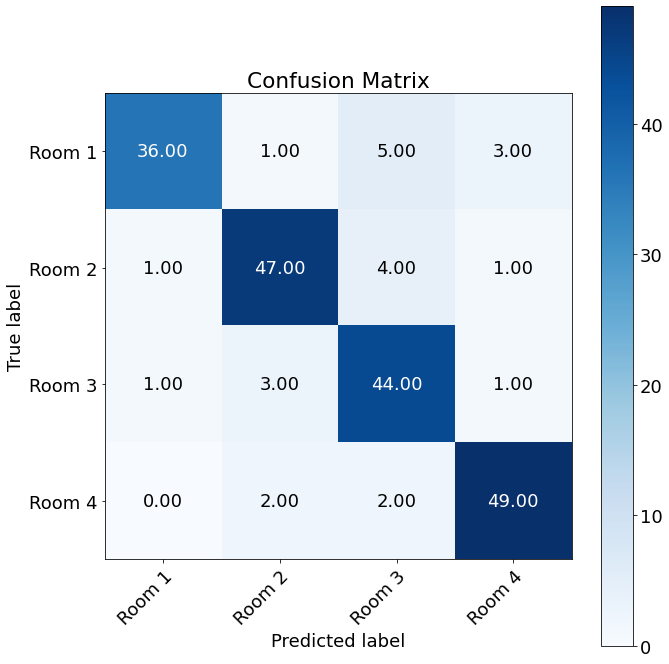

 
Accuracy pruned 2: 0.88
Macro recall pruned 2: 0.8773199845976126
Macro precision pruned 2: 0.8853920703225568


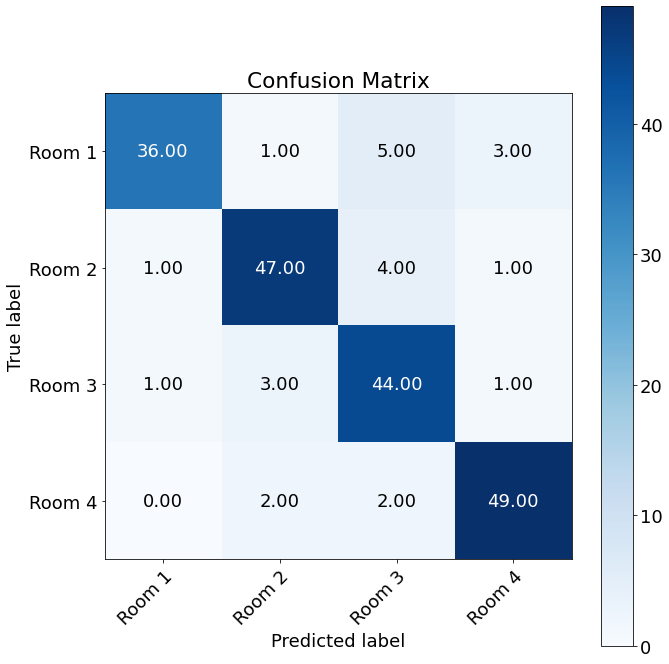

 
Outer Fold:8, Inner fold:8
Accuracy original: 0.78
Macro recall original: 0.7739614084627562
Macro precision original: 0.7811897640412098
 


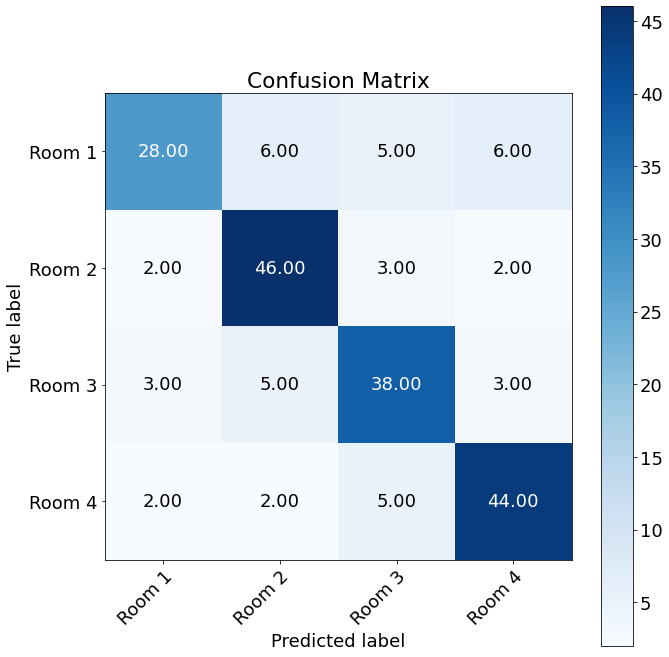

Accuracy pruned 1: 0.885
Macro recall pruned 1: 0.8816519060454371
Macro precision pruned 1: 0.8893905515422543


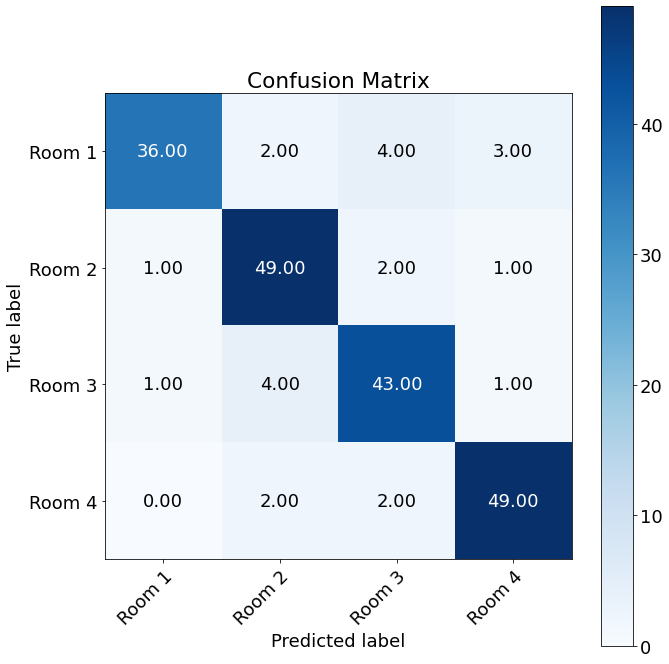

 
Accuracy pruned 2: 0.885
Macro recall pruned 2: 0.8816519060454371
Macro precision pruned 2: 0.8893905515422543


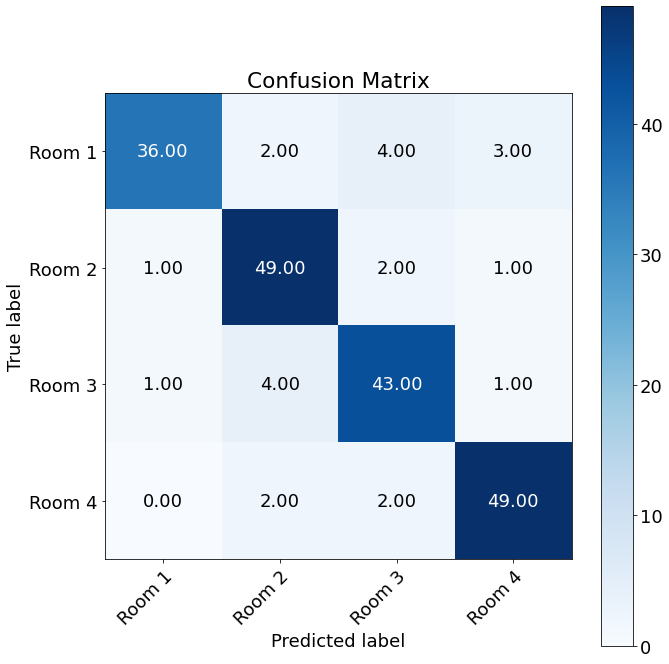

 
Outer Fold:8, Inner fold:9
Accuracy original: 0.805
Macro recall original: 0.8029628203482652
Macro precision original: 0.8136842105263157
 


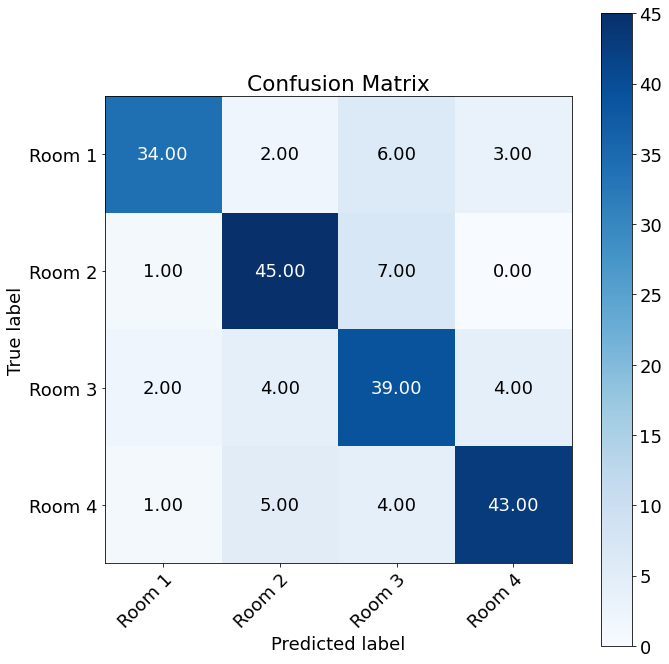

Accuracy pruned 1: 0.86
Macro recall pruned 1: 0.8576819407008087
Macro precision pruned 1: 0.8645917325162609


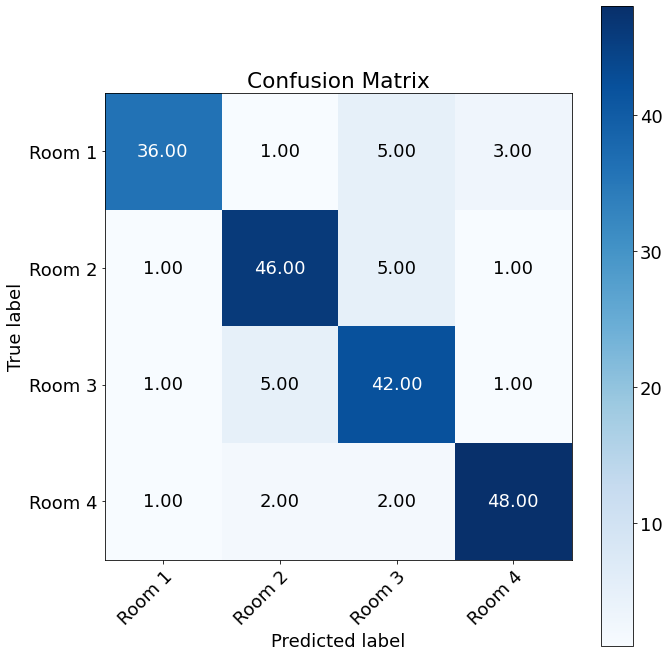

 
Accuracy pruned 2: 0.86
Macro recall pruned 2: 0.8576819407008087
Macro precision pruned 2: 0.8645917325162609


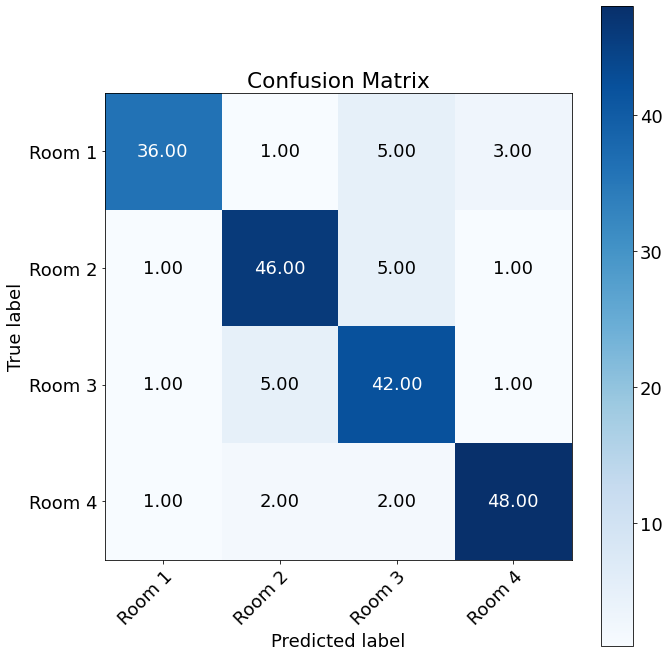

 
Outer Fold:8, Inner fold:10
Accuracy original: 0.8
Macro recall original: 0.7994694733239208
Macro precision original: 0.8025050929462695
 


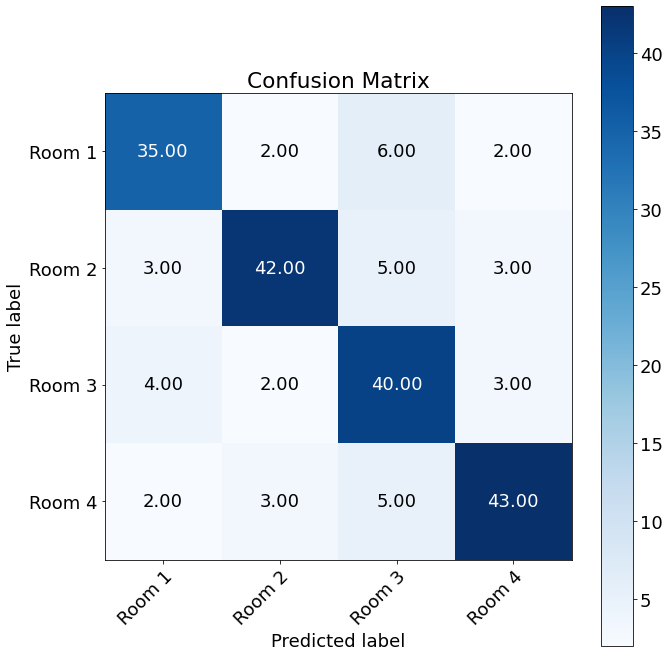

Accuracy pruned 1: 0.86
Macro recall pruned 1: 0.8585205151242887
Macro precision pruned 1: 0.8666763791763791


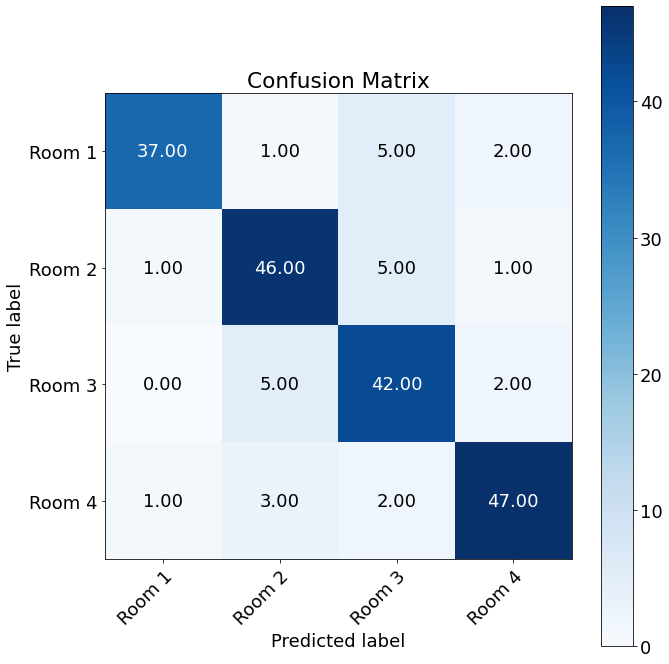

 
Accuracy pruned 2: 0.86
Macro recall pruned 2: 0.8585205151242887
Macro precision pruned 2: 0.8666763791763791


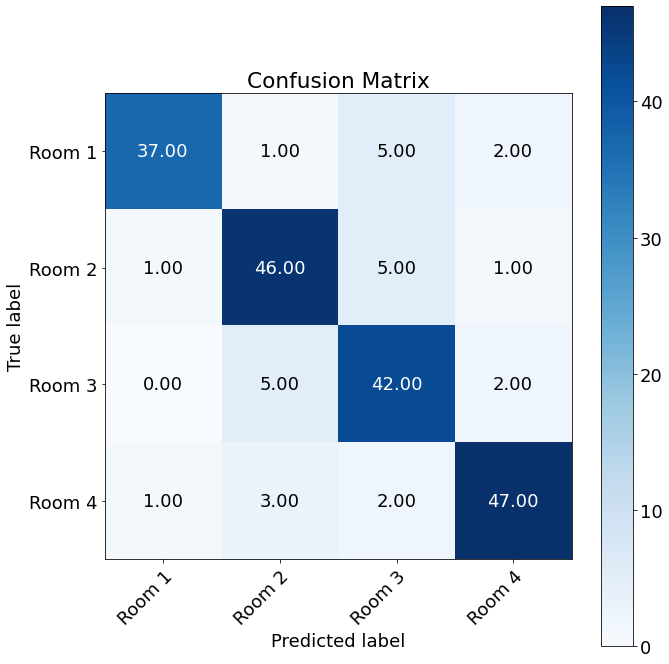

 
Outer Fold:9, Inner fold:1
Accuracy original: 0.785
Macro recall original: 0.7837032058586146
Macro precision original: 0.7852967046298964
 


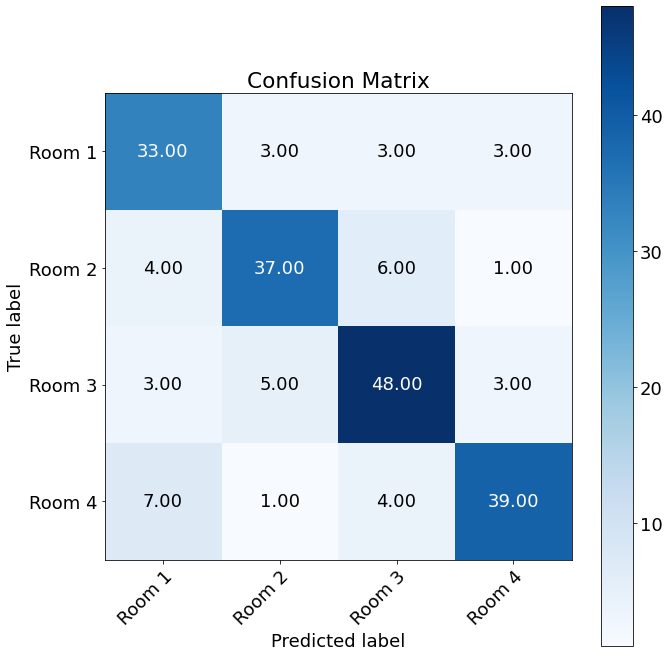

Accuracy pruned 1: 0.87
Macro recall pruned 1: 0.8706966896928262
Macro precision pruned 1: 0.8679944592872437


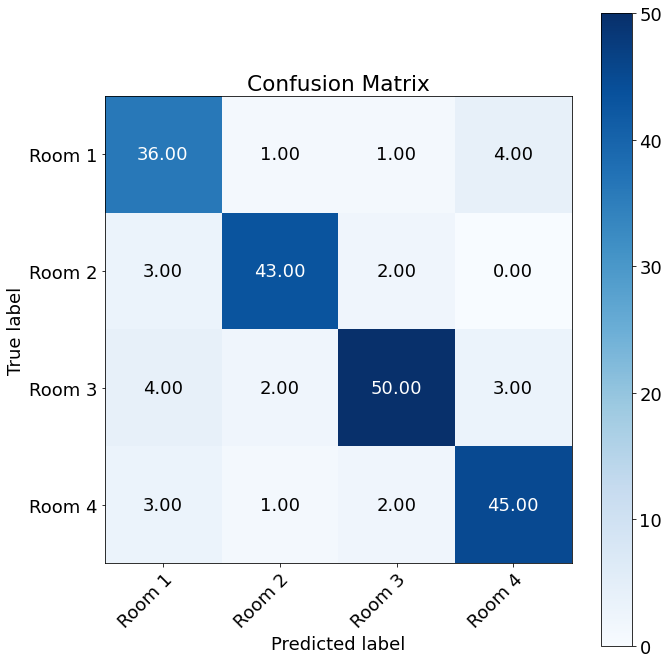

 
Accuracy pruned 2: 0.87
Macro recall pruned 2: 0.8706966896928262
Macro precision pruned 2: 0.8679944592872437


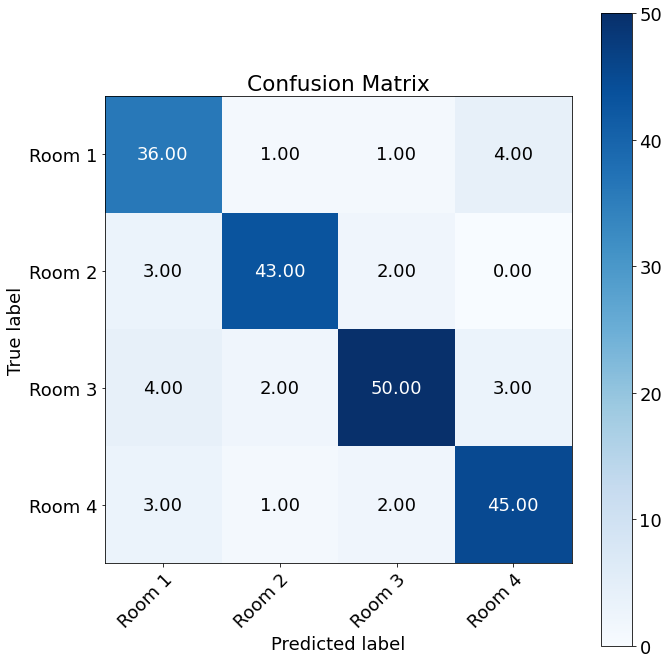

 
Outer Fold:9, Inner fold:2
Accuracy original: 0.78
Macro recall original: 0.7790282426529934
Macro precision original: 0.7783096385737702
 


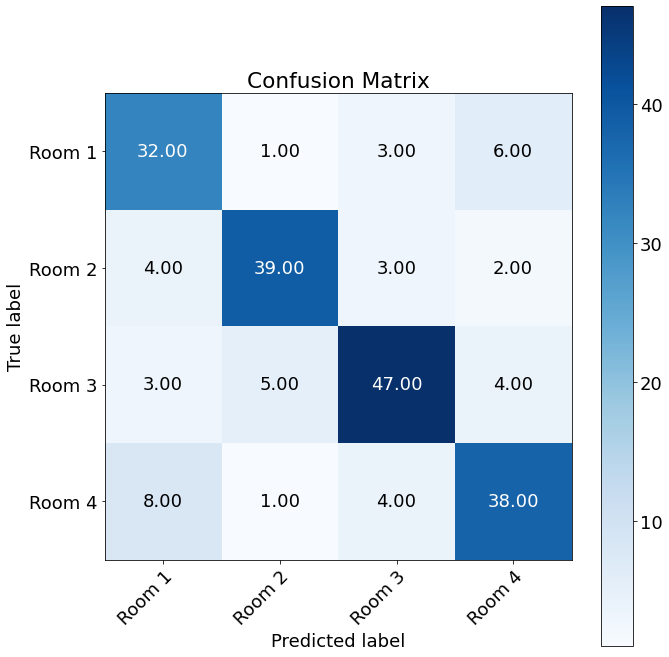

Accuracy pruned 1: 0.865
Macro recall pruned 1: 0.865488356359493
Macro precision pruned 1: 0.8632907362273017


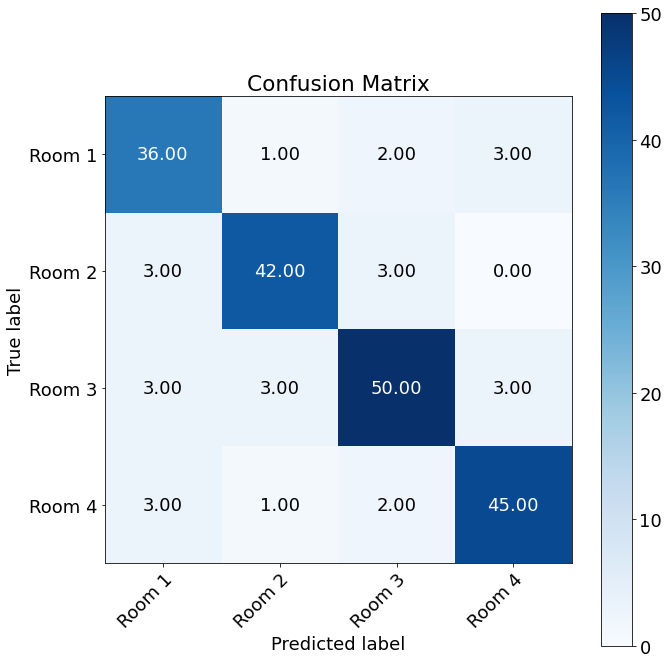

 
Accuracy pruned 2: 0.865
Macro recall pruned 2: 0.865488356359493
Macro precision pruned 2: 0.8632907362273017


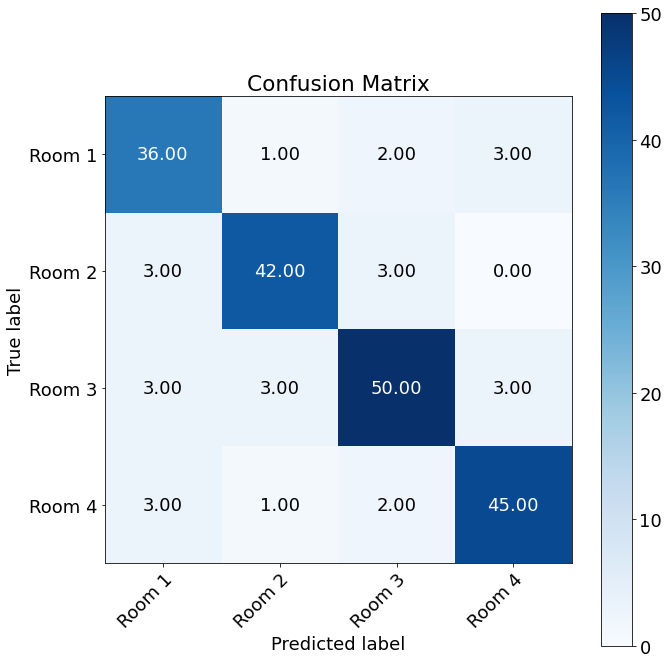

 
Outer Fold:9, Inner fold:3
Accuracy original: 0.725
Macro recall original: 0.725568829226606
Macro precision original: 0.732816588173731
 


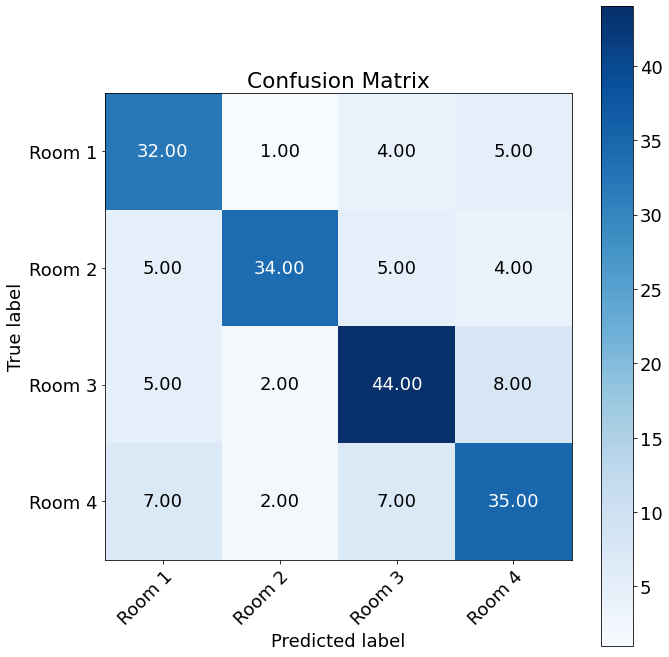

Accuracy pruned 1: 0.86
Macro recall pruned 1: 0.8596947253477663
Macro precision pruned 1: 0.8627102705135024


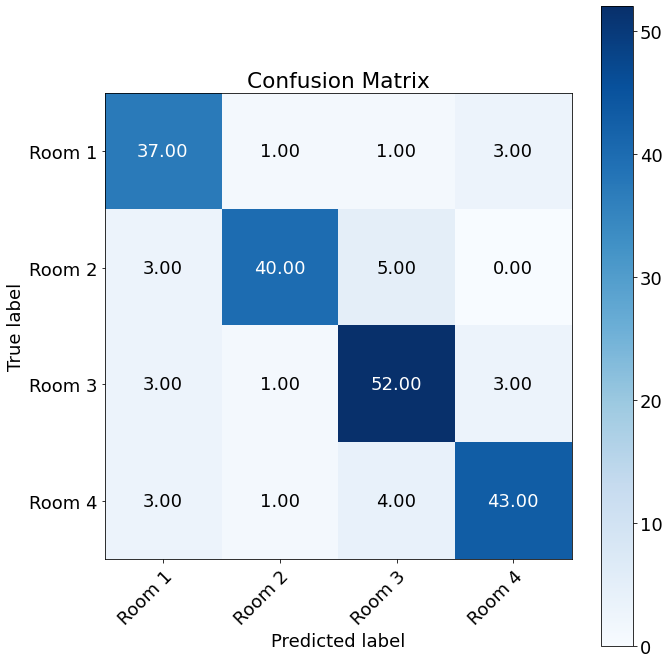

 
Accuracy pruned 2: 0.86
Macro recall pruned 2: 0.8596947253477663
Macro precision pruned 2: 0.8627102705135024


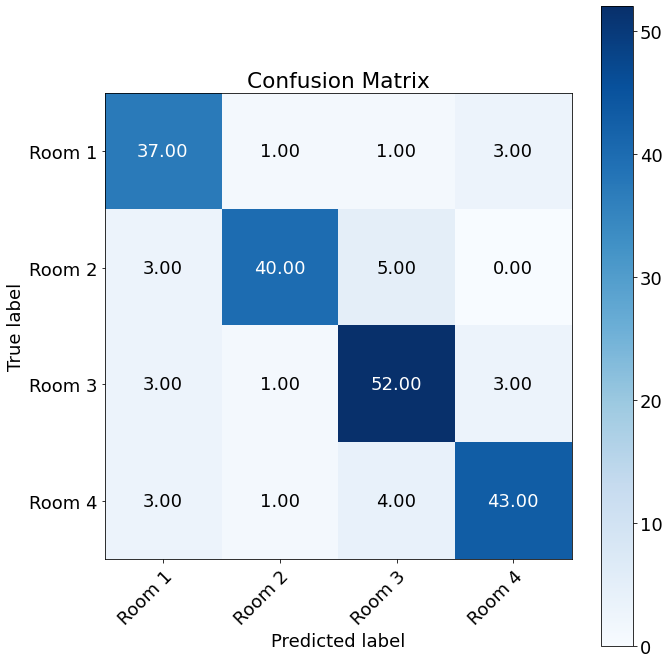

 
Outer Fold:9, Inner fold:4
Accuracy original: 0.795
Macro recall original: 0.79619326544177
Macro precision original: 0.7992163322352002
 


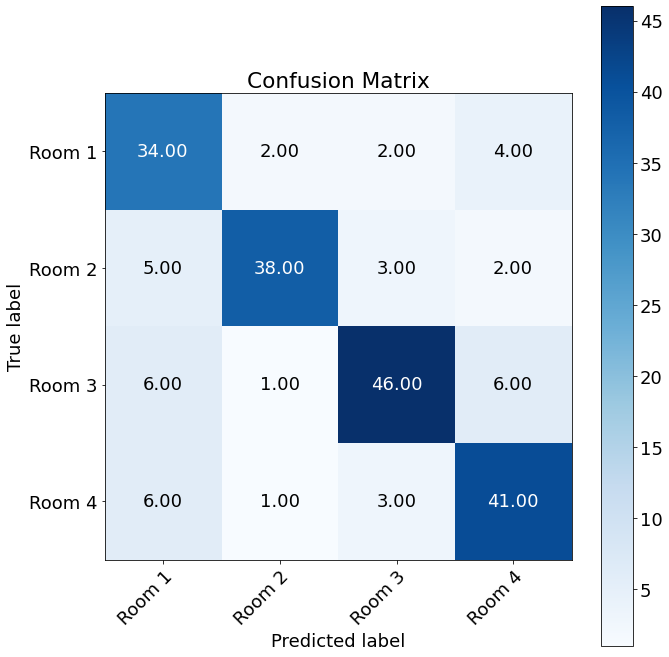

Accuracy pruned 1: 0.88
Macro recall pruned 1: 0.8799153135830603
Macro precision pruned 1: 0.8791464561836729


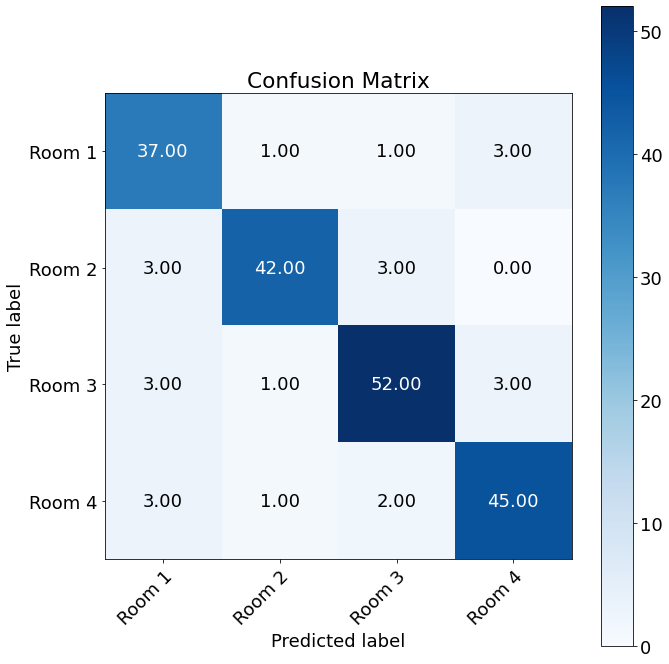

 
Accuracy pruned 2: 0.88
Macro recall pruned 2: 0.8799153135830603
Macro precision pruned 2: 0.8791464561836729


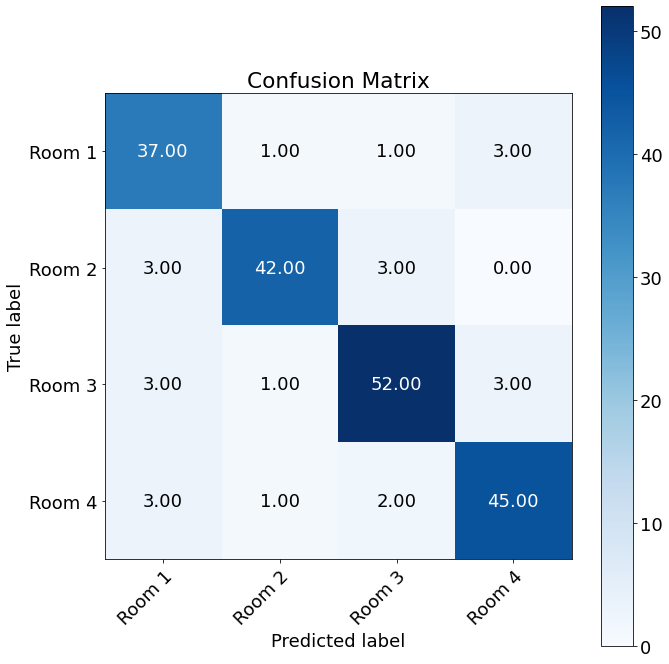

 
Outer Fold:9, Inner fold:5
Accuracy original: 0.785
Macro recall original: 0.7827840882115558
Macro precision original: 0.7882174749475982
 


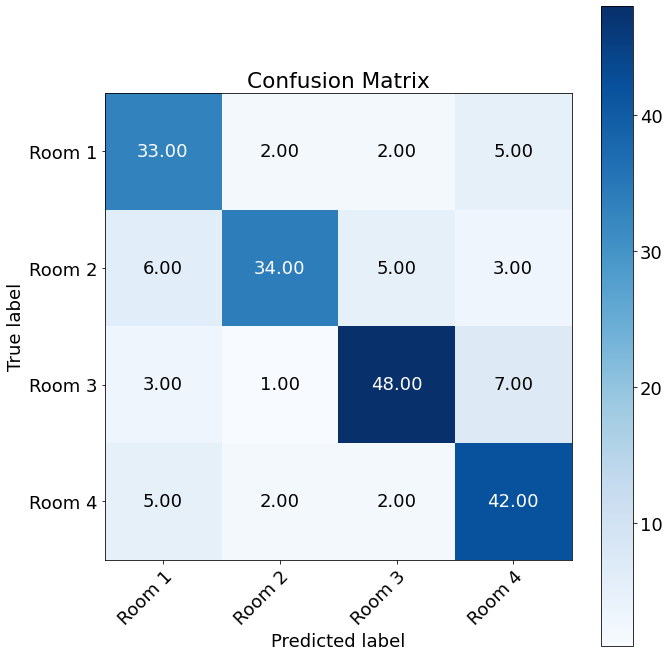

Accuracy pruned 1: 0.85
Macro recall pruned 1: 0.8492780586810995
Macro precision pruned 1: 0.8510204081632653


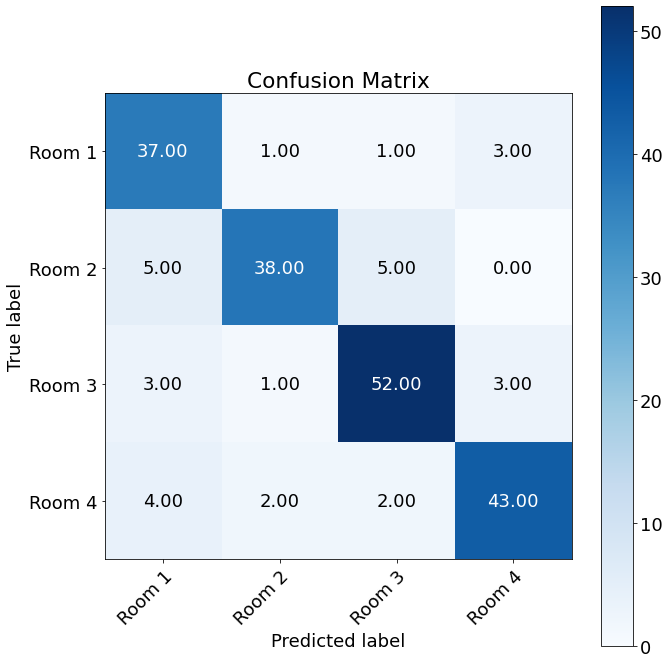

 
Accuracy pruned 2: 0.85
Macro recall pruned 2: 0.8492780586810995
Macro precision pruned 2: 0.8510204081632653


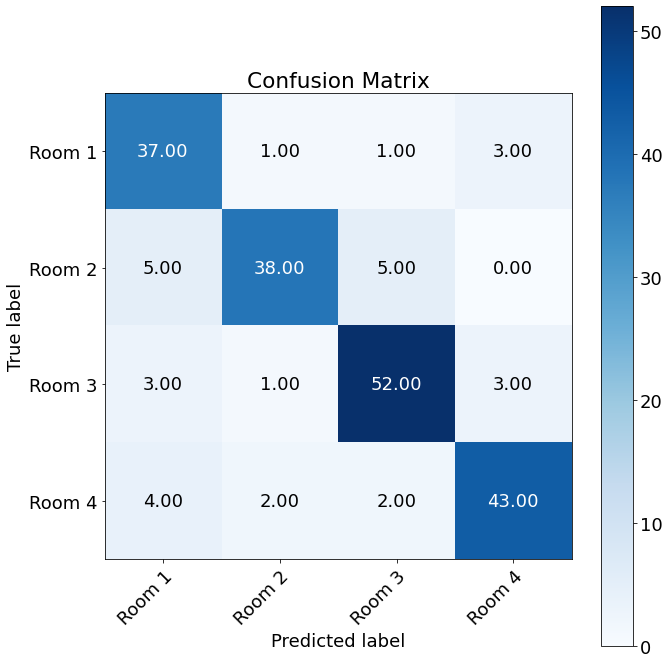

 
Outer Fold:9, Inner fold:6
Accuracy original: 0.8
Macro recall original: 0.805337707116745
Macro precision original: 0.8007381676074685
 


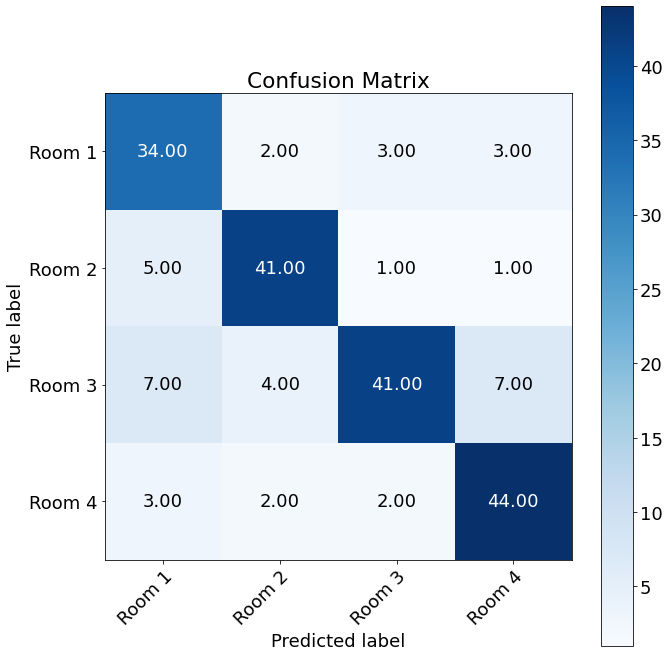

Accuracy pruned 1: 0.875
Macro recall pruned 1: 0.8756780254474671
Macro precision pruned 1: 0.8745152606497144


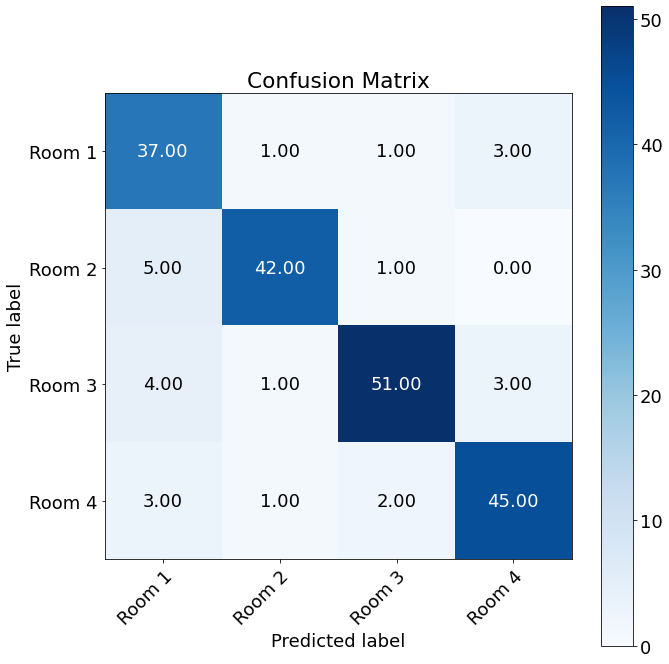

 
Accuracy pruned 2: 0.875
Macro recall pruned 2: 0.8756780254474671
Macro precision pruned 2: 0.8745152606497144


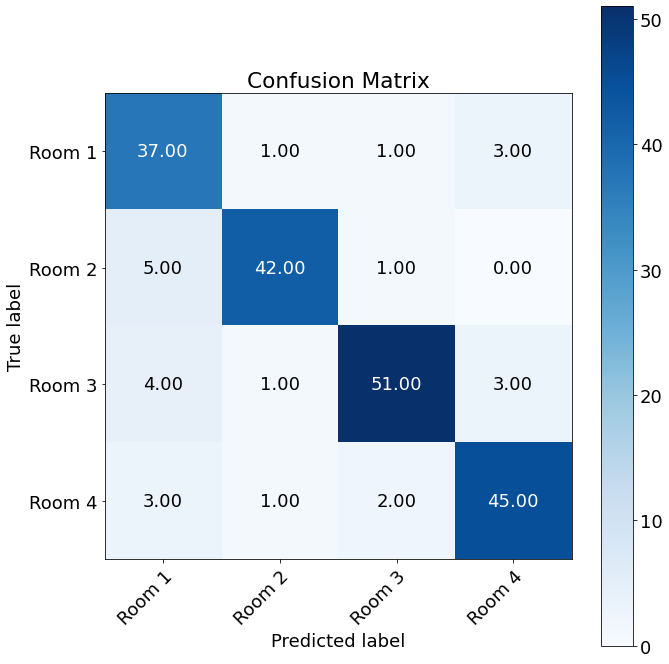

 
Outer Fold:9, Inner fold:7
Accuracy original: 0.78
Macro recall original: 0.779772290272041
Macro precision original: 0.783047579496915
 


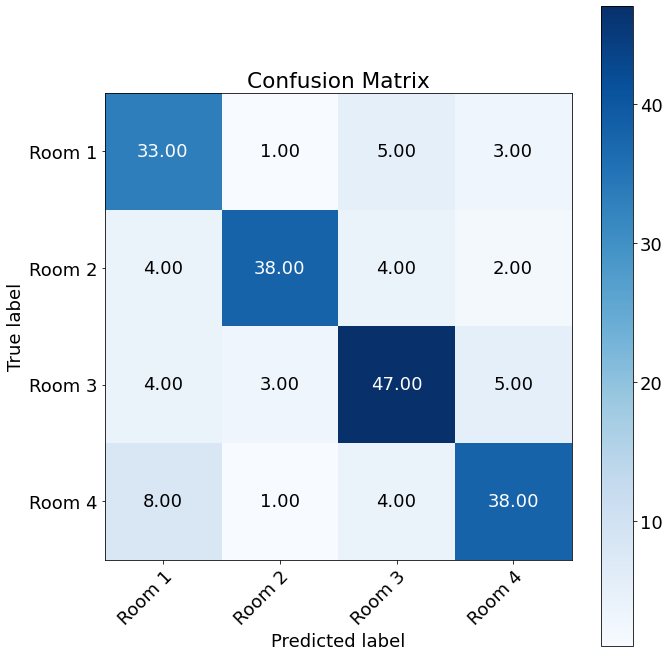

Accuracy pruned 1: 0.875
Macro recall pruned 1: 0.8759843979964868
Macro precision pruned 1: 0.8741883733385267


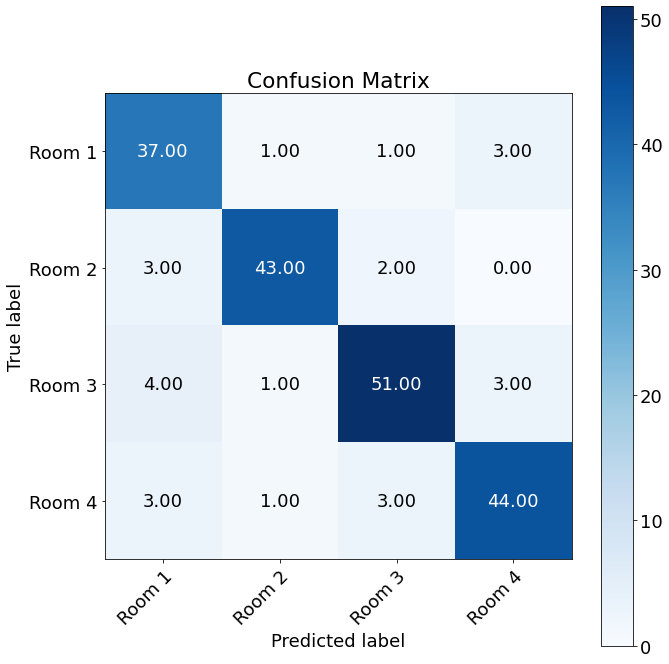

 
Accuracy pruned 2: 0.875
Macro recall pruned 2: 0.8759843979964868
Macro precision pruned 2: 0.8741883733385267


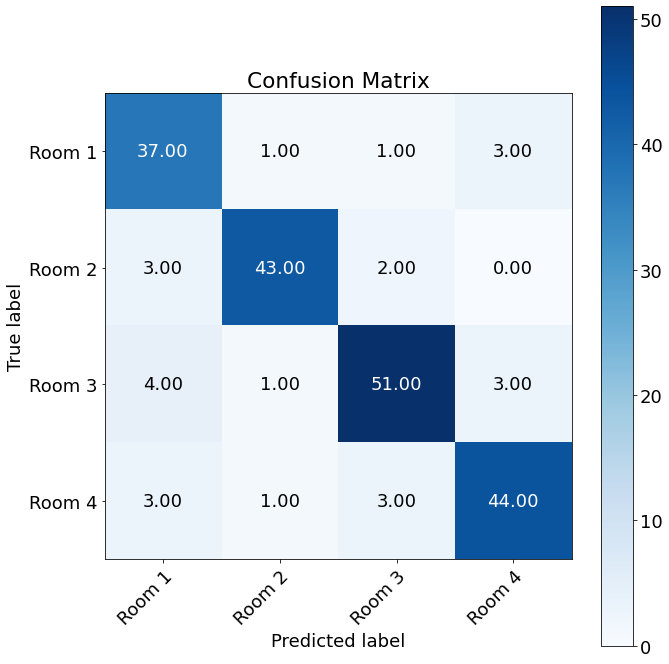

 
Outer Fold:9, Inner fold:8
Accuracy original: 0.765
Macro recall original: 0.7650389604994541
Macro precision original: 0.7645368782161235
 


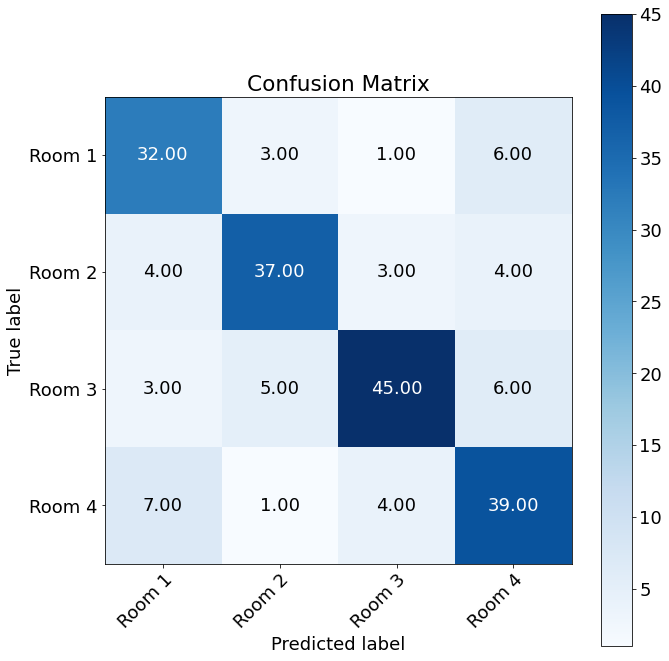

Accuracy pruned 1: 0.86
Macro recall pruned 1: 0.8635789061387267
Macro precision pruned 1: 0.8583946488294315


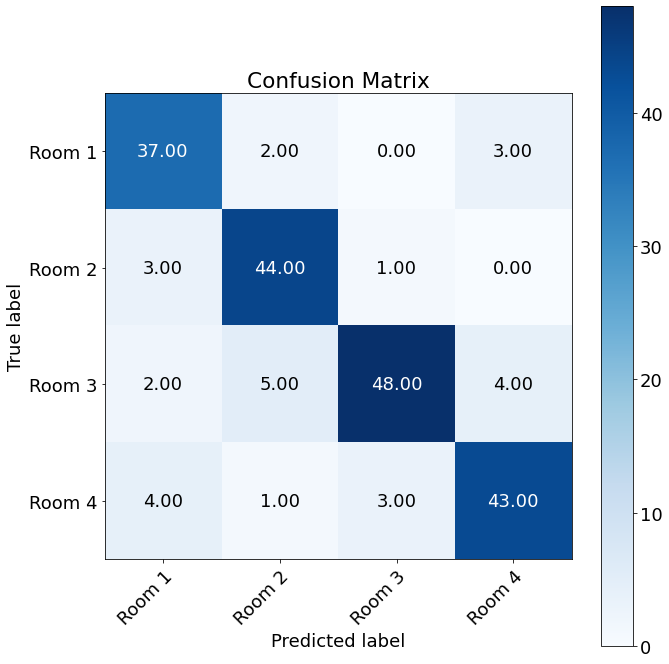

 
Accuracy pruned 2: 0.86
Macro recall pruned 2: 0.8635789061387267
Macro precision pruned 2: 0.8583946488294315


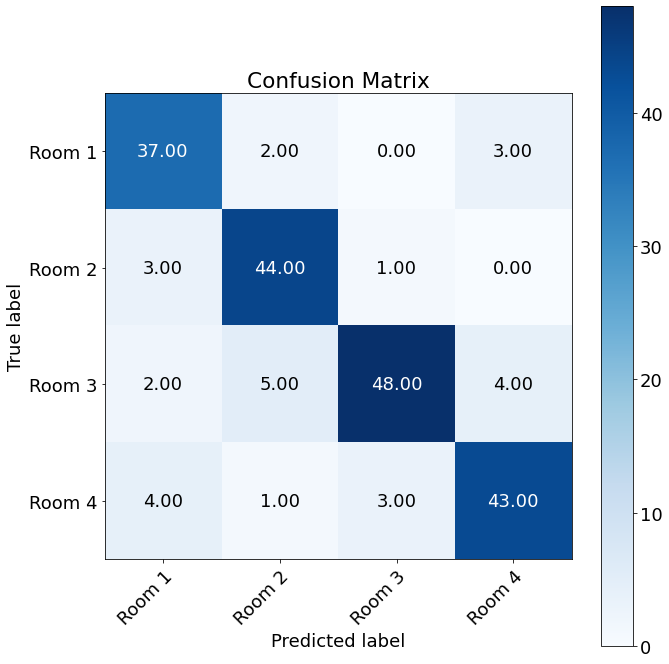

 
Outer Fold:9, Inner fold:9
Accuracy original: 0.775
Macro recall original: 0.7761722273655225
Macro precision original: 0.7723903738644305
 


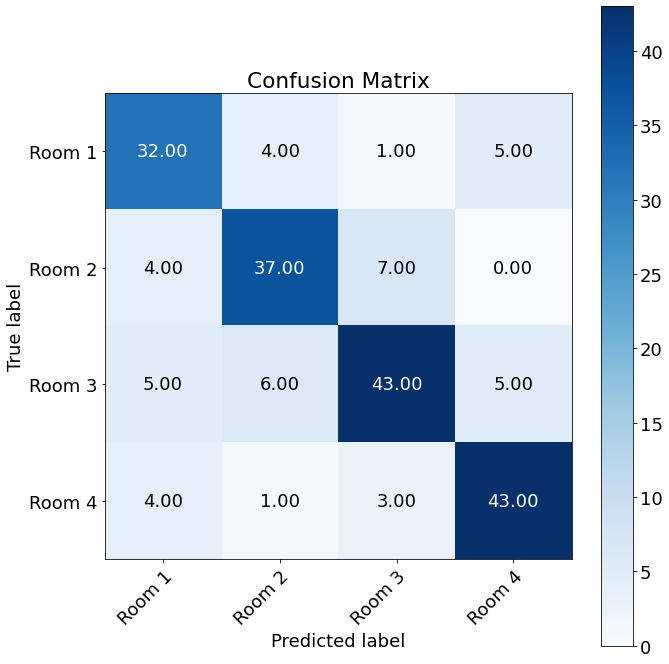

Accuracy pruned 1: 0.88
Macro recall pruned 1: 0.8799153135830603
Macro precision pruned 1: 0.8791464561836729


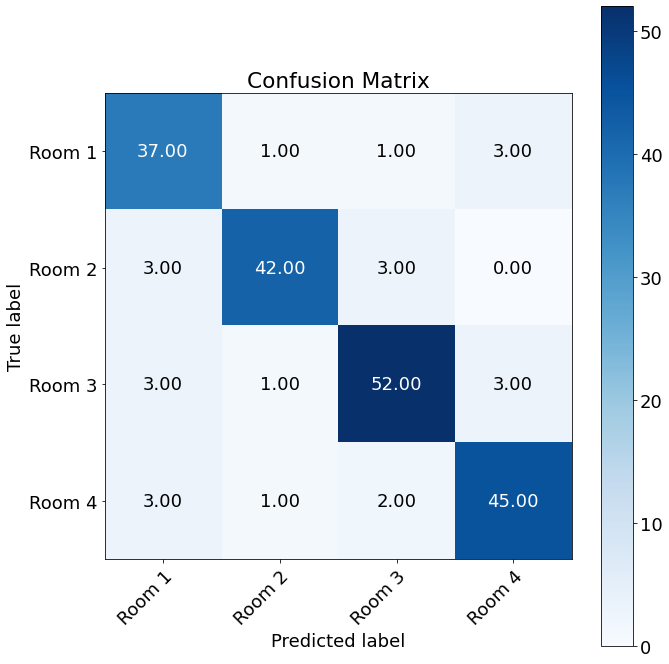

 
Accuracy pruned 2: 0.88
Macro recall pruned 2: 0.8799153135830603
Macro precision pruned 2: 0.8791464561836729


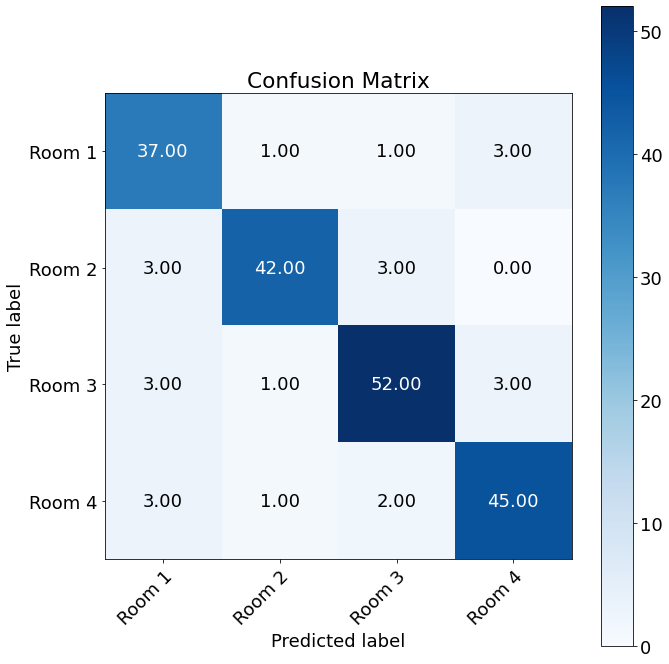

 
Outer Fold:9, Inner fold:10
Accuracy original: 0.78
Macro recall original: 0.7807158880501353
Macro precision original: 0.7797693920335429
 


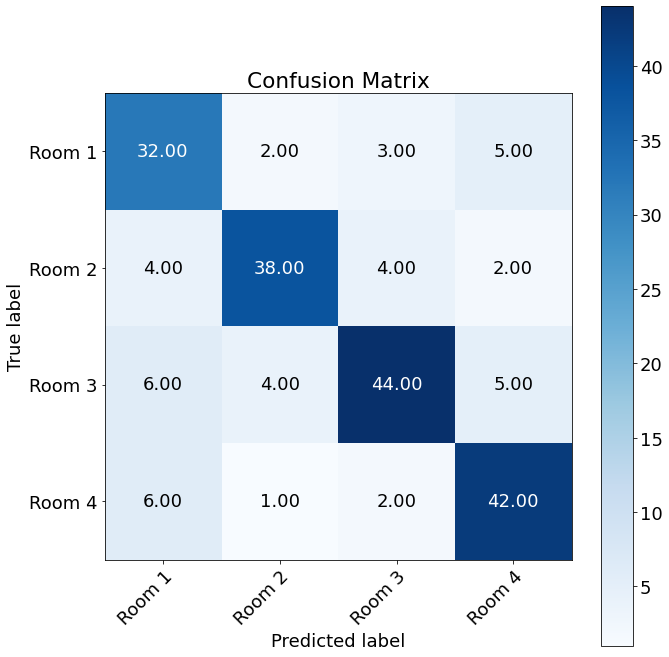

Accuracy pruned 1: 0.865
Macro recall pruned 1: 0.8672034491762807
Macro precision pruned 1: 0.8635908179703342


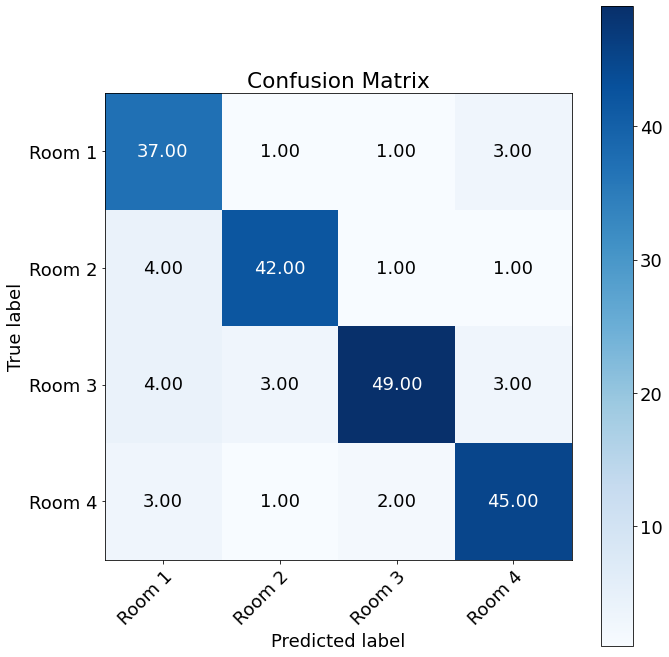

 
Accuracy pruned 2: 0.865
Macro recall pruned 2: 0.8672034491762807
Macro precision pruned 2: 0.8635908179703342


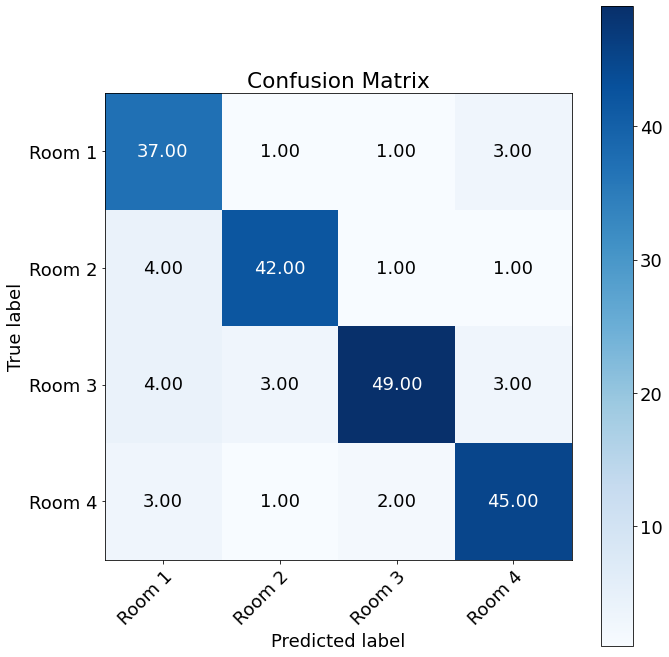

 
Outer Fold:10, Inner fold:1
Accuracy original: 0.785
Macro recall original: 0.7864442700156986
Macro precision original: 0.793342175066313
 


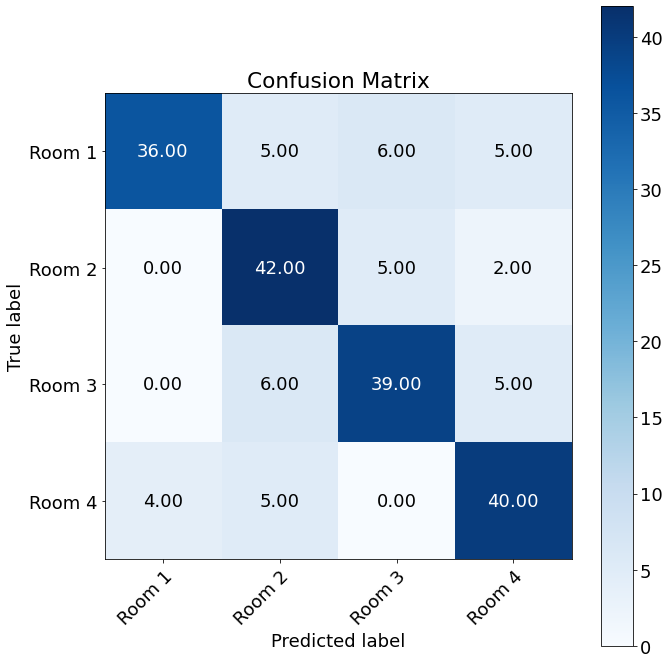

Accuracy pruned 1: 0.885
Macro recall pruned 1: 0.8845447409733124
Macro precision pruned 1: 0.88633574641978


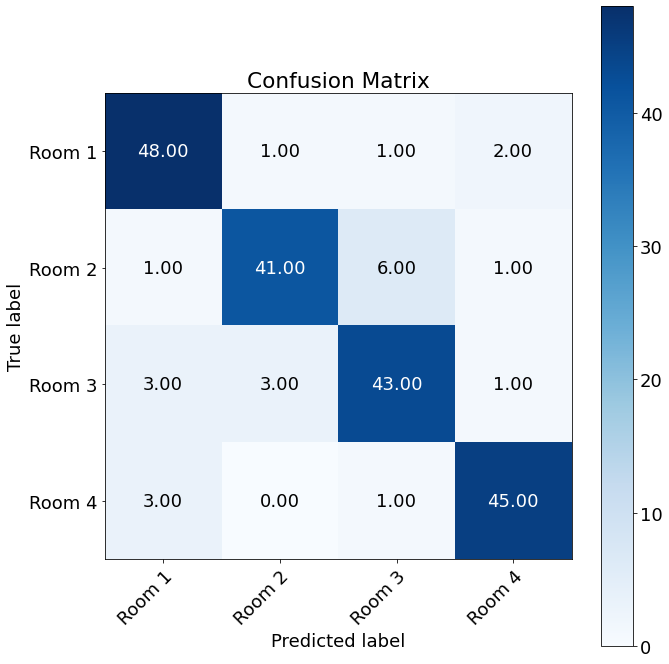

 
Accuracy pruned 2: 0.885
Macro recall pruned 2: 0.8845447409733124
Macro precision pruned 2: 0.88633574641978


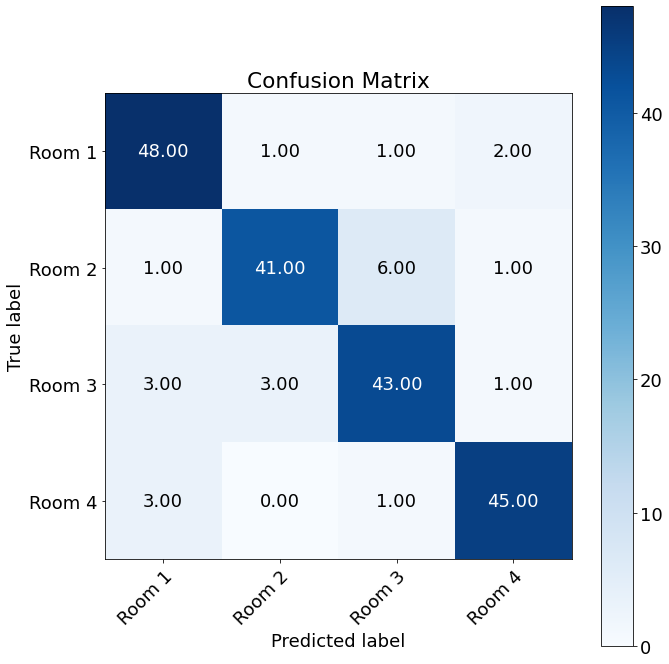

 
Outer Fold:10, Inner fold:2
Accuracy original: 0.81
Macro recall original: 0.8090109890109891
Macro precision original: 0.8112740504747626
 


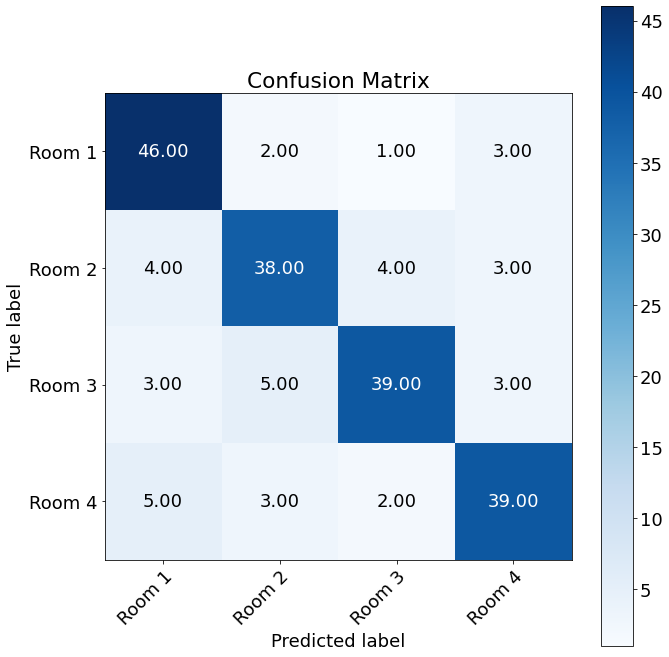

Accuracy pruned 1: 0.885
Macro recall pruned 1: 0.8847370486656201
Macro precision pruned 1: 0.8871998284734134


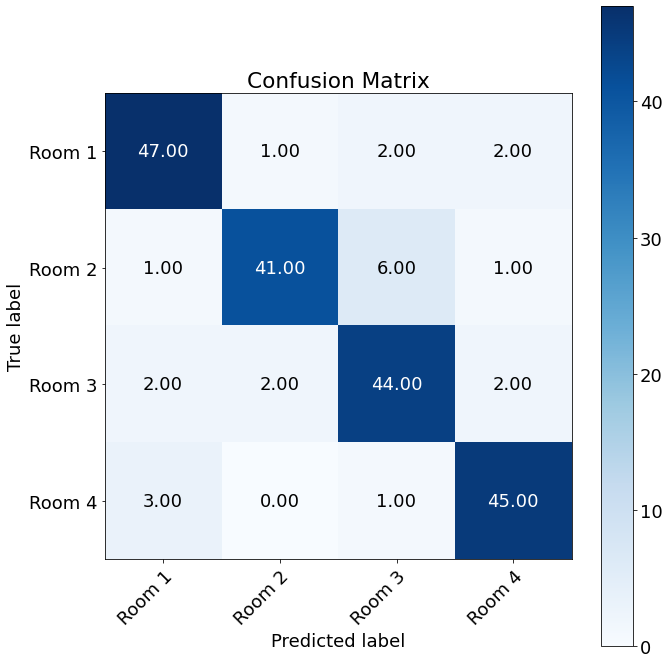

 
Accuracy pruned 2: 0.885
Macro recall pruned 2: 0.8847370486656201
Macro precision pruned 2: 0.8871998284734134


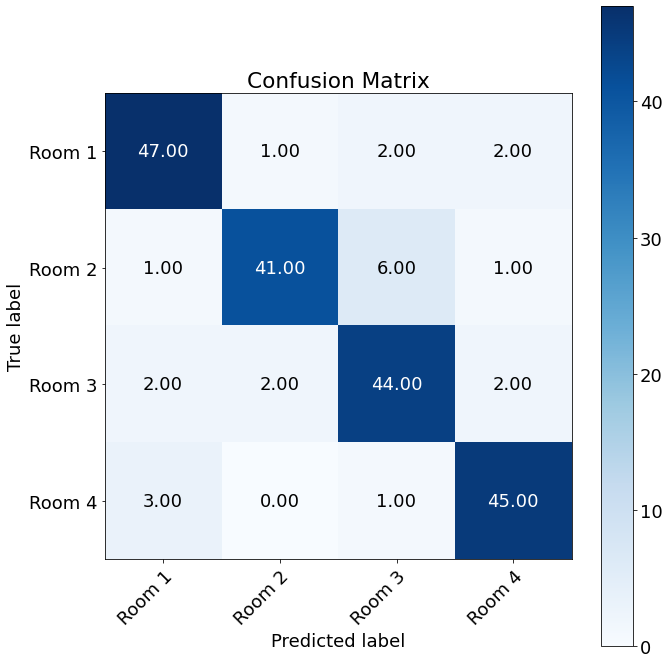

 
Outer Fold:10, Inner fold:3
Accuracy original: 0.81
Macro recall original: 0.8108555729984301
Macro precision original: 0.8119514472455649
 


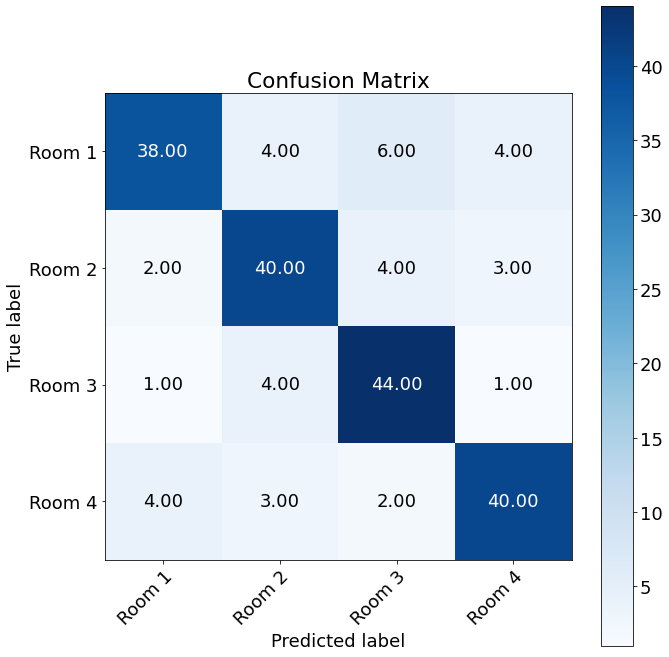

Accuracy pruned 1: 0.885
Macro recall pruned 1: 0.8848273155416013
Macro precision pruned 1: 0.8877917833800186


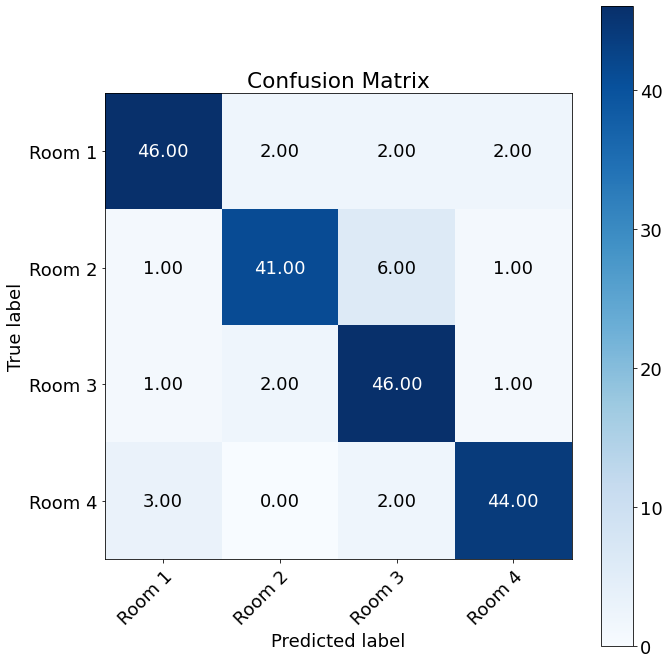

 
Accuracy pruned 2: 0.885
Macro recall pruned 2: 0.8848273155416013
Macro precision pruned 2: 0.8877917833800186


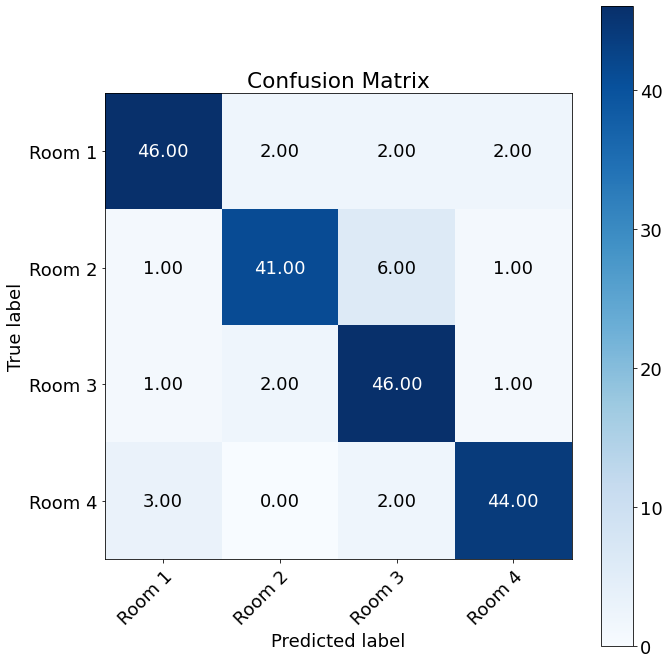

 
Outer Fold:10, Inner fold:4
Accuracy original: 0.81
Macro recall original: 0.8100863422291994
Macro precision original: 0.811078359330639
 


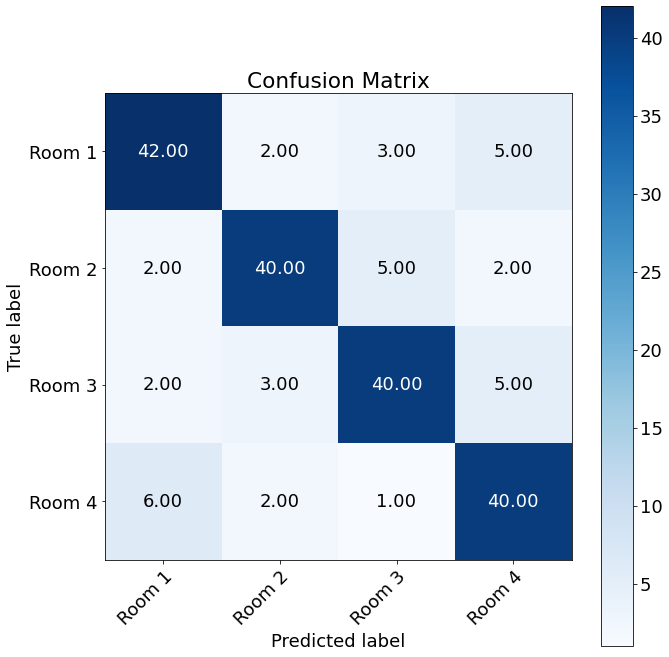

Accuracy pruned 1: 0.885
Macro recall pruned 1: 0.8849293563579278
Macro precision pruned 1: 0.8868567939996511


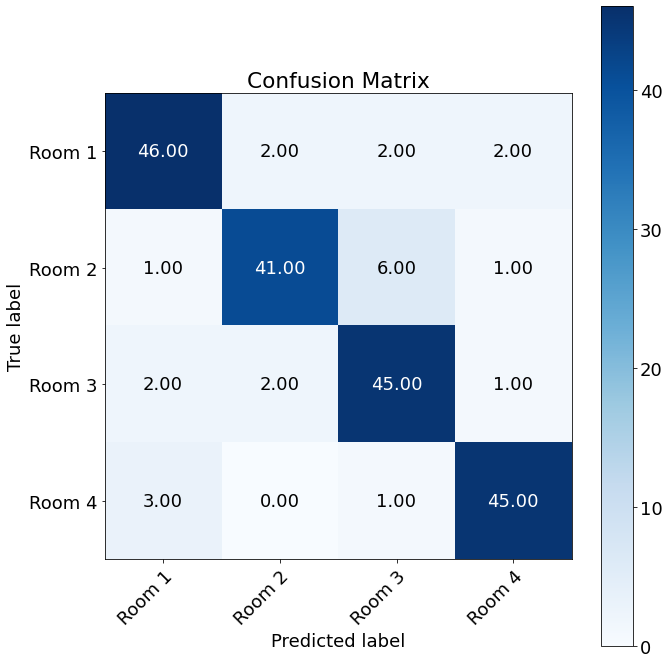

 
Accuracy pruned 2: 0.885
Macro recall pruned 2: 0.8849293563579278
Macro precision pruned 2: 0.8868567939996511


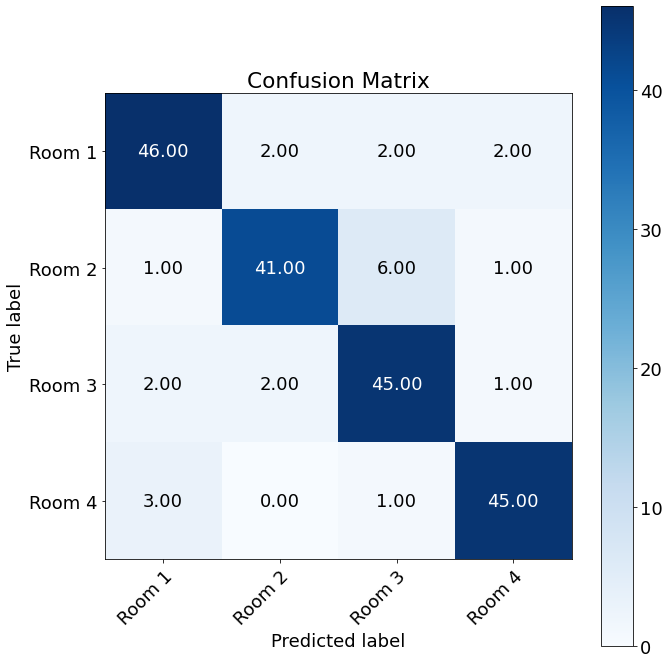

 
Outer Fold:10, Inner fold:5
Accuracy original: 0.785
Macro recall original: 0.7852786499215071
Macro precision original: 0.7859112221963884
 


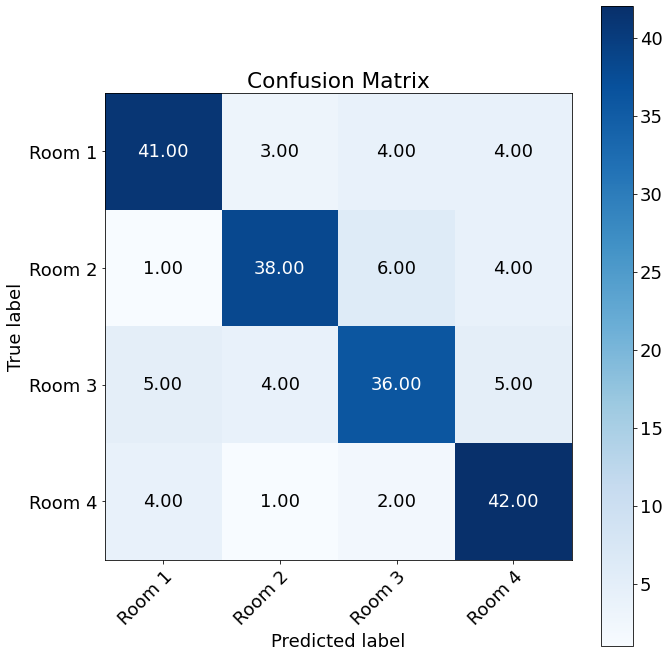

Accuracy pruned 1: 0.875
Macro recall pruned 1: 0.8749175824175824
Macro precision pruned 1: 0.8787820151984238


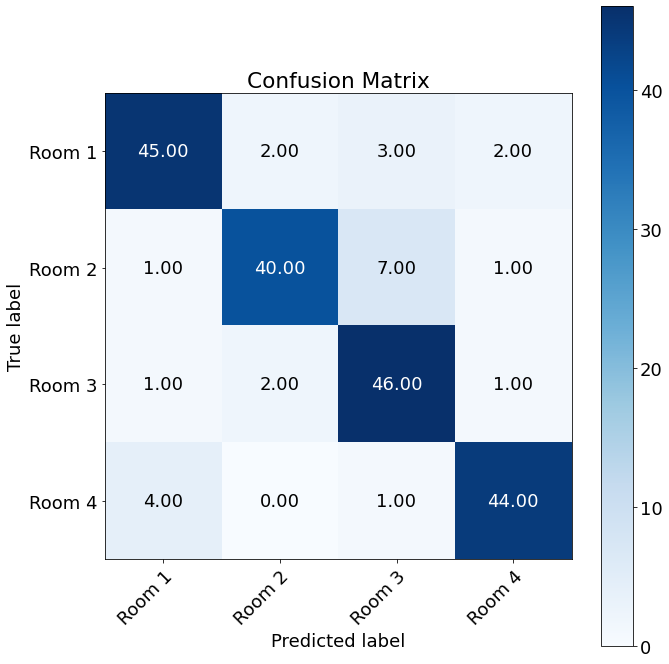

 
Accuracy pruned 2: 0.875
Macro recall pruned 2: 0.8749175824175824
Macro precision pruned 2: 0.8787820151984238


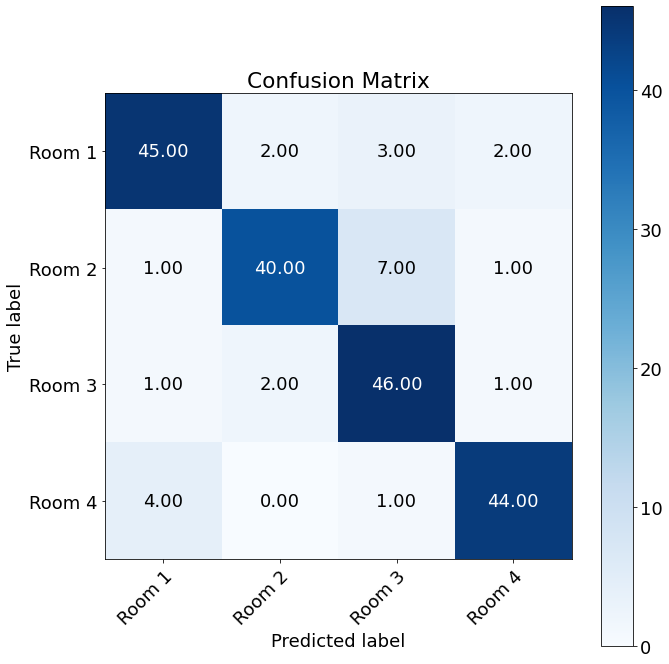

 
Outer Fold:10, Inner fold:6
Accuracy original: 0.81
Macro recall original: 0.8113657770800627
Macro precision original: 0.8128733766233766
 


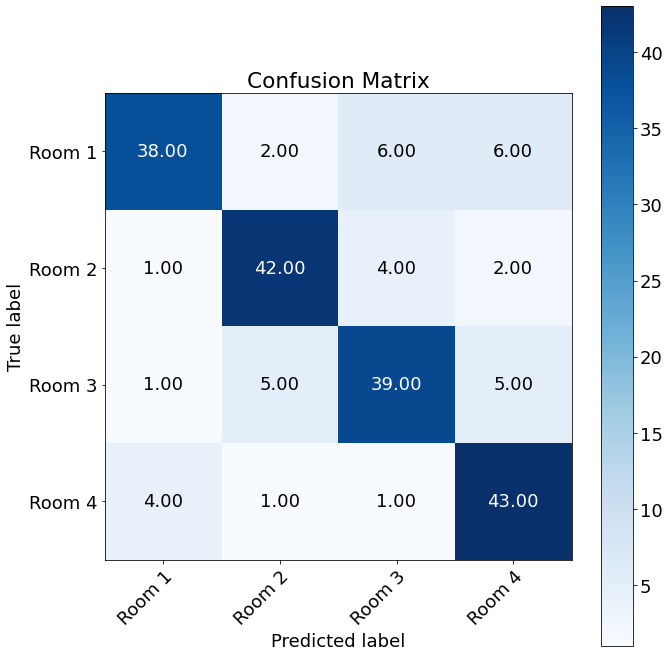

Accuracy pruned 1: 0.88
Macro recall pruned 1: 0.8799293563579278
Macro precision pruned 1: 0.8832312179684148


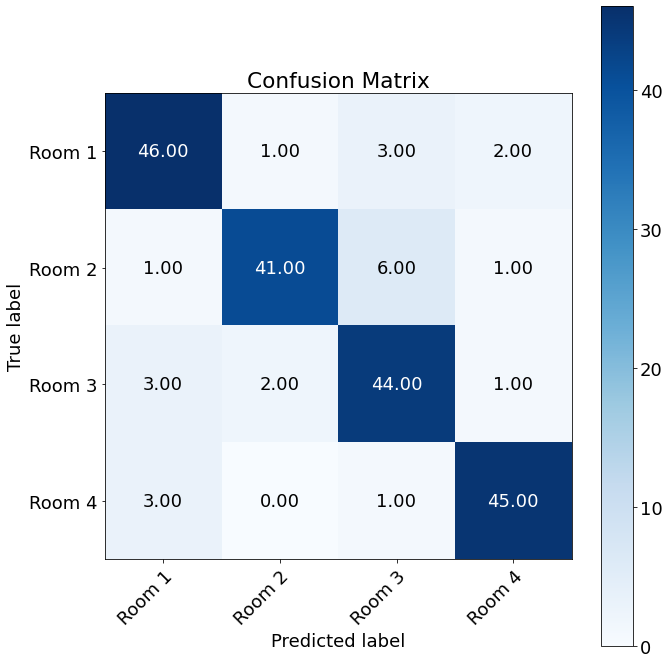

 
Accuracy pruned 2: 0.88
Macro recall pruned 2: 0.8799293563579278
Macro precision pruned 2: 0.8832312179684148


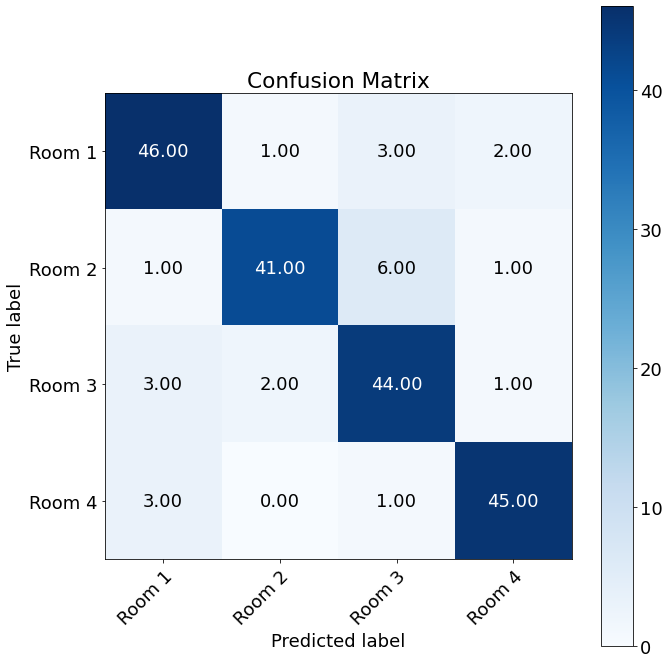

 
Outer Fold:10, Inner fold:7
Accuracy original: 0.795
Macro recall original: 0.7955612244897959
Macro precision original: 0.8030395756833946
 


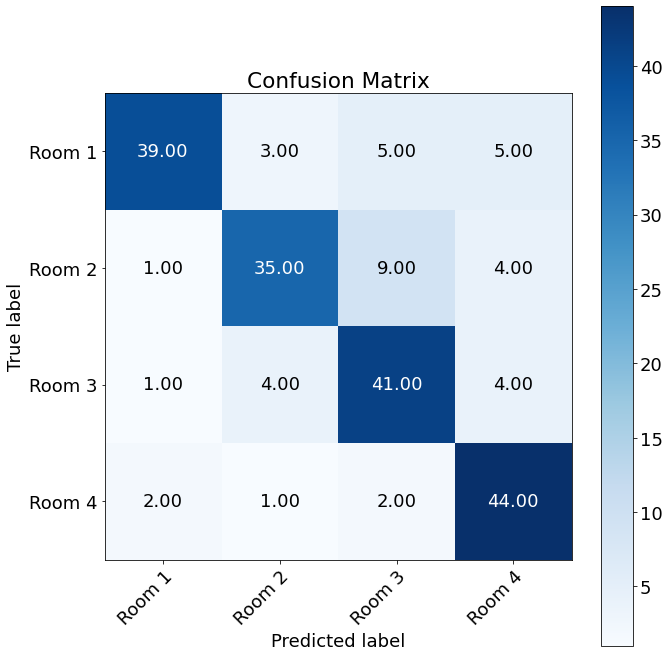

Accuracy pruned 1: 0.89
Macro recall pruned 1: 0.8899293563579278
Macro precision pruned 1: 0.8933116883116883


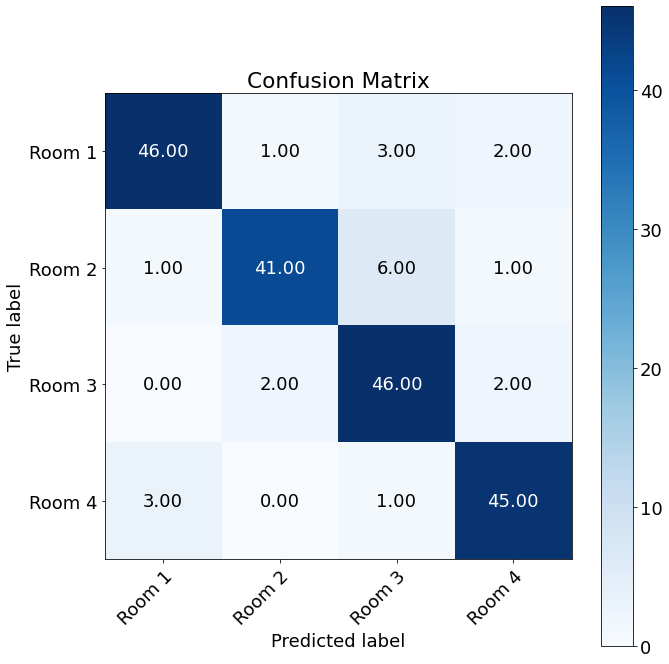

 
Accuracy pruned 2: 0.89
Macro recall pruned 2: 0.8899293563579278
Macro precision pruned 2: 0.8933116883116883


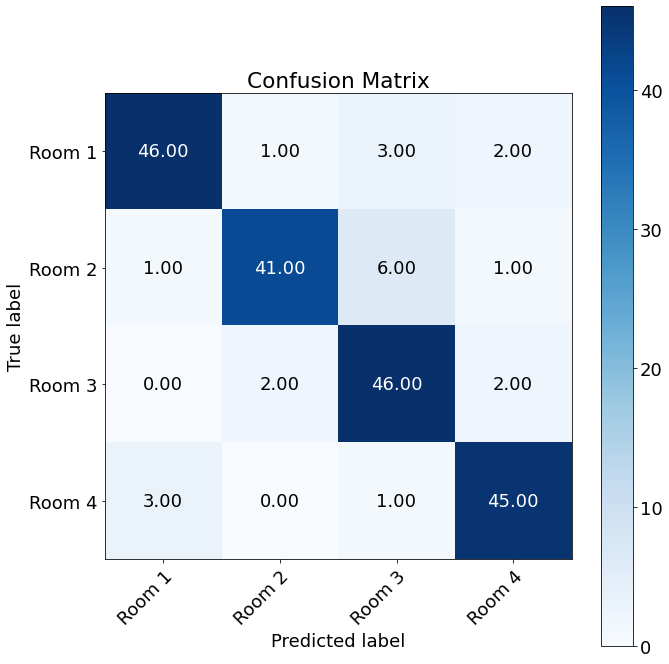

 
Outer Fold:10, Inner fold:8
Accuracy original: 0.78
Macro recall original: 0.7803571428571427
Macro precision original: 0.7819718844984803
 


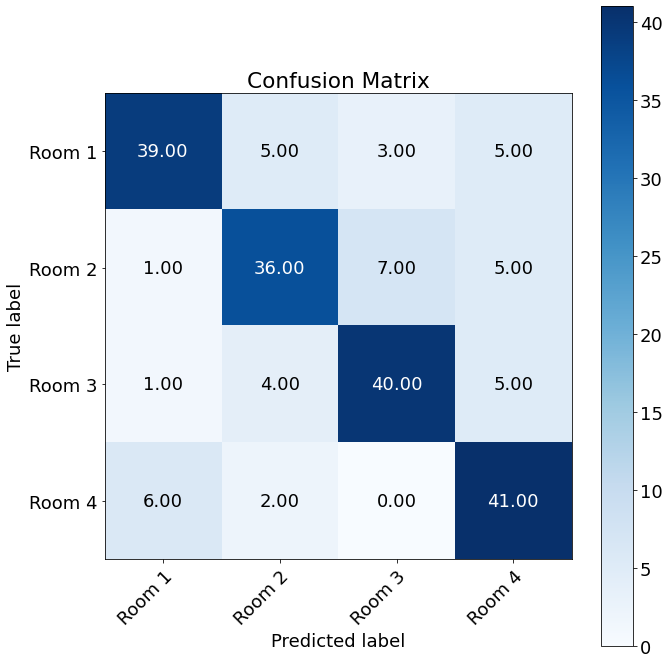

Accuracy pruned 1: 0.88
Macro recall pruned 1: 0.8797252747252747
Macro precision pruned 1: 0.881746638049159


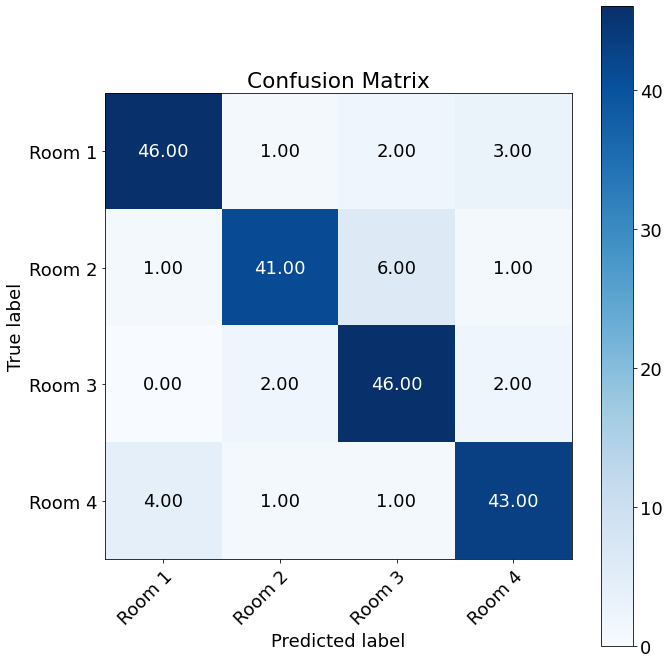

 
Accuracy pruned 2: 0.88
Macro recall pruned 2: 0.8797252747252747
Macro precision pruned 2: 0.881746638049159


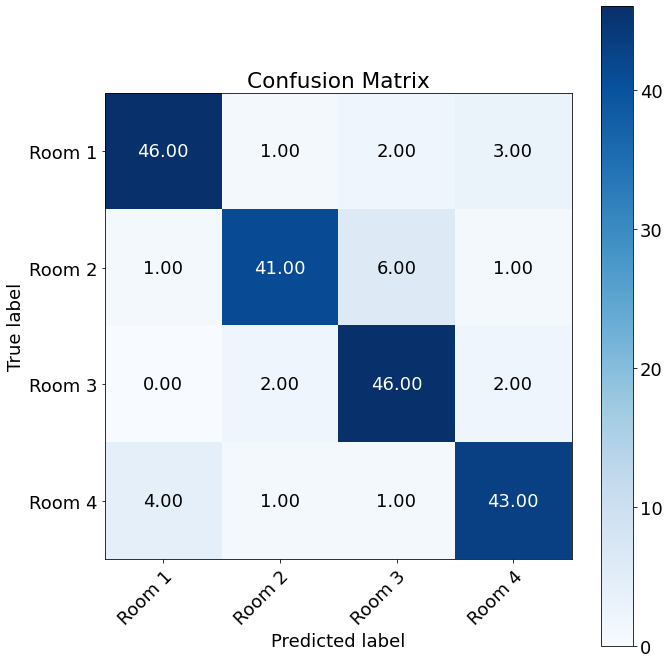

 
Outer Fold:10, Inner fold:9
Accuracy original: 0.8
Macro recall original: 0.7998940345368917
Macro precision original: 0.8025517024991815
 


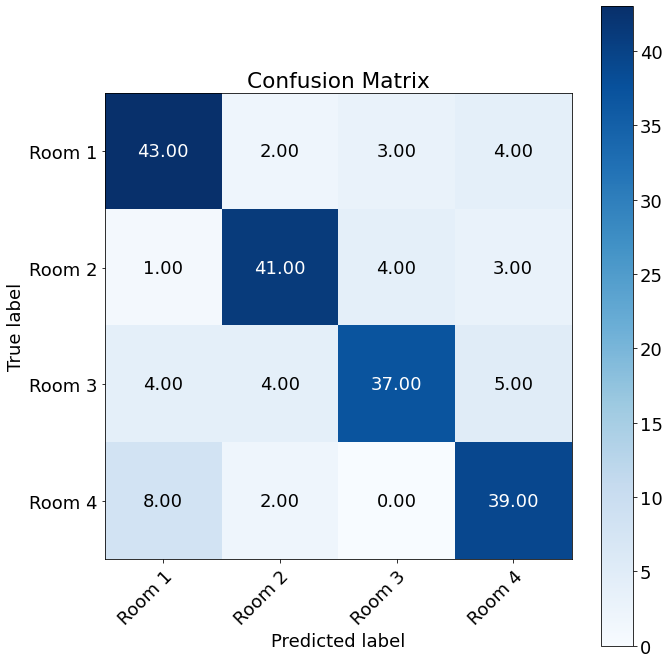

Accuracy pruned 1: 0.88
Macro recall pruned 1: 0.8799293563579278
Macro precision pruned 1: 0.8814787937429446


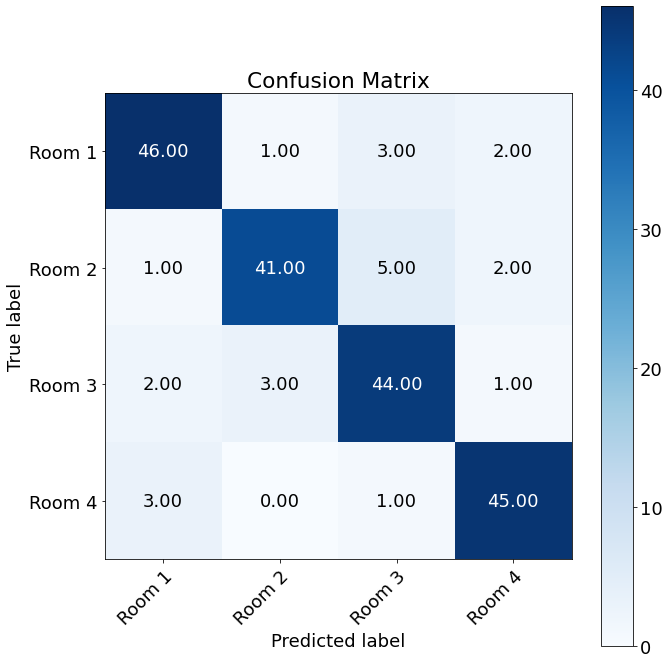

 
Accuracy pruned 2: 0.88
Macro recall pruned 2: 0.8799293563579278
Macro precision pruned 2: 0.8814787937429446


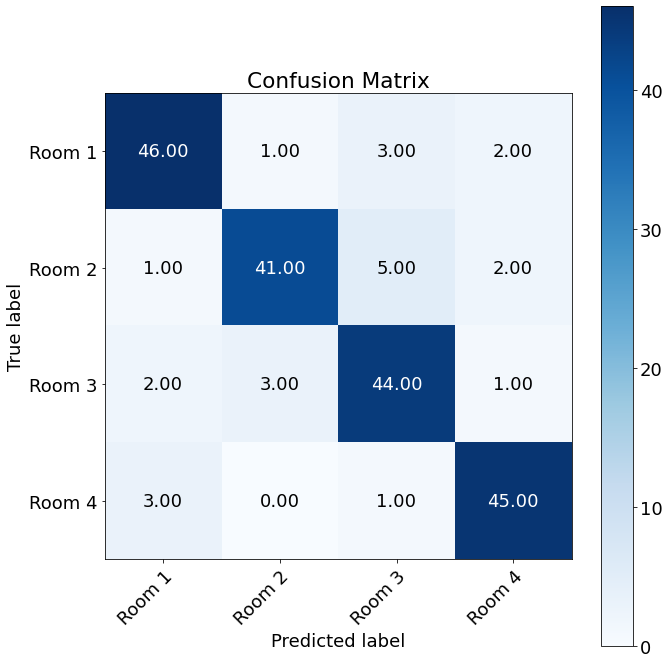

 
Outer Fold:10, Inner fold:10
Accuracy original: 0.79
Macro recall original: 0.7900627943485086
Macro precision original: 0.7926062091503269
 


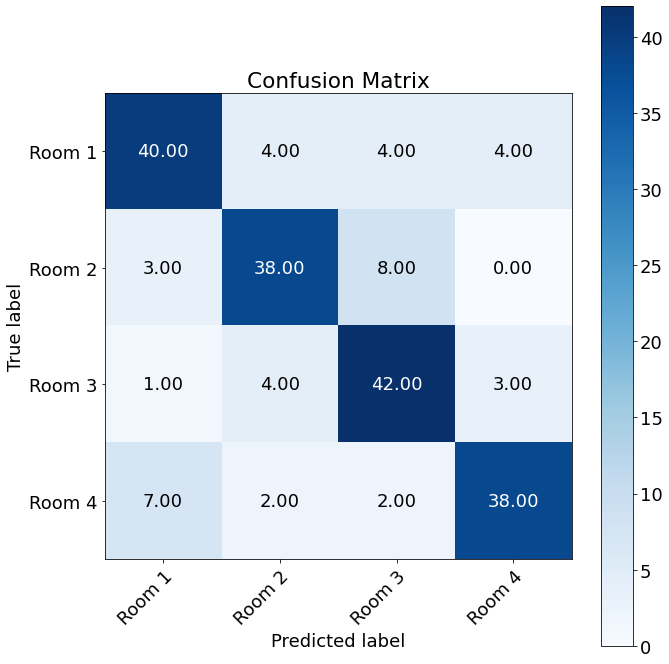

Accuracy pruned 1: 0.88
Macro recall pruned 1: 0.8794309262166405
Macro precision pruned 1: 0.8846679141922222


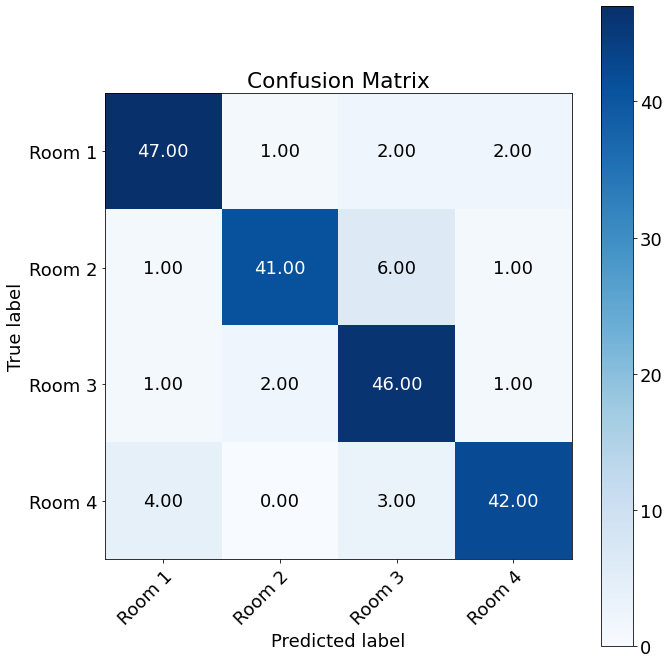

 
Accuracy pruned 2: 0.88
Macro recall pruned 2: 0.8794309262166405
Macro precision pruned 2: 0.8846679141922222


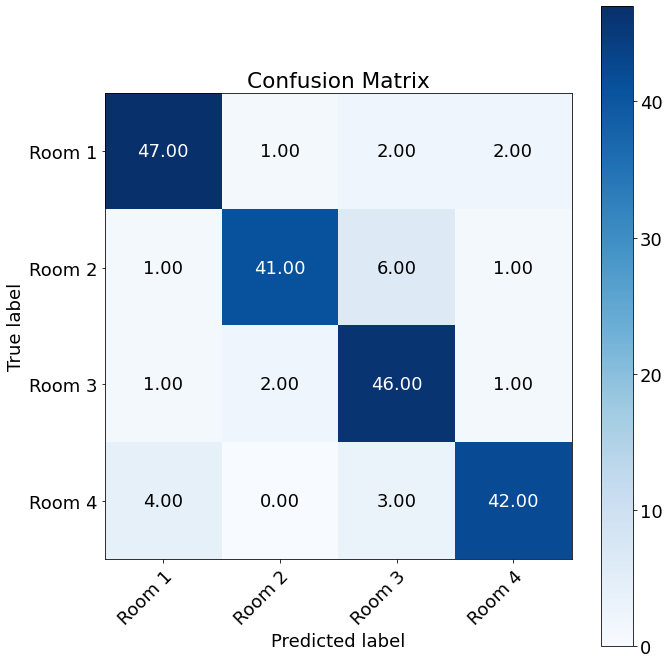

 
------------------------------------------------
Average accuracy for original tree:0.7978000000000002
Average accuracy for pruned1 tree:0.8810999999999997
Average accuracy for pruned2 tree:0.8810999999999997
Average recall for original tree:[0.77722178 0.80889572 0.80274684 0.80322191]
Average recall for pruned1 tree:[0.89963834 0.86866484 0.87135458 0.88285241]
Average recall for pruned2 tree:[0.89963834 0.86866484 0.87135458 0.88285241]
Average precision for original tree:[0.79633289 0.80926044 0.79428255 0.79841764]
Average precision for pruned1 tree:[0.87150123 0.89447701 0.87087386 0.89441514]
Average precision for pruned2 tree:[0.87150123 0.89447701 0.87087386 0.89441514]
 
Average F1 score for original tree:[0.78666128 0.80907804 0.79849227 0.80081257]
Average F1 score for pruned1 tree:[0.88534629 0.88138198 0.87111415 0.88859616] 
Average F1 score for pruned2 tree:[0.88534629 0.88138198 0.87111415 0.88859616] 
 
Average depth original tree:18.41
Average depth pruned1 tree:13

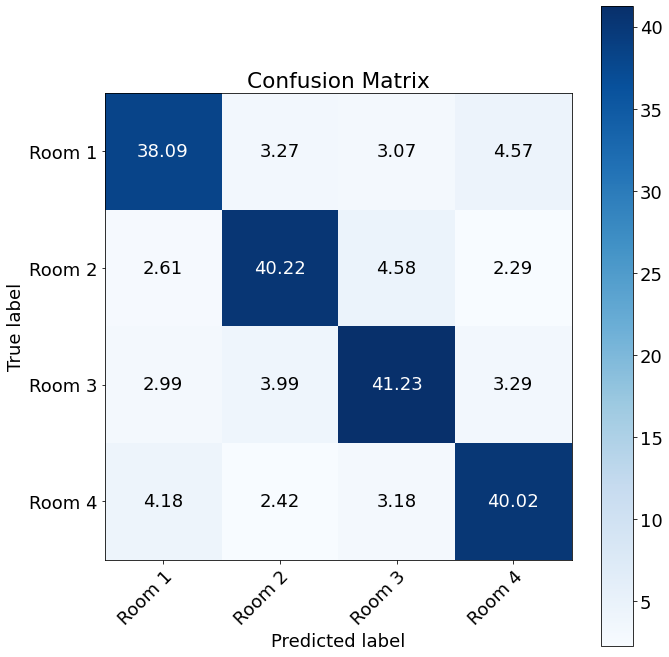

Confusion matrix for pruned1 tree


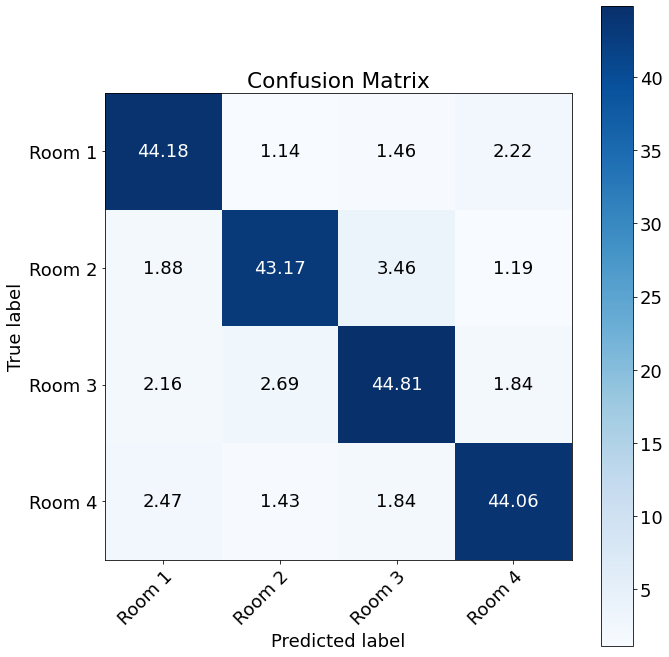

Confusion matrix for pruned2 tree


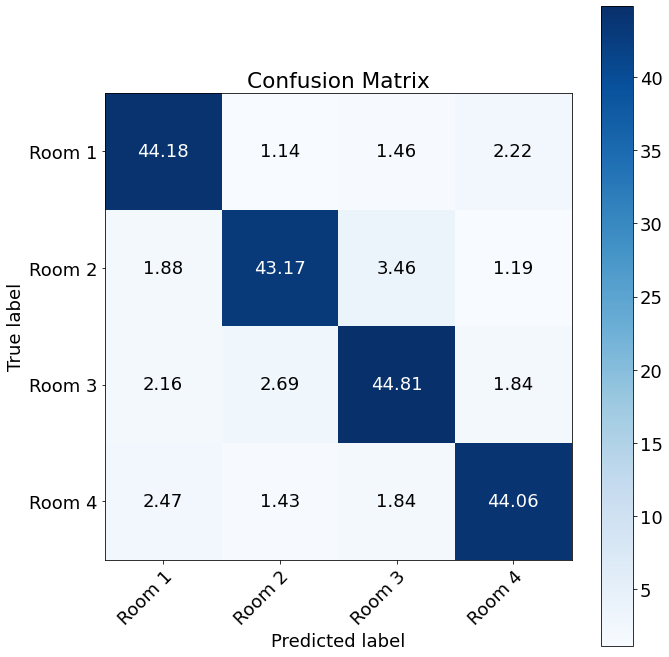

In [36]:
# Full results report with cross-validation metrics for each fold
np.random.seed(101)
cross_validate(data_noisy, 10,10)

------------------------------------------------
Average accuracy for original tree:0.7978000000000002
Average accuracy for pruned1 tree:0.8810999999999997
Average accuracy for pruned2 tree:0.8810999999999997
Average recall for original tree:[0.77722178 0.80889572 0.80274684 0.80322191]
Average recall for pruned1 tree:[0.89963834 0.86866484 0.87135458 0.88285241]
Average recall for pruned2 tree:[0.89963834 0.86866484 0.87135458 0.88285241]
Average precision for original tree:[0.79633289 0.80926044 0.79428255 0.79841764]
Average precision for pruned1 tree:[0.87150123 0.89447701 0.87087386 0.89441514]
Average precision for pruned2 tree:[0.87150123 0.89447701 0.87087386 0.89441514]
 
Average F1 score for original tree:[0.78666128 0.80907804 0.79849227 0.80081257]
Average F1 score for pruned1 tree:[0.88534629 0.88138198 0.87111415 0.88859616] 
Average F1 score for pruned2 tree:[0.88534629 0.88138198 0.87111415 0.88859616] 
 
Average depth original tree:18.41
Average depth pruned1 tree:13.6

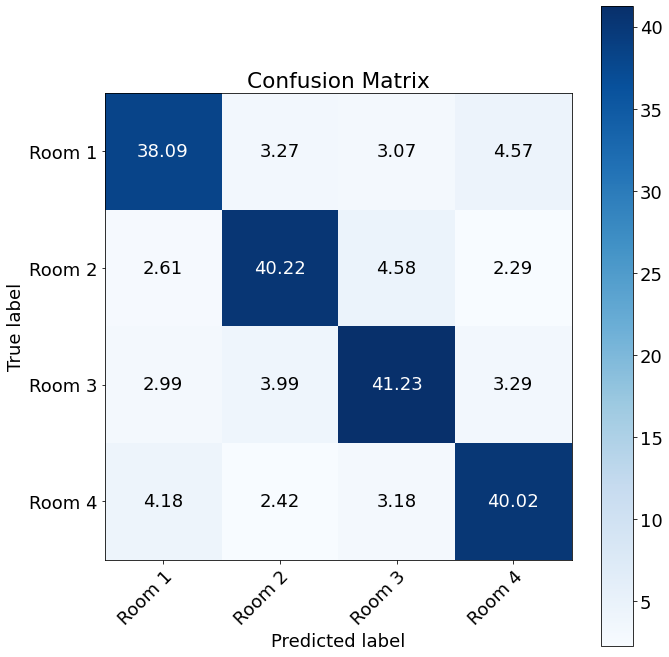

Confusion matrix for pruned1 tree


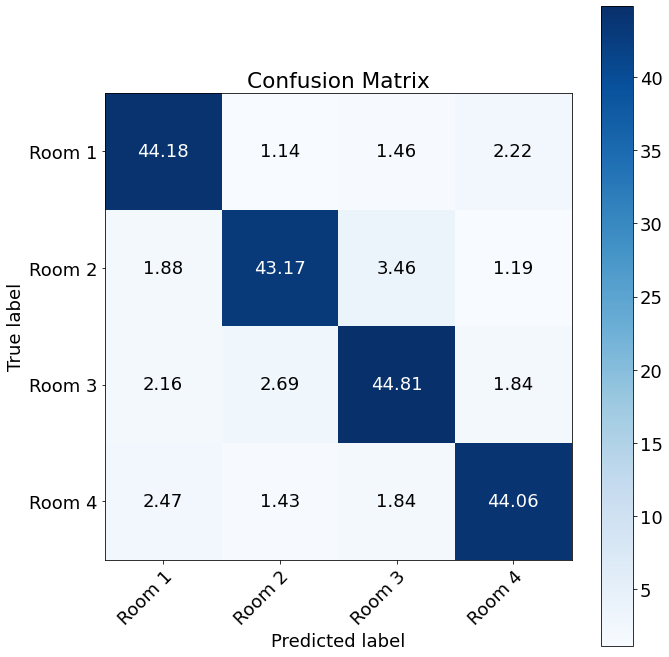

Confusion matrix for pruned2 tree


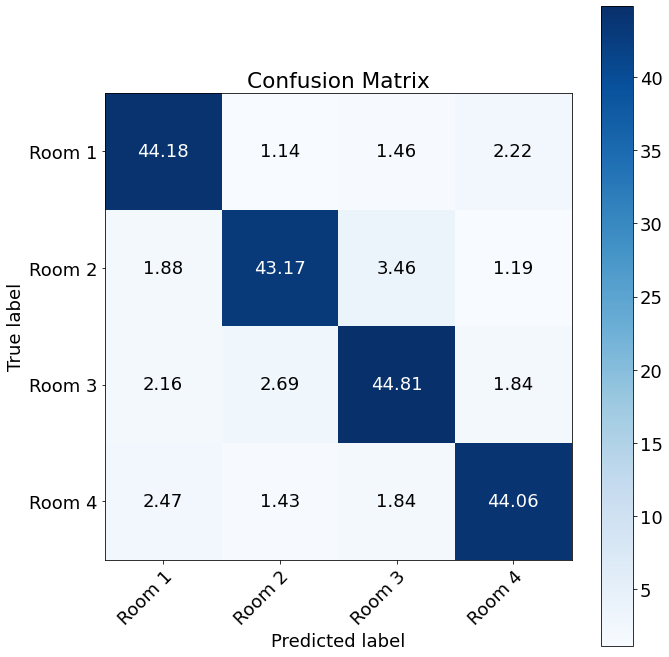

In [37]:
# Shortened results report with only averaged cross-validation metrics across all folds
np.random.seed(101)
cross_validate(data_noisy, 10,10, ifnotshort = False)

## Plot the decision tree structure using Matplotlib

In [39]:
def plot(tree, c1=0,c2=0):
    """ Recursively plot the structure of the decision tree  

    Args:
        tree(dict): a nested dictionary representing the structure of the decision tree
        c1, c2 (int): initial coordinates to start plotting                         

    """
    
    # with increased depth of the parent node, the distance between plotted child nodes
    # will be smaller 
    
    depth = tree['depth']+1  
    
    #if the current node is not a leaf node... 
    
    if tree['leaf_node']==False:
        i = tree['feature']
        value = tree['value']
        
        #... then plot its box and the run the plot() function for its children
        plt.text(c1-7 , c2, f'X{i}<={value}', fontsize = 30, c = "white",

        fontweight = 'bold', bbox = dict(facecolor = 'black', alpha = 1))
        
        # if both of the children are not leaf nodes,
        # plot the child nodes further away from each other 
        
        if tree['left_child']['leaf_node'] == False and tree['right_child']['leaf_node'] == False:
            k = depth * 0.05  # adjust the distace between two children nodes according to the depth of parent node
            adjusted_c1 = c1-10/k
            adjusted_c2 = c1+10/k
            plot(tree['left_child'], adjusted_c1,c2-5)
            plot(tree['right_child'],adjusted_c2,c2-5)
            
            plt.plot([c1, adjusted_c1],[c2,c2-5],color='brown')
            plt.plot([c1, adjusted_c2], [c2,c2-5],color='brown')
        
        # if one of the children are not leaf nodes,
        # plot the child nodes closer to each other

        else:
            k = depth * 0.15
            adjusted_c1 = c1-10/k
            adjusted_c2 = c1+10/k
            plot(tree['left_child'],adjusted_c1,c2-5)
            plot(tree['right_child'], adjusted_c2,c2-5)
            
            plt.plot([c1, adjusted_c1],[c2,c2-5],color='brown')
            plt.plot([c1, adjusted_c2], [c2,c2-5],color='brown')
            
    # if the current node is not a leaf node, don't search for its children
    
    else:
        
        label = tree['label']
        plt.text(c1-3, c2, f' {int(label)} ', fontsize = 50,  c = "white",
        fontweight = 'bold', bbox = dict(facecolor = 'green', alpha = 1)) 
        

In [41]:
# get the decision tree

tree,depth = decision_tree_learning(data_clean,0)

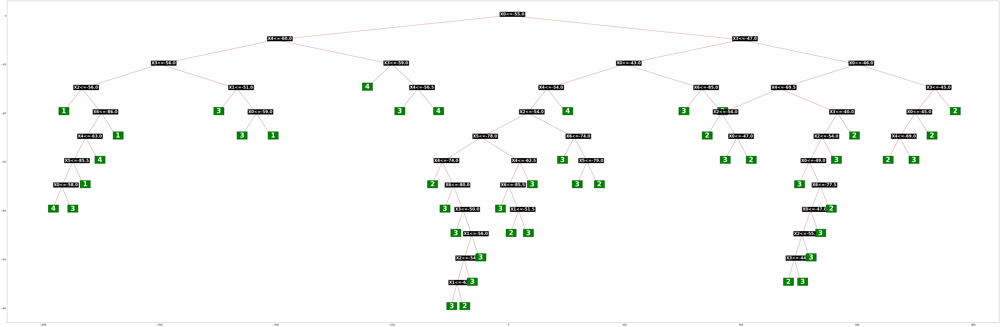

In [42]:

# increase by 1 as the calculate_depth() funciton doesn't count the last leaf nodes
depth = calculate_depth(tree) + 1

# get the tree plot 
l_box = 11 # length of the text box for fig (1,1)
fig_x, fig_y = (m.ceil(depth*l_box)), (m.ceil(depth*l_box)/3) # adjust the plot size depending on the depth
fig = plt.figure(figsize=(fig_x, fig_y), dpi=50)
plot(tree)
plt.show()